# Code to run website tests
### The model parameters are already trained using the Training Visualization 

In [103]:
pre_i=1
post_i=2
bw_i=3
bf_i=4

In [136]:
import csv
import matplotlib.pyplot as plt
import sys
import math

import matplotlib.pyplot as plt
from scipy.fft import rfft, rfftfreq
from scipy.fft import irfft
import numpy as np
import statistics
from statistics import mean, pstdev
import pandas as pd

yellow = '\033[93m'
green = '\033[92m'
red = '\033[91m'
blue = '\033[94m'
pink = '\033[95m'
black = '\033[90m'

def smoothen(time, data, rtt):
    # Smoothening 
    left = 0
    right = 0
    run_sum = 0
    avg_data = []
    new_time = []
    roll_time = time
    roll_data = data
    while right < len(roll_time):
        while(right < len(roll_time) and (roll_time[right]-roll_time[left] < 2*rtt)):
            run_sum+=roll_data[right]
            right+=1
        new_time.append(float(roll_time[right-1]+roll_time[left])/2)
        avg_data.append(float(run_sum)/(right-left))
        run_sum-=roll_data[left]
        left+=1
    return new_time, avg_data


def get_fft(data):
    n = len(data)
    data_step = 0.002
    yf = rfft(data)
    xf = rfftfreq(n,data_step)
    return yf,xf

def get_fft_smoothening(data, time, ax,rtt,p):
    rtt=rtt
    yf, xf = get_fft(data)
    thresh  = (1/rtt)
    thresh_ind = 0
    for i in range(len(xf)) :
        freq = xf[i]
        if(freq > thresh):
            thresh_ind = i
            break
            
    yf_clean = yf
    yf_clean[thresh_ind+1:] = 0
    new_f_clean = irfft(yf_clean)
    start_len = len(time) - len(new_f_clean)

    plot_data = new_f_clean
#     if p=="y":
#         ax.plot(time[start_len:], plot_data, 'k', label='FFT smoothening', linewidth=1.5)

    plot_time = time[start_len:] 
    return plot_time, plot_data

def plot_d(ax, time, data, c, l, alpha=1):
    ax.plot(time, data, color=c, lw=2, label = l,alpha=alpha)


def plot_one_bt(f, p,t=1):
#     print(f)
    file_name = f.split("/")[-1]
    fs = file_name.split("-")

    pre = int(fs[1])
    post = int(fs[2])
    rtt = float(((pre+post)*2))/1000
    ax = 0
    if t==1:
        data, time, retrans = get_window(f,"n",t)
    elif t==2:
        data, time, retrans, OOA, DA = get_window(f,"n",t)
    if p == 'y':
        fig, ax = plt.subplots(1,1, figsize=(15,8))
        for t in retrans :
            plt.axvline(x = t, color = 'm',alpha=0.5)
        if t == 2:
            for t in OOA :
                plt.axvline(x = t, color = 'k', lw=2)
            for t in DA:
                plt.axvline(x = t, color = 'g', lw=0.5, alpha = 0.5)
        plot_d(ax,time,data, "r","Original")
    time, data = get_fft_smoothening(data, time, ax,rtt,"y")

    #         plot_d(ax,time,data,"b","FFT Smoothened" )
#         print(len(time), len(data))
    time, data = smoothen(time, data, rtt)
#         print(len(time), len(data))
    if p == 'y':
        plot_d(ax, time, data, "b", "Smoothened",alpha=0.5)
        ax.legend()
#             plt.savefig("./plots/"+f+".png")
        plt.show()
#     return time, data, grad_time, grad_data, rtt
#     print("Black : OOA, Green : DA, Magenta : RP")
    return time, data, retrans, rtt 


def get_time_features(retrans,time,rtt):
    time_thresh = 20*rtt
    features = []
    for i in range(1, len(retrans)):
        if retrans[i]-retrans[i-1] >= time_thresh:
            features.append([retrans[i-1], retrans[i]])
    # add a feature that finished when the experiment ends
    if len(retrans)>0:
        if time[-1] - retrans[-1] > 20*rtt :
            features.append([retrans[-1],time[-1]])
    return features

def get_features(time, features):
    left = 0
    right = 0
    feature_index = 0
    in_feature = 0
    index_features = []
    while right < len(time) and feature_index < len(features): 
        if in_feature == 0 and time[right]>=features[feature_index][0]:
            in_feature = 1
            left = right
        elif in_feature == 1 and time[right] > features[feature_index][1]:
            in_feature = 0
            index_features.append([left, right-1])
            feature_index+=1
        right+=1
    if in_feature == 1:
        index_features.append([left, right-1])
    return index_features

def get_plot_features(curr_file, p):
    time, data, retrans, rtt = plot_one_bt(curr_file,p=p,t=1)
    time_features = get_time_features(retrans,time,rtt)
    features = get_features(time, time_features)    
    if p == 'y':
        fig, ax = plt.subplots(1,1, figsize=(15,8))
        plot_d(ax, time, data, "b", "Smoothened")
        for ft in features : 
#             print(time[ft[1]]-time[ft[0]])
            ax.plot(time[ft[0]:ft[1]+1], data[ft[0]:ft[1]+1], color = 'r')
        plt.show()
    return time, data, features


SHOW=True
MULTI_GRAPH=False
SMOOTHENING=False
ONLY_STATS=False
s_factor=0.9


PKT_SIZE = 88


'''
TODO: 
o Add functionality where you only plot flows that send more than x bytes of data
o Sort stats and graphs by flow size
o Organize plots by flow size (larger flows have larger graphs)
o Custom smoothening function
'''

fields=["time", "frame_time_rel", "tcp_time_rel", "frame_num", "frame_len", "ip_src", "src_port", "ip_dest", "dest_port", "tcp_len", "seq", "ack"]

class pkt:
    contents=[]
    def __init__(self, fields) -> None:
        self.contents=[]
        for f in fields:
            self.contents.append(f)

    def get(self, field):
        return self.contents[fields.index(field)]
        

def process_flows(cc, dir,p="y"):
    name = dir+cc+"-tcp.csv"
    with open(name) as csv_file:
        print("Reading "+name+"...")
        csv_reader = csv.reader(csv_file, delimiter=',')
        line_count = 0
        total_bytes=0
        '''
        Flow tracking:
        o Identify all packets that are either sourced from or headed to 100.64.0.2
        o Group different flows by client's port
        '''
        flows={}
        data_sent=0
        # ACK and RTX measurement
        ooa = set()
        rp = set()
        ooaCount=0
        rpCount=0
        daCount=0
        backAck=0
        for row in csv_reader:
            reTx=0
            
            ooAck=0
            dupAck=0
            retPacket=0
            
            packet=pkt(row)
            ackPkt=False
            validPkt=False
            if line_count==0:
                # reject the header
                line_count+=1
                continue
            if data_sent == 0 : 
                if "100.64.0." in packet.get("ip_src"):
                    num = int(packet.get("ip_src")[-1])
                    if num%2==0:
                        data_sent=1
                        host_port=packet.get("ip_src")
                if "100.64.0." in packet.get("ip_dest"):
                    num = int(packet.get("ip_dest")[-1])
                    if num%2==0:
                        data_sent=1
                        host_port=packet.get("ip_dest")
                if data_sent == 0:
                    continue
            if packet.get("ip_src")==host_port and packet.get("frame_time_rel")!='' and packet.get("ack")!='': 
                # we care about this ACK packet
                validPkt=True
                ackPkt=True
                port=packet.get("src_port")
                #PORTCHECK
#                 if int(port) != 50468:
#                     continue
                if port not in flows:
                    flows[port]={"OOA":[],"DA":[],"max_seq":0,"loss_bif":0,"max_ack":int(packet.get("ack")),"serverip":packet.get("ip_dest"), "serverport":packet.get("dest_port"), "act_times":[],"times":[], "windows":[], "cwnd":[], "bif":0, "last_ack":0, "last_seq":0, "pif":0, "drop":[], "next":0, "retrans":[]}
                else:
                    # check for Out of Order Ack (OOA)
                    if int(packet.get("ack")) <= int(flows[port]["max_ack"]):
                        if int(packet.get("ack")) == backAck :
                            dupAck = True
                            flows[port]["DA"].append(float(packet.get("frame_time_rel")))
                        else :
                            ooAck = True
                            flows[port]["OOA"].append(float(packet.get("frame_time_rel")))
                        backAck = int(packet.get("ack"))
                    # update max_ack
                    flows[port]["max_ack"] = max(flows[port]["max_ack"], int(packet.get("ack")))
                    if int(packet.get("seq")) < flows[port]["max_ack"]:
                        reTx += int(packet.get("tcp_len"))
#                     flows[port]["times"].append(float(packet.get("frame_time_rel")) )
                    
            elif packet.get("ip_dest")==host_port and packet.get("frame_time_rel")!='' and packet.get("seq")!='':
                #we care about this Data packet
                validPkt=True
                port=packet.get("dest_port")
                #PORTCHECK
#                 if int(port) != 50468:
#                     continue
                seq=int(packet.get("seq"))
                tcp_len=int(packet.get("tcp_len"))
                if port not in flows:
                    flows[port]={"OOA":[],"DA":[],"max_seq":int(packet.get("seq")),"loss_bif":0,"max_ack":0,"serverip":packet.get("ip_src"), "serverport":packet.get("src_port"),"act_times":[], "times":[], "windows":[], "cwnd":[], "bif":0, "last_ack":0, "last_seq":0, "pif":0, "drop":[], "next":0, "retrans":[]}
                
                else:
                    flows[port]["max_seq"] = max(flows[port]["max_seq"], int(packet.get("seq")))
                
                
                if int(packet.get("seq")) < flows[port]["max_seq"] :
                    retPacket = True
                    flows[port]["retrans"].append(flows[port]["times"][-1])
                    
            if validPkt==True:
                bif = 0
                normal_est_bif = int(flows[port]["max_seq"]) - int(flows[port]["max_ack"]) + PKT_SIZE#+ reTx
                loss_est_bif = flows[port]["loss_bif"]
                if ackPkt and dupAck and len(flows[port]["windows"]) > 10:
                    if dupAck:
                        # if we have received a duplicate ack then we need to reduce the bytes in flight by packet size
                        # we also increase max ack to correct for the consolidated ack being sent later
                        loss_est_bif = int(flows[port]["windows"][-1]) - PKT_SIZE
                        flows[port]["max_ack"] += PKT_SIZE
                        
                        bif = min( normal_est_bif, loss_est_bif)
                        if p == "y" :
                            print(green+"Duplicate Ack",int(packet.get("ack")),"Max Ack",flows[port]["max_ack"],"BIF",bif)
                        
#                     elif ooAck:
#                         # first out of order ack that we have recieved not a duplicated ack
#                         # the reason would be restransimitted packet so dont need to correct for this
                        
                elif ackPkt :
                    loss_est_bif = normal_est_bif 
                    bif = normal_est_bif    
                    if ooAck :
                        ooaCount+=1
                        if p == "y":
                            print(red+"Out of Order Ack",int(packet.get("ack")),"Max Ack",flows[port]["max_ack"],"BIF",normal_est_bif)
                        ooa.add(int(packet.get("ack")))
                    else:
                        if p == "y":
                            print(black+"Inorder Ack",int(packet.get("ack")),"Max Seq",flows[port]["max_seq"],"BIF",normal_est_bif)
                else :
                    bif = normal_est_bif
                    if retPacket==True:
                        rpCount+=1
                        rp.add(int(packet.get("seq")))
                        if p == "y":
                            print(pink+"Retransmitted Packet",int(packet.get("seq")), "Next", flows[port]["max_seq"]+PKT_SIZE, "BIF",bif)
                    else :
                        if p == "y":
                            print(blue+"Inorder Packet", int(packet.get("seq")), "Next", flows[port]["max_seq"]+PKT_SIZE, "BIF",bif)
                flows[port]["loss_bif"] = loss_est_bif
                flows[port]["windows"].append( int(bif) )
                flows[port]["times"].append( float(packet.get("frame_time_rel")) )
                
#                 if ackPkt and dupAck and len(flows[port]["windows"]) > 10: # we have received atleast the first window
# #                     if len(flows[port]["windows"]) < 2000: # print reTx in first 200 packets
# #                         print( packet.get("ack"), flows[port]["max_ack"])
#                     loss_est_bif = int(flows[port]["windows"][-1]) - PKT_SIZE
#                     flows[port]["max_ack"] += PKT_SIZE
#                     bif = min( normal_est_bif, loss_est_bif )
#                 elif ackPkt:
#                     loss_est_bif = normal_est_bif 
#                     bif = normal_est_bif
#                 else:
#                     bif = normal_est_bif
#                 flows[port]["loss_bif"] = loss_est_bif
#                 flows[port]["windows"].append( int(bif) )
            
            
            line_count+=1
            total_bytes+=int(packet.get("frame_len"))
            #print(line_count, total_bytes)
            
#         print("total bytes processed:", total_bytes/1000, "KBytes for", cc, "(unlimited)")
        if p == "y":
            print("Out of Order Acks",len(ooa),"Retransmitted Packets",len(rp))
            print("Count Out of Order Acks",ooaCount,"Retransmitted Packets",rpCount)
            print("OOA",ooa,"RP",rp)
    return flows

def custom_smooth_function():
    pass

def get_flow_stats(flows):
    num=len(flows.keys())
    print("FLOW STATISTICS: \nNumber of flows: ", num)
    print("------------------------------------------------------------------------------")
    print('%6s'%"port", '%15s'%"SrcIP", '%8s'%"SrcPort",  '%8s'%"duration",  '%8s'%"start",  '%8s'%"end", '%8s'%"Sent (B)", '%8s'%"Recv (B)",)
    for k in flows.keys():
        print('%6s'%k, '%15s'%flows[k]["serverip"], '%8s'%flows[k]["serverport"], '%8s'%str('%.2f'%(flows[k]["times"][-1]-flows[k]["times"][0])), '%8s'%str('%.2f'%flows[k]["times"][0]), '%8s'%str('%.2f'%flows[k]["times"][-1]), '%8s'%flows[k]["last_seq"], '%8s'%flows[k]["last_ack"])
        #print("    * Flow "+str(k)+": ", flows[k]["last_ack"], " ", flows[k]["last_seq"], " bytes transfered.")
    return num

def run(files):
    flows = {}
    for f in files:
        algo_cc=f
        #Get the data for all the flows
        print("==============================================================================")
        print("opening trace ../measurements/"+algo_cc+".csv...")
        flows = process_flows(algo_cc, "./Nebby/measurements-new-btl/50-200-2-60/")
        #decide on final graph layout
        num = get_flow_stats(flows)

        if ONLY_STATS:
            sys.exit()

        if num==1:
            MULTI_GRAPH=False
        #grid size
        if MULTI_GRAPH:
            size=(0,0)
            grids={1:(2,2), 2:(2,2), 4:(2,2), 6:(2,3), 9:(3,3), 12:(3,4), 15:(3,5), 16:(4,4), 20:(5,4), 24:(6,4), 30:(6,5), 36:(6,6), 40:(8,5), 42:(8,7), 49:(7,7)}
            g=num
            while g<=49 and g not in grids:
                g+=1
            if g in grids.keys():
                size=grids[g]
            else:
                size=grids[49]  
            fig, axs = plt.subplots(size[0], size[1])
            for i in range(size[0]):
                for j in range(size[1]):
                    #axs[i][j].legend(loc="lower right")
                    if i==size[0]-1:
                        axs[i][j].set_xlabel("Time (s)")
                    if j==0:
                        axs[i][j].set_ylabel("Bytes in flight")
        else:
            plt.xlabel("Time (s)")
            plt.ylabel("Bytes in flight")
        counter=0
        for port in flows.keys():
            if MULTI_GRAPH:  
                axs[counter%size[0]][(counter//size[0])%size[1]].scatter(flows[port]["times"], flows[port]["windows"], color="#858585")
                axs[counter%size[0]][(counter//size[0])%size[1]].plot(flows[port]["times"], flows[port]["windows"], label=str(port), linestyle="solid")
            else:
                plt.plot(flows[port]["times"], flows[port]["windows"], label=str(port), linestyle="solid")
                plt.scatter(flows[port]["times"], flows[port]["windows"], color="#858585")
            counter+=1
        if MULTI_GRAPH:
            counter=0
            for port in flows.keys():
                axs[counter%size[0]][(counter//size[0])%size[1]].legend()
                counter+=1
        else:
            plt.legend()
        if MULTI_GRAPH:
            fig.set_size_inches(16, 12)
        if SHOW:
            plt.show()
        else:
            plt.savefig("../logs/results/"+algo_cc+".png", dpi=600, bbox_inches='tight', pad_inches=0)
    return flows


def split_path(f):
    path = f.split("/")
    file_name = path[-1][:-8]
    folder_path = "/".join(path[:-1])
    folder_path = folder_path + "/"
    algo_cc = file_name
    return algo_cc, folder_path

def get_window(f,p,t=1):
    algo_cc, folder_path = split_path(f)
    flows = process_flows(algo_cc, folder_path,p=p)
#     flows = process_flows(algo_cc, "../measurements/m/",p=p)
#     flows = process_flows(algo_cc, "./Nebby/measurements/",p=p)    
#     flows = process_flows(algo_cc, "./Nebby/measurements-new-btl/50-200-2-60/",p=p)
#     flows = process_flows(algo_cc, "./Nebby/measurements-100-150/",p=p)
    params = algo_cc.split("-")
    data = []
    time = []
    drops = []
    retrans = []
    OOA = []
    DA = []
    use_port = 0
    maxx = 0
    print("All Ports : ", flows.keys())
    for port in flows.keys():
        if len(flows[port]['windows']) > maxx:
            maxx = len(flows[port]['windows'])
            use_port = port
    print("Port",use_port)
    data = flows[use_port]['windows']
    time = flows[use_port]['times']
    retrans = flows[use_port]['retrans']
    OOA = flows[use_port]['OOA']
    DA = flows[use_port]['DA']
    if p == "y":
        plt.plot(time, data)
#     time_index = len(time)-1
#     for index in range(len(flows[use_port]['times'])-1):
#         if flows[use_port]['times'][index+1] - flows[use_port]['times'][index] > :
#             time_index = index
#     time_last = flows[use_port]['times'][time_index]
#     data = data[:time_index+1]
#     time = time[:time_index+1]
    if t==2:
        return data, time, retrans, OOA, DA
    if t==1:
        return data, time, retrans


def getProbes(time, data, rtt, bdp, bw=200):
    if bw==200:
        thresh = 8*rtt
        st_thresh = 0.025
        error = 0.08
        alpha = 1.10
    if bw==1000:
        thresh = 4*rtt
        st_thresh = 0.025
        error = 0.02
        alpha = 1
    probe_index = []
    left = 0
    right = 0
    bdp_thresh = bdp/2
    prev_right = 0
    end = 0
    while right < len(data):
        while right < len(data) and (time[right]-time[left]) < thresh:
            right+=1
        if right == len(data):
            end = 1
            right-=1
        mid = math.floor(left + (right - left)/2)
        mid_val = 0
        left_mid = mid
        right_mid = mid
#         print(left,right)
#         while left_mid > 0 and abs(time[mid]-time[left_mid])<rtt:
#             if data[left_mid] > data[left] and data[left_mid] > data[right]:
#                 mid_val+=1
#             left_mid-=1
#         while right_mid < len(data)-1 and abs(time[right_mid]-time[mid])<rtt:
#             if data[right_mid] > data[left] and data[right_mid] > data[right]:
#                 mid_val+=1
#             right_mid+=1
#         total = right_mid - left_mid
#         peak = 0
#         if round(float(mid_val)/total,2) > 0.99 :
#             print(round(float(mid_val)/total,2))
#             peak=1
        go = 0
        if data[mid] > data[left] and data[mid] > data[right]:
#         if peak == 1:
            #this  is  peak
#             go = 1
            t_l = left
            t_r = right
            while(t_l > 0 and time[left]-time[t_l] < thresh/2):
                t_l-=1
            while(t_r < len(data)-1 and time[t_r]-time[right] < thresh/2):
                t_r+=1
            left_sd = round(np.std(data[t_l:left])/(bdp_thresh*2),3)
            right_sd = round(np.std(data[right:t_r])/(bdp_thresh*2),3)
            if float(abs(data[left]-data[right]))/data[left] < error:
                # this has the left and right points not too different from each other
                side_avg = float((data[left]+data[right]))/2
                local_max = max(data[left:right+1])
#                 go = 1
#                 print("Yes")
                if float(local_max)/side_avg > alpha and local_max > bdp_thresh: 
                    # this means that the peak is quite steep
#                     print("This")
#                     go = 1
                    if (left_sd < st_thresh) and (right_sd < st_thresh):
                        # this means that the lest and right are quite stable respectvely
                        go = 1
#                         print("Out", left_sd, right_sd, st_thresh)
        if go == 1: 
            try :
                probe_index.append([left,right,float(local_max)/side_avg, time[right]-time[left], left_sd, right_sd, t_l,t_r])
            except :
                probe_index.append([left,right])
            #Once you have found something you directly move past it
            left = right-1
        if end:
            right+=1
        left+=1
    return probe_index


def checkBBR(files,p="n"):
    classi = []
    for f in files:
        file_name = f.split("/")[-1]
        para = file_name.split("-")
        rtt = int(para[2])*2
        bw = int(para[3])
        bf = int(para[4])
        bdp = float(bw*rtt*bf)/8
        if bw == 1000 :
            l=5
            r=15
        if bw == 200:
            l=10
            r=20
        try:
            time, data, retrans,rtt = plot_one_bt(f,p="n",t=1)
            probe_index = getProbes(time, data, rtt, bdp, bw)
            if p=="y":
                print_red(time, data, probe_index)
            prev = 0
            time_dis = []
            for p in probe_index:
                curr_ind = data.index(max(data[p[0]:p[1]+1]))
                if curr_ind > p[1] or curr_ind < p[0]:
                    print("Something Wrong")
                if prev != 0:
                    time_dis.append(abs(time[curr_ind]-prev))
                prev = time[curr_ind]
#             print(time_dis)
            count = 0
            isBBR = 0
            for t in time_dis : 
                if  t > l*rtt and t < r*rtt :
                    count+=1
                    if count >= 2: # there are three peaks consecutively
                        isBBR=1
                        break
                else:
                    count = 0
            if isBBR:
                classi.append("YES BBR")
            else:
                if len(probe_index) <= 1 :
                    classi.append("NO BBR")
                else:
                    classi.append("MAYBE BBR")
        except Exception as ex:  
            template = "An exception of type {0} occurred. Arguments:\n{1!r}"
            message = template.format(type(ex).__name__, ex.args)
            new_message = "NC " + message
            classi.append(new_message)
    return classi

def print_red(time,data,probe_index):
    fig, ax = plt.subplots(1,1, figsize=(15,8))
    offset=0
    ax.plot(time[offset:],data[offset:])
    # for t in retrans :
    #     if t > time[offset]:
    #         plt.axvline(x = t, color = 'm',alpha=0.5)
    # ax.plot(new_time[offset:], new_data[offset:])
    for p in probe_index:
        ax.plot(time[p[0]:p[1]+1], data[p[0]:p[1]+1], color='r', lw=2)
    plt.show()

def getDivision(classi, test_files):
    yes = []
    no = []
    maybe = []
    nan = []
    for i in range(len(classi)):
        if classi[i] == "YES BBR":
            yes.append(test_files[i])
        elif classi[i] == "NO BBR":
            no.append(test_files[i])
        elif classi[i] == "MAYBE BBR":
            maybe.append(test_files[i])
        else:
            nan.append(test_files[i])
    return yes, no,maybe, nan

In [164]:
import bisect
def lower_bound(arr, target):
    index = bisect.bisect_left(arr, target)
    return index

def sample_data_time(time, data, ss, m):
    curr_time, curr_data = adjust(time, data)
    tp = curr_time[len(curr_time)-1] - curr_time[0]
    step = tp/m
    samp_time = [curr_time[0] + i*step for i in range(m)]
    x = np.random.uniform(0,math.pi,ss)
    tr_x = np.cos(x)
    tr_x += 1
    tr_x *= (m-1)/2
    ind = [int(round(e, 0)) for e in tr_x]
    sort_ind = sorted(ind)
    tr_time = [samp_time[i] for i in sort_ind]
    new_time = []
    new_data = []
    for t in tr_time :
        i = lower_bound(curr_time, t)
        temp_t = 0
        temp_d = 0
        if round(t,6) == round(curr_time[i],6):
            temp_t = curr_time[i]
            temp_d = curr_data[i]
        else : 
            if i == 0 :
                temp_t = curr_time[i]
                temp_d = curr_data[i]
            elif i == len(curr_time)-1 :
                temp_t = curr_time[i]
                temp_d = curr_data[i]
            else :
                temp_t = (curr_time[i-1] + curr_time[i])/2
                temp_d = (curr_data[i-1] + curr_data[i])/2
        new_time.append(temp_t)
        new_data.append(temp_d)
    new_data.insert(0,curr_data[0])
    new_data.append(curr_data[-1])
    new_time.insert(0,curr_time[0])
    new_time.append(curr_time[-1])
#     return curr_time, curr_data
    return new_time, new_data

def adjust(time, data):
    start = data.index(min(data[:int(len(data)/2)]))
    end = data.index(max(data[int(len(data)/2):]))
#     print("Difference in max and min ", end-start)
    if end - start <= 0: 
        return time, data
    new_time = time[start:end+1]
    new_data = data[start:end+1]
    return new_time, new_data

# Taking 100 as the threshold is fine 
# Now we have to see how the graphs look if we use it. 
# var = ["reno", "cubic", "bbr"]
def getRed_R(files,ss=125,p="y", ft_thresh=100):
    results = []
    for curr_file in files : 
        print(curr_file)
        file, folder_path = split_path(curr_file)
        f_split = file.split("-")
        v = f_split[0]
        rtt = float((int(f_split[pre_i]) + int(f_split[post_i]))*2)/1000
        bdp = float(rtt*1000*int(f_split[bw_i])*int(f_split[bf_i]))/8
        time, data, features = get_plot_features(curr_file, p=p)
        count = 1
        for ft in features : 
            if count > ft_thresh:
                break
            curr_time = time[ft[0]:ft[1]+1]
            curr_data = data[ft[0]:ft[1]+1]
            tr_time, tr_data = sample_data_time(curr_time, curr_data, ss, 1000)
            tr_time_pd = pd.DataFrame(tr_time)
            tr_data_pd = pd.DataFrame(tr_data)
            tr_time = list(tr_time_pd.rolling(25, center=True).mean().dropna()[0])
            tr_data = list(tr_data_pd.rolling(25, center=True).mean().dropna()[0])
            print("Feature Length ", len(tr_data))
            if p == "y" :
                plt.plot(curr_time, curr_data, c='b', alpha = 0.5, lw = 5)
                plt.plot(tr_time, tr_data, c='r', alpha = 1)
                plt.scatter(tr_time, tr_data, c='k')
#                 plt.scatter(tr_time, tr_data, c='r', s=10)
                plt.title(v)
                plt.show()
            results.append(
                {v+"_"+"data"+"_"+str(count):tr_data,
                     v+"_"+"time"+"_"+str(count):tr_time,
                        v+"_"+"rtt"+"_"+str(count):rtt, 
                             v+"_"+"bdp"+"_"+str(count):bdp})
            count+=1
    return results

def getRed(files,ss=125,p="y", ft_thresh=100):
    results = []
    for file in files :   
        f_split = file.split("-")
        v = f_split[0] + "-" + f_split[1]
        rtt = float((int(f_split[2]) + int(f_split[3]))*2)/1000
        bdp = float(rtt*1000*int(f_split[4])*int(f_split[5]))/8
        print(file)
        print("RTT",rtt,"BDP",bdp)
        time, data, features = get_plot_features(file, p=p)
        count = 1
        for ft in features : 
            if count > ft_thresh:
                break
            curr_time = time[ft[0]:ft[1]+1]
            curr_data = data[ft[0]:ft[1]+1]
            tr_time, tr_data = sample_data_time(curr_time, curr_data, ss, 1000)
            tr_time_pd = pd.DataFrame(tr_time)
            tr_data_pd = pd.DataFrame(tr_data)
            tr_time = list(tr_time_pd.rolling(25, center=True).mean().dropna()[0])
            tr_data = list(tr_data_pd.rolling(25, center=True).mean().dropna()[0])
            print("Feature Length ", len(tr_data))
            if p == "y" :
                plt.plot(curr_time, curr_data, c='b', alpha = 0.5, lw = 5)
                plt.plot(tr_time, tr_data, c='r', alpha = 1)
                plt.scatter(tr_time, tr_data, c='k')
#                 plt.scatter(tr_time, tr_data, c='r', s=10)
                plt.title(v)
                plt.show()
            results.append(
                {v+"_"+"data"+"_"+str(count):tr_data,
                     v+"_"+"time"+"_"+str(count):tr_time,
                        v+"_"+"rtt"+"_"+str(count):rtt, 
                             v+"_"+"bdp"+"_"+str(count):bdp})
            count+=1
    return results
# results = getRed(var)

def get_degree_all(time,data, p="n", max_deg=3):
    p_net = []
    mse_l = []
    fit_net = []
    for d in range(1,max_deg+1):
        p_temp = np.polyfit(time,data,d)
        p_net.append(p_temp)
        fit_net.append(np.polyval(p_temp,time))
        mse_l.append(mse(data,fit_net[-1]))
    if p =='y':
#         print("1 ", p1, "MSE ", mse(data, fit_l))
        plt.plot(time, data,c='k',label='Truth')
#         plt.plot(time, fit_l)
        for d in range(0, max_deg):
            plot_label = "degree"+str(d+1)
            plt.plot(time, fit_net[d],label="degree" + str(d+1))
        plt.legend()
        plt.show()
    return max_deg,p_net, mse_l

MAX_DEG=3
from sklearn.metrics import mean_squared_error as mse
def get_degree(time,data, p="n", max_deg=MAX_DEG):
    p_net = []
    mse_l = []
    fit_net = []
    for d in range(1,max_deg+1):
        p_temp = np.polyfit(time,data, d)
        p_net.append(p_temp[0:-1])
        fit_net.append(np.polyval(p_temp,time))
        mse_l.append(mse(data,fit_net[-1]))
    if p =='y':
#         print("1 ", p1, "MSE ", mse(data, fit_l))
        plt.plot(time, data,c='k',label='Truth')
#         plt.plot(time, fit_l)
        for d in range(max_deg-1, max_deg):
            plot_label = "degree"+str(d)
            plt.plot(time, fit_net[d],label="degree" + str(d+1))
        plt.legend()
        plt.show()
    return max_deg,p_net[max_deg-1], mse_l

def normalize(time, data, rtt, bdp):
    new_time = time - min(time)
    new_data = data - min(data)
    
    new_time = (new_time/rtt)
#     new_time = (new_time/max(new_time))*10
    new_data = (new_data/max(new_data))*10
    
    return new_time, new_data
    
from statistics import mean 
def get_feature_degree_R(files,ss=225,p='n',ft_thresh=3,max_deg=MAX_DEG):
    results = getRed_R(files,ss,p=p,ft_thresh=ft_thresh)
    count_features = 0
    mp = {}
    for item in results :
        for ele in list(item.keys()):
            name_list = ele.split("_")
            website = name_list[0]
            if "data"==name_list[1] :
                curr_data = np.array(item[ele])
            if "time"==name_list[1] :
                curr_time = np.array(item[ele])
            if "rtt"==name_list[1] :
                curr_rtt = item[ele]
            if "bdp"==name_list[1] :
                curr_bdp = item[ele]
#         print(website)
#         print(curr_data, curr_time)
        curr_time, curr_data = normalize(curr_time, curr_data, curr_rtt, curr_bdp)
        count_features += 1
        max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)
        mp[website] = {
        'data':curr_data,
        'time':curr_time,
        "max_deg":max_deg,
        "p_net":p_net,
        "mse_l":mse_l
    }
    return mp

from statistics import mean 
def get_feature_degree(files,ss=225,p='n',ft_thresh=3,max_deg=MAX_DEG):
    results = getRed(files,ss,p=p,ft_thresh=ft_thresh)
    errors = []
    mp = {}
    cc_mp = {}
    count_features = 0
    for item in results :
        for ele in list(item.keys()):
            name_list = ele.split("_")
            cc = name_list[0]
            name = name_list[0] + name_list[-1]
            if "data" in ele :
                curr_data = np.array(item[ele])
            if "time" in ele :
                curr_time = np.array(item[ele])
            if "rtt" in ele :
                curr_rtt = item[ele]
            if "bdp" in ele :
                curr_bdp = item[ele]
        curr_time, curr_data = normalize(curr_time, curr_data, curr_rtt, curr_bdp)
        count_features += 1
        print("Name :",name)
        degree, coeff, error_item = get_degree(curr_time, curr_data,p=p,max_deg=max_deg)
        # Adding time feature here
#         coeff_list = list(coeff)
#         coeff_list.append(abs(curr_time[-1]-curr_time[0]))
#         coeff = np.array(coeff_list)
#         print(coeff)
        #Adding new for scalalble and yeah
        cc_curr = cc.split("-")[0]
        # Adding another check for scalable and yeah
#         if cc_curr in ['scalable','yeah']:
#             # Look at the fifth coefficient
#             if round(coeff[0],6) < 0.000015:
#                 print(coeff[0])
#                 continue
#         coeff.append(abs(curr_time[-1]-curr_time[0]))
        mp[name] = {'d':degree, 'coeff':coeff, 'error':error_item, 'data':curr_data, 'time':curr_time}
        if cc not in cc_mp :
            cc_mp[cc] = []
        cc_mp[cc].append(mp[name])
    return cc_mp

from scipy.stats import multivariate_normal as mvn
def getPDensity(curr, cc_gaussian_params):
    prob = {}
    for cc in cc_gaussian_params:
        mn = cc_gaussian_params[cc]['mean']
        covar = cc_gaussian_params[cc]['covar']
#         print("CC being checked against",cc)
#         print(np.linalg.det(covar))
        curr_p = mvn.pdf(curr,mean=mn, cov=covar, allow_singular=True)
        prob[cc]=curr_p
    return prob

In [190]:
def getBestDegree(nmp):
    results = {}
    for name in nmp.keys():
        print(name)
    #     curr_time, curr_data, retrans, rtt = plot_one_bt(name+"-0-50-200-2-aws-88-60",'y',1)
        data = nmp[name]['data']
        time = nmp[name]['time']
        max_deg = nmp[name]['max_deg']
        p_net = nmp[name]['p_net']
        mse_l = nmp[name]['mse_l']
    #     plt.plot(time, data,c='k',label='Truth')
    #         plt.plot(time, fit_l)
    #     for d in range(0, max_deg):
    #         plot_label = "degree"+str(d+1)
    #         fit_net = np.polyval(p_net[d],time)
    #         plt.plot(time, fit_net,label="degree" + str(d+1))
    #     plt.legend()
    #     plt.show()

        names = []
        loss = []
        lambd = 0.09
        for i in range(len(mse_l)):
            loss.append((i+1)*sum(p_net[i])*lambd)
        print("loss", loss)
        print("mse", mse_l)
        for d in range(0, max_deg):
            names.append("degree "+str(d+1))
        plt.bar(names,mse_l,color='blue',width=0.4,label="mse")
        plt.bar(names,loss,bottom=mse_l,color='maroon',width=0.4,label="reg_loss")

        plt.legend()
        plt.show()
        errors = []
        # The code for deciding the categories
        for i in range(0,max_deg):
            errors.append(loss[i]+mse_l[i])
        deg = errors.index(min(errors))+1
    #     if deg < 3:
    #         deg = mse_l.index(min(mse_l[0:2]))+1
    #     print(deg)
        current_cc = name.split("-")[0]
        results[current_cc]={
            'deg':deg,
            'coeff':p_net[deg-1],
            'error':errors[deg-1]
        }
    return results

In [167]:
from scipy.stats import multivariate_normal as mvn
def getPDensityR(curr, cc_gaussian_params):
    curr_coeff = curr[:-1]
    prob = {}
    for cc in cc_gaussian_params:
        mn = cc_gaussian_params[cc]['mean']
        covar = cc_gaussian_params[cc]['covar']
        if len(curr_coeff) == len(mn):
#             print(curr_coeff)
#             print(mn)
#             print(covar)
            curr_p = mvn.pdf(curr_coeff,mean=mn, cov=covar, allow_singular=True)
            prob[cc]=curr_p
#         print("CC being checked against",cc)
#         print(np.linalg.det(covar))
    return prob

def getWebDensity(mp, cc_gaussian_params):
    acc_w = {}
    for web in mp:
        p_dense = getPDensityR(mp[web]['coeff'], cc_gaussian_params)
        if web not in acc_w:
            acc_w[web]={}
        ccs = np.array(list(p_dense.keys()))
        vals = np.array(list(p_dense.values()))
        
        p_ind = list(np.argsort(vals))
        p_ind.reverse()
        acc_w[web]['ccs'] = [ccs[i] for i in p_ind]
        acc_w[web]['density'] = np.array([vals[i] for i in p_ind])
        maxx = max(acc_w[web]['density'])
        minn = min(acc_w[web]['density'])
        acc_w[web]['relative'] = (acc_w[web]['density']-minn)/(maxx-minn) 
    return acc_w

def predictCC(acc_w):
    pred = {}
    for web in acc_w:
        if acc_w[web]['density'][0] < 0.01:
            pred[web]='new'
        elif acc_w[web]['relative'][1] > 0.01:
            pred[web]='confused'
        else :
            pred[web]=acc_w[web]['ccs'][0]
    return pred, acc_w

def getPredictions(cc_mp,cc_gp,no):
    acc_w = getWebDensity(cc_mp, cc_gp)
    pred, acc_w = predictCC(acc_w)
    predictions = {}
    no_feature = []
    for f in no:
        tp_mp = get_feature_degree_R([f],ss=225,p="y",ft_thresh=1,max_deg=3)
        if len(cc_mp.keys()) == 0:
            continue
        new_f = f.split("/")[-1]
        w = new_f.split("-")[0]
        if w not in acc_w.keys():
            print("No Feature")
            no_feature.append(w)
            predictions[w]="No feature"
        else:
            print(cc_mp[new_f.split("-")[0]]['coeff'])
    #         time, data, retrans, rtt= plot_one_bt(f,"y",1)
            predictions[w] = {}
            print("Top 5 CCS :", acc_w[w]['ccs'][0:5])
            predictions[w]['ccs'] = acc_w[w]['ccs'][0:5]
            
            print("Density Values:",acc_w[w]['density'][0:5])
            predictions[w]['density'] = acc_w[w]['density'][0:5]
            
            print("Relative Density Values:",acc_w[w]['relative'][0:5])
            predictions[w]['relative'] = acc_w[w]['relative'] = acc_w[w]['relative'][0:5]
            
            print("Prediction:",pred[w])
            predictions[w]['final'] = pred[w]
    return predictions

In [176]:
file = '../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv'

Reading ../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35292'])
Port 35292


/home/lakshayr/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/lakshayr/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/lakshayr/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


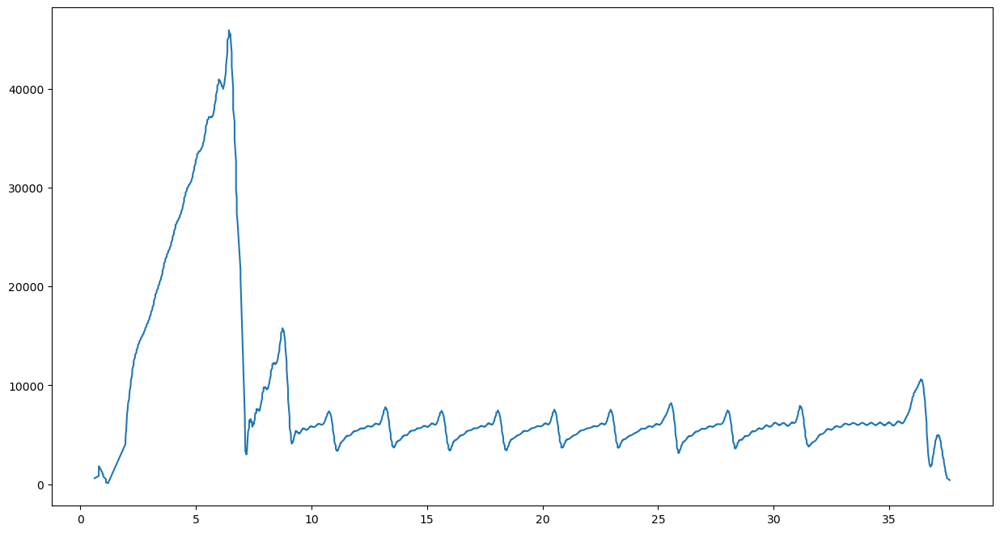

Not BBR, continuing


In [177]:
# import sys
# file=sys.argv[1]
classi = checkBBR([file],p="y")
if classi[0] == "YES BBR":
    print("This is BBR")
elif classi[0] == "MAYBE BBR":
    print("This is maybe BBR")
elif "NC" in classi[0]:
    print("Not Classified with error", classi[0])
else:
    print("Not BBR, continuing")
    

In [158]:
import pickle
with open('cc_gp.txt', 'rb') as f:
    cc_gp = pickle.load(f)

../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35292'])
Port 35292


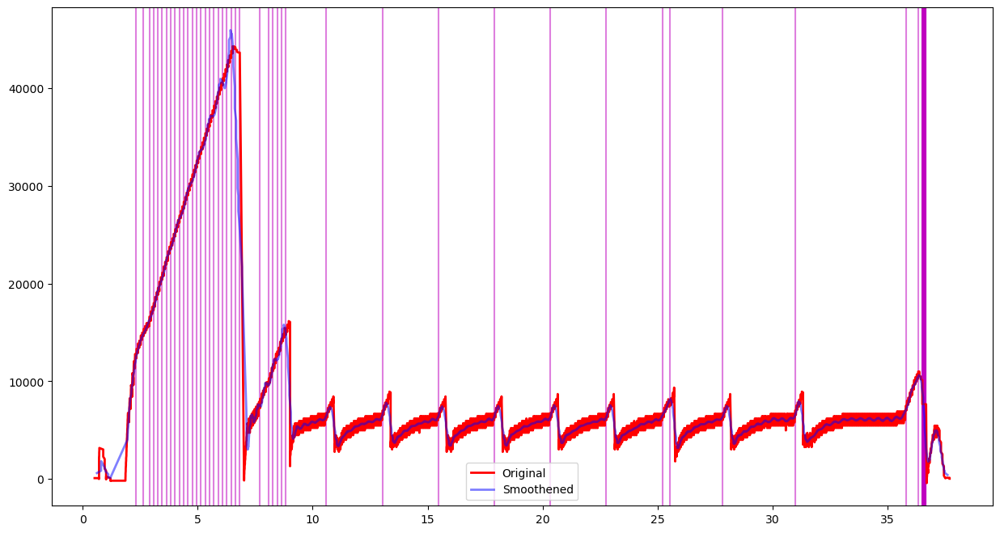

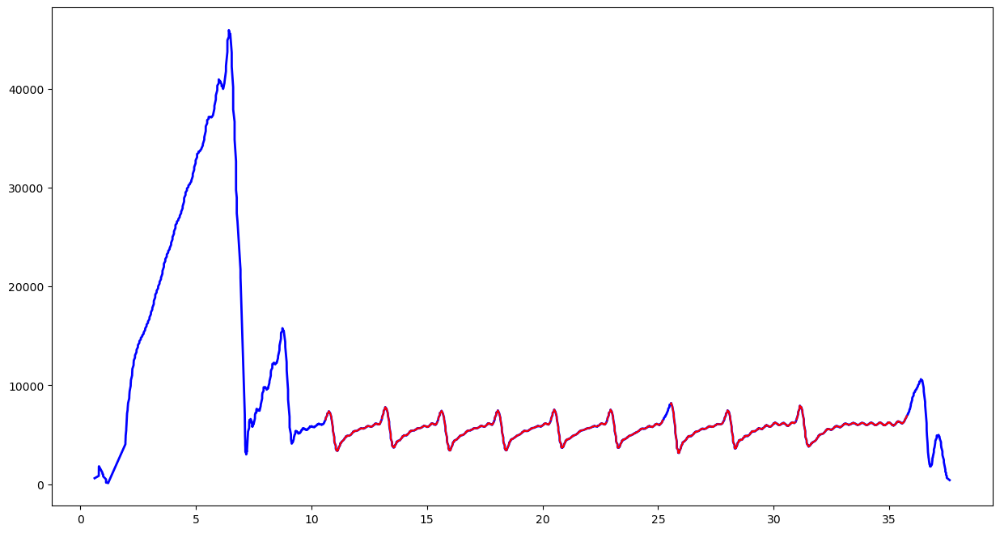

Feature Length  203


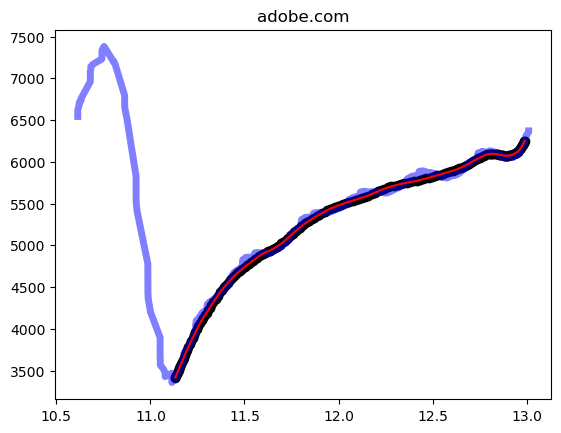

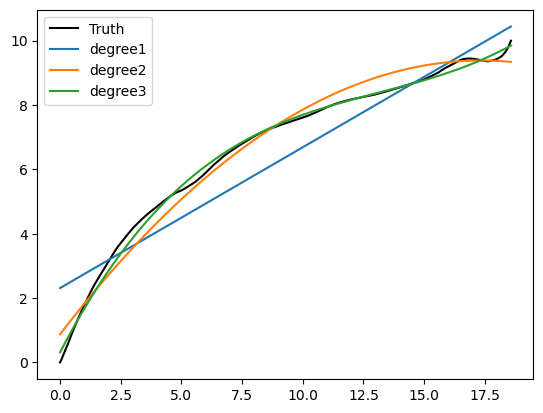

In [178]:
mp = get_feature_degree_R([file],ss=225,p="y",ft_thresh=1,max_deg=3)

adobe.com
loss [0.24739024565611994, 0.3289630402900742, 0.4511709484561186]
mse [0.8221061980116983, 0.13834436672291828, 0.026200319340292617]


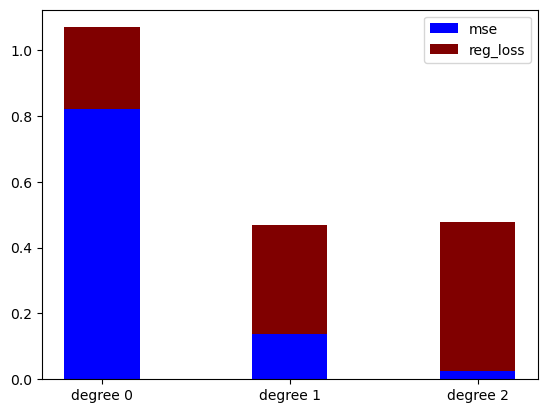

In [179]:
cc_mp = getBestDegree(mp)

In [185]:
cc_gp['westwood']

{'mean': array([-0.00185115,  0.24006152]),
 'covar': array([[ 1.18759298e-07, -6.26187536e-06],
        [-6.26187536e-06,  3.49456003e-04]])}

/tmp/ipykernel_82468/1923409484.py:33: RuntimeWarning: invalid value encountered in true_divide
  acc_w[web]['relative'] = (acc_w[web]['density']-minn)/(maxx-minn)


../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35292'])
Port 35292


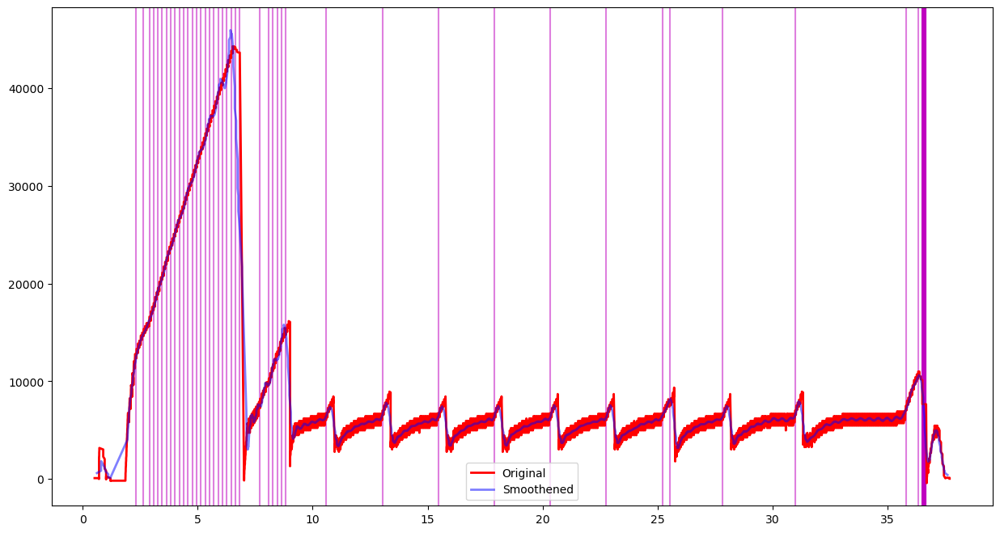

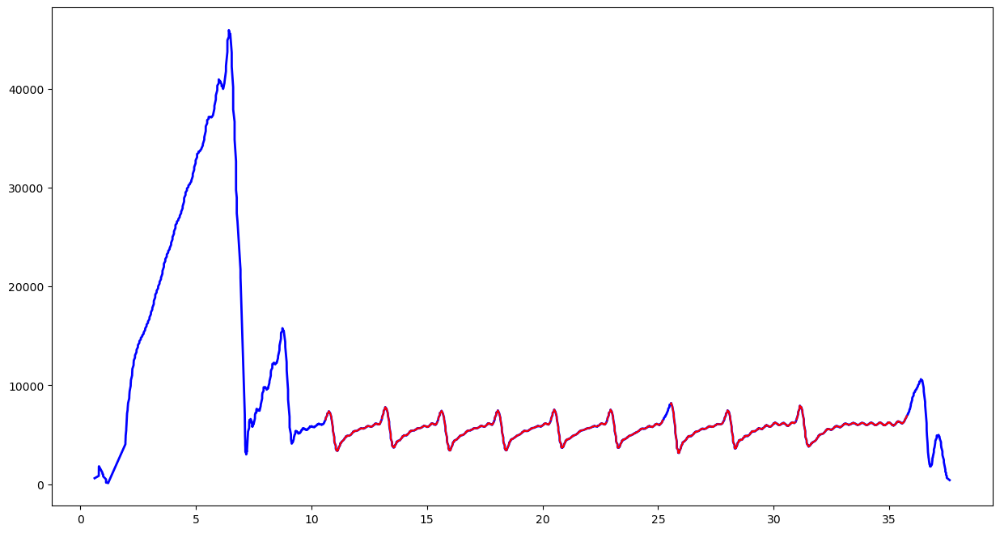

Feature Length  203


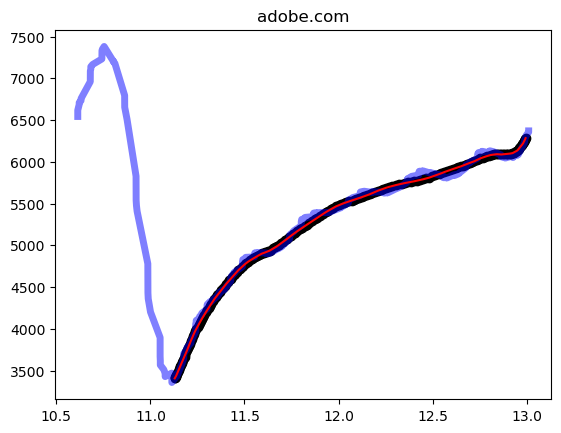

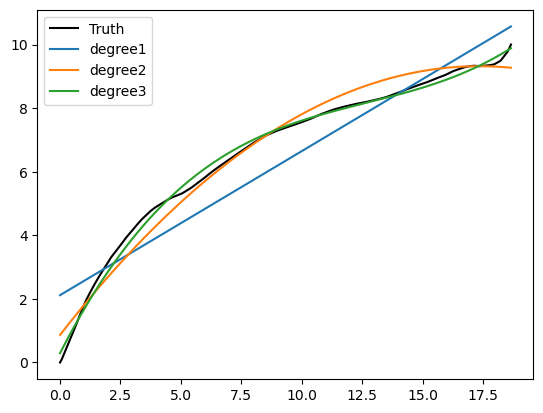

[-0.0282681   0.98086288  0.87497766]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new


In [186]:
predictions_1 = getPredictions(cc_mp,cc_gp,[file])

# Running the same on all files

In [120]:
import os
path = "../../singapore/top1k/"
files = []
for f in os.listdir(path):
    if "-udp.csv" in f:
        continue
    if "1000-2" in f:
        continue
    files.append(path+f)

In [121]:
files[0:5]

['../../singapore/top1k/haber7.com-0-50-200-2-tcp.csv',
 '../../singapore/top1k/4chan.org-0-50-200-2-tcp.csv',
 '../../singapore/top1k/ebay.de-0-50-200-2-tcp.csv',
 '../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv',
 '../../singapore/top1k/convert2mp3.net-0-50-200-2-tcp.csv']

In [128]:
classi = checkBBR(files)
yes,no,maybe,nan = getDivision(classi,files)


Reading ../../singapore/top1k/haber7.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/4chan.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/ebay.de-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51022'])
Port 51022
Reading ../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60240', '48916'])
Port 48916
Reading ../../singapore/top1k/convert2mp3.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/msn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53912'])
Port 53912
Reading ../../singapore/top1k/mit.edu-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/rarbgprx.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/bukalapak.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45270'])
Port 45270
Reading ../../singapore/top1k/t.co-0-50-200-2-tcp.csv...
All Ports :  d

Reading ../../singapore/top1k/ninisite.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/thestartmagazine.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39222', '51040', '52034', '55942', '54968', '33400', '49510', '42632', '49964', '46574', '57990', '57054', '51260', '59648', '32870', '58586', '41838', '37462', '44298', '58646'])
Port 39222
Reading ../../singapore/top1k/google.co.nz-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/albawabhnews.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/nsportal.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/echo.msk.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/facebook.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37012'])
Port 37012
Reading ../../singapore/top1k/bloomberg.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Read

Reading ../../singapore/top1k/worldofwarcraft.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/roblox.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51500', '39680'])
Port 39680
Reading ../../singapore/top1k/youjizz.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/trustpilot.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/tribunnews.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48598', '33694'])
Port 33694
Reading ../../singapore/top1k/nih.gov-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45490'])
Port 45490
Reading ../../singapore/top1k/4399.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/rotumal.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/imdb.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54846'])
Port 54846
Reading ../../singapore/top1k/rednet.cn-0-50-200-2-tc

All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/jrj.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/giphy.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/constintptr.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/telegraph.co.uk-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/lowes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/n11.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/naukri.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/goo.ne.jp-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/heraldweekly.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/oload.cloud-0-50-200-2-tcp.csv...
All Ports :  dict_k

Reading ../../singapore/top1k/yjc.ir-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/usbank.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/flipkart.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49932'])
Port 49932
Reading ../../singapore/top1k/cnblogs.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['47732'])
Port 47732
Reading ../../singapore/top1k/bing.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50486'])
Port 50486
Reading ../../singapore/top1k/kissanime.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/huffingtonpost.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/usaa.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/pandora.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/elmundo.es-0-50-200-2-tcp.csv...
All Ports :  dict_keys([]

All Ports :  dict_keys(['43380'])
Port 43380
Reading ../../singapore/top1k/f5v1x3kgv5.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/playstation.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/drom.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/irctc.co.in-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/nbcsports.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/xhamsterlive.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/hh.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/dnevnik.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/buzzfeed.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/repubblica.it-0-50-200-2-tcp.csv...
All

All Ports :  dict_keys(['55800', '55804'])
Port 55804
Reading ../../singapore/top1k/nba.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/cryptobrowser.site-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/rutube.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/tripadvisor.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/doodle.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/hotstar.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/elsevier.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/google.com.sa-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36176'])
Port 36176
Reading ../../singapore/top1k/nga.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/51sole.com-0-50-200-2

Reading ../../singapore/top1k/caliente.mx-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/imgur.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42146'])
Port 42146
Reading ../../singapore/top1k/freepik.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34924'])
Port 34924
Reading ../../singapore/top1k/zimuzu.tv-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/banesconline.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/yandex.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46726', '54420', '50548', '40390'])
Port 50548
Reading ../../singapore/top1k/ecosia.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/naver.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44438'])
Port 44438
Reading ../../singapore/top1k/interia.pl-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/cbc.ca-0-50-200-2-tcp.

Reading ../../singapore/top1k/9gag.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/google.com.tw-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57864'])
Port 57864
Reading ../../singapore/top1k/porn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/glassdoor.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/prezi.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/badoo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/verizonwireless.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/memurlar.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/google.lt-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/scol.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading 

All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/porn555.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52372'])
Port 52372
Reading ../../singapore/top1k/nature.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/cdstm.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/microsoftonline.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/lefigaro.fr-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/amazon.es-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['32930'])
Port 32930
Reading ../../singapore/top1k/zougla.gr-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/utorrent.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/newegg.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/rambler.ru-0-50-200-2-tcp.csv...

All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/google.nl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45224', '39554'])
Port 39554
Reading ../../singapore/top1k/auction.co.kr-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/google.com.br-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46450'])
Port 46450
Reading ../../singapore/top1k/europa.eu-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/bitmedianetwork.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/yandex.kz-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/hepsiburada.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/openload.co-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56654'])
Port 56654
Reading ../../singapore/top1k/study.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/3dmg

All Ports :  dict_keys(['34598', '34608', '53812', '42312', '51436', '51440', '54498', '59904', '45838', '58830', '39382', '46858', '56580', '51818', '40722', '35970', '35282', '39938', '50914', '47384'])
Port 50914
Reading ../../singapore/top1k/web.de-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/vox.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/vk.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51308', '47882'])
Port 47882
Reading ../../singapore/top1k/google.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46254'])
Port 46254
Reading ../../singapore/top1k/hdzog.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/tistory.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/westernjournal.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../singapore/top1k/thehill.com-0-50-200-2-tcp.csv...
All Ports :  d

In [130]:
print(len(yes),len(no),len(maybe),len(nan))

40 216 13 730


In [ ]:
# Look at yes
classi_y = checkBBR(yes,p="y")

In [ ]:
# Look at maybe
classi_m = checkBBR(maybe,p="y")

In [131]:
no[0:5]

['../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv',
 '../../singapore/top1k/msn.com-0-50-200-2-tcp.csv',
 '../../singapore/top1k/bukalapak.com-0-50-200-2-tcp.csv',
 '../../singapore/top1k/t.co-0-50-200-2-tcp.csv',
 '../../singapore/top1k/google.co.id-0-50-200-2-tcp.csv']

In [187]:
mp = get_feature_degree_R(no,ss=225,p="n",ft_thresh=1,max_deg=3)

../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60240', '48916'])
Port 48916
Feature Length  203
../../singapore/top1k/msn.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/msn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53912'])
Port 53912
../../singapore/top1k/bukalapak.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bukalapak.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45270'])
Port 45270
Feature Length  203
../../singapore/top1k/t.co-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/t.co-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51734'])
Port 51734
Feature Length  203
../../singapore/top1k/google.co.id-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.id-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60270', '40816'])
Port 40816
../../singapore/top1k/yao.tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yao.tmall.com-0-50-200-2-tcp.csv...
All

Feature Length  203
../../singapore/top1k/vice.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/vice.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['58146', '58158'])
Port 58158
Feature Length  203
../../singapore/top1k/fbcdn.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/fbcdn.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55748'])
Port 55748
../../singapore/top1k/detik.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/detik.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42468'])
Port 42468
../../singapore/top1k/softonic.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/softonic.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53630', '58054', '49358'])
Port 49358
Feature Length  203
../../singapore/top1k/forbes.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/forbes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38084'])
Port 38084
Feature Length  203
../../singapore/top1k/livejournal.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/livejourna

All Ports :  dict_keys(['43720'])
Port 43720
../../singapore/top1k/amazon.de-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/amazon.de-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38076'])
Port 38076
../../singapore/top1k/doubleclick.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/doubleclick.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43380'])
Port 43380
Feature Length  203
../../singapore/top1k/wikia.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/wikia.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44066'])
Port 44066
Feature Length  203
../../singapore/top1k/amazon.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/amazon.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43768'])
Port 43768
Feature Length  203
../../singapore/top1k/walmart.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/walmart.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54712'])
Port 54712
Feature Length  203
../../singapore/top1k/google.it-0-50-200-2-tcp.csv
Reading ../../si

All Ports :  dict_keys(['50424'])
Port 50424
../../singapore/top1k/mama.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/mama.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34114', '55932'])
Port 55932
../../singapore/top1k/instructure.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/instructure.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44204'])
Port 44204
Feature Length  203
../../singapore/top1k/yelp.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yelp.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59674'])
Port 59674
Feature Length  203
../../singapore/top1k/google.ch-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.ch-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50480'])
Port 50480
../../singapore/top1k/google.com.tw-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.tw-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57864'])
Port 57864
../../singapore/top1k/onlinevideoconverter.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/online

All Ports :  dict_keys(['46234'])
Port 46234
Feature Length  203
../../singapore/top1k/google.com.eg-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.eg-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43794'])
Port 43794
../../singapore/top1k/tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48550'])
Port 48550
Feature Length  203
../../singapore/top1k/indeed.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/indeed.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50092'])
Port 50092
../../singapore/top1k/xinhuanet.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/xinhuanet.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52786'])
Port 52786
../../singapore/top1k/detail.tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/detail.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56310'])
Port 56310
Feature Length  203
../../singapore/top1k/digikala.com-0-50-200-2-tcp.csv
Reading ../../singa

/tmp/ipykernel_82468/1487916734.py:207: RankWarning: Polyfit may be poorly conditioned
  max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)


google.com.ar
loss [0.05559478291993672, 0.28664719171083175, 0.389858184177575]
mse [1.1850228900554638, 0.2928508637661837, 0.20901742781770374]


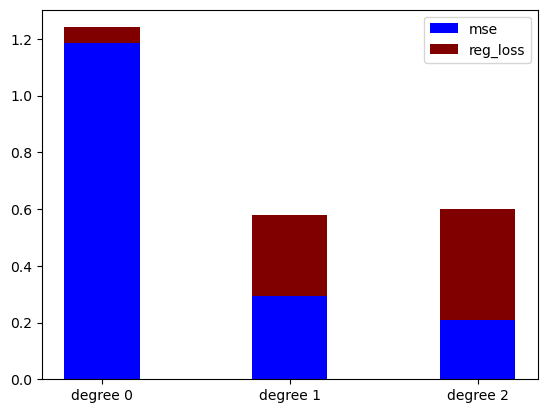

bukalapak.com
loss [0.27074937388495846, 0.4113421696428522, 0.5848410052921507]
mse [0.9048298613386581, 0.23841389754057207, 0.09925978627348697]


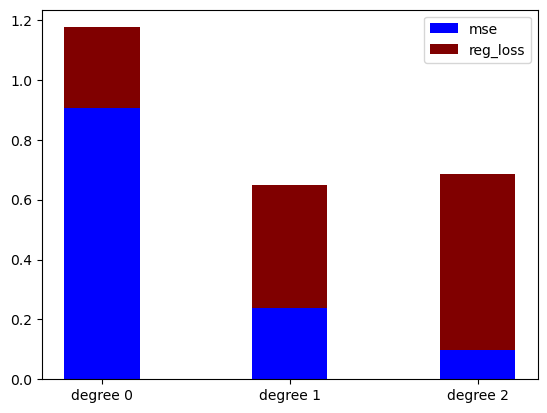

t.co
loss [0.1215263132428573, 0.36299592772673833, 0.24774498826234062]
mse [0.8981499860126906, 0.7164964401607238, 0.03480737792718683]


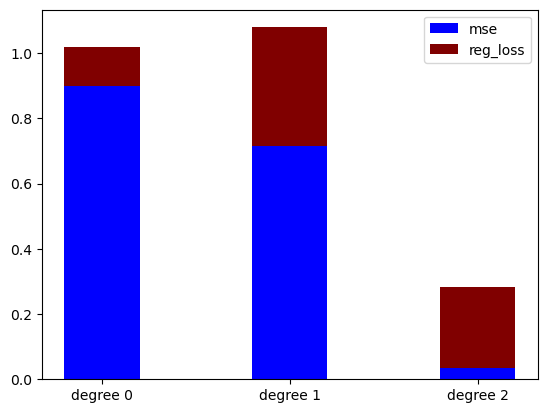

yao.tmall.com
loss [0.18249194173742628, 0.4484599647861044, 0.49189966160068116]
mse [0.5551137264025789, 0.4321188427629704, 0.12790373994844592]


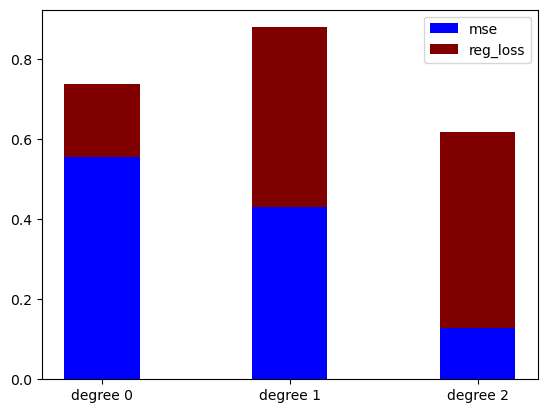

huanqiu.com
loss [0.15919130510947294, 0.34205094167475325, 0.22291281097472979]
mse [2.439406348924298, 2.426992610275227, 0.3635663358764774]


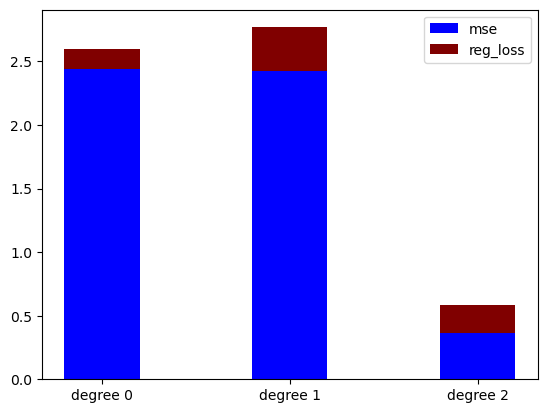

adobe.com
loss [0.23083828196626632, 0.31934350180564486, 0.44665656498765166]
mse [0.7990258515776968, 0.14074284598589043, 0.019929218376232877]


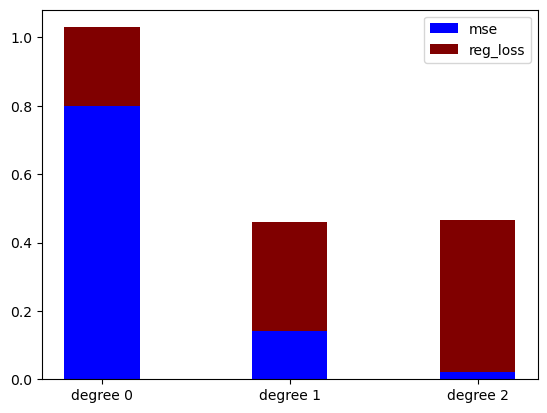

login.tmall.com
loss [0.18639967407490737, 0.36947114008400345, 0.3646486714727931]
mse [0.847910720208095, 0.8475864735149065, 0.18127436556250776]


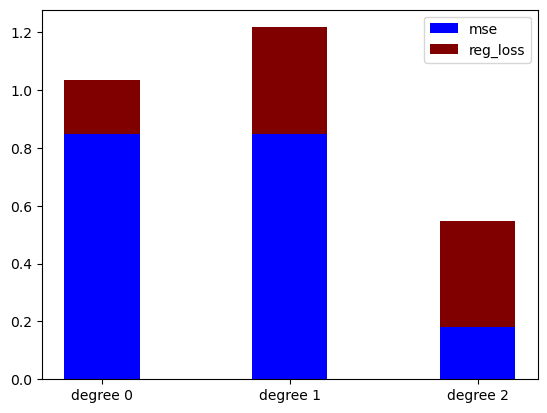

sina.com.cn
loss [0.6479568260124696, 1.2959136520249444, 1.9438704780374292]
mse [4.581999474611305e-28, 4.185470574272625e-28, 3.82170077457933e-28]


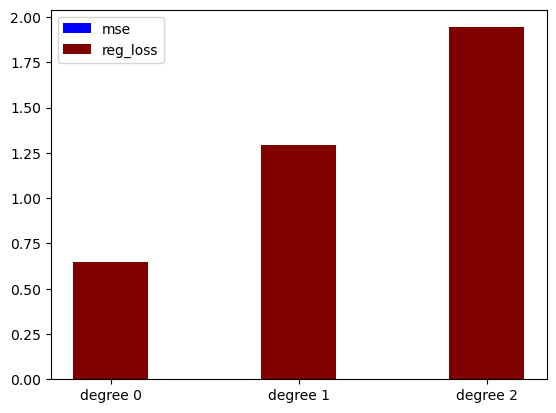

yahoo.com
loss [0.3410307322235001, 0.5374622204361305, 0.6856046523524963]
mse [1.634859410872428, 0.879701021941769, 0.17542624344481125]


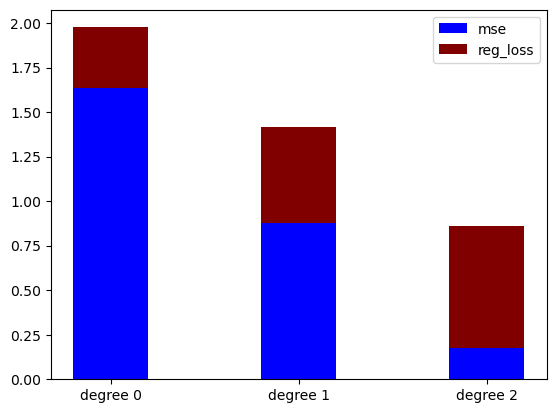

w3schools.com
loss [0.13602915218691444, 0.3778484710322393, 0.47761003906021077]
mse [0.5875022211417249, 0.4066767576767508, 0.2998517948840136]


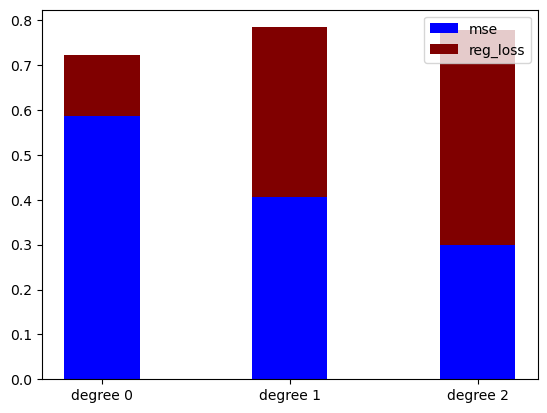

so.com
loss [0.0766789593445255, 0.18491245506700413, 0.2713208093051182]
mse [0.3117877970451498, 0.2765321999598511, 0.2582604513608163]


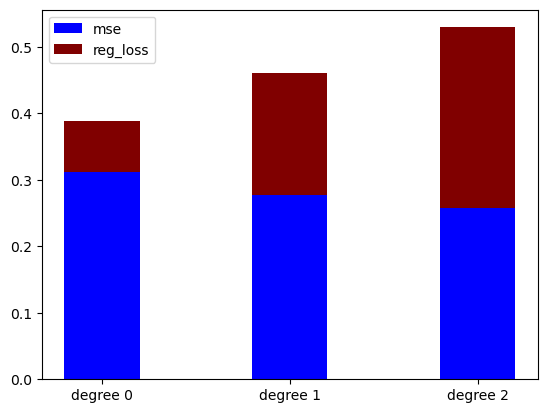

fc2.com
loss [0.0041679518461393145, 0.26549698209091444, 0.15061947675919024]
mse [1.5792105521236217, 0.6756620766674761, 0.1369071381835575]


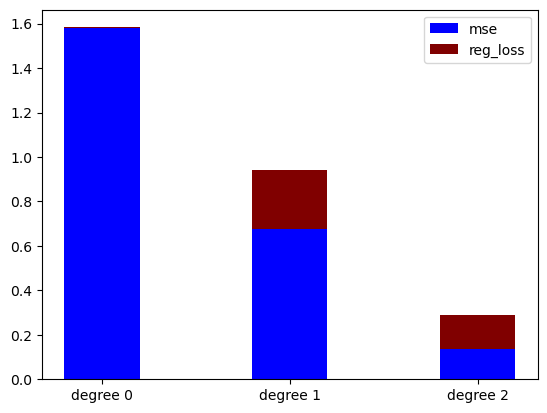

livejasmin.com
loss [0.27557862927878835, 0.4058980306331067, 0.3697494994633772]
mse [1.3628384372576479, 0.9817598296044612, 0.03879123965351754]


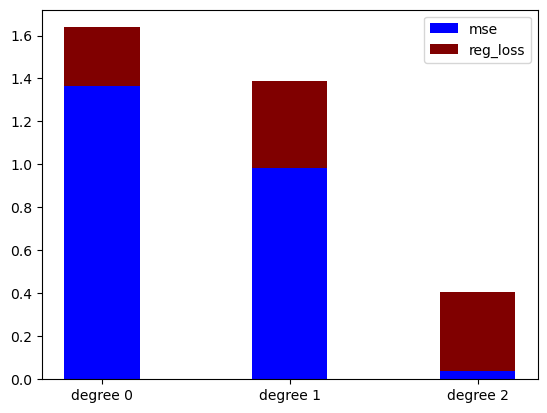

google.com
loss [-0.043269697695274556, 0.1712898641643268, 0.19282888238878657]
mse [1.291116180626604, 0.07914868051840074, 0.02890461437436209]


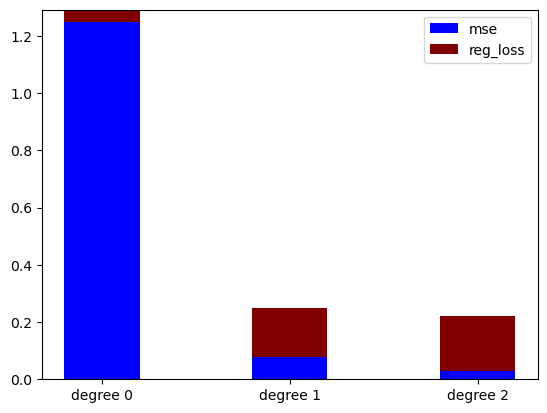

iqiyi.com
loss [0.6378689744575016, 0.9497418665223997, 1.0950153118337012]
mse [2.8017334909293345, 1.5975692793668415, 0.8112025326900035]


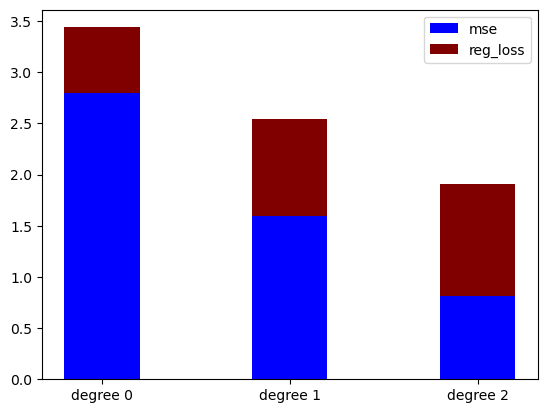

xhamster.com
loss [5.5907594735676856e-05, 0.0045227996878126845, 0.010110674355697605]
mse [0.560266449730268, 0.08350009005785591, 0.08226006261844081]


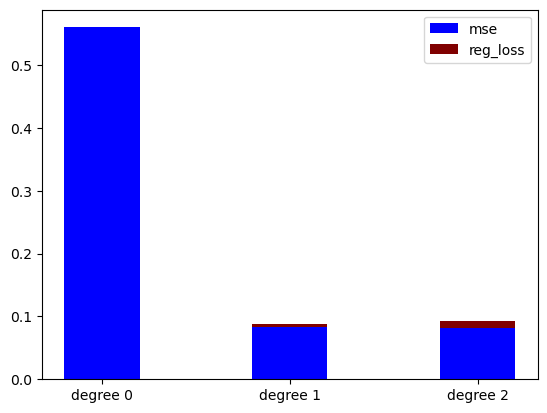

pixnet.net
loss [0.05321433254362753, 0.09711849101859707, 0.1453906537426478]
mse [0.025060449544907458, 0.023768262259427457, 0.02376750035193868]


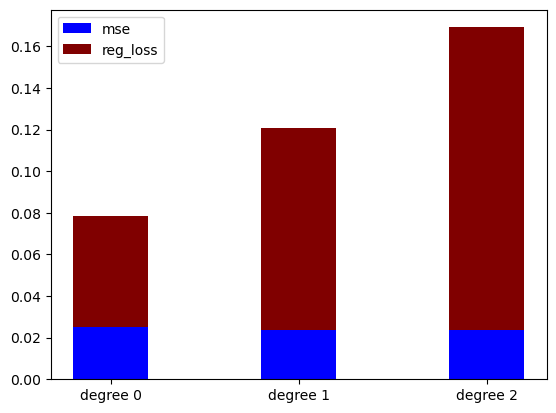

blackboard.com
loss [0.1357340410093462, 0.4769661420598937, 0.4774364005262039]
mse [1.1923226006460892, 0.5781831066049555, 0.15011660655059536]


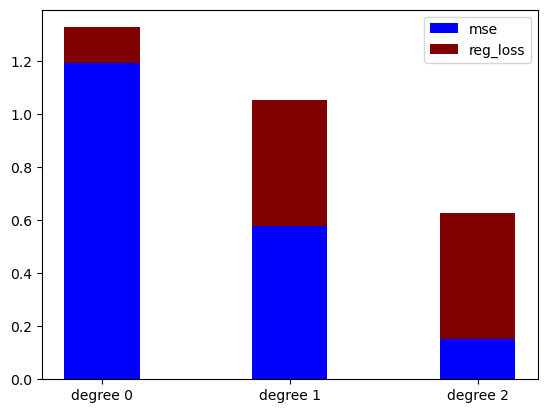

crptentry.com
loss [0.20280427568050002, 0.38855128128704214, 0.3612167265537192]
mse [0.6355219990049524, 0.6302976633016076, 0.045692385008939365]


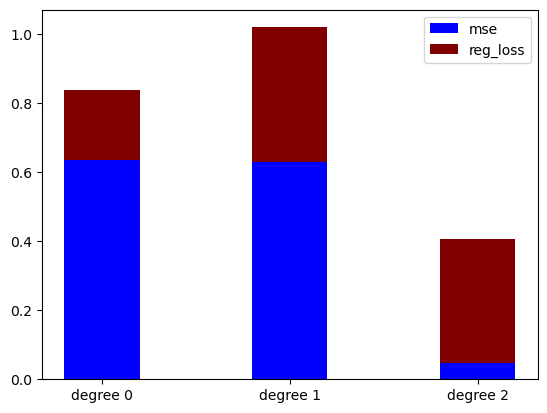

1688.com
loss [0.3851921112848169, 0.8846941879553304, 1.0214506943033332]
mse [3.9029571684374234, 3.700253610632311, 2.9867272122459165]


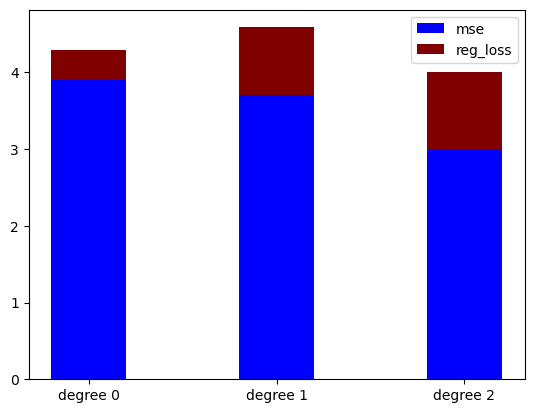

dailymotion.com
loss [-0.02701327013604406, 0.12152810412517413, 0.0031863039888978526]
mse [1.6066894133688658, 0.8930265751832384, 0.24161873966345973]


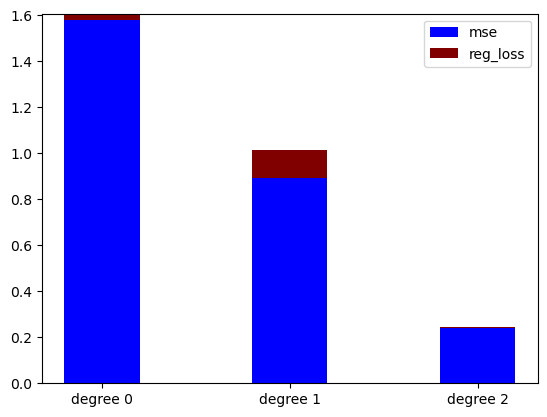

liputan6.com
loss [0.11490693244268206, 0.4198898318534336, 0.34718252715071096]
mse [1.576661059556456, 0.9680085110688301, 0.09138172348603363]


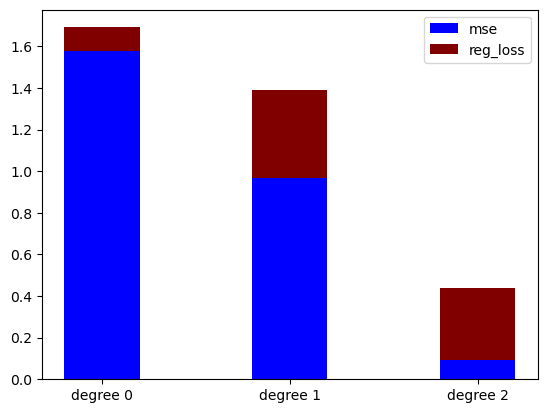

vice.com
loss [0.26125631774591906, 0.5124271411501777, 0.5167532713251548]
mse [0.813548883282835, 0.8116941389314858, 0.21168170944003917]


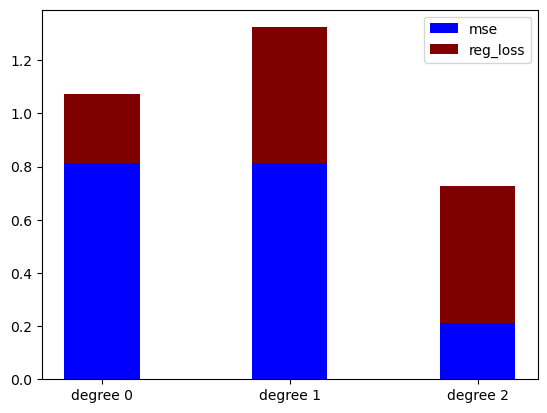

softonic.com
loss [0.42545461541667995, 0.7781057851756111, 0.9878820938411652]
mse [1.2940050720210154, 1.1851501791510226, 0.7410581761328441]


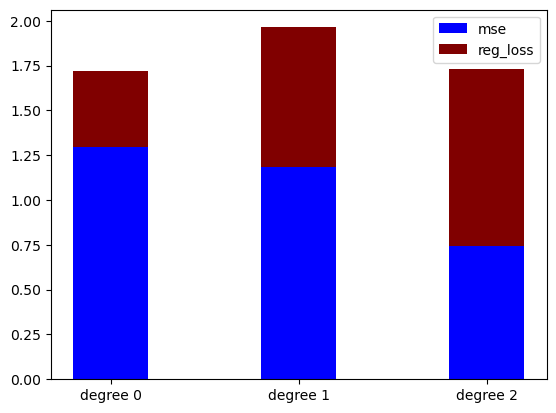

forbes.com
loss [0.3780398325424271, 0.5830041803257832, 0.5716757611292339]
mse [1.3148551366849588, 0.9038996434528365, 0.06943798979287474]


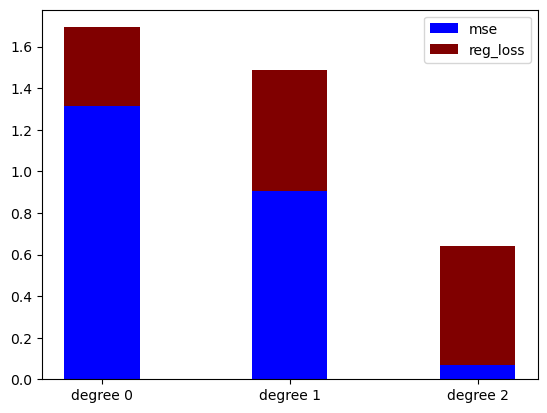

livejournal.com
loss [-0.06886069134093577, 0.2494787403289198, 0.1669065072867428]
mse [2.641271746015357, 0.5531618901089869, 0.18862507544064017]


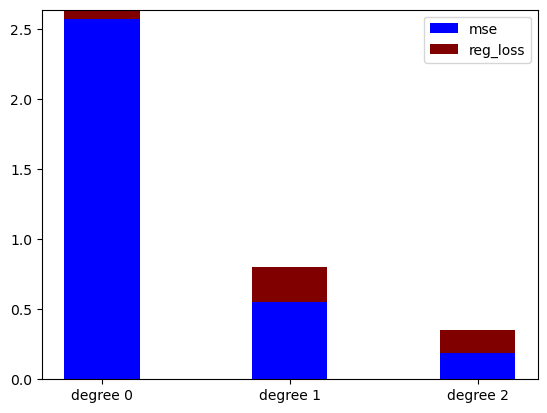

twitter.com
loss [0.1352330535679543, 0.28193373312058195, 0.2128479747533319]
mse [0.7683077968697938, 0.7656644164400714, 0.019066832869590482]


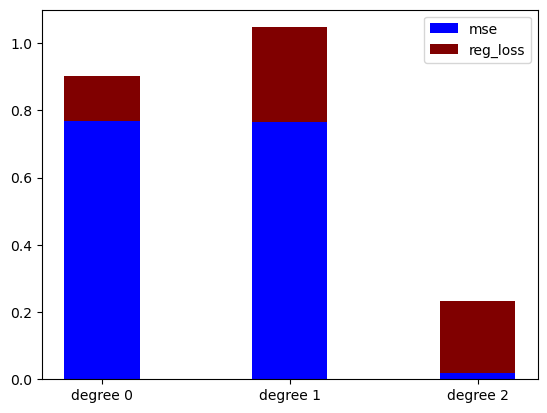

blogger.com
loss [-0.10448332256350118, 0.073067681511737, 0.06669969887349941]
mse [2.394312726967946, 0.14792457497243053, 0.07027808557667095]


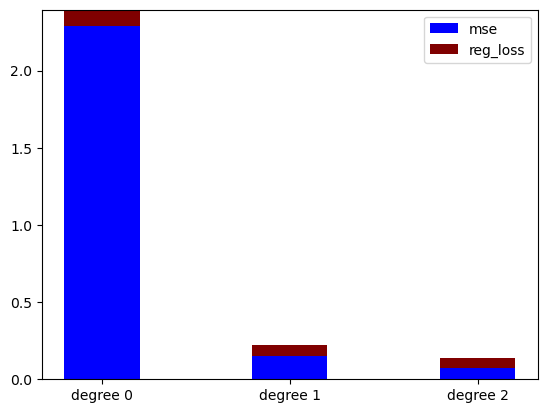

aliexpress.com
loss [0.15538007347627097, 0.37311749464960775, 0.36659983436064286]
mse [0.6375369414544557, 0.5545151718137462, 0.07087367304974582]


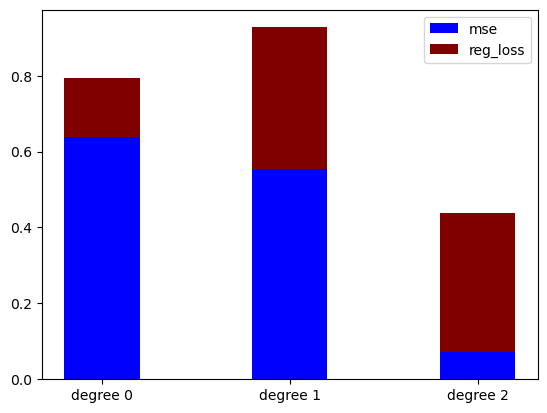

dkn.tv
loss [0.00236895997244684, 0.0396746428263235, 0.11422723650447385]
mse [0.02536037769945901, 0.011099839804294211, 0.004478133347046753]


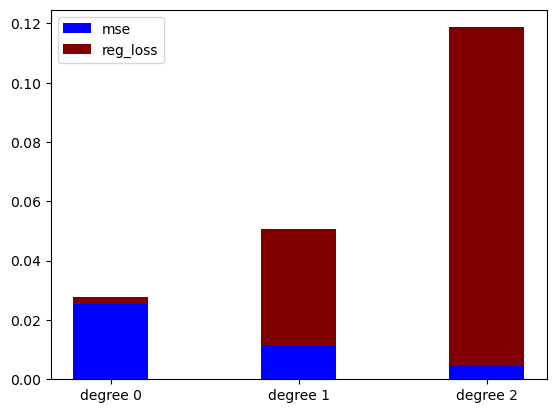

cnet.com
loss [0.13234103709321357, 0.3038687815748602, 0.21990643239401764]
mse [0.7486817560710693, 0.7218274736822012, 0.06647789749805456]


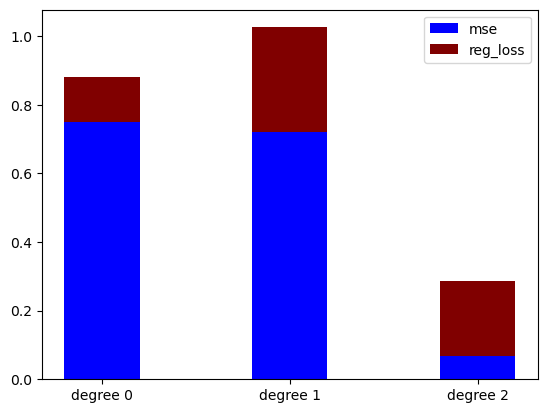

paypal.com
loss [-0.04246850272558028, 0.04314019244337285, 0.06313608160740254]
mse [0.361446581621476, 0.014602447157719477, 0.0073213469911475385]


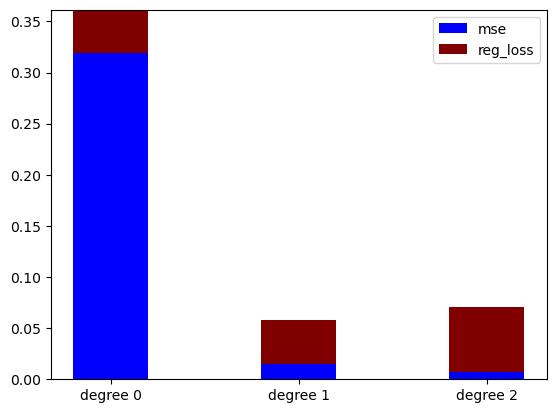

pinterest.com
loss [-0.07921762429043669, -0.2937219825523789, 0.019109273158092865]
mse [0.7611945620877808, 0.638537239067686, 0.15886224592374745]


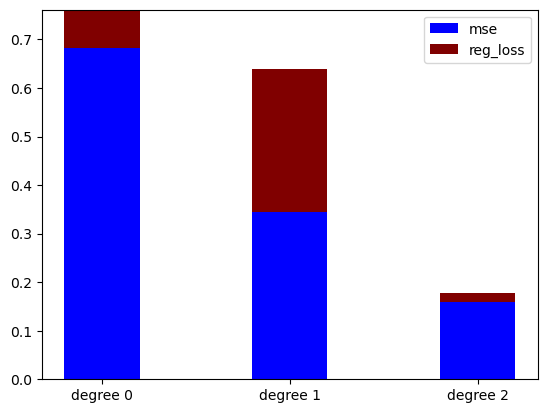

diply.com
loss [0.5244978751613578, 0.8285110666503247, 1.2135694717828303]
mse [4.651327432674688, 2.0730688411165388, 0.5230215247888315]


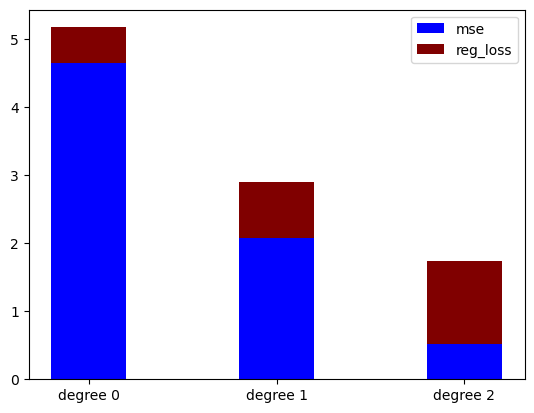

flipkart.com
loss [0.16567565864918074, 0.23769012549043594, 0.3218092864111176]
mse [0.3183337141653764, 0.07907252457622951, 0.029950926023837348]


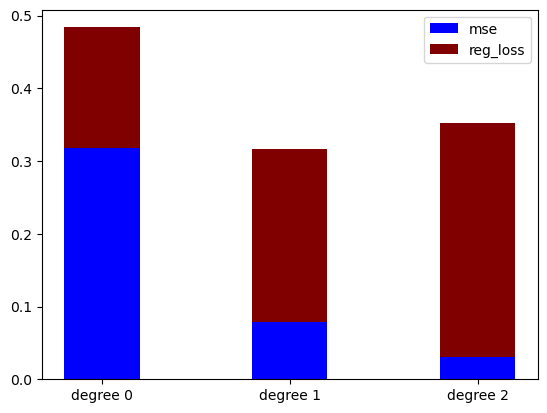

cnblogs.com
loss [0.6765346039147123, 1.3530692078294462, 2.047741329670752]
mse [6.503885446813566e-23, 6.503823685816894e-23, 6.503958618821022e-23]


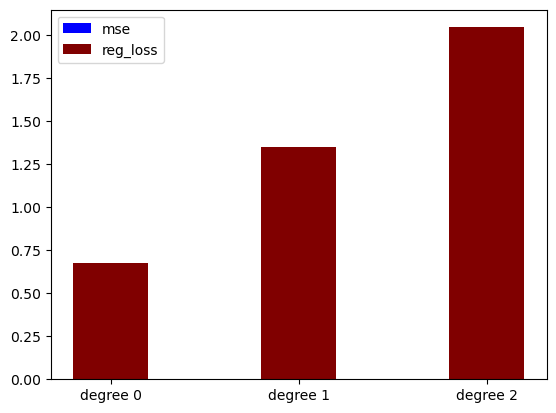

bongacams.com
loss [0.15325184843491077, 0.3441983657908364, 0.4182813260706469]
mse [0.3860820768968634, 0.35710974694495656, 0.12169469648130314]


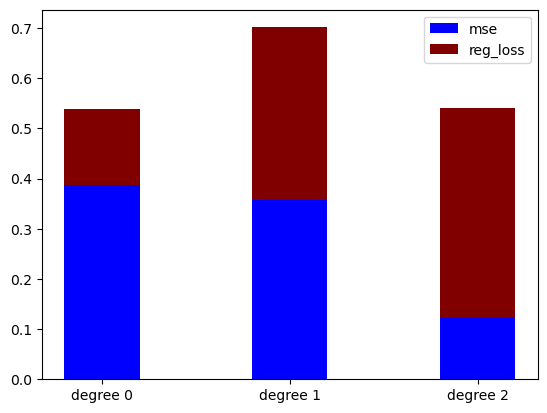

eastday.com
loss [0.07837978425695158, 0.23216279192712272, 0.1921396352596077]
mse [0.5280432913209858, 0.4148530946157864, 0.10841210736453111]


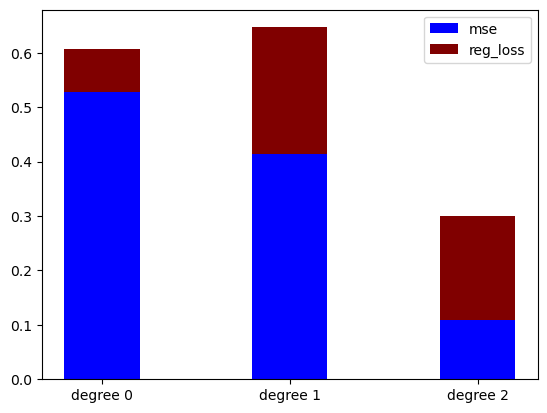

spotify.com
loss [-0.15669936925839748, 0.15054468758480144, -0.015742468048296068]
mse [4.007739724923443, 0.7758436596215262, 0.0915542384343726]


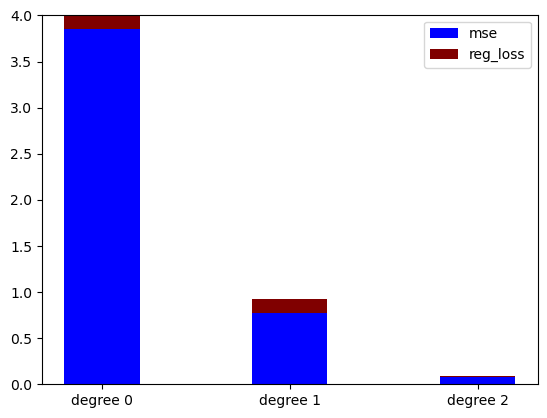

instagram.com
loss [0.5498447701027583, 0.9205843209528582, 1.1063325931580266]
mse [3.3606513367548705, 2.7065430720872903, 1.5398873816269851]


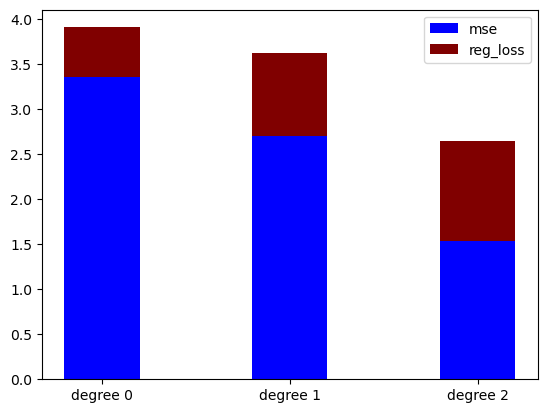

nytimes.com
loss [0.20056801234014632, 0.2891147406725214, 0.4117306861339723]
mse [0.8225819326363172, 0.2748008931924001, 0.013014443941502717]


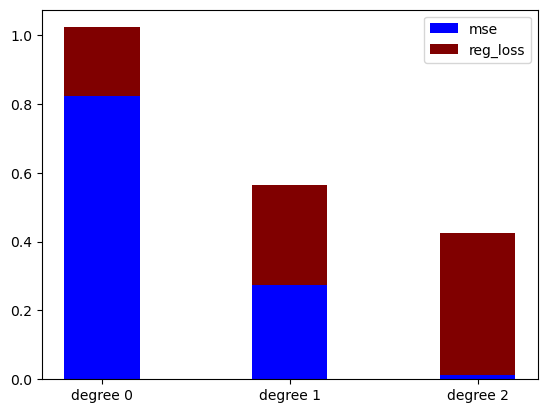

doubleclick.net
loss [-0.06237331291957951, 0.20522613438995724, 0.11523869871589375]
mse [2.4078778365976414, 0.49006674063003225, 0.011729761685750628]


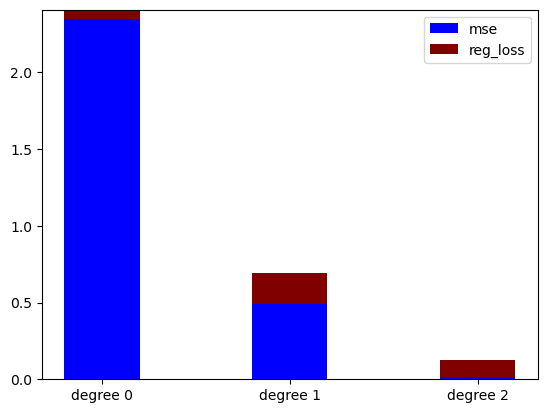

wikia.com
loss [0.1386234177273602, 0.21402254056826642, 0.30671452613099826]
mse [0.3666132886871435, 0.17296064389253657, 0.047541578963933954]


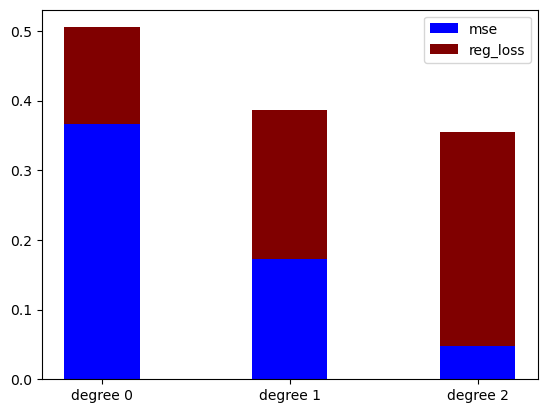

amazon.com
loss [0.3670258543657035, 0.5279827925708004, 0.7665414173360602]
mse [3.4443816492254244, 1.078374242640819, 0.18035873588445098]


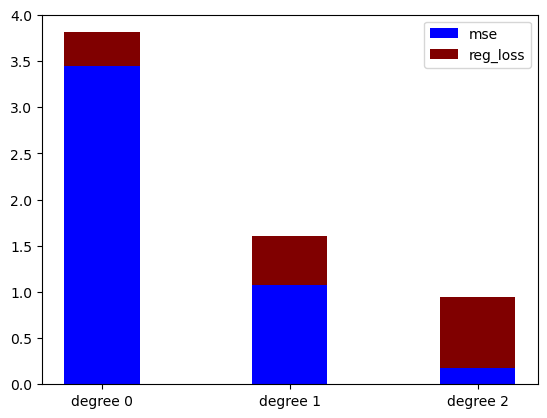

walmart.com
loss [0.32077028457545426, 0.7664644116789961, 0.8648880066122885]
mse [0.9466456732093413, 0.7732068466531737, 0.35982555517140163]


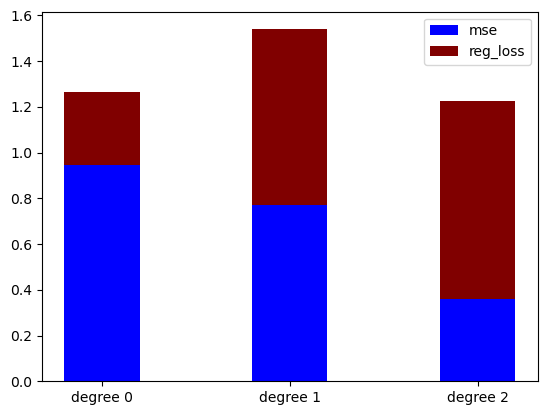

cnn.com
loss [0.18639373390631167, 0.2660042488505602, 0.3674499465374729]
mse [0.8233416517137674, 0.2873698152756294, 0.030572676969091044]


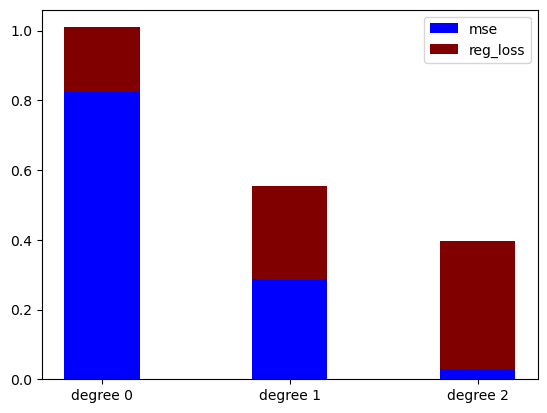

wikihow.com
loss [0.21957899469316935, 0.2978539011901818, 0.41181095997737277]
mse [0.5288295441161253, 0.08163489689958627, 0.021438969649616665]


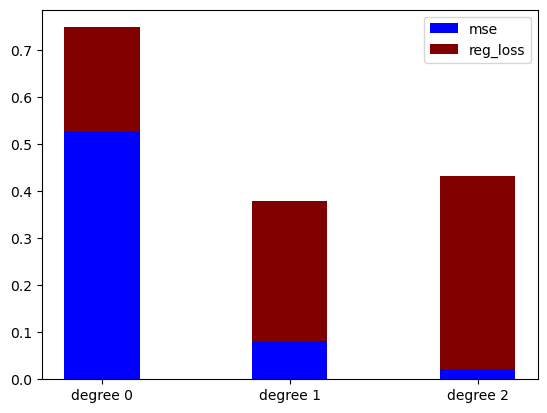

zhanqi.tv
loss [0.17046638511317666, 0.3063052952307215, 0.3620338120758869]
mse [0.43379724501818795, 0.40072944536817134, 0.1102897746290828]


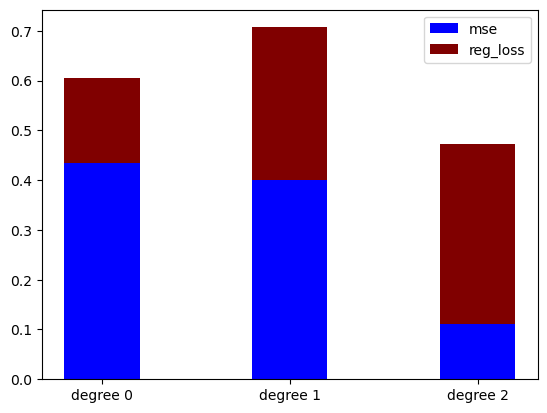

amazonaws.com
loss [0.29661123035737186, 0.35795003588544694, 0.2891914156225607]
mse [1.8189659976784691, 0.7965207333587124, 0.2608787530998294]


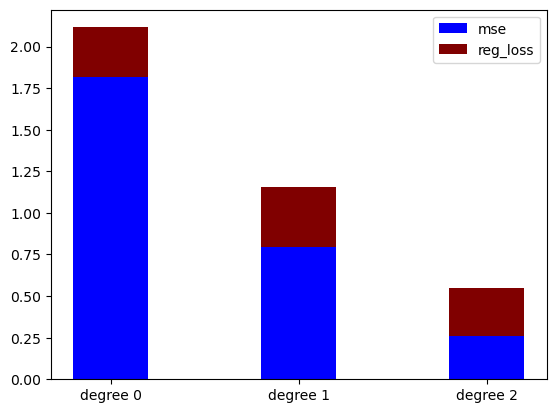

ci123.com
loss [0.6498097720300013, 1.2996195440600038, 1.949429316090008]
mse [2.7562116312976834e-28, 2.656289485055373e-28, 3.1176625406994723e-28]


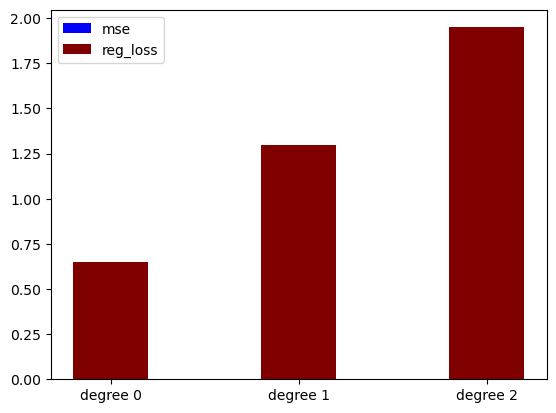

51sole.com
loss [0.13250193578011266, 0.22372584382295618, 0.2693321895583246]
mse [0.704367569316048, 0.6585781719255707, 0.2202851908499215]


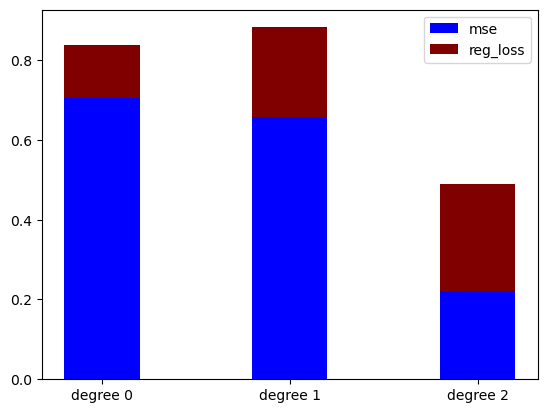

slack.com
loss [0.17505101150128793, 0.2414726201273058, 0.34914187828227833]
mse [0.5325613840394109, 0.05160416845156065, 0.02234840727428409]


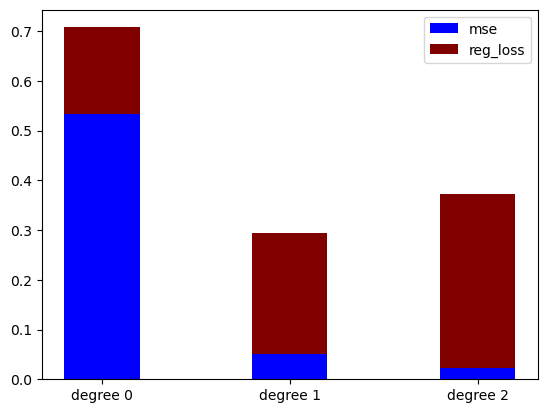

mail.ru
loss [-0.03185227122202048, 0.31352860038318203, 0.16621729825288054]
mse [1.9728807693129609, 0.5702594648177973, 0.08714028869515228]


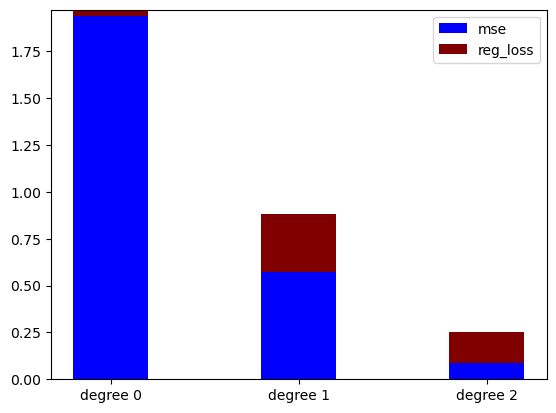

slideshare.net
loss [-0.3034527875658037, 0.12115588890687361, 0.03377239852917514]
mse [0.9068765882718549, 0.08490299562768894, 0.05365723067797471]


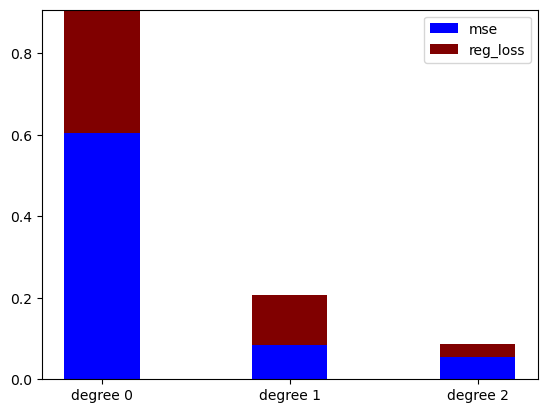

ok.ru
loss [0.20582088503563273, 0.35065336902481237, 0.4973407903650739]
mse [0.8087569933842342, 0.6538119588228645, 0.3561482615802262]


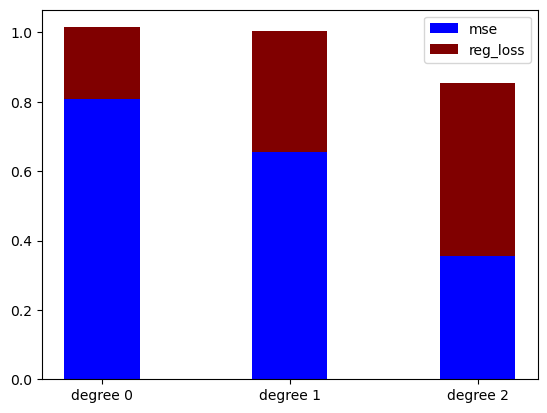

mercadolivre.com.br
loss [-0.048959780487585126, 0.030664341396402155, 0.01793586197619092]
mse [0.6173051996456423, 0.17653713709961746, 0.12645657538938532]


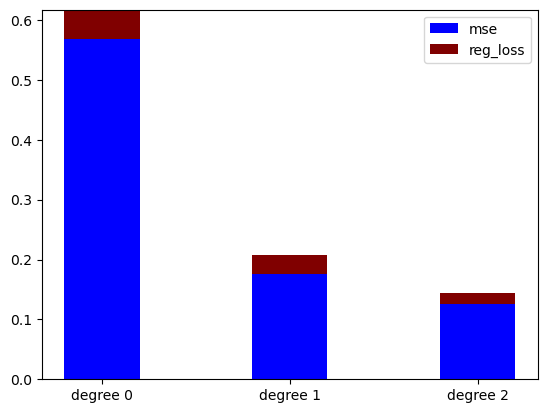

scribd.com
loss [-0.2179316915101568, 0.01327464972815171, 0.017340208699532775]
mse [1.4218698210865242, 0.08936314238469162, 0.08914033098261023]


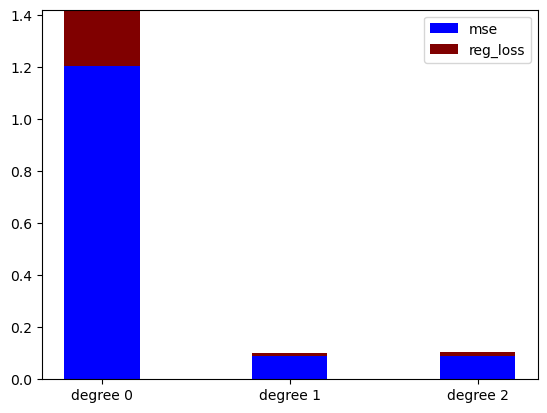

imgur.com
loss [0.26930840838909675, 0.49181149585551764, 0.6939788248225703]
mse [0.869310805734476, 0.7935452576784565, 0.25599368310521853]


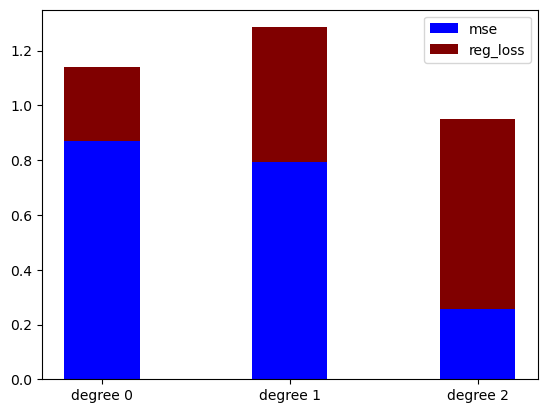

yandex.ru
loss [0.37536087491976317, 0.33960231964741033, 0.48420436453787197]
mse [2.4293423318794702, 0.22824947681667596, 0.06729940540642976]


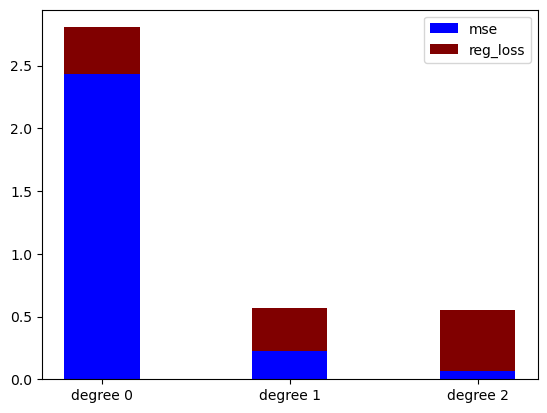

blogspot.com
loss [0.350495591222695, 0.5421779179274837, 0.5844368249803742]
mse [1.5408447379229335, 1.085018548336112, 0.11054929898988426]


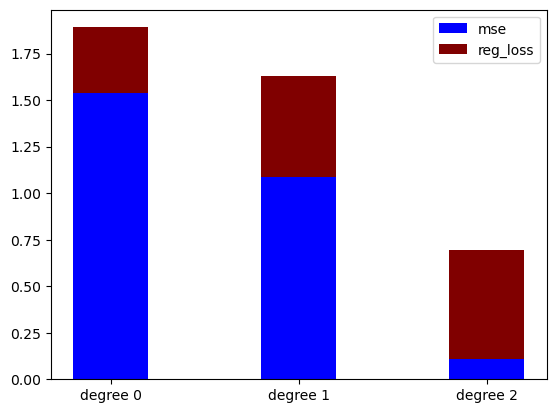

theguardian.com
loss [0.11165903467383041, 0.07119107942404966, 0.1154970717470935]
mse [1.3396561967188925, 0.2616787152460151, 0.2375773505074319]


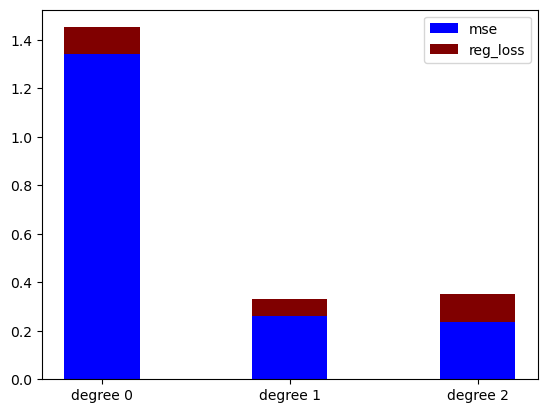

godaddy.com
loss [0.4830846976694101, 0.7746619772362128, 1.1603327664976317]
mse [4.9128520060984435, 2.185079615326358, 0.6706662789355582]


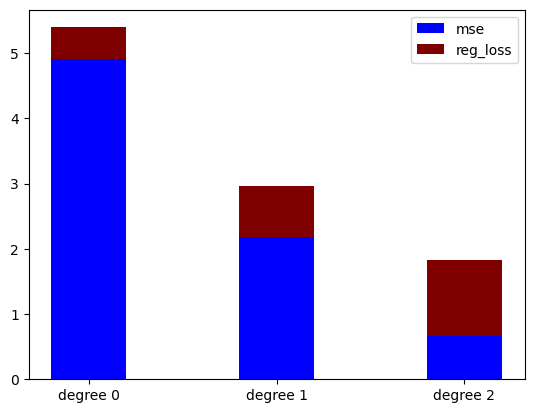

reddit.com
loss [0.24046614617193054, 0.4244034648844541, 0.5948515296859009]
mse [0.48511407492282627, 0.3712894985588734, 0.17802768697663826]


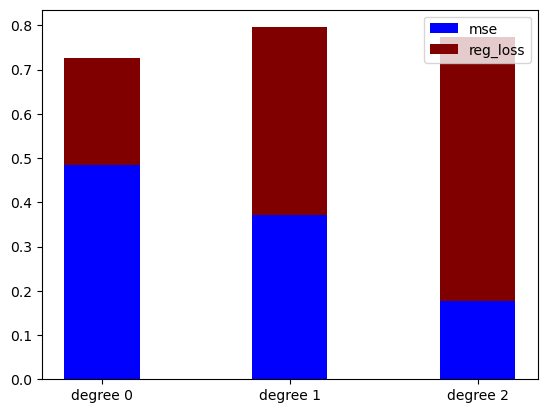

instructure.com
loss [0.02676024134385778, 0.3418047387720972, 0.303571833715123]
mse [1.8287812063771716, 0.5086807741808675, 0.1326843584447168]


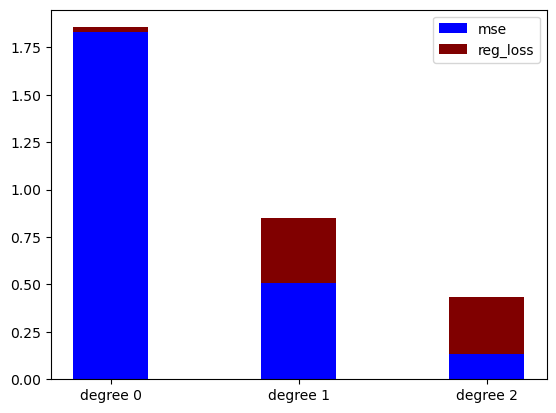

yelp.com
loss [0.12481859372789833, 0.2841450291762084, 0.2272385151019763]
mse [0.47589865133786696, 0.45735901770665505, 0.06644205903505476]


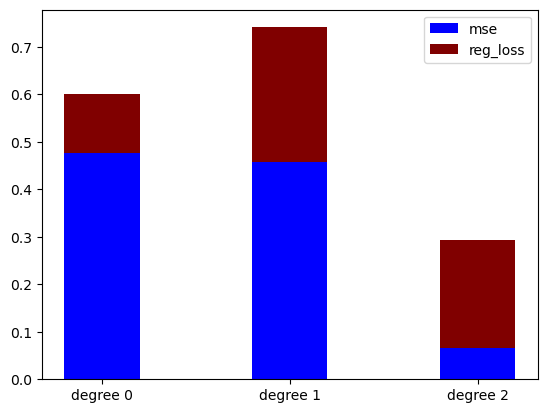

bbc.com
loss [0.2397711849207089, 0.32937347067868206, 0.4298791809596126]
mse [0.9402202017065884, 0.3578312748832287, 0.034372783547386286]


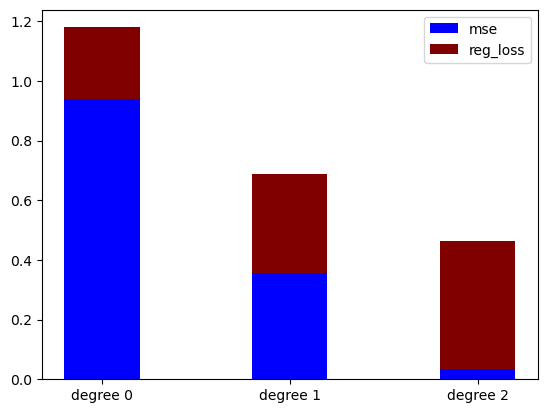

setn.com
loss [0.3525707419831716, 0.5559207000369017, 0.8277416364441073]
mse [0.5911917597070883, 0.31536653960209166, 0.3151286324396687]


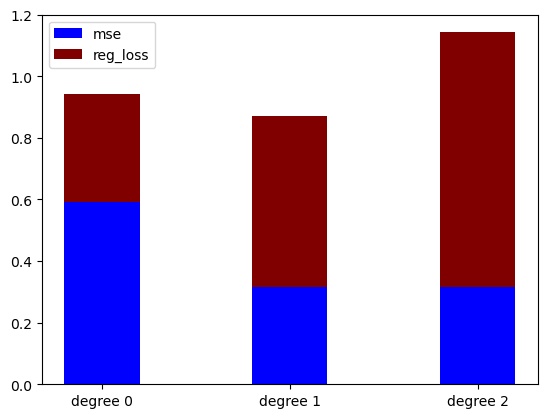

stackoverflow.com
loss [0.03113560628550001, 0.3546295080406483, 0.3151989216923528]
mse [1.9469465876060452, 0.5648468081673388, 0.13565032380332323]


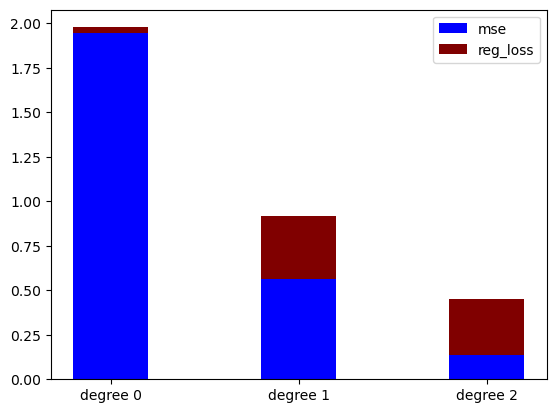

stackexchange.com
loss [0.18595193691382758, 0.27935784426407295, 0.39774746306024633]
mse [0.6534879288619933, 0.21635798225372063, 0.02128672287665544]


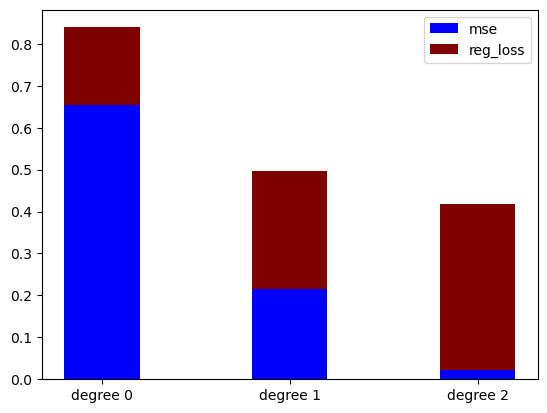

globo.com
loss [0.08741881008342585, 0.22804002022704395, 0.23756626208271983]
mse [0.5008421857512122, 0.4183543000954216, 0.0694212545093441]


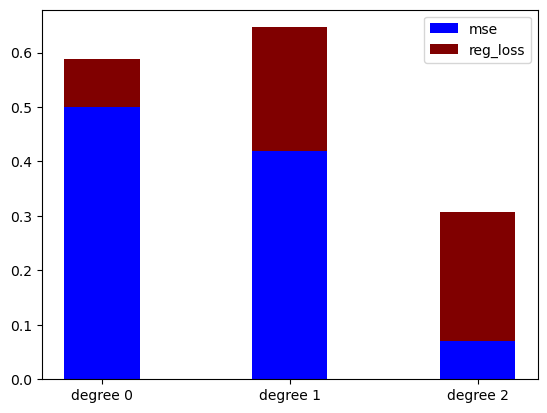

linkedin.com
loss [0.11360912588082606, 0.22533903112988785, 0.36855873295840913]
mse [1.5118239806792484, 1.511631574342614, 0.9058342721405839]


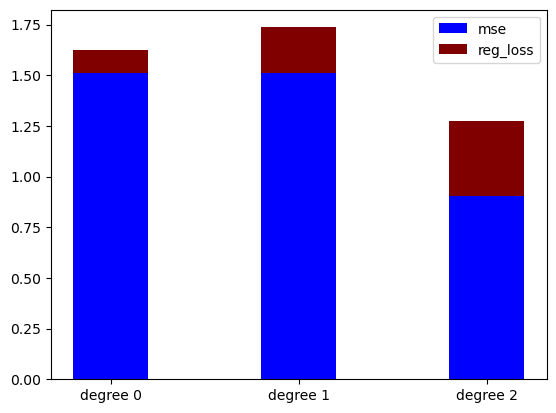

360.cn
loss [0.41303926946540404, 0.6931321689260059, 0.7236707535192012]
mse [1.8679168208465518, 1.5641032144201141, 0.18578582410313949]


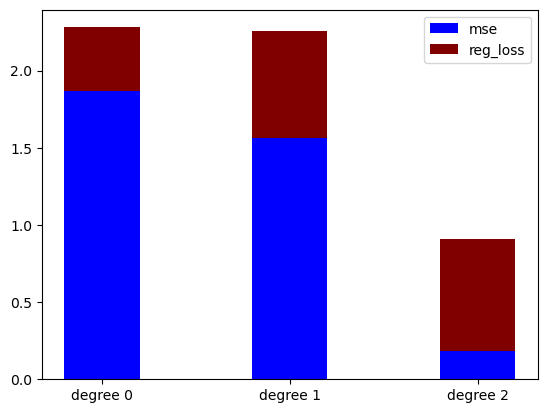

zhihu.com
loss [-0.05196998606045381, 0.0837643992123941, 0.00462307264818536]
mse [1.2861300381808922, 0.3400126822233526, 0.031150829433932232]


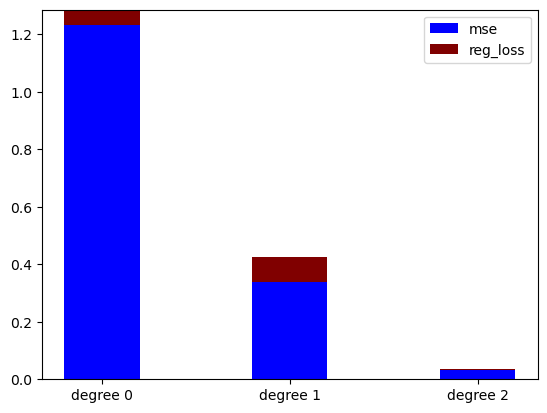

avito.ru
loss [-6.345443420568211, -12.690886815009568, -19.036327557222005]
mse [5.113085929971382e-19, 5.08163627998962e-19, 4.952949096506185e-19]


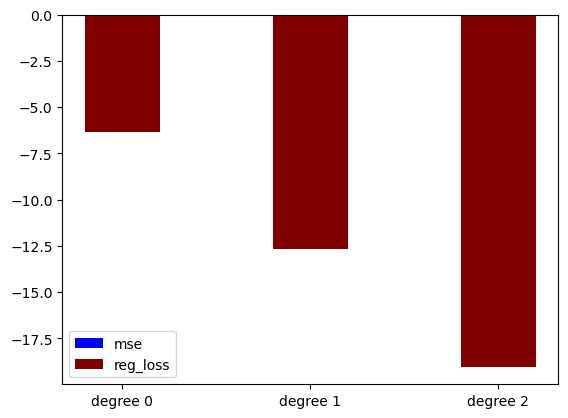

live.com
loss [0.4649774311369476, 0.8628415010241867, 1.0652249904219864]
mse [5.366436739444634, 5.247738166151781, 3.0374281396739997]


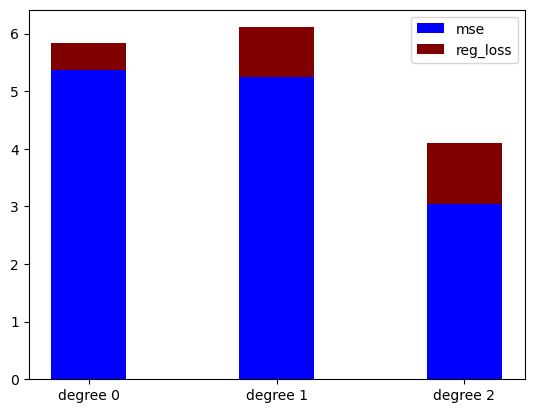

youtube.com
loss [0.023700195007601014, 0.3106694489442532, 0.21833042768592117]
mse [2.0561170167929395, 0.7742397639611133, 0.07481048354131864]


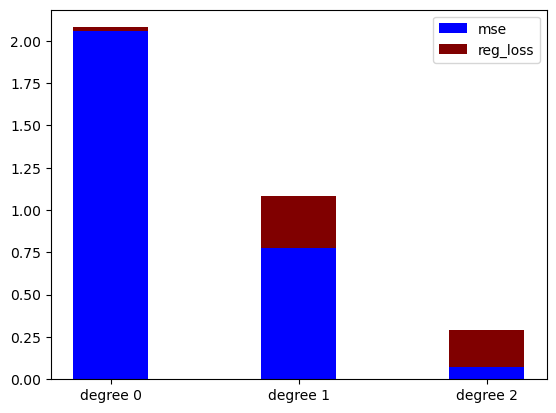

ladbible.com
loss [0.3149333585898173, 0.5967473850548183, 0.8455983190965035]
mse [0.5993297888274997, 0.5693200542045598, 0.4823608054360039]


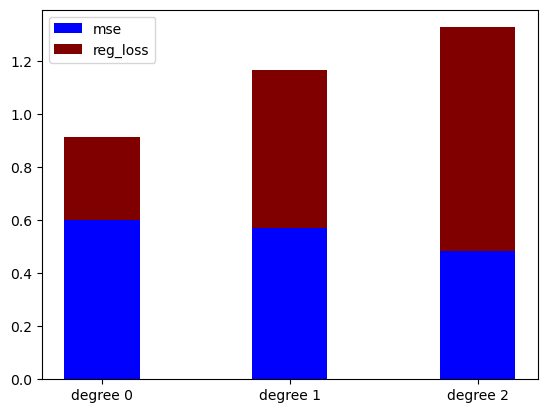

bbc.co.uk
loss [0.24346269697812792, 0.33549138365068326, 0.4475344601444878]
mse [1.05997701304495, 0.3320362620261722, 0.03376742062305249]


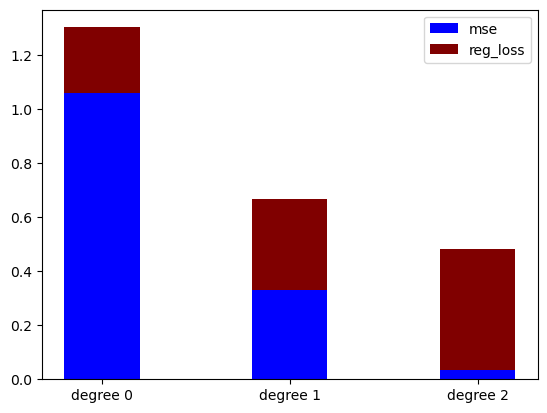

tmall.com
loss [0.267915186633553, 0.36824670751790706, 0.4855262197288822]
mse [1.1504681038747868, 0.23626203405862534, 0.025174869749316788]


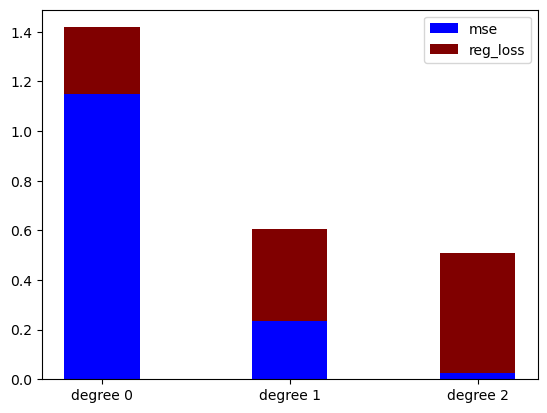

detail.tmall.com
loss [0.2678251716692587, 0.34025638473250647, 0.4624759905097554]
mse [1.2048952291984099, 0.19543107476570942, 0.05641407029254596]


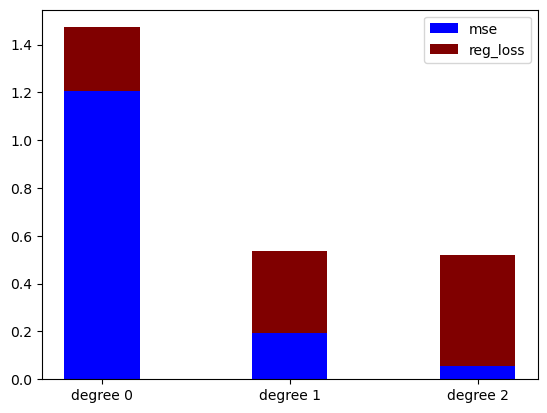

digikala.com
loss [0.031925467072677655, 0.0598810866740124, 0.08532677117316713]
mse [0.6012730842369216, 0.00794695776181462, 0.007799044384545053]


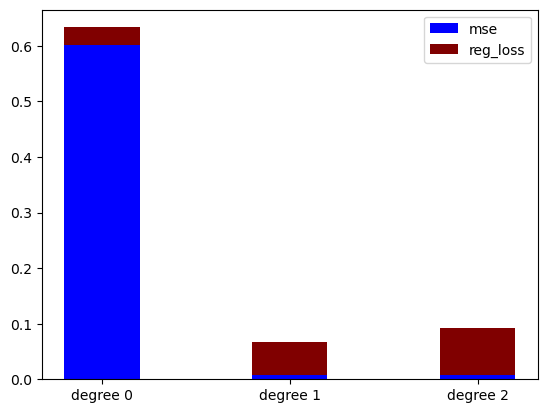

mozilla.org
loss [0.045541402885603835, 0.27138769889409686, 0.0987863867958918]
mse [1.1123916979805348, 0.7163188427903425, 0.12445692705076773]


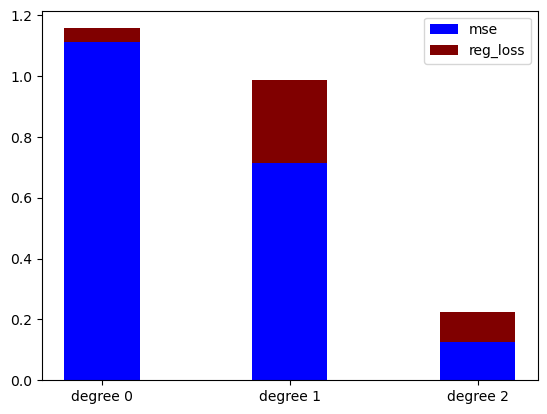

vk.com
loss [-0.0263967880992122, 0.22779386554893657, 0.2381602666894221]
mse [1.5803725024297328, 0.21866519079570654, 0.036744303848501504]


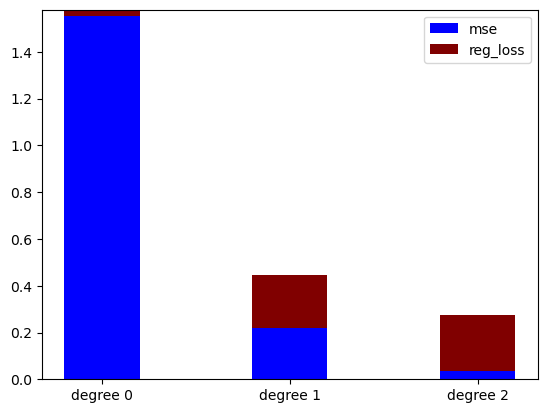

yahoo.co.jp
loss [-0.03858512095449466, 0.1949292427773172, 0.10112077018083235]
mse [1.332101282383694, 0.3316942449392527, 0.05838542819579789]


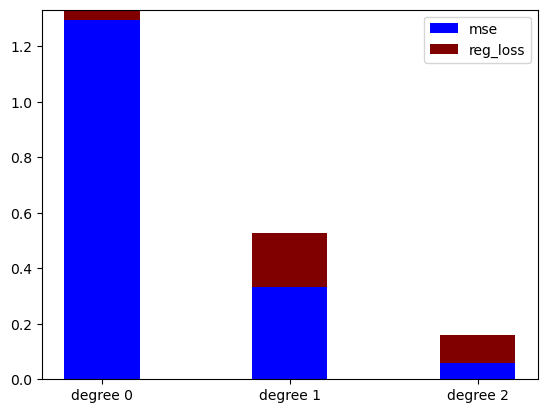

In [188]:
cc_mp = getBestDegree(mp)

../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.ar-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60240', '48916'])
Port 48916


/tmp/ipykernel_82468/1923409484.py:33: RuntimeWarning: invalid value encountered in true_divide
  acc_w[web]['relative'] = (acc_w[web]['density']-minn)/(maxx-minn)


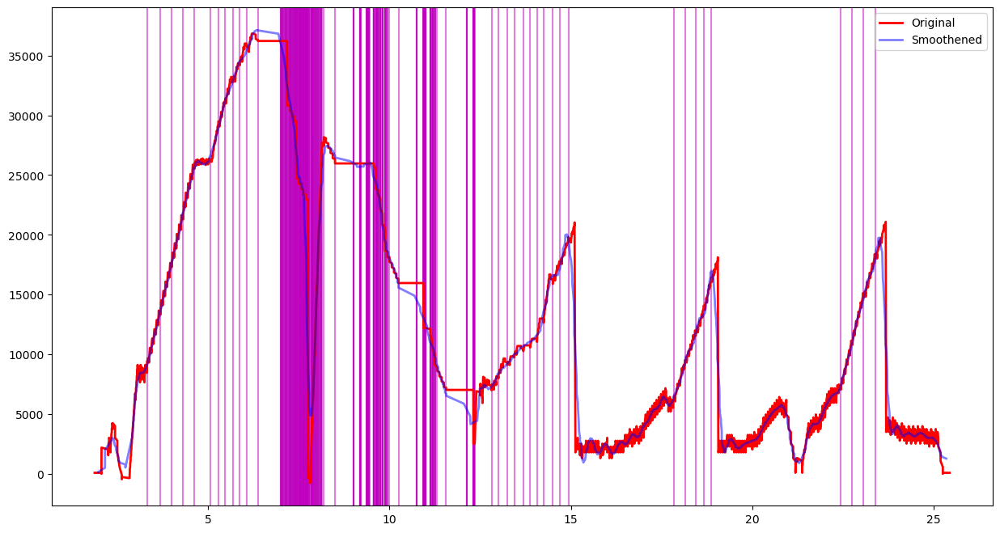

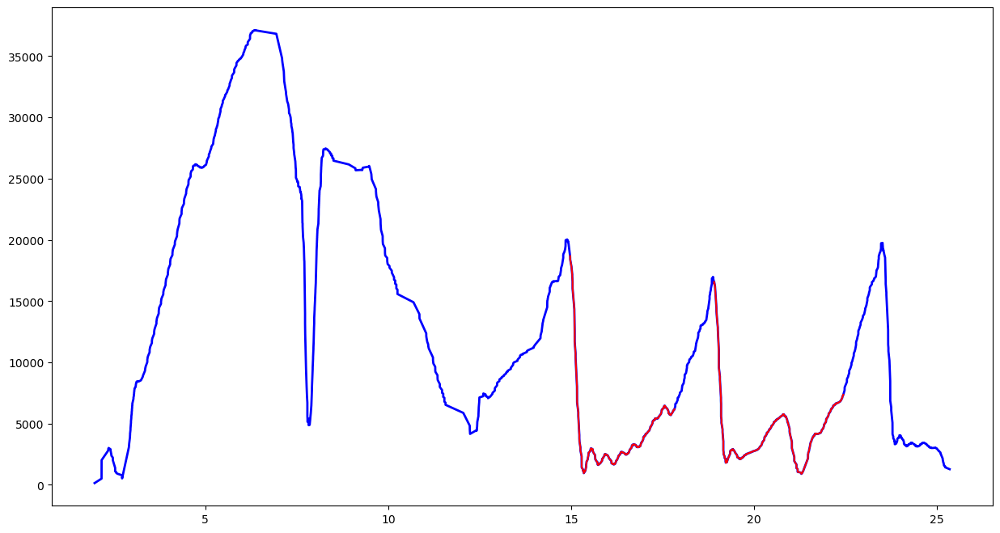

Feature Length  203


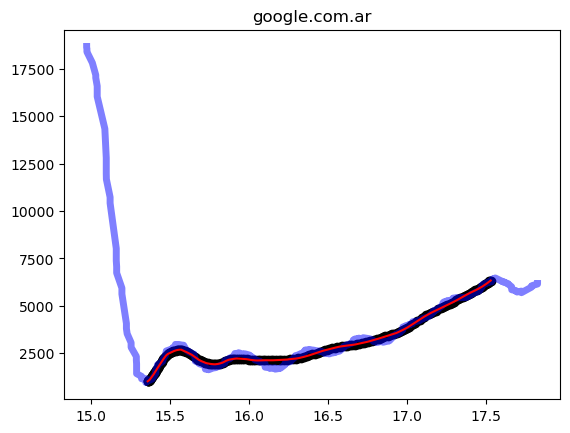

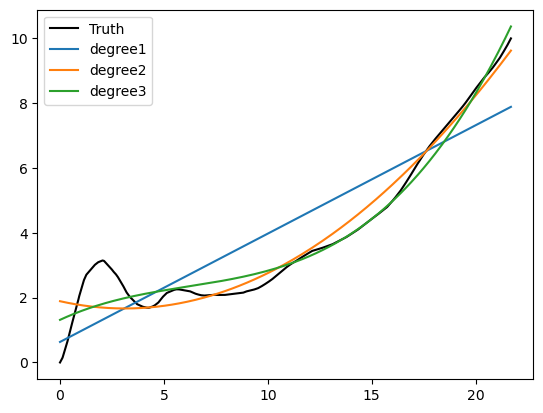

[ 0.02330029 -0.13632766  1.70551177]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/msn.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/msn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53912'])
Port 53912


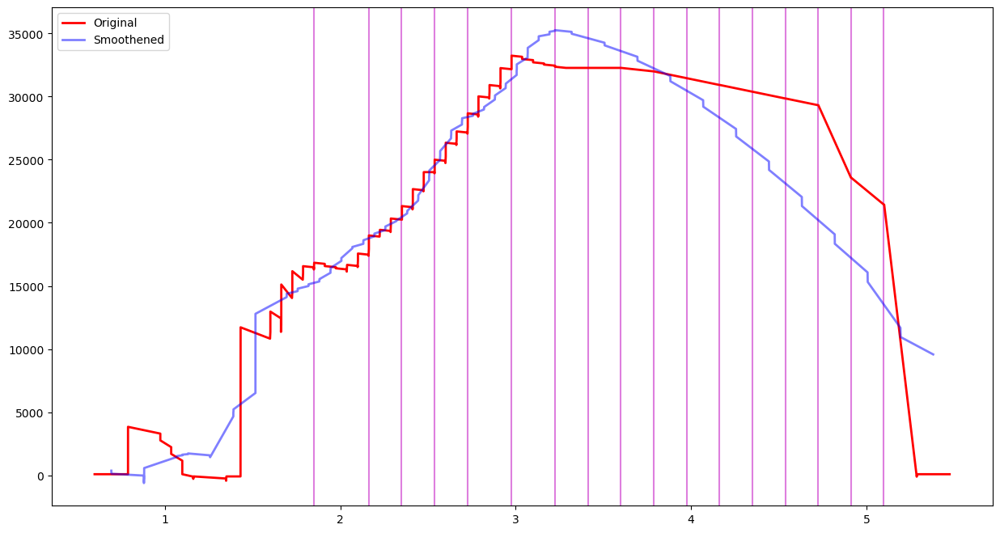

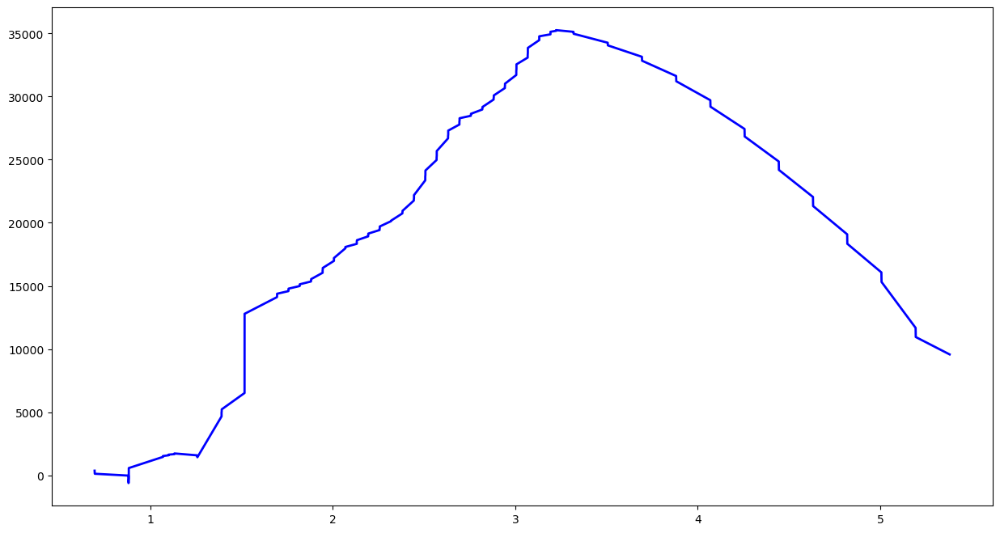

No Feature
../../singapore/top1k/bukalapak.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bukalapak.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45270'])
Port 45270


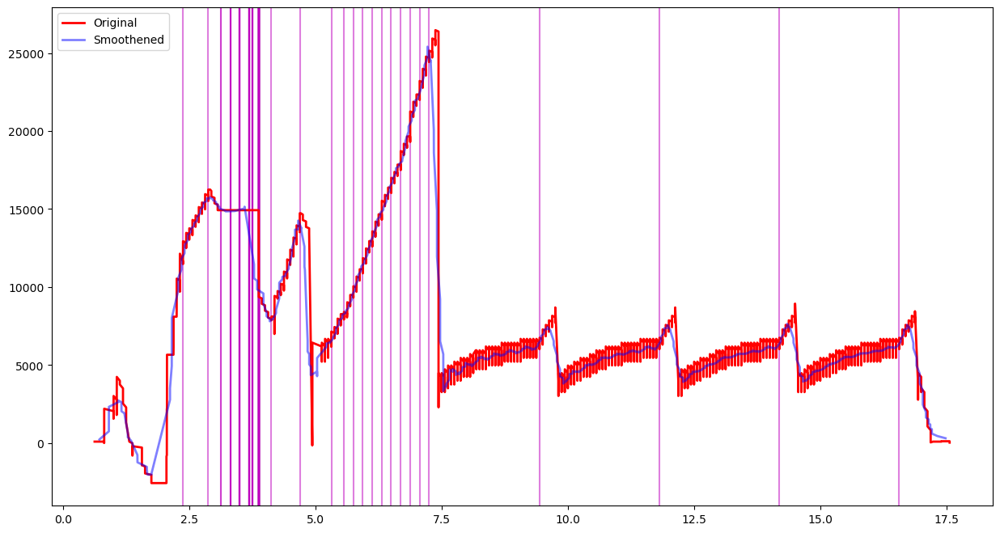

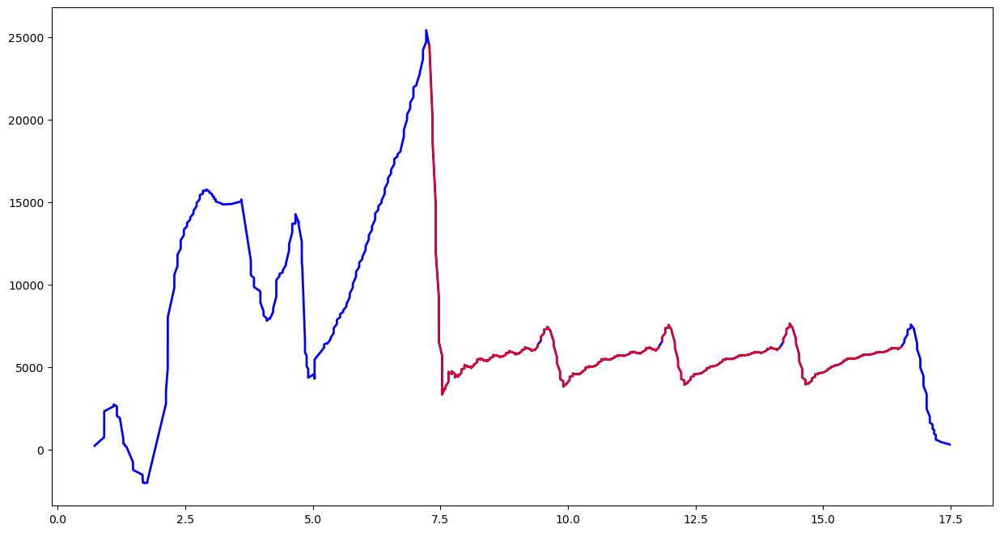

Feature Length  203


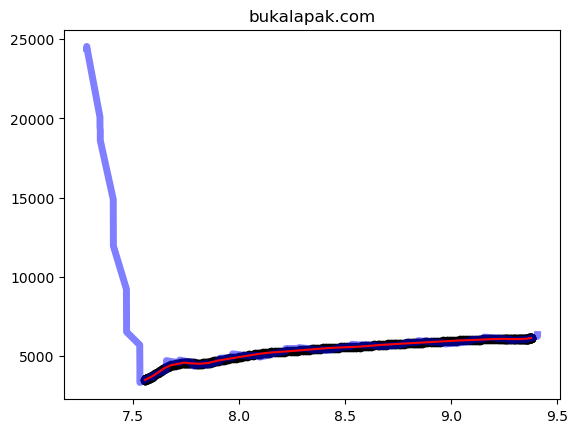

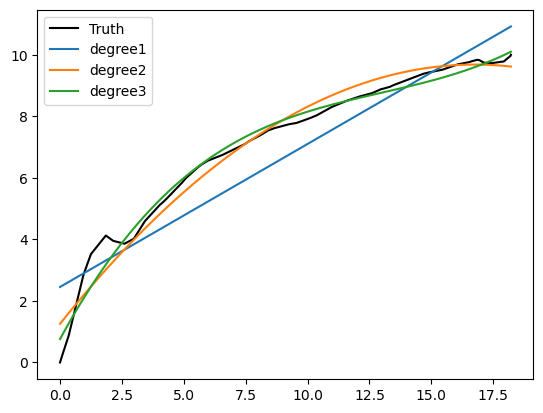

[-0.02938165  0.98438292  1.330233  ]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/t.co-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/t.co-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51734'])
Port 51734


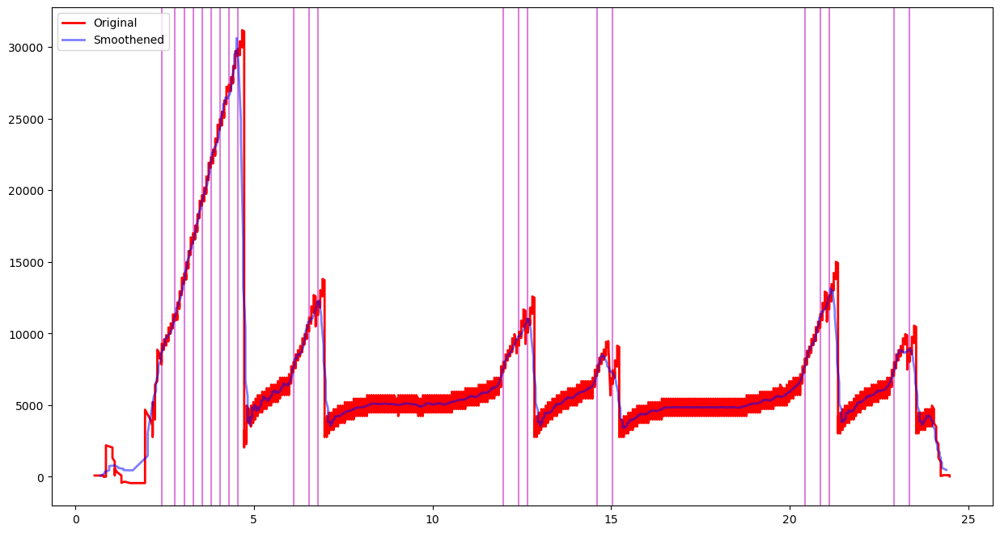

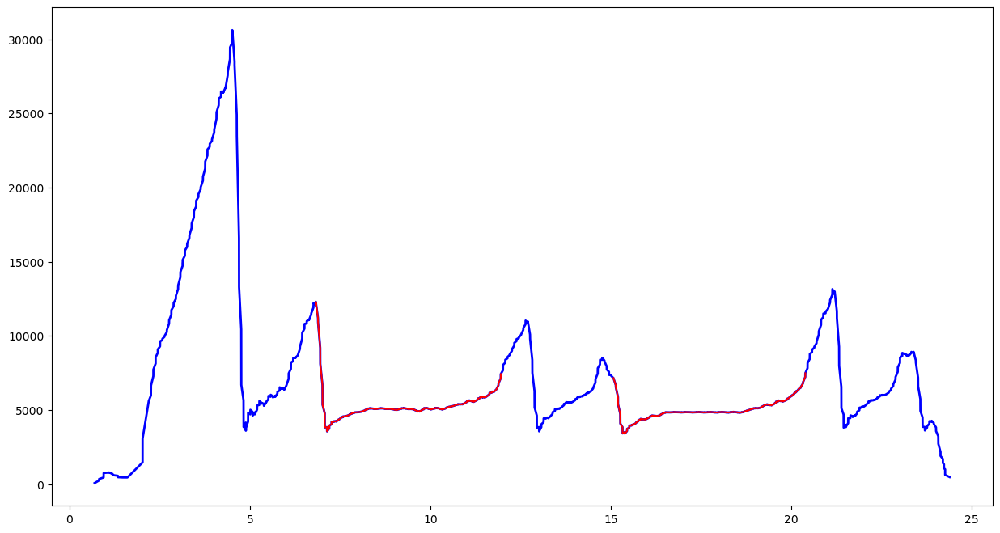

Feature Length  203


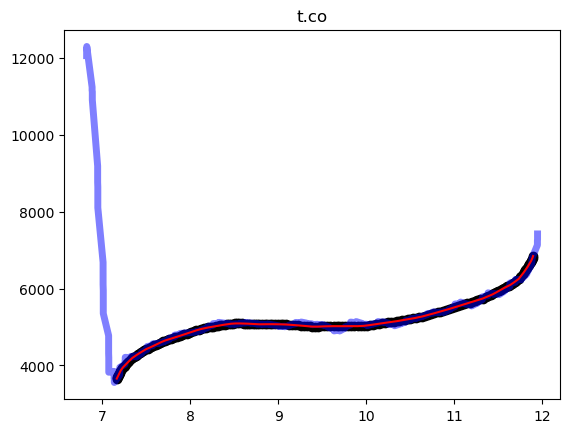

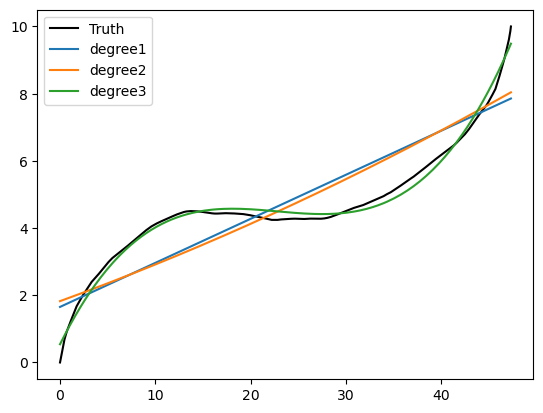

[ 3.69606995e-04 -2.45648902e-02  5.28776595e-01  4.12992719e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [2.28570717e+04 1.82862475e-44 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 8.00025819e-49 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/google.co.id-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.id-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60270', '40816'])
Port 40816


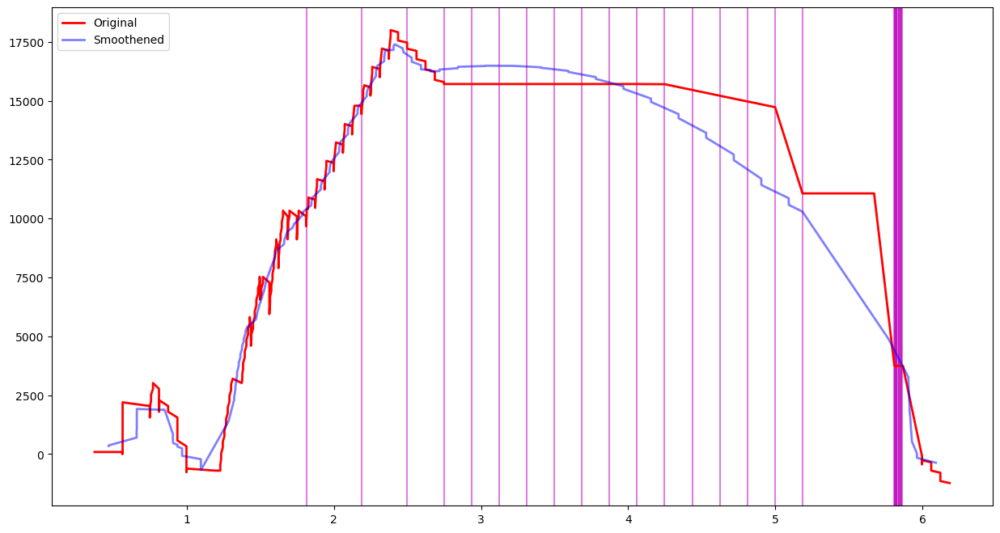

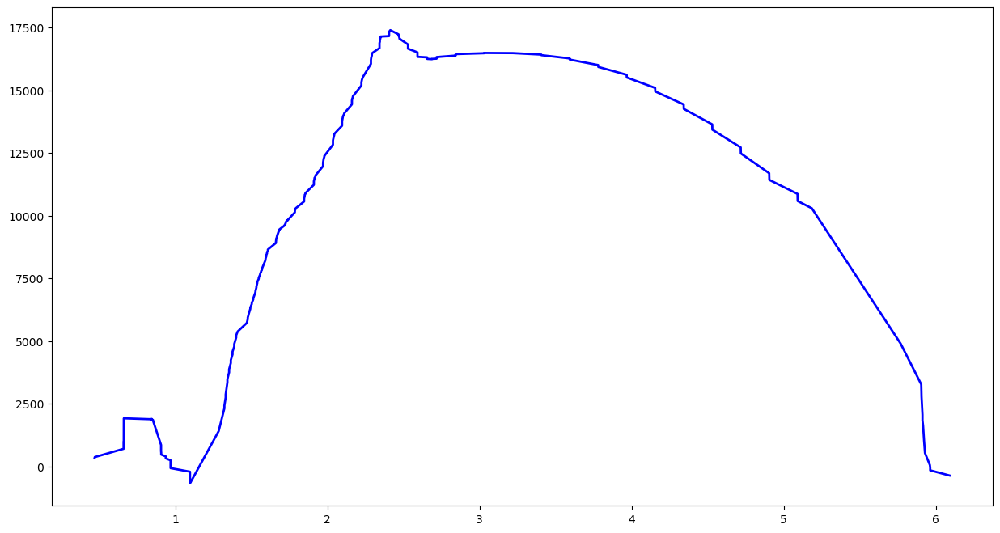

No Feature
../../singapore/top1k/yao.tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yao.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56968'])
Port 56968


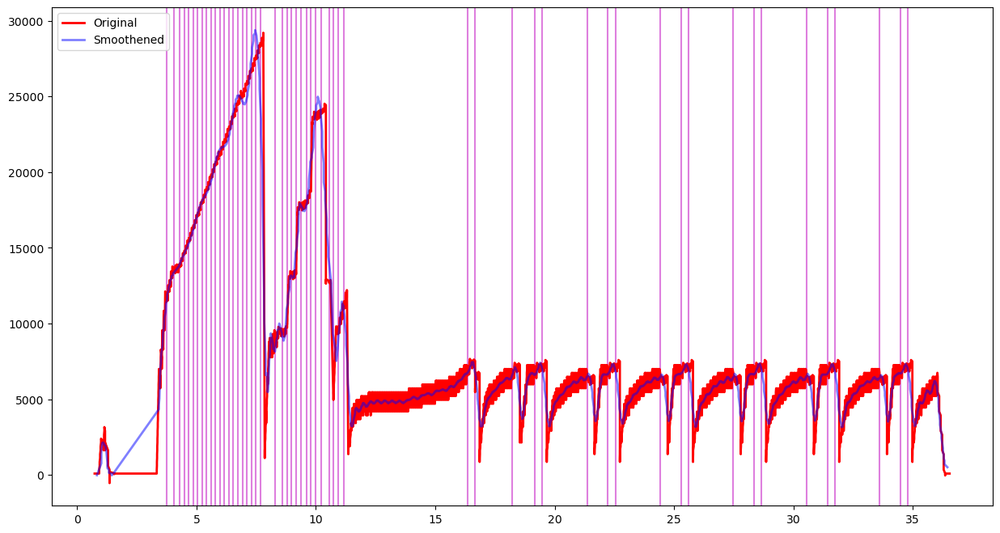

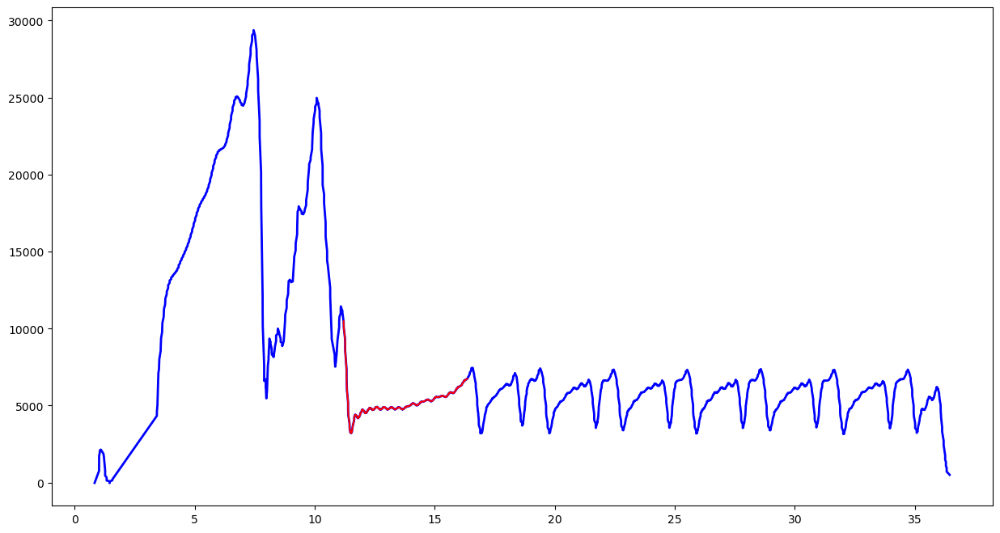

Feature Length  203


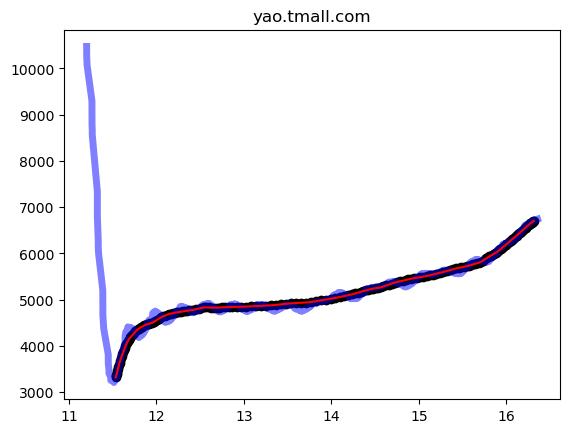

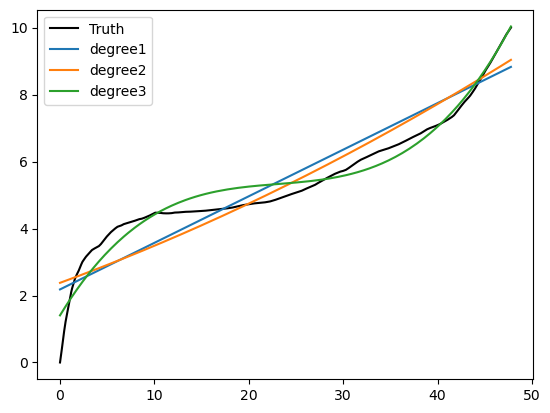

[ 2.47640031e-04 -1.59067711e-02  3.78488948e-01  1.45902078e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.11584773e+06 5.60820085e-39 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 5.02595533e-45 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/huanqiu.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/huanqiu.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59940', '59268'])
Port 59268


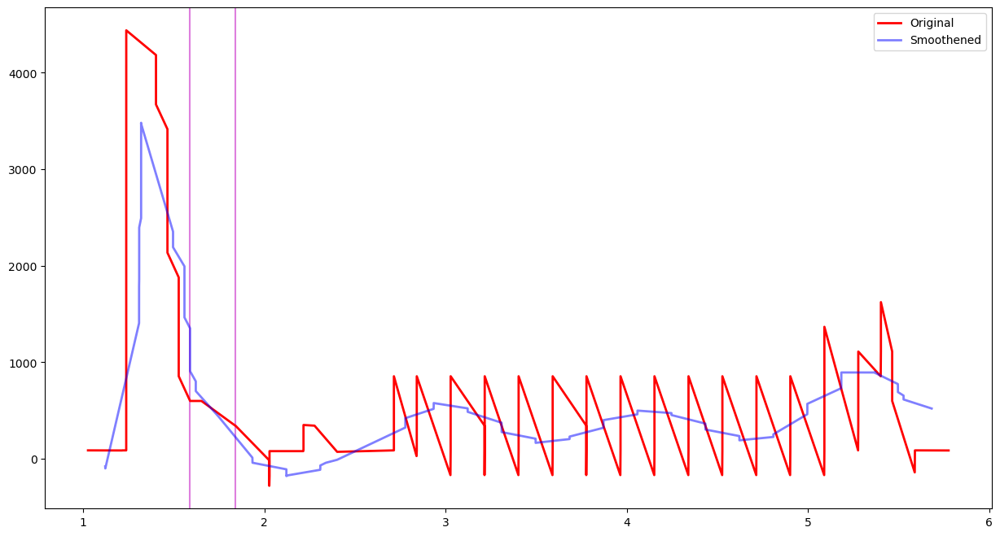

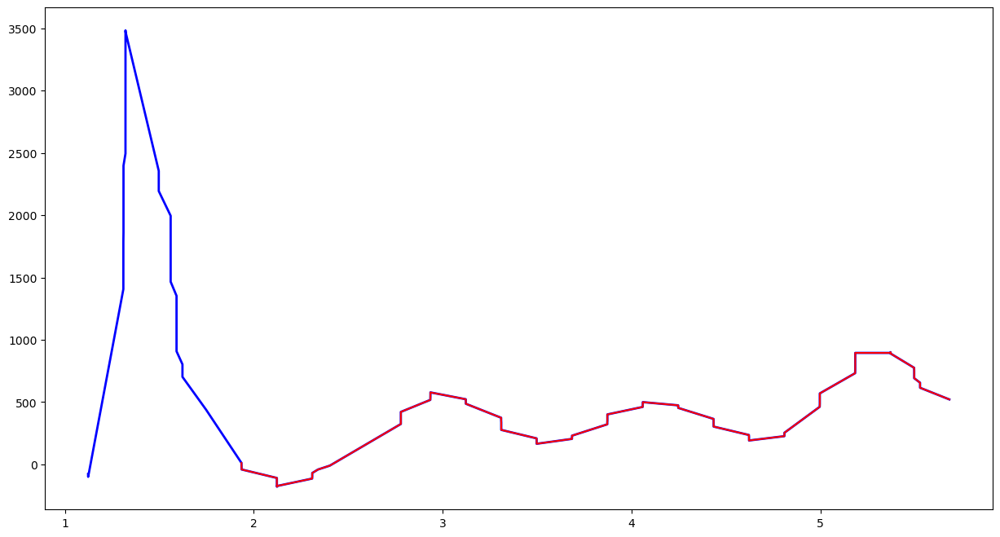

Feature Length  203


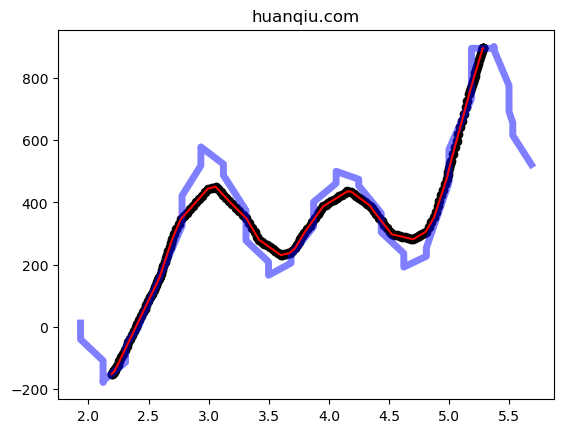

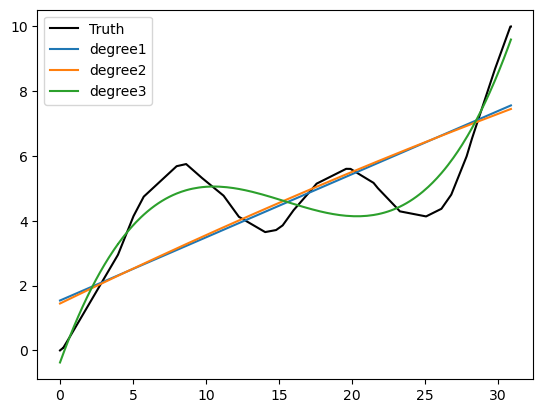

[ 0.00215009 -0.09970246  1.36669122 -0.44353585]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.98231385e-135 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/myshopify.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/myshopify.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54248'])
Port 54248


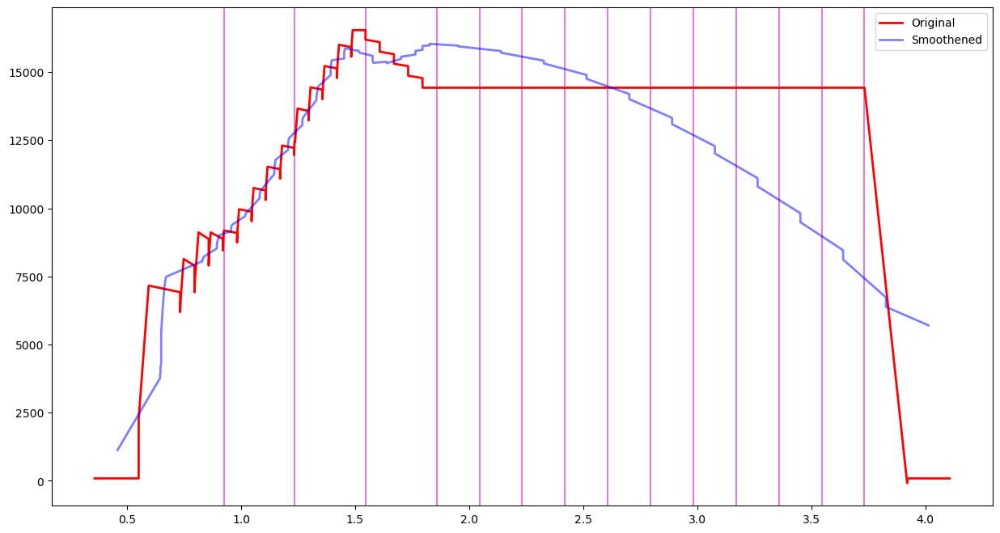

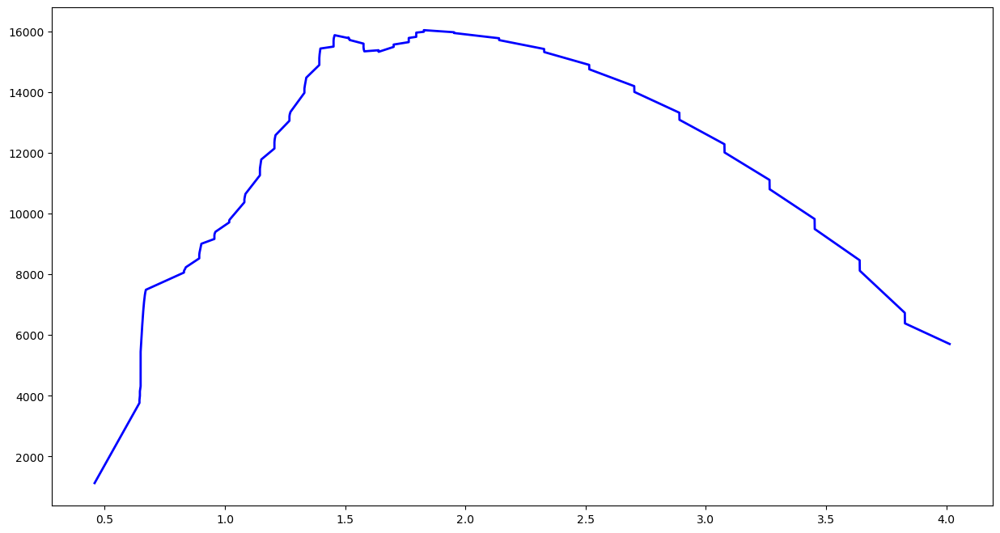

No Feature
../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/adobe.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35292'])
Port 35292


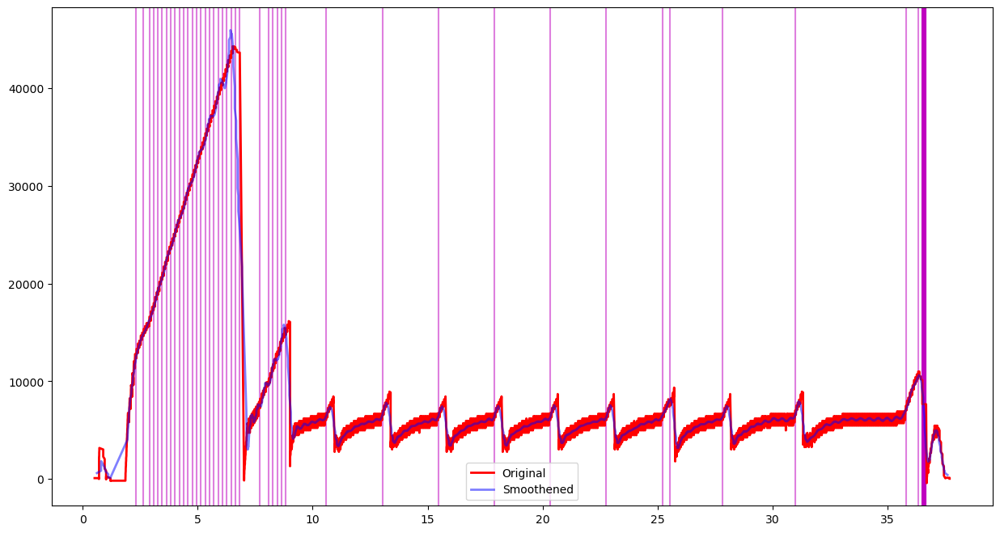

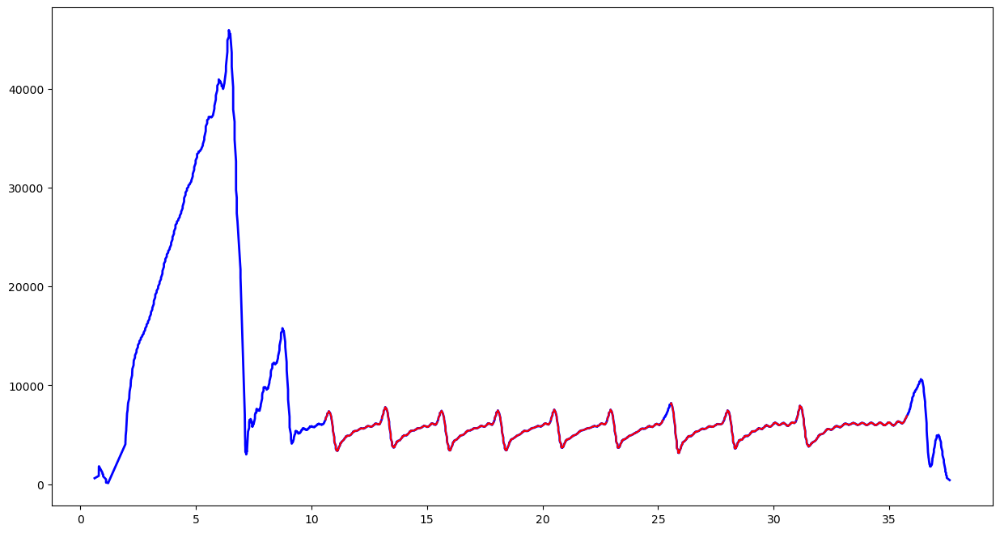

Feature Length  203


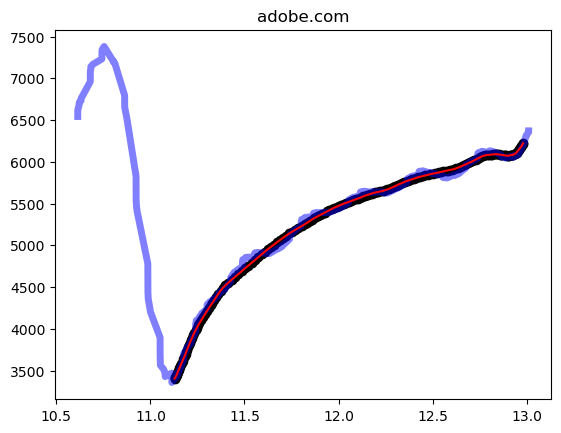

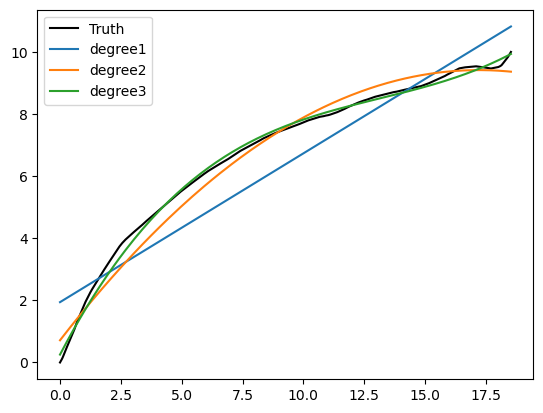

[-0.0263267   0.94342939  0.85702788]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/login.tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/login.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34672'])
Port 34672


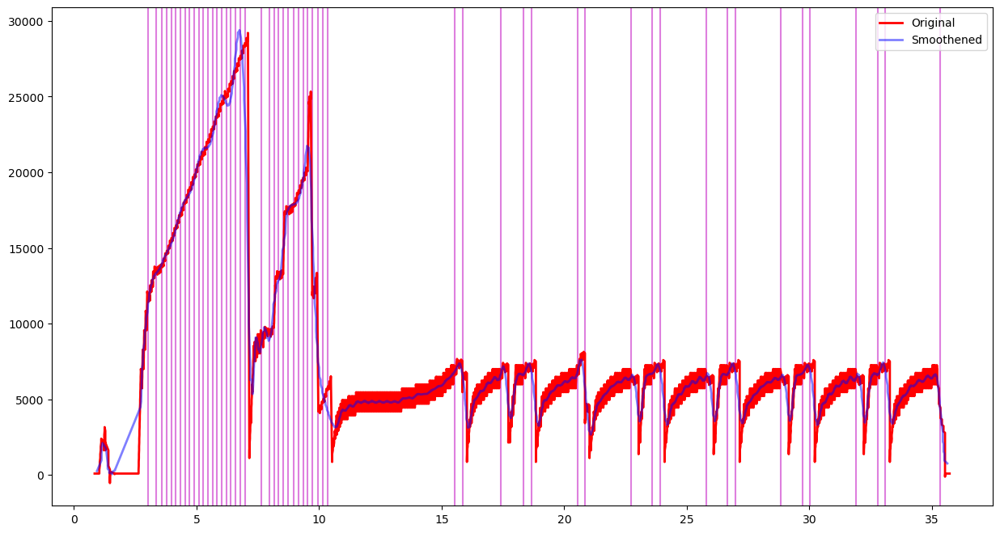

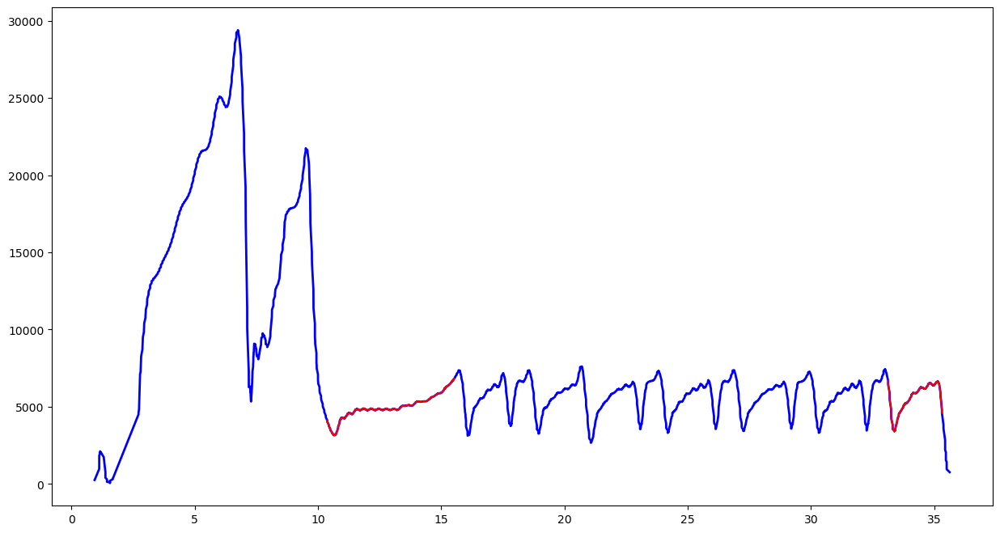

Feature Length  203


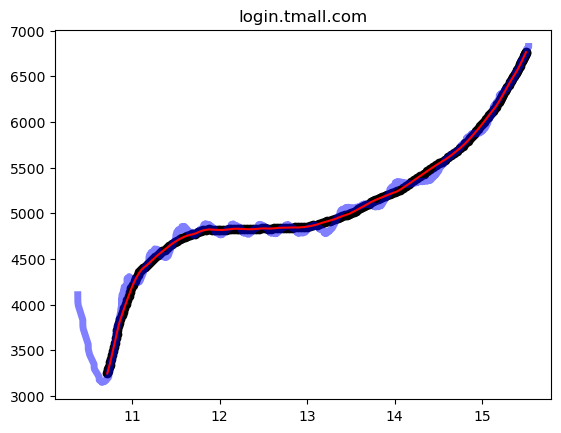

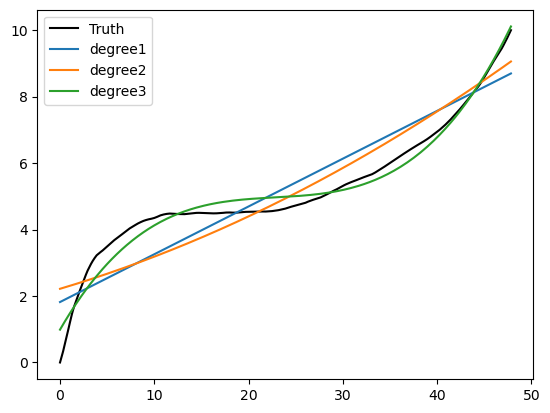

[ 3.57909329e-04 -2.51476528e-02  5.85064973e-01  7.90275405e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.11720789e+02 6.05269981e-44 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 5.41770234e-46 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/youporn.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/youporn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51912', '53142', '37336', '37460', '33776', '41100', '46270', '53480', '35546', '40716', '47848', '58282', '53114', '45570', '45602', '44542', '57642', '58334', '46712', '50302'])
Port 51912


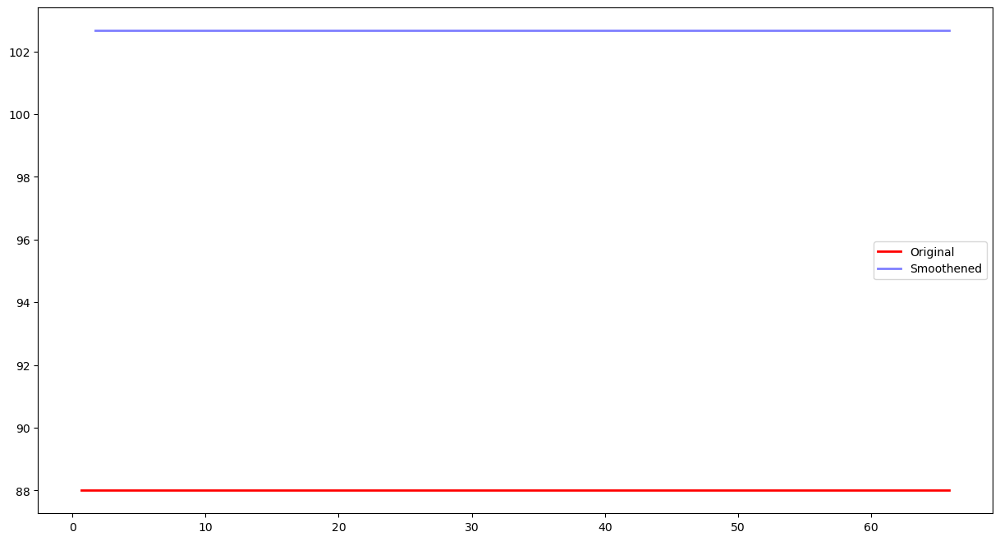

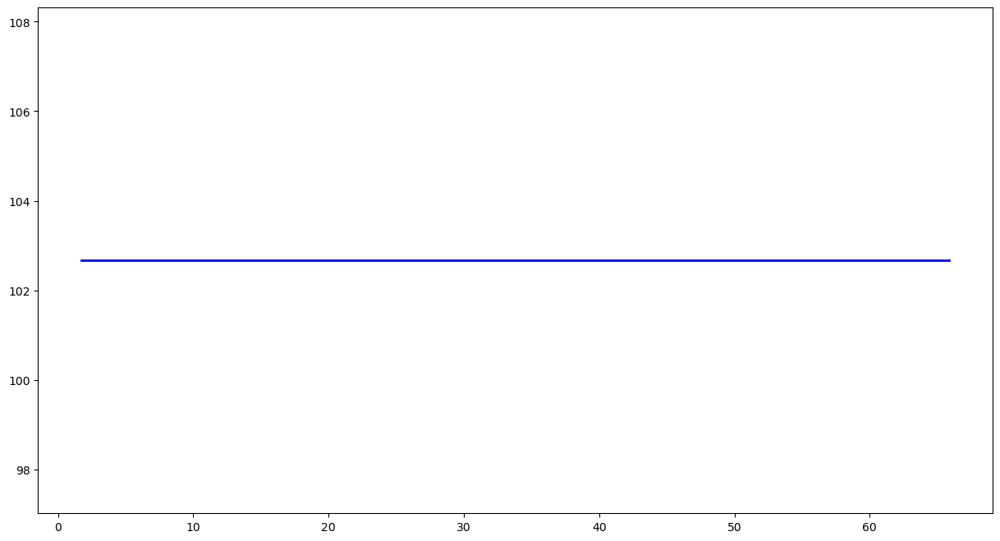

No Feature
../../singapore/top1k/sina.com.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/sina.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44754'])
Port 44754


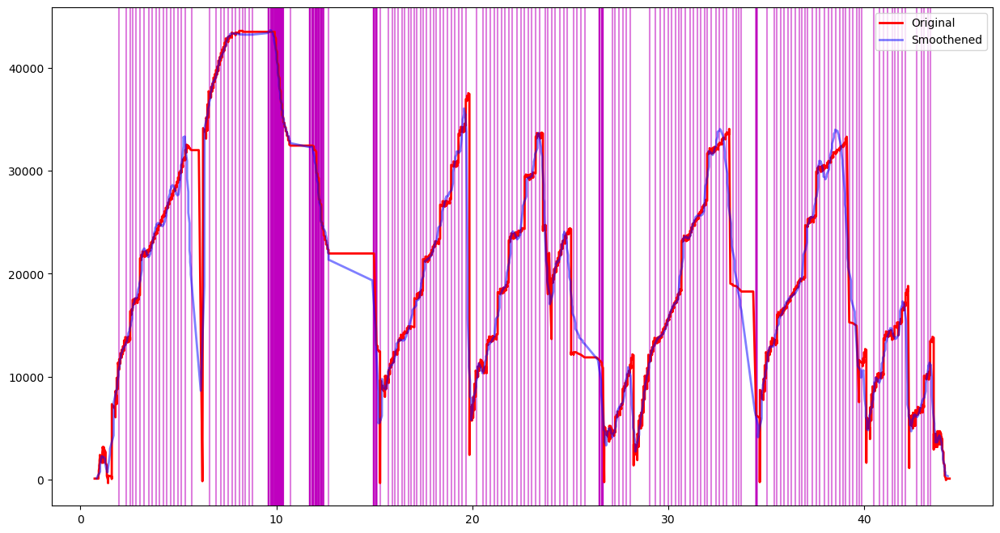

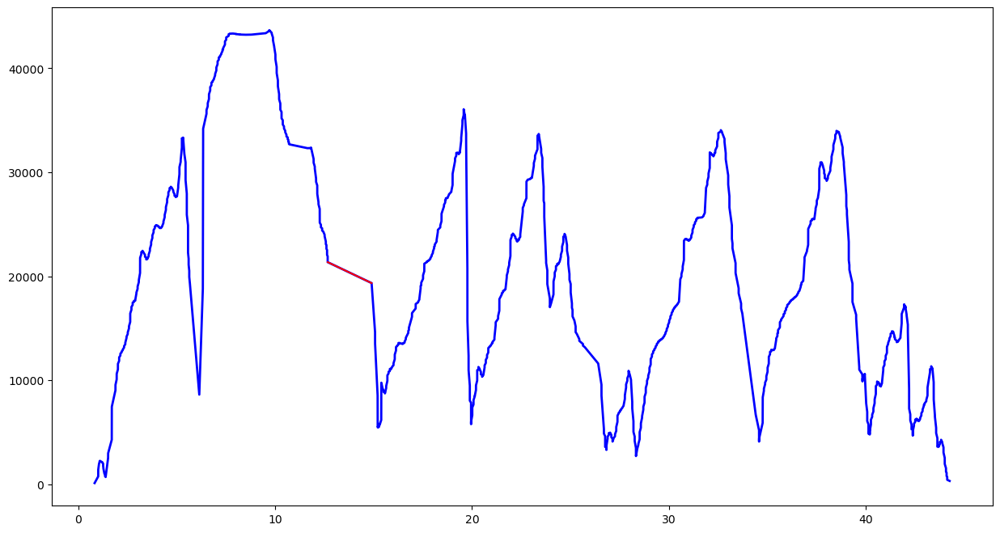

Feature Length  203


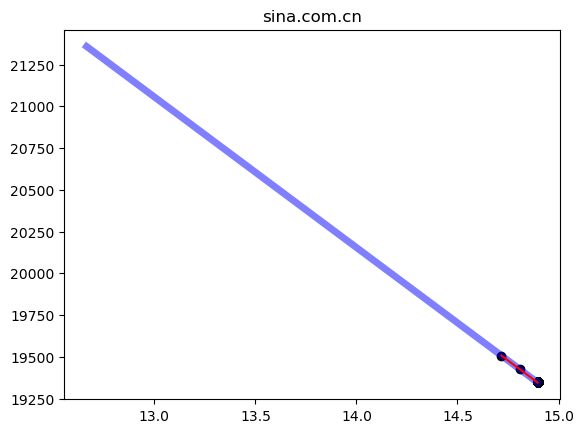

/tmp/ipykernel_82468/1487916734.py:207: RankWarning: Polyfit may be poorly conditioned
  max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)


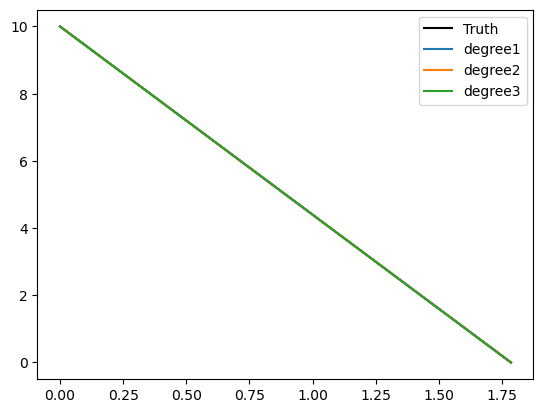

[-2.80047971 10.        ]
Top 5 CCS : ['scalable', 'nv', 'yeah', 'bic']
Density Values: [5.94707788e-28 1.53774746e-40 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.0000000e+00 2.5857194e-13 0.0000000e+00 0.0000000e+00]
Prediction: new
../../singapore/top1k/google.com.ua-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.ua-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48392'])
Port 48392


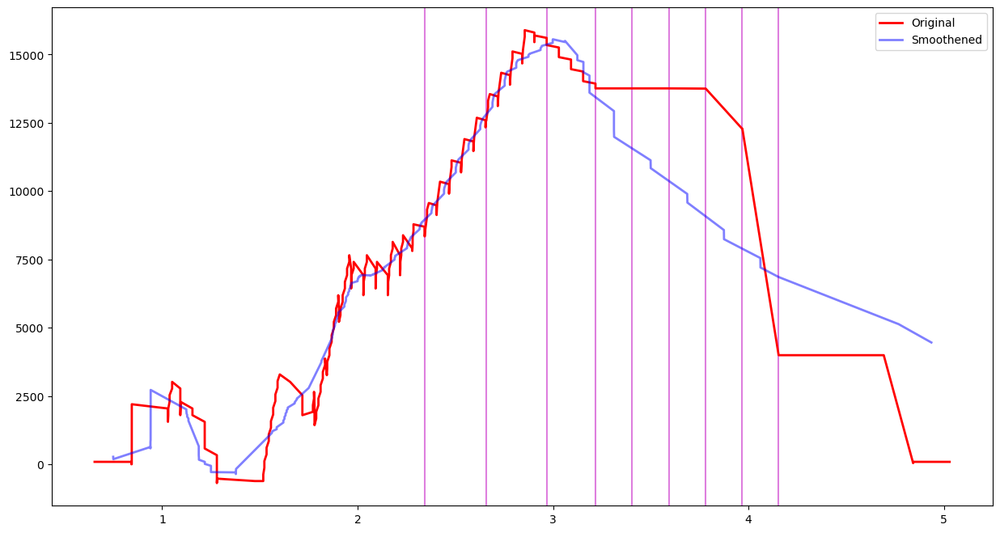

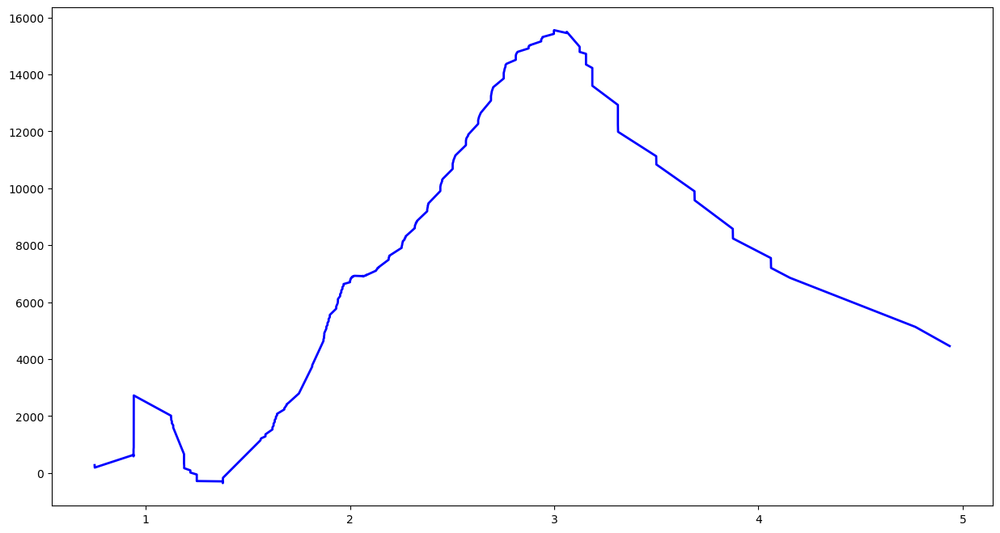

No Feature
../../singapore/top1k/newsupdateunit.info-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/newsupdateunit.info-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59814', '33436'])
Port 59814


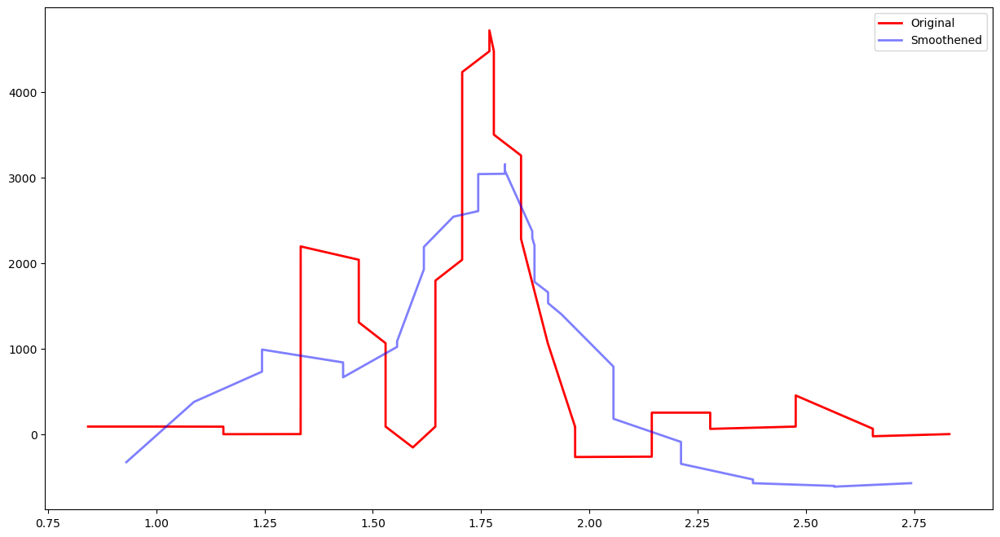

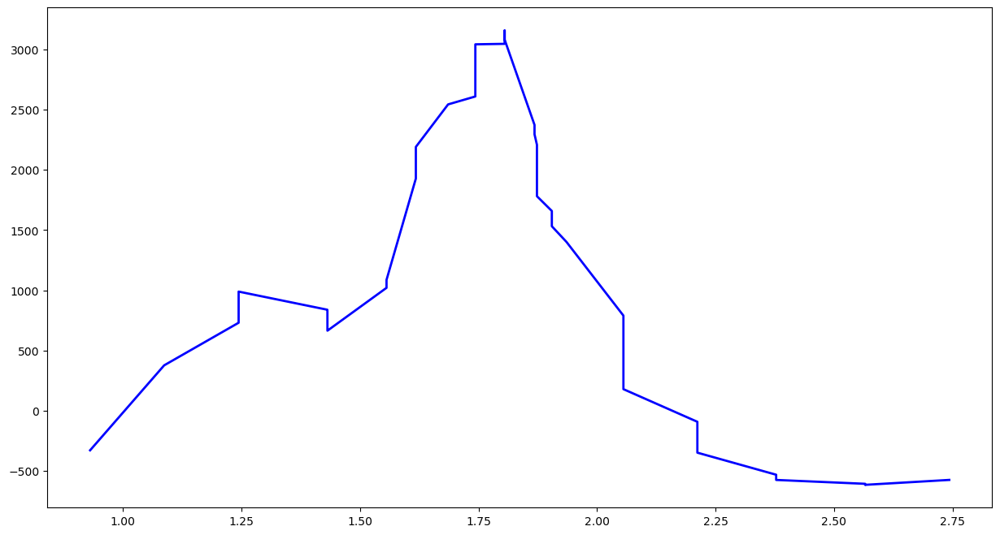

No Feature
../../singapore/top1k/google.ca-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.ca-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34950'])
Port 34950


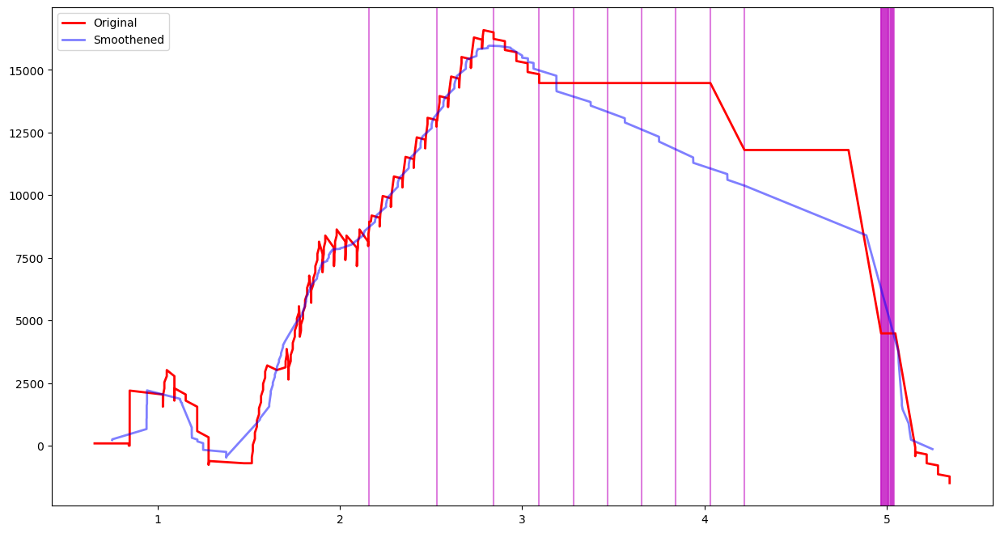

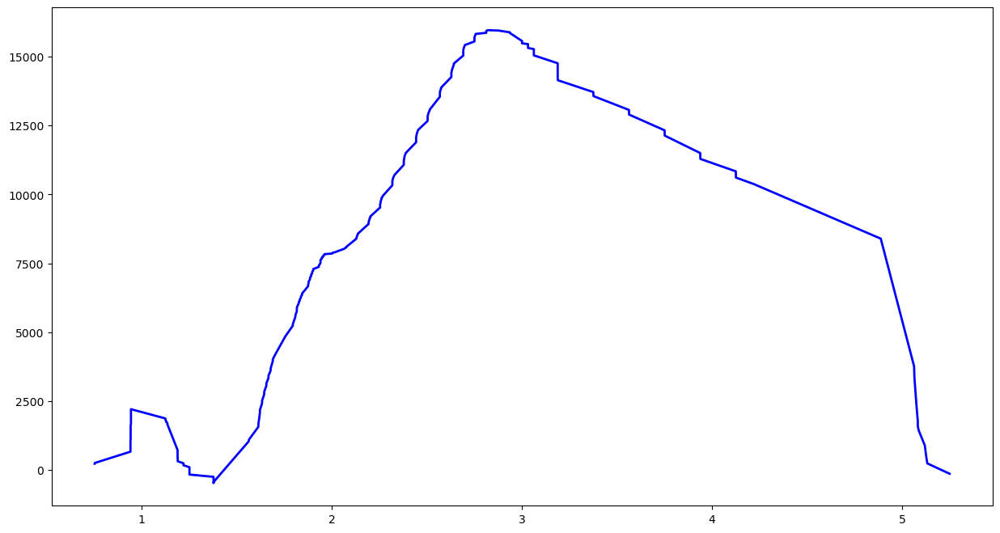

No Feature
../../singapore/top1k/yahoo.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yahoo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56558', '52962'])
Port 56558


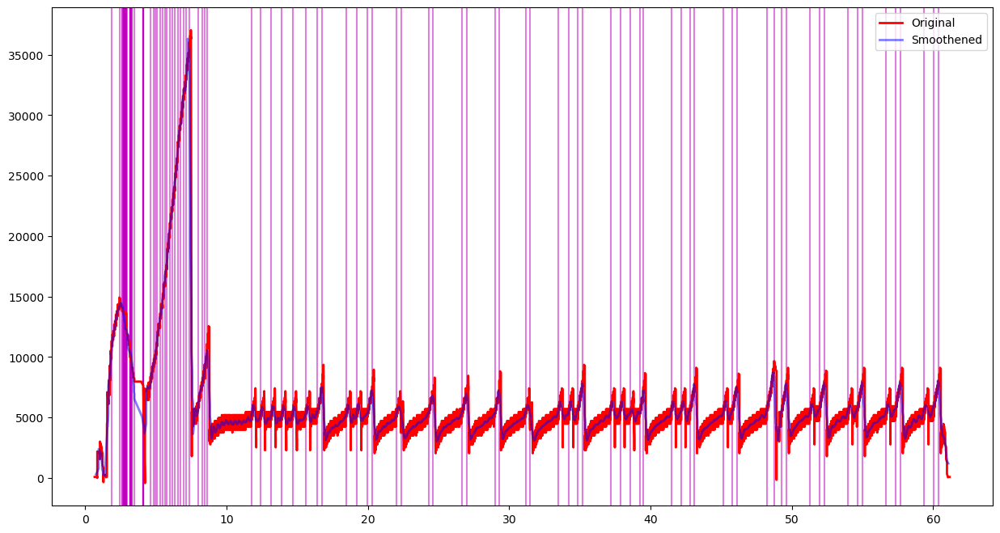

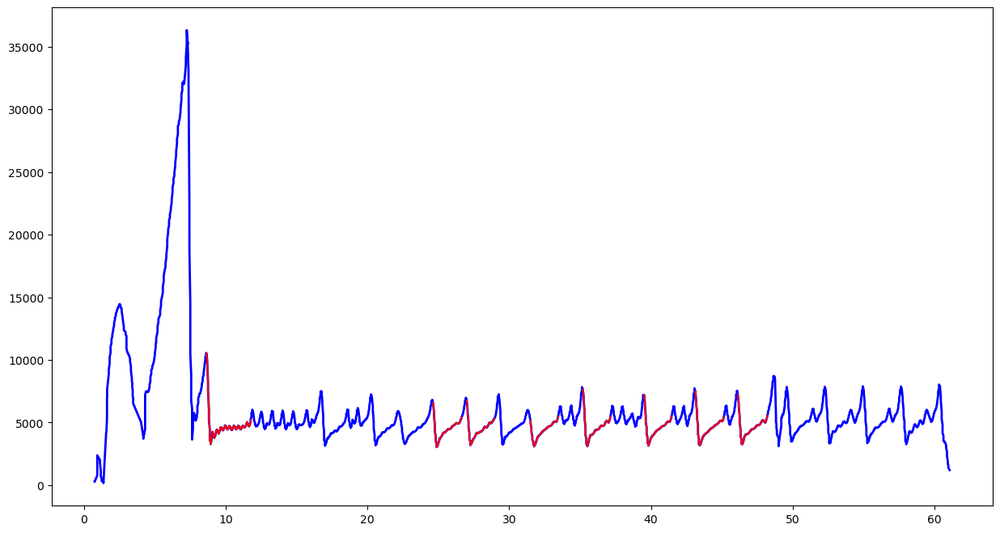

Feature Length  203


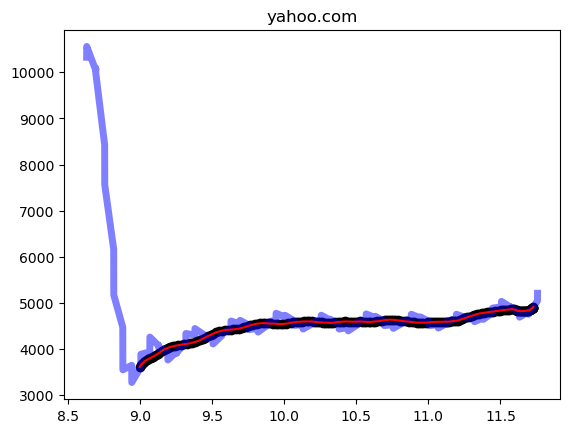

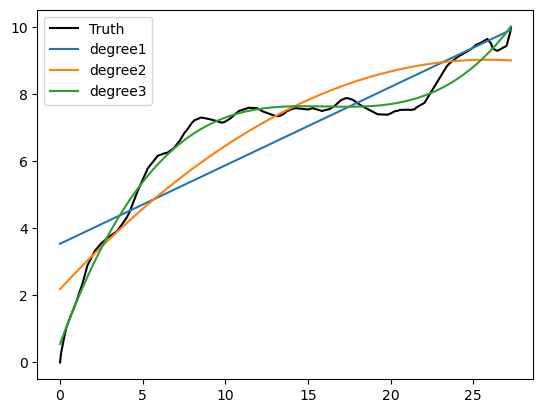

[ 0.00194877 -0.09235451  1.40912545  1.22055678]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [6.50798411e-140 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/w3schools.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/w3schools.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52288'])
Port 52288


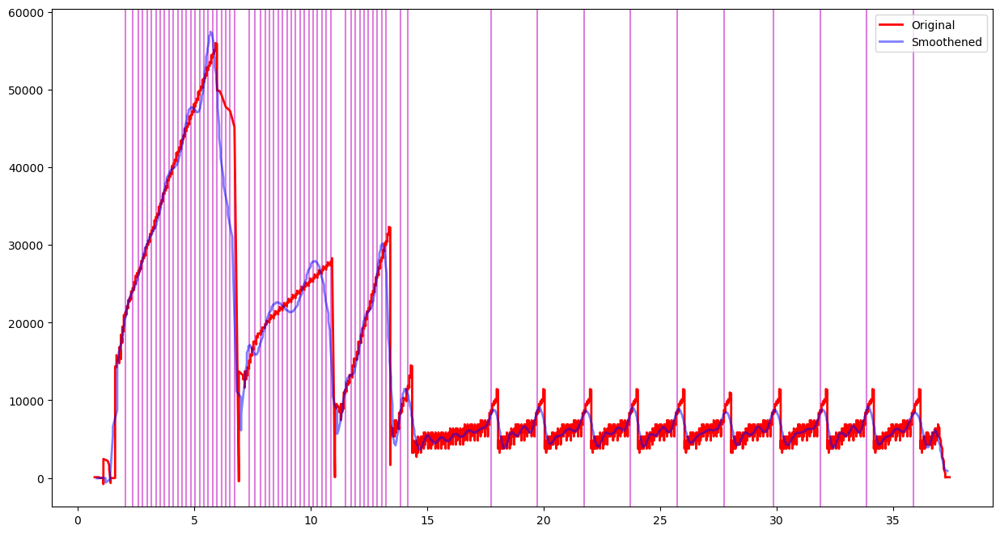

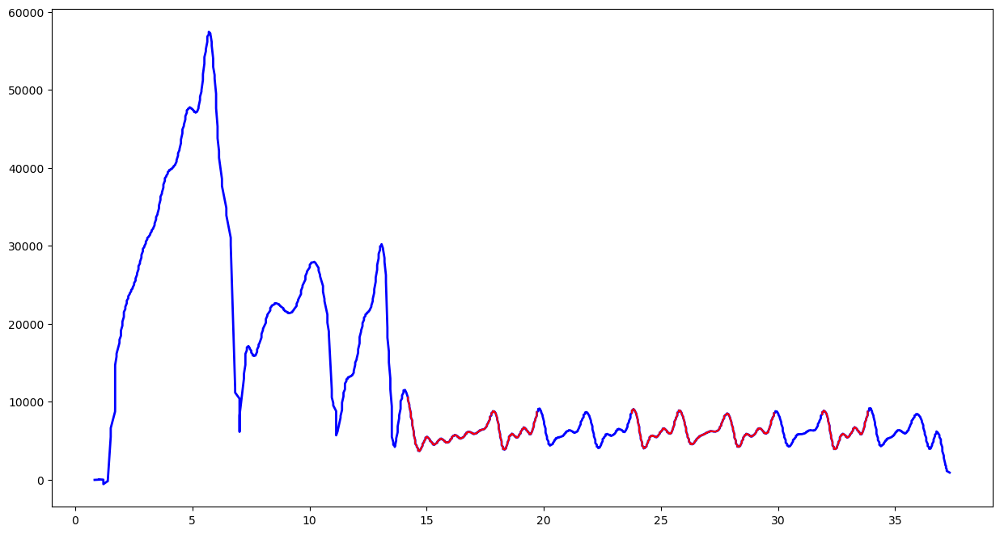

Feature Length  203


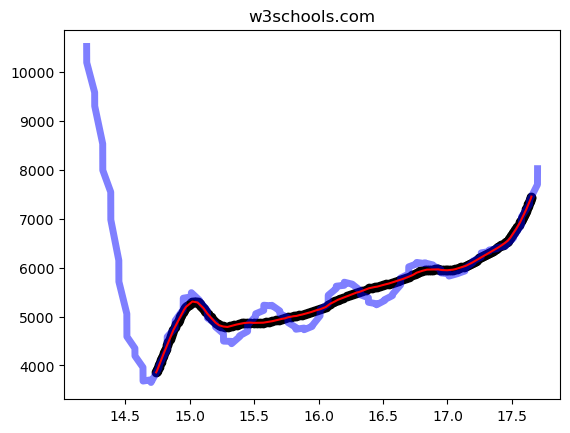

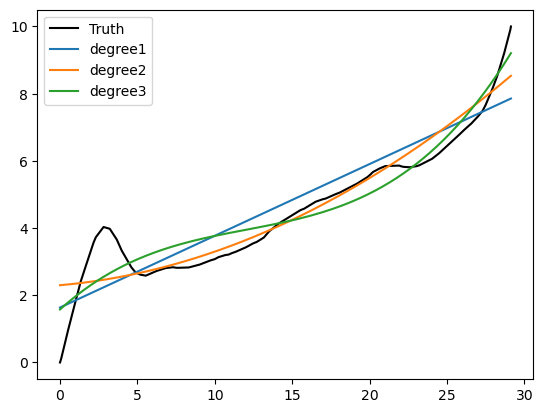

[0.22518008 1.28625495]
Top 5 CCS : ['nv', 'scalable', 'bic', 'yeah']
Density Values: [1.48795161e+00 1.20562887e+00 3.38182993e-03 1.40828337e-09]
Relative Density Values: [1.         0.8102608  0.00227281 0.        ]
Prediction: confused
../../singapore/top1k/chaturbate.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/chaturbate.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48006'])
Port 48006


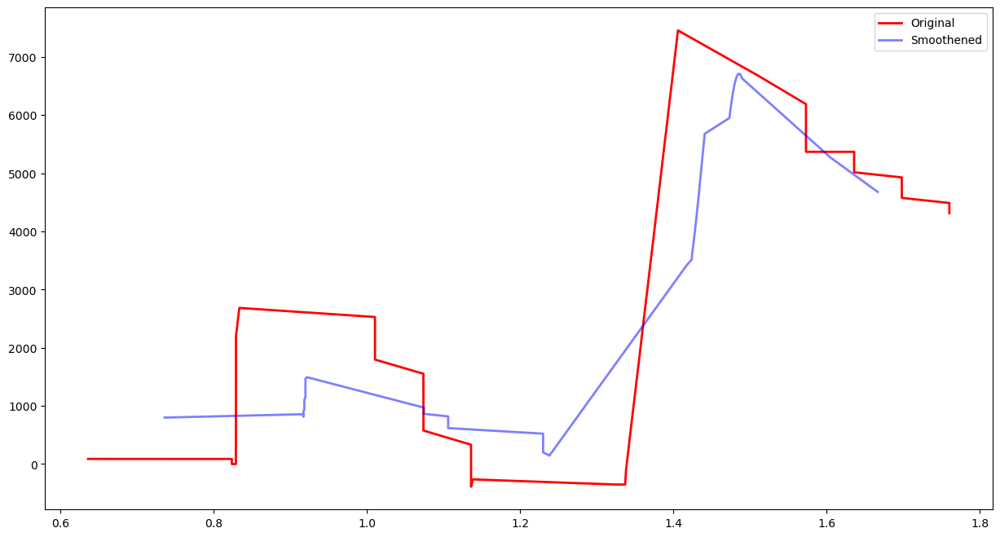

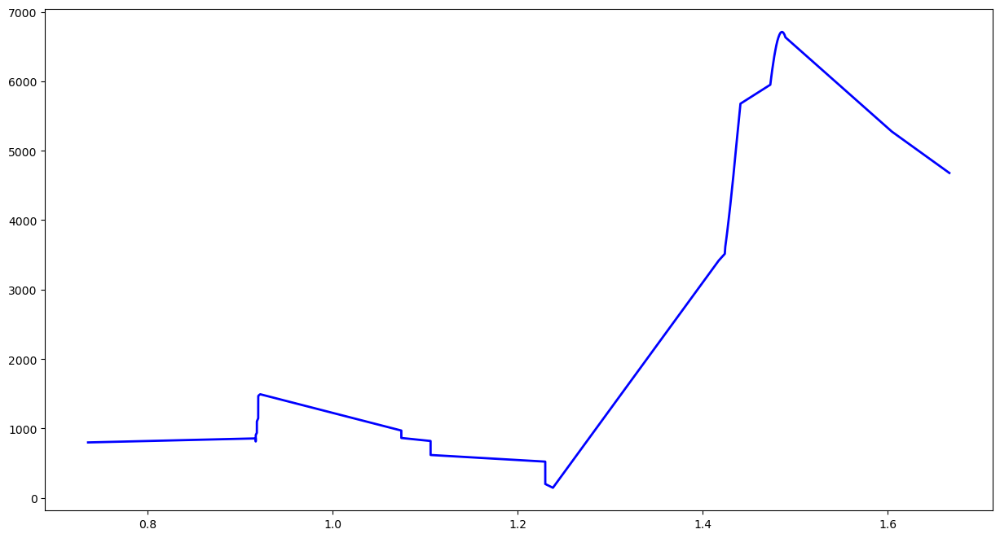

No Feature
../../singapore/top1k/so.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/so.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55670'])
Port 55670


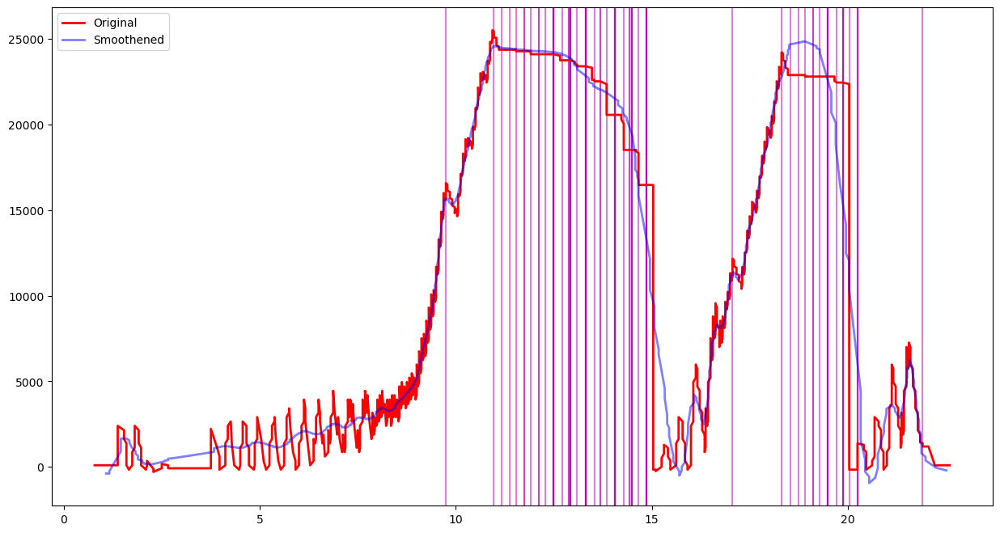

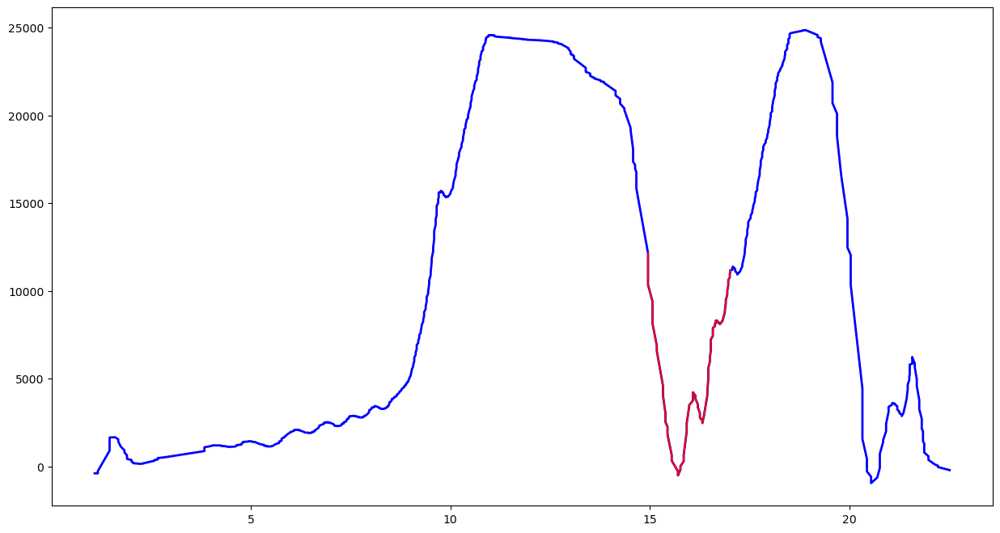

Feature Length  203


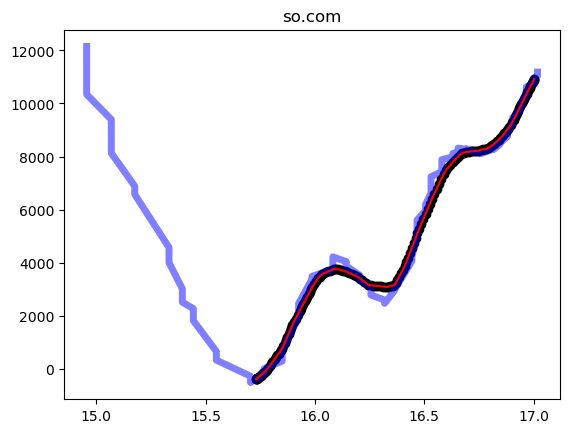

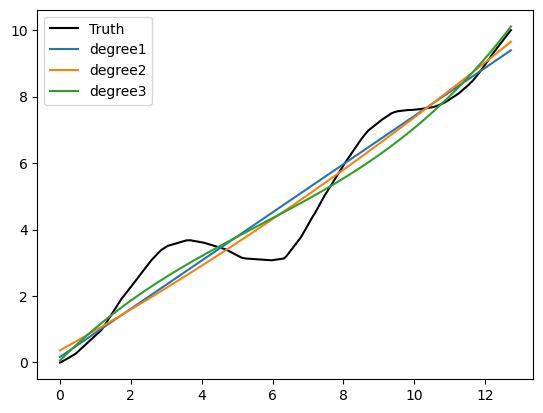

[0.73548715 0.11650129]
Top 5 CCS : ['scalable', 'nv', 'yeah', 'bic']
Density Values: [6.49090316e-01 4.32366372e-01 2.81491755e-55 0.00000000e+00]
Relative Density Values: [1.00000000e+00 6.66111266e-01 4.33671167e-55 0.00000000e+00]
Prediction: confused
../../singapore/top1k/thestartmagazine.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/thestartmagazine.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39222', '51040', '52034', '55942', '54968', '33400', '49510', '42632', '49964', '46574', '57990', '57054', '51260', '59648', '32870', '58586', '41838', '37462', '44298', '58646'])
Port 39222


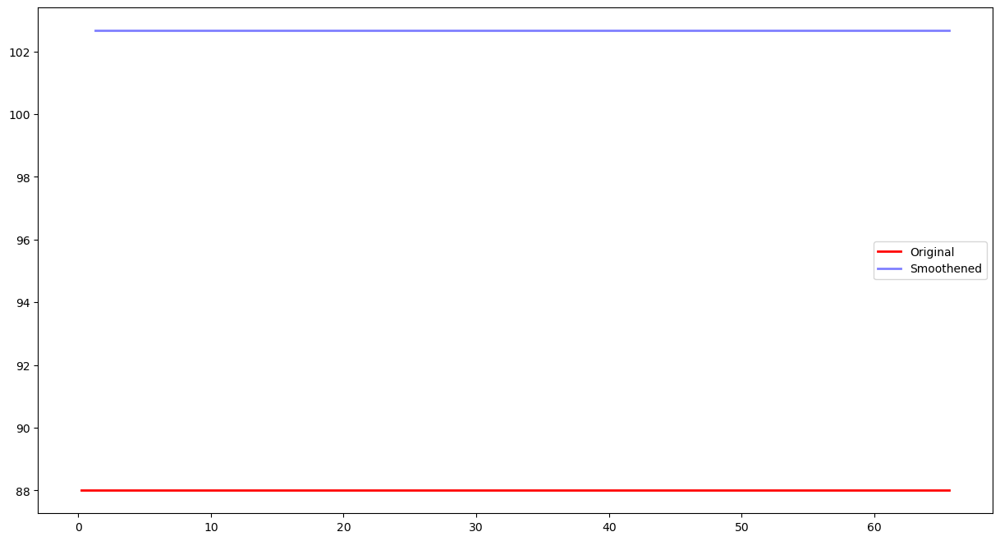

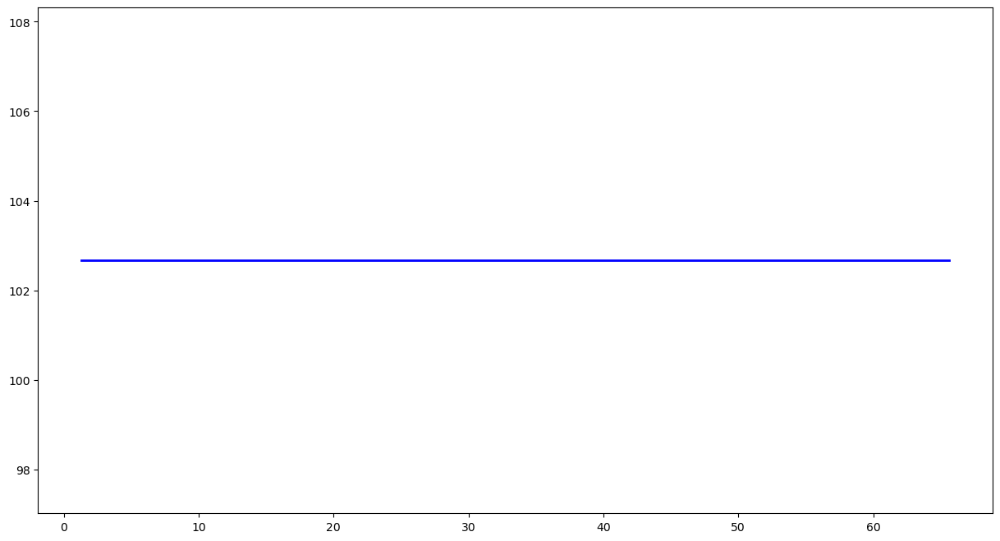

No Feature
../../singapore/top1k/facebook.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/facebook.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37012'])
Port 37012


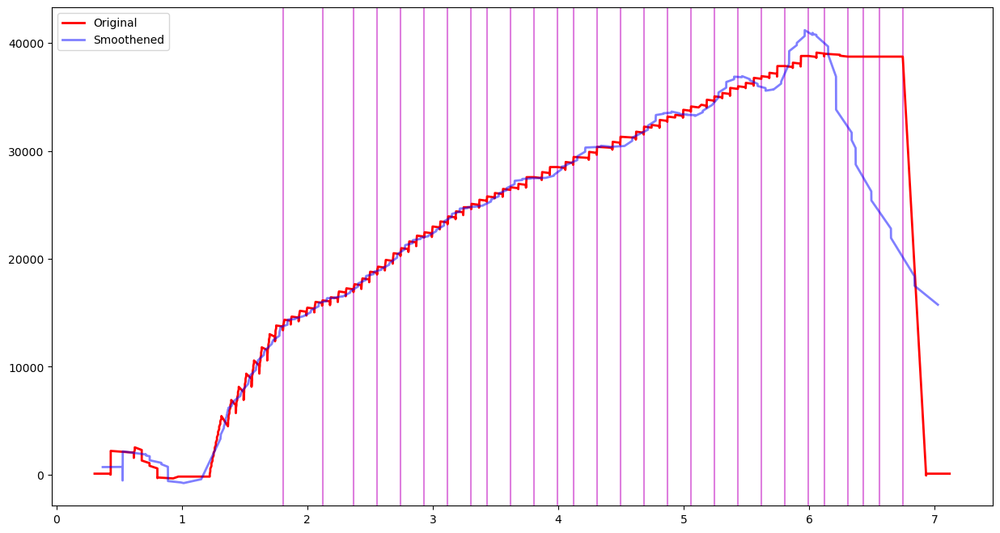

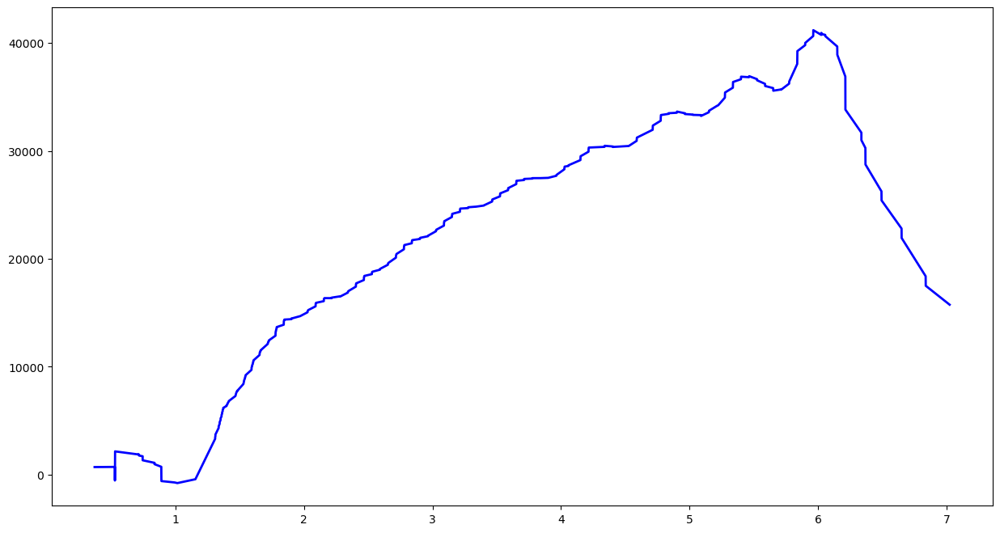

No Feature
../../singapore/top1k/fc2.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/fc2.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['58474'])
Port 58474


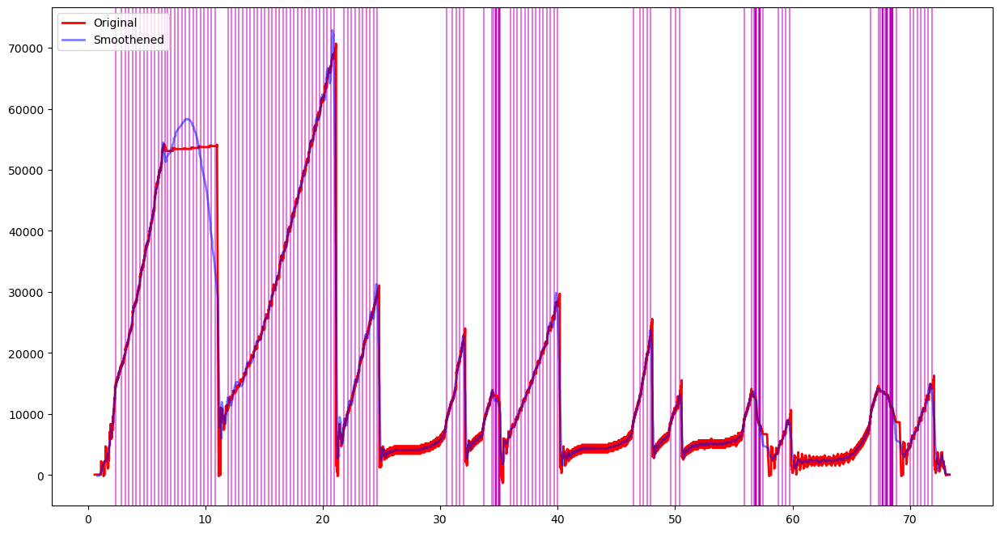

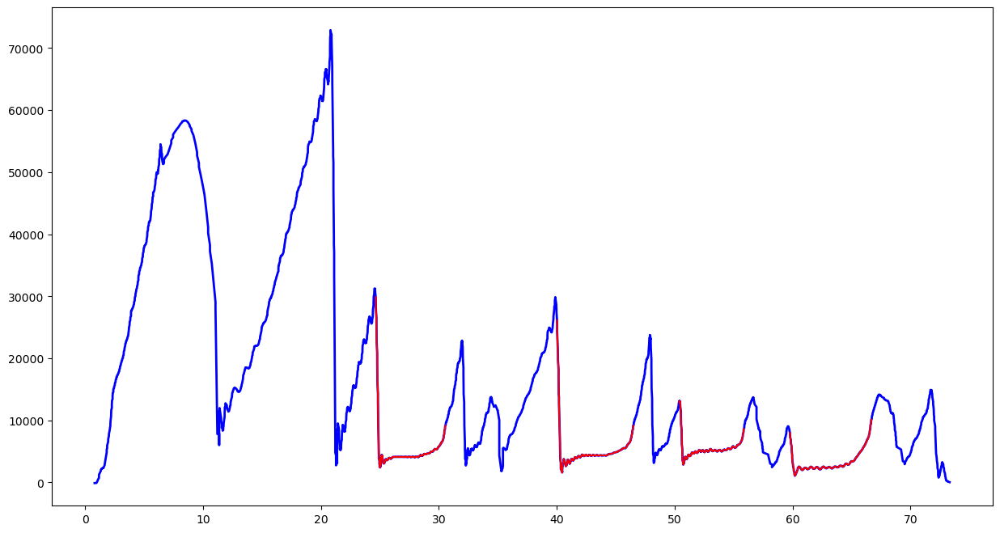

Feature Length  203


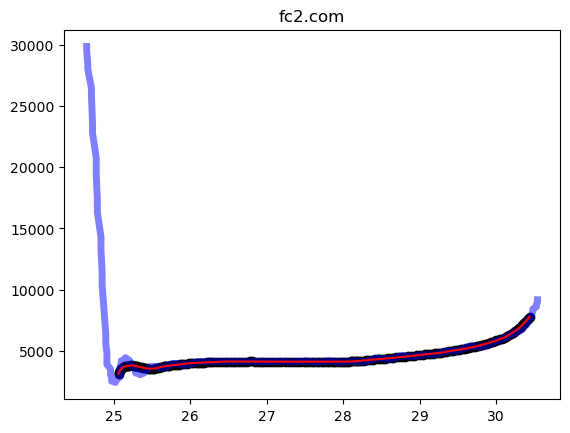

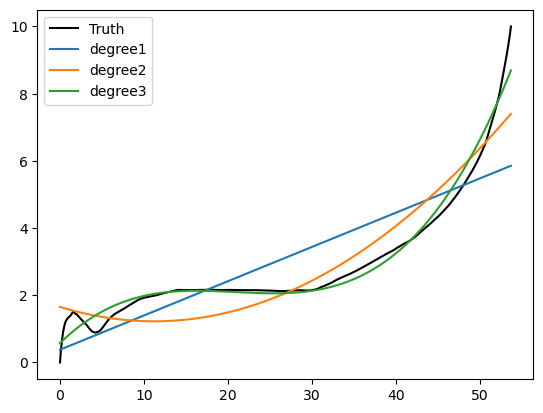

[ 2.10324598e-04 -1.34292885e-02  2.62335846e-01  3.08733032e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.99722835e-01 3.61463125e-59 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.80982372e-58 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/livejasmin.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/livejasmin.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54280'])
Port 54280


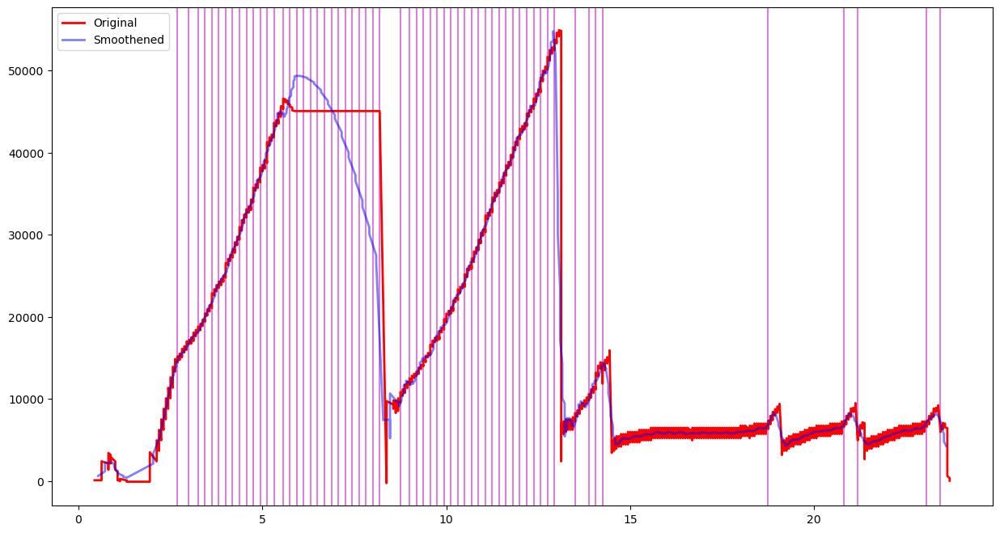

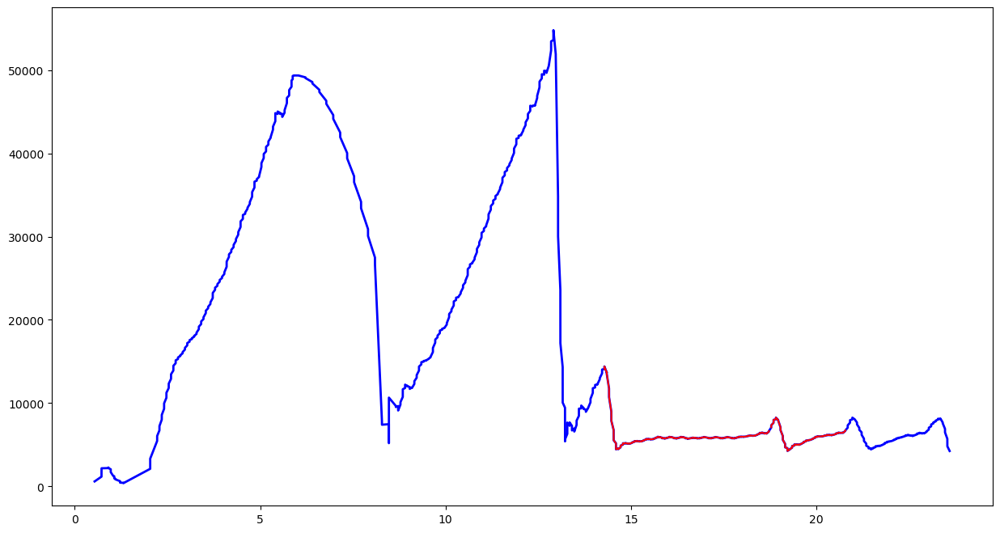

Feature Length  203


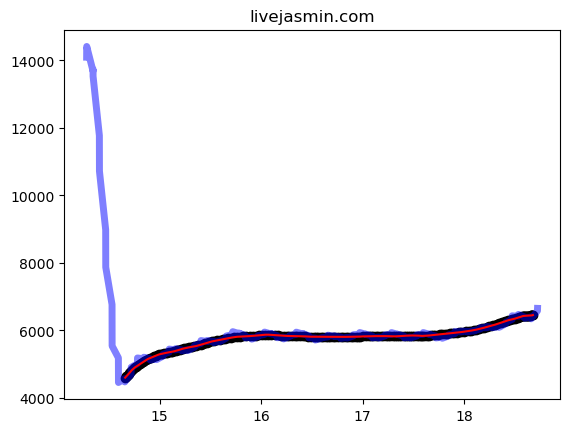

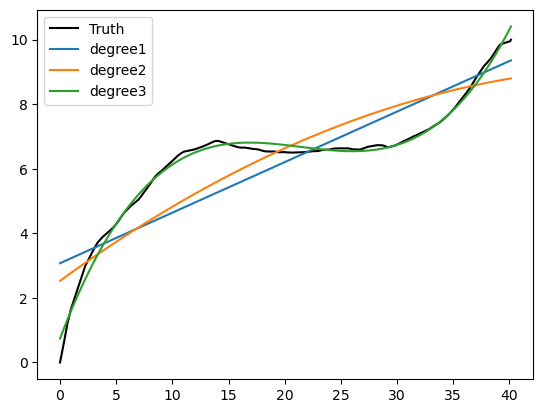

[ 6.84954829e-04 -4.56139963e-02  9.68281442e-01  4.46090190e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [6.63304842e-13 1.70839633e-93 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 2.57558247e-81 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/google.co.th-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.th-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55468'])
Port 55468


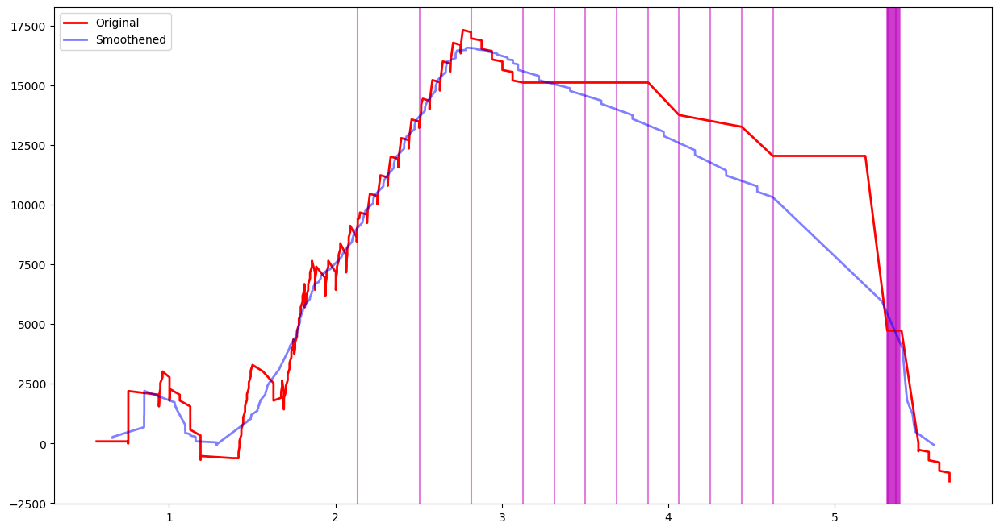

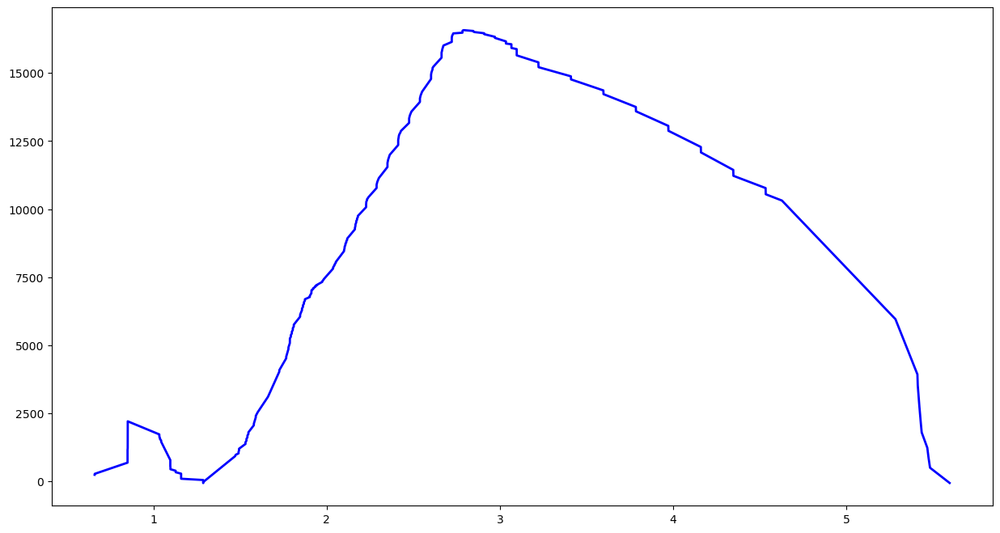

No Feature
../../singapore/top1k/google.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53318'])
Port 53318


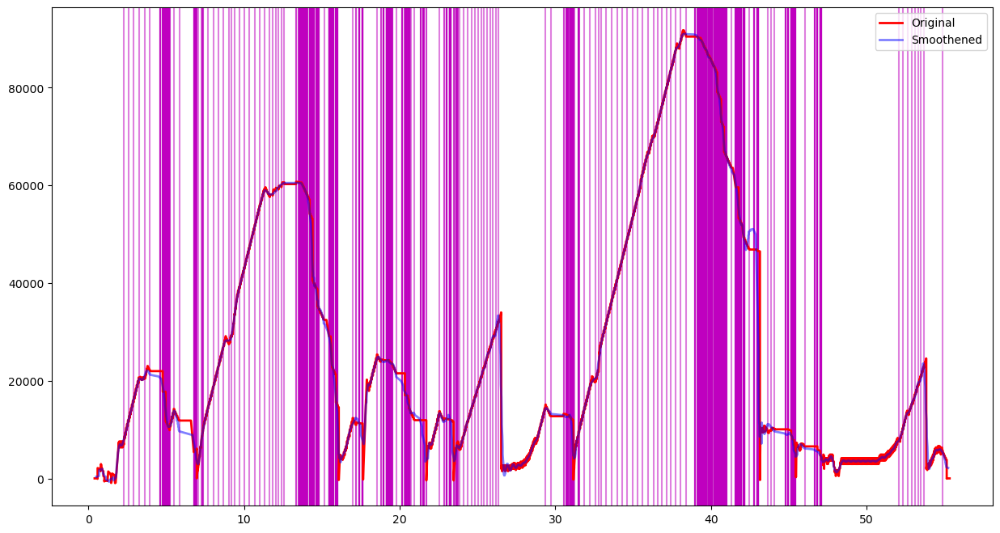

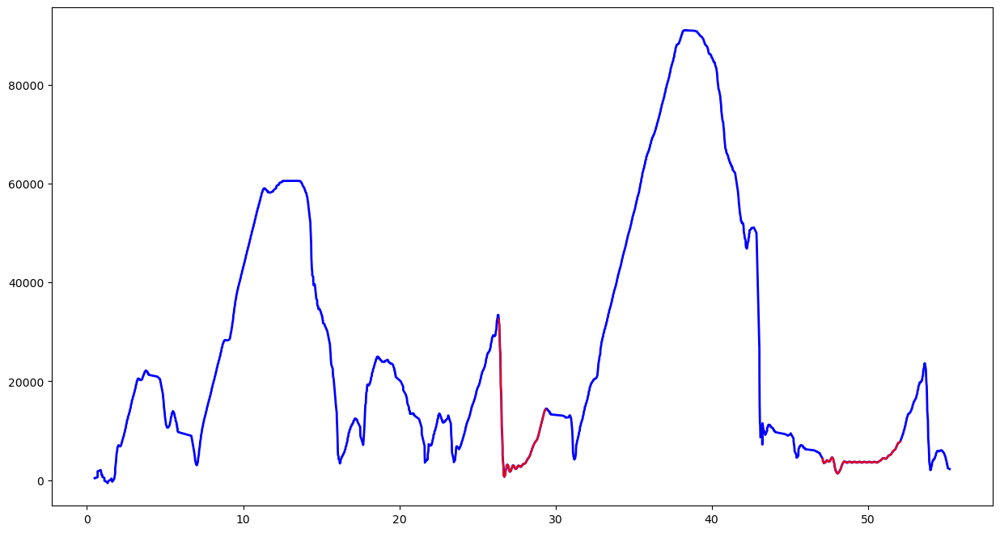

Feature Length  203


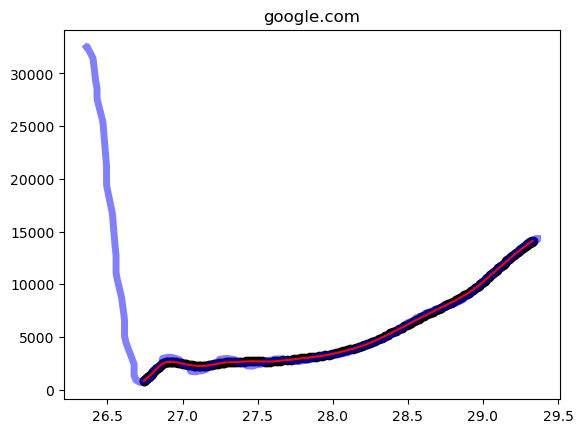

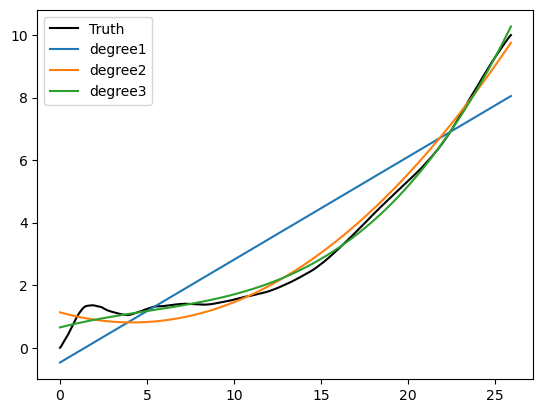

[ 6.42837025e-04 -4.04423922e-03  5.41206059e-02  6.63461842e-01]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [3.18274654e-26 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/quora.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/quora.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37026'])
Port 37026


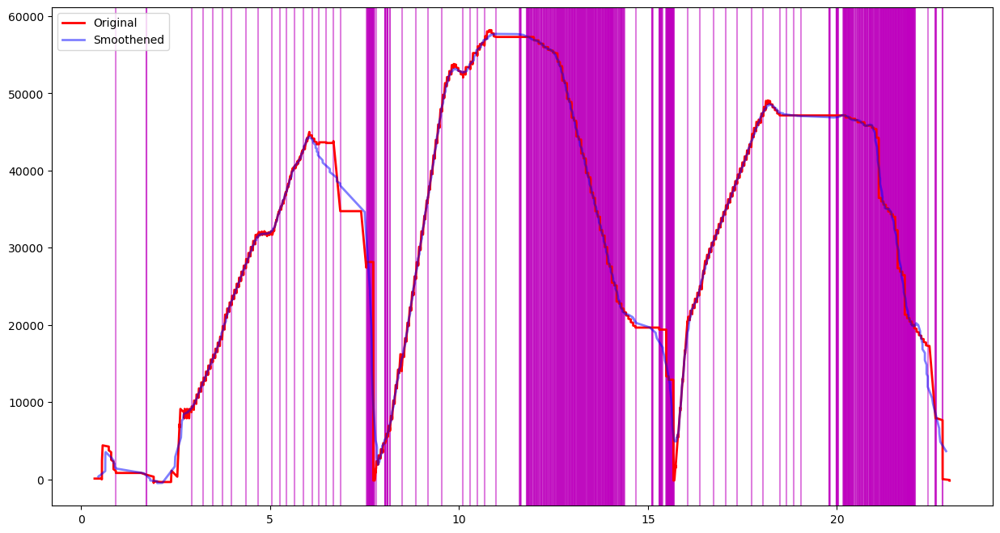

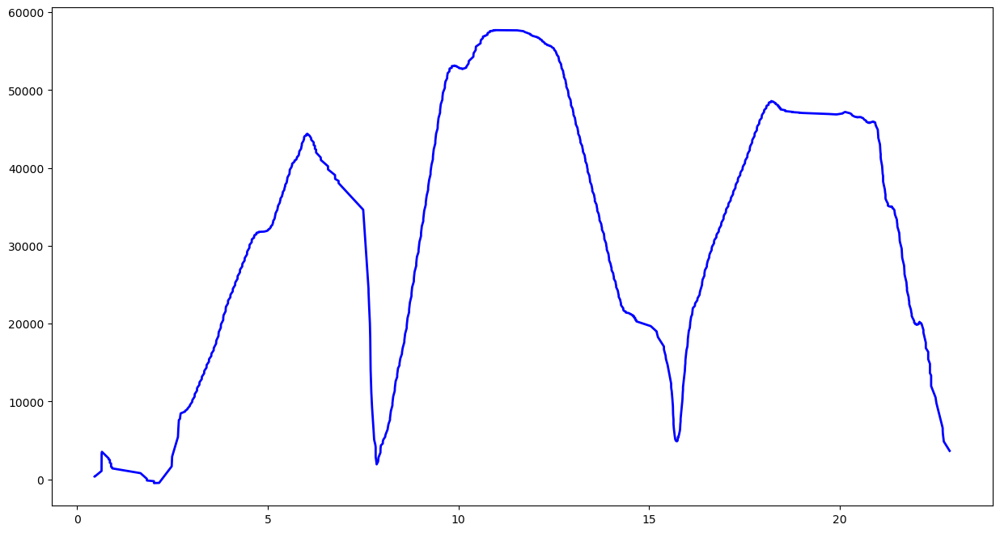

No Feature
../../singapore/top1k/nfl.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/nfl.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49072'])
Port 49072


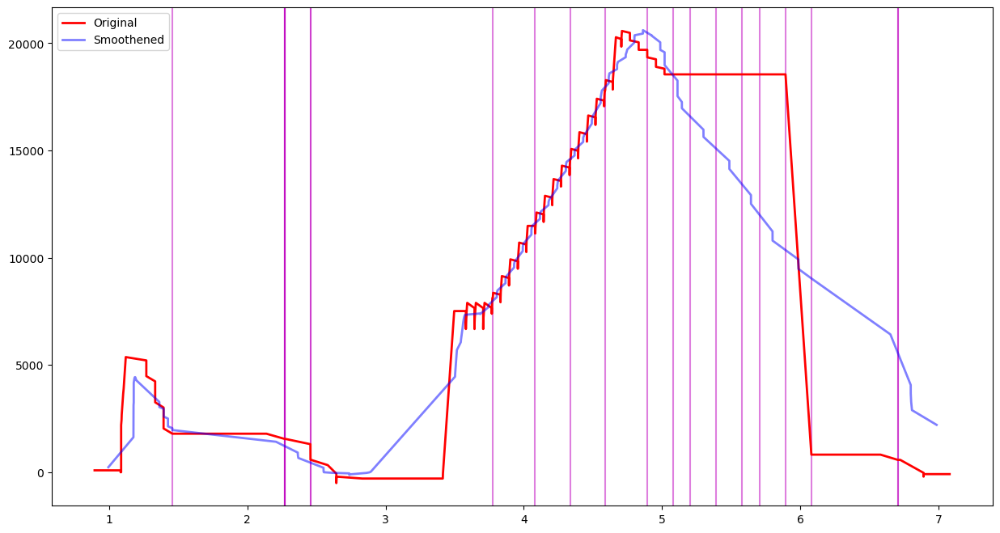

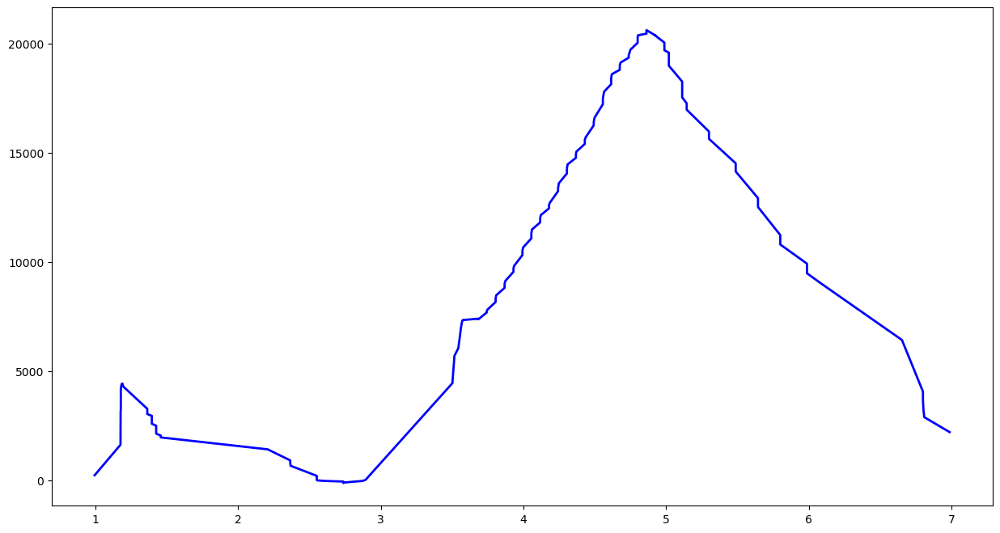

No Feature
../../singapore/top1k/iqiyi.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/iqiyi.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59942'])
Port 59942


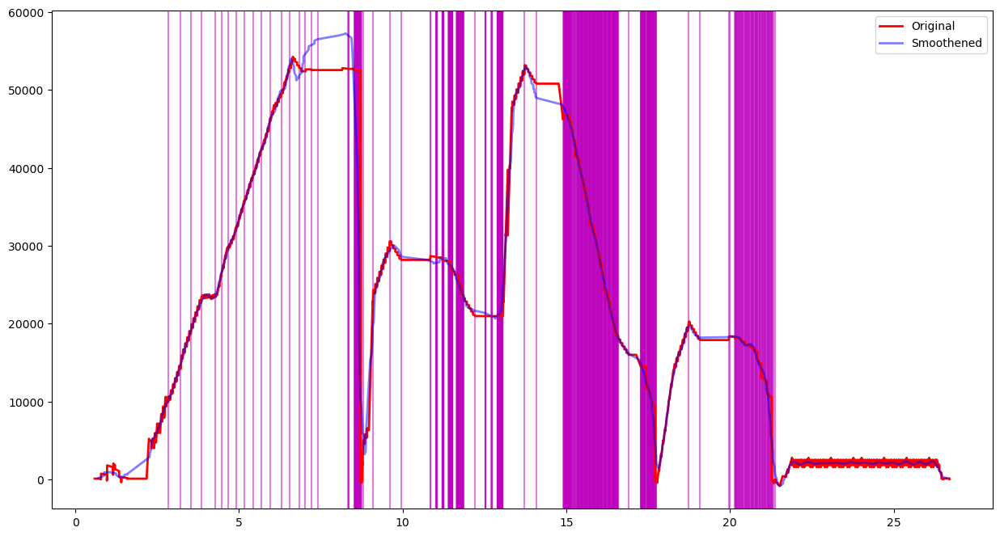

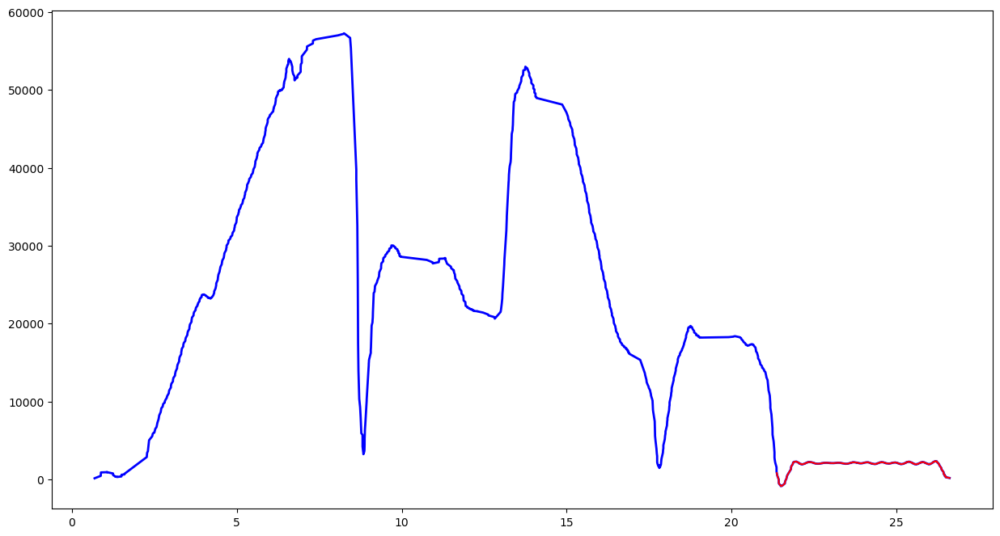

Feature Length  203


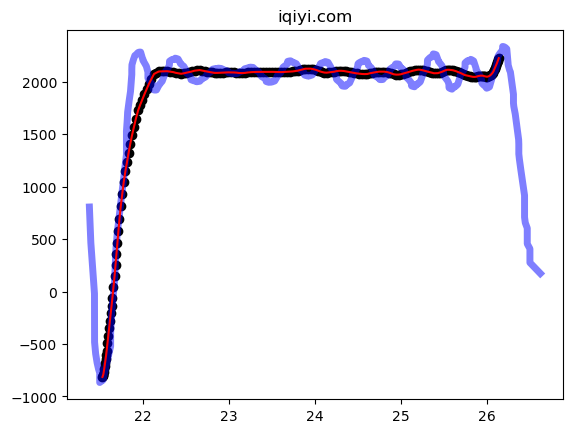

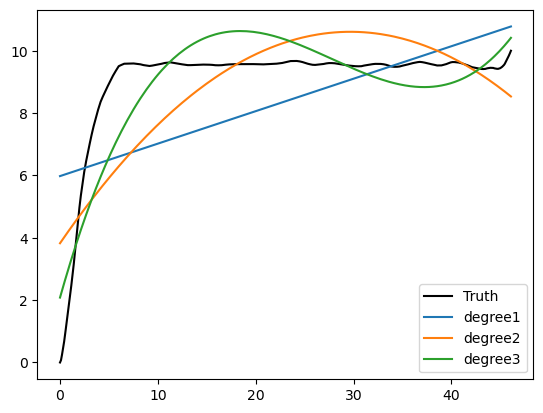

[ 4.41492235e-04 -3.67765142e-02  9.10587904e-01  3.18135938e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.54504464e-49 2.02067159e-93 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.30784026e-44 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/google.com.mx-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.mx-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37118'])
Port 37118


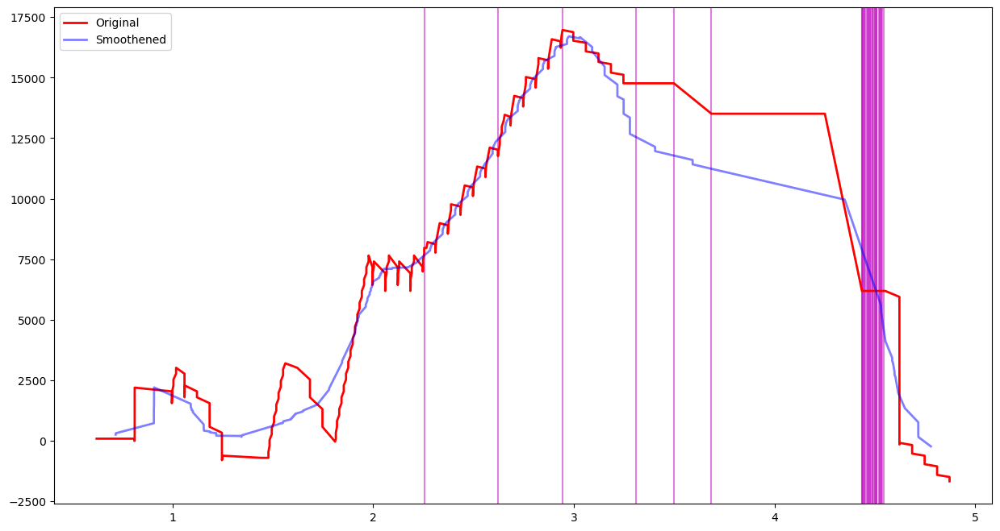

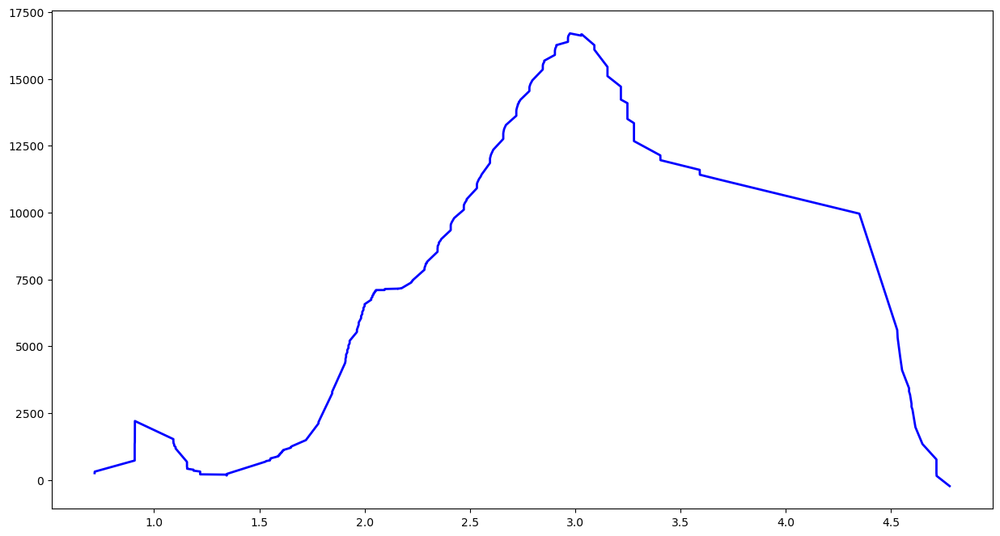

No Feature
../../singapore/top1k/force.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/force.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33860'])
Port 33860


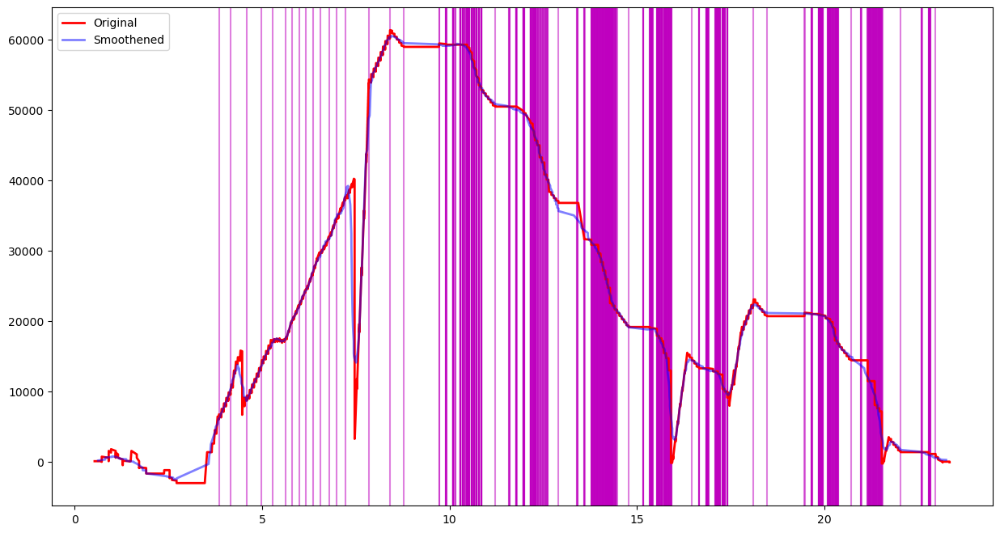

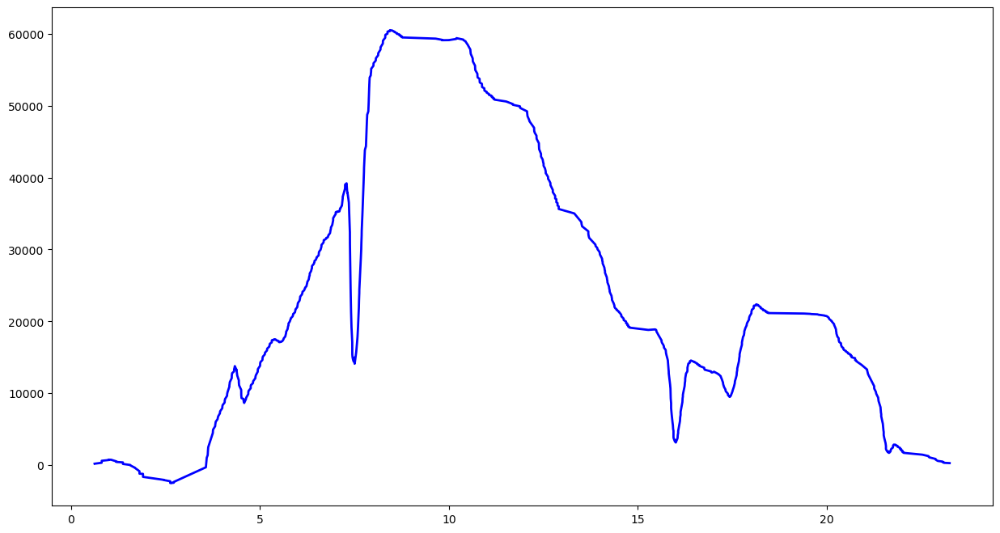

No Feature
../../singapore/top1k/google.com.co-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.co-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45870'])
Port 45870


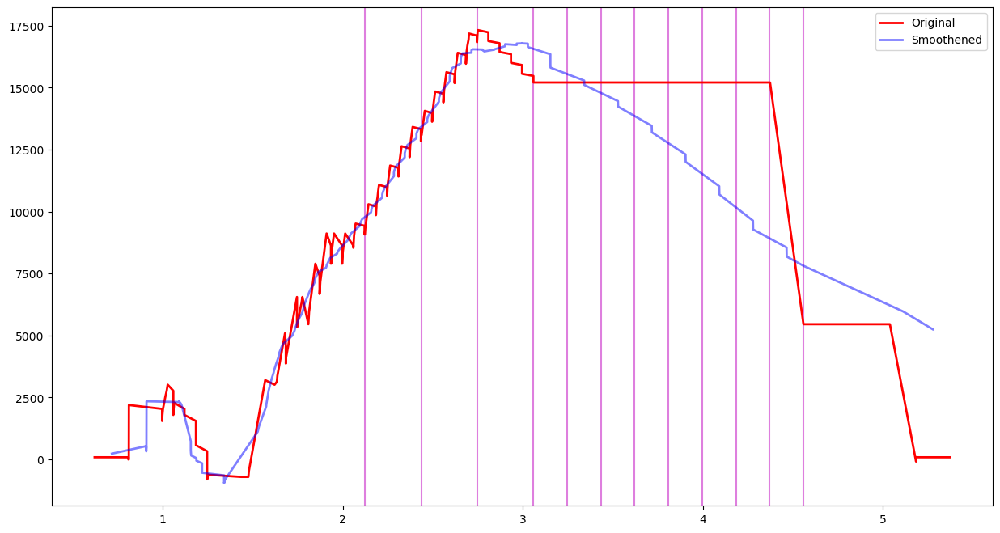

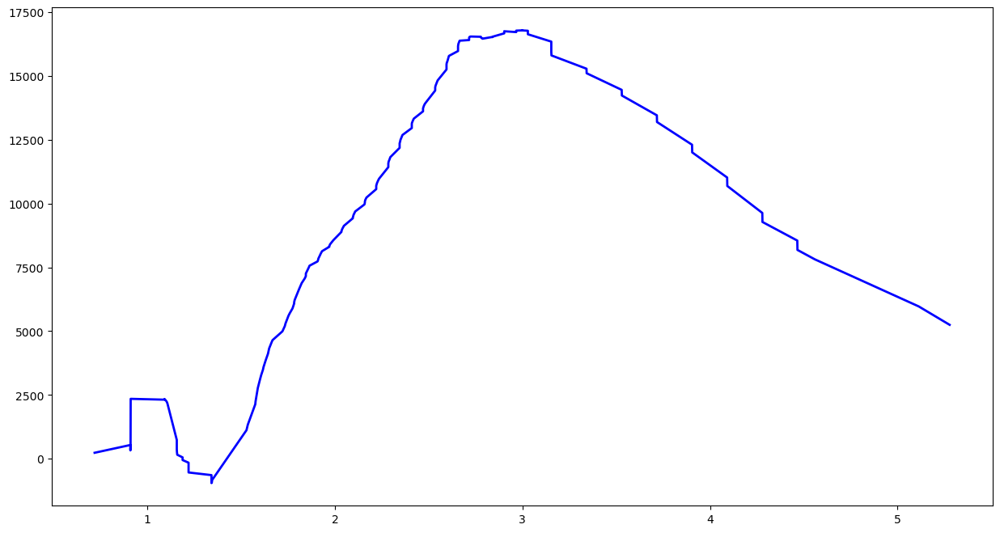

No Feature
../../singapore/top1k/xhamster.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/xhamster.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35692'])
Port 35692


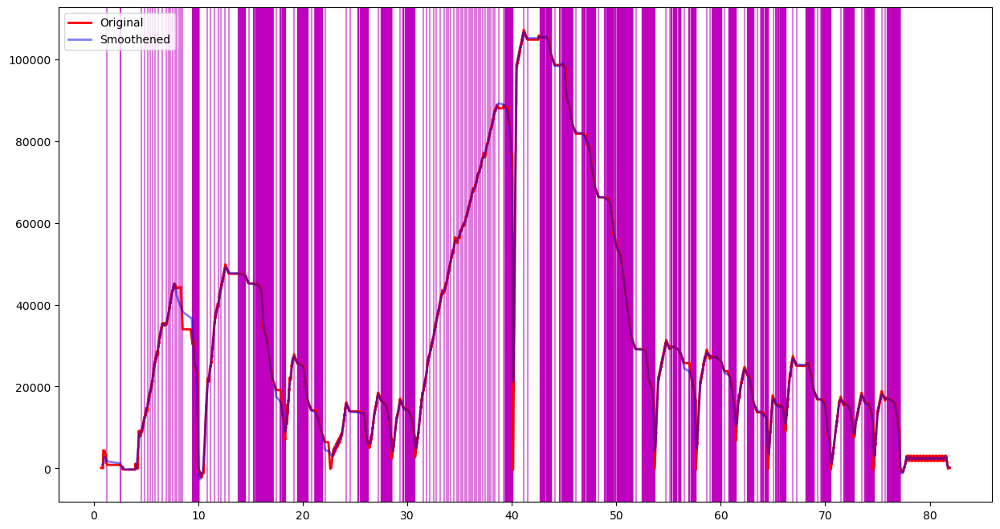

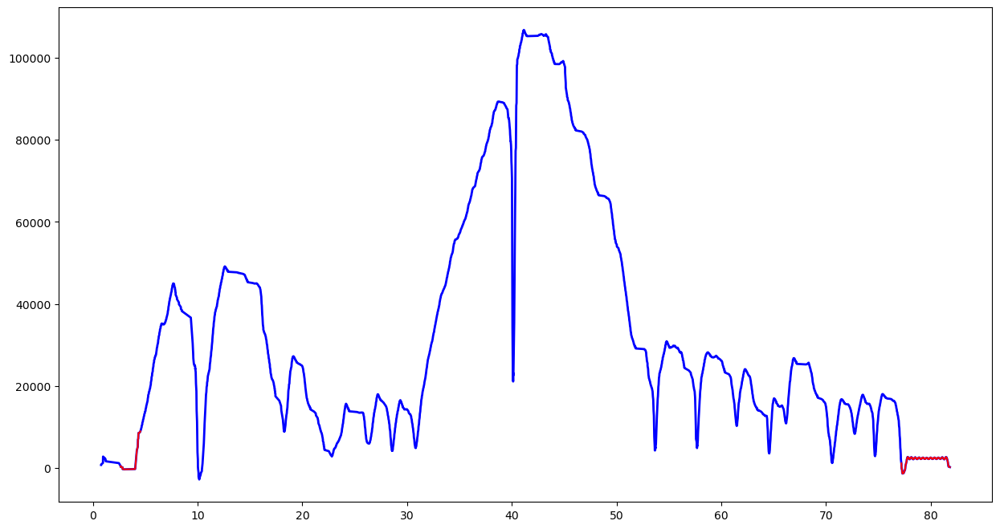

Feature Length  203


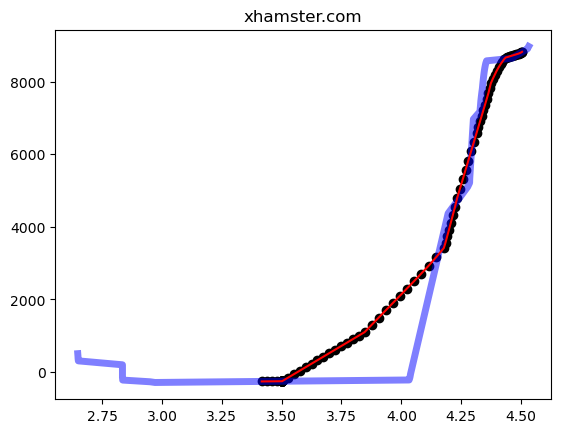

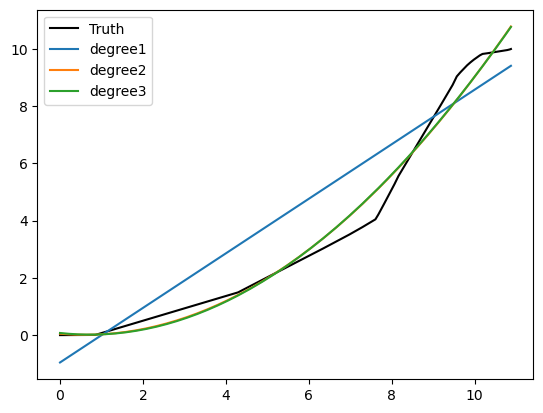

[ 0.10849565 -0.17715482  0.09378584]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/pixnet.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/pixnet.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50616'])
Port 50616


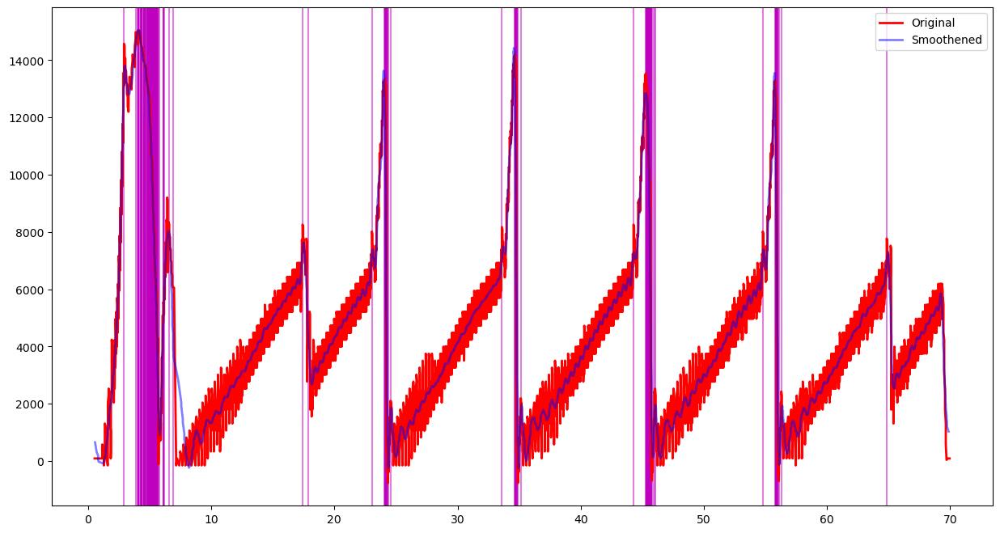

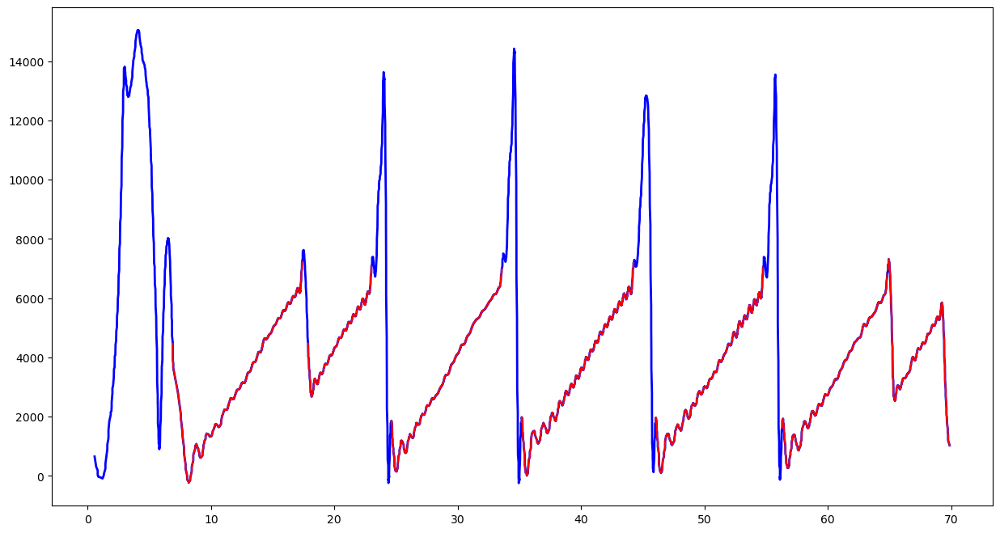

Feature Length  203


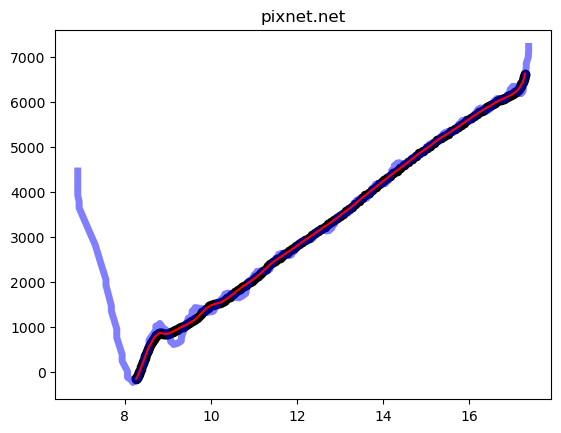

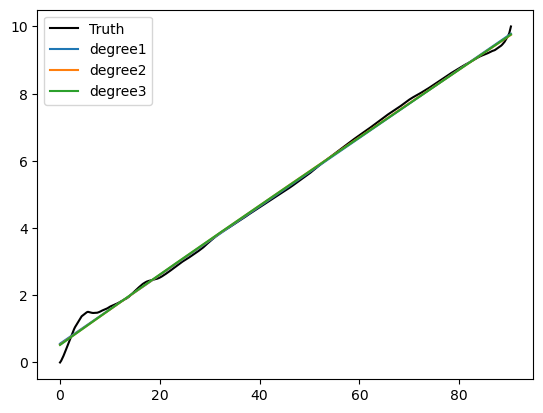

[0.10484075 0.48642961]
Top 5 CCS : ['nv', 'scalable', 'bic', 'yeah']
Density Values: [9.83885994e-01 8.70188698e-01 8.97989353e-06 7.57083294e-32]
Relative Density Values: [1.00000000e+00 8.84440579e-01 9.12696550e-06 0.00000000e+00]
Prediction: confused
../../singapore/top1k/google.ru-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34124'])
Port 34124


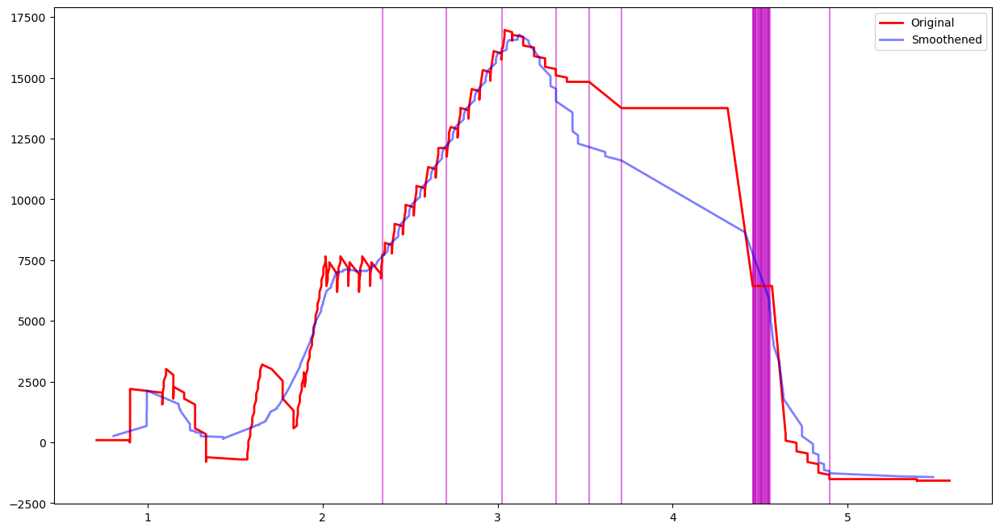

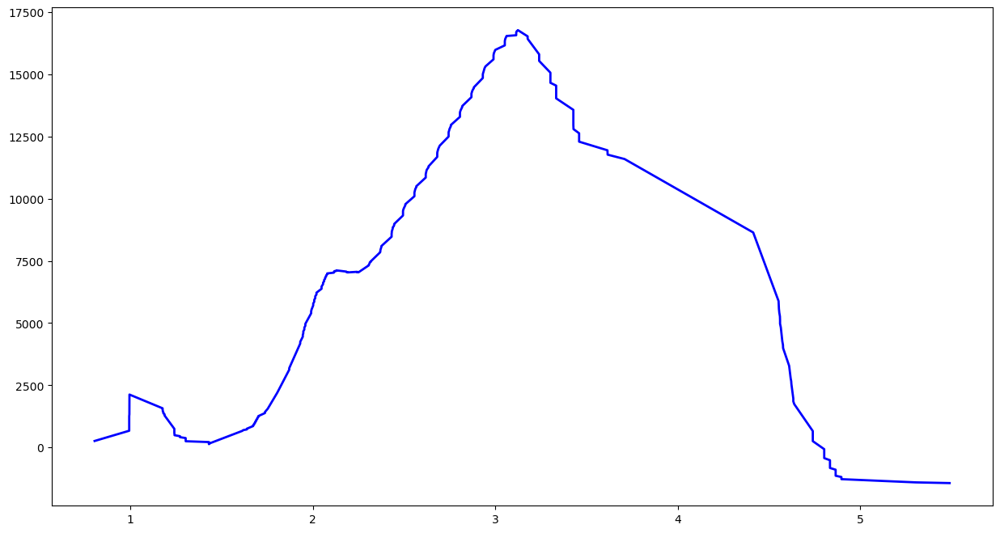

No Feature
../../singapore/top1k/blackboard.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/blackboard.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54364'])
Port 54364


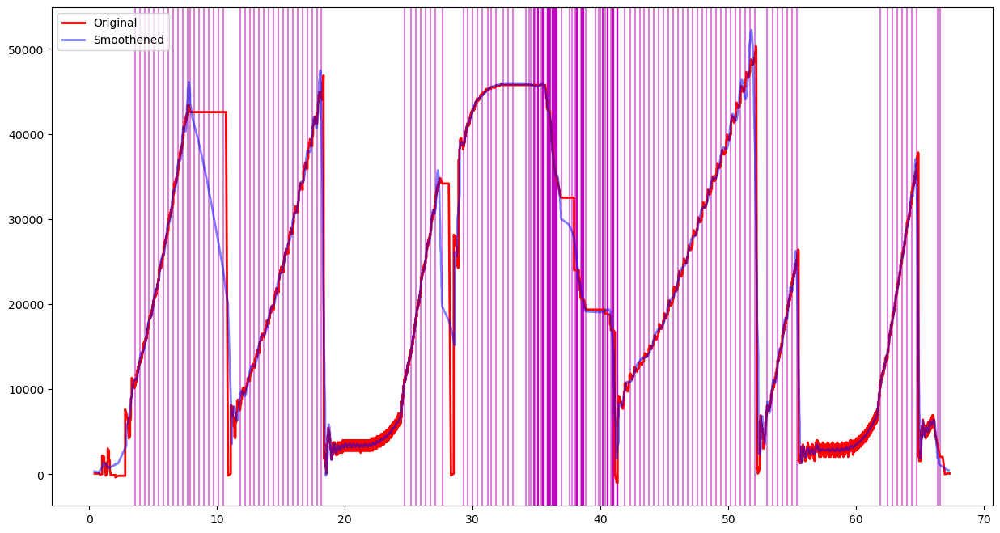

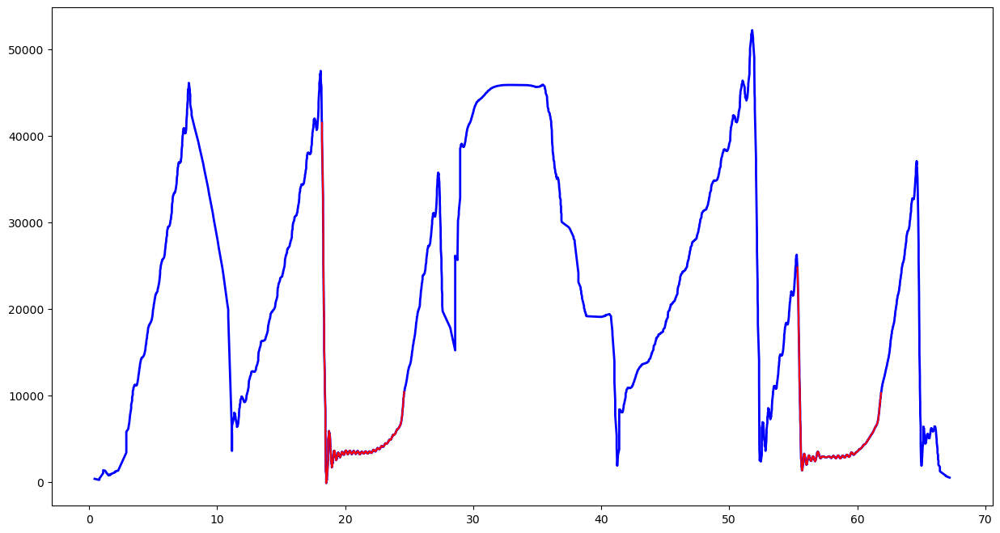

Feature Length  203


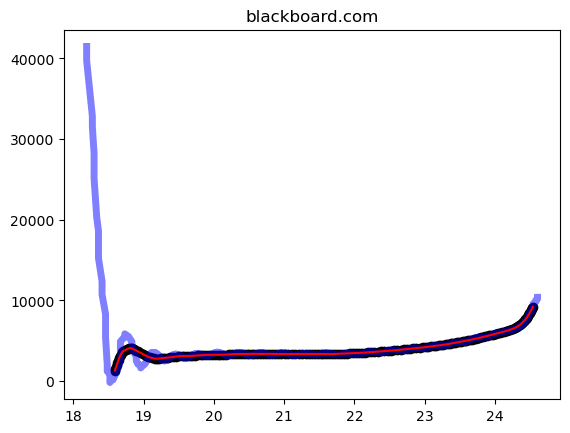

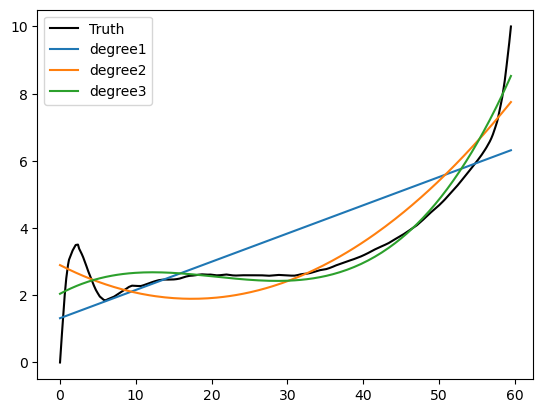

[ 1.41269280e-04 -1.01180004e-02  2.20414042e-01  1.55784565e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [3.77200180e-01 1.16516291e-58 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 3.08897761e-58 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/tribunnews.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/tribunnews.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48598', '33694'])
Port 33694


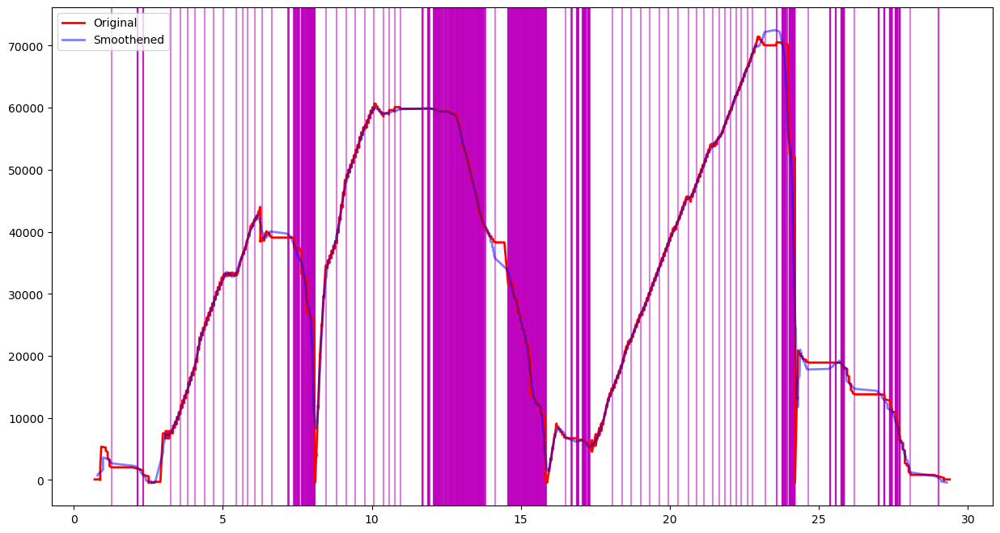

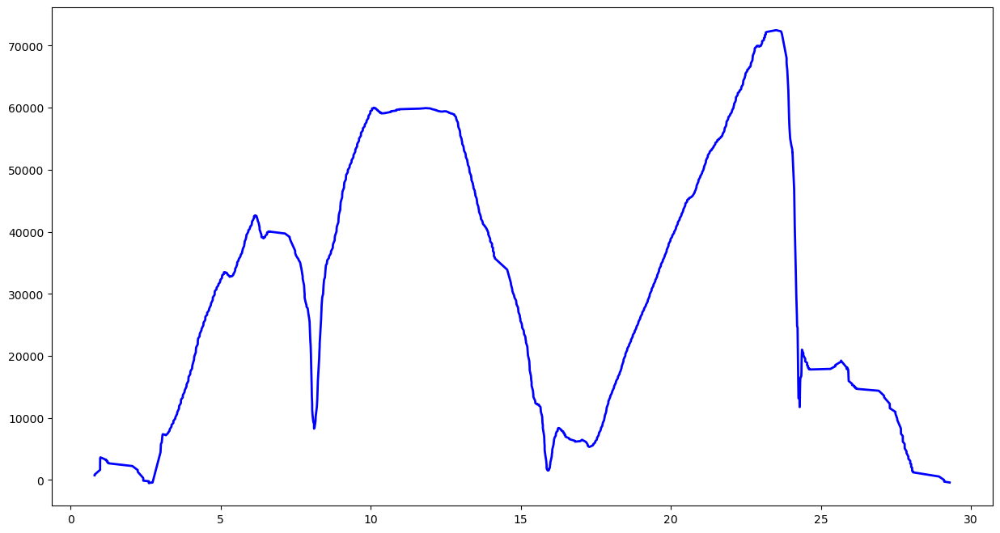

No Feature
../../singapore/top1k/nih.gov-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/nih.gov-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45490'])
Port 45490


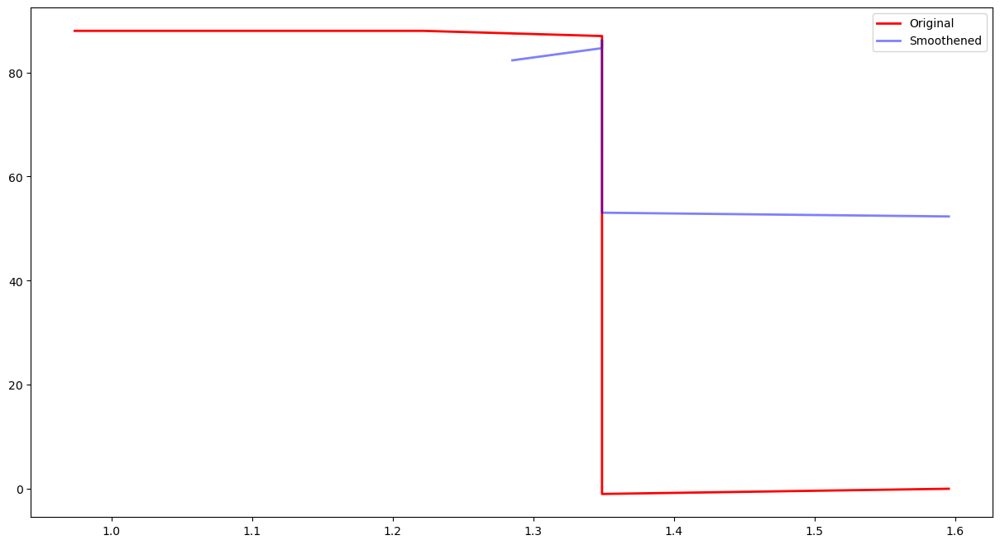

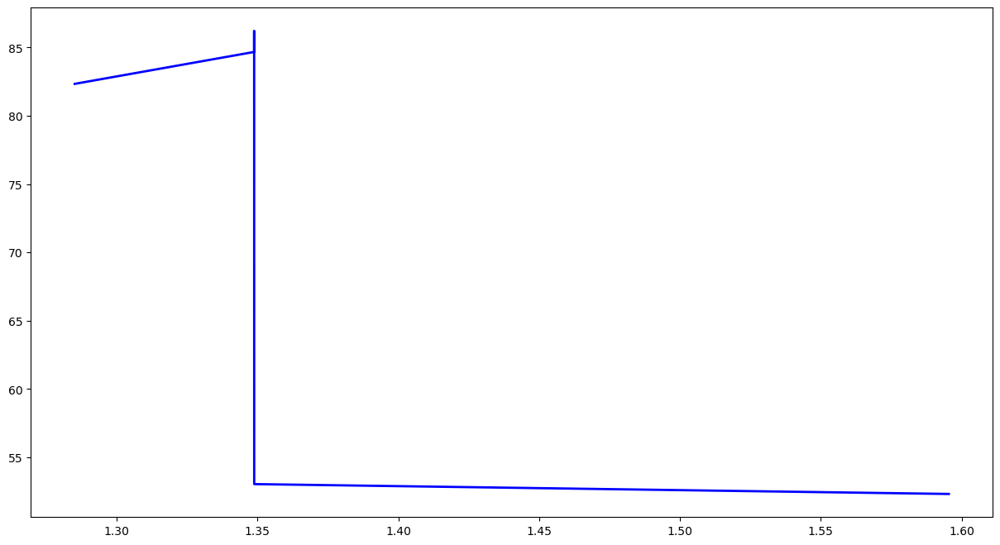

No Feature
../../singapore/top1k/github.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/github.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49678', '49736', '34626', '45344', '37772', '48136', '60248', '34798', '44734', '36216', '42392', '53196', '38988', '47844', '46460', '60326', '53170', '37456', '50454', '47620'])
Port 49678


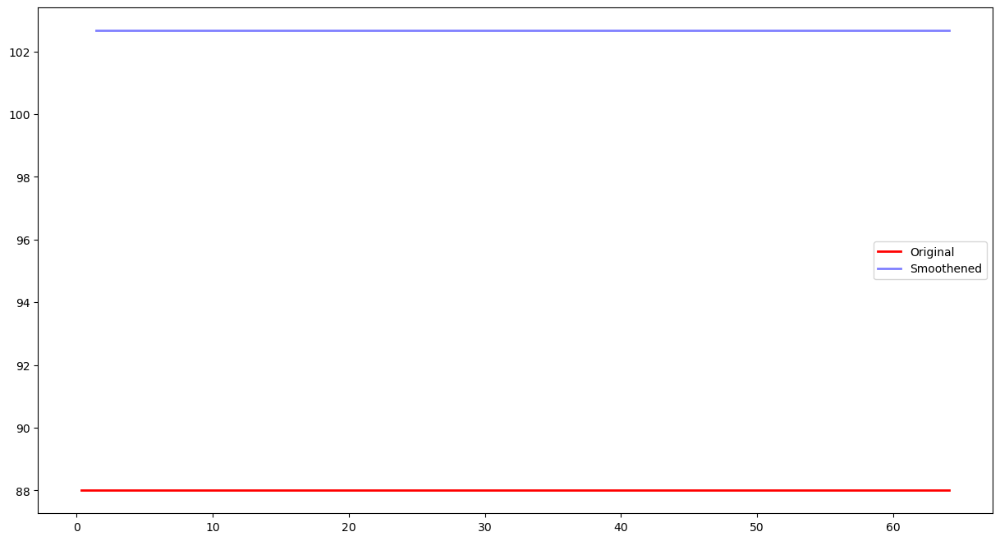

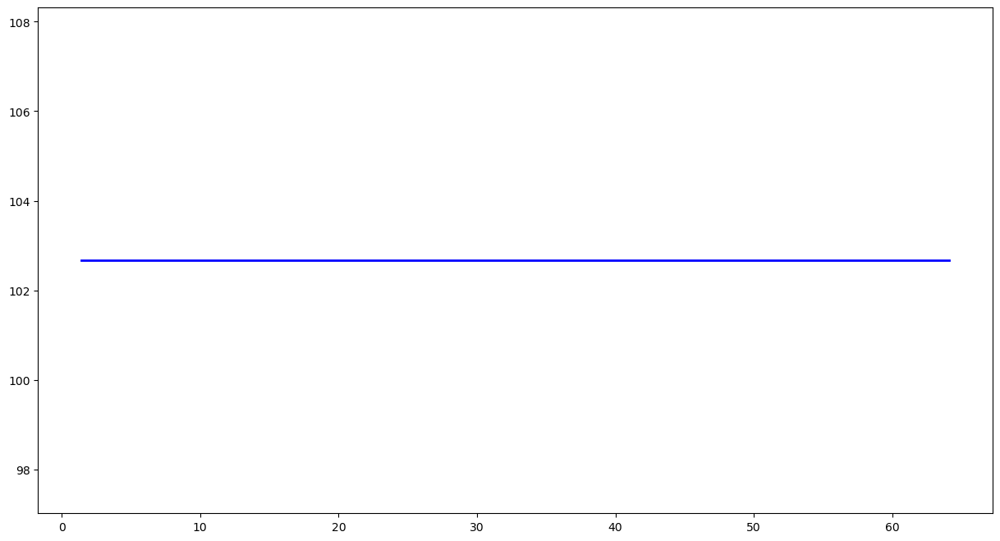

No Feature
../../singapore/top1k/crptentry.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/crptentry.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44914'])
Port 44914


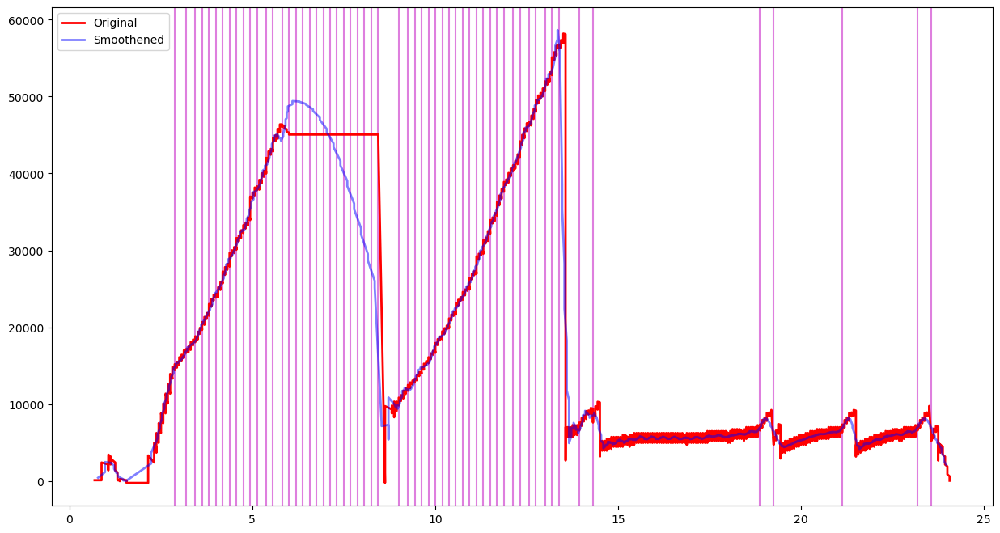

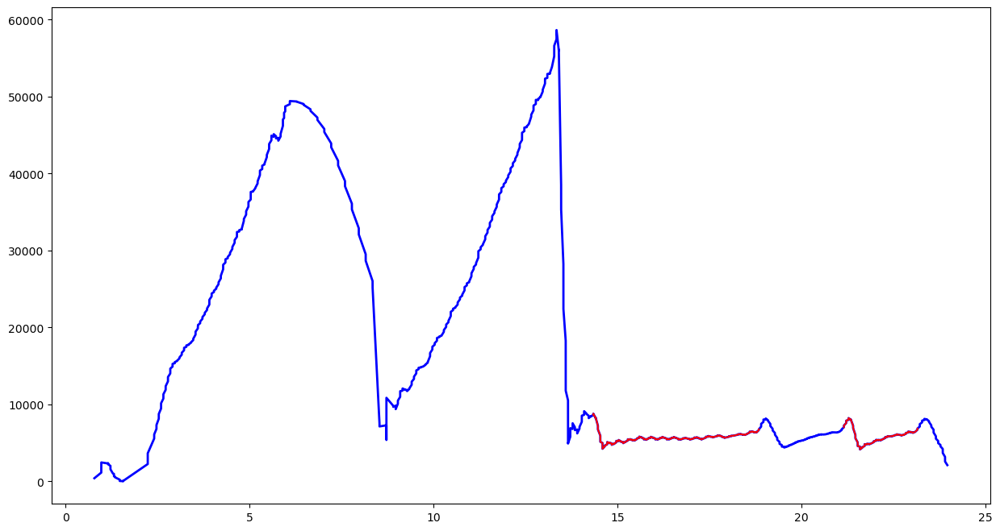

Feature Length  203


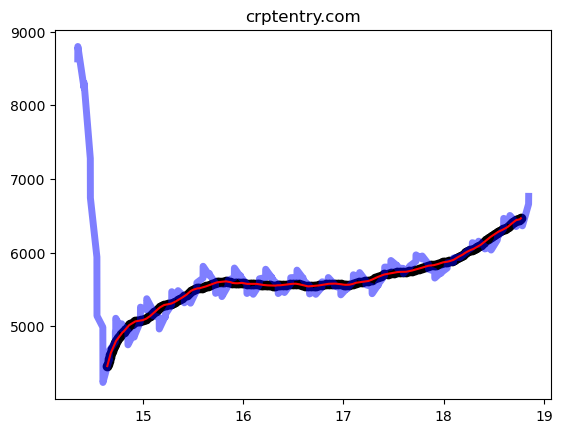

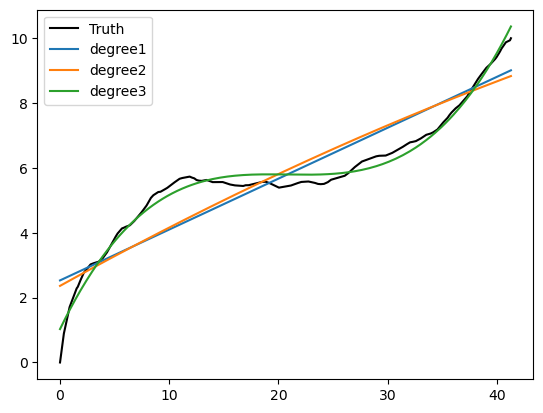

[ 5.14375130e-04 -3.23358892e-02  6.87097197e-01  6.82564045e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [9.25152559e+05 1.43947387e-51 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.55593135e-57 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/etsy.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/etsy.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33202'])
Port 33202


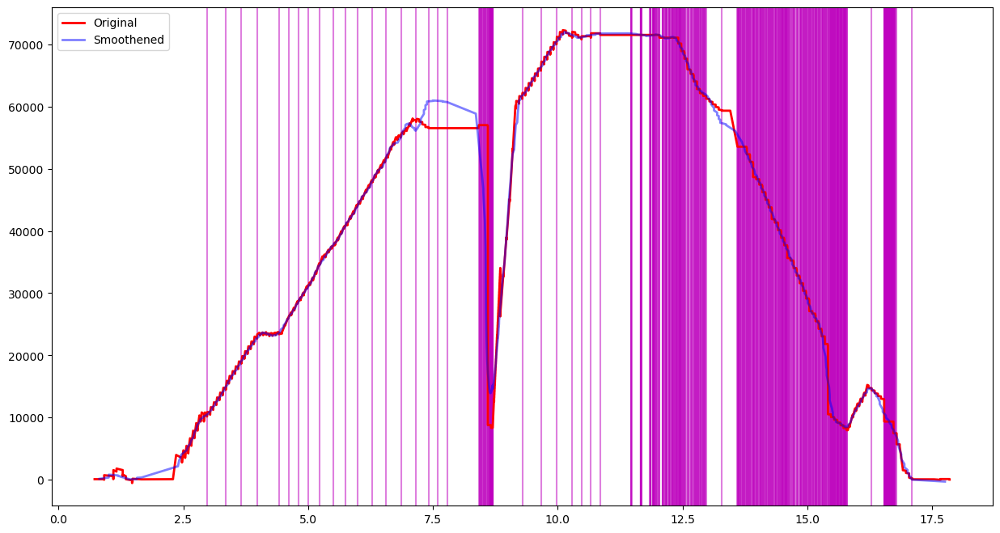

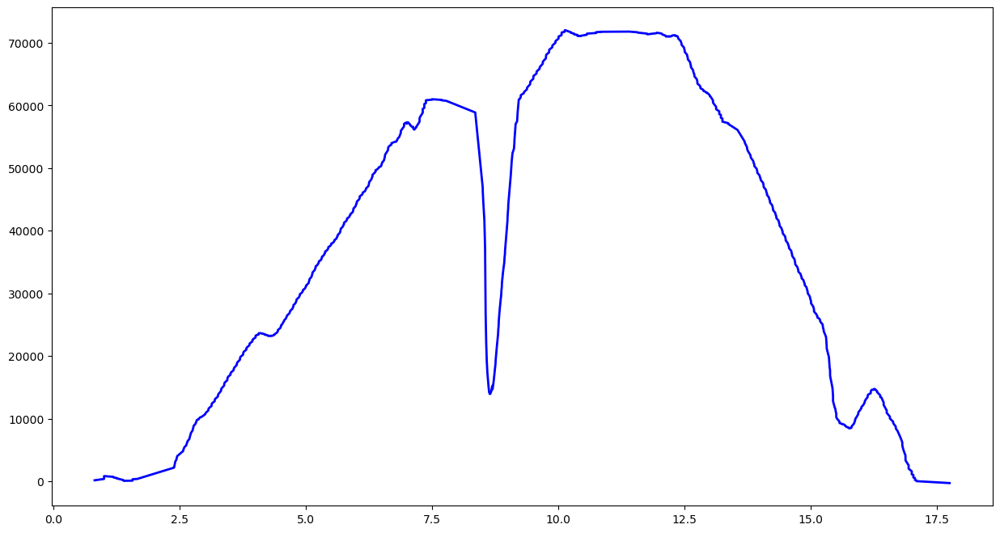

No Feature
../../singapore/top1k/xfinity.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/xfinity.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33368', '53338'])
Port 33368


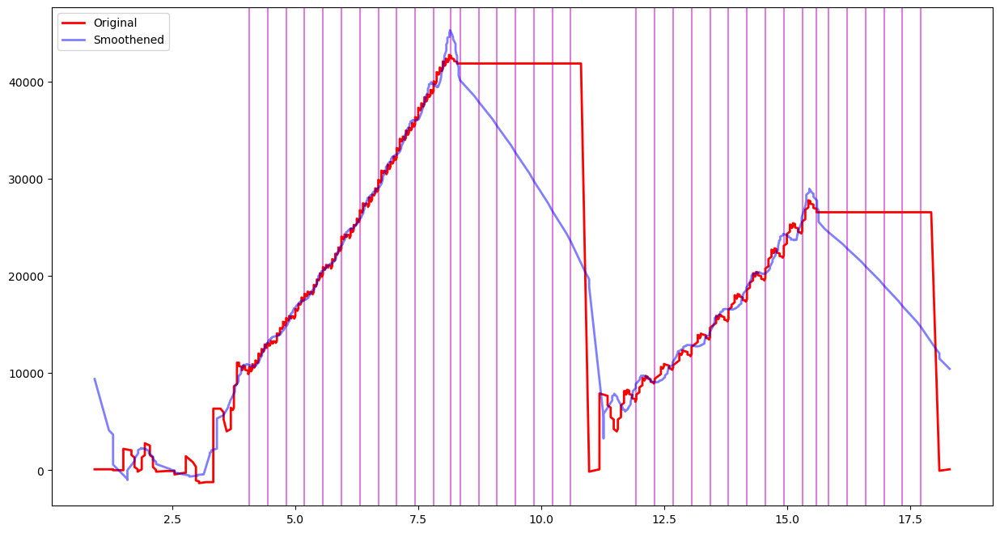

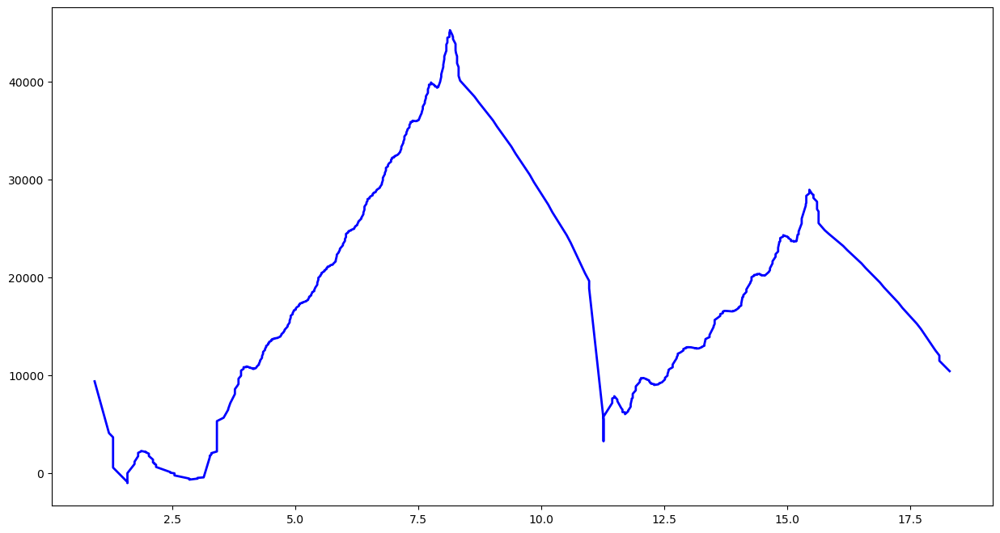

No Feature
../../singapore/top1k/google.fr-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.fr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53570'])
Port 53570


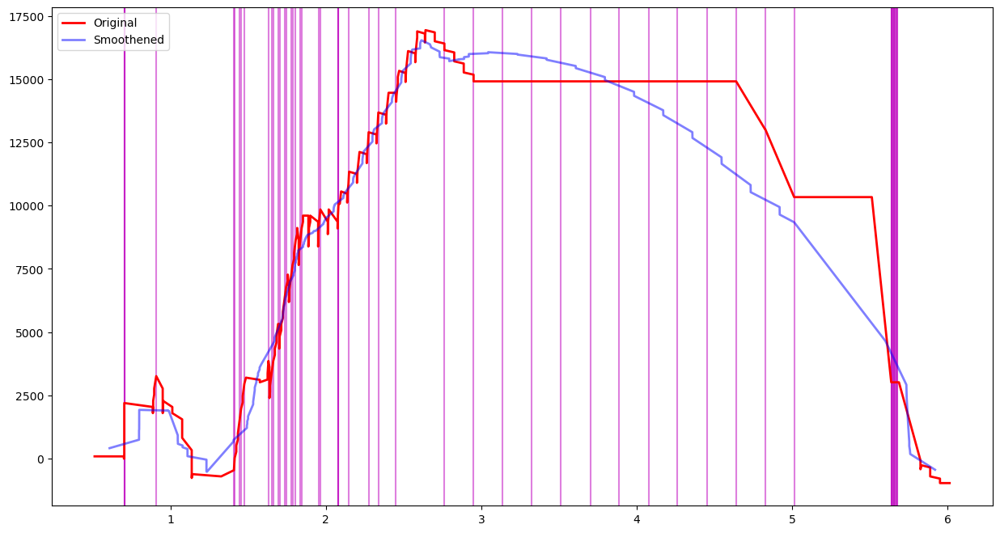

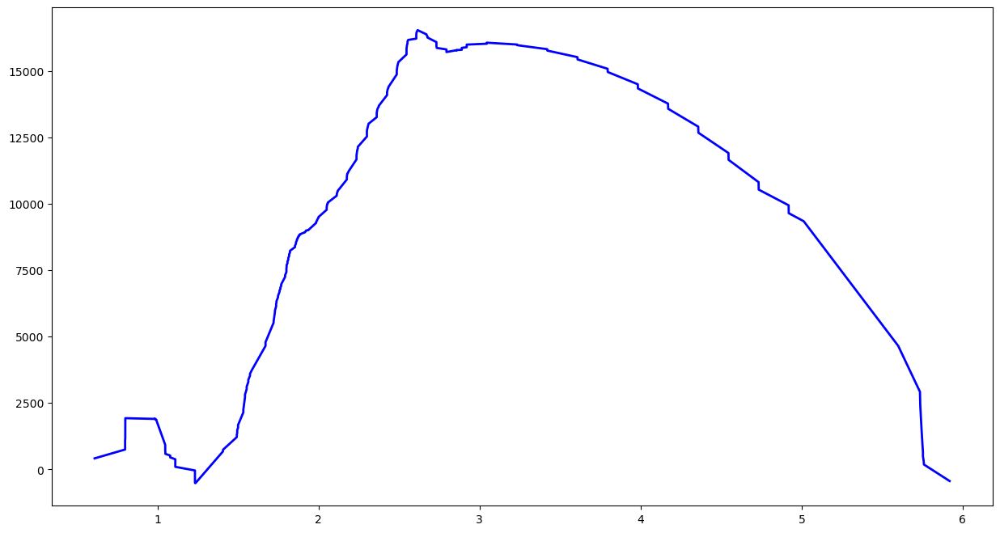

No Feature
../../singapore/top1k/soso.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/soso.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49224'])
Port 49224


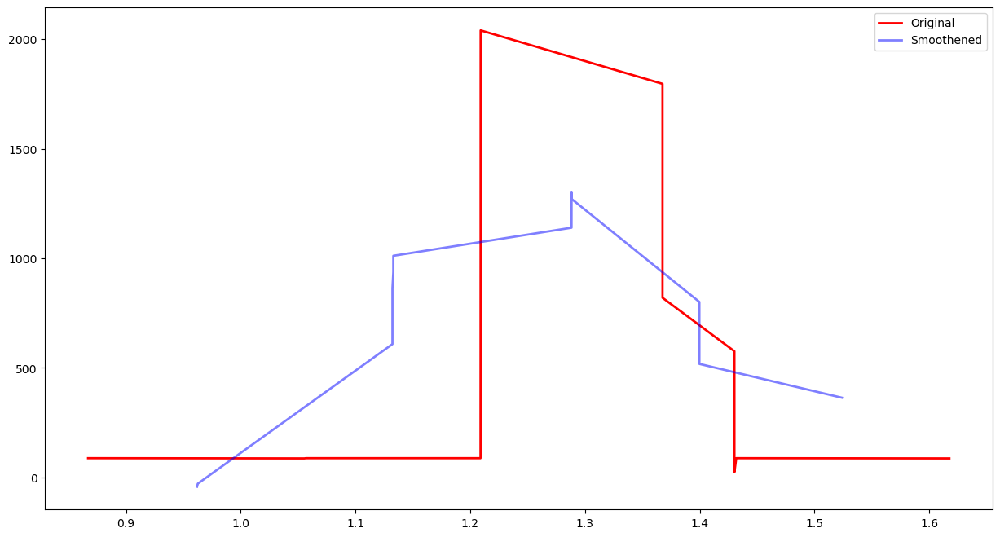

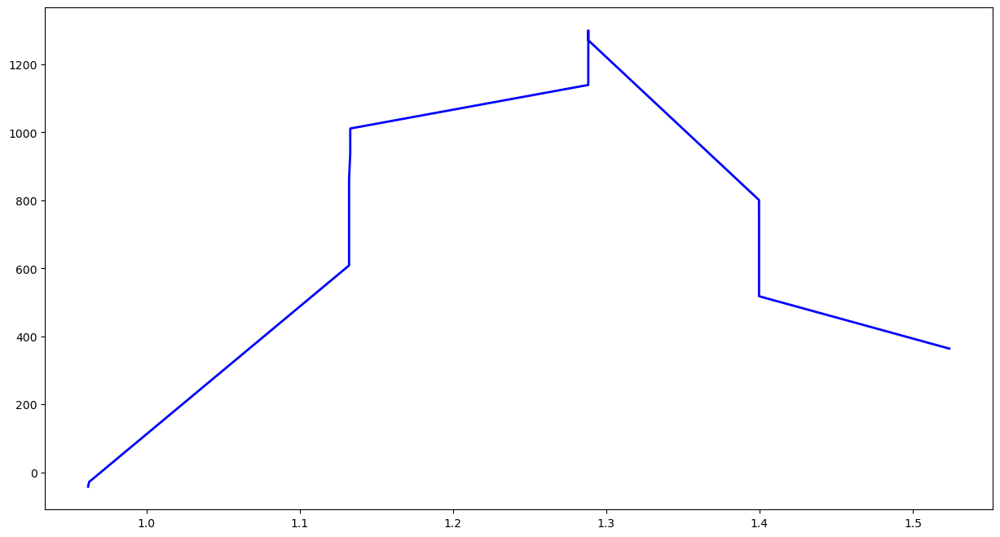

No Feature
../../singapore/top1k/1688.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/1688.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57442'])
Port 57442


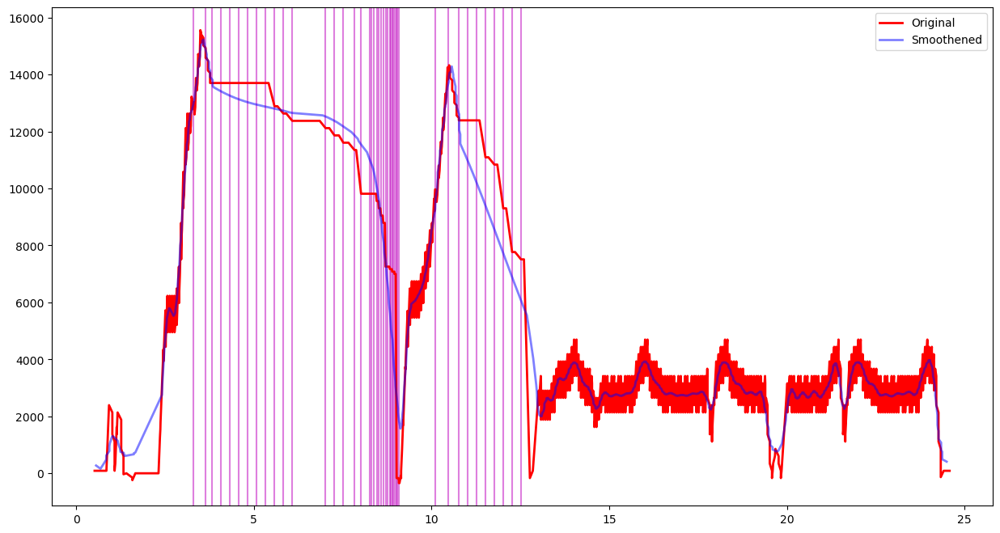

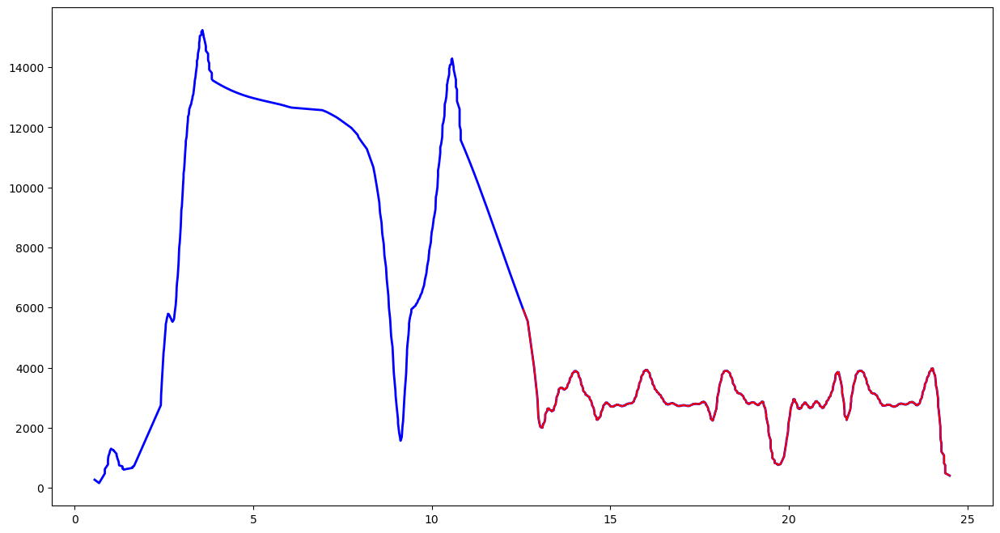

Feature Length  203


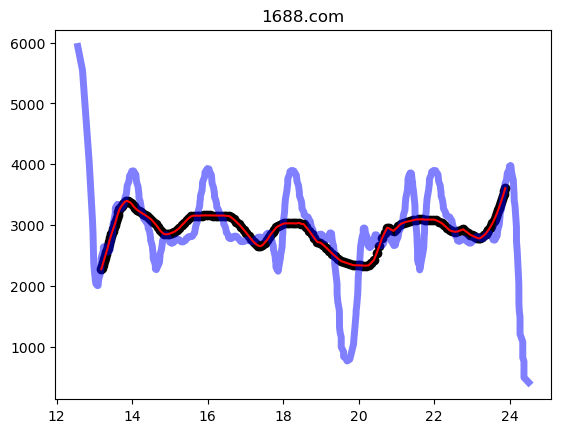

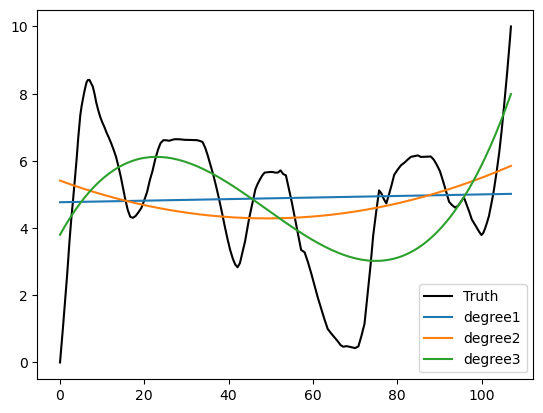

[ 3.22606945e-05 -4.64113296e-03  1.64735431e-01  3.62302416e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.37797775e-004 9.81295514e-053 5.22480978e-231 0.00000000e+000]
Relative Density Values: [1.00000000e+000 7.12127257e-049 3.79165032e-227 0.00000000e+000]
Prediction: new
../../singapore/top1k/dailymotion.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/dailymotion.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46440', '50652'])
Port 50652


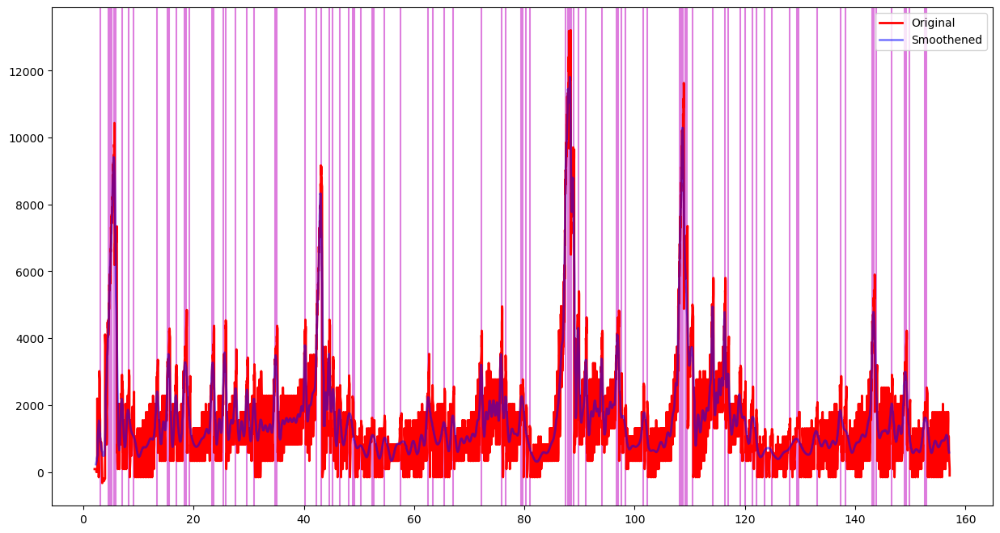

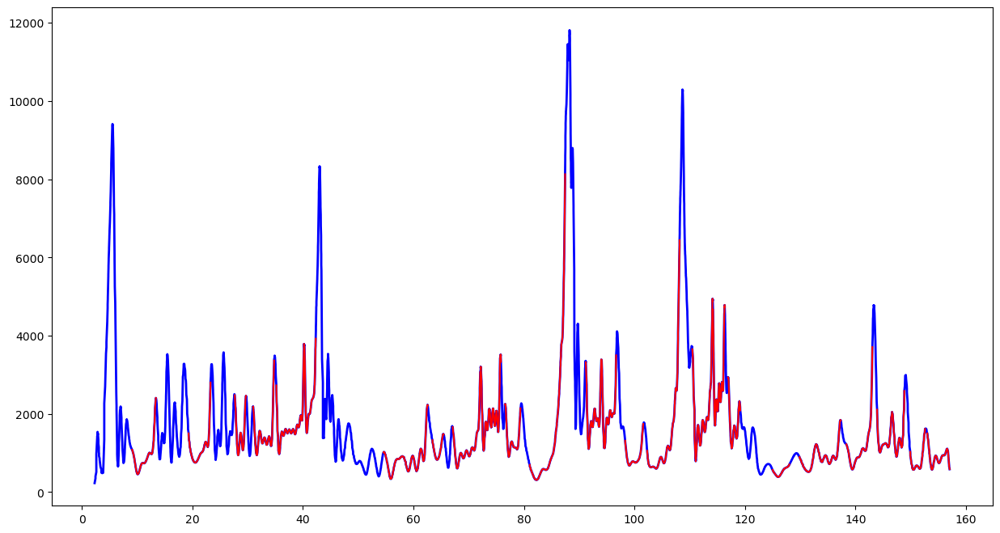

Feature Length  203


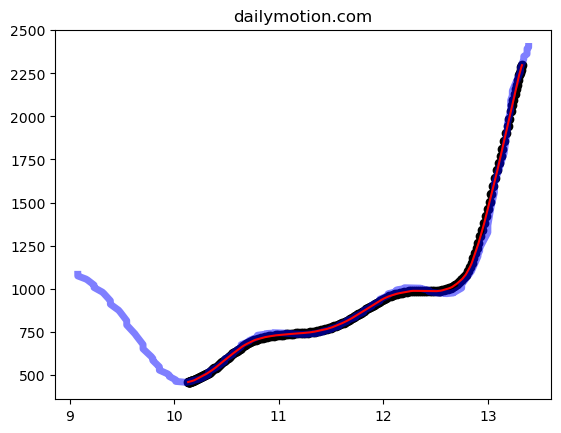

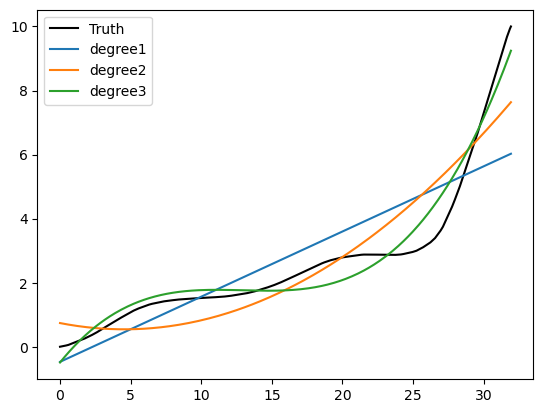

[ 0.00117823 -0.04598484  0.57235682 -0.51574909]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.41125801e-66 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.de-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.de-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46150'])
Port 46150


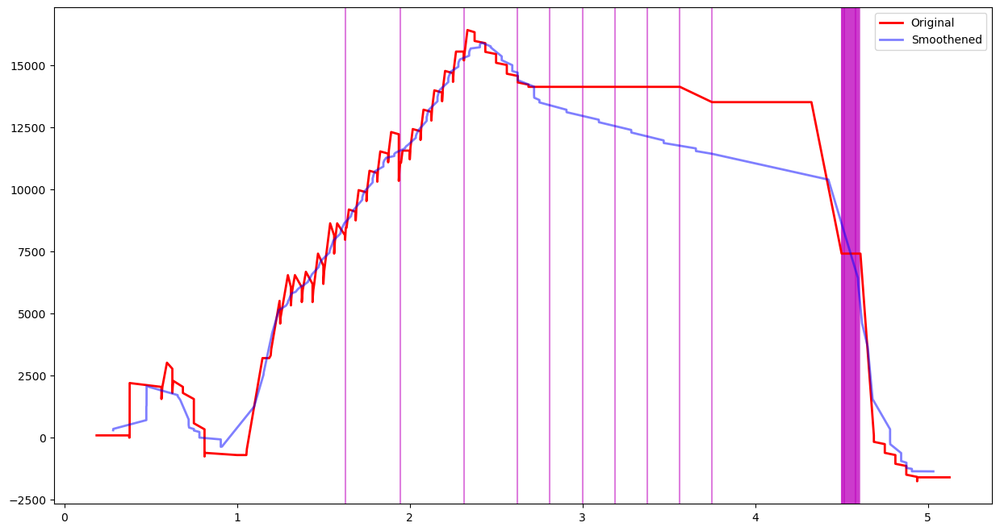

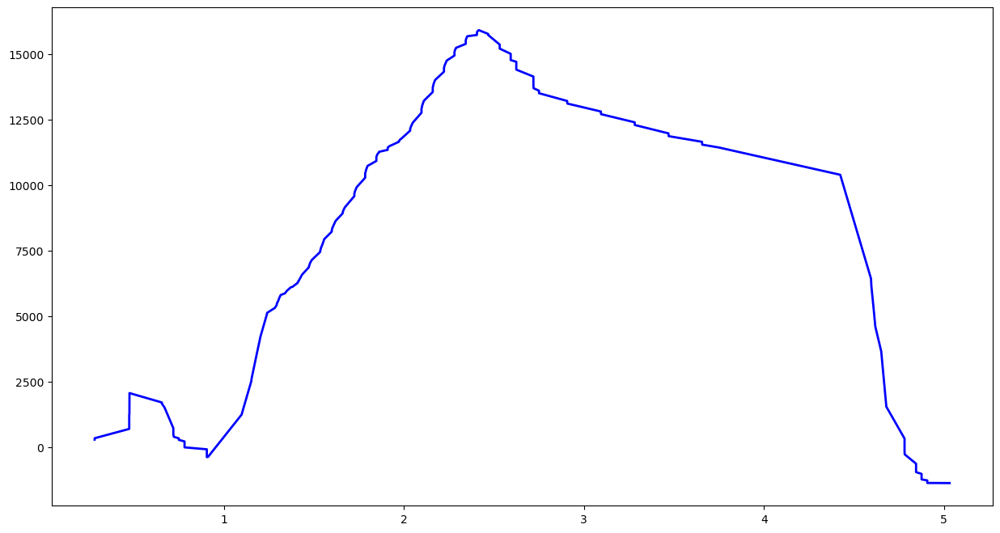

No Feature
../../singapore/top1k/google.co.jp-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.jp-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34886', '59366'])
Port 34886


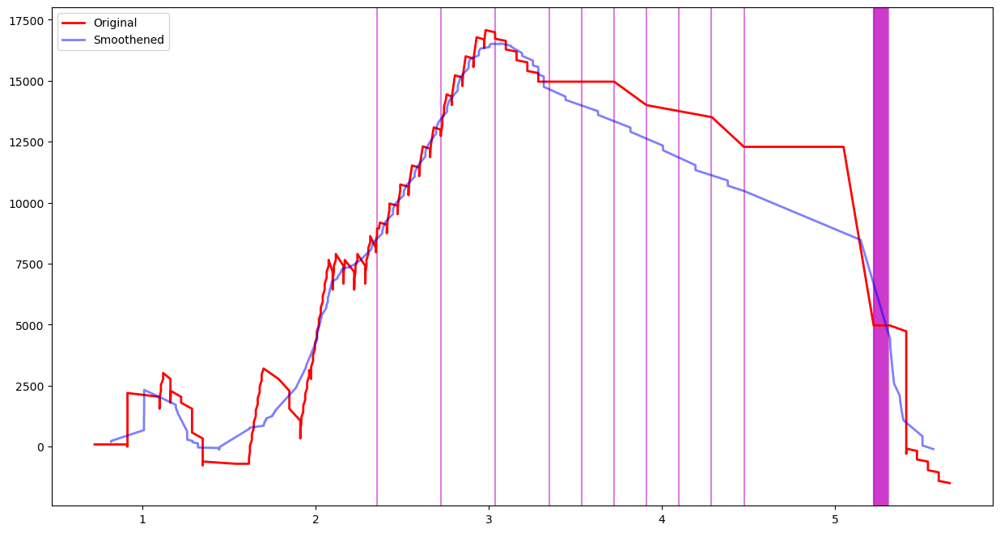

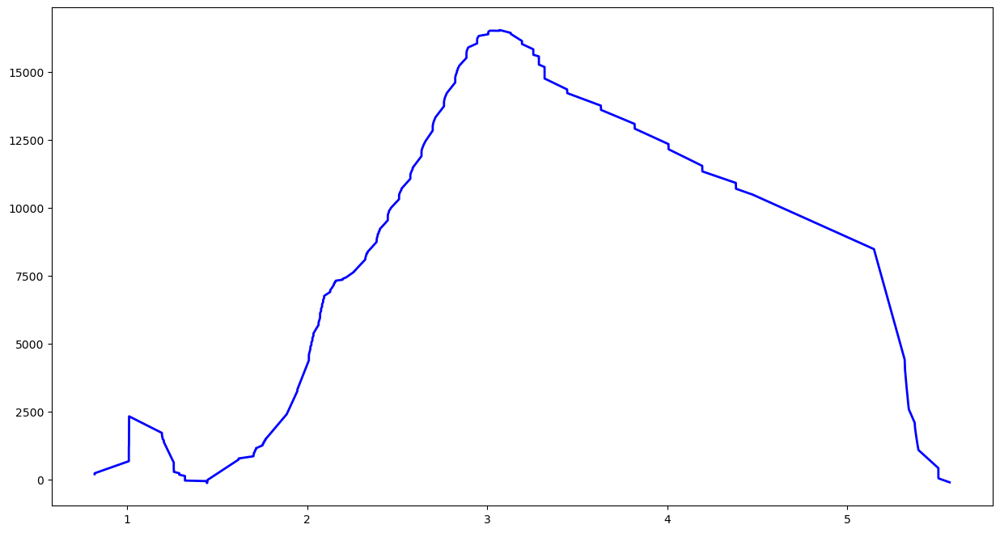

No Feature
../../singapore/top1k/people.com.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/people.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42828', '60962', '46772', '38622', '35626', '38340', '41784', '44642', '41270', '44456', '60426', '51072', '49086', '53328', '49072', '54534', '34680', '53614', '55354', '54346'])
Port 42828


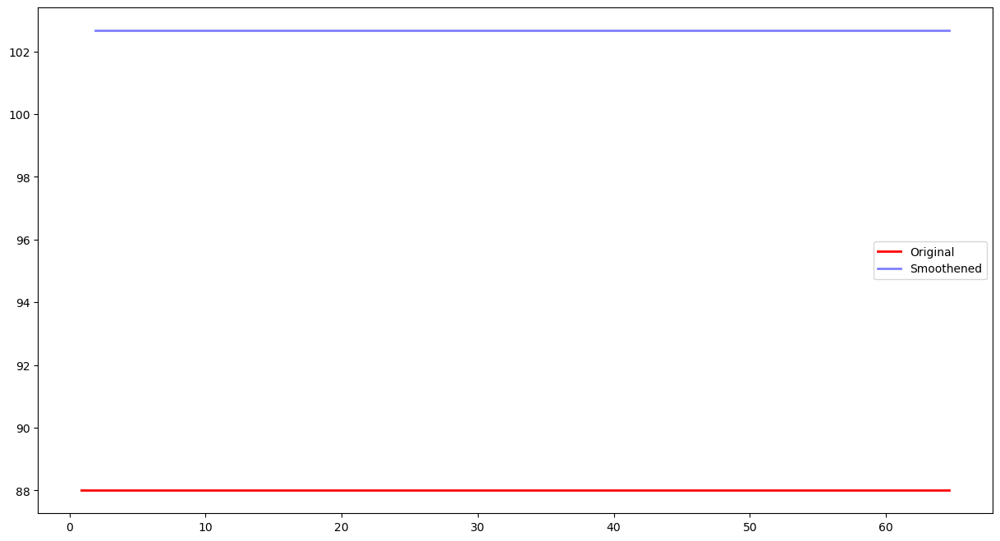

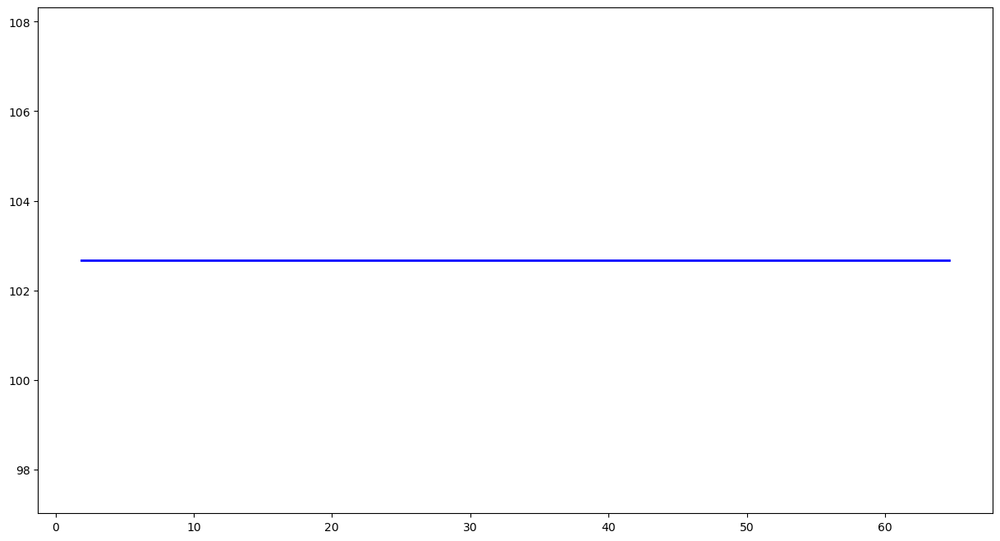

No Feature
../../singapore/top1k/liputan6.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/liputan6.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['41296'])
Port 41296


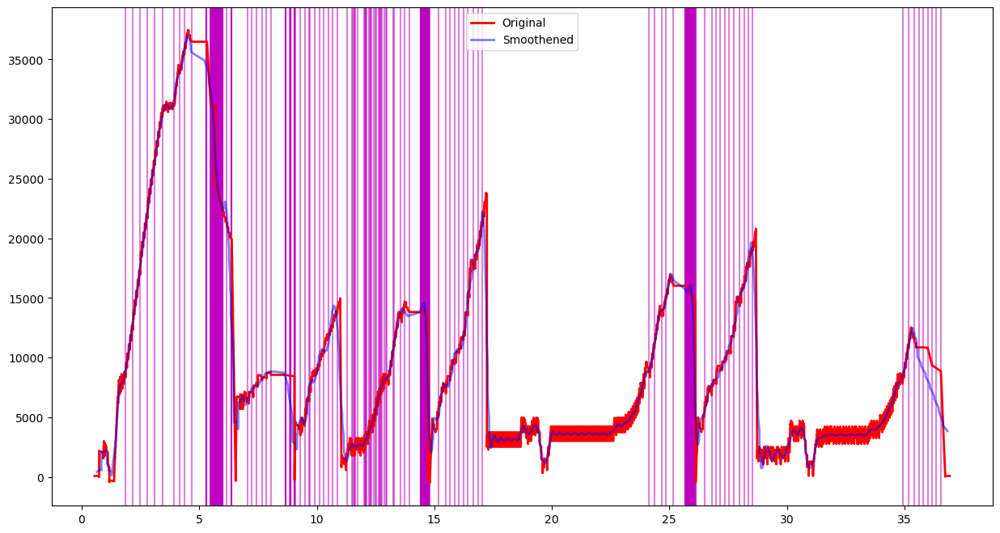

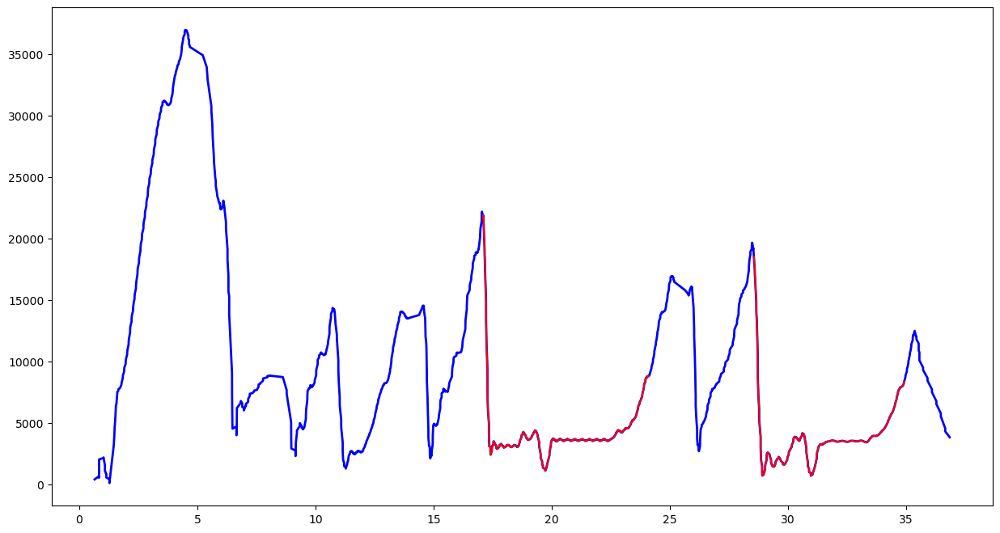

Feature Length  203


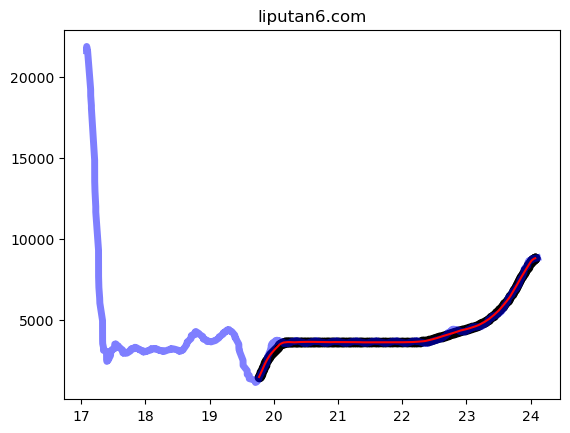

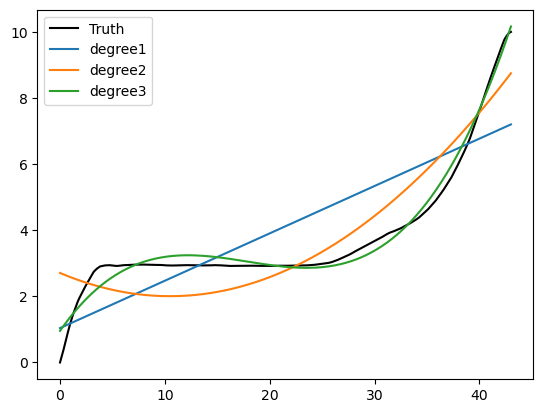

[ 5.56845003e-04 -3.05684078e-02  5.02022978e-01  8.13849796e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.36190337e-30 1.05007808e-60 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 7.71037138e-31 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/vice.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/vice.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['58146', '58158'])
Port 58158


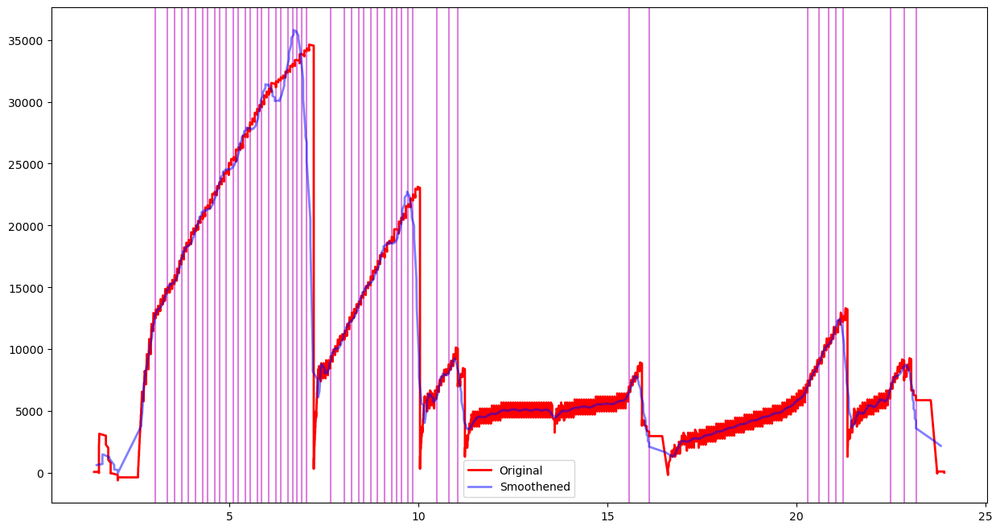

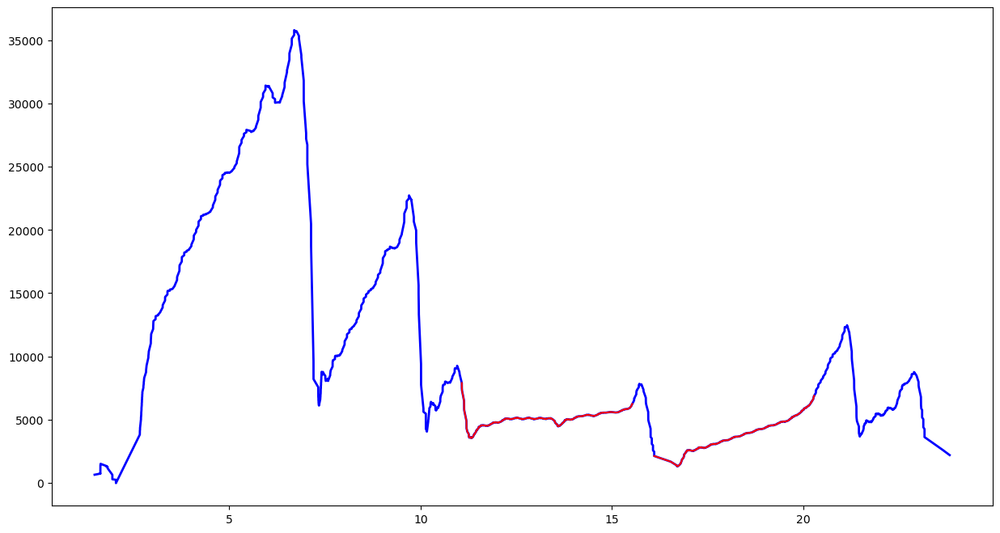

Feature Length  203


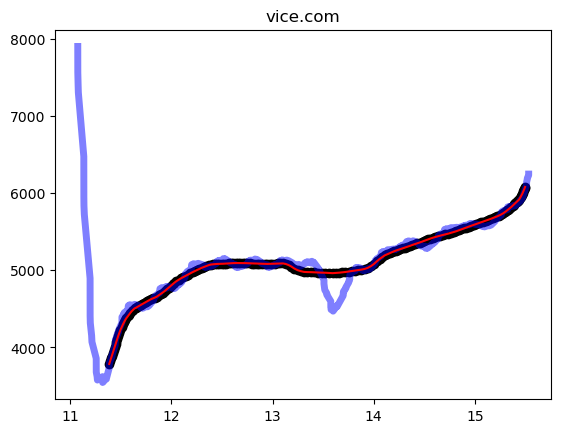

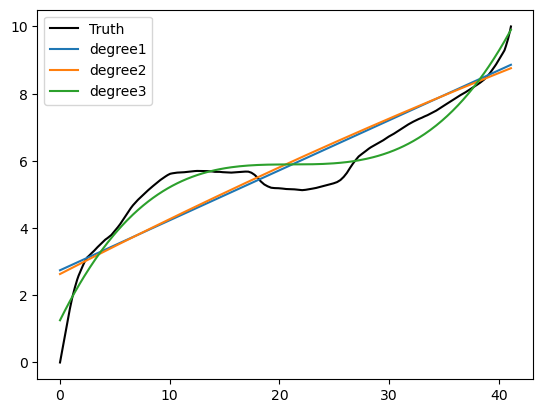

[ 5.06523154e-04 -3.21879459e-02  6.76327130e-01  1.26925530e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [4.33140183e+04 1.39659184e-51 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 3.22434143e-56 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/fbcdn.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/fbcdn.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55748'])
Port 55748


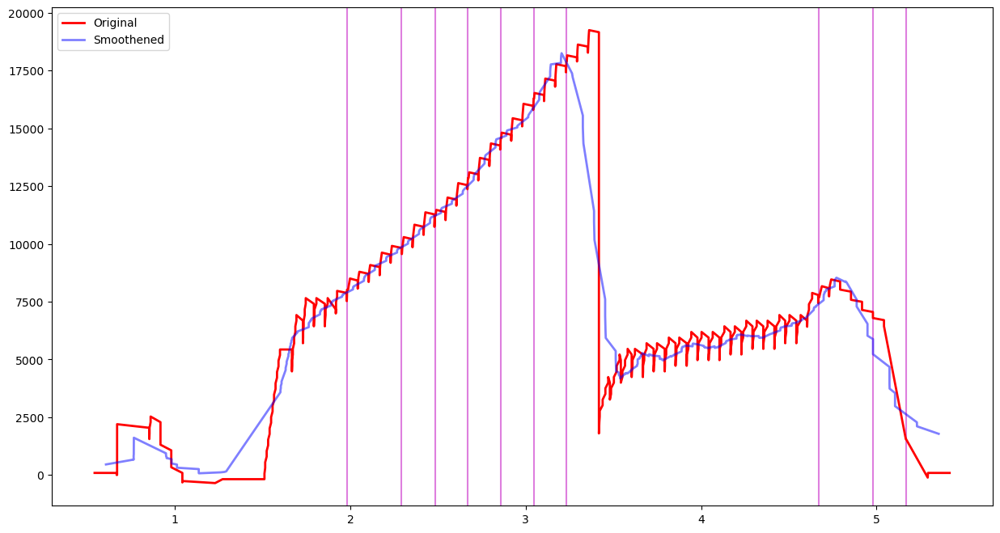

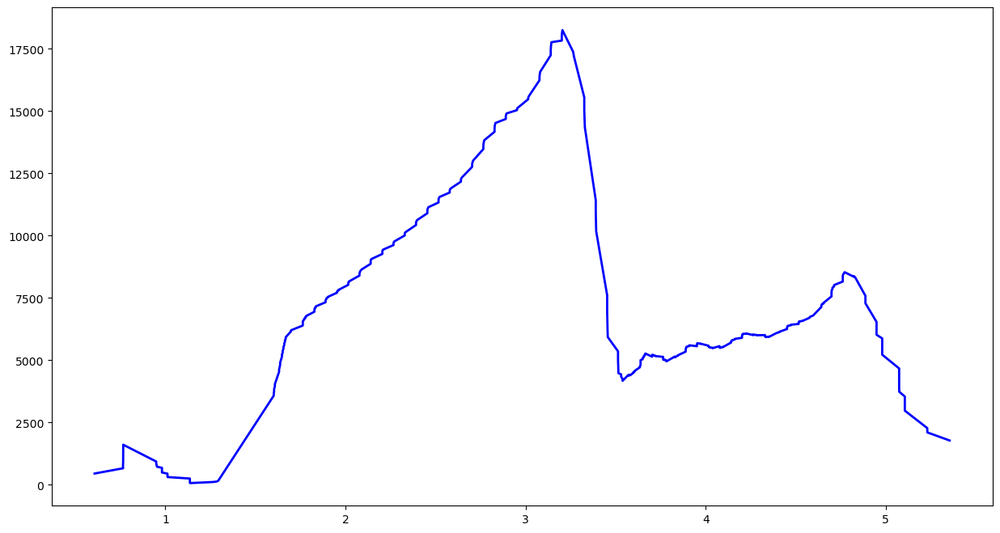

No Feature
../../singapore/top1k/detik.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/detik.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42468'])
Port 42468


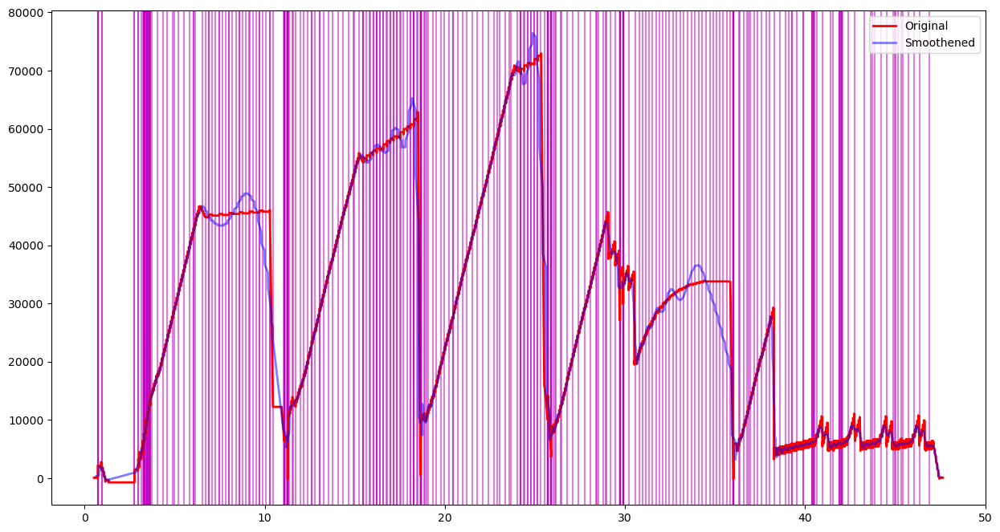

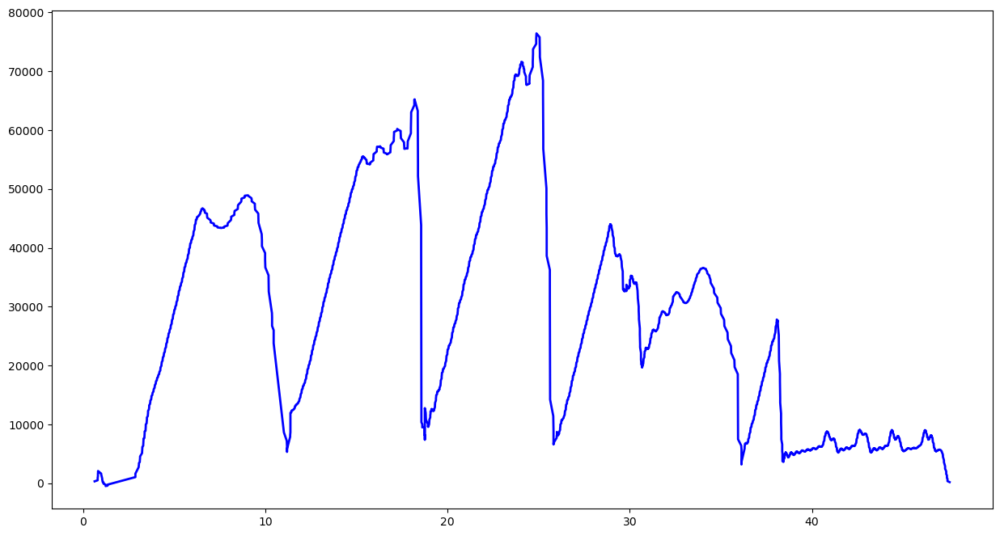

No Feature
../../singapore/top1k/softonic.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/softonic.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53630', '58054', '49358'])
Port 49358


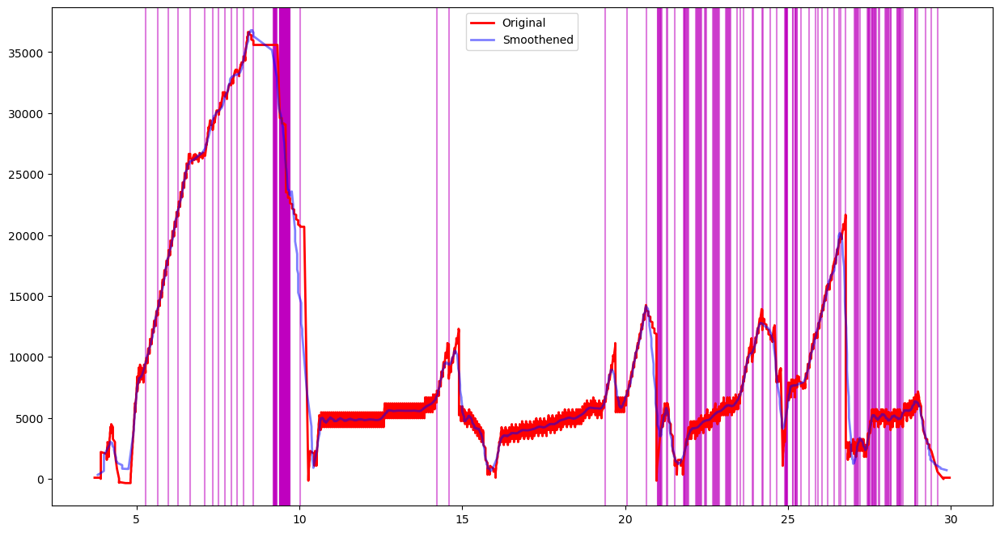

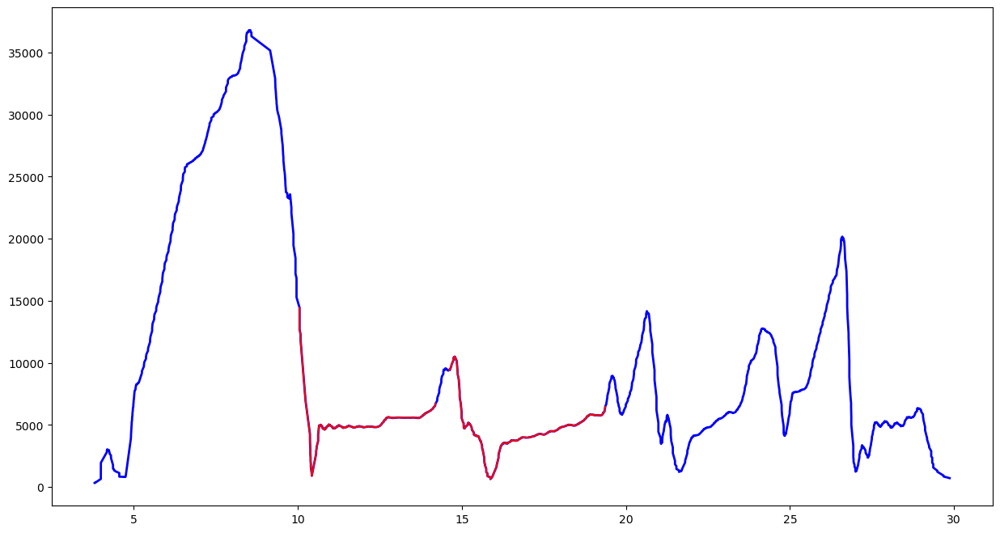

Feature Length  203


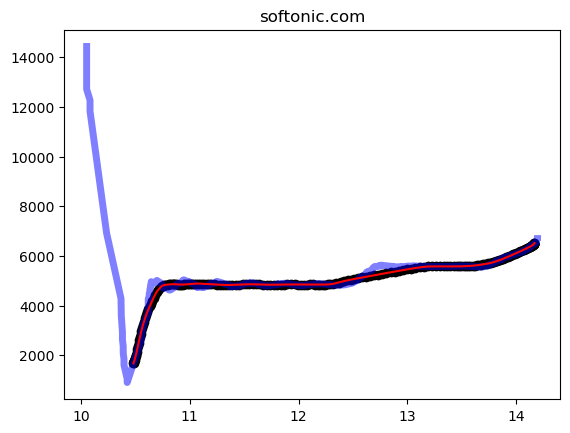

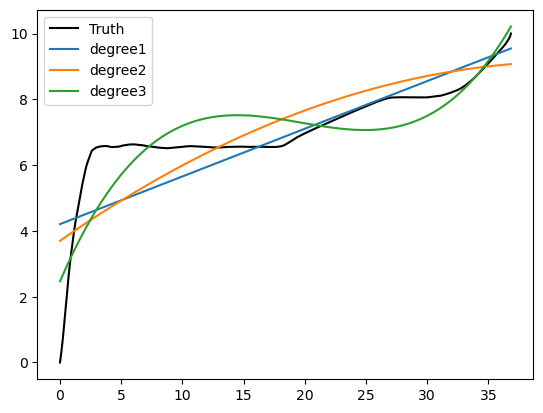

[0.13449247 4.59278104]
Top 5 CCS : ['nv', 'scalable', 'bic', 'yeah']
Density Values: [1.11701573e+00 9.58888346e-01 2.77042871e-01 3.44585601e-25]
Relative Density Values: [1.         0.85843764 0.24802056 0.        ]
Prediction: confused
../../singapore/top1k/forbes.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/forbes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38084'])
Port 38084


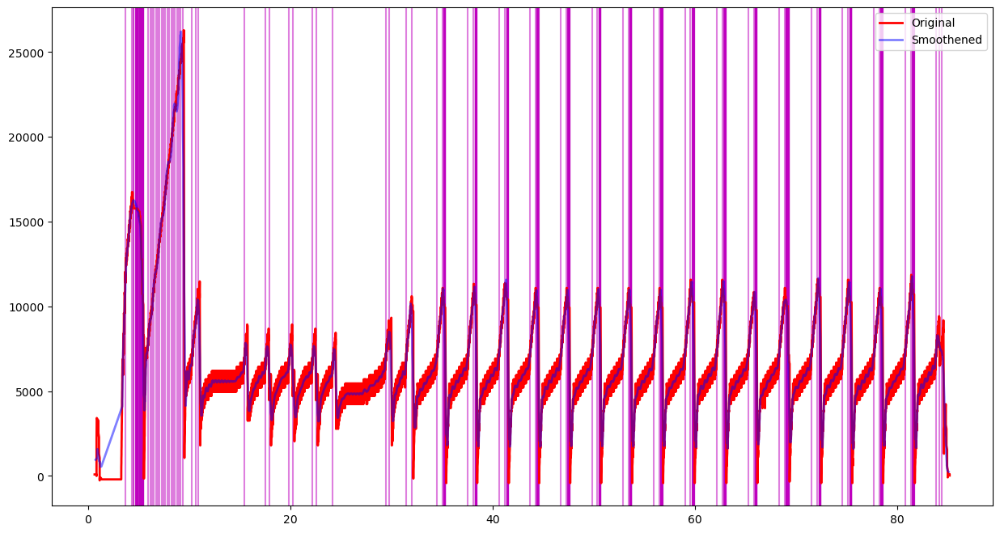

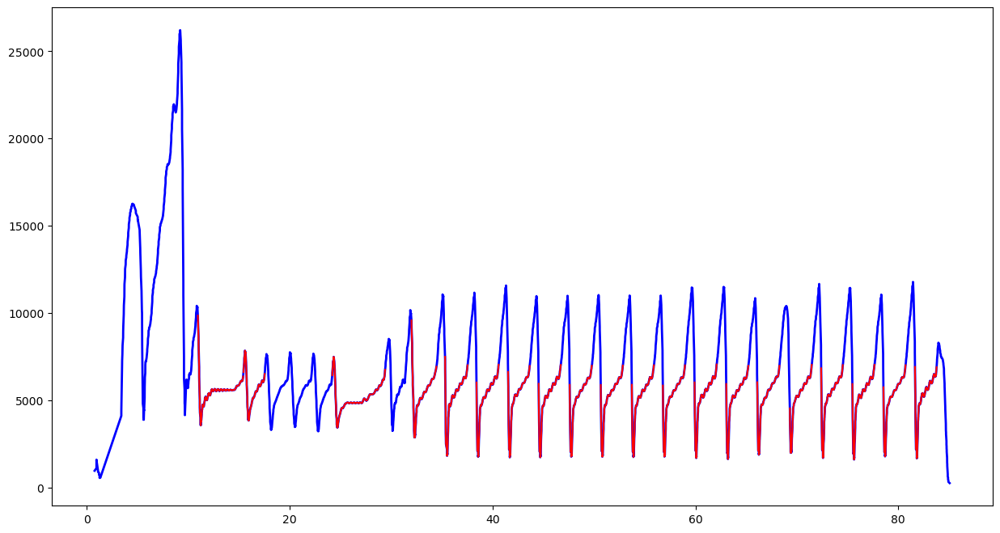

Feature Length  203


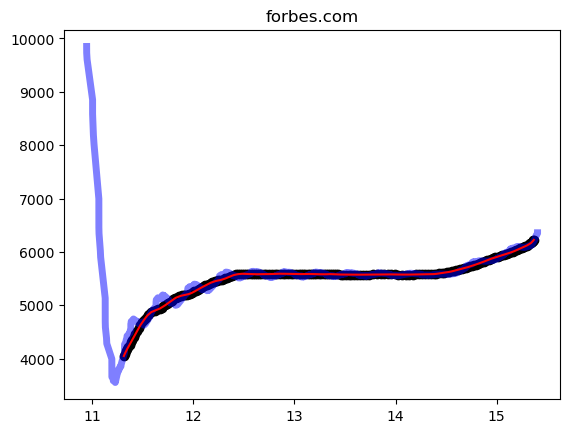

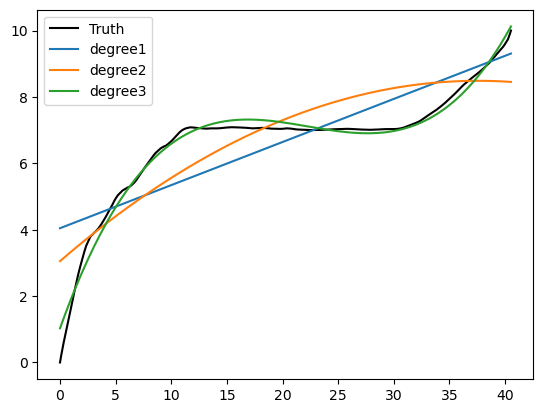

[ 6.45187091e-04 -4.38903528e-02  9.38006424e-01  1.22255638e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [2.08885913e-15 1.61073195e-88 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 7.71106069e-74 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/livejournal.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/livejournal.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39282'])
Port 39282


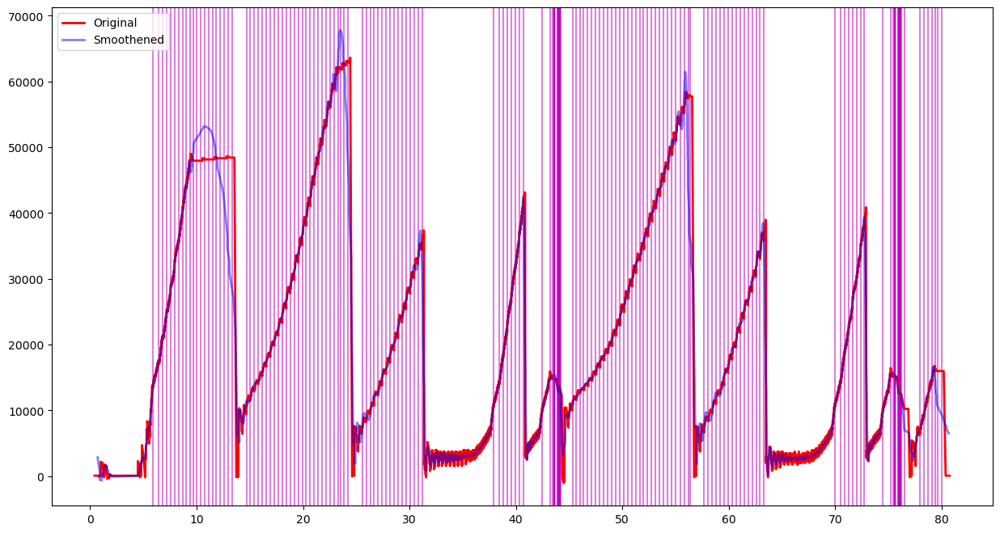

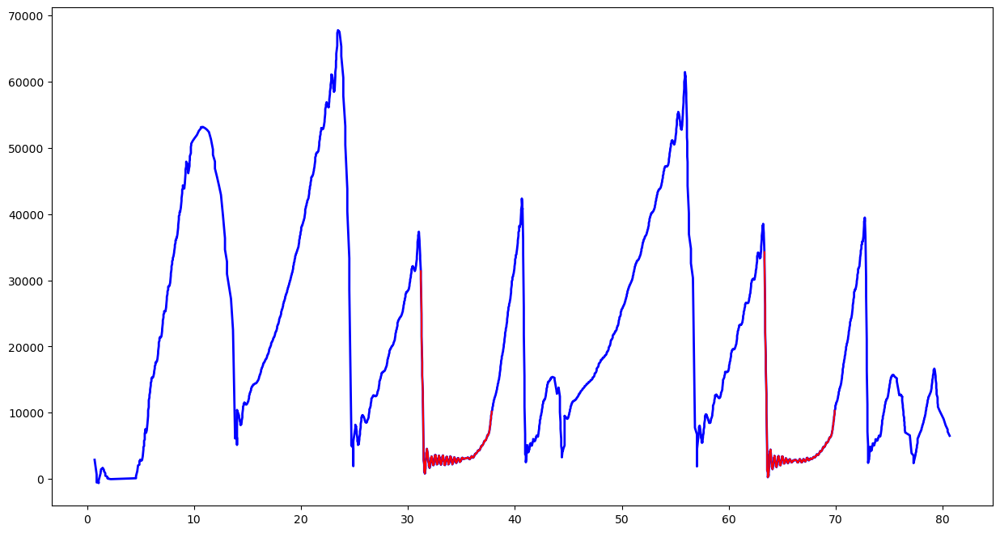

Feature Length  203


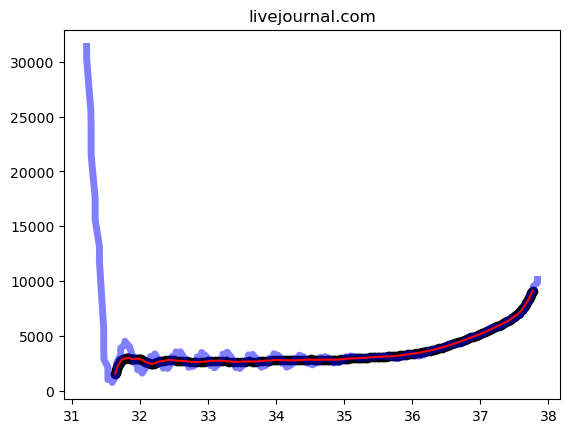

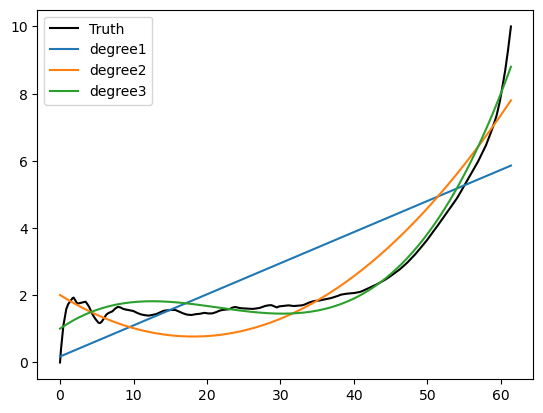

[ 1.31222327e-04 -7.13643340e-03  8.55151232e-02  5.39662337e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [2.01787026e-16 8.30929480e-95 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 4.11785384e-79 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/twitter.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/twitter.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42996'])
Port 42996


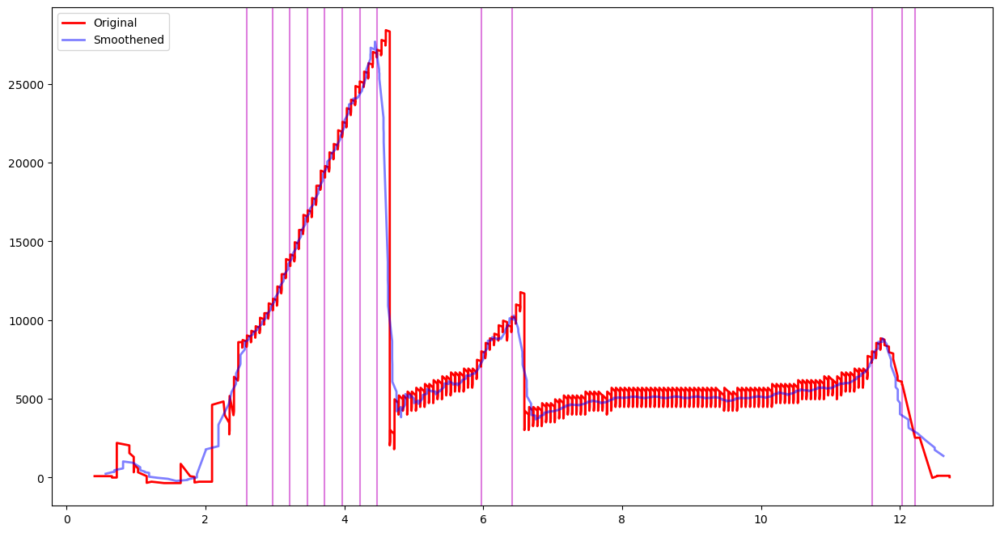

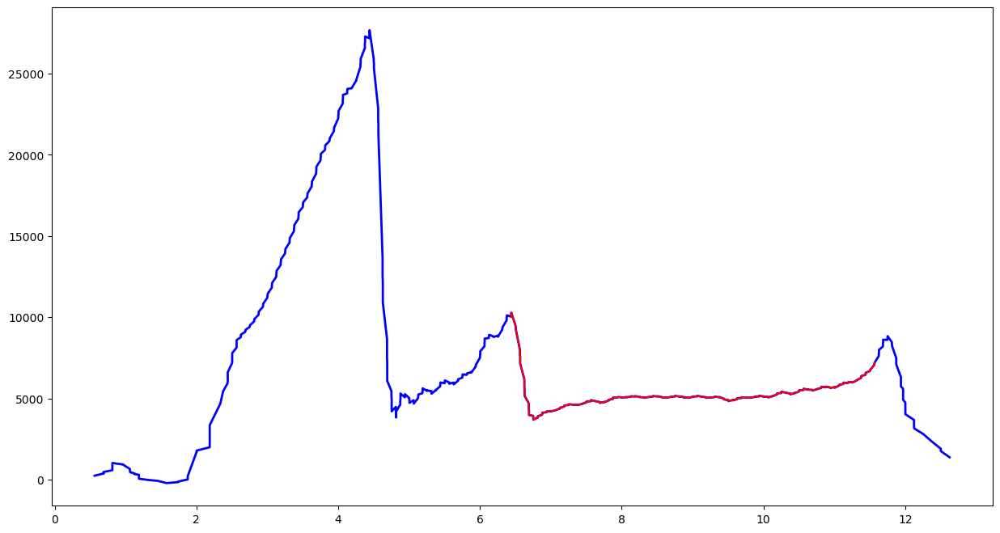

Feature Length  203


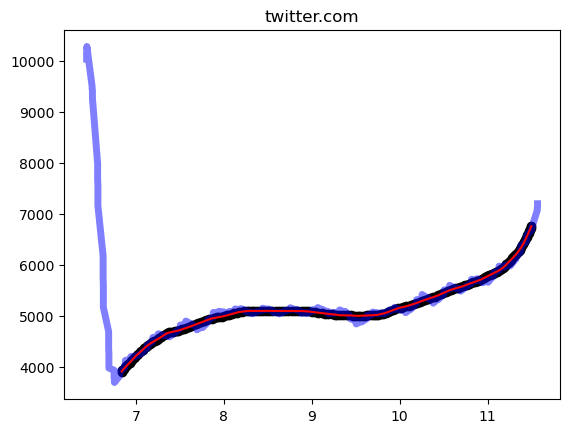

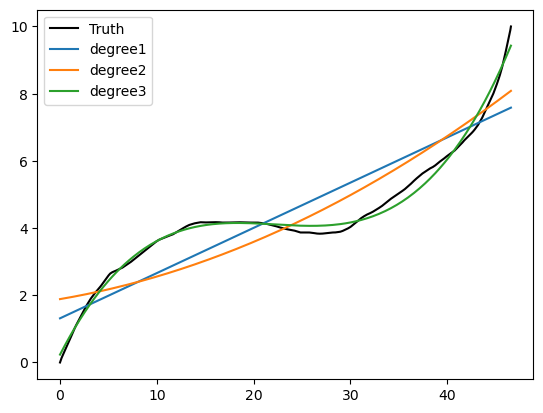

[ 3.85717290e-04 -2.62436288e-02  5.78755649e-01  2.35428095e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.86029554e+03 2.20492346e-45 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.18525439e-48 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/wordpress.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/wordpress.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35364', '42434', '60154', '40696', '36298', '55822', '43884', '48552', '50164', '59496', '46890', '40432', '60310', '48142', '37392', '45324', '53090', '42094', '53702', '47192', '55832', '49388', '59890', '47342', '38442', '49286', '46854', '33130', '53256', '56184', '51560', '54494', '42058', '45808', '35174', '48468', '40366', '38380', '35372', '46148'])
Port 35364


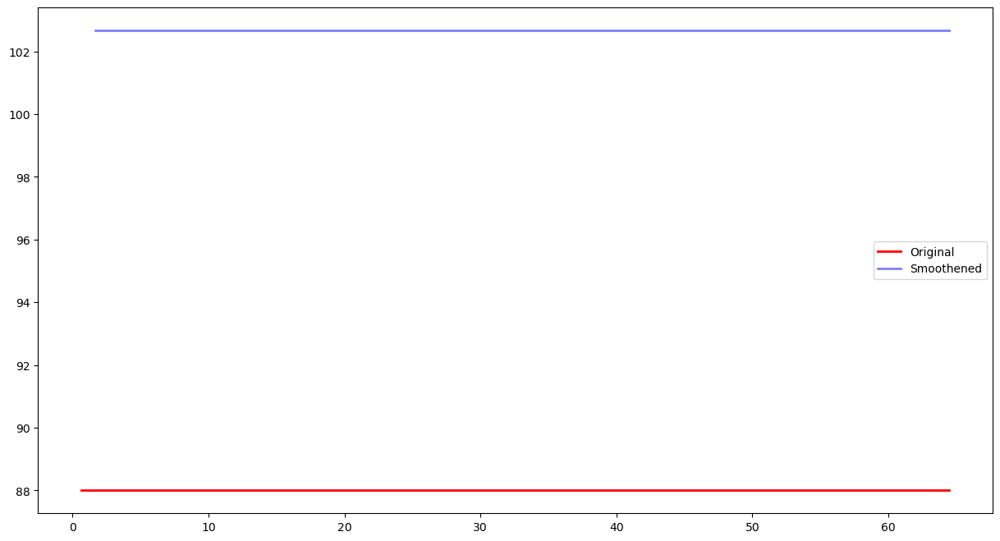

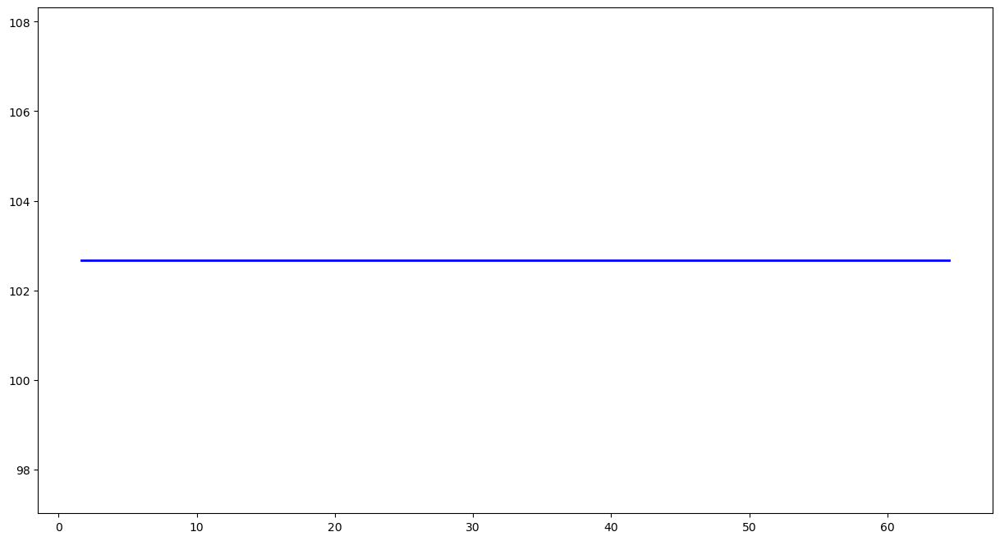

No Feature
../../singapore/top1k/hao123.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/hao123.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57474', '34086'])
Port 34086


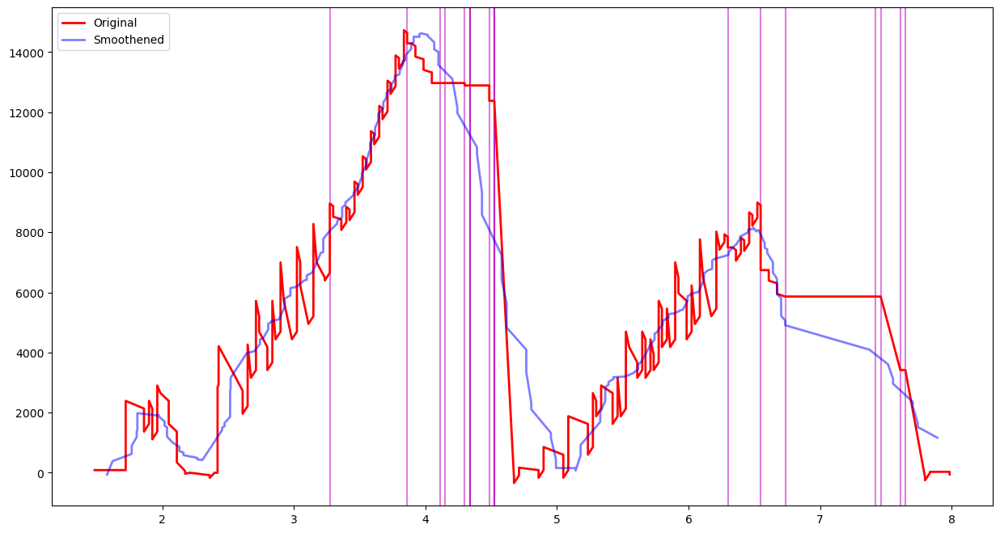

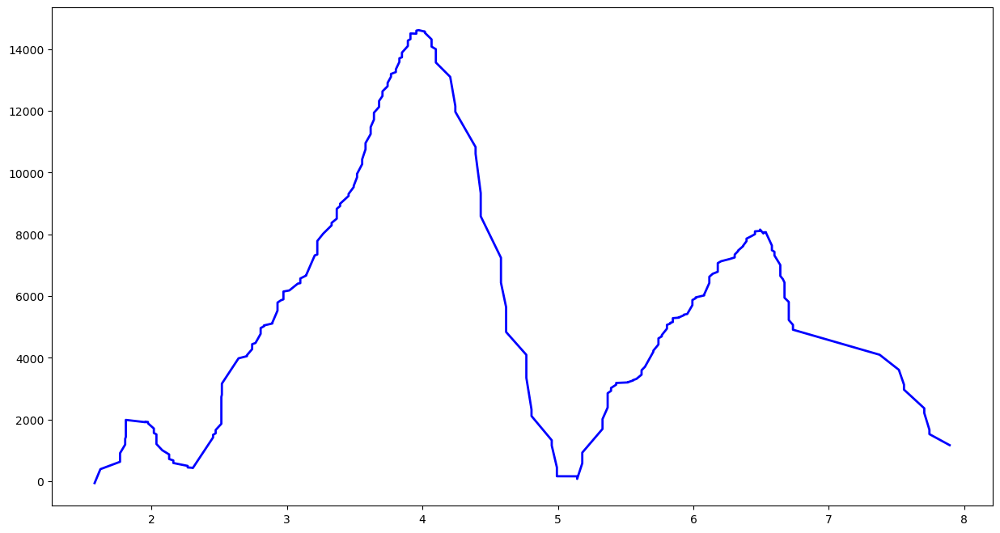

No Feature
../../singapore/top1k/google.be-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.be-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50576'])
Port 50576


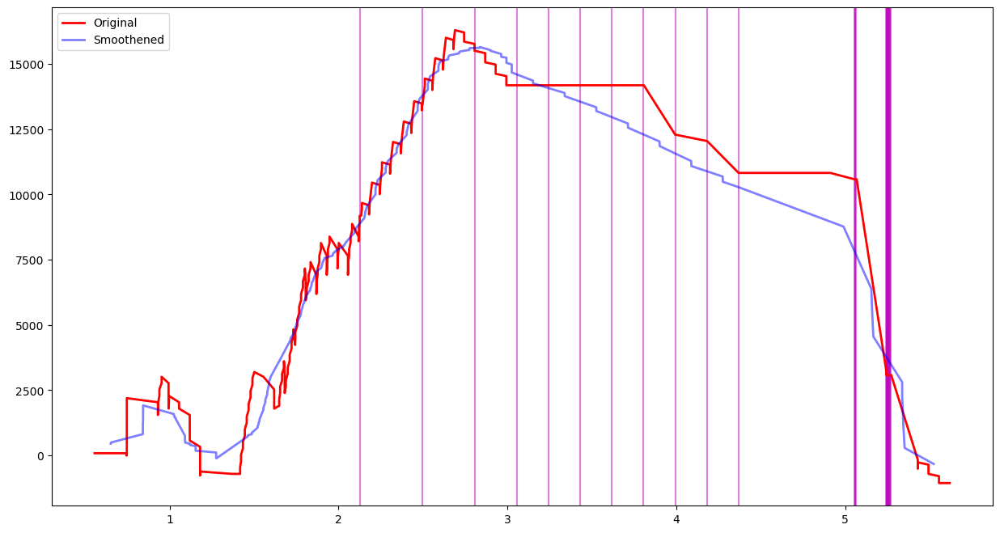

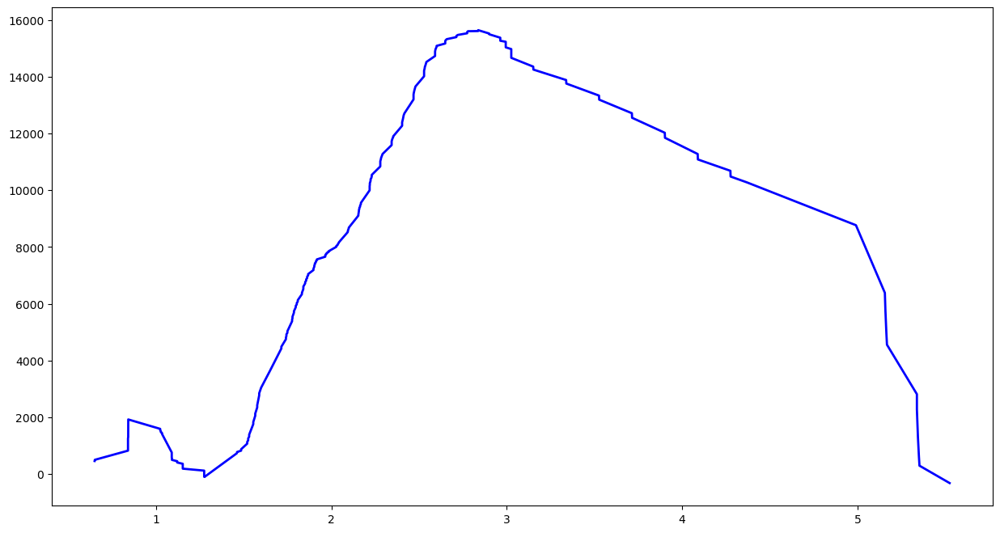

No Feature
../../singapore/top1k/google.co.ao-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.ao-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37024'])
Port 37024


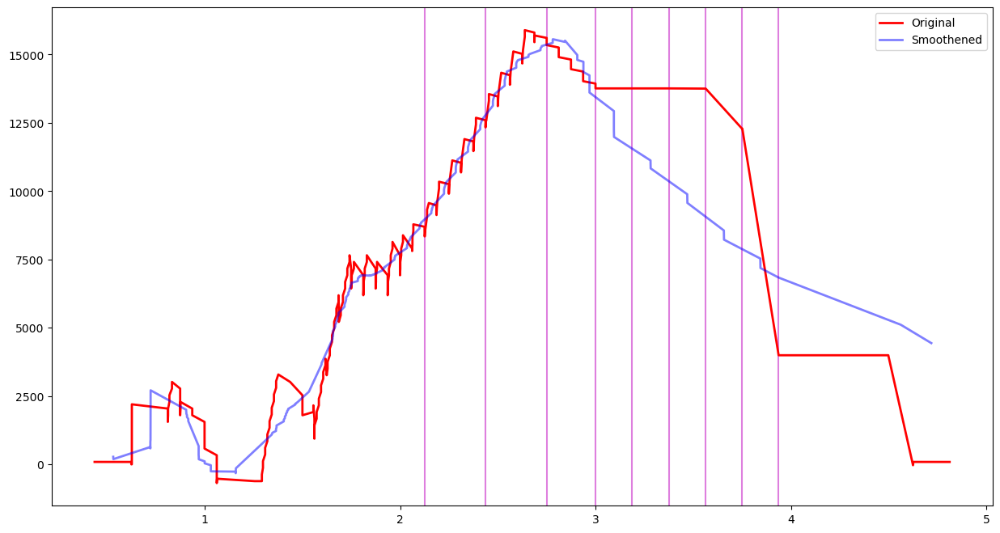

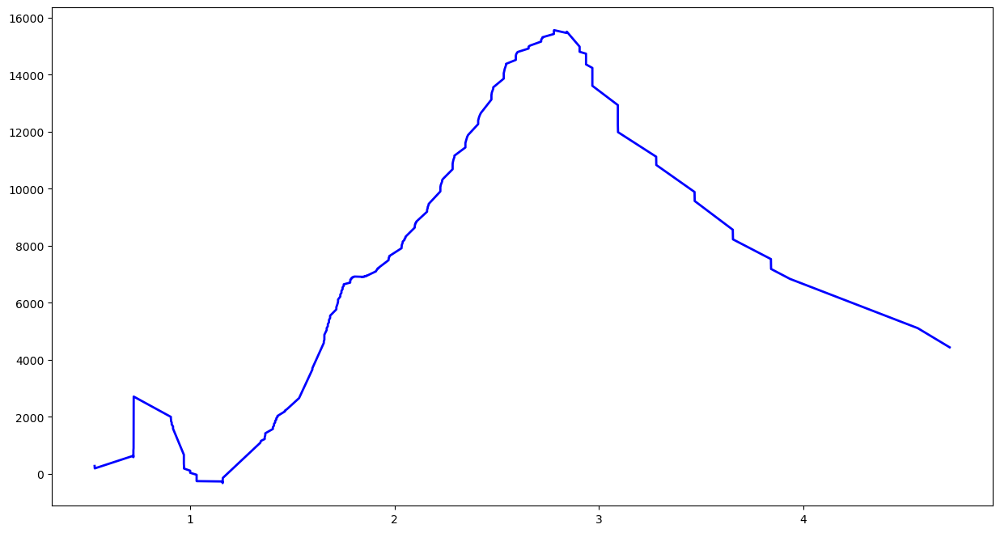

No Feature
../../singapore/top1k/blogger.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/blogger.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52258'])
Port 52258


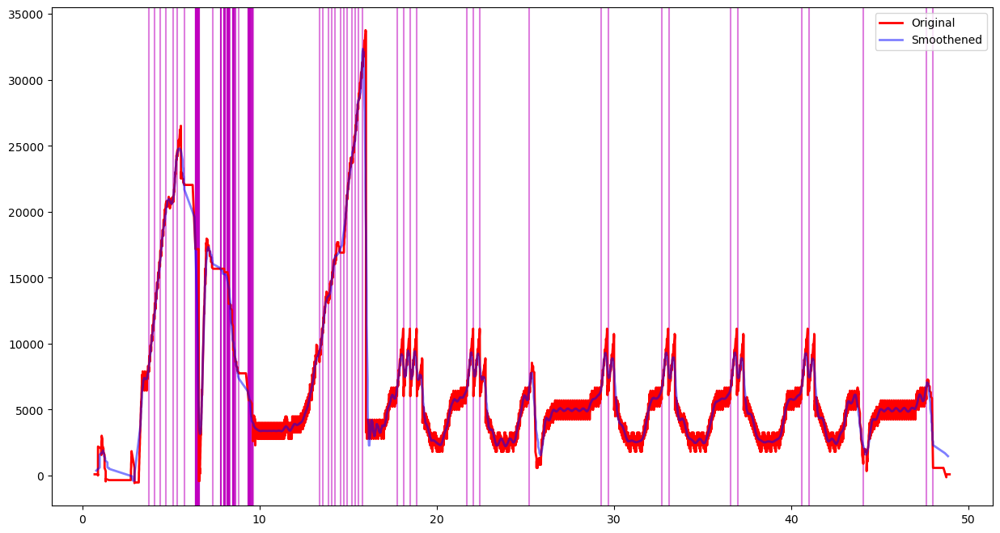

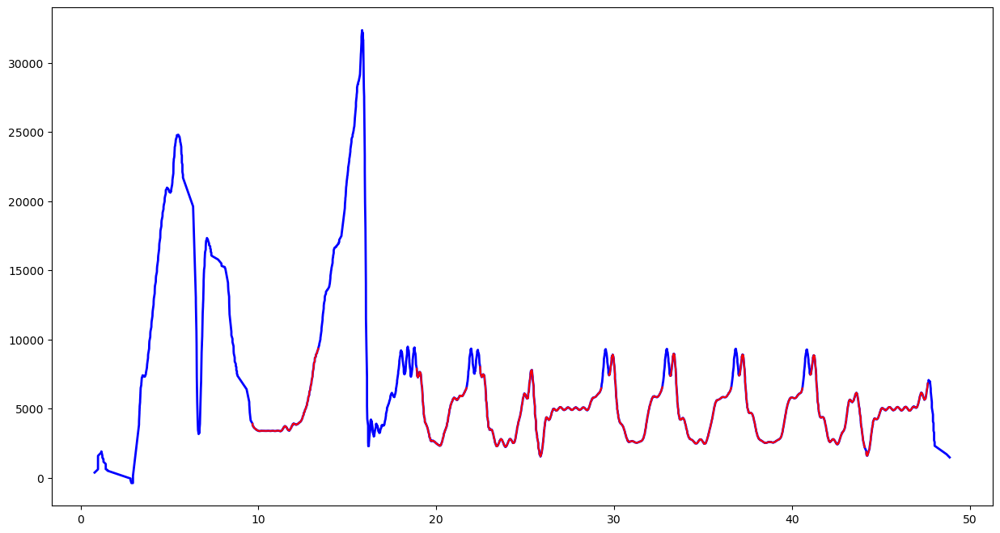

Feature Length  203


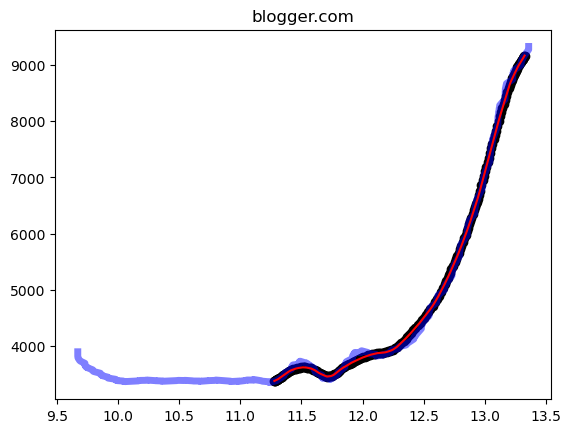

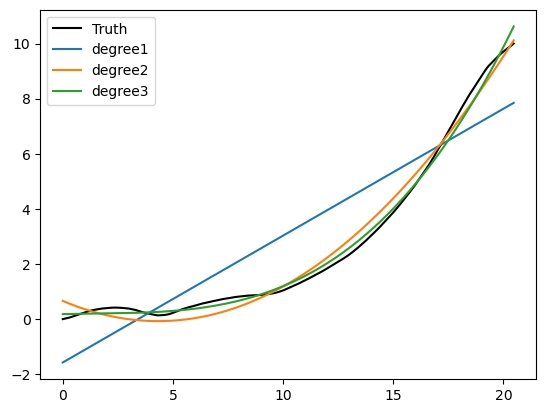

[ 0.00153082 -0.00699739  0.00565515  0.24684735]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [9.73126025e-14 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/quizlet.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/quizlet.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38238', '43246'])
Port 43246


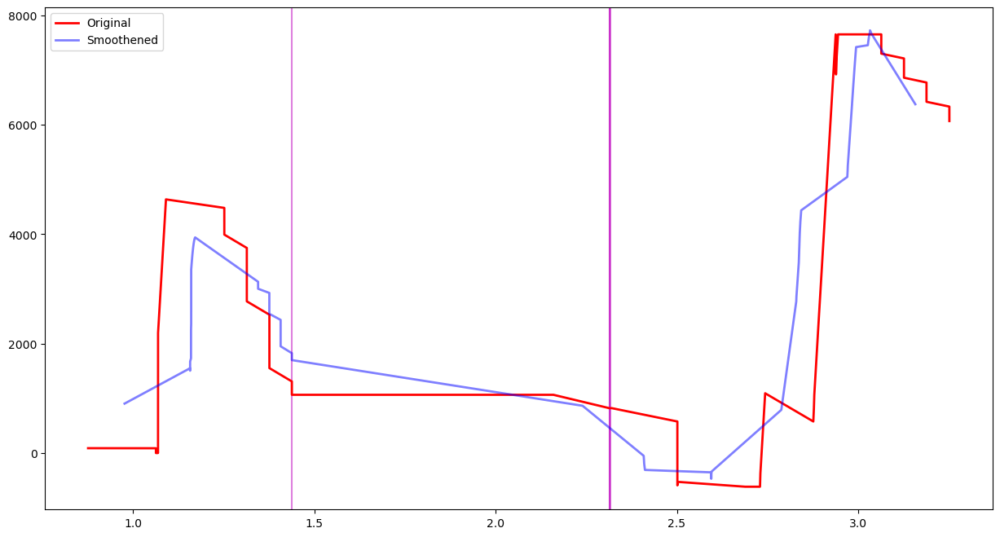

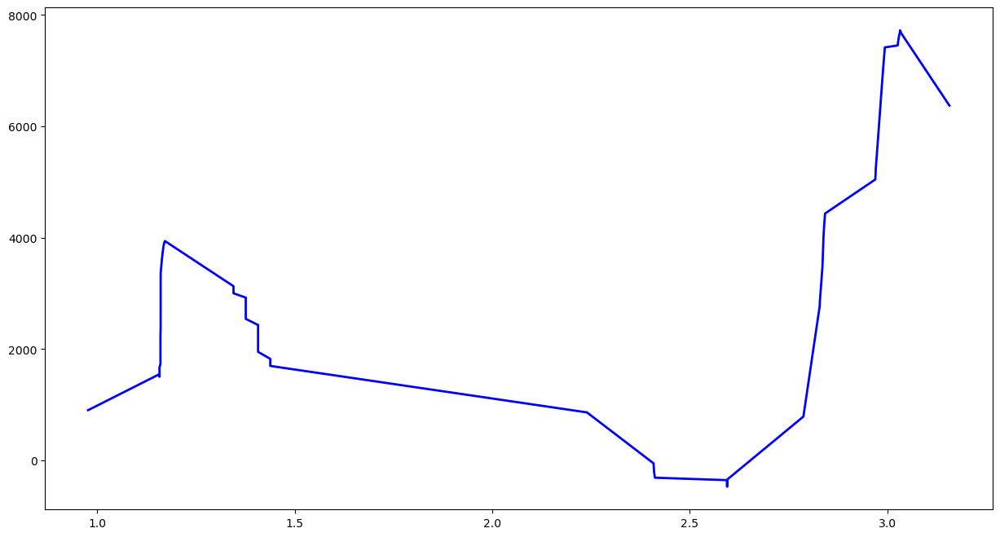

No Feature
../../singapore/top1k/redtube.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/redtube.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60416', '52062', '59868', '50682', '58180', '44576', '56668', '39882', '58500', '44322', '51674', '43876', '53528', '46282', '42560', '41268', '60282', '58600', '36832', '41530'])
Port 60416


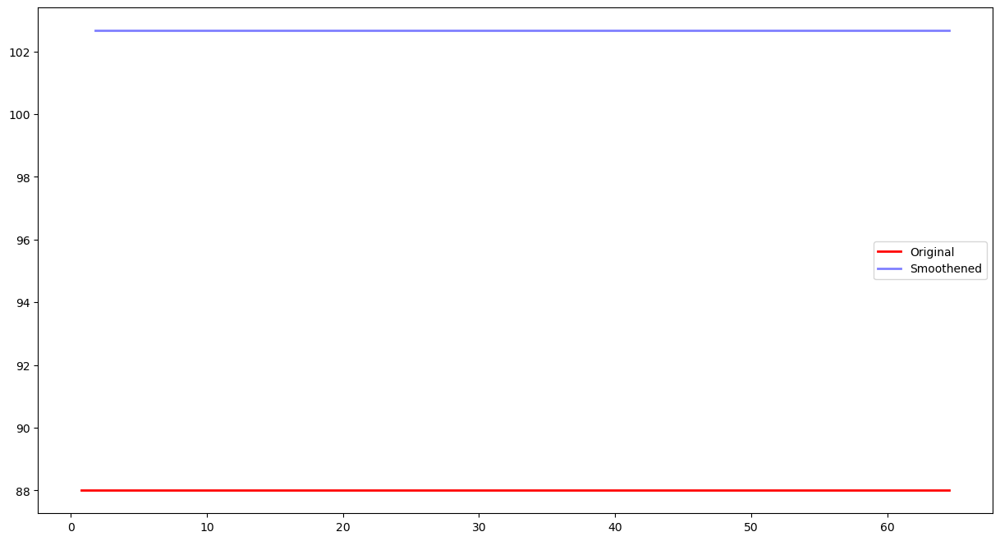

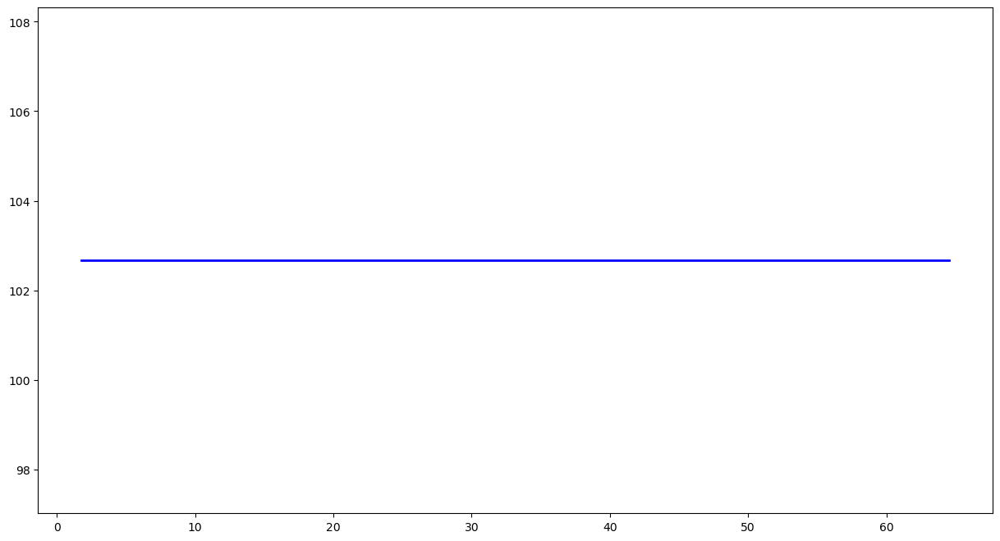

No Feature
../../singapore/top1k/aliexpress.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/aliexpress.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52502'])
Port 52502


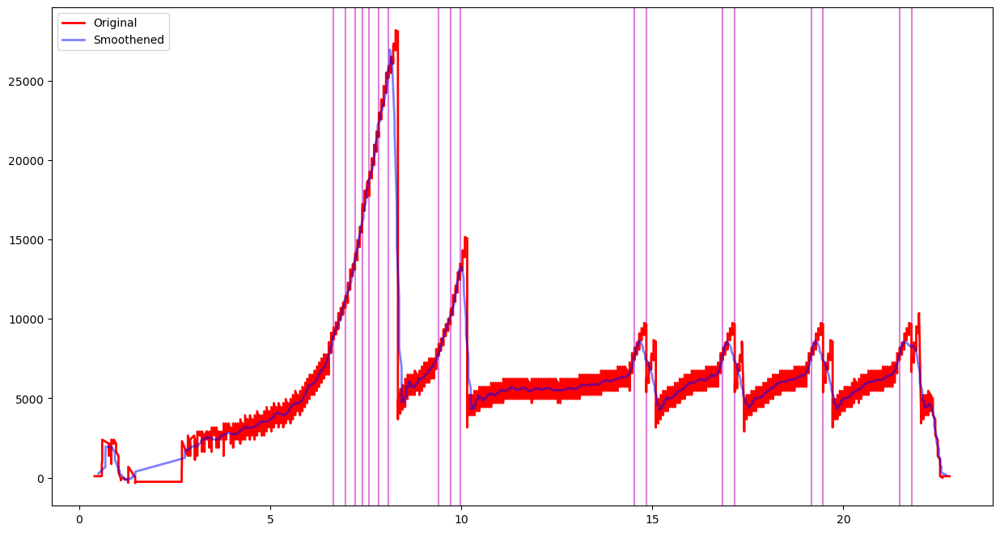

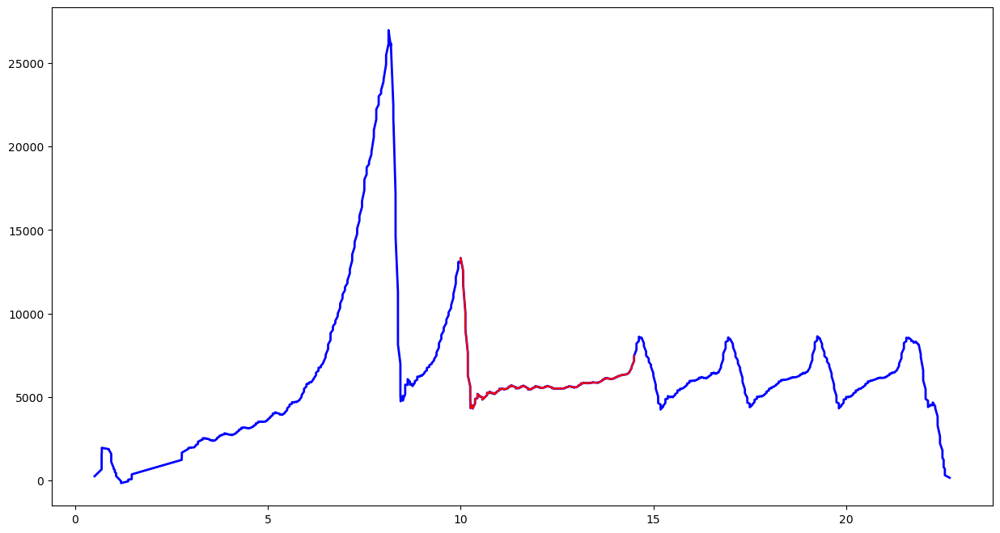

Feature Length  203


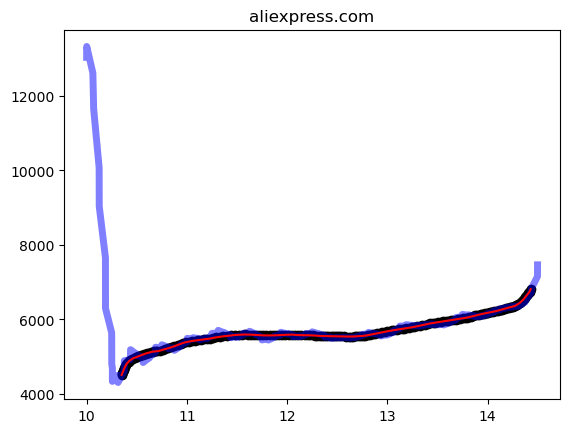

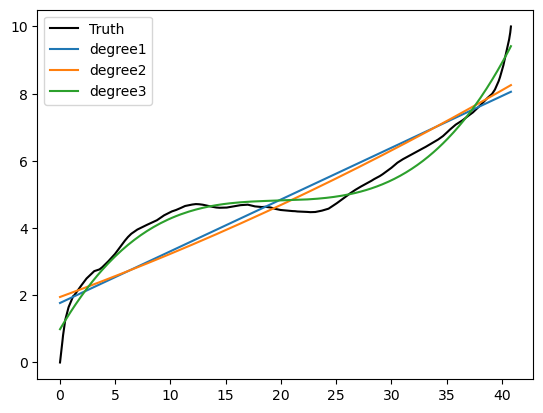

[ 4.67855645e-04 -2.73192785e-02  5.34834283e-01  8.49794304e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.45268457e+04 2.29607606e-46 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.58057441e-50 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/dkn.tv-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/dkn.tv-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40394'])
Port 40394


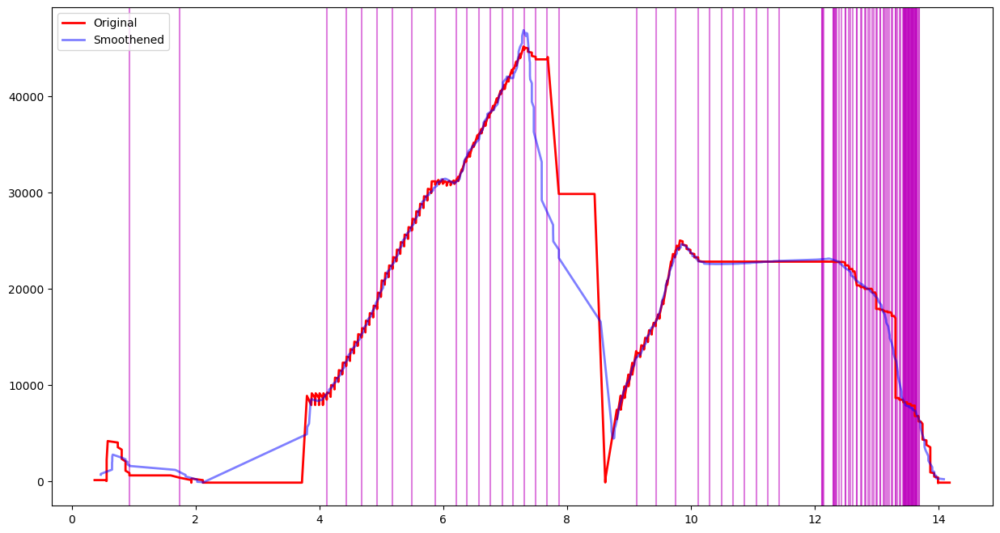

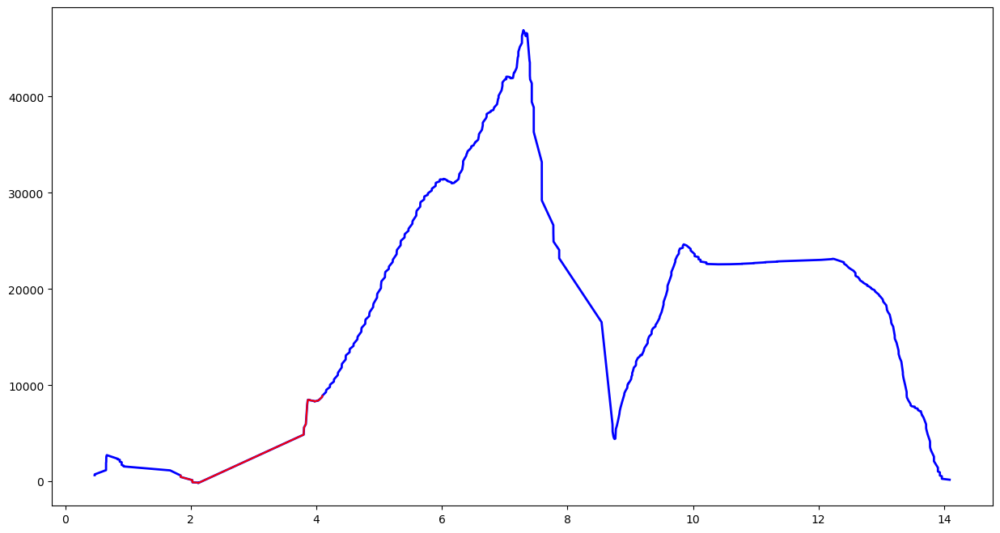

Feature Length  203


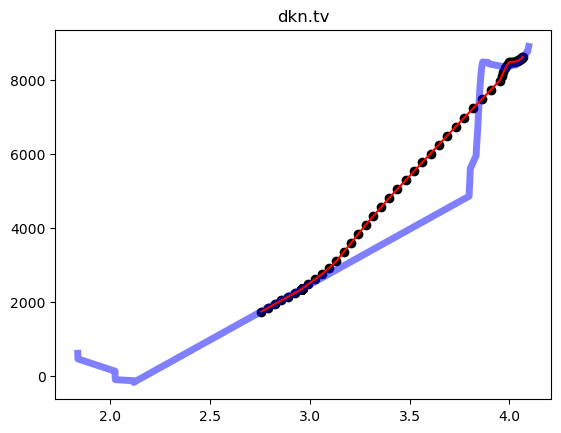

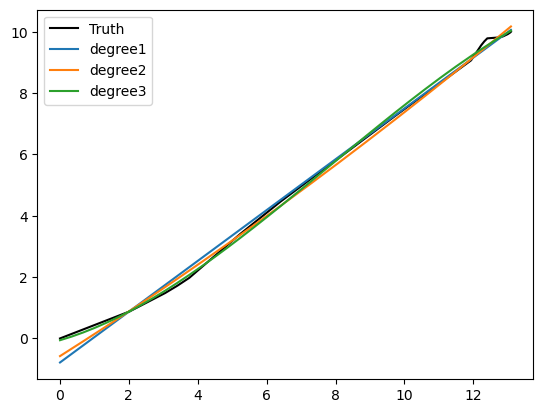

[ 0.83653798 -0.8102162 ]
Top 5 CCS : ['scalable', 'nv', 'yeah', 'bic']
Density Values: [3.90992309e-01 1.90676685e-01 3.15798968e-91 0.00000000e+00]
Relative Density Values: [1.00000000e+00 4.87673748e-01 8.07685884e-91 0.00000000e+00]
Prediction: confused
../../singapore/top1k/steamcommunity.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/steamcommunity.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45806'])
Port 45806


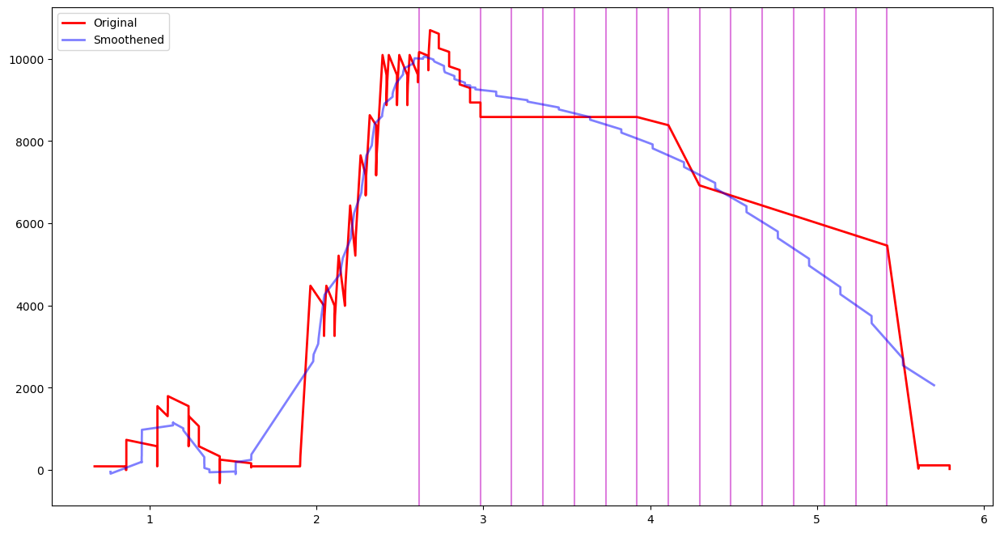

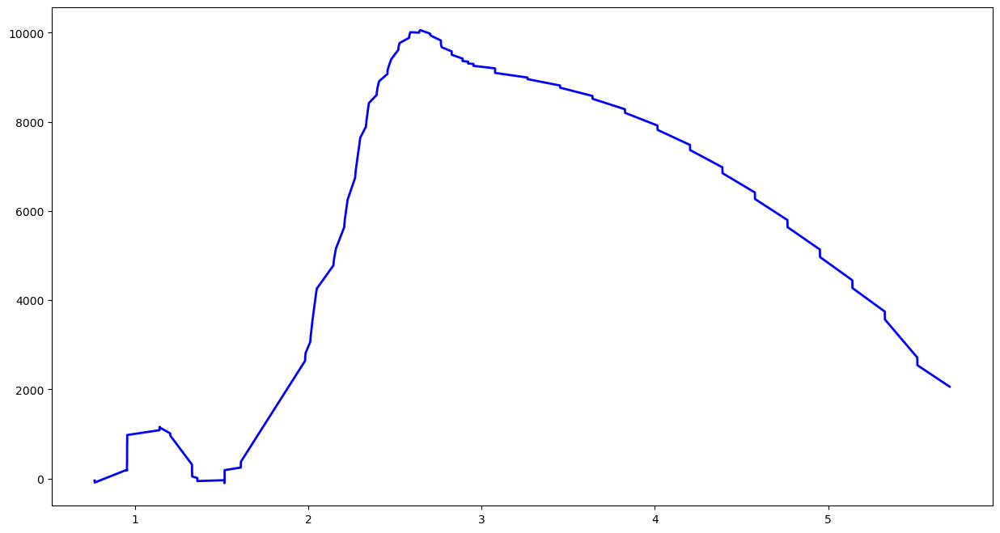

No Feature
../../singapore/top1k/cnet.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/cnet.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49038'])
Port 49038


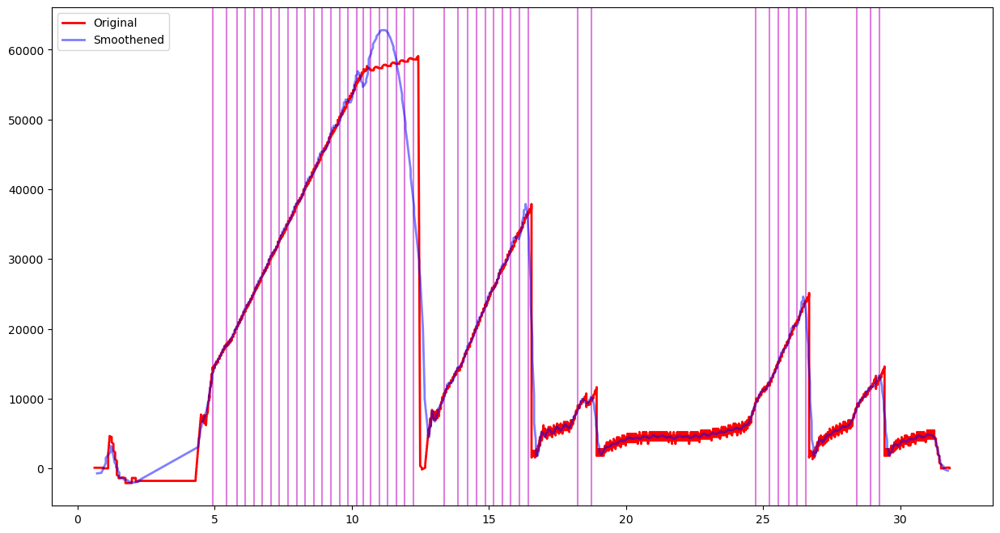

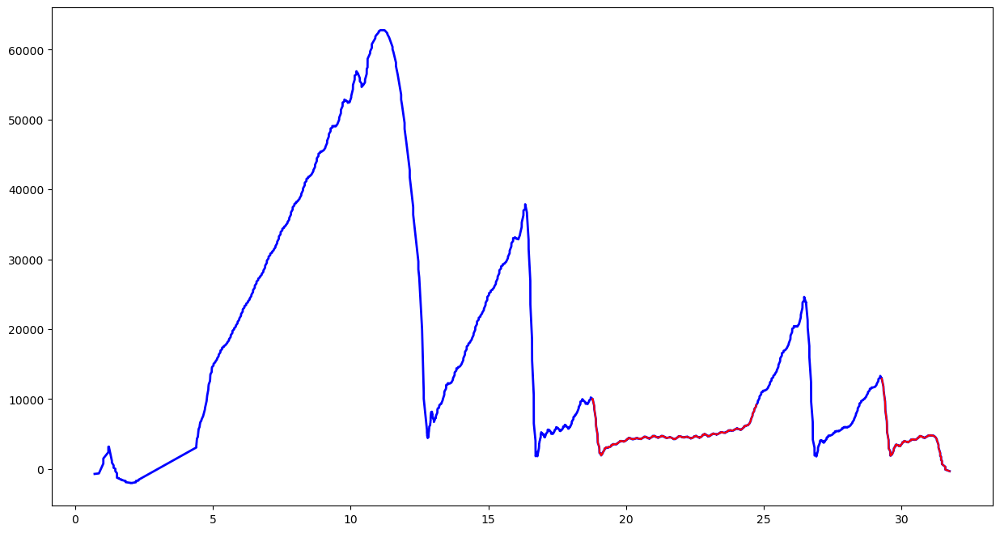

Feature Length  203


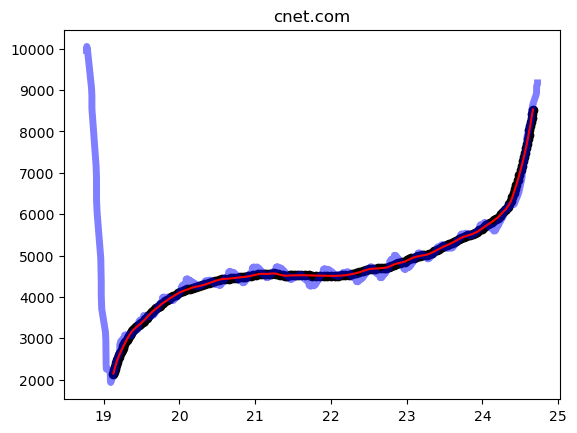

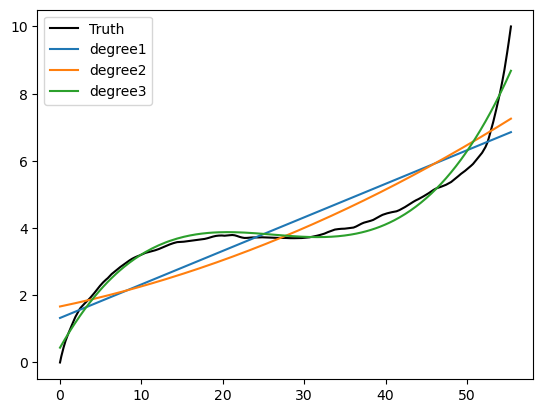

[ 2.27874053e-04 -1.79970193e-02  4.52527964e-01  3.79709449e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [6.66698358e-03 6.30822085e-39 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 9.46188148e-37 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/pages.tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/pages.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54666'])
Port 54666


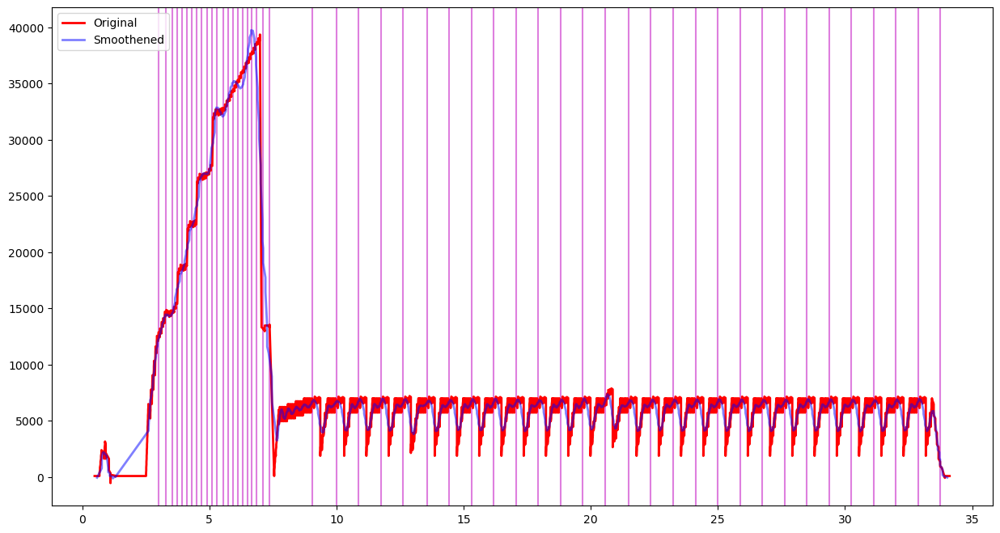

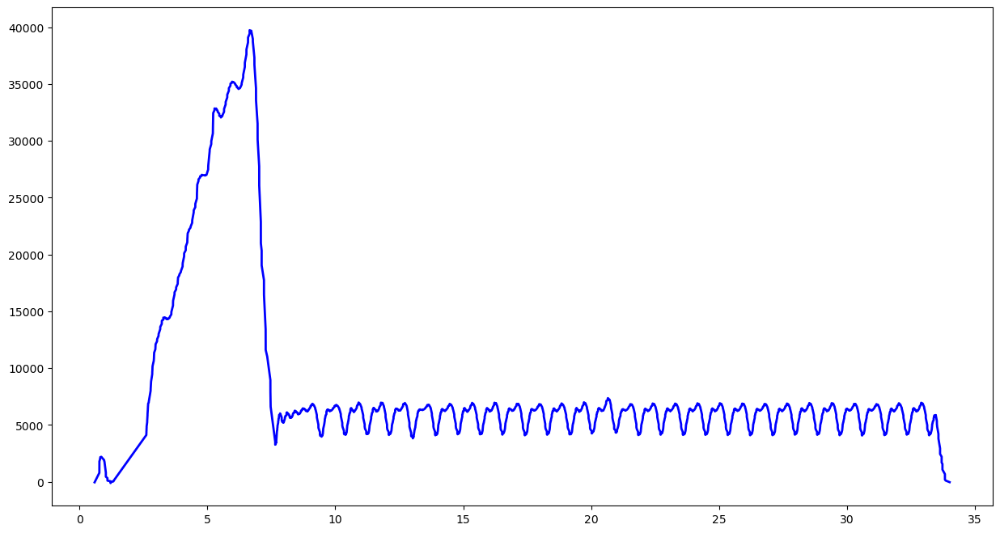

No Feature
../../singapore/top1k/yts.am-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yts.am-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44272', '43522'])
Port 43522


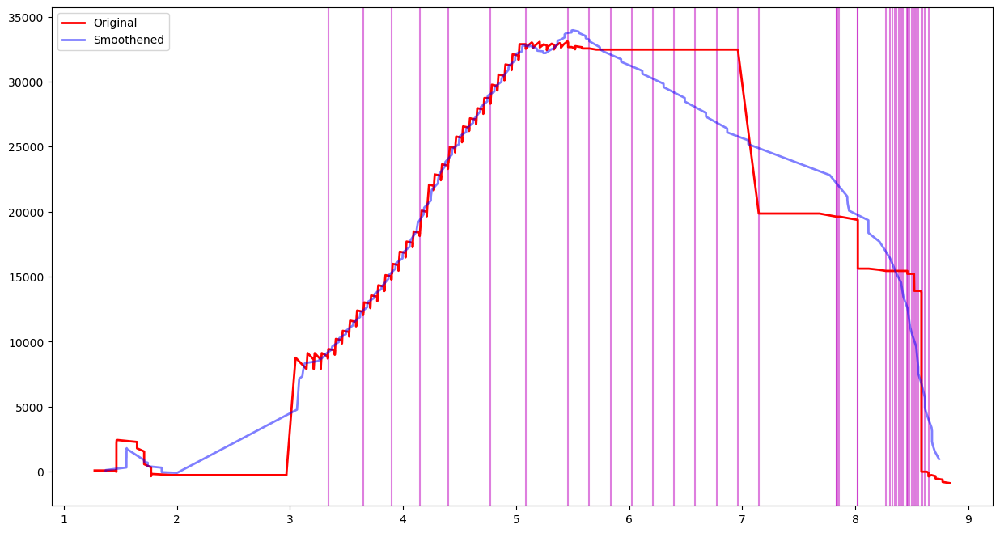

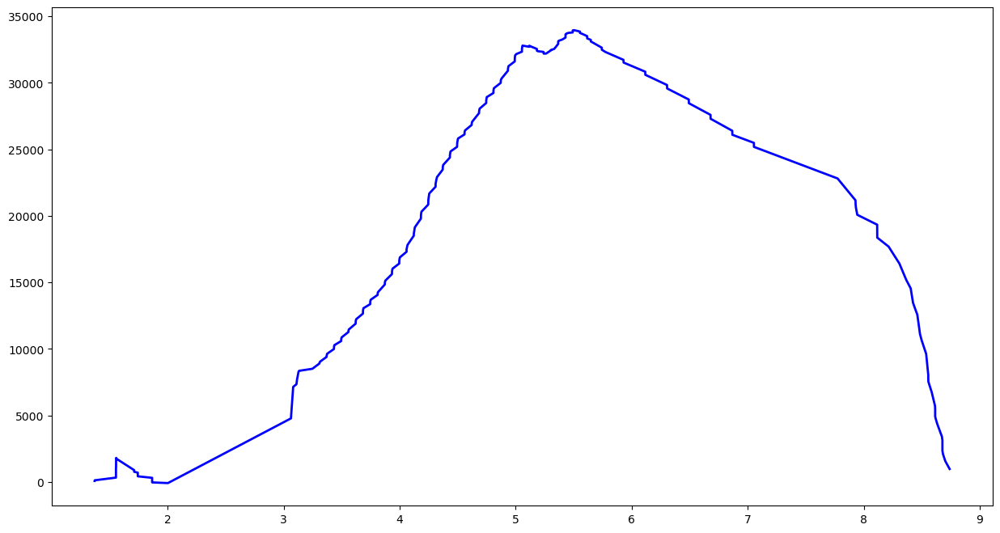

No Feature
../../singapore/top1k/paypal.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/paypal.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34524'])
Port 34524


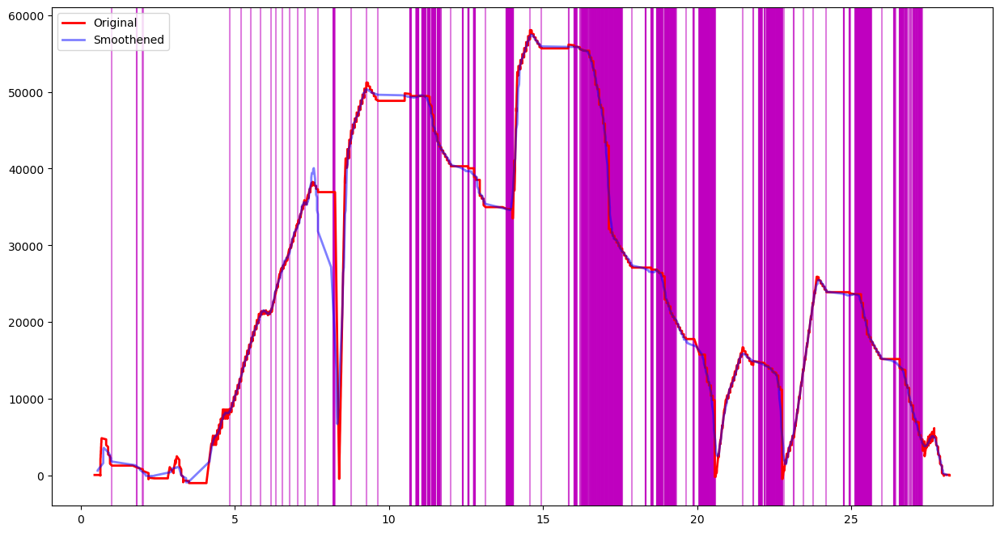

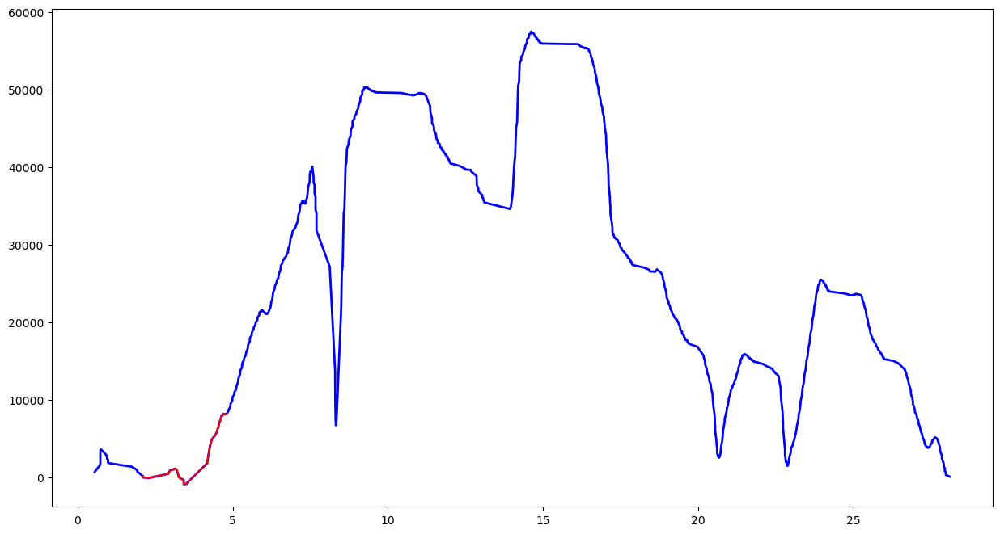

Feature Length  203


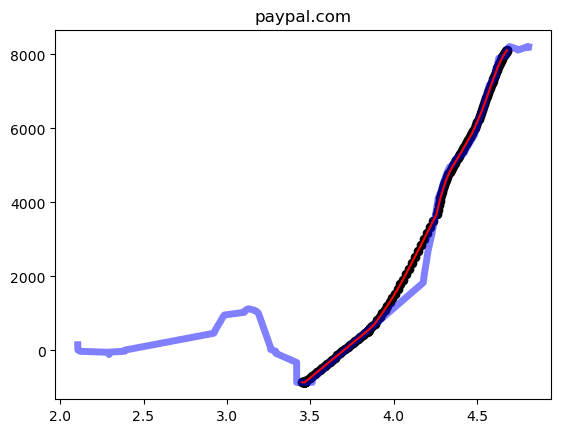

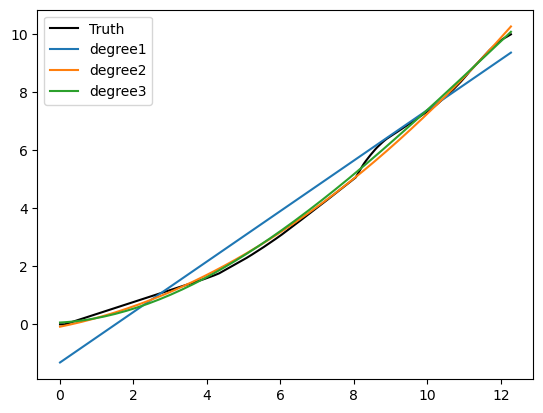

[ 0.04846134  0.26099031 -0.06978391]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/google.com.ph-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.ph-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44666'])
Port 44666


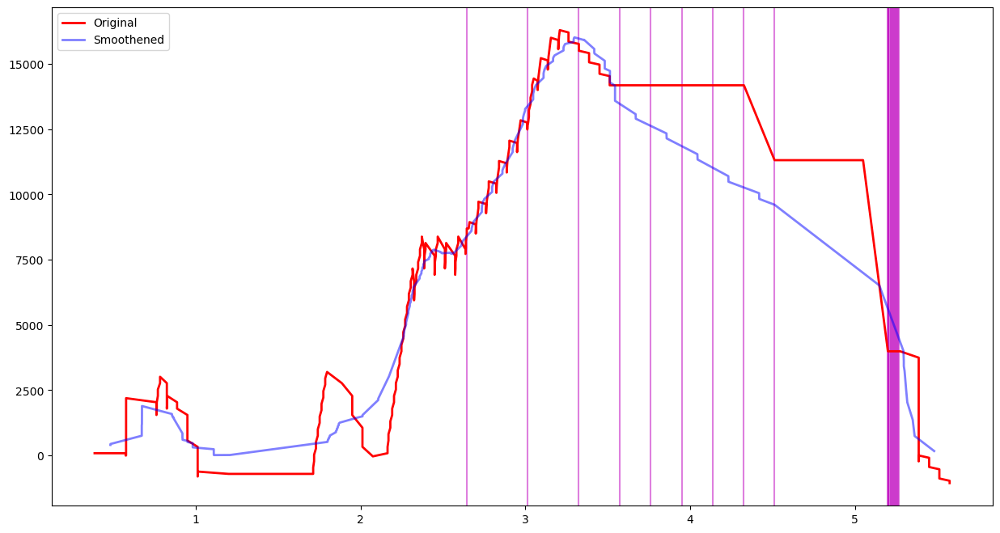

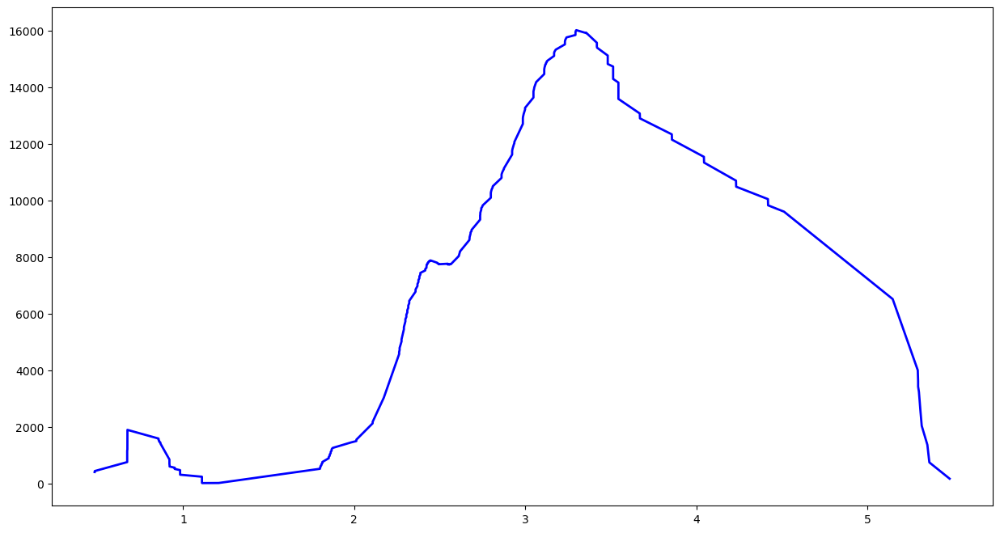

No Feature
../../singapore/top1k/pinterest.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/pinterest.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44054'])
Port 44054


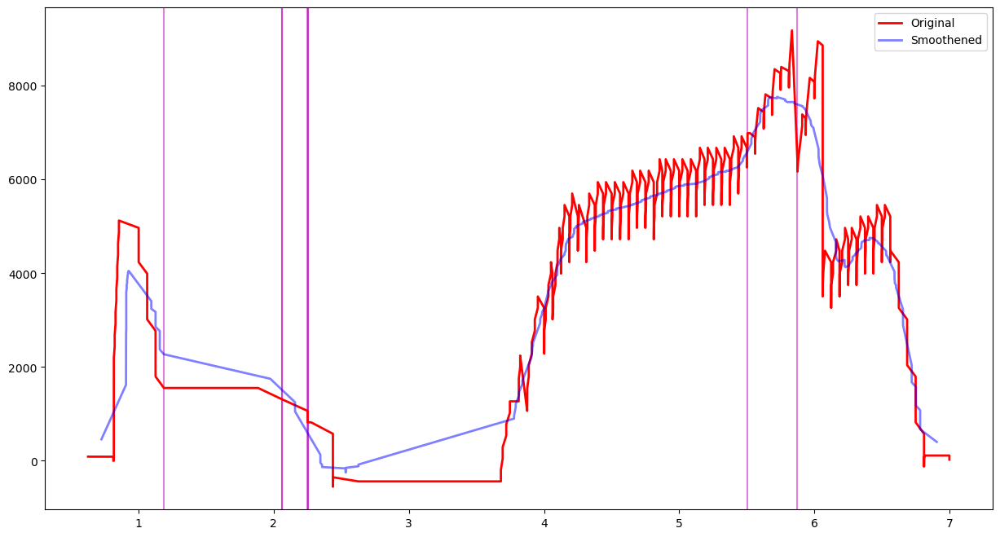

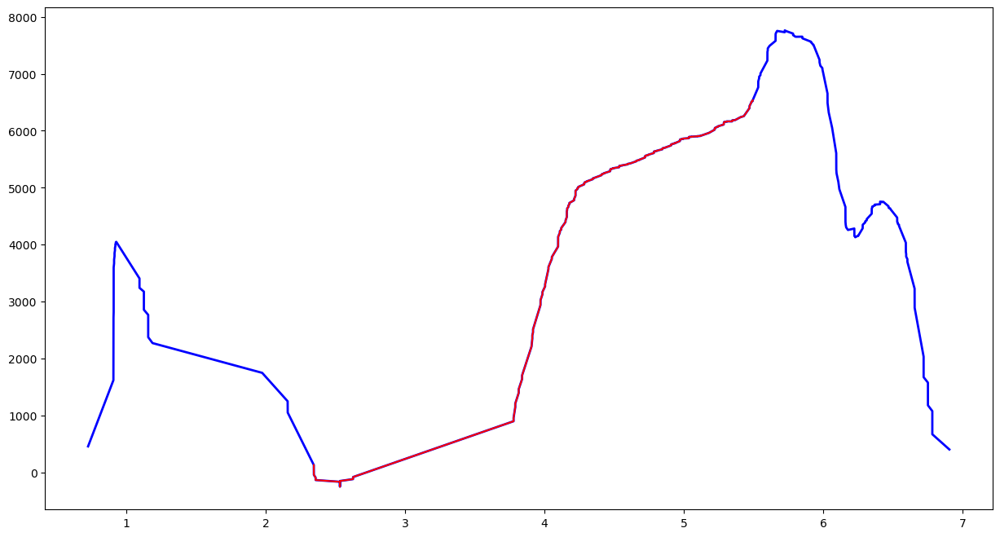

Feature Length  203


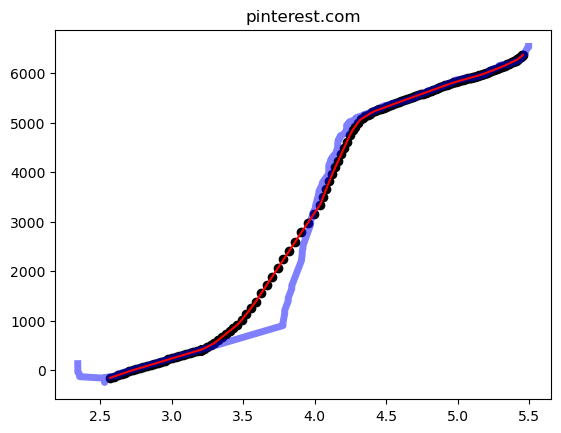

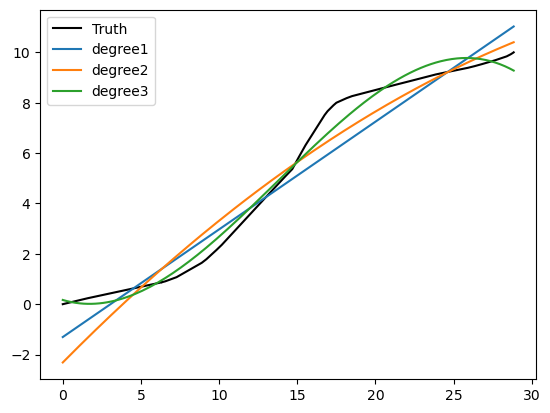

[-0.0014788   0.06106958 -0.21872638  0.22991068]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [6.67460493e-24 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.az-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.az-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49728'])
Port 49728


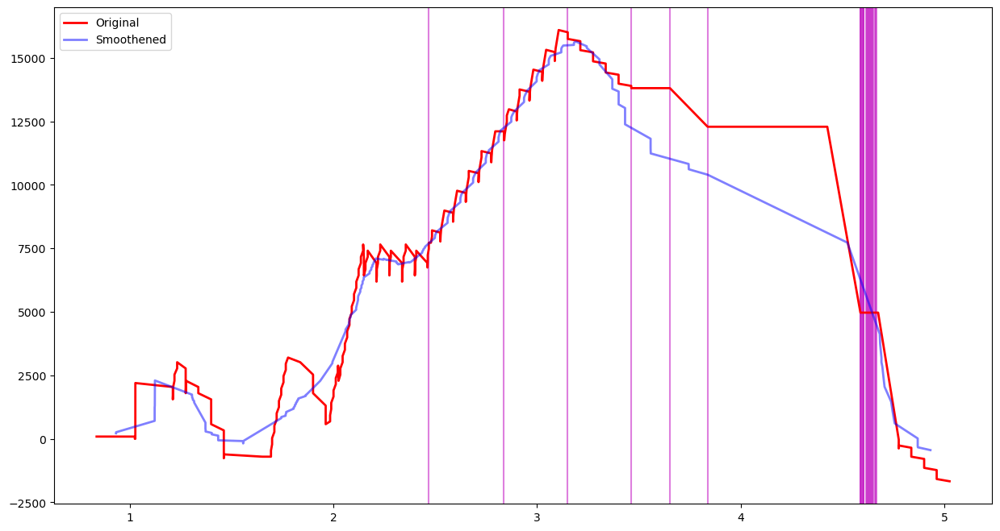

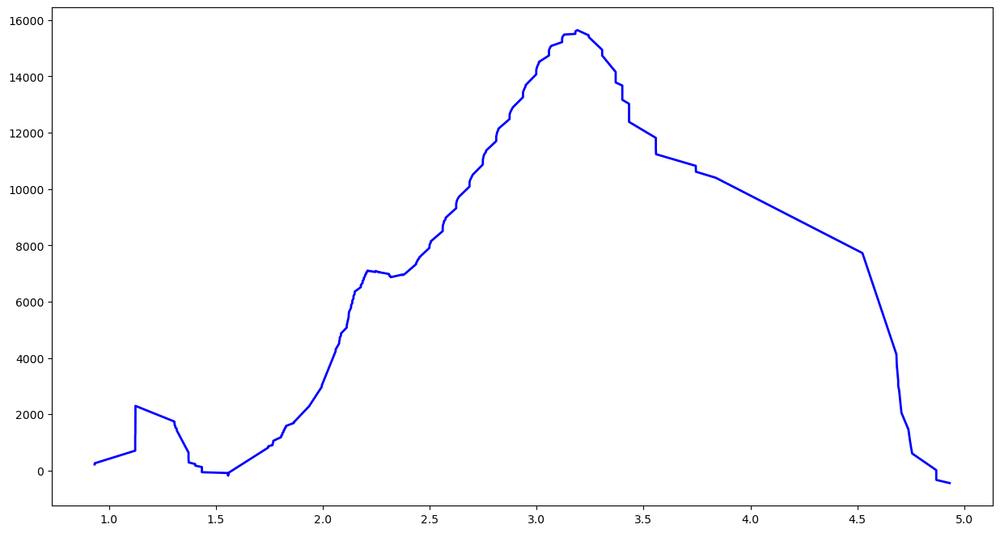

No Feature
../../singapore/top1k/diply.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/diply.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37812', '48264'])
Port 48264


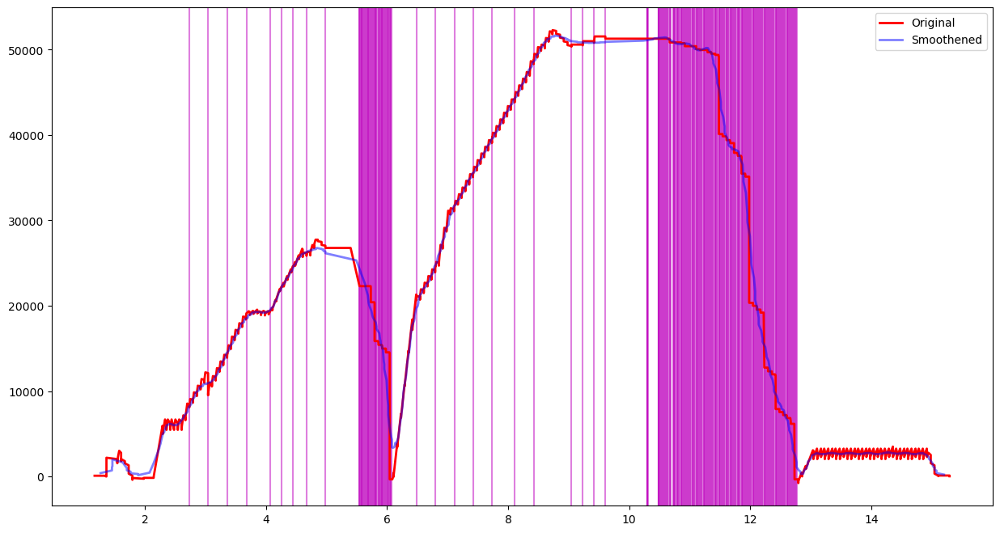

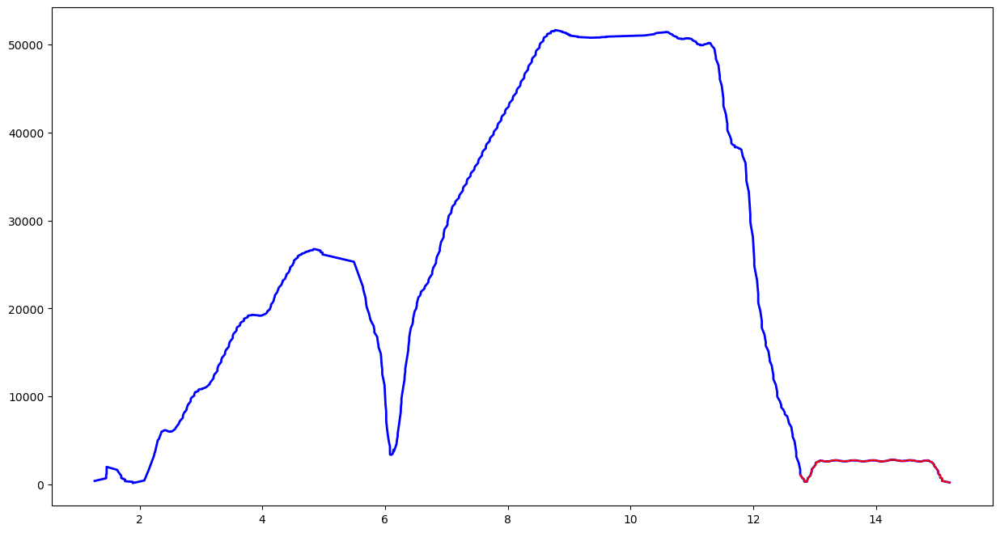

Feature Length  203


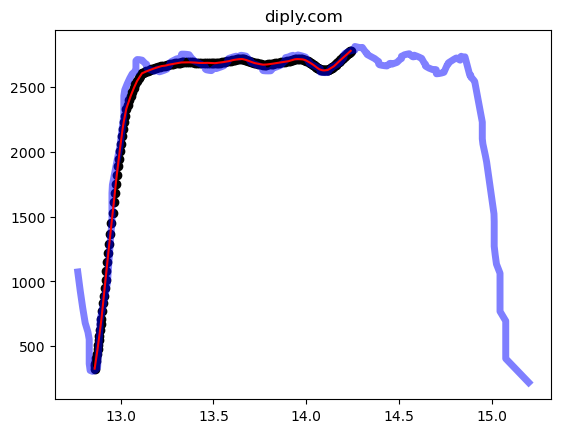

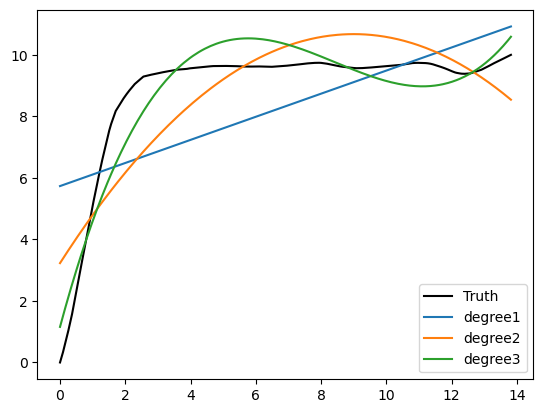

[ 0.02153437 -0.54668581  4.14408779  0.87576539]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.16805147e-88 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/thepiratebay.org-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/thepiratebay.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45794', '33554', '43340', '58372'])
Port 58372


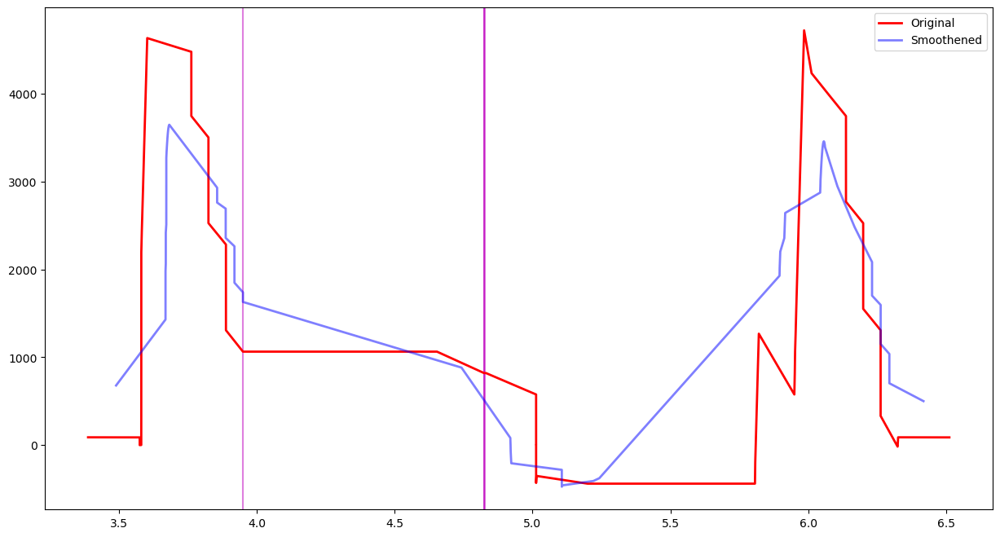

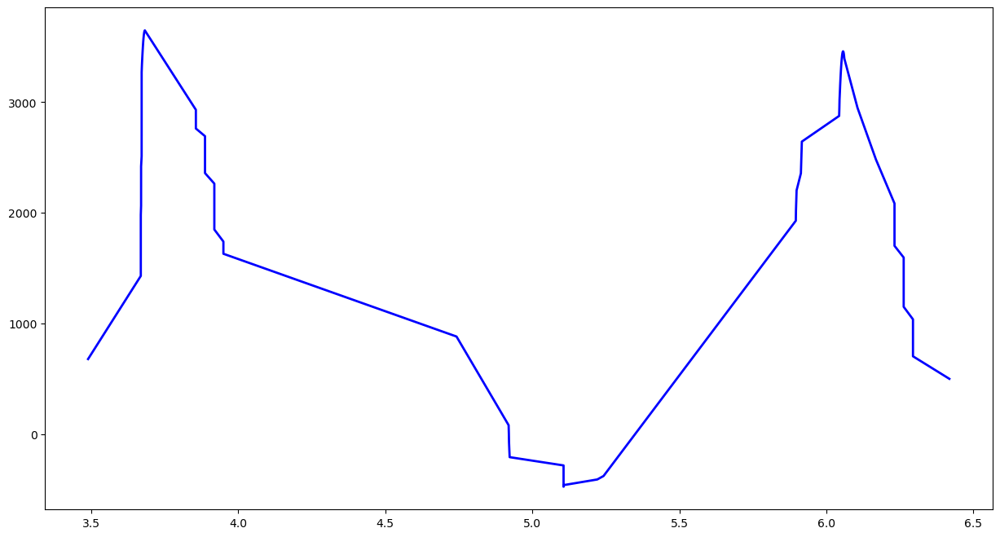

No Feature
../../singapore/top1k/chase.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/chase.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57248'])
Port 57248


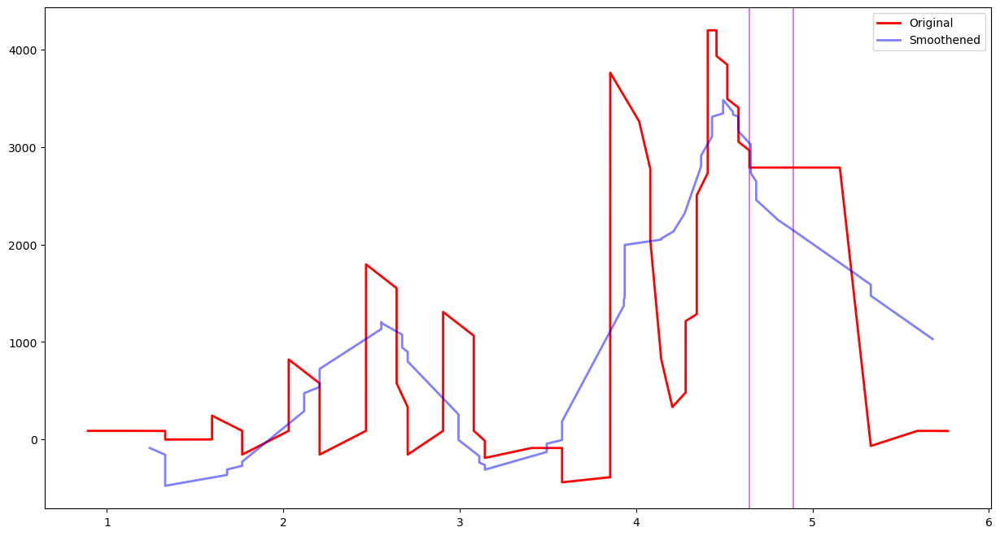

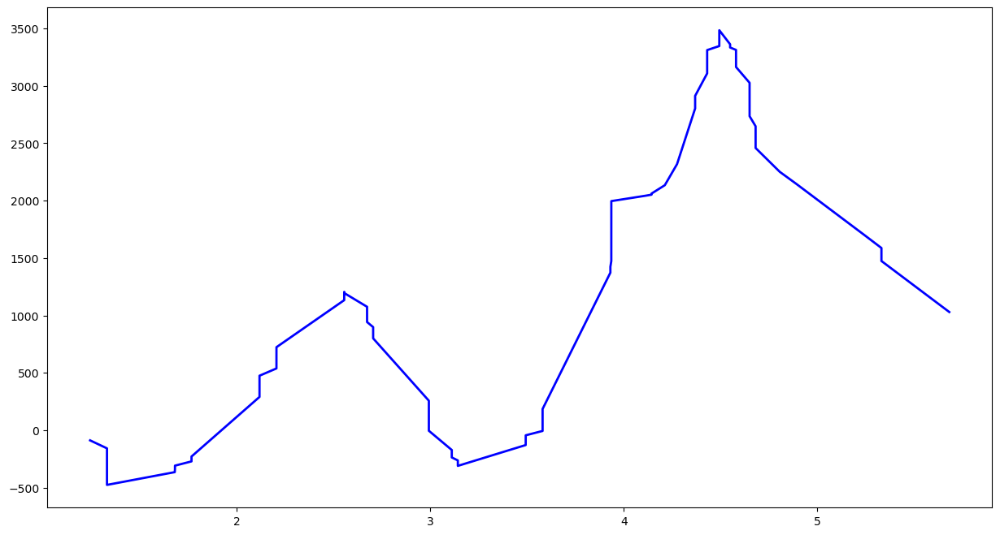

No Feature
../../singapore/top1k/google.com.vn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.vn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57468'])
Port 57468


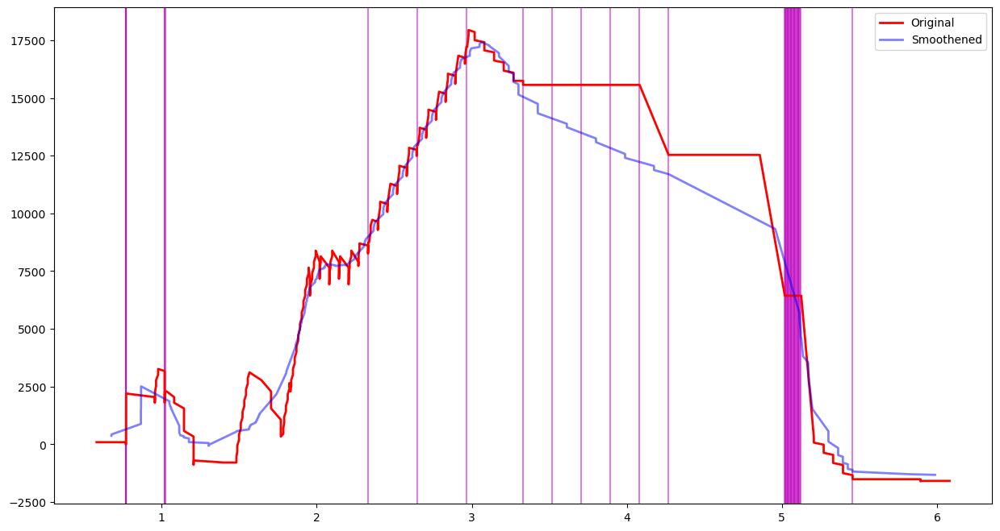

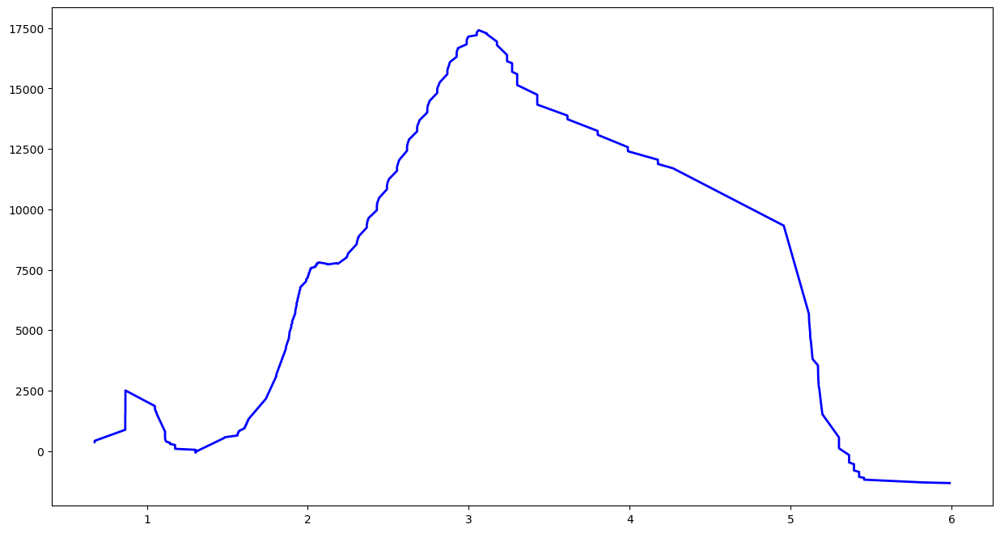

No Feature
../../singapore/top1k/flipkart.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/flipkart.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49932'])
Port 49932


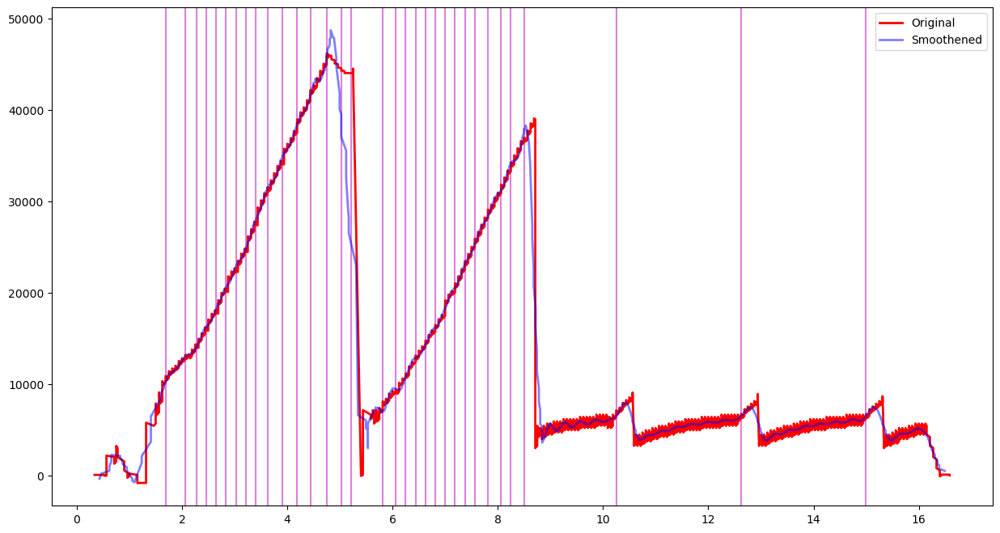

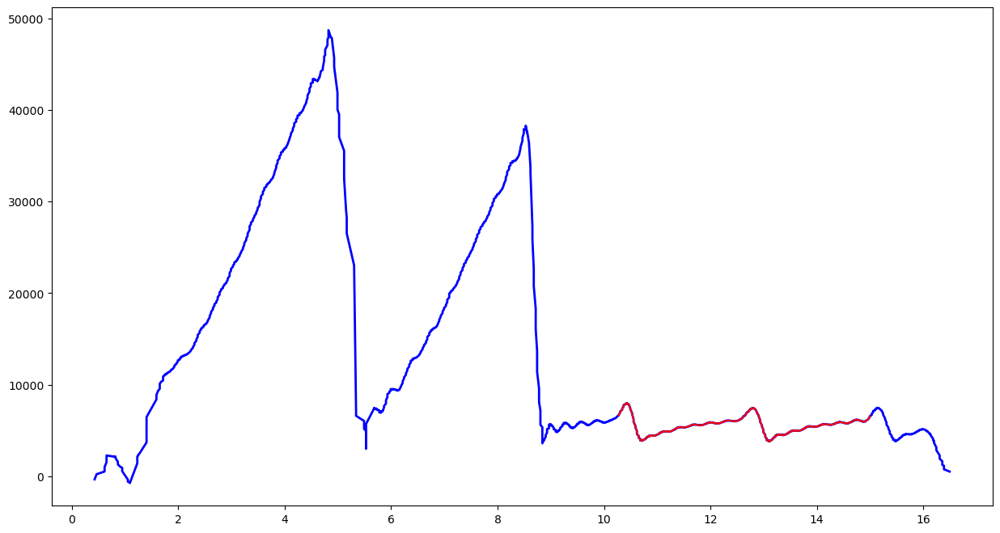

Feature Length  203


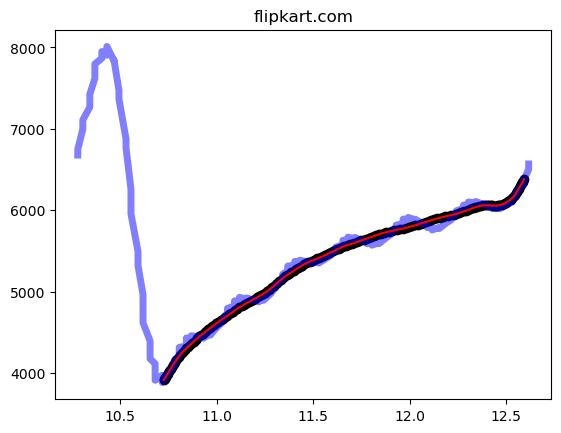

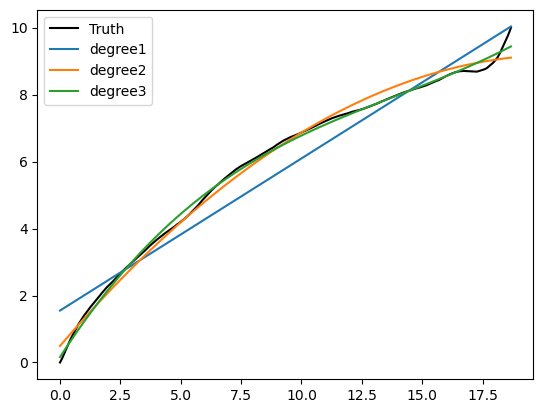

[-0.01689819  0.77488068  0.5625182 ]
Top 5 CCS : ['lp', 'reno', 'westwood', 'highspeed', 'dctcp']
Density Values: [1.39993459e-302 0.00000000e+000 0.00000000e+000 0.00000000e+000
 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0. 0.]
Prediction: new
../../singapore/top1k/cnblogs.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/cnblogs.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['47732'])
Port 47732


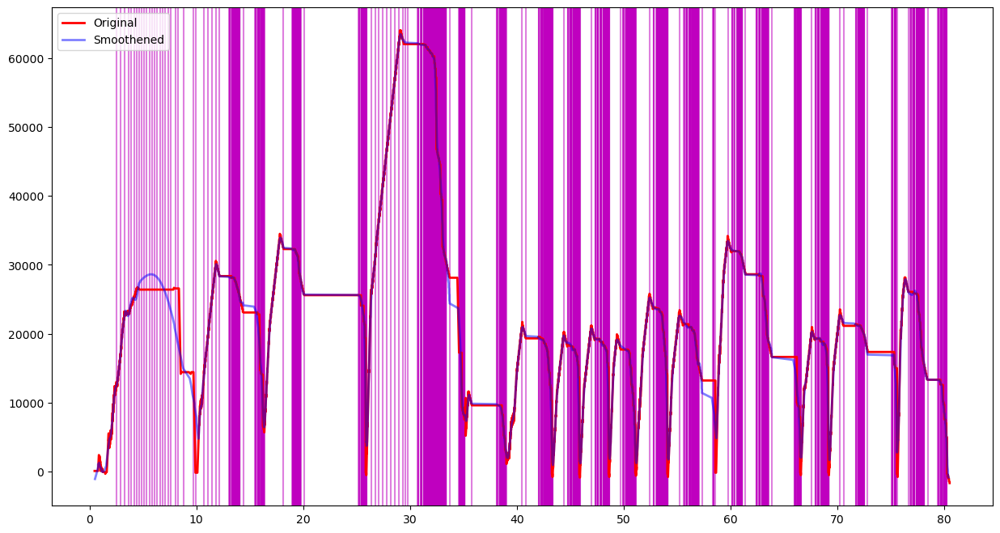

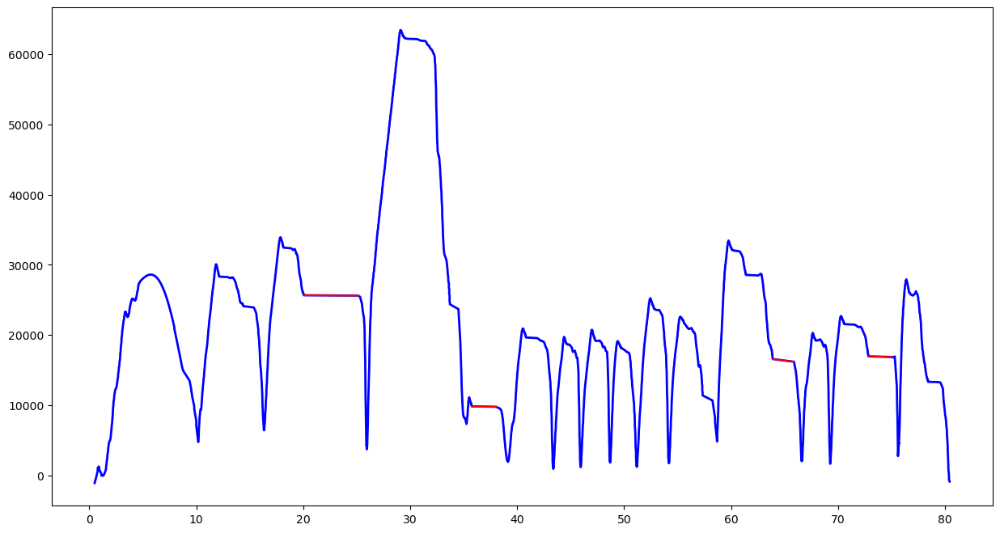

Feature Length  203


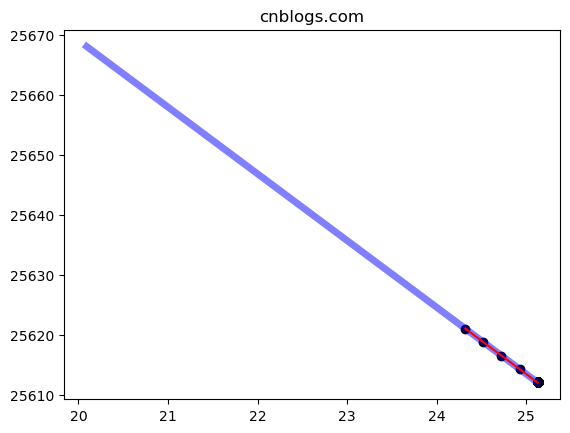

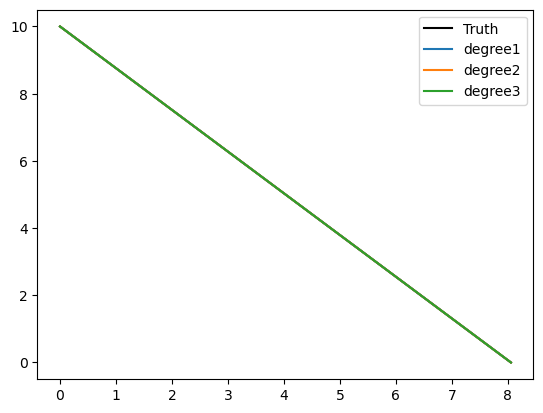

[-2.48294885 10.        ]
Top 5 CCS : ['scalable', 'nv', 'yeah', 'bic']
Density Values: [9.18392003e-23 7.12698630e-33 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 7.76028785e-11 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/onlinesbi.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/onlinesbi.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34964'])
Port 34964


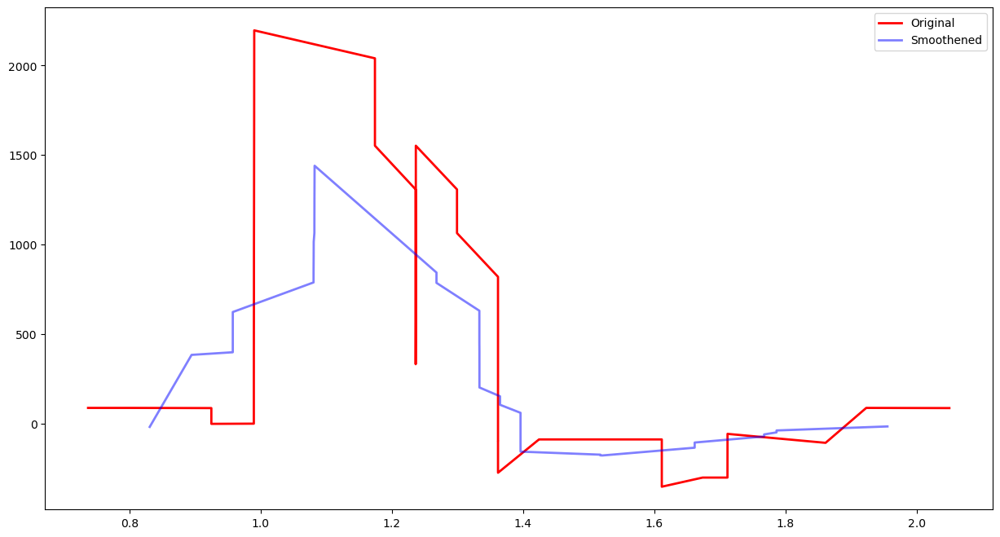

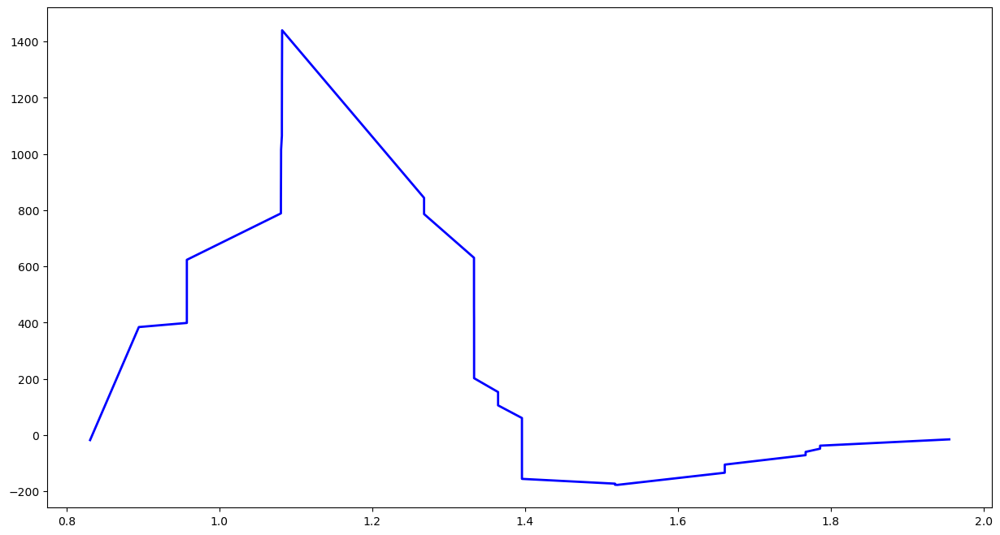

No Feature
../../singapore/top1k/bongacams.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bongacams.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50214', '44346'])
Port 44346


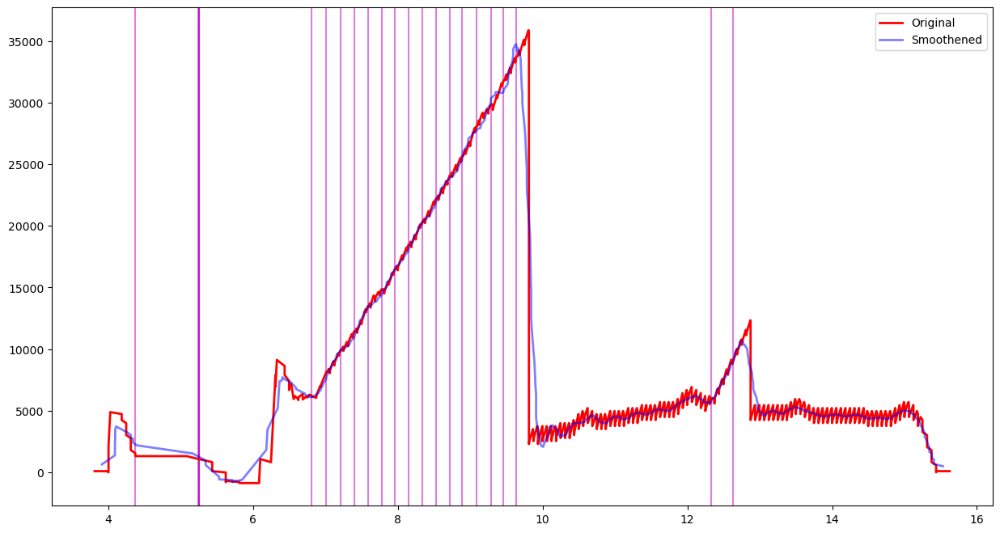

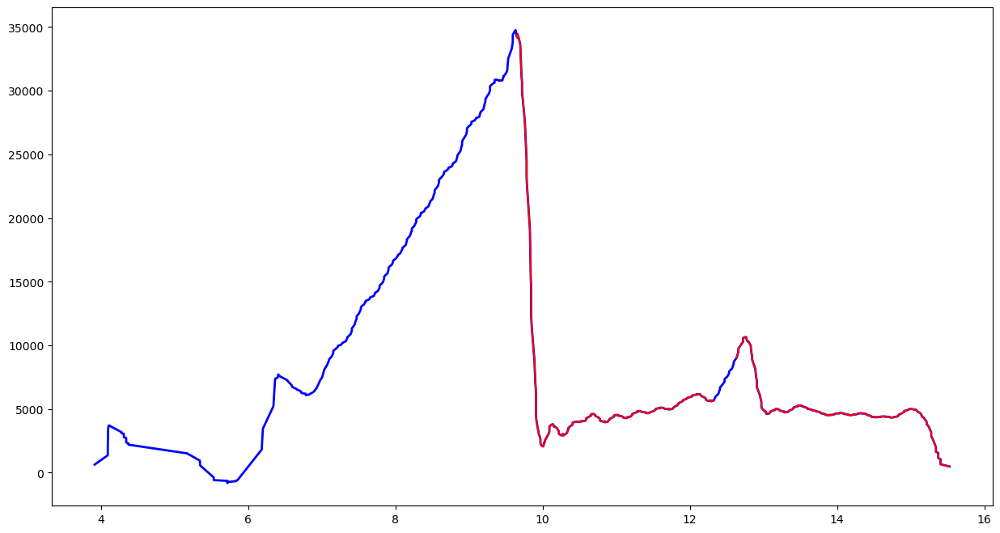

Feature Length  203


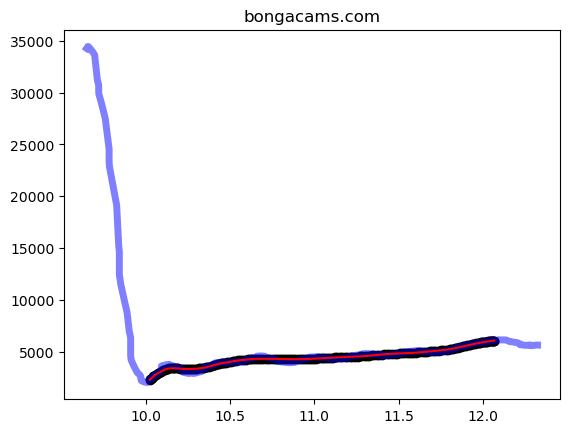

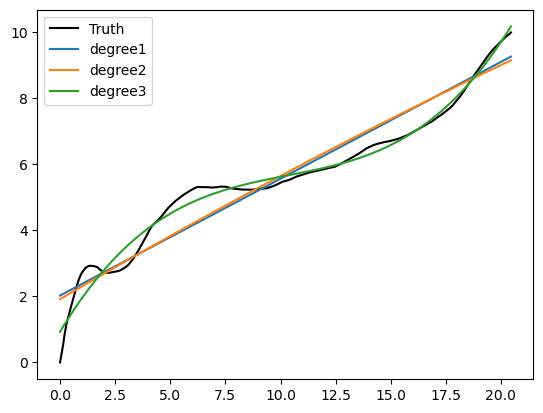

[0.38481112 1.3179872 ]
Top 5 CCS : ['yeah', 'nv', 'scalable', 'bic']
Density Values: [1.69334758e+01 1.70043386e+00 1.40707255e+00 7.63723912e-64]
Relative Density Values: [1.         0.10041848 0.08309414 0.        ]
Prediction: confused
../../singapore/top1k/eastday.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/eastday.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53544'])
Port 53544


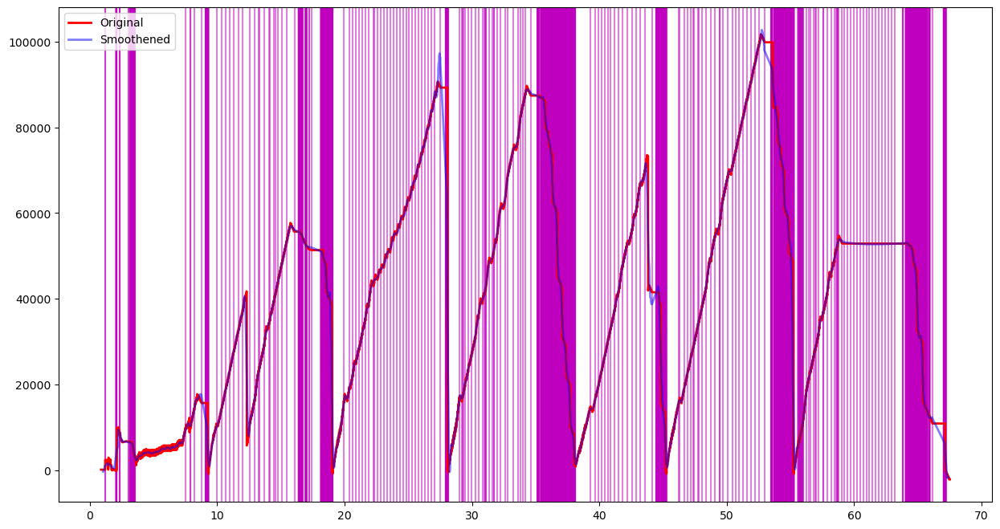

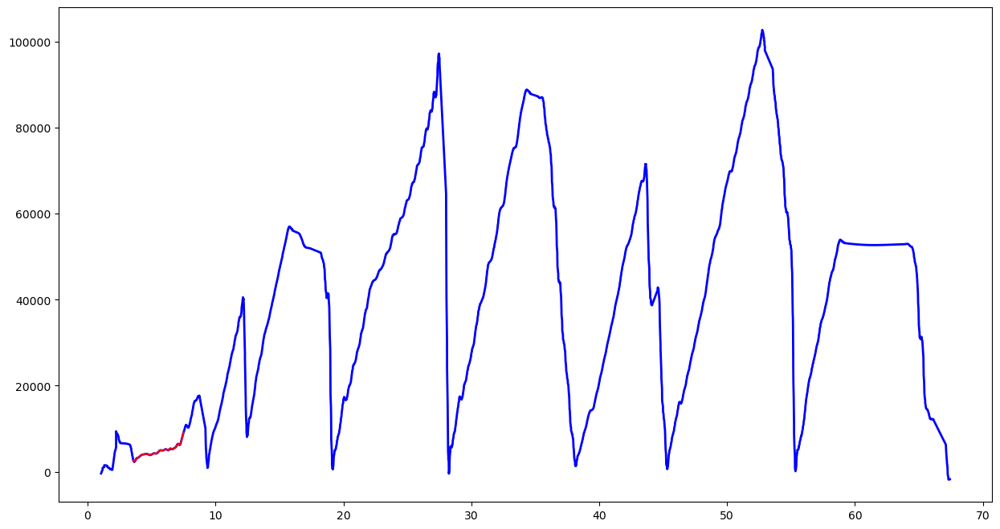

Feature Length  203


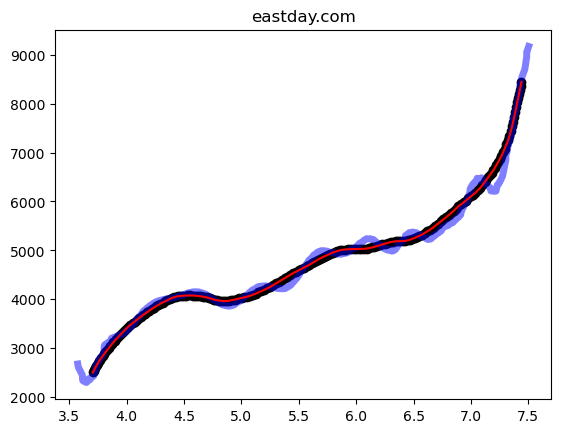

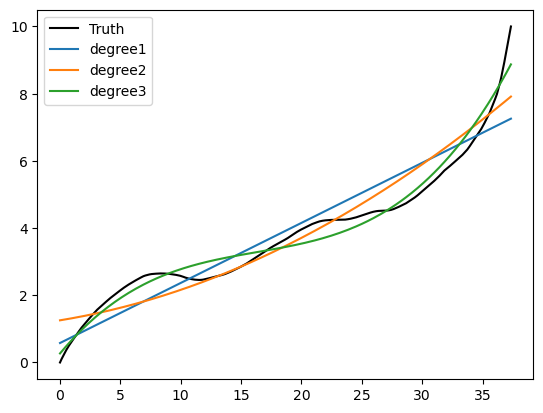

[ 0.00049749 -0.02512102  0.46801519  0.26823662]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [7.50610097e-08 1.47329425e-43 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.96279567e-36 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/spotify.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/spotify.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46392'])
Port 46392


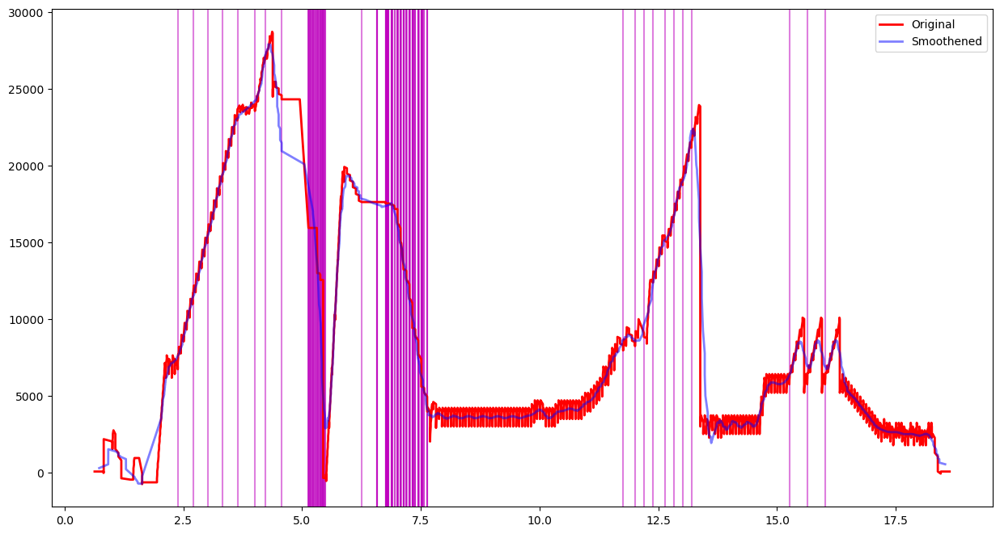

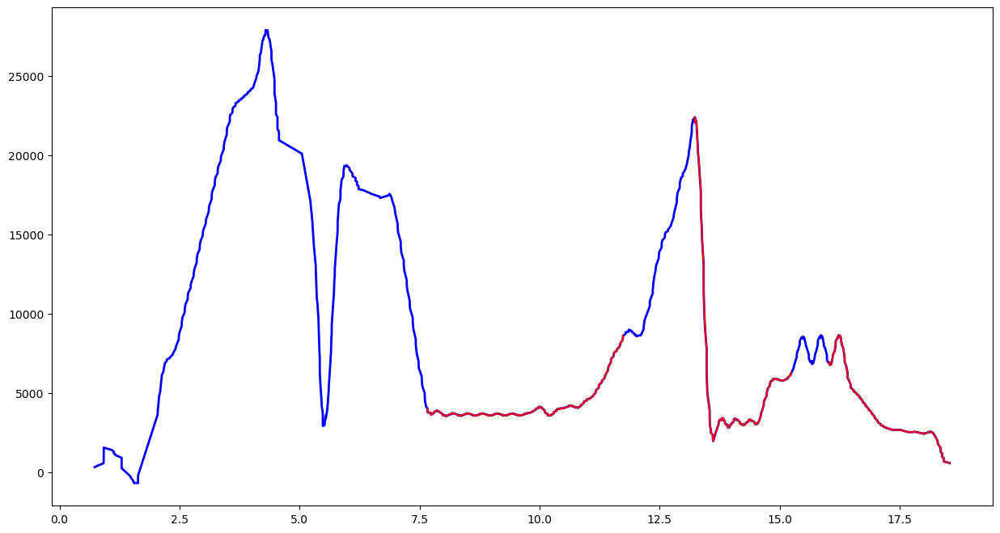

Feature Length  203


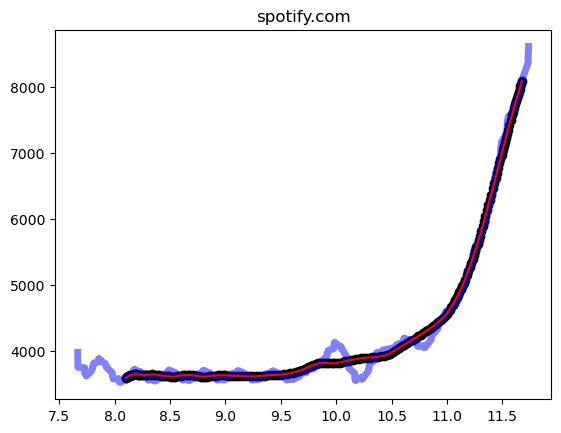

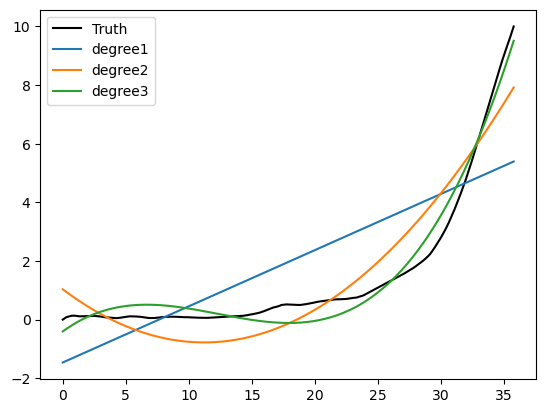

[ 0.00079964 -0.0286251   0.26833933 -0.29881931]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.13710512e-102 1.45027791e-242 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1.00000000e+000 1.27541234e-140 0.00000000e+000 0.00000000e+000]
Prediction: new
../../singapore/top1k/xnxx.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/xnxx.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46860'])
Port 46860


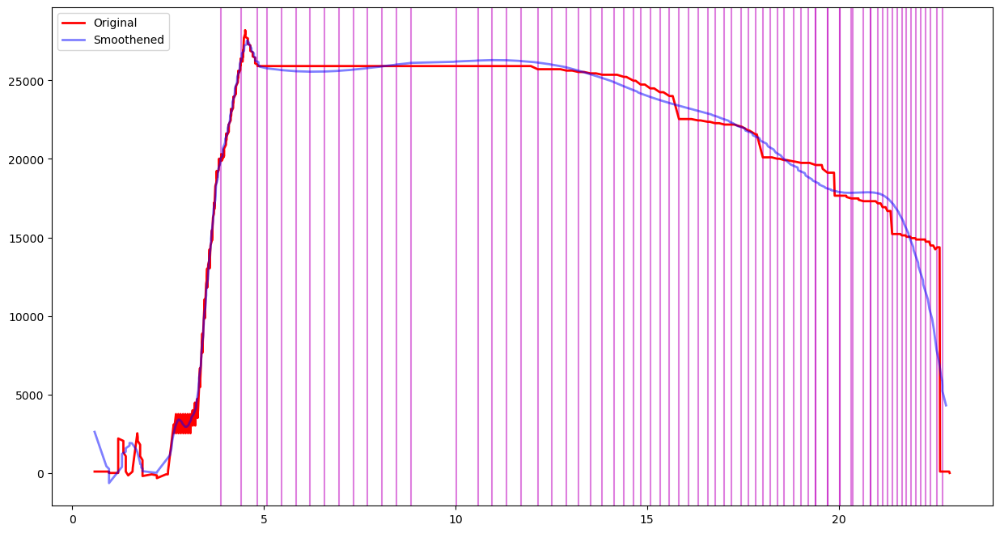

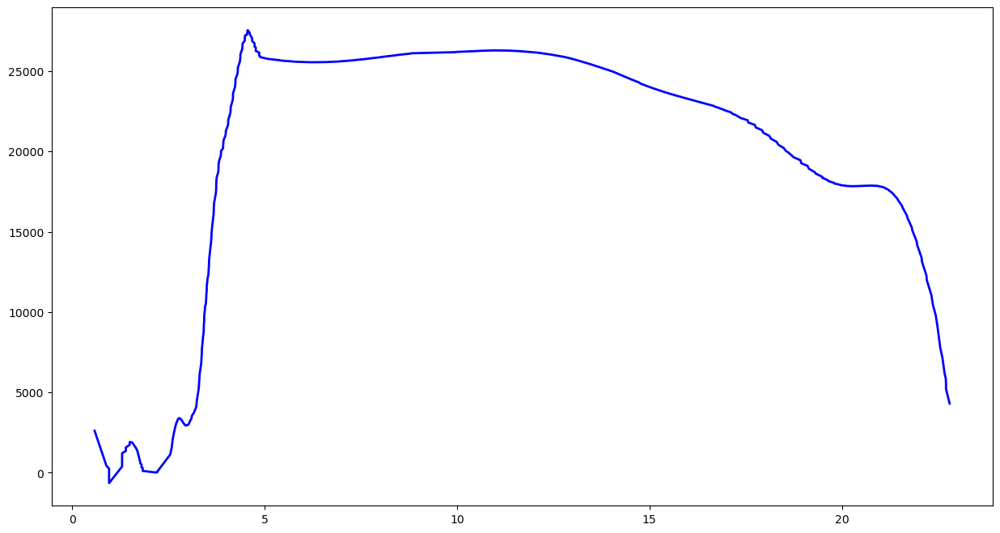

No Feature
../../singapore/top1k/google.es-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.es-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35296'])
Port 35296


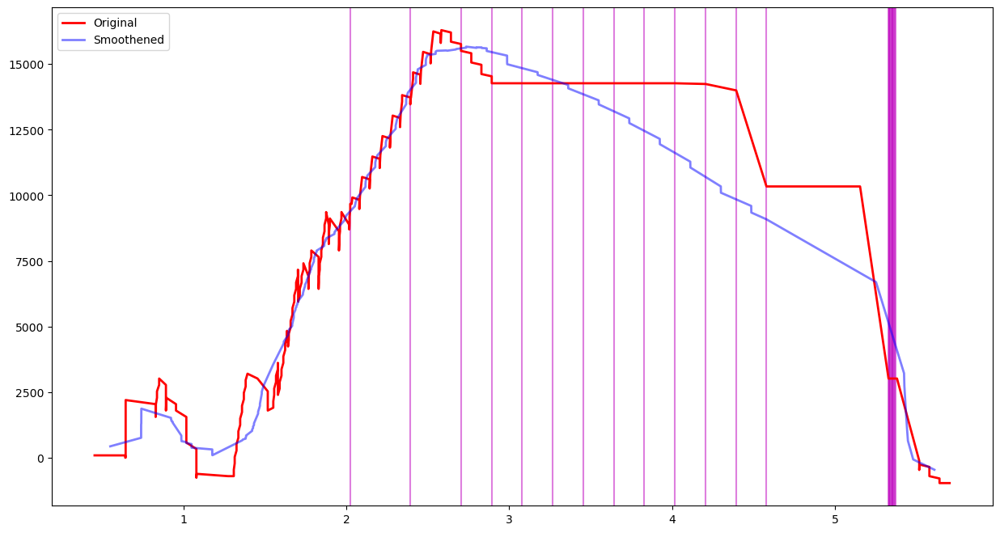

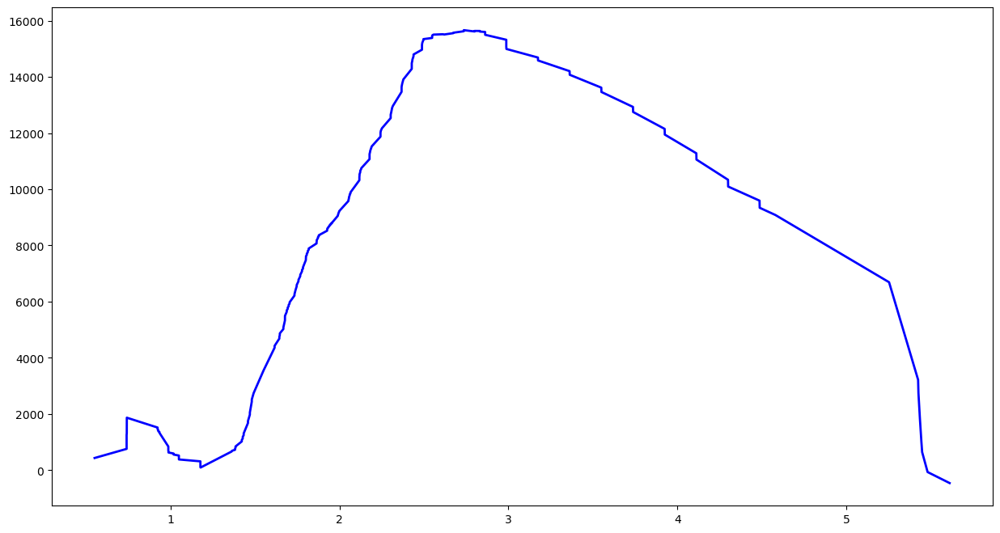

No Feature
../../singapore/top1k/spankbang.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/spankbang.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50276'])
Port 50276


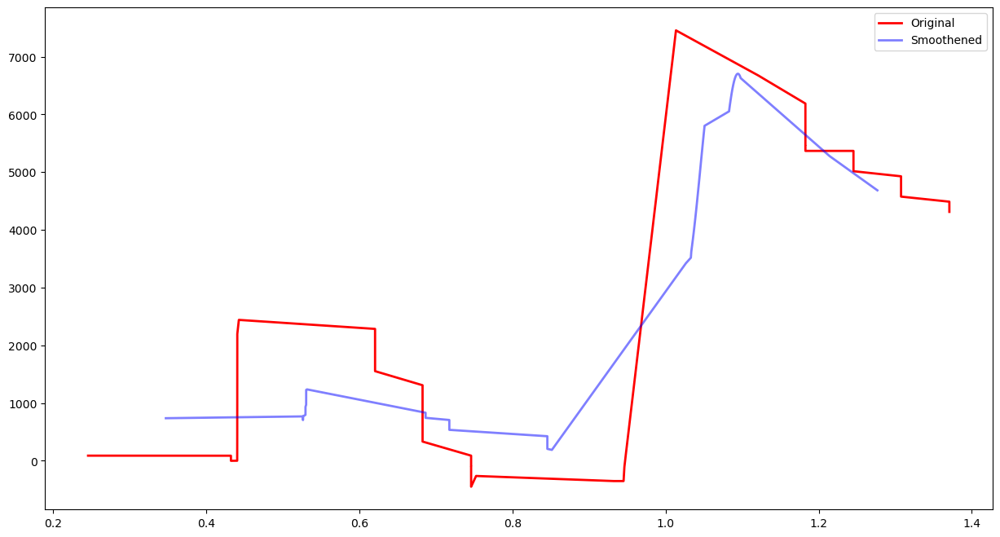

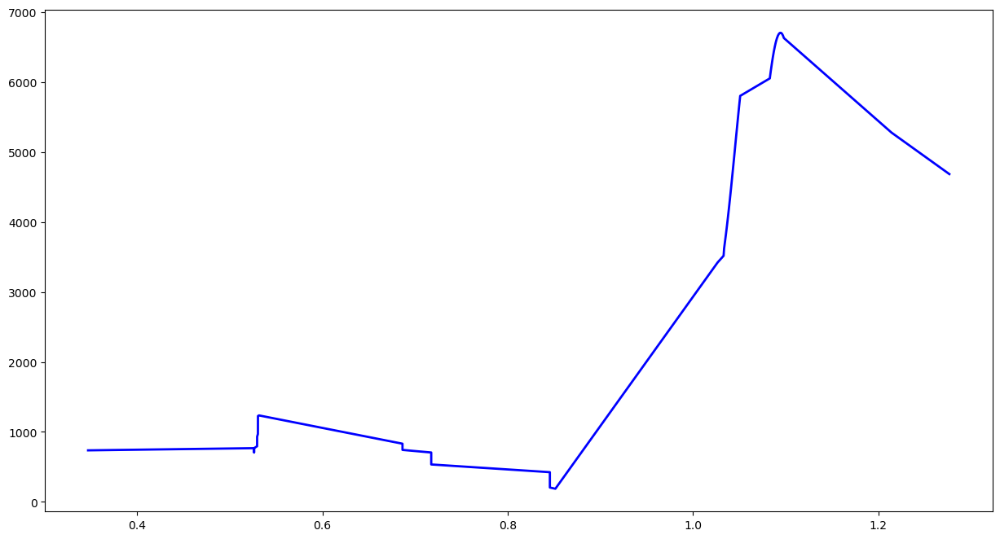

No Feature
../../singapore/top1k/google.co.in-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.in-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46400'])
Port 46400


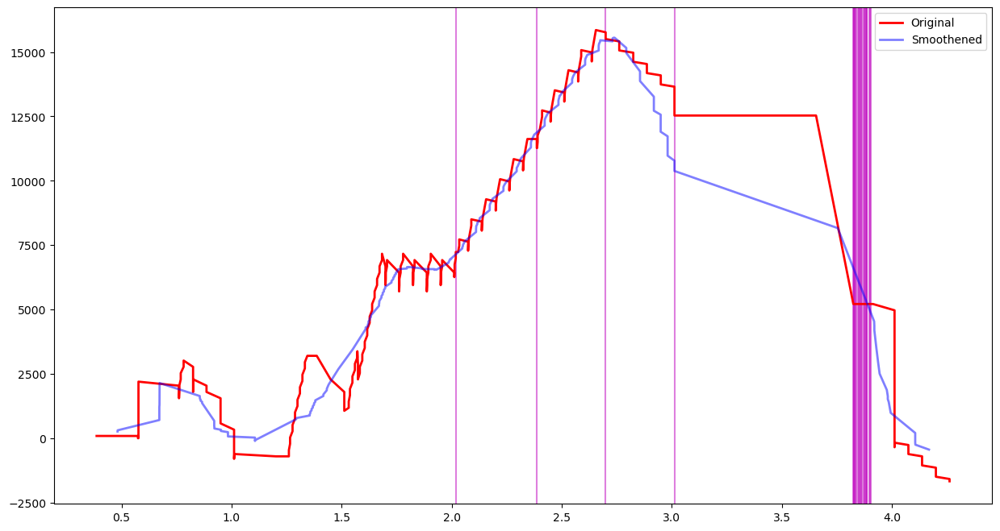

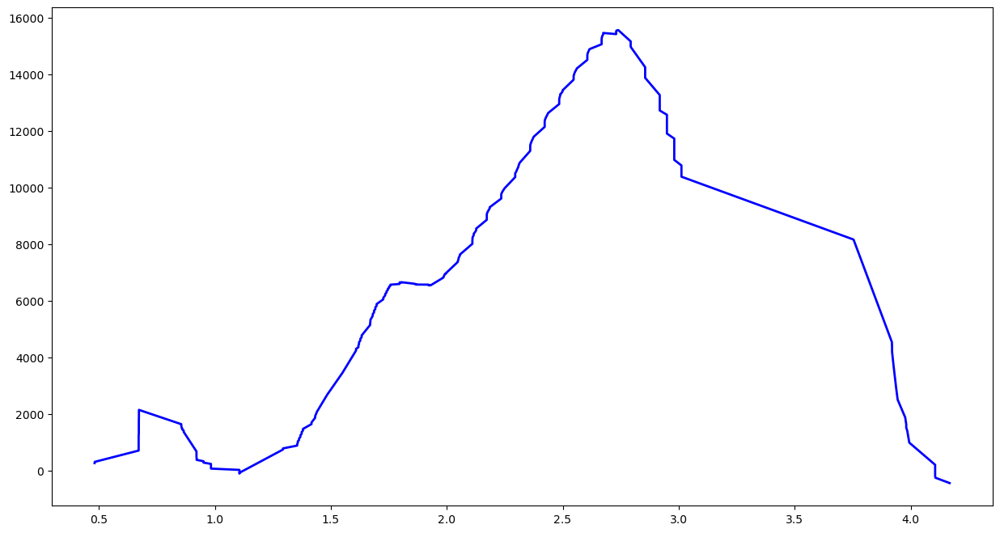

No Feature
../../singapore/top1k/google.com.tr-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.tr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55962'])
Port 55962


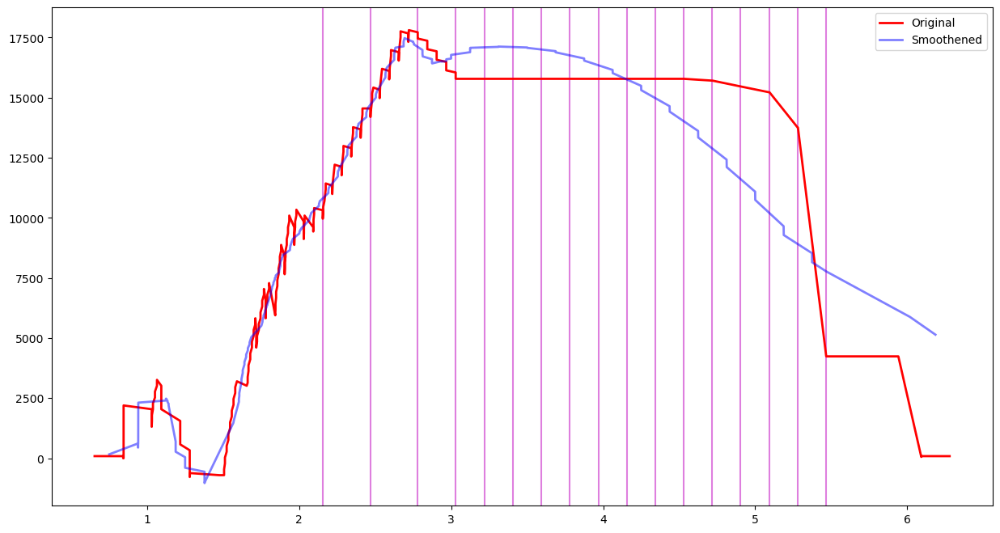

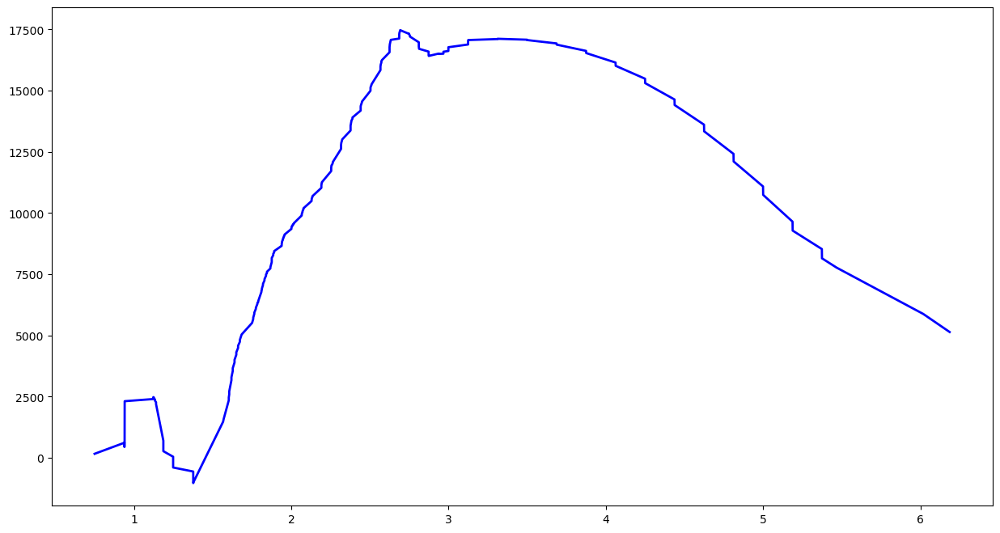

No Feature
../../singapore/top1k/google.co.uk-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.uk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51664'])
Port 51664


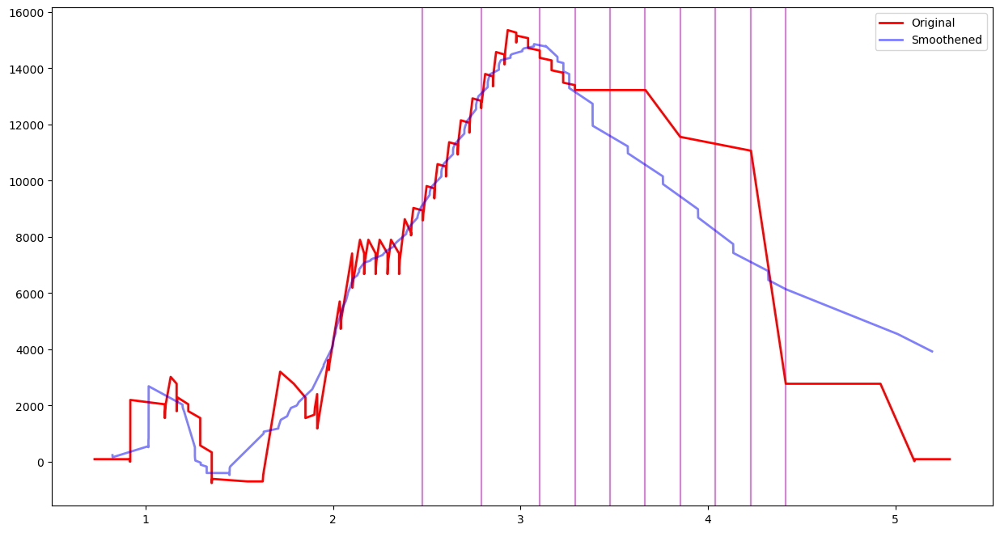

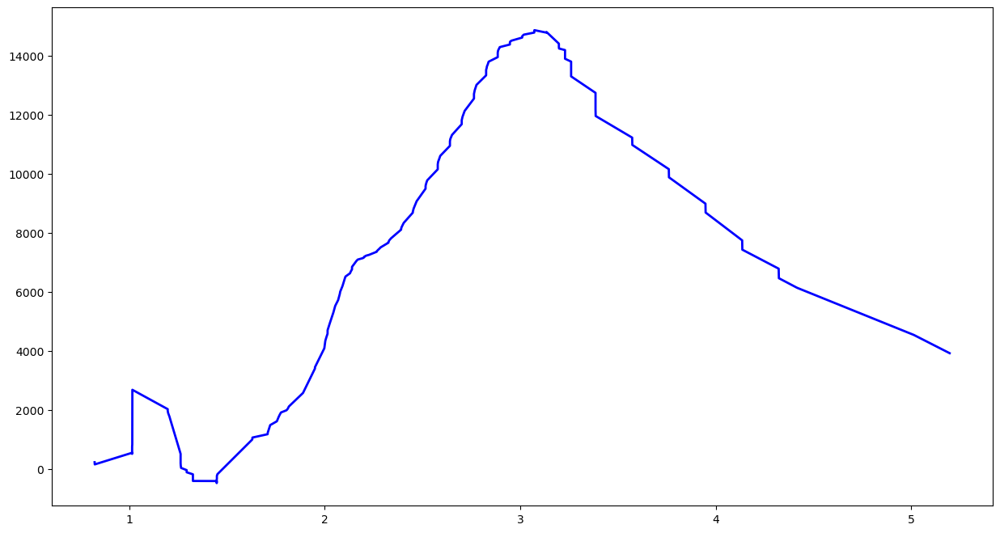

No Feature
../../singapore/top1k/instagram.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/instagram.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48254'])
Port 48254


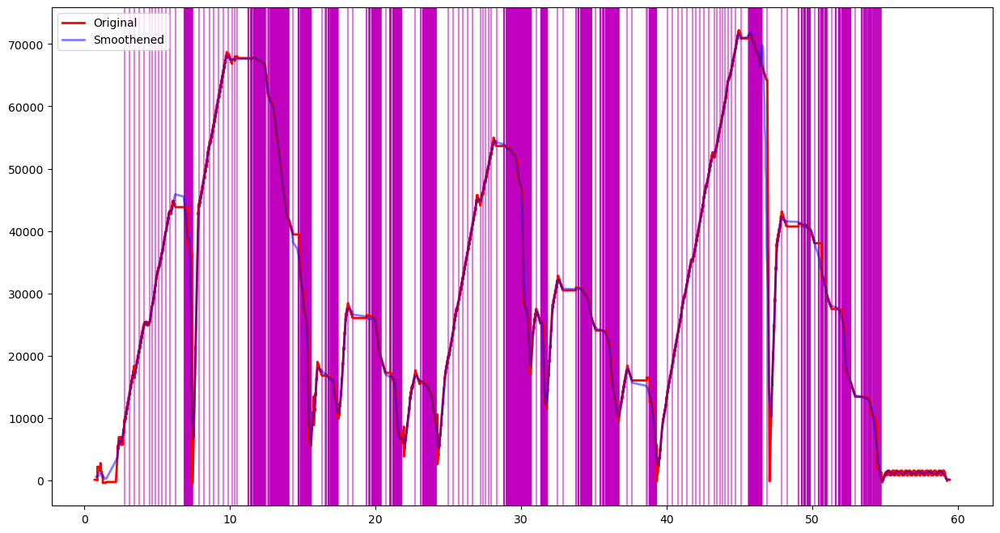

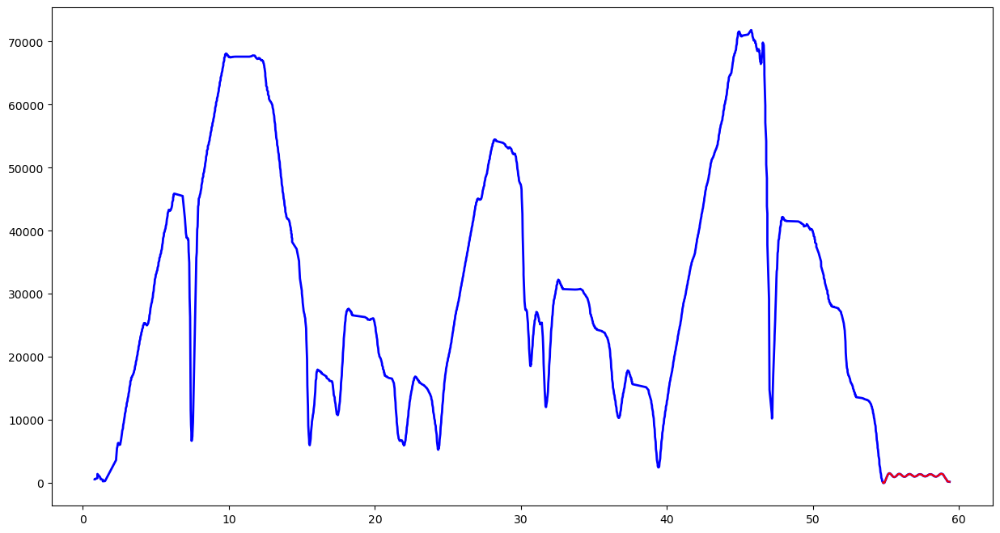

Feature Length  203


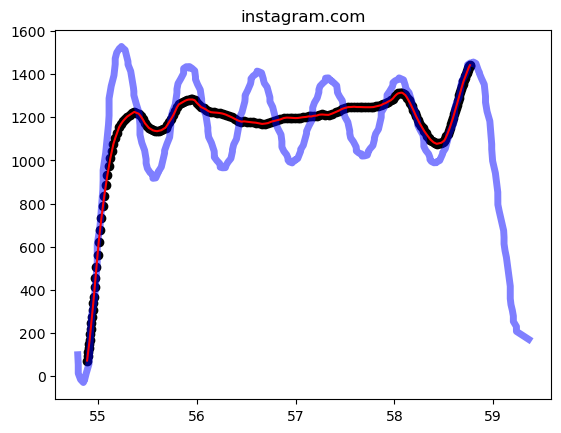

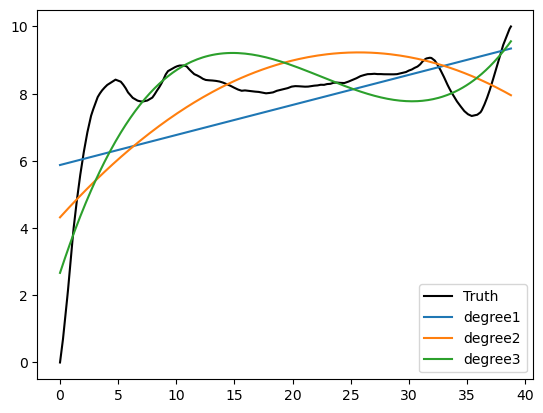

[ 8.44939713e-04 -5.51538242e-02  1.03965054e+00  3.11218647e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [9.39845769e-084 6.03804152e-104 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1.00000000e+00 6.42450253e-21 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/sogou.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/sogou.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34766', '52338'])
Port 52338


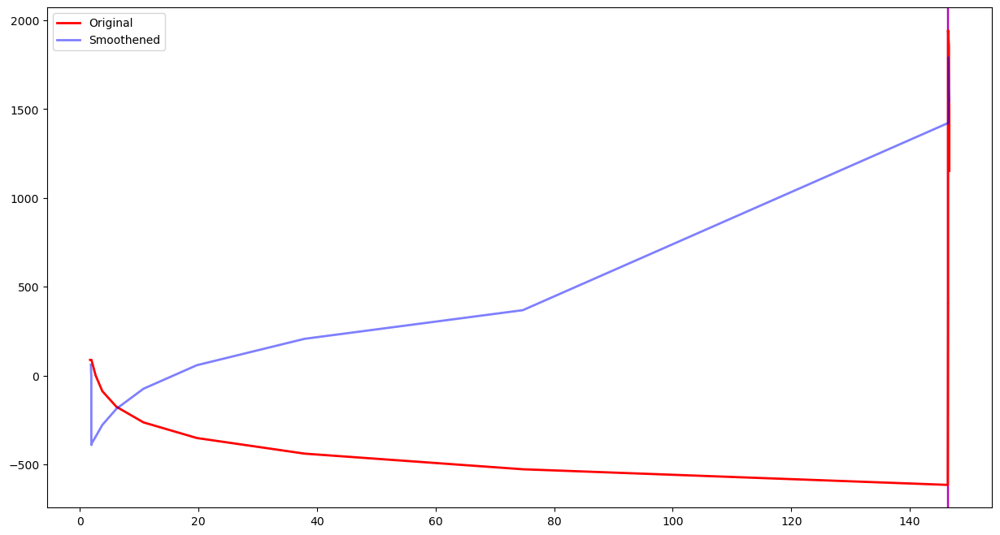

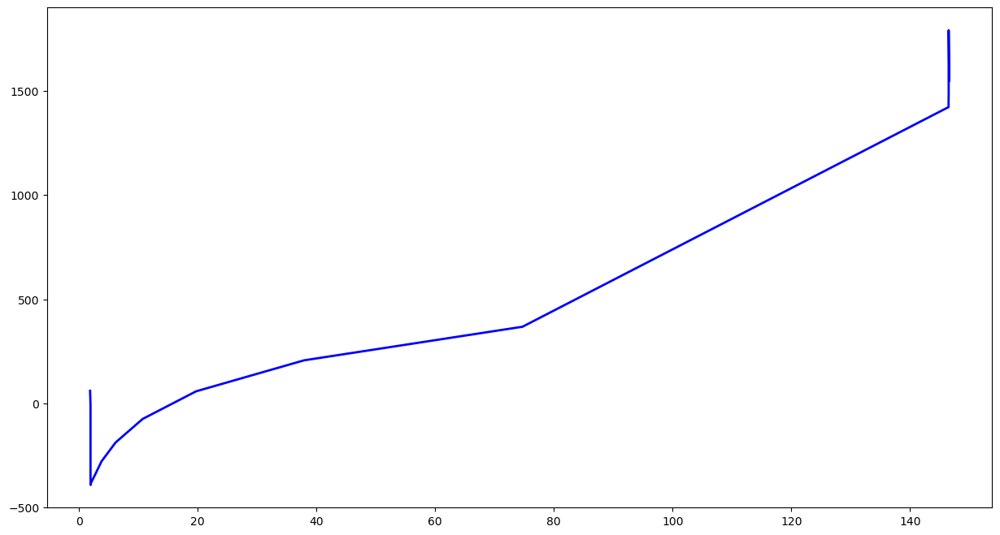

No Feature
../../singapore/top1k/aparat.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/aparat.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48658'])
Port 48658


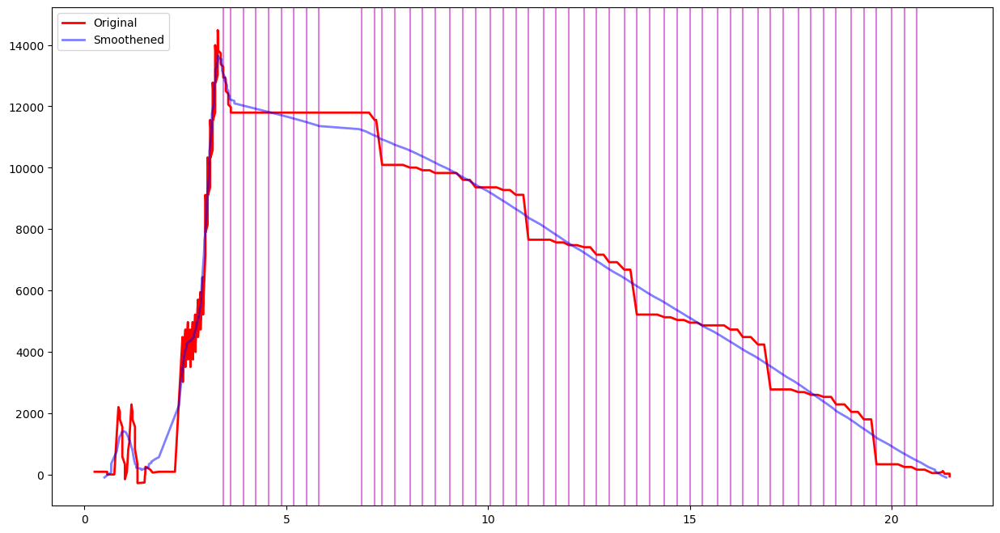

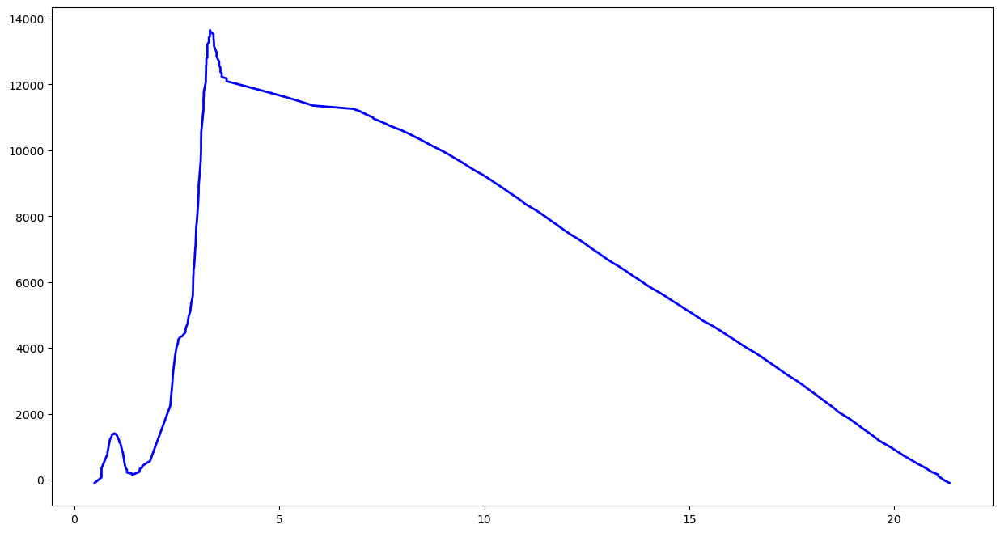

No Feature
../../singapore/top1k/craigslist.org-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/craigslist.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50478'])
Port 50478


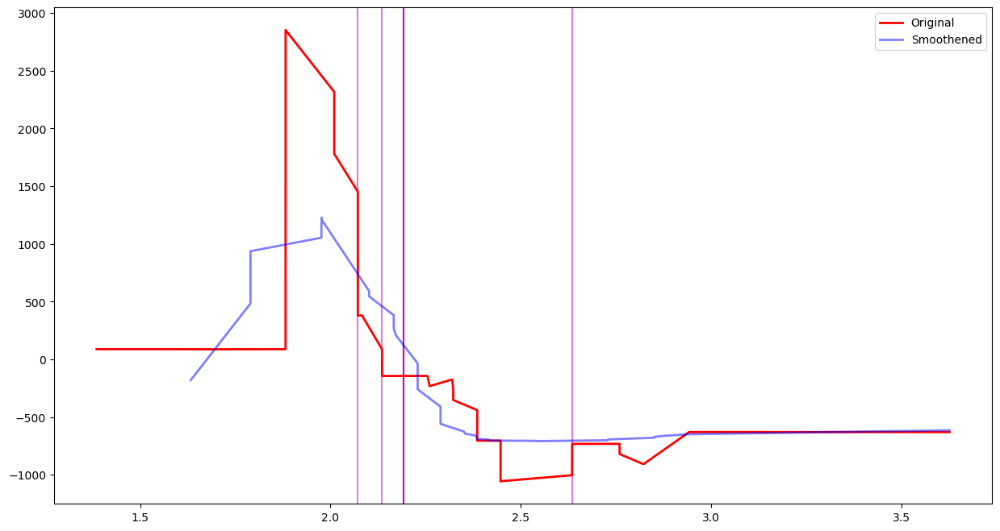

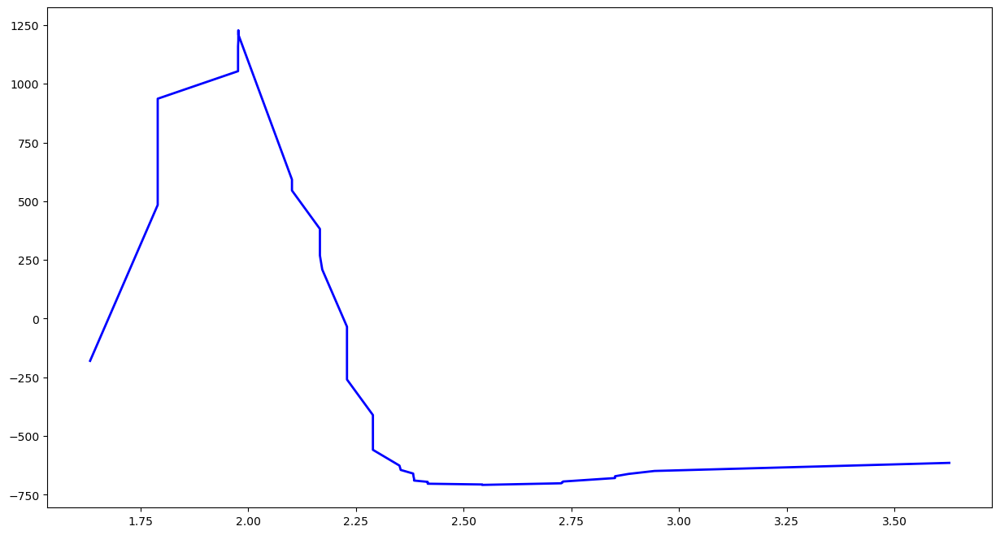

No Feature
../../singapore/top1k/apple.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/apple.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49820'])
Port 49820


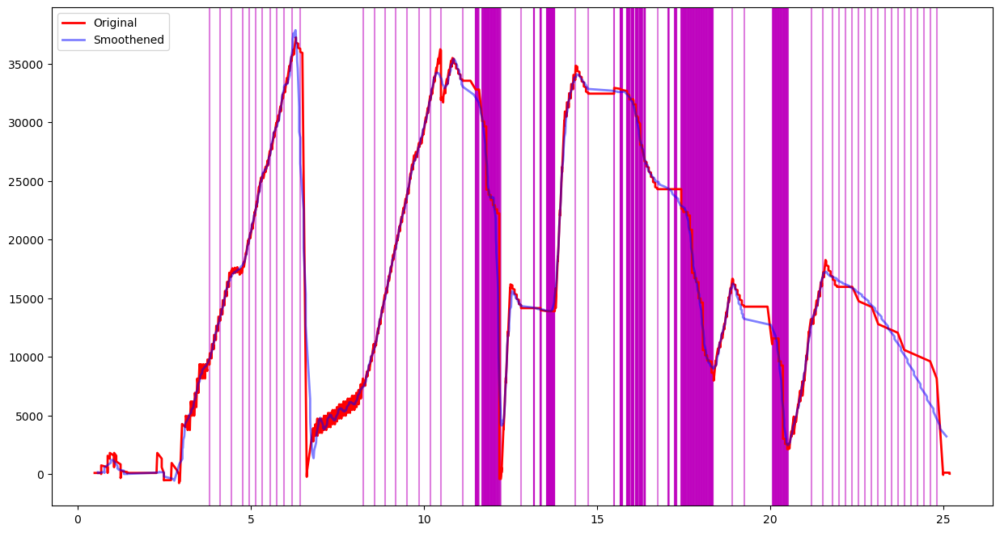

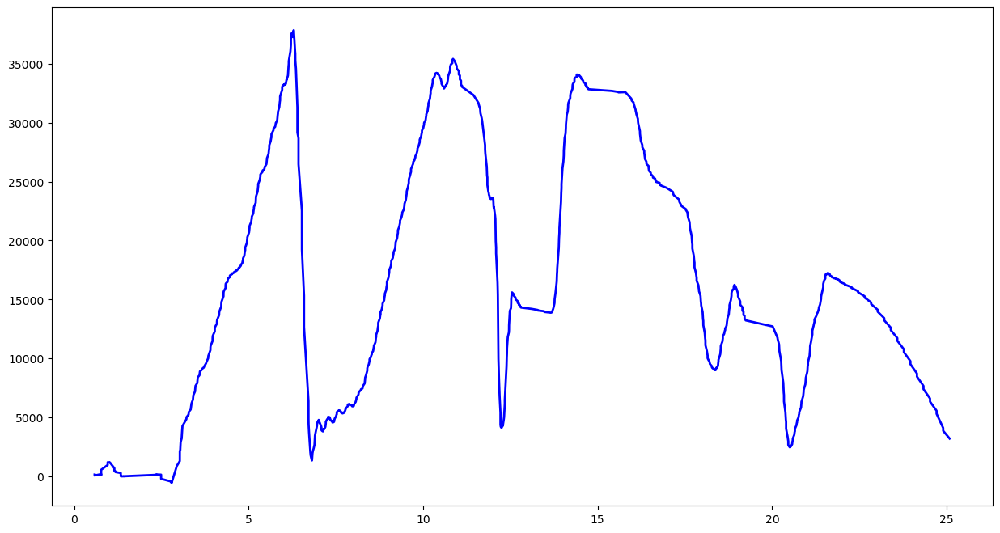

No Feature
../../singapore/top1k/google.gr-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.gr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37870'])
Port 37870


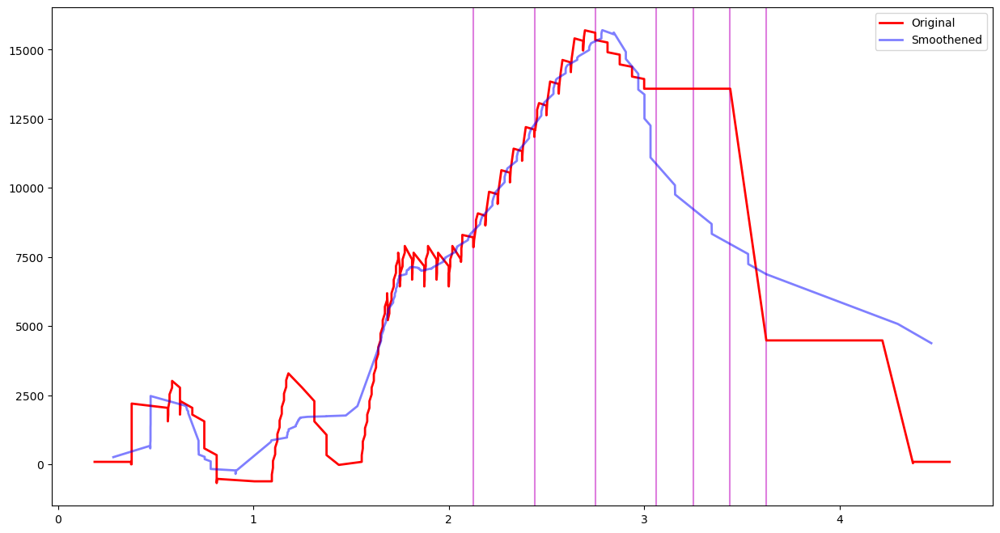

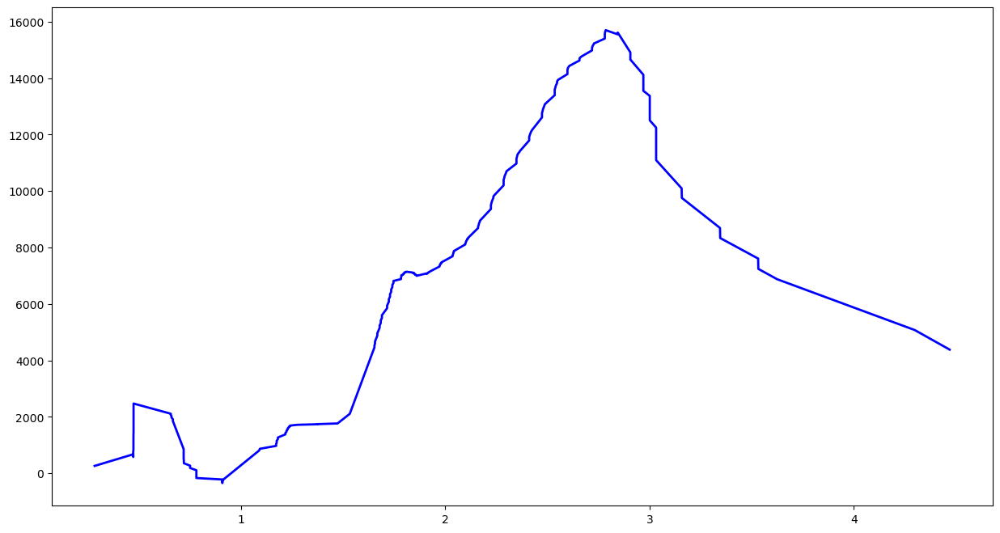

No Feature
../../singapore/top1k/microsoft.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/microsoft.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53154'])
Port 53154


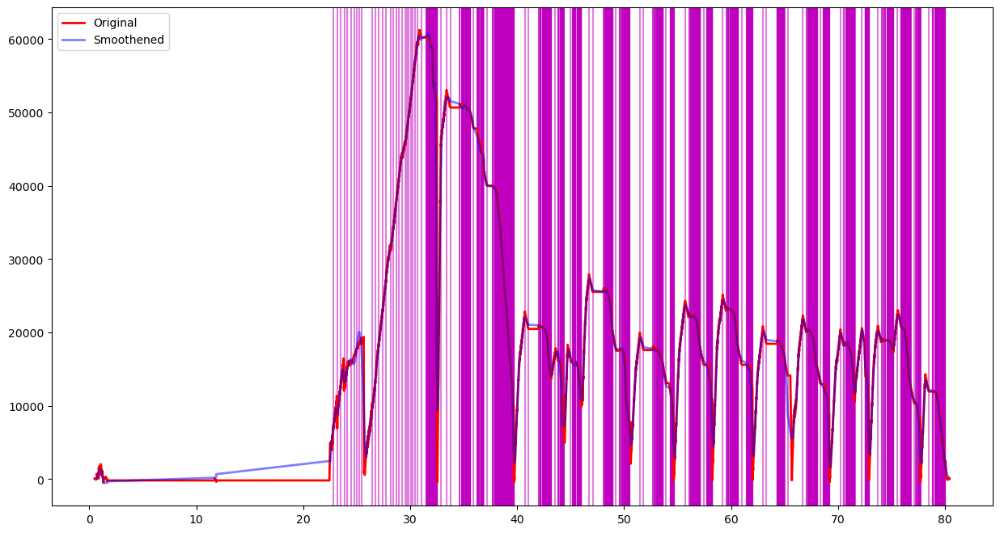

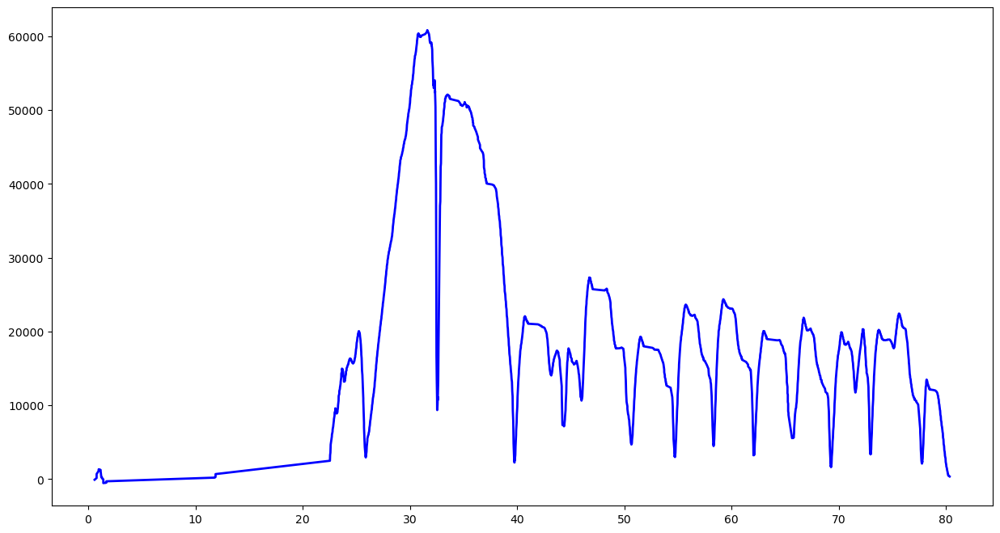

No Feature
../../singapore/top1k/canva.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/canva.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34426', '46168'])
Port 46168


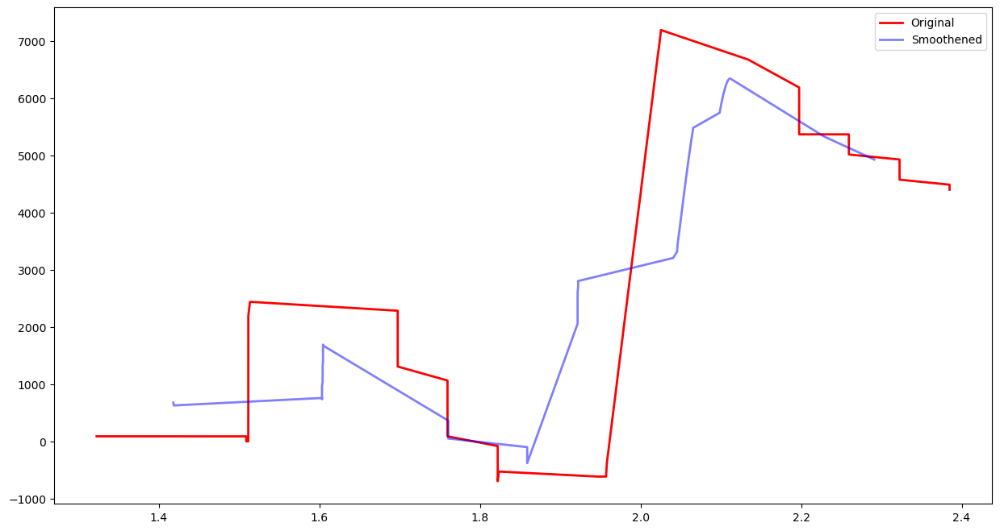

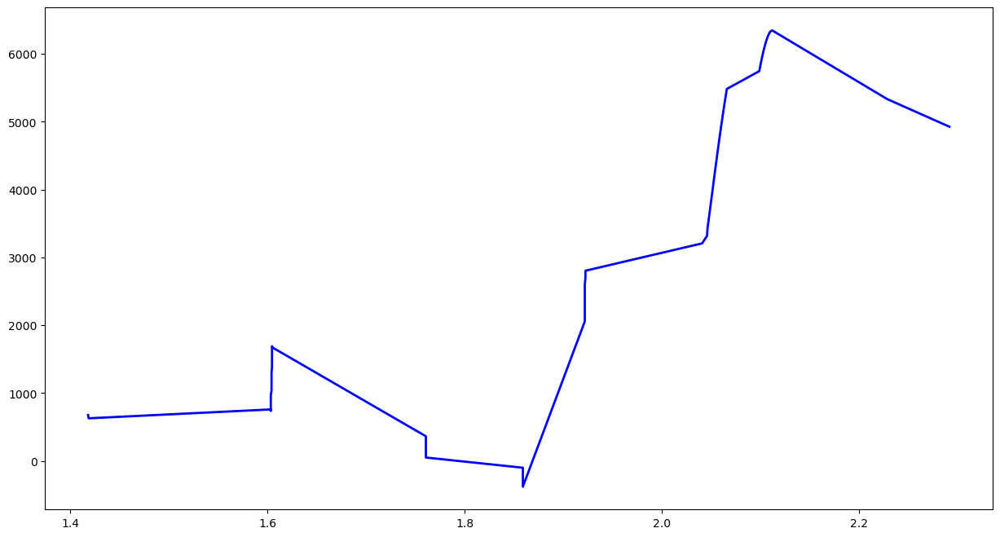

No Feature
../../singapore/top1k/nytimes.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/nytimes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57436'])
Port 57436


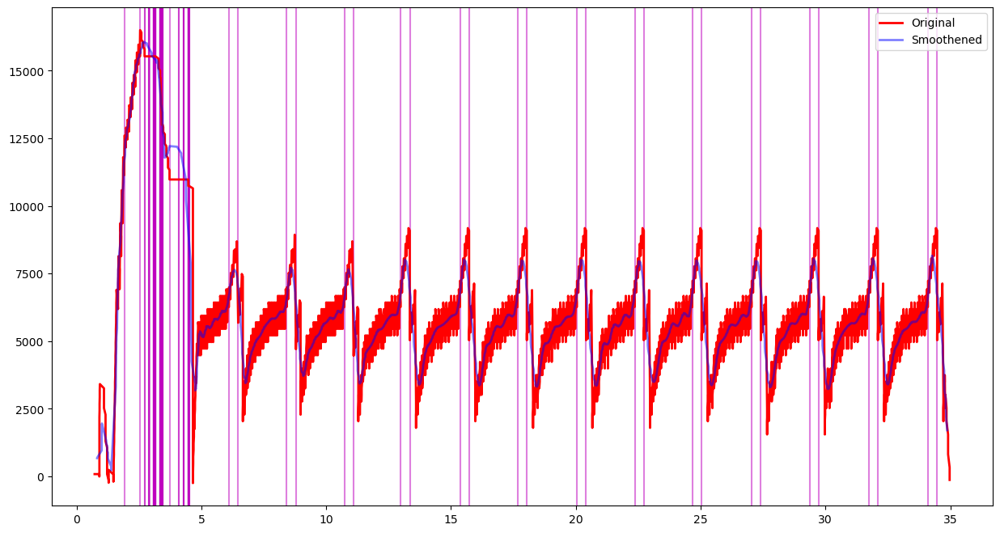

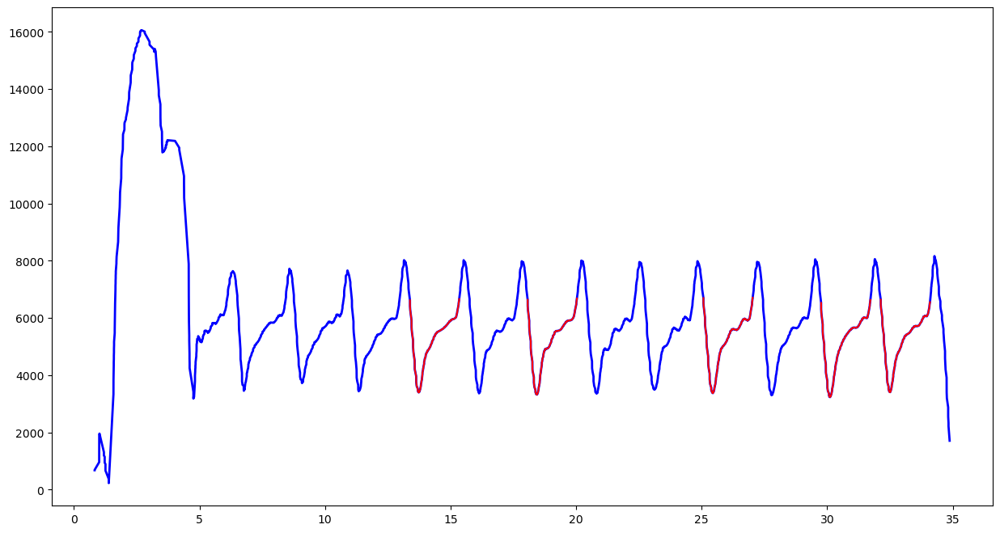

Feature Length  203


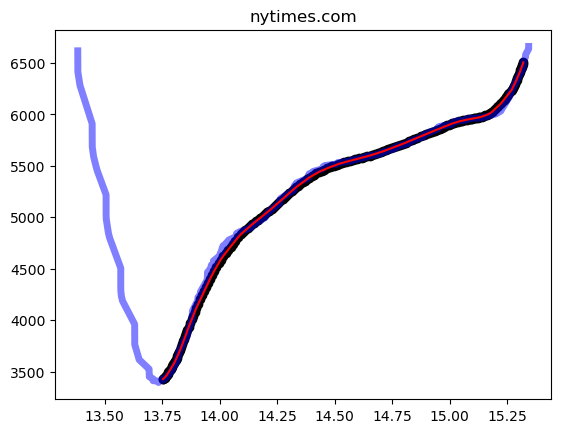

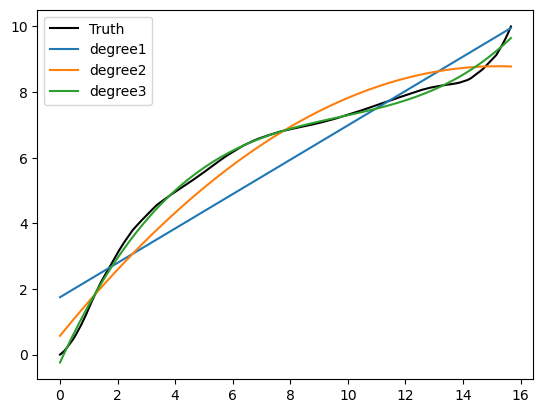

[ 0.00597289 -0.17505717  1.91012275 -0.21611   ]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.9544523e-73 0.0000000e+00 0.0000000e+00 0.0000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/alipay.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/alipay.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43720'])
Port 43720


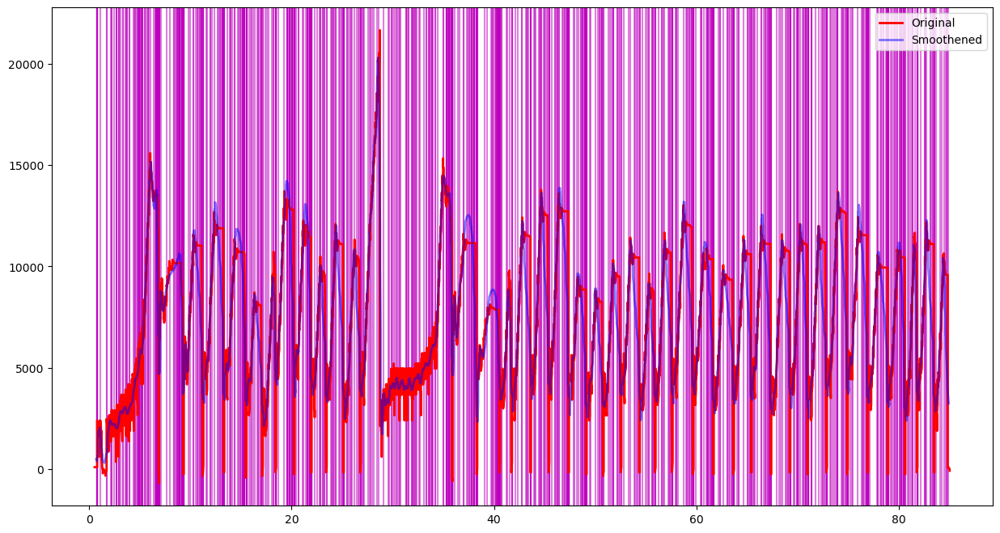

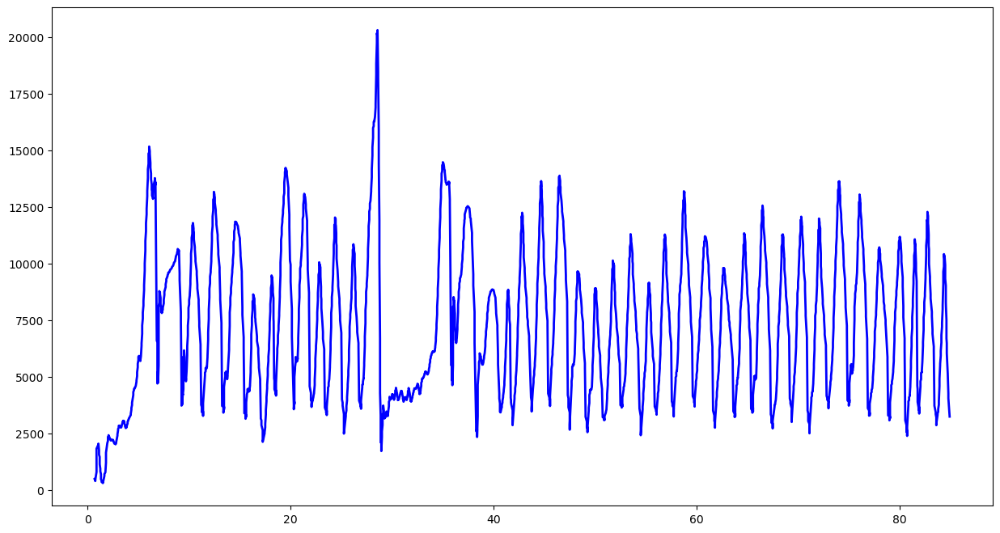

No Feature
../../singapore/top1k/amazon.de-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/amazon.de-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38076'])
Port 38076


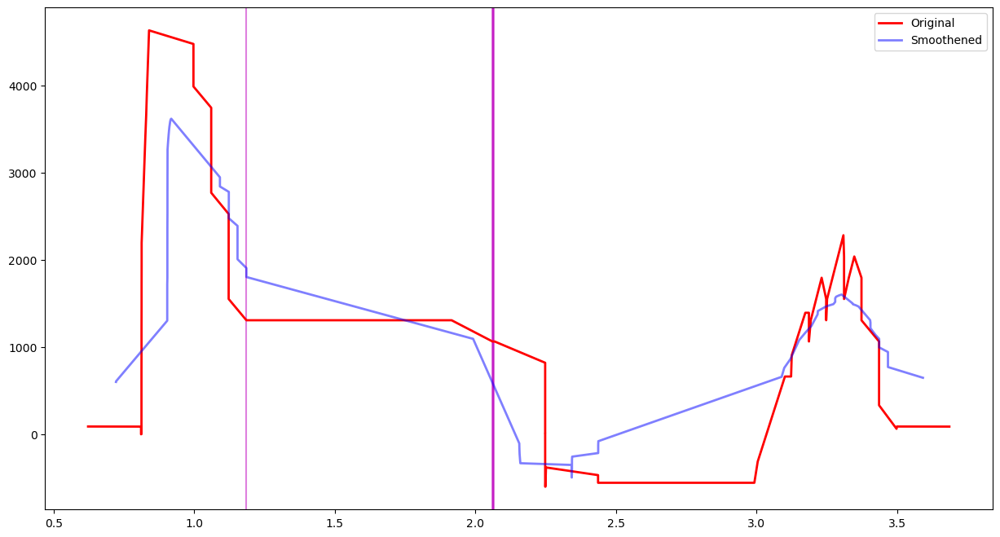

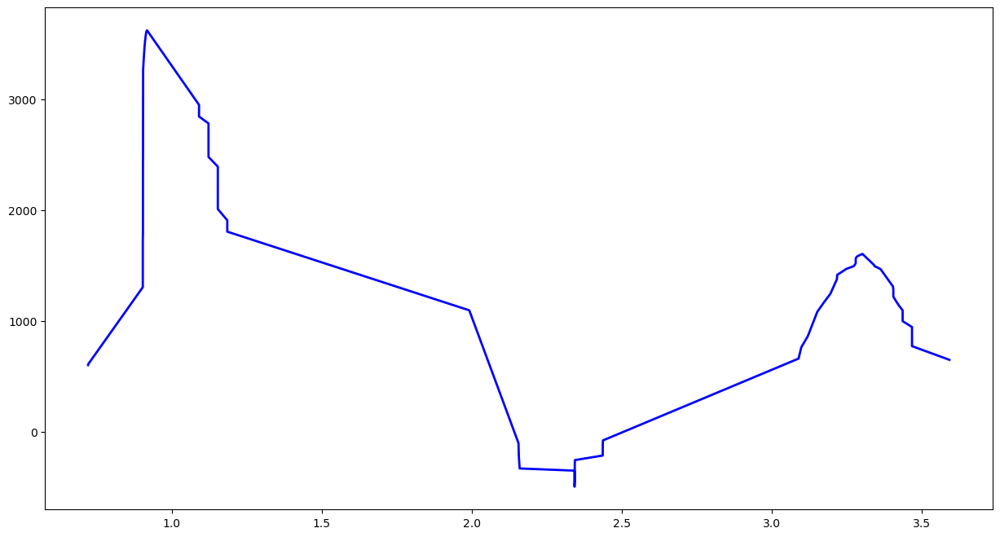

No Feature
../../singapore/top1k/doubleclick.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/doubleclick.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43380'])
Port 43380


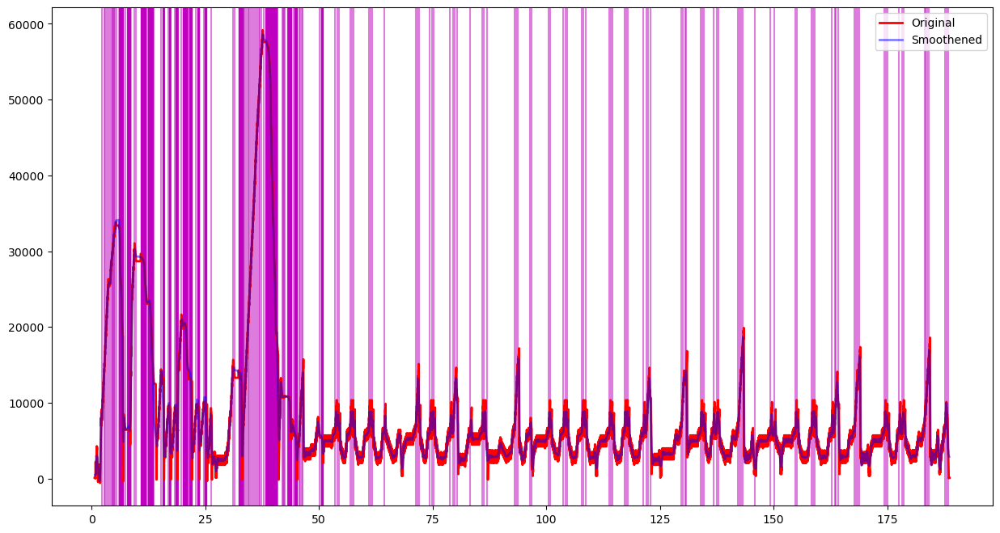

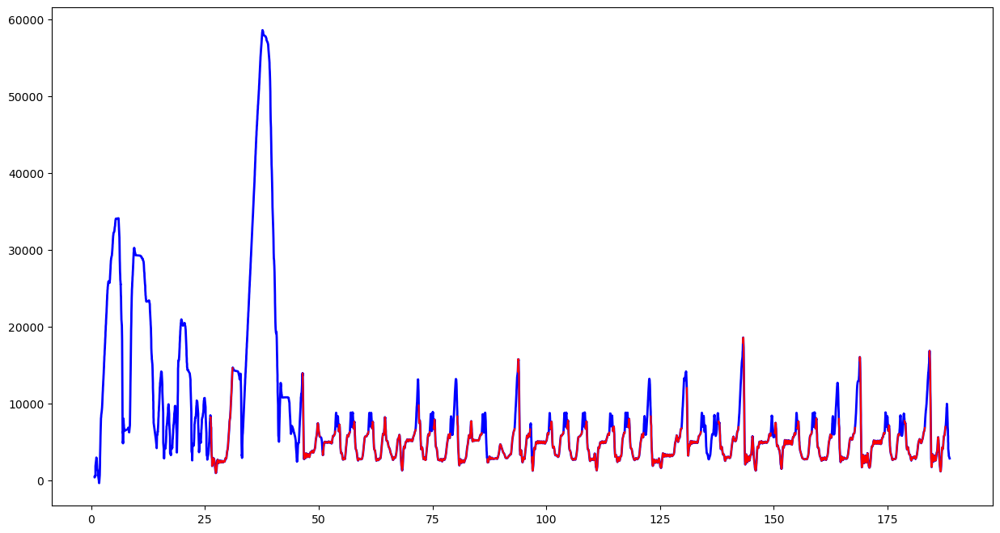

Feature Length  203


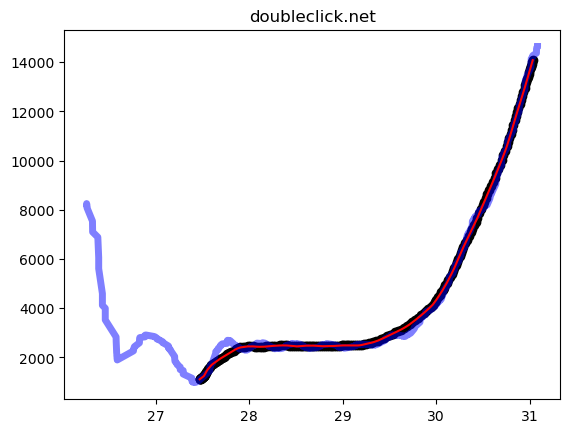

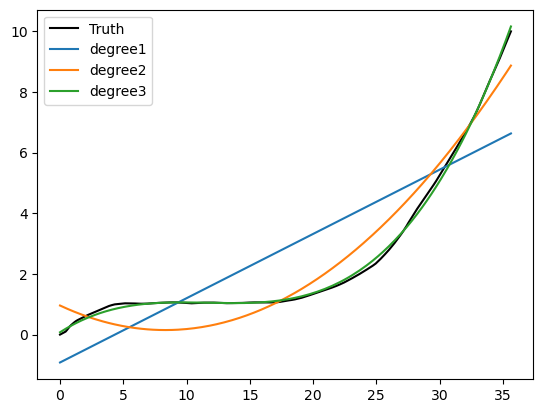

[ 0.00070033 -0.02467994  0.26957068  0.18121893]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [6.31939526e-080 6.85733035e-178 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1.00000000e+00 1.08512446e-98 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/wikia.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/wikia.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44066'])
Port 44066


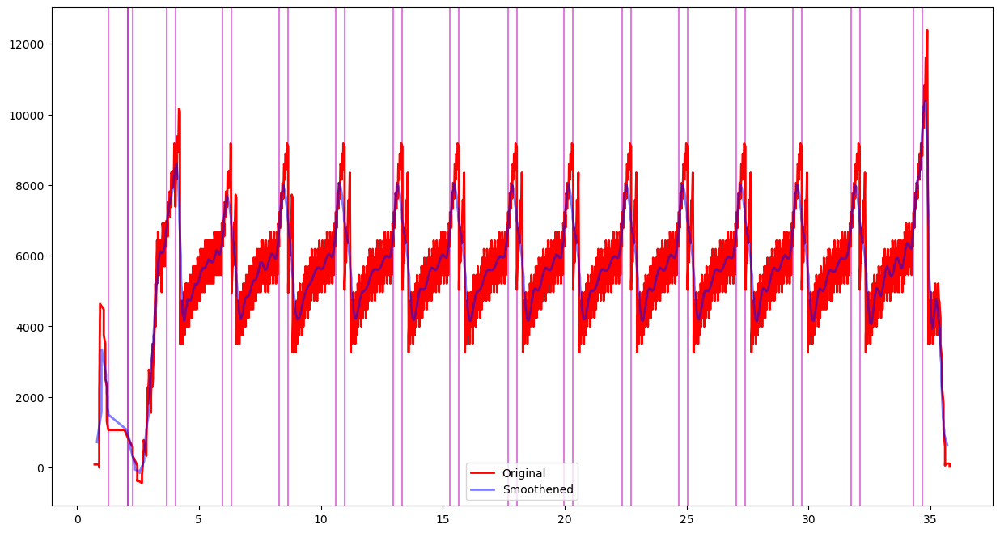

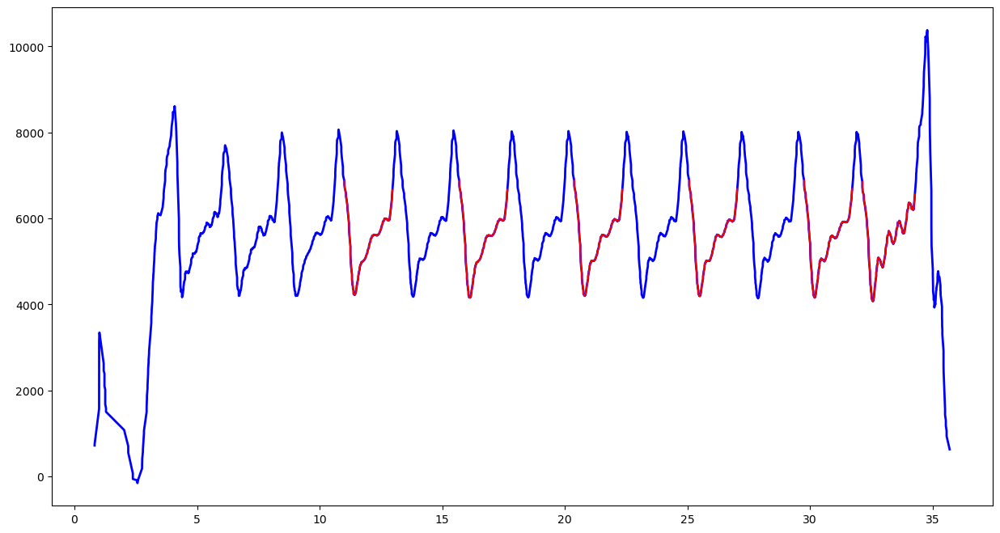

Feature Length  203


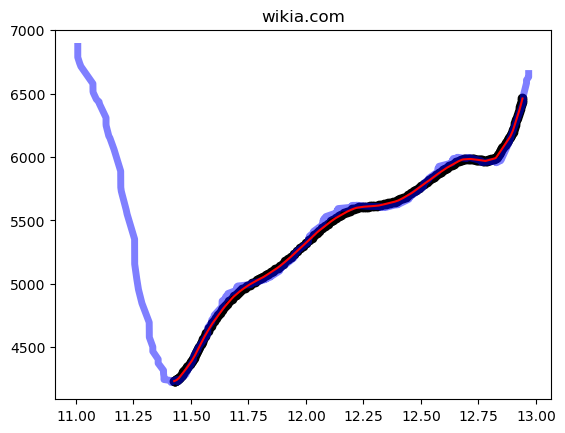

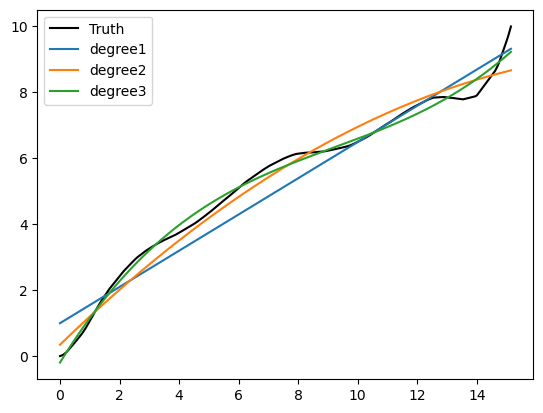

[ 0.00490219 -0.13324972  1.52317917 -0.25885191]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.72895272e-56 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/amazon.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/amazon.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43768'])
Port 43768


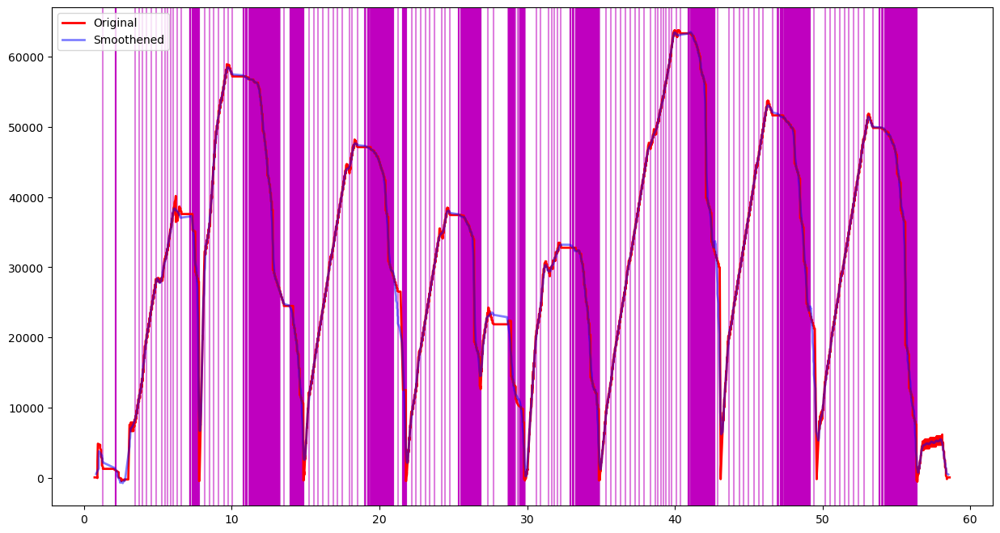

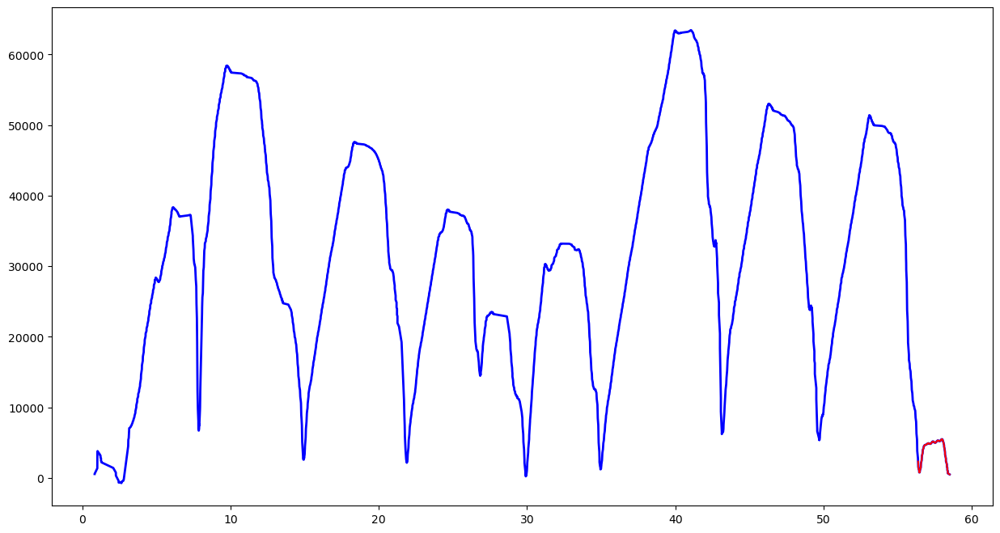

Feature Length  203


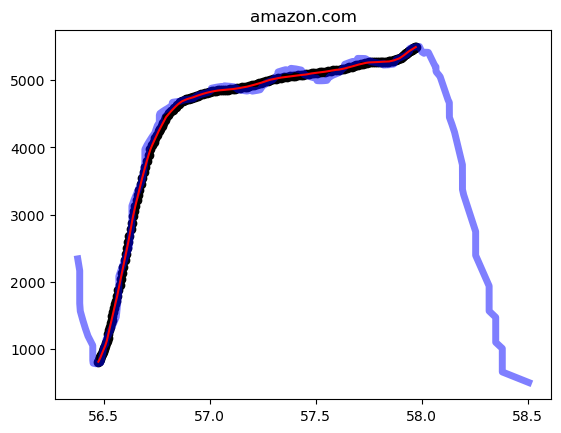

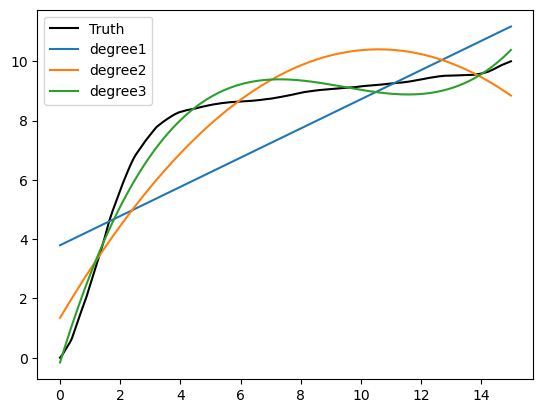

[ 0.01347261 -0.37810753  3.36024198 -0.15656477]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [7.76604054e-83 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/walmart.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/walmart.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54712'])
Port 54712


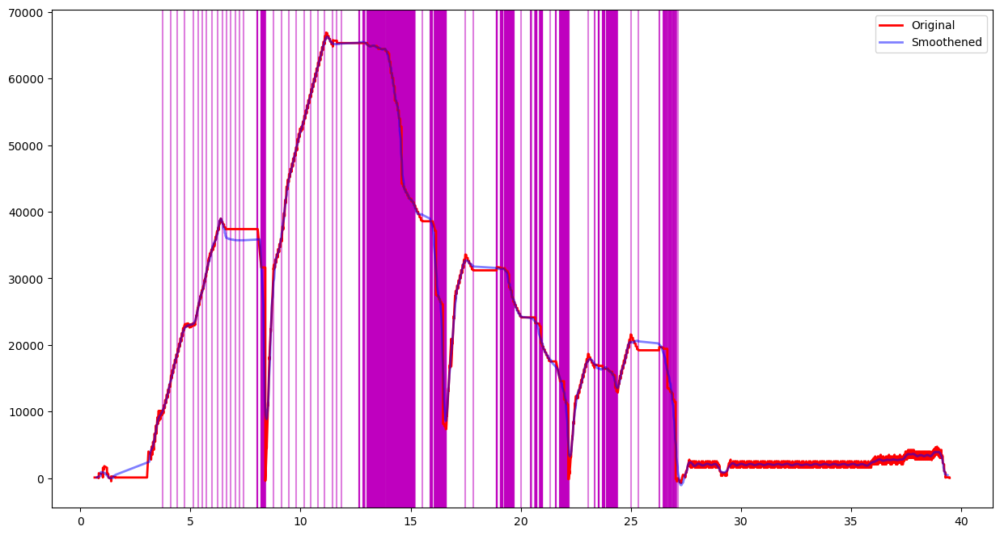

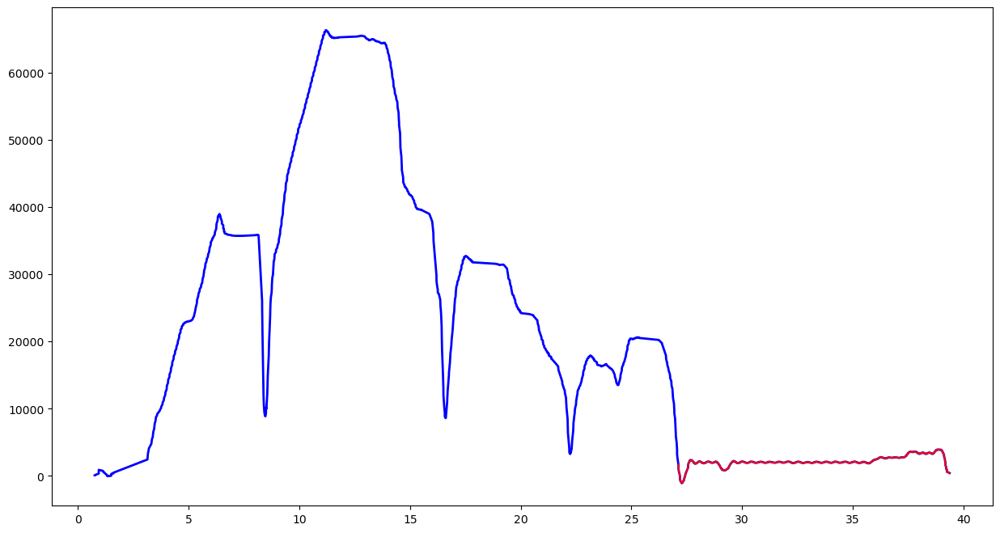

Feature Length  203


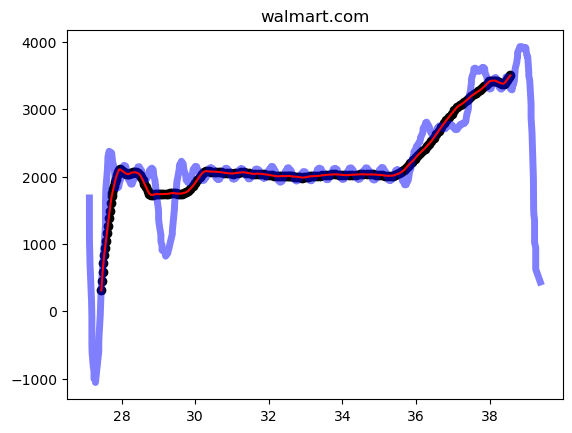

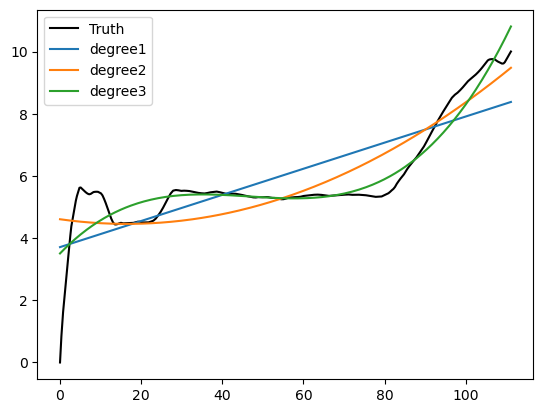

[ 2.20873415e-05 -3.25806899e-03  1.54656506e-01  3.05186839e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.77559220e-006 5.58129430e-048 5.65257472e-129 3.68491889e-306]
Relative Density Values: [1.00000000e+000 3.14334243e-042 3.18348701e-123 0.00000000e+000]
Prediction: new
../../singapore/top1k/google.it-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.it-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54892'])
Port 54892


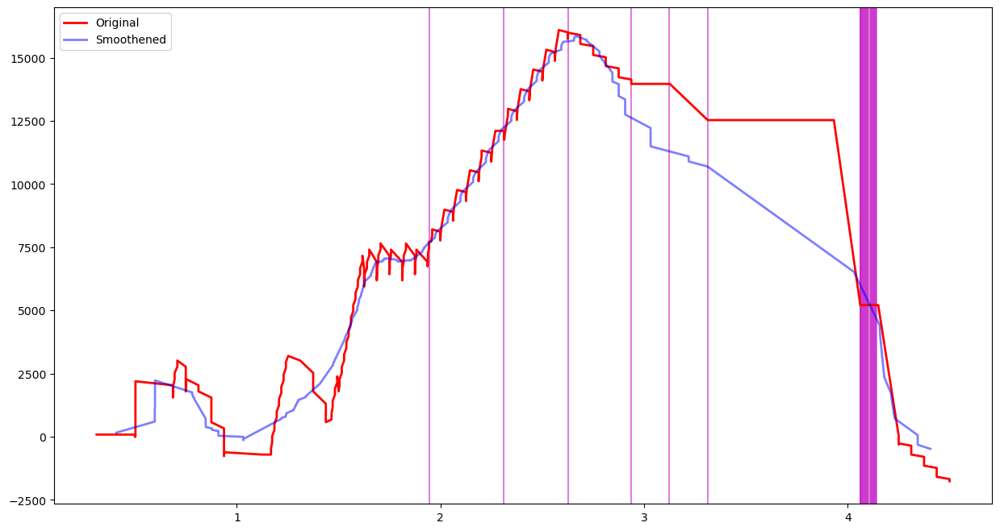

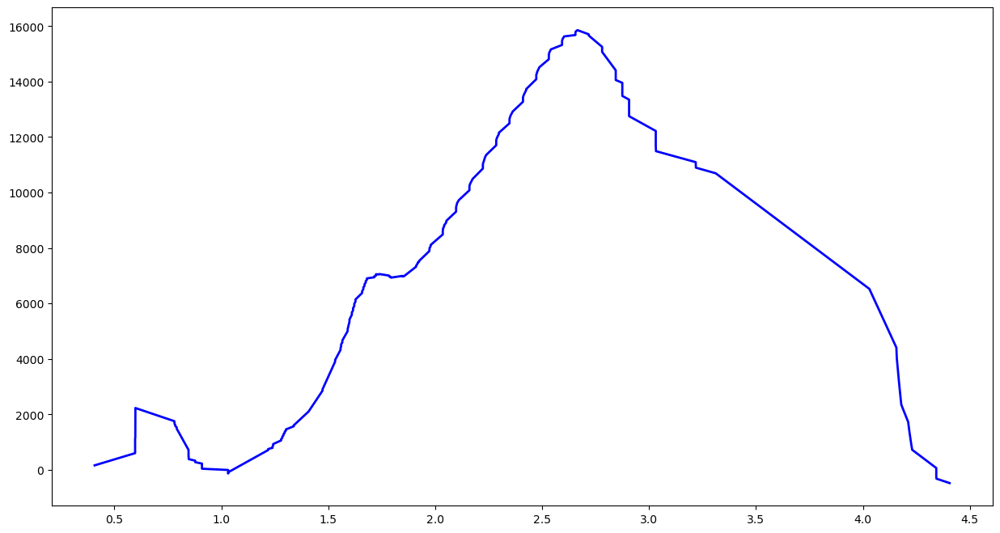

No Feature
../../singapore/top1k/google.se-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.se-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50542'])
Port 50542


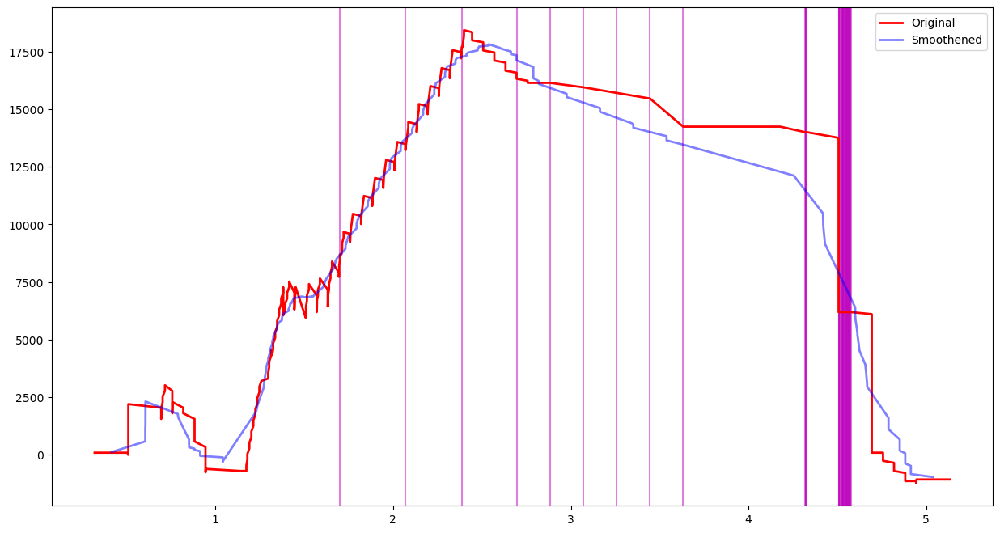

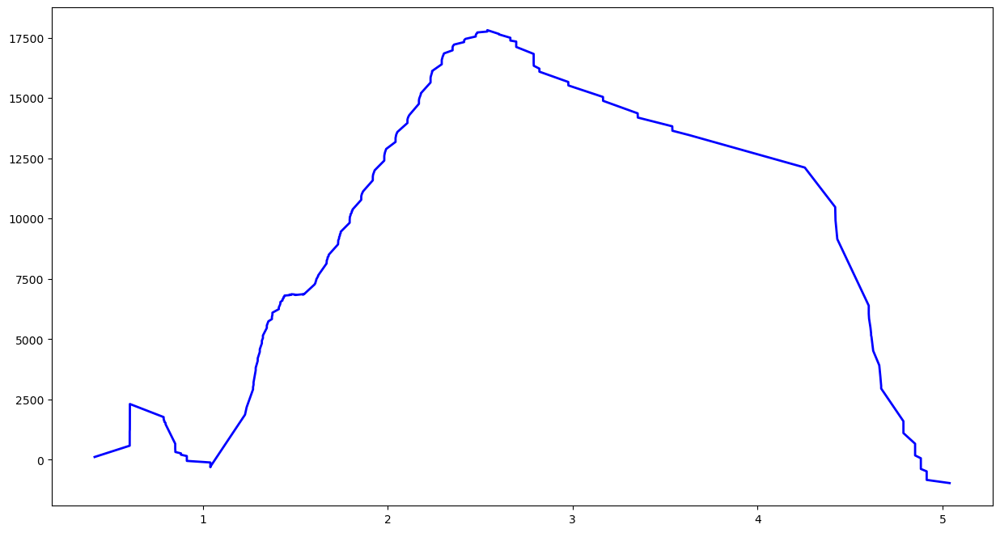

No Feature
../../singapore/top1k/cobalten.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/cobalten.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59272'])
Port 59272


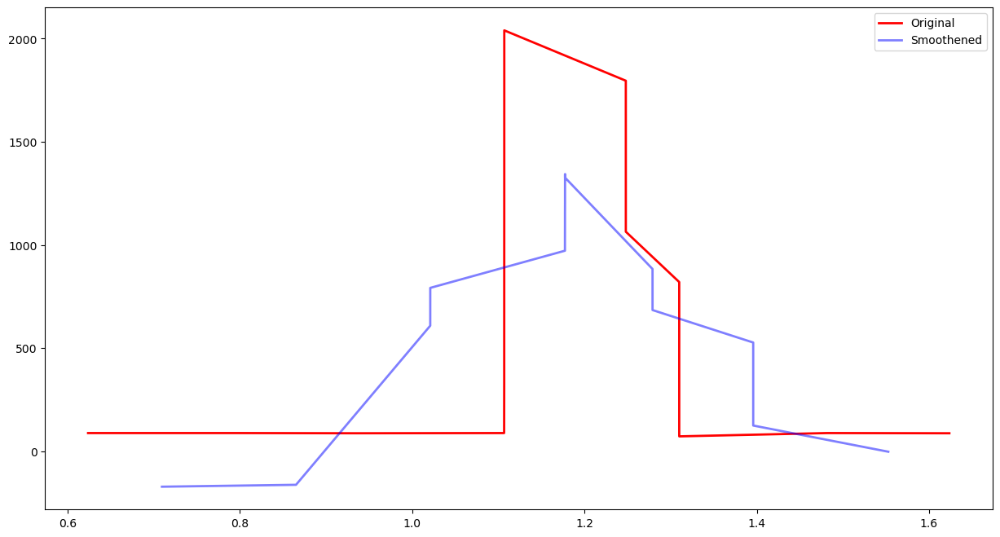

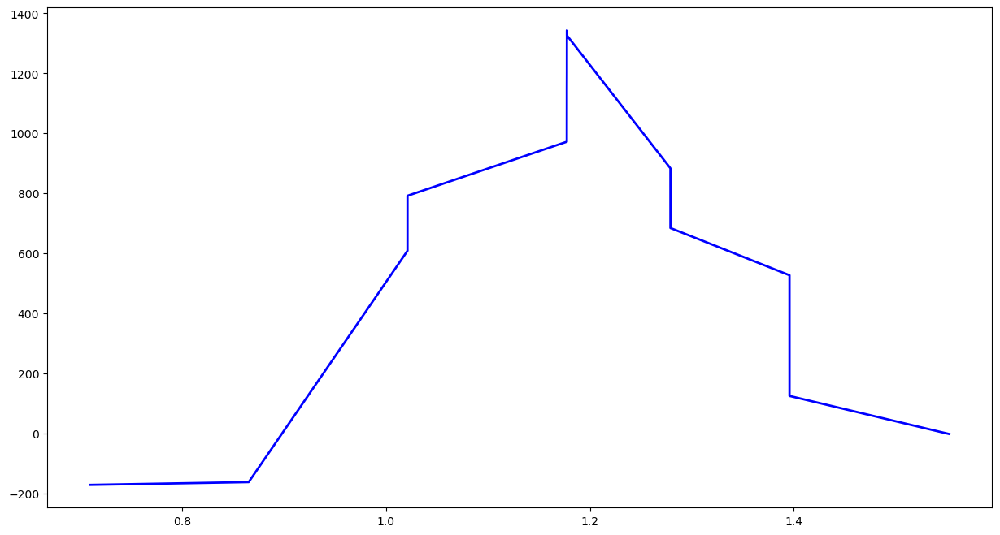

No Feature
../../singapore/top1k/cnn.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/cnn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59346'])
Port 59346


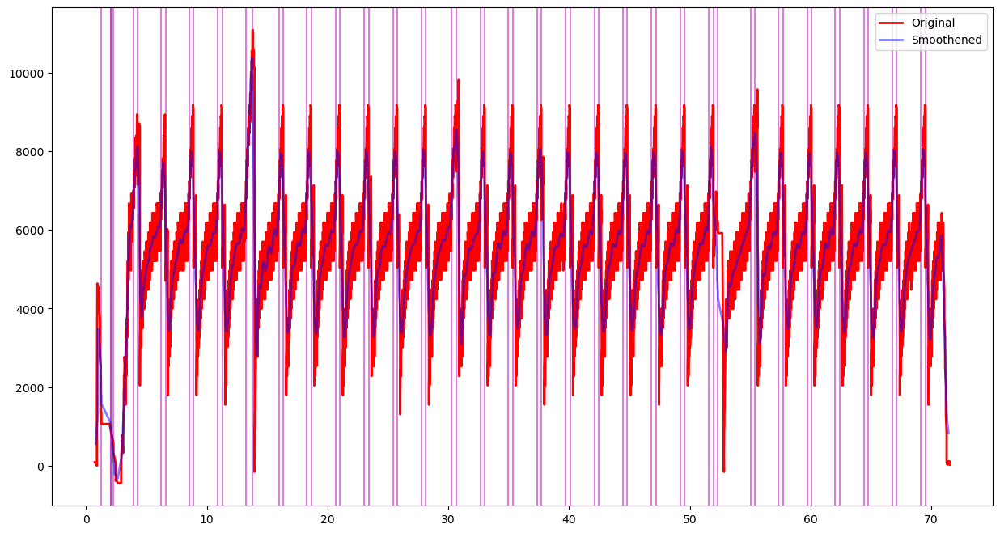

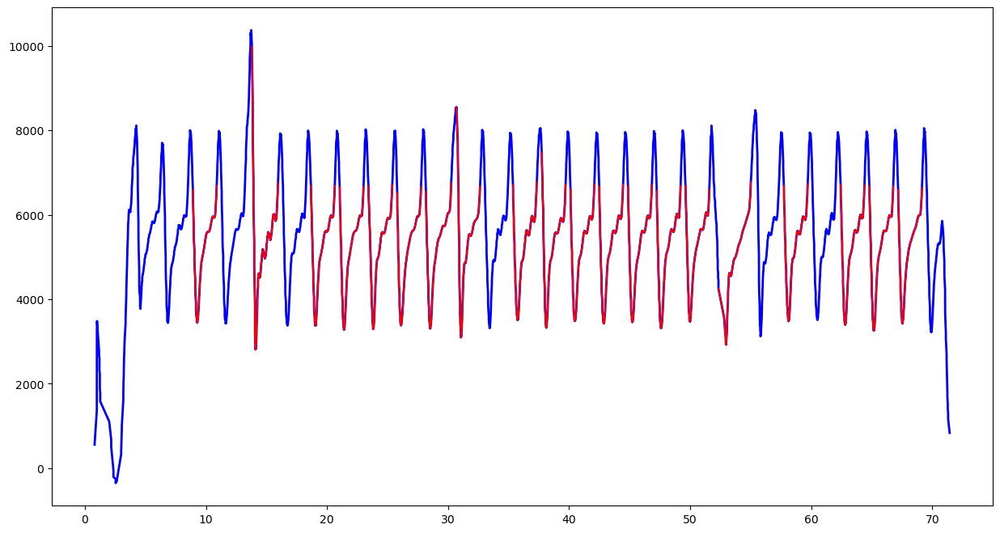

Feature Length  203


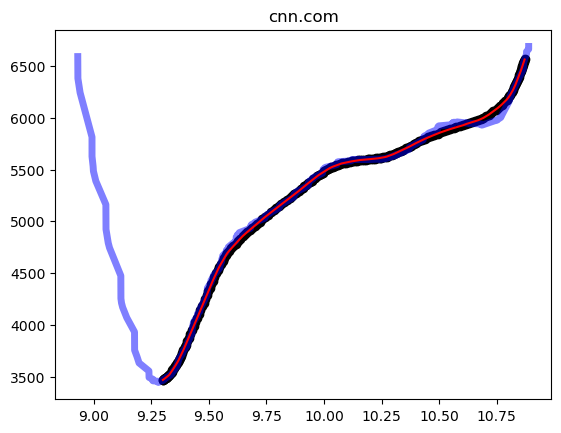

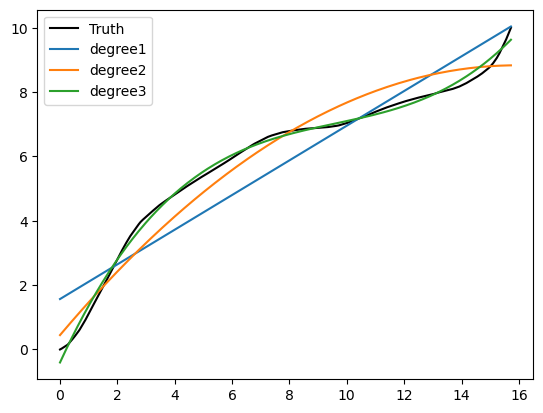

[ 0.00603212 -0.17670169  1.91938996 -0.38779466]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [2.16341168e-72 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/wikihow.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/wikihow.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54102'])
Port 54102


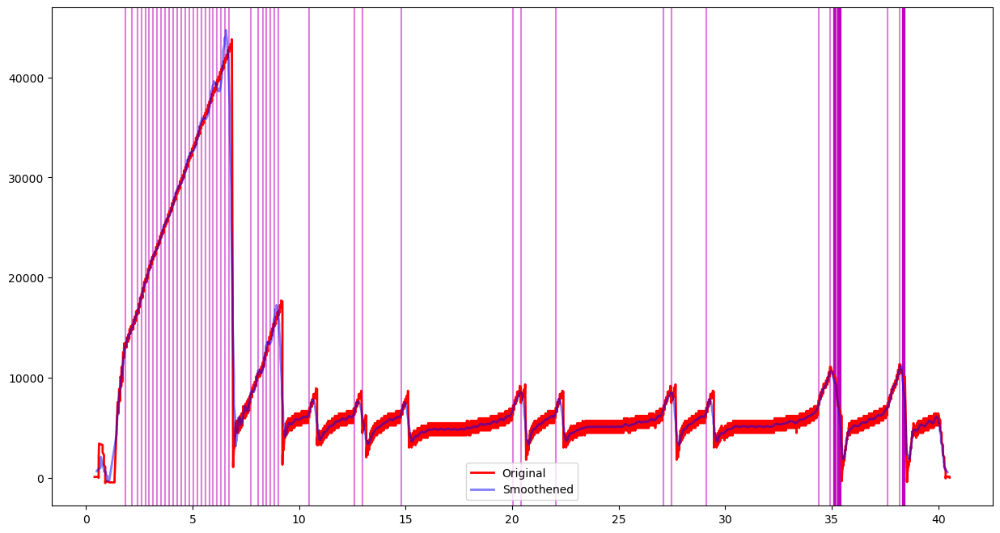

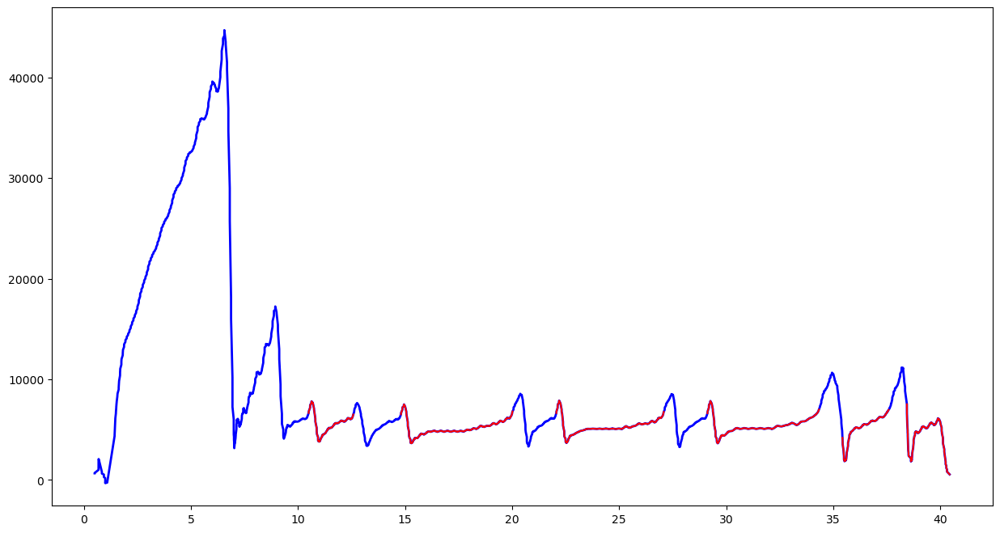

Feature Length  203


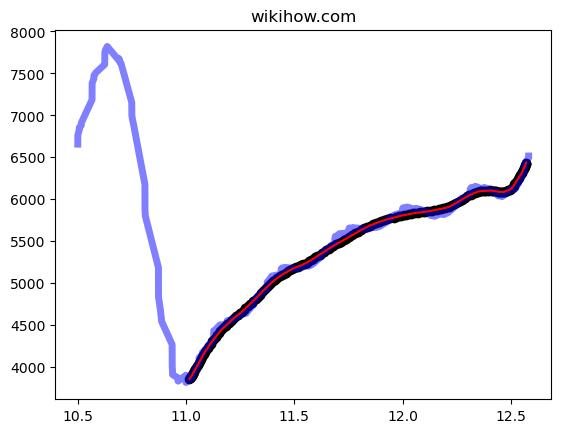

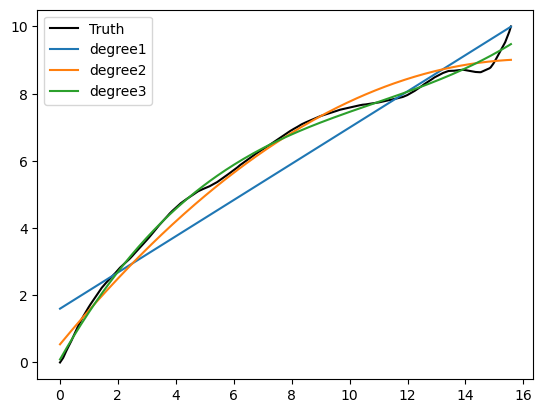

[-0.03452946  1.08039905  0.6088743 ]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/zhanqi.tv-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/zhanqi.tv-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57854'])
Port 57854


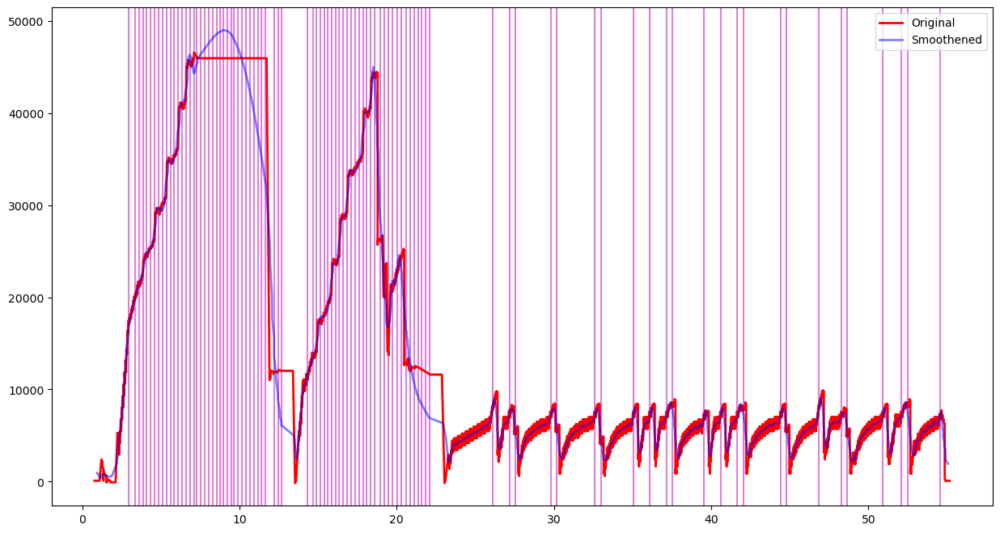

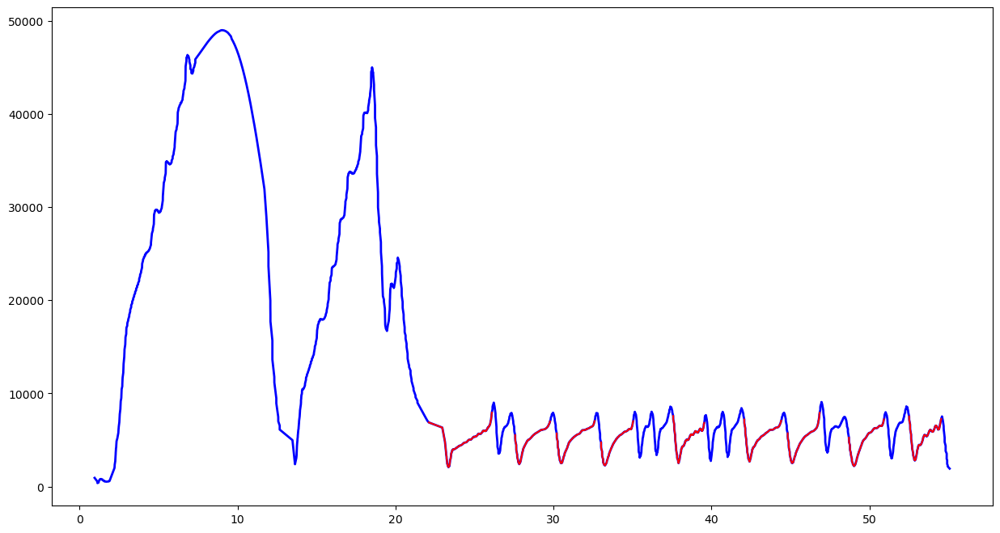

Feature Length  203


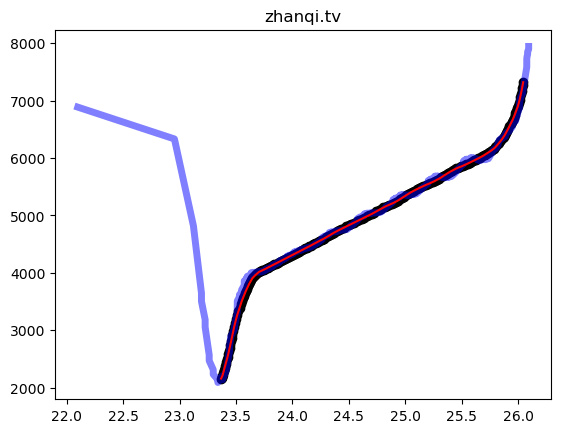

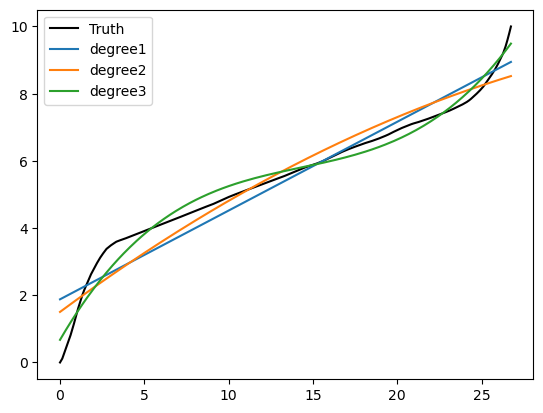

[ 0.00129198 -0.05517187  0.87358903  0.52115683]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.43050472e-55 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/baidu.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/baidu.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49590', '50828'])
Port 50828


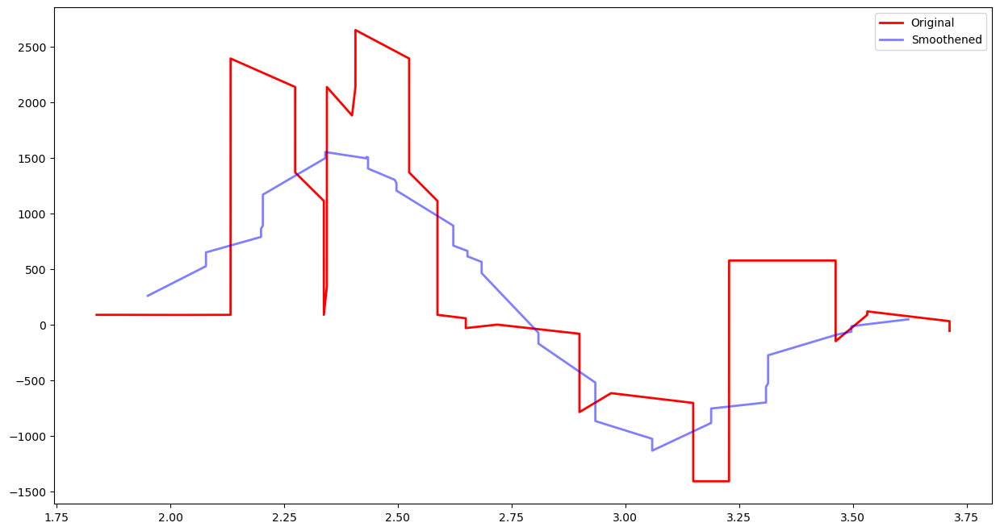

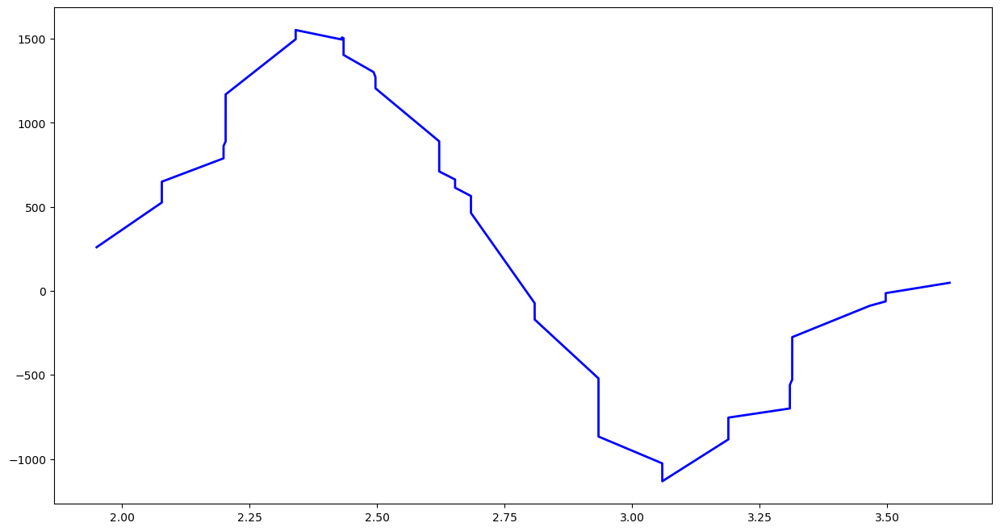

No Feature
../../singapore/top1k/amazonaws.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/amazonaws.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38766'])
Port 38766


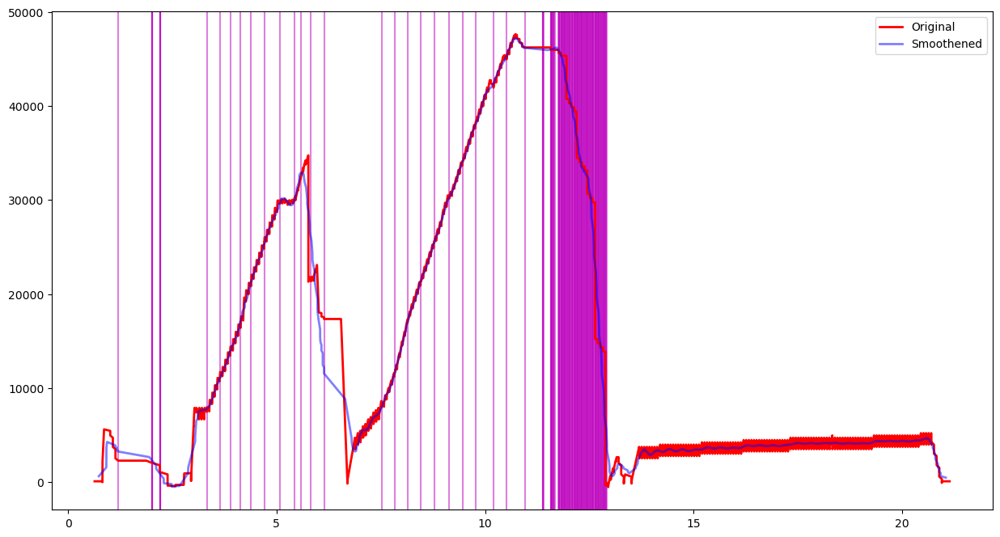

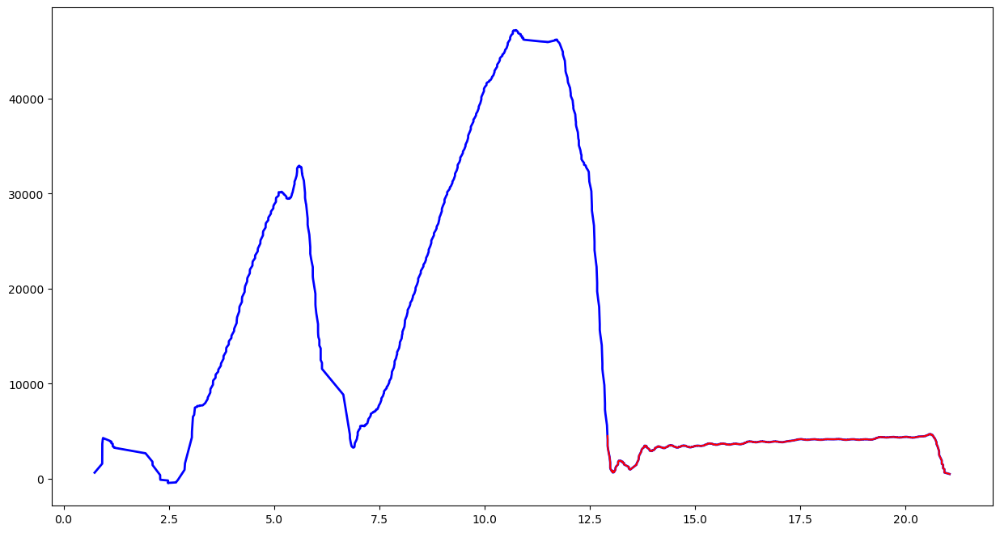

Feature Length  203


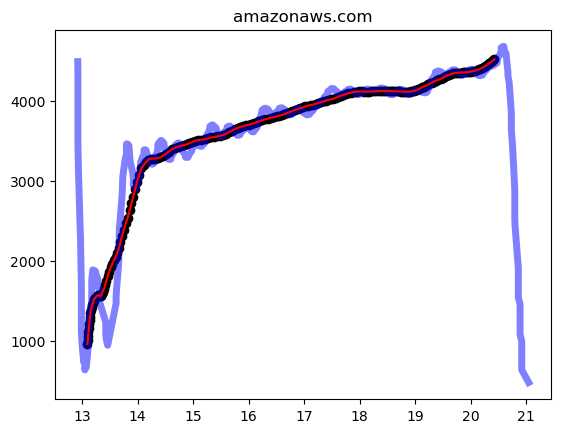

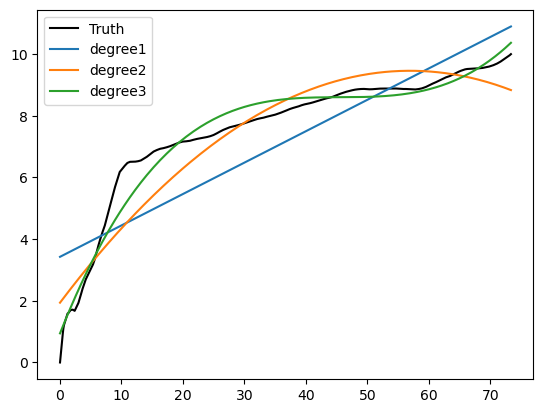

[ 8.49960163e-05 -1.16266632e-02  5.25615651e-01  5.57005334e-01]
Top 5 CCS : ['htcp', 'veno', 'cubic', 'vegas']
Density Values: [2.08719637e-036 7.21347058e-091 2.68714845e-110 0.00000000e+000]
Relative Density Values: [1.00000000e+00 3.45605746e-55 1.28744400e-74 0.00000000e+00]
Prediction: new
../../singapore/top1k/ci123.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/ci123.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46452'])
Port 46452


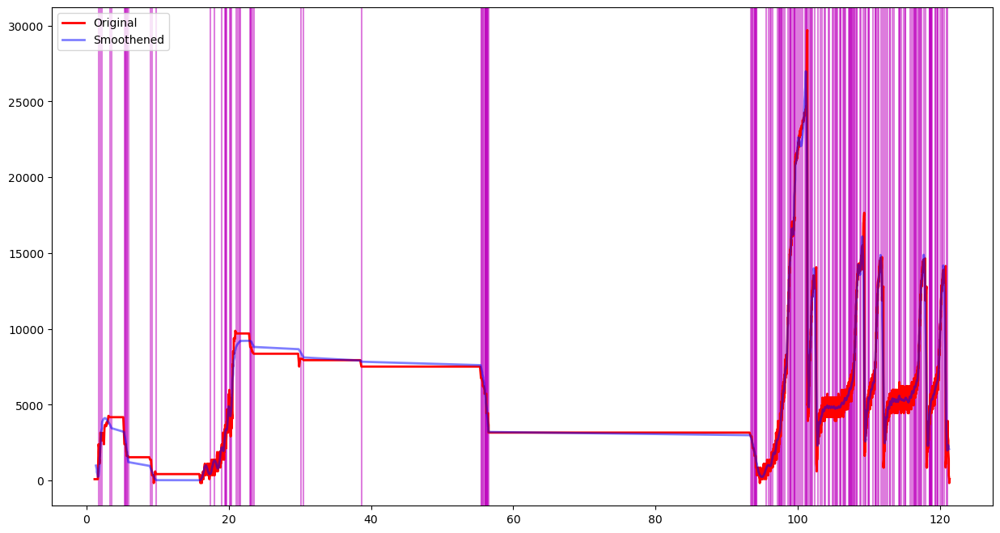

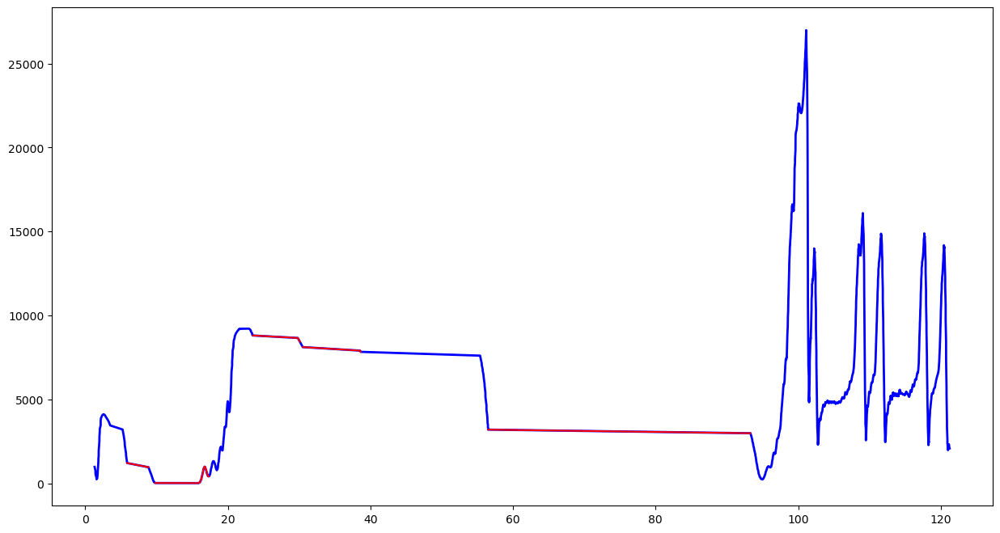

Feature Length  203


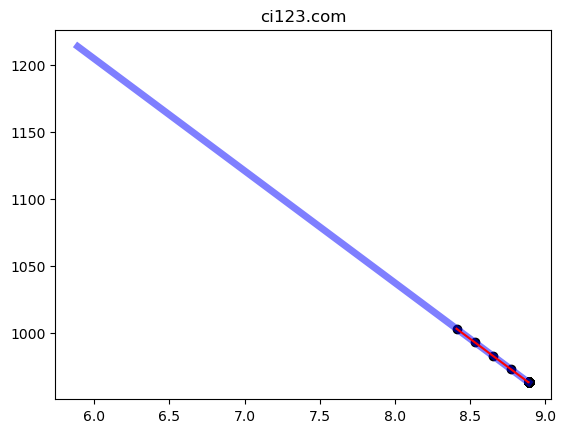

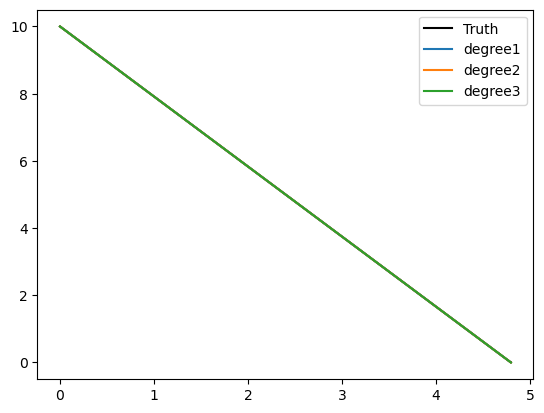

[-2.77989142 10.        ]
Top 5 CCS : ['scalable', 'nv', 'yeah', 'bic']
Density Values: [1.34044471e-27 5.11219571e-40 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 3.81380573e-13 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/tokopedia.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/tokopedia.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45358', '36972', '55490', '38786', '53992', '44964', '50682', '60154', '34460', '41518', '34426', '50532', '46844', '45430', '53594', '55838', '47204', '51790', '35770', '48606'])
Port 36972


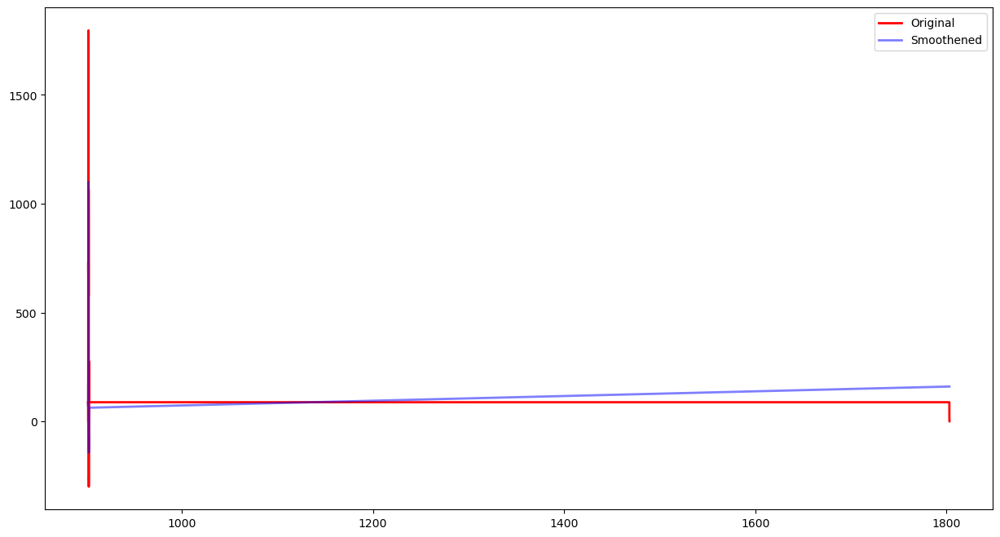

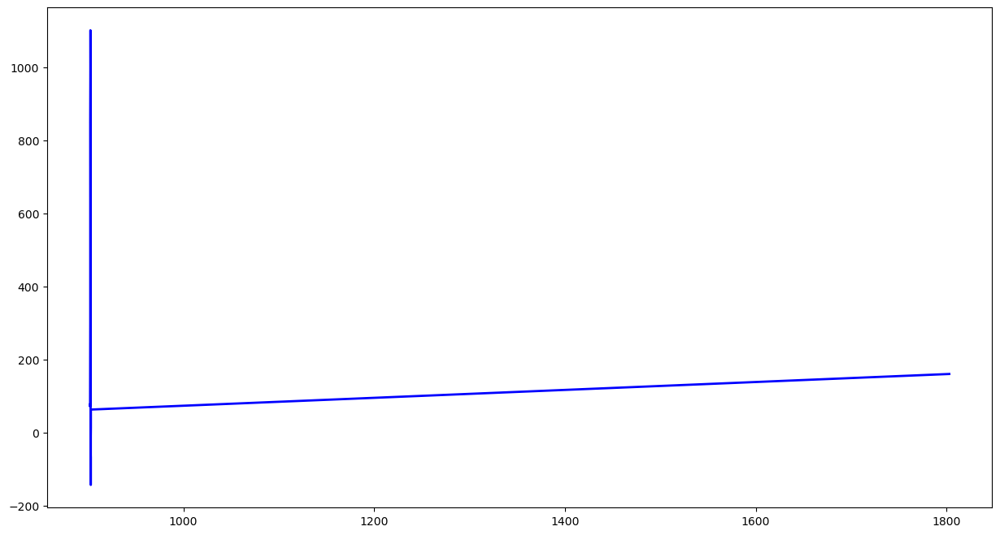

No Feature
../../singapore/top1k/upornia.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/upornia.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57116'])
Port 57116


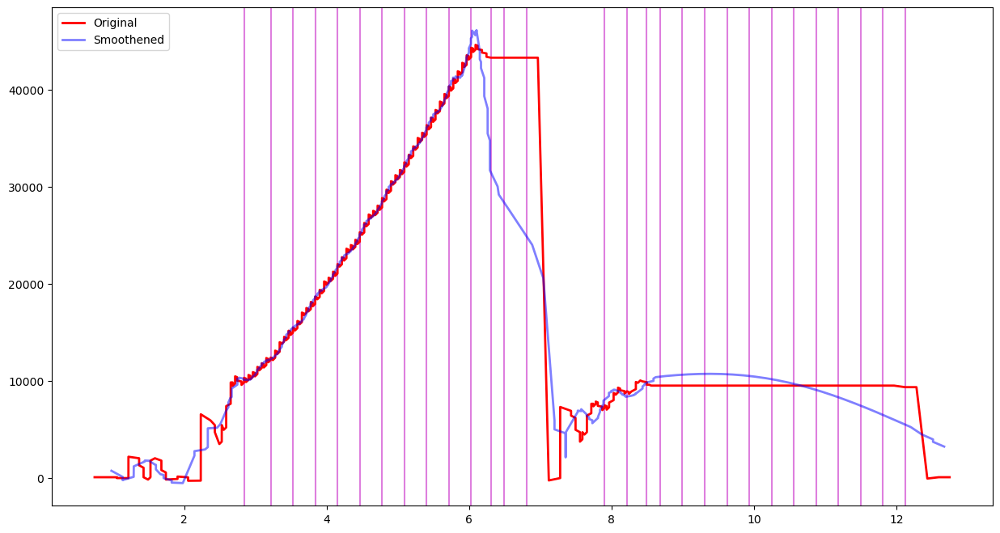

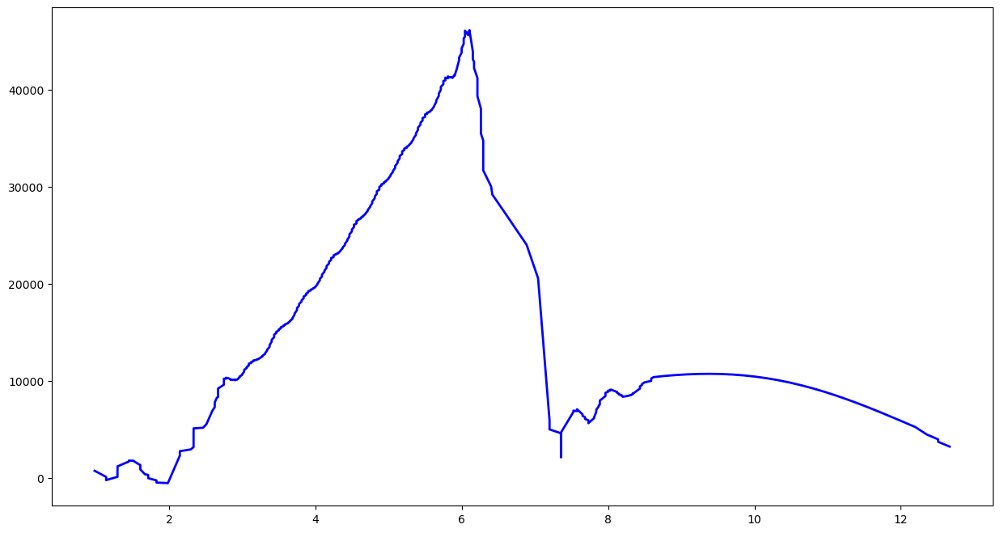

No Feature
../../singapore/top1k/wetransfer.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/wetransfer.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39772'])
Port 39772


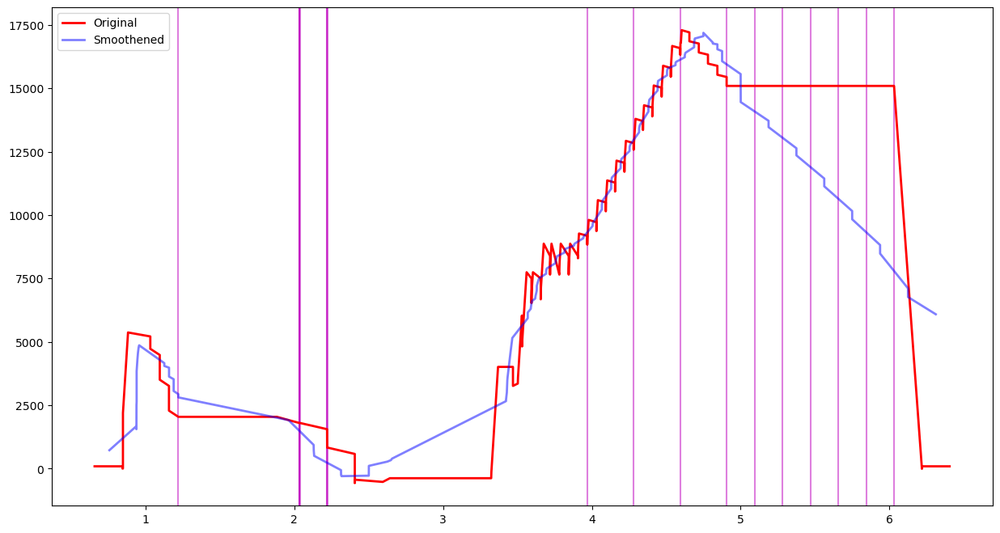

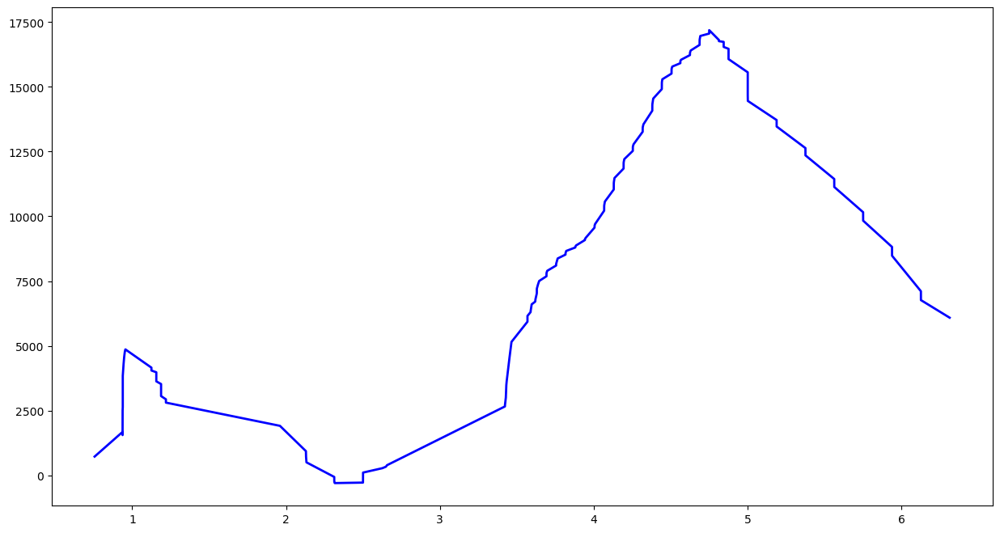

No Feature
../../singapore/top1k/google.com.au-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.au-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39926'])
Port 39926


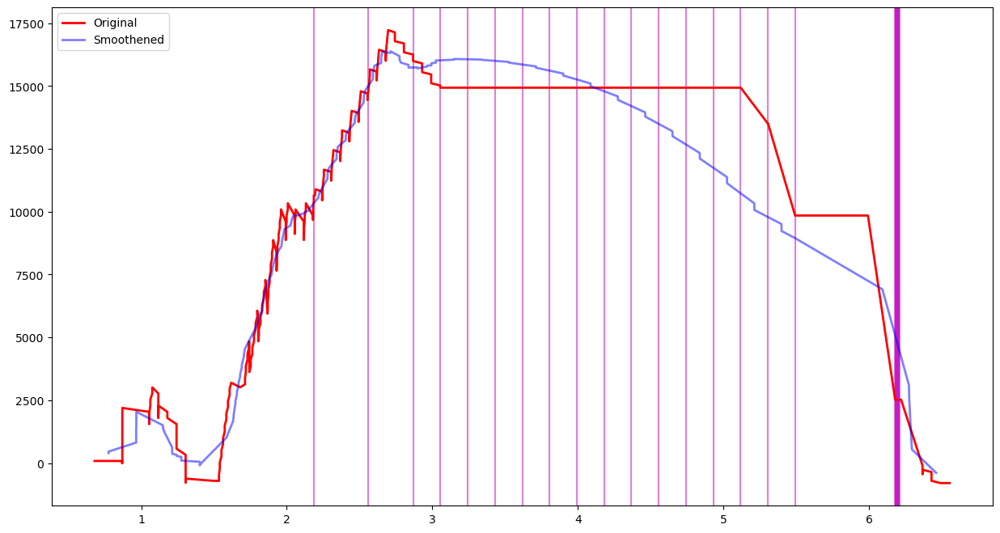

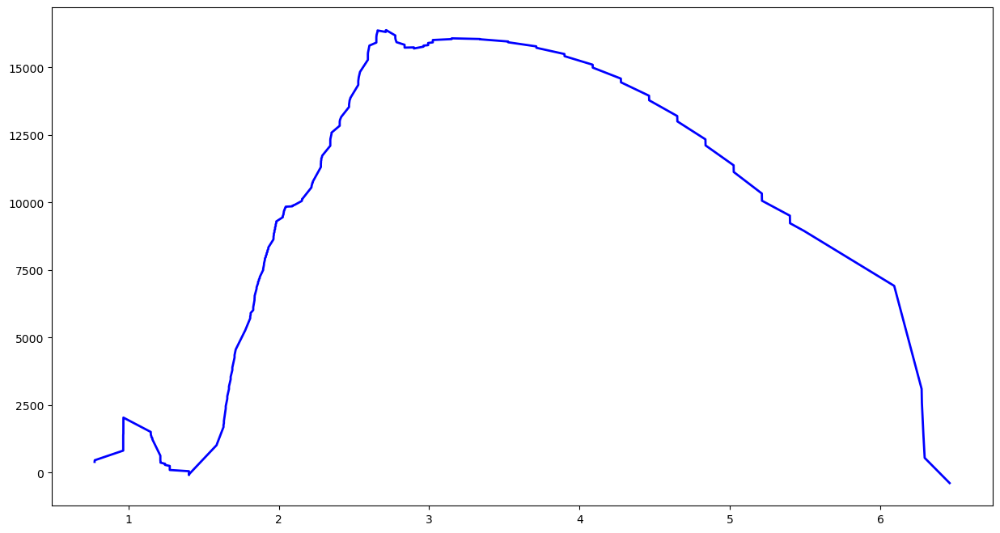

No Feature
../../singapore/top1k/taobao.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/taobao.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50388', '51876'])
Port 51876


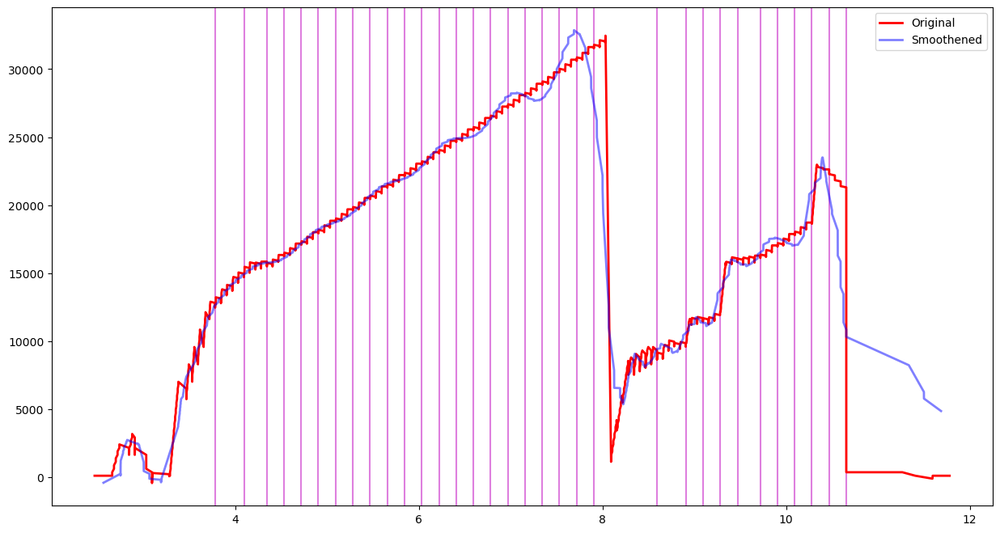

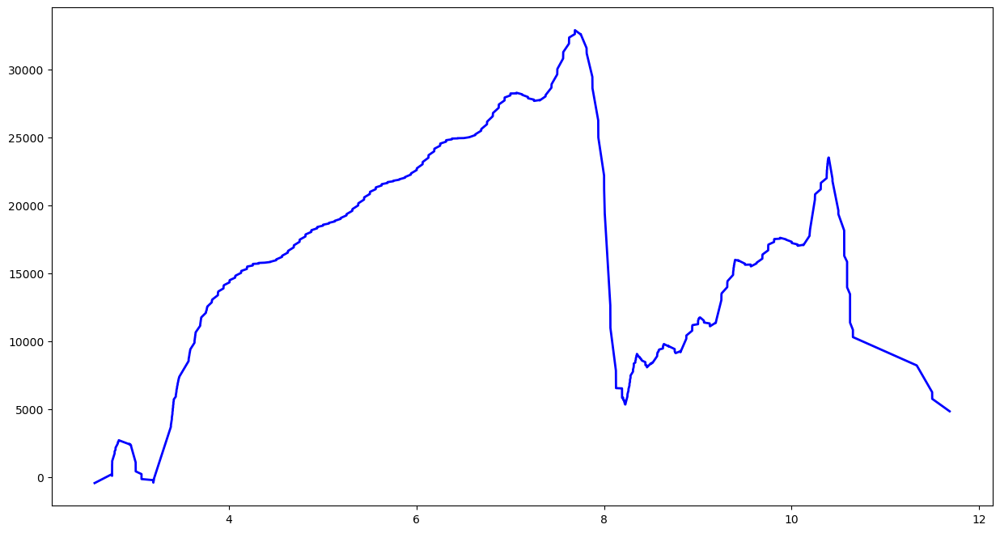

No Feature
../../singapore/top1k/twitch.tv-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/twitch.tv-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42414'])
Port 42414


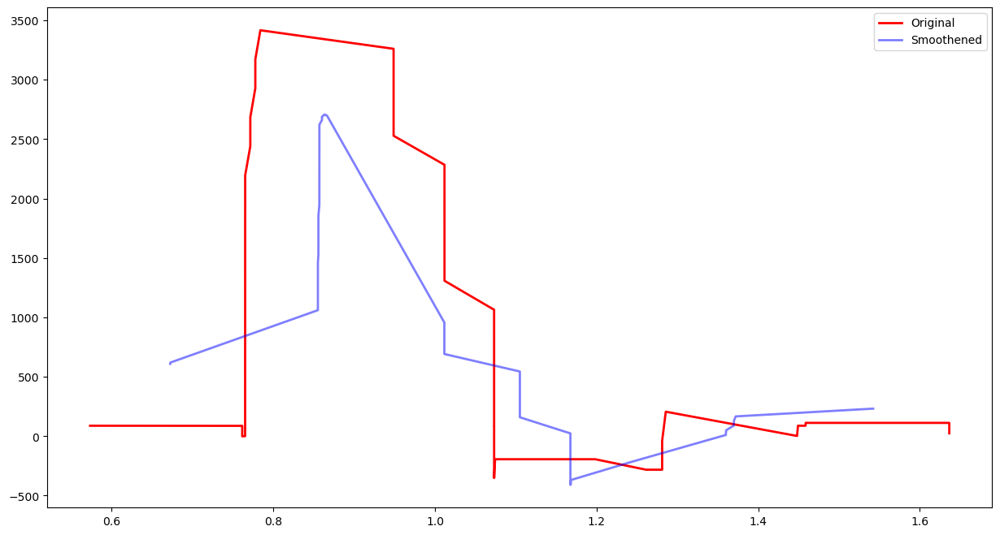

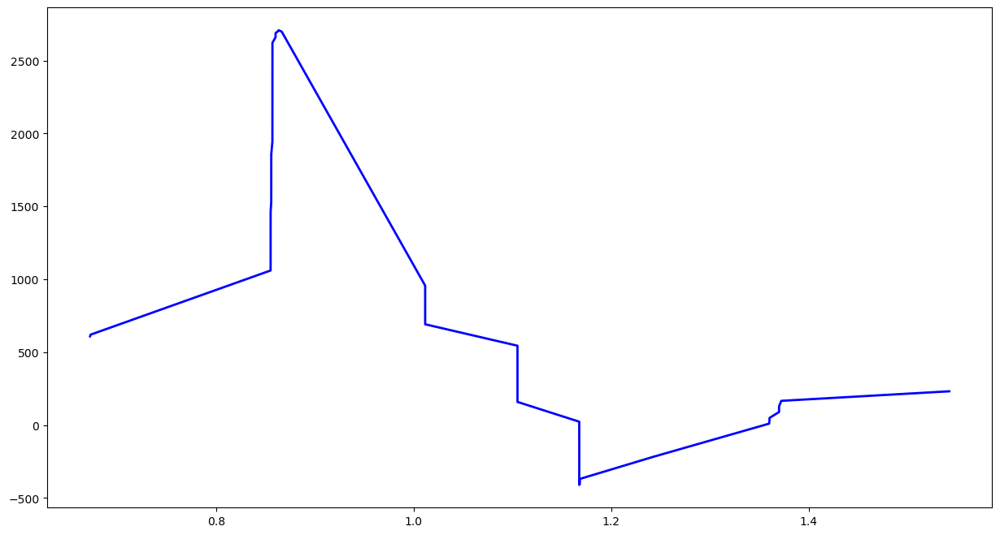

No Feature
../../singapore/top1k/china.com.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/china.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52290'])
Port 52290


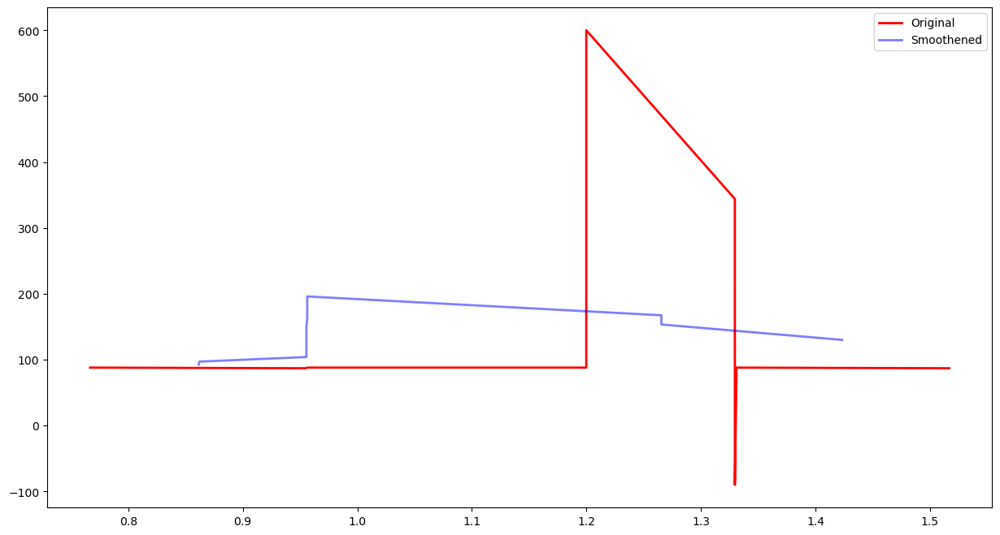

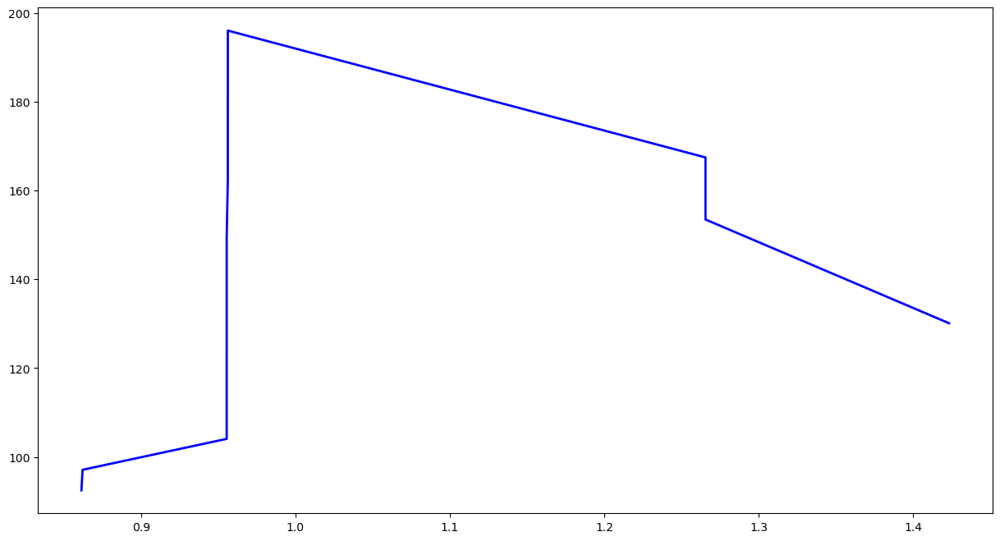

No Feature
../../singapore/top1k/mediafire.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/mediafire.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55800', '55804'])
Port 55804


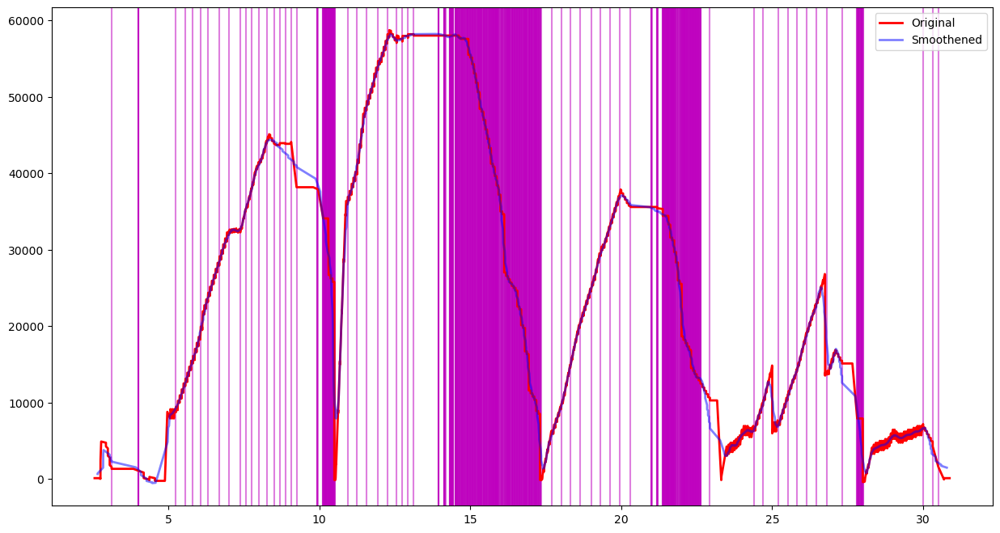

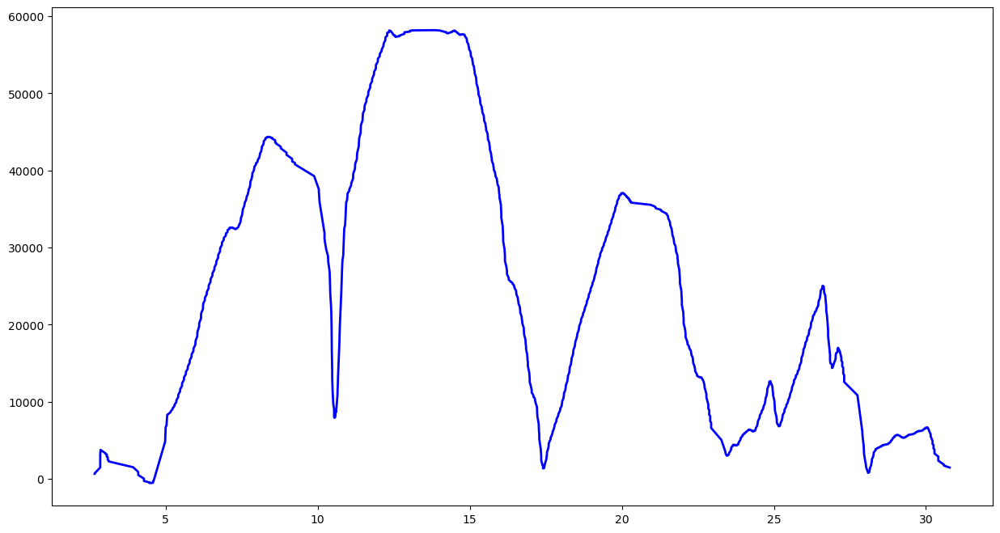

No Feature
../../singapore/top1k/google.com.sa-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.sa-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36176'])
Port 36176


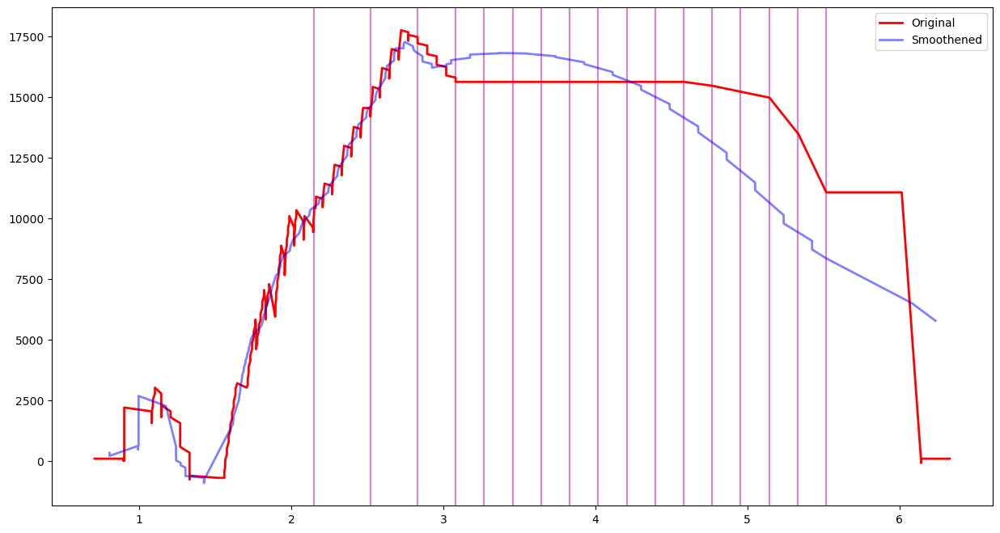

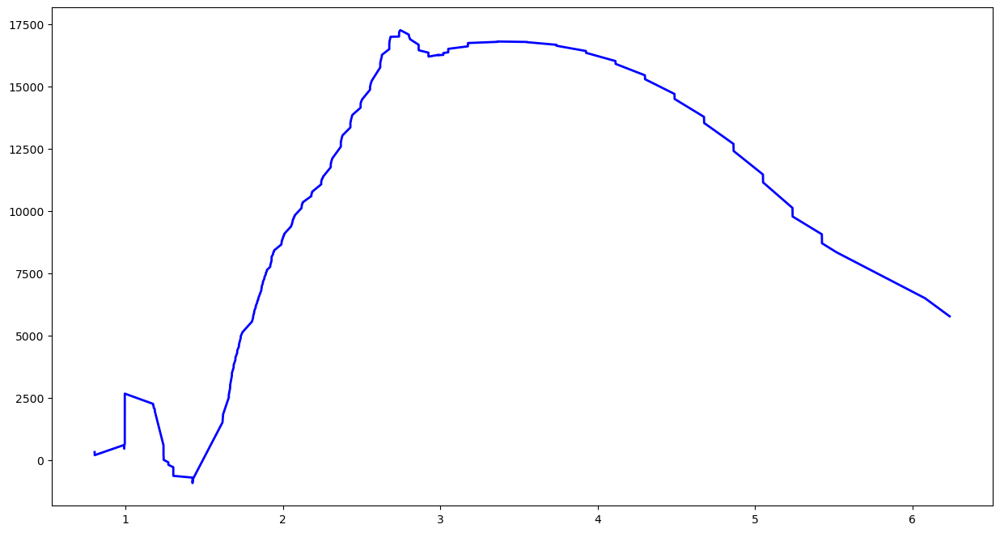

No Feature
../../singapore/top1k/51sole.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/51sole.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54468', '54480', '54484', '39962', '39966', '35686', '35696', '39554', '54996', '55838', '49066', '38822', '36226', '39438', '35882'])
Port 35882


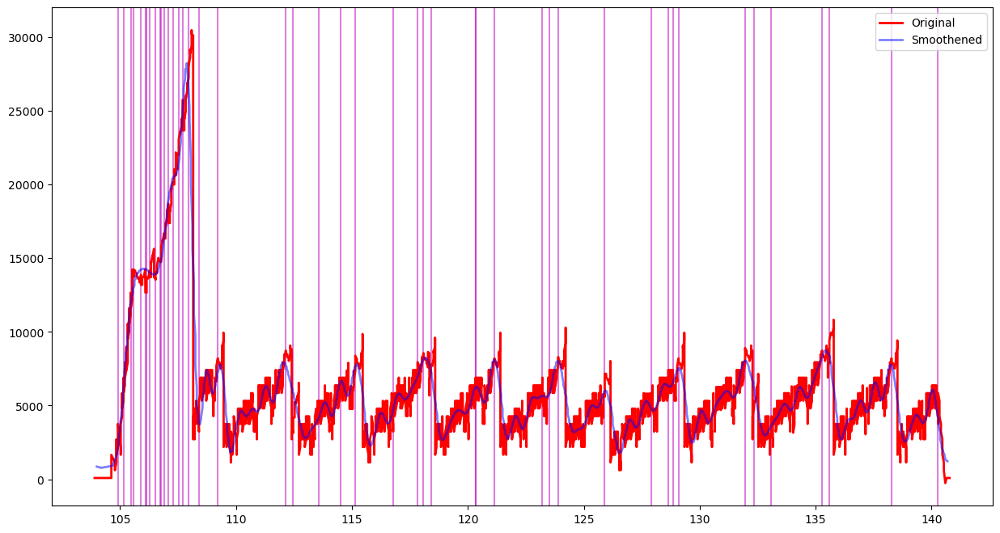

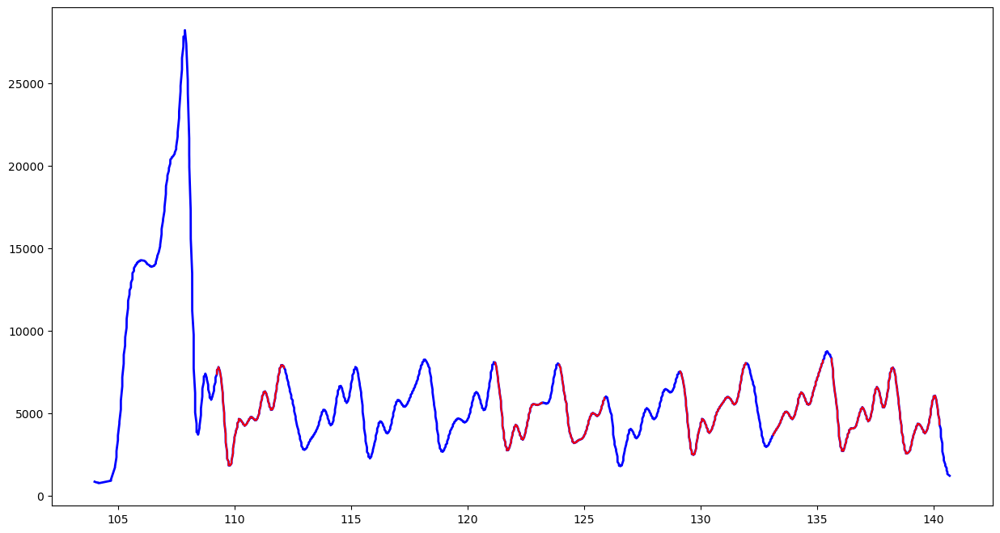

Feature Length  203


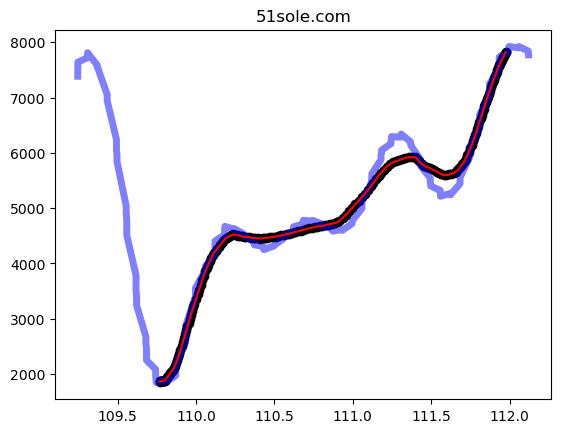

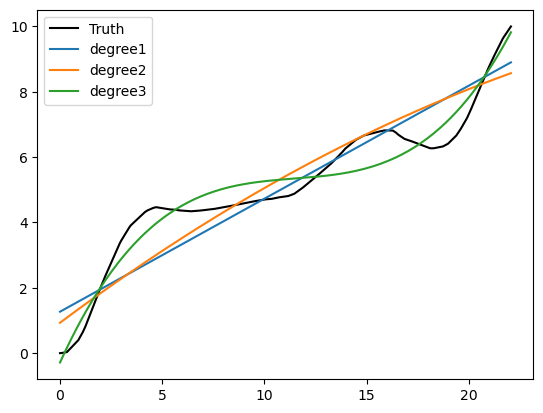

[ 0.00290906 -0.09920722  1.21869448 -0.12486969]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [7.24472706e-56 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/duckduckgo.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/duckduckgo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36838'])
Port 36838


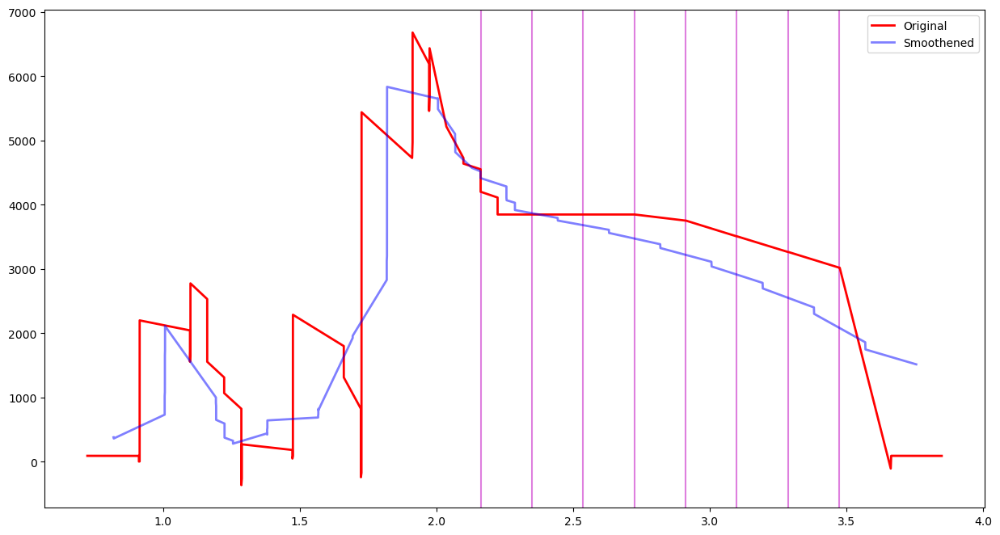

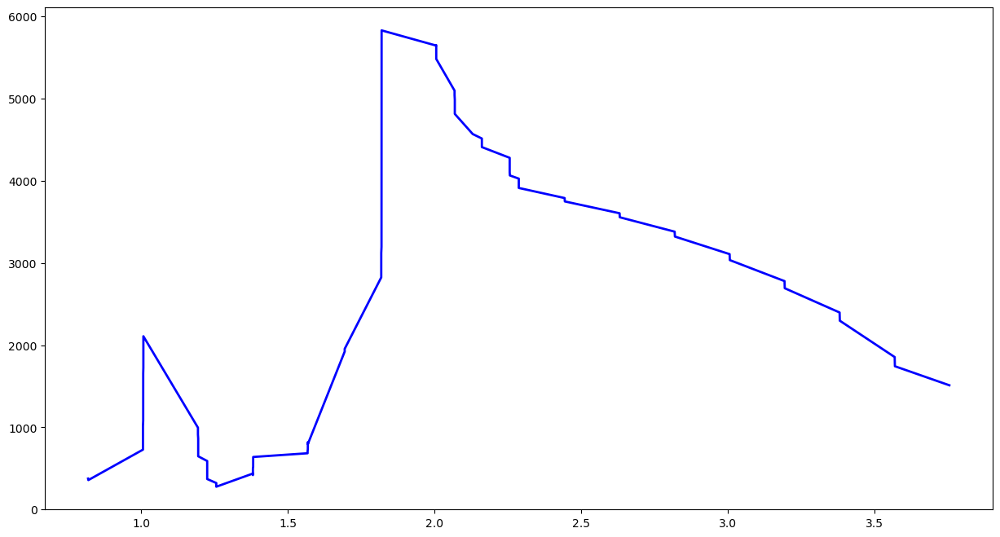

No Feature
../../singapore/top1k/slack.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/slack.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34808'])
Port 34808


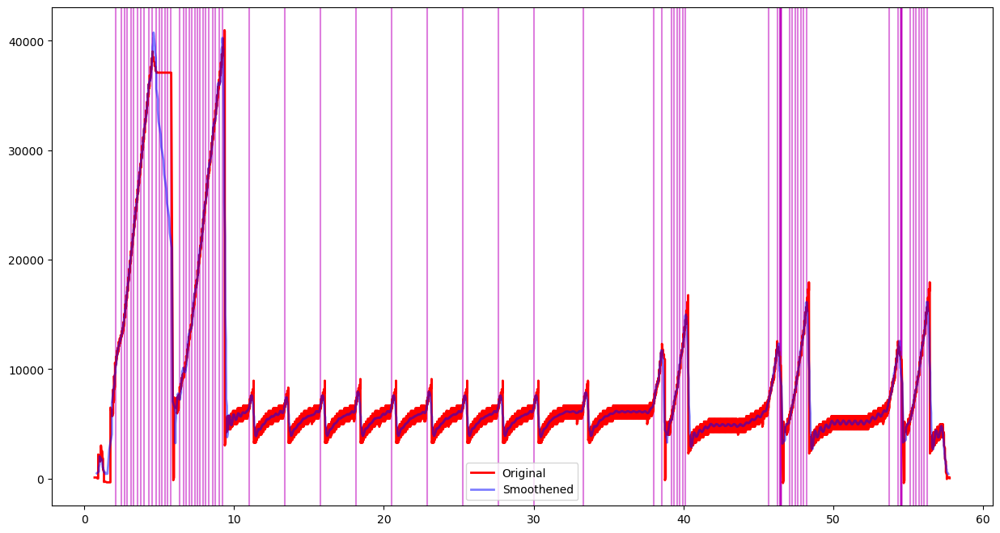

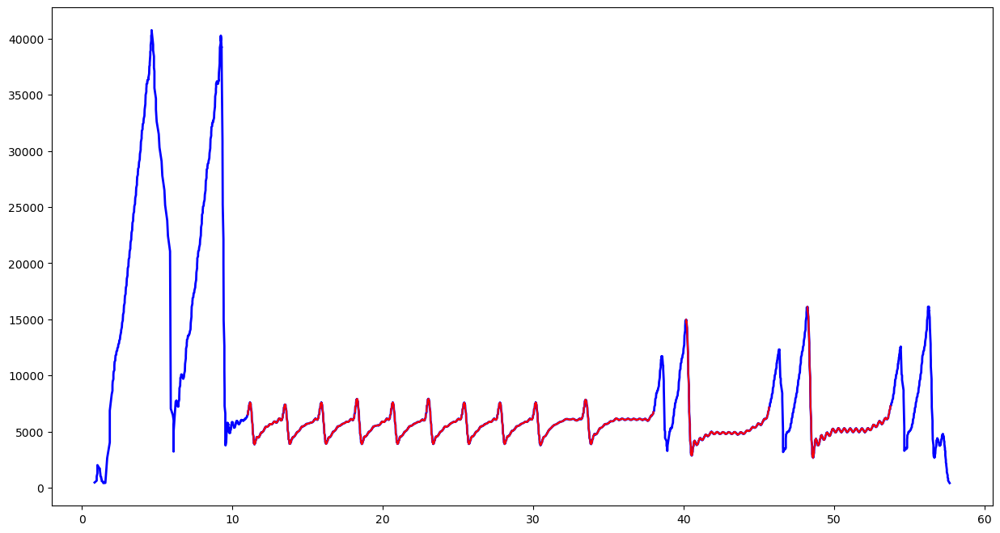

Feature Length  203


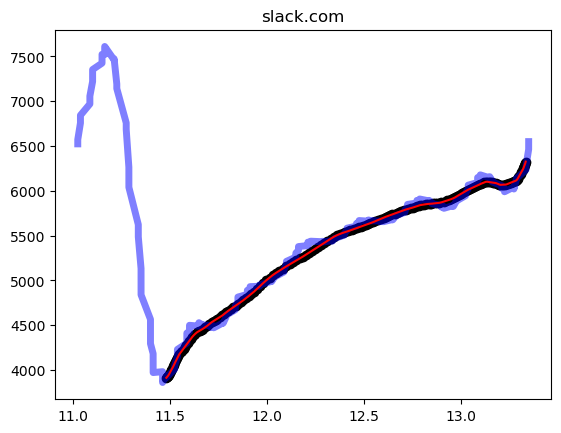

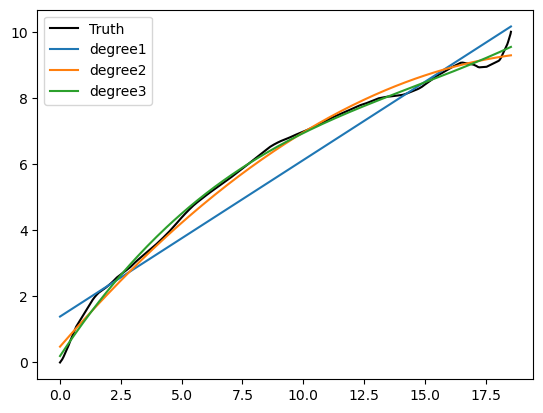

[-0.02423033  0.93584446  0.42990042]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/popads.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/popads.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38902'])
Port 38902


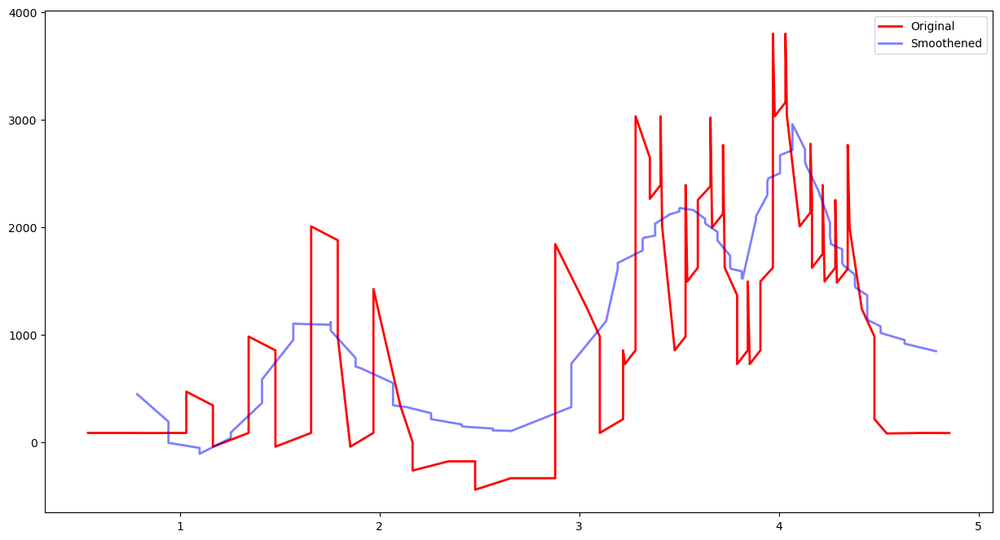

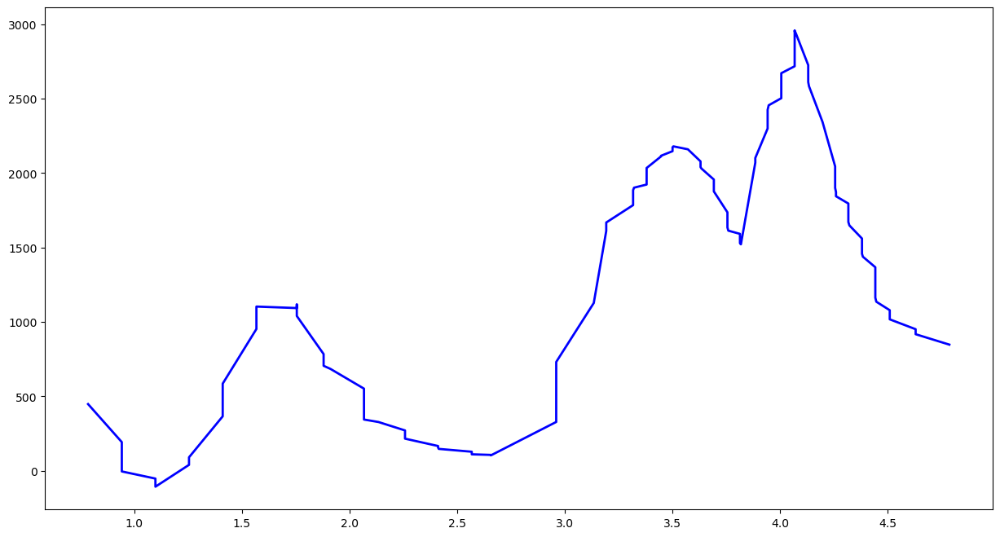

No Feature
../../singapore/top1k/mail.ru-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/mail.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['41186'])
Port 41186


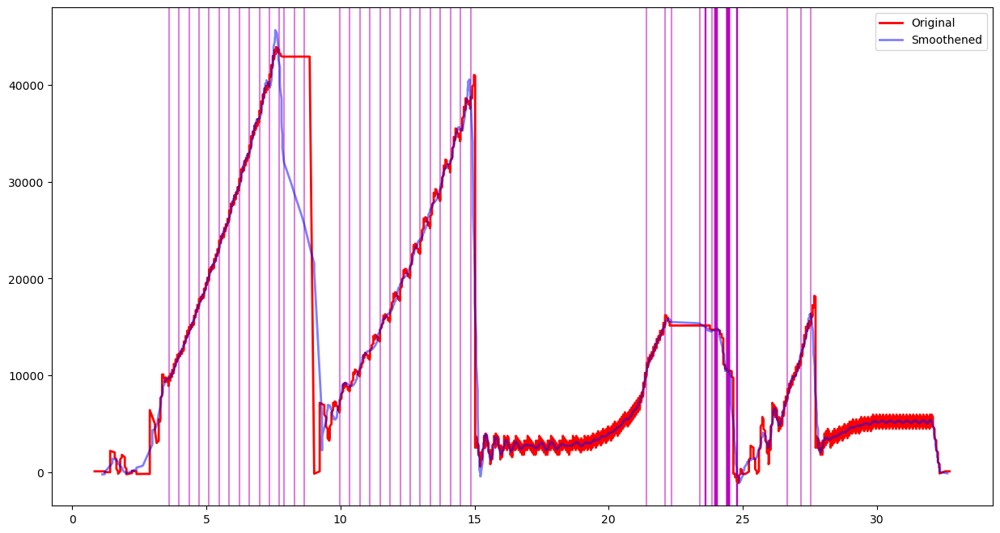

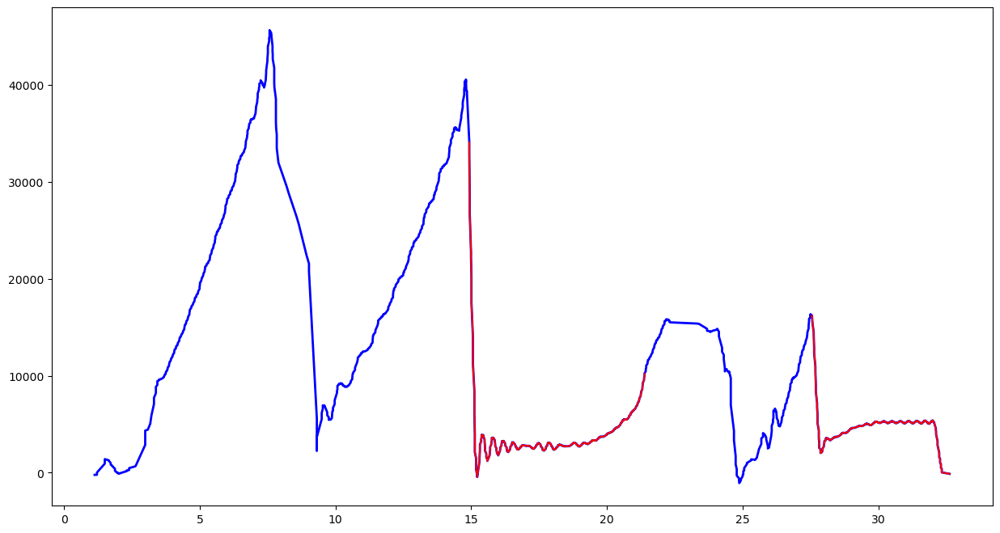

Feature Length  203


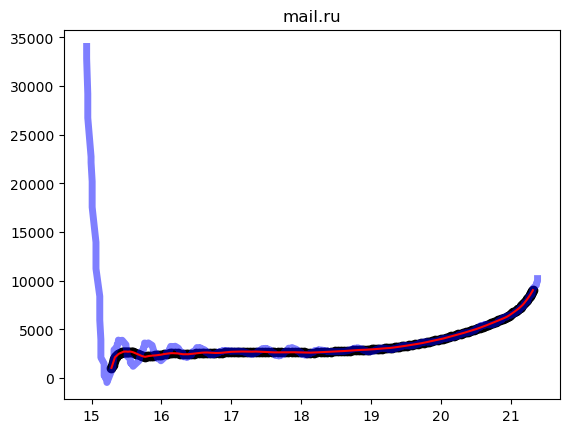

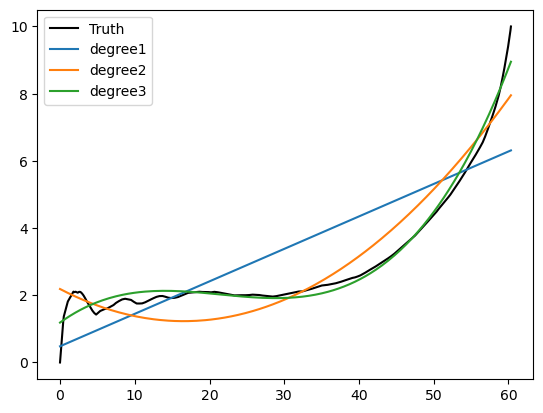

[ 1.50476895e-04 -1.00060631e-02  1.98577084e-01  4.26898126e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [9.29463638e-03 7.60788138e-65 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 8.18523832e-63 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/slideshare.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/slideshare.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['41528'])
Port 41528


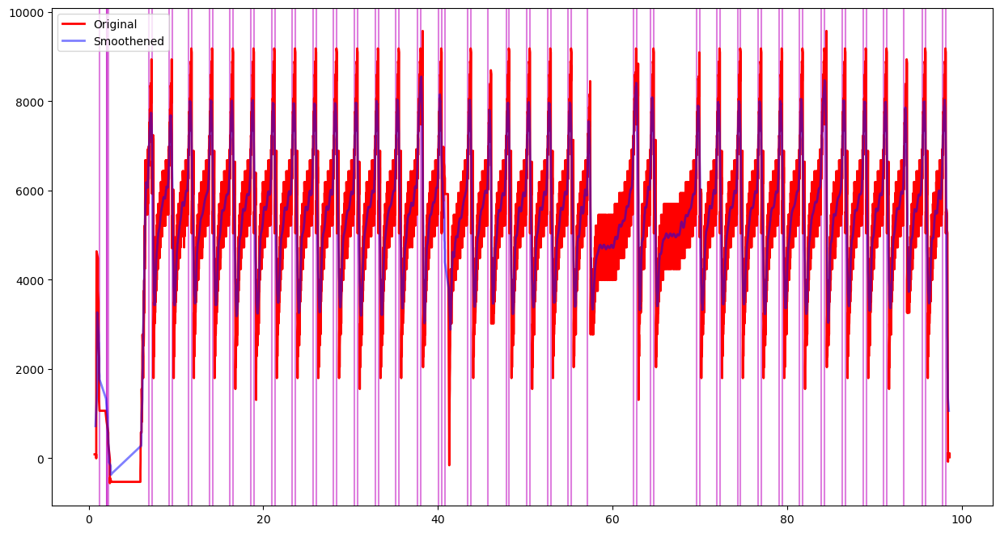

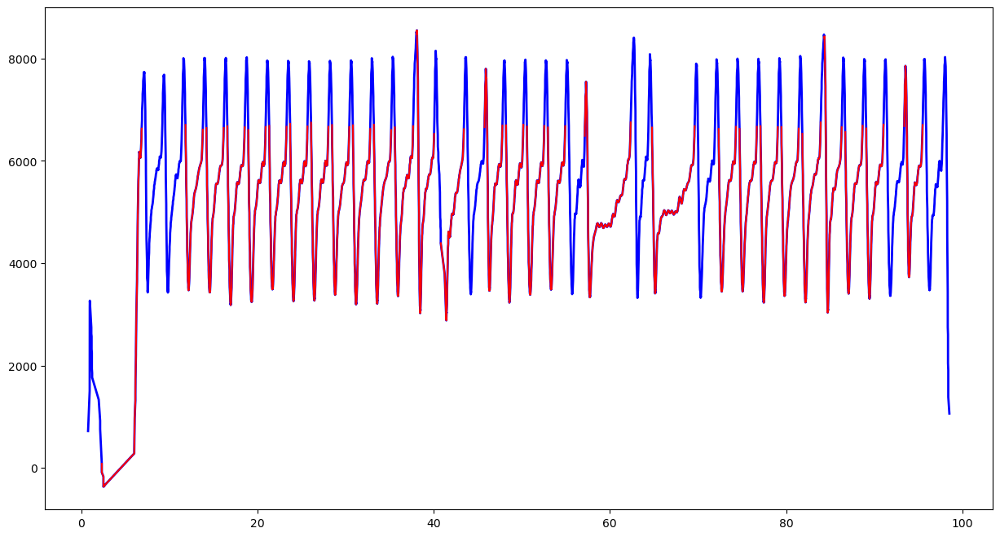

Feature Length  203


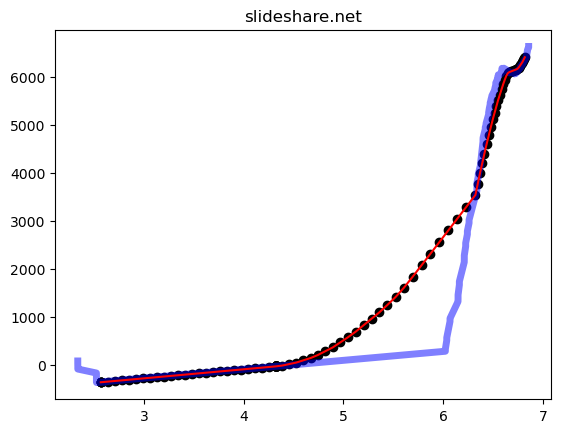

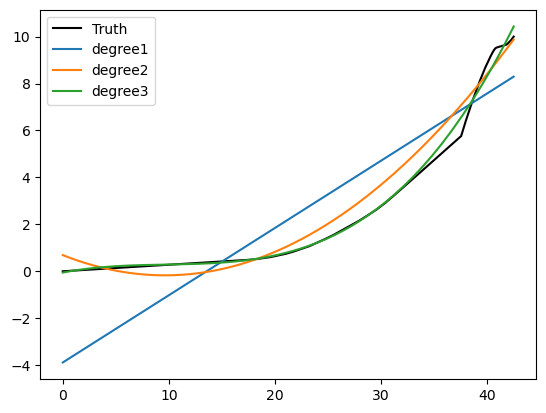

[ 0.00022127 -0.00074234 -0.00900764  0.13461167]
Top 5 CCS : ['htcp', 'vegas', 'cubic', 'veno']
Density Values: [2.98171190e-072 9.80246857e-079 1.75764222e-122 0.00000000e+000]
Relative Density Values: [1.00000000e+00 3.28753042e-07 5.89474195e-51 0.00000000e+00]
Prediction: new
../../singapore/top1k/google.com.hk-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.hk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['58372'])
Port 58372


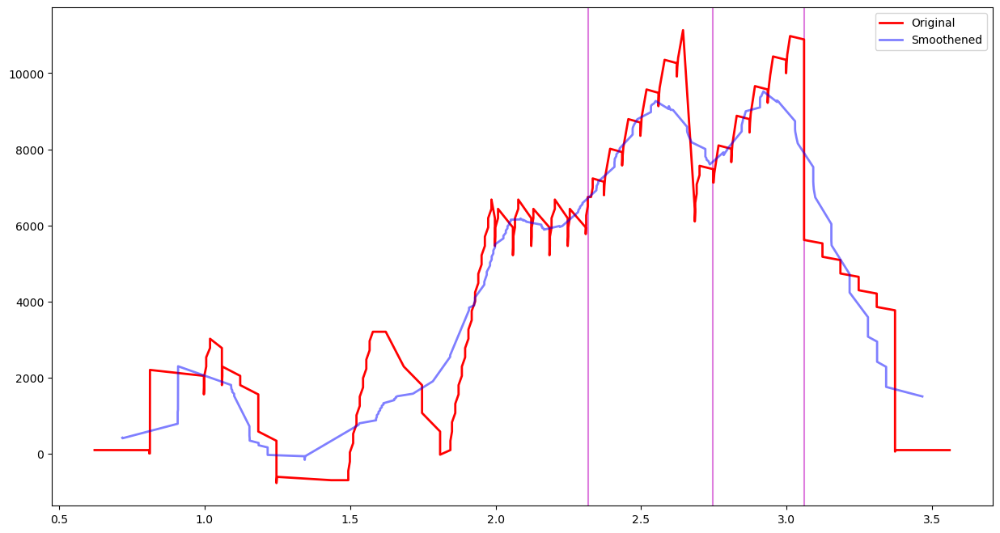

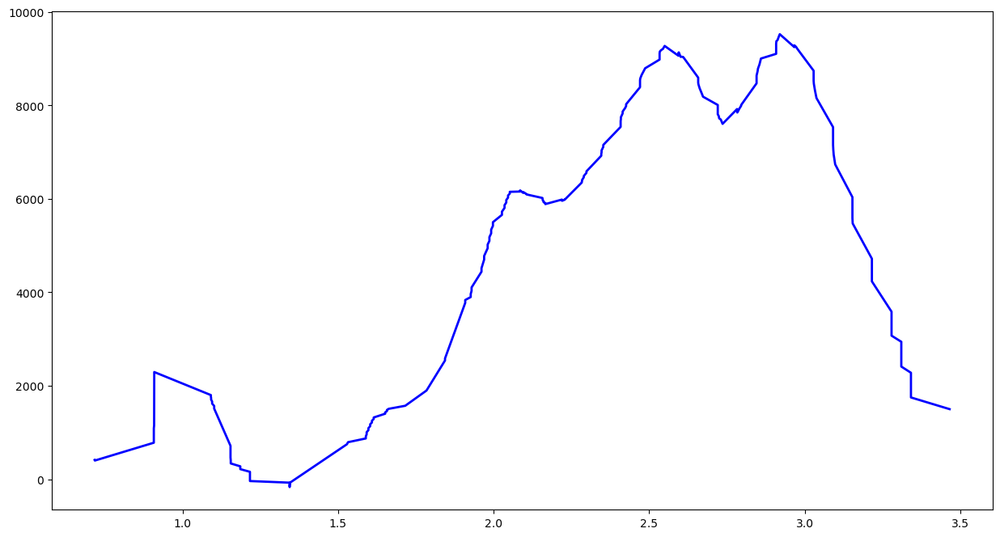

No Feature
../../singapore/top1k/patria.org.ve-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/patria.org.ve-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60124', '60256', '48712', '56200', '48086', '55276', '48646', '47950', '37496', '46118', '37472', '60218', '51054', '37820', '46658', '49434', '44644', '51800', '42590', '35214'])
Port 60124


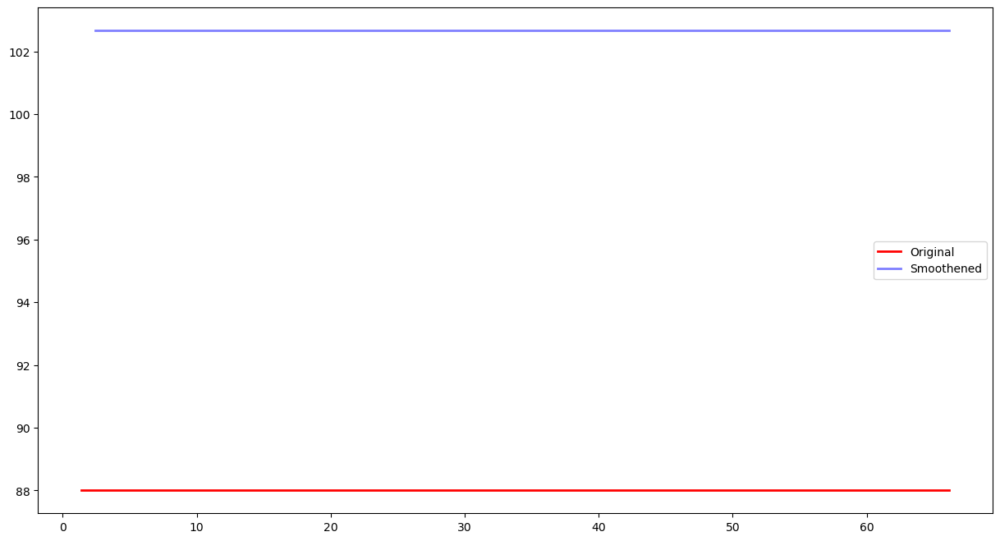

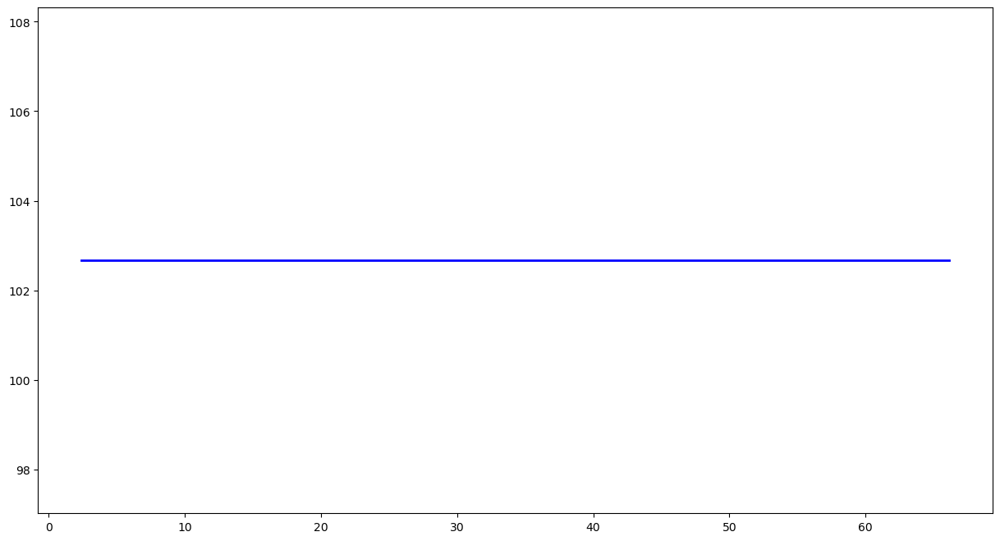

No Feature
../../singapore/top1k/ok.ru-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/ok.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35930'])
Port 35930


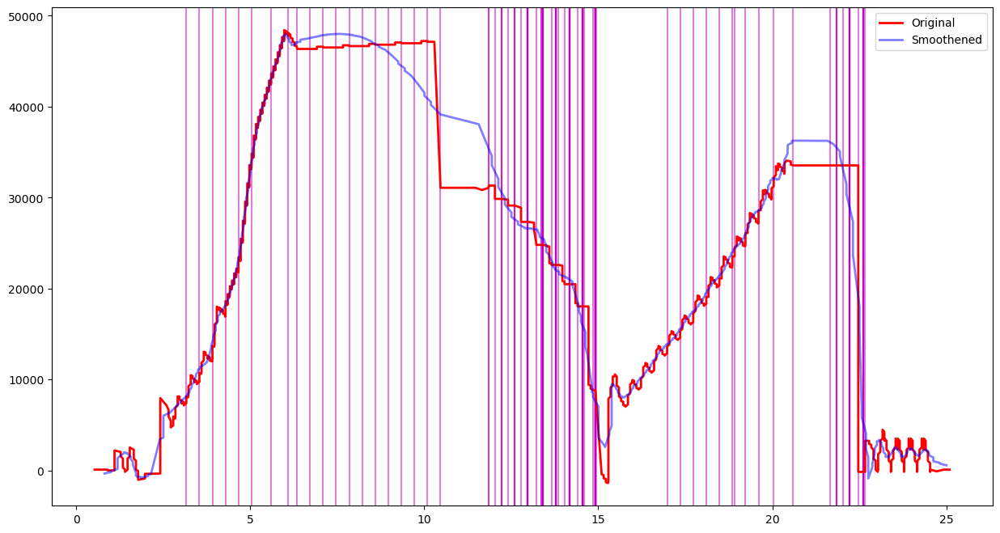

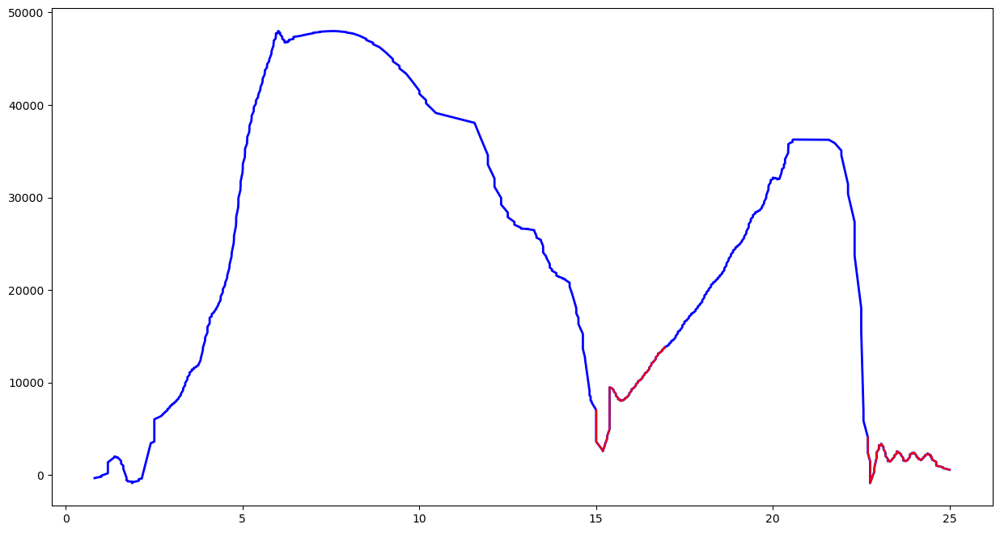

Feature Length  203


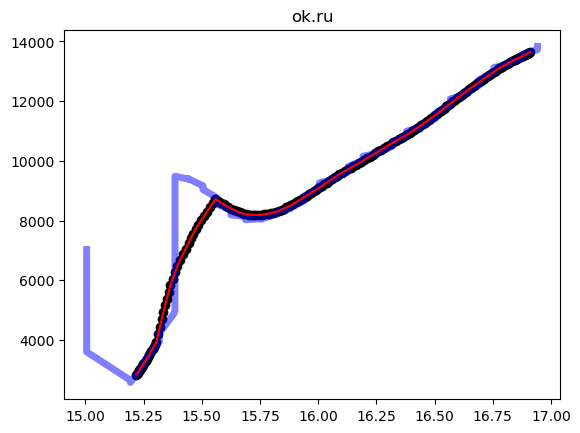

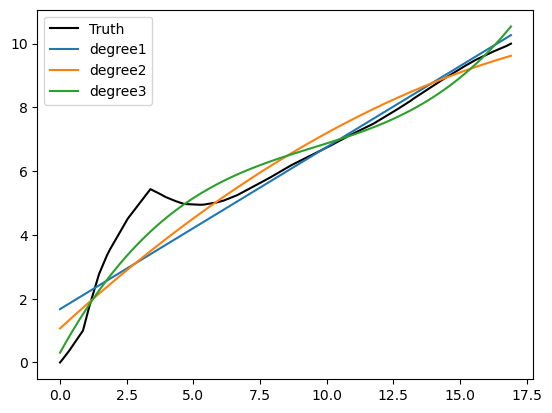

[ 0.00506987 -0.14530788  1.59808046  0.38416047]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [6.56680569e-45 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/mercadolivre.com.br-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/mercadolivre.com.br-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50064'])
Port 50064


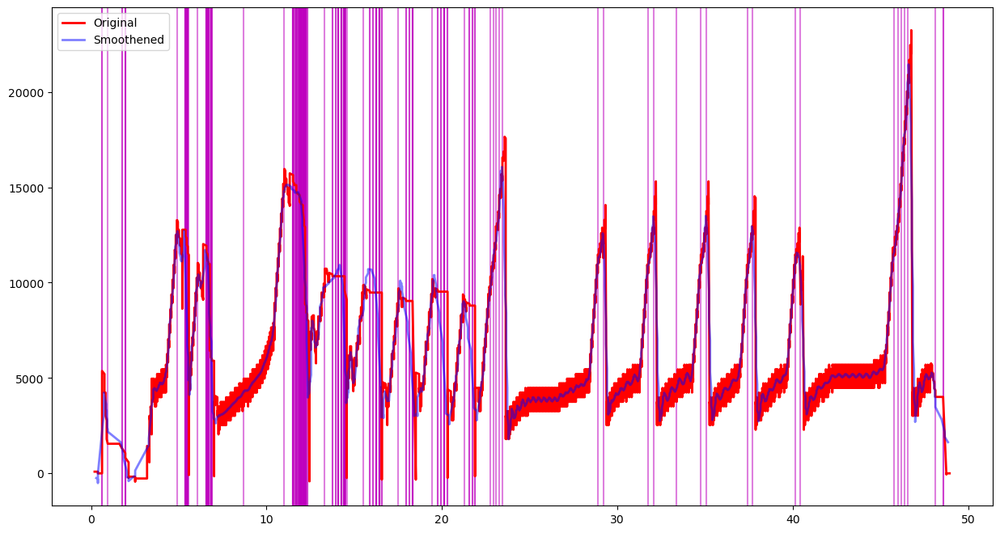

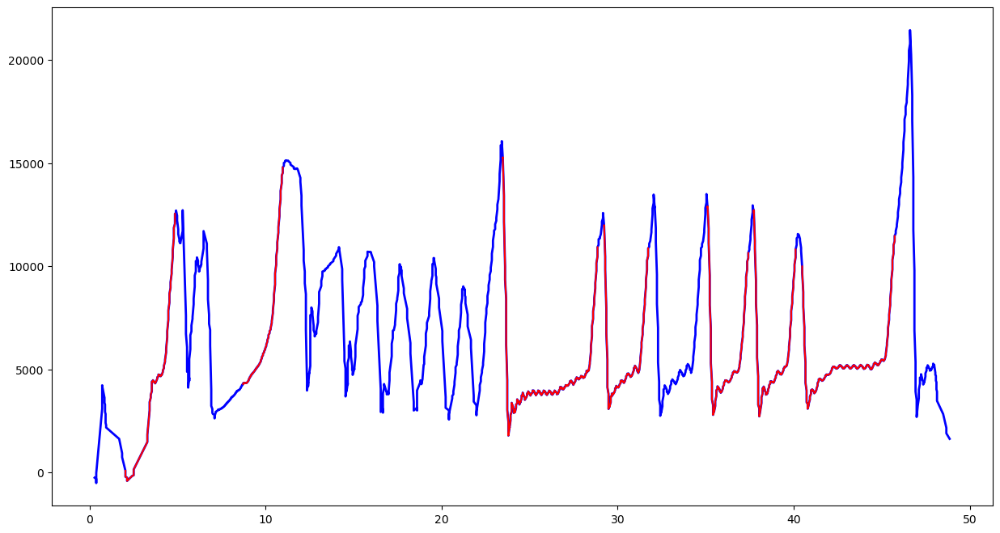

Feature Length  203


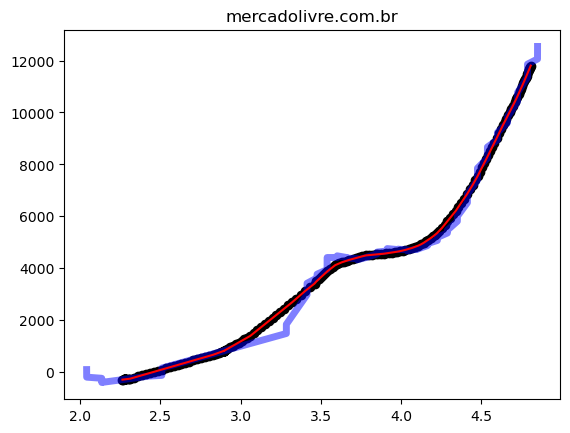

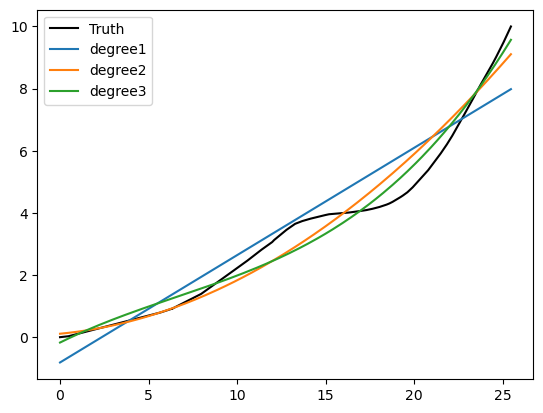

[ 0.00057819 -0.00962858  0.25084655 -0.17536705]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [2.70520134e-10 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.ro-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.ro-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59960'])
Port 59960


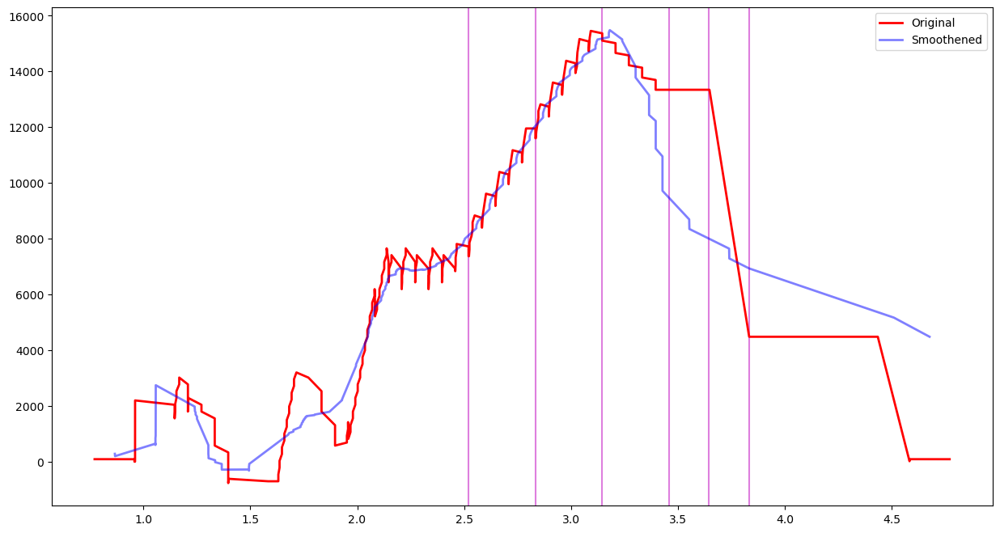

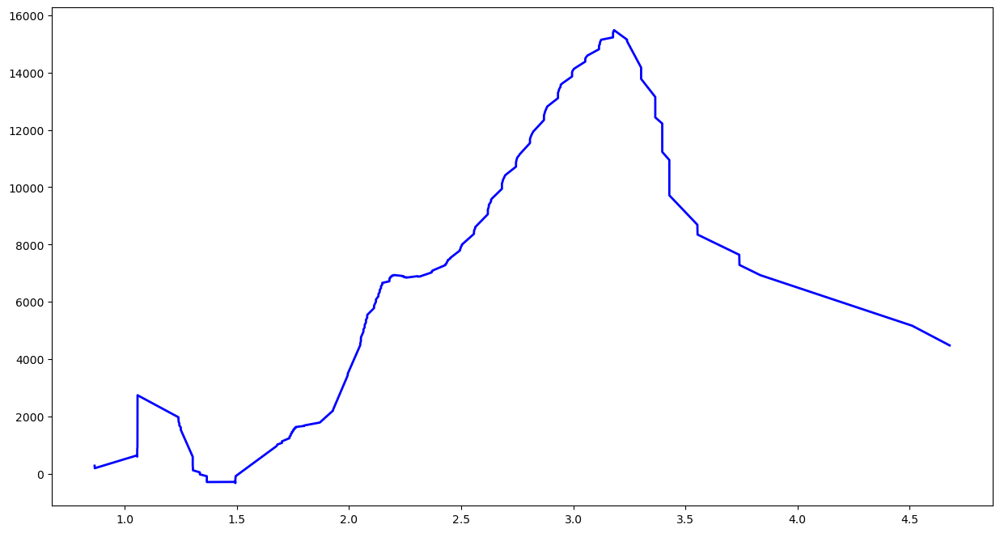

No Feature
../../singapore/top1k/soundcloud.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/soundcloud.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55450', '43646'])
Port 43646


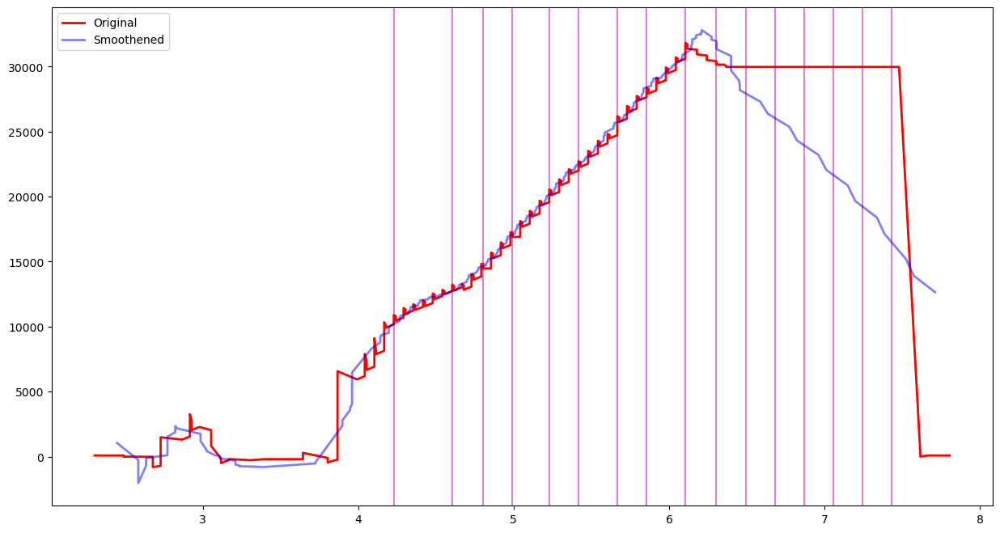

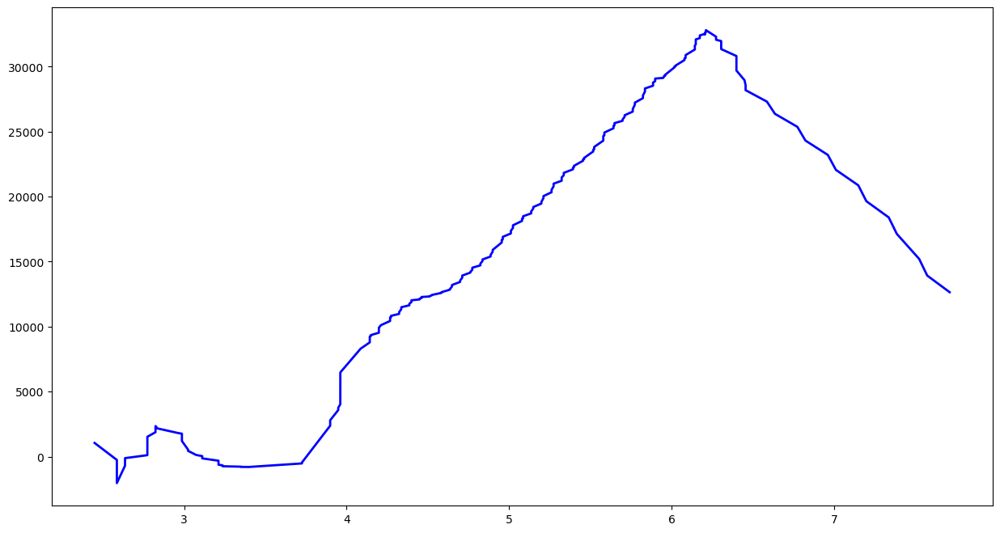

No Feature
../../singapore/top1k/bet365.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bet365.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33376', '32874'])
Port 32874


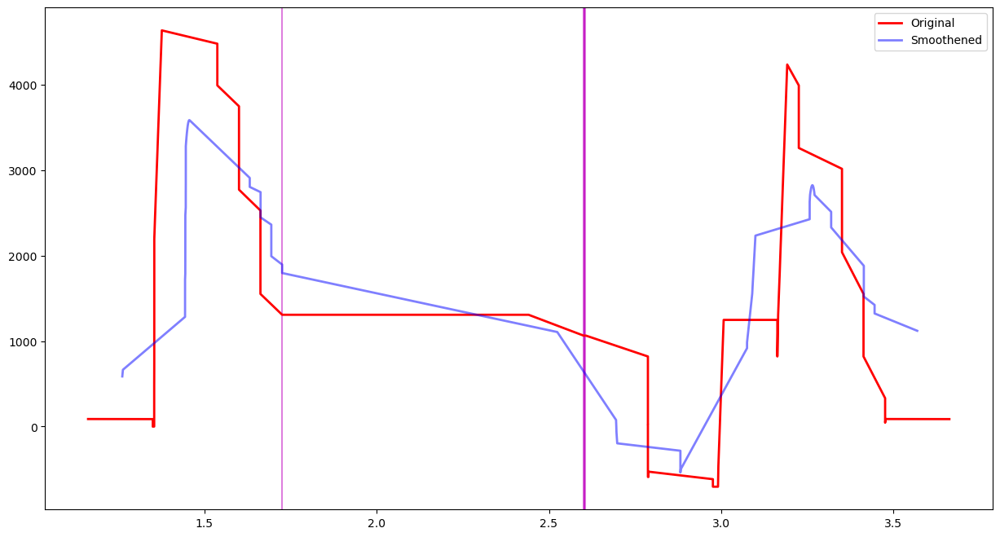

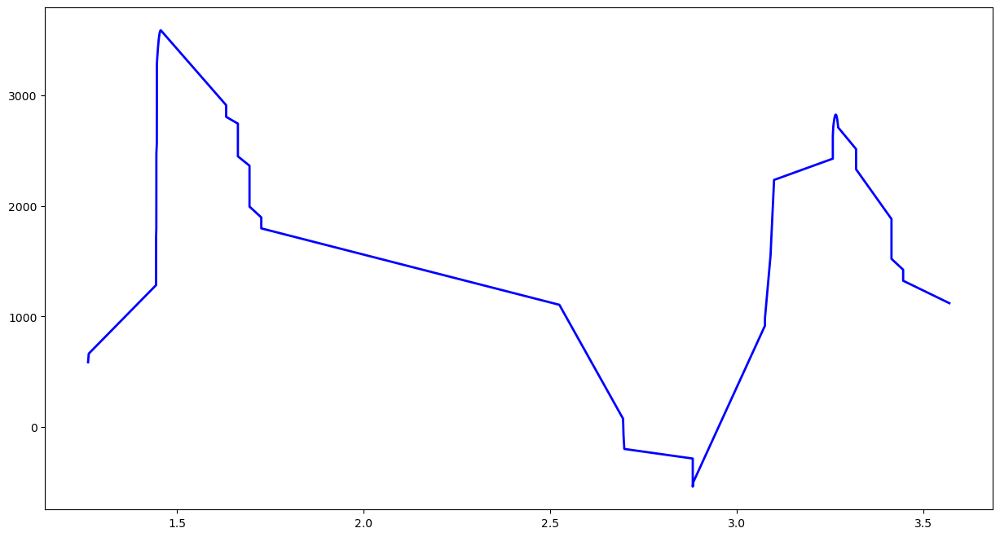

No Feature
../../singapore/top1k/google.com.pe-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.pe-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56482'])
Port 56482


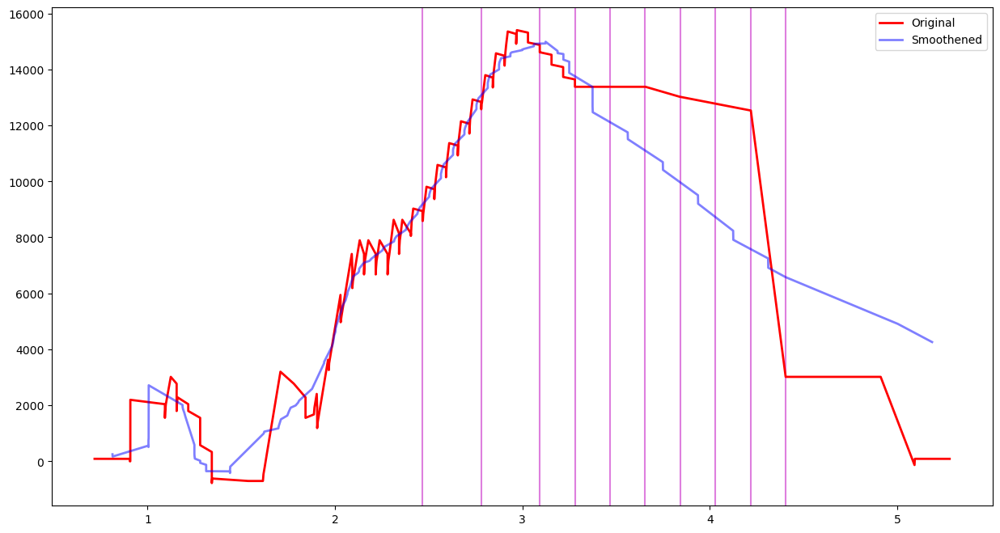

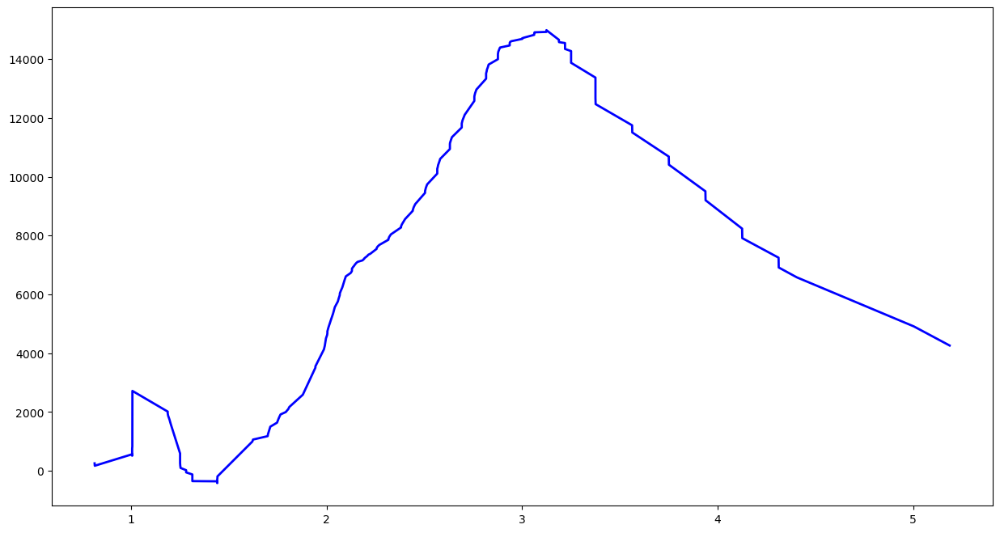

No Feature
../../singapore/top1k/sciencedirect.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/sciencedirect.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53344', '43524'])
Port 43524


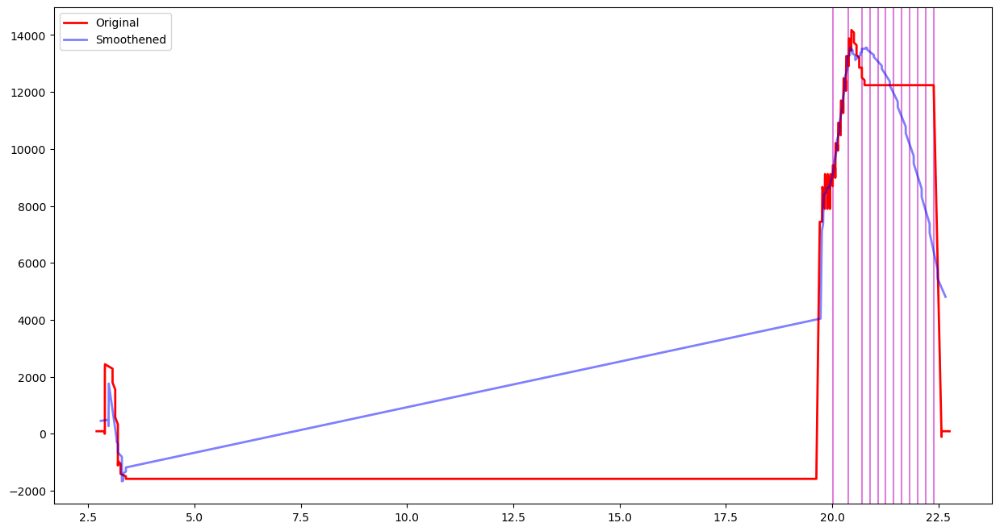

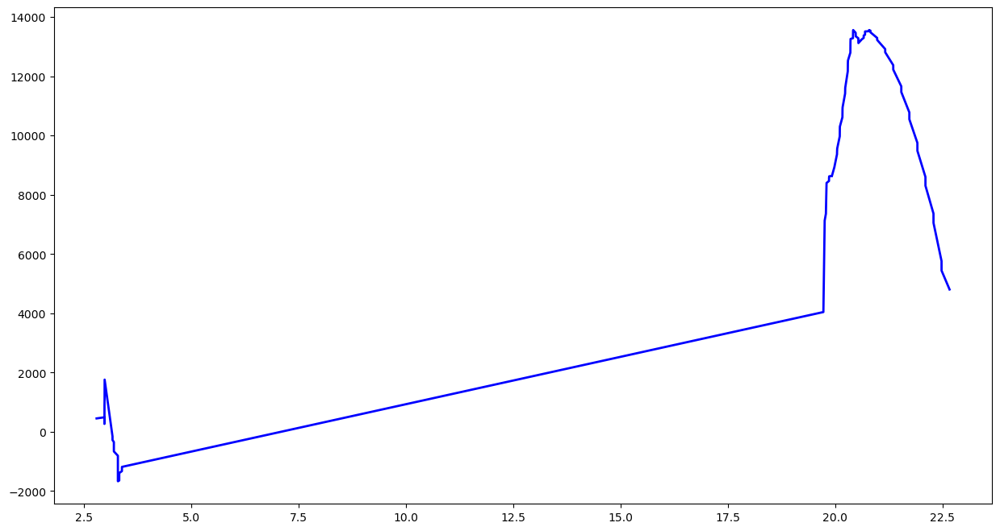

No Feature
../../singapore/top1k/pornhub.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/pornhub.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51262', '38494', '36320', '60980', '51306', '53340', '55510', '34436', '32816', '40592', '58740', '58902', '50406', '40866', '38590', '41880', '53734', '48140', '43738', '53590'])
Port 51262


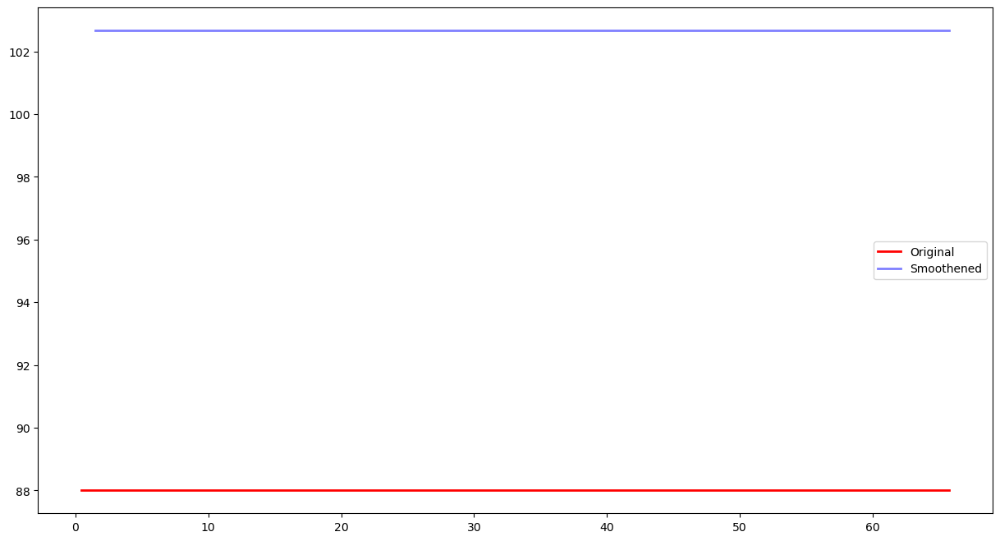

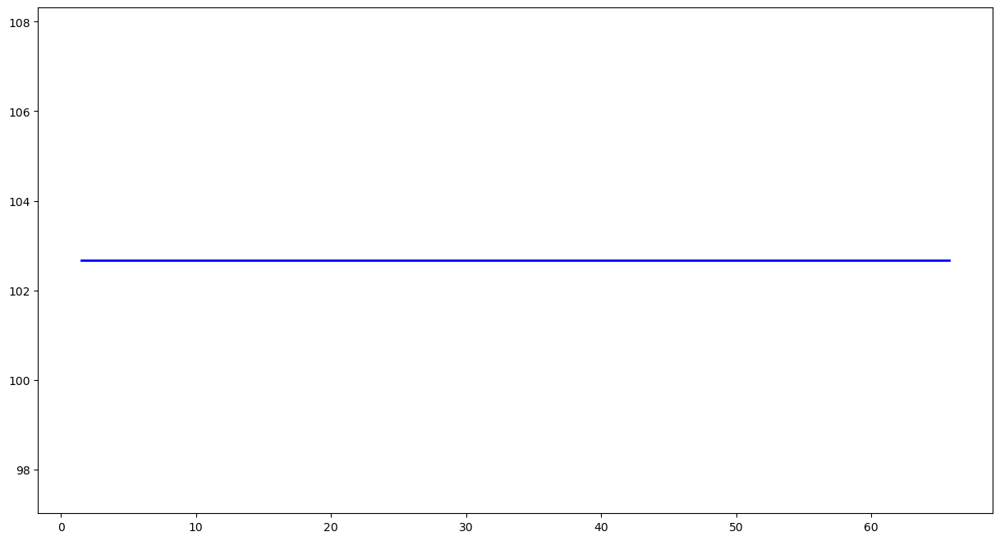

No Feature
../../singapore/top1k/scribd.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/scribd.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34056'])
Port 34056


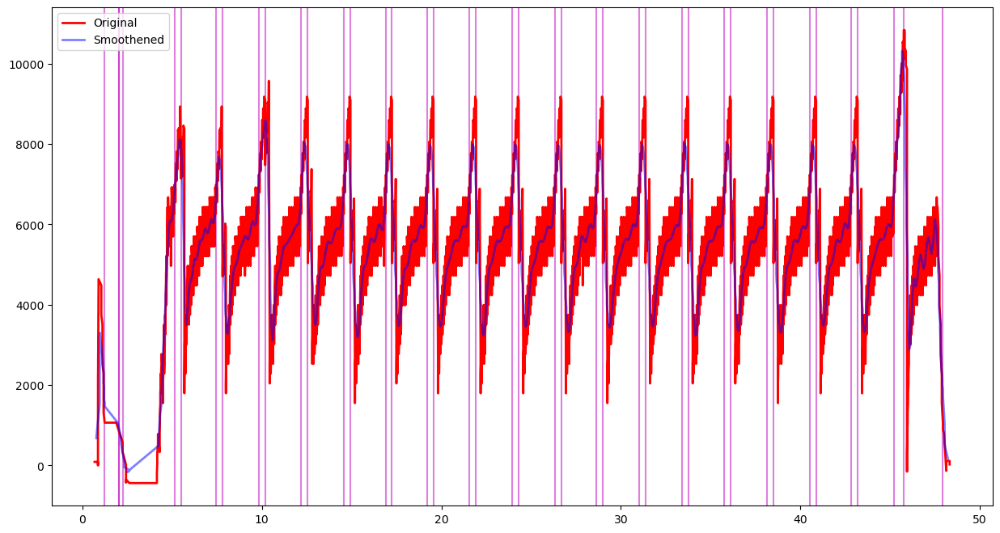

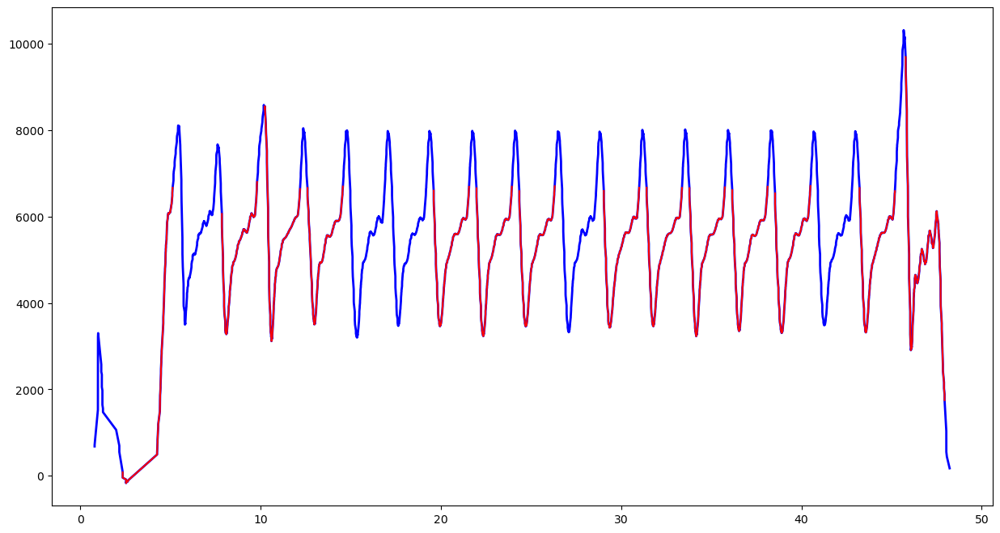

Feature Length  203


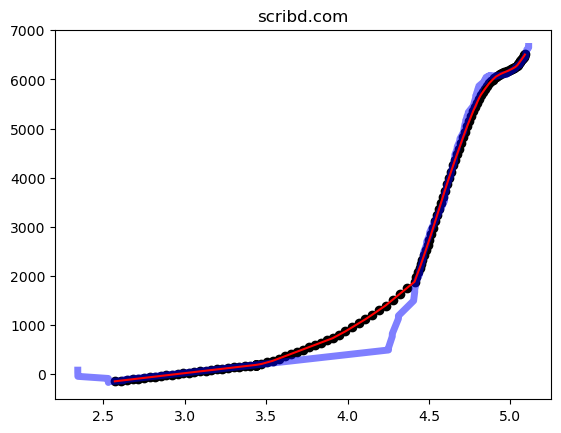

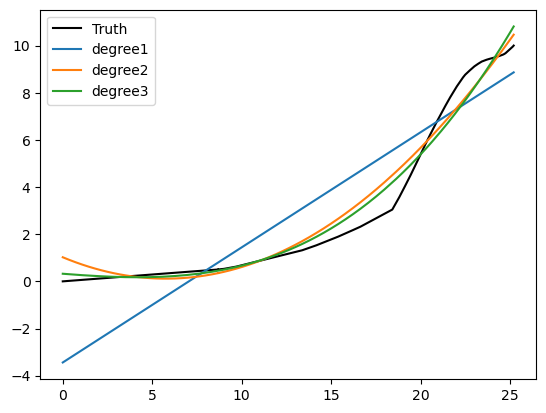

[ 0.02325628 -0.17046408  0.22095585]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/imgur.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/imgur.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42146'])
Port 42146


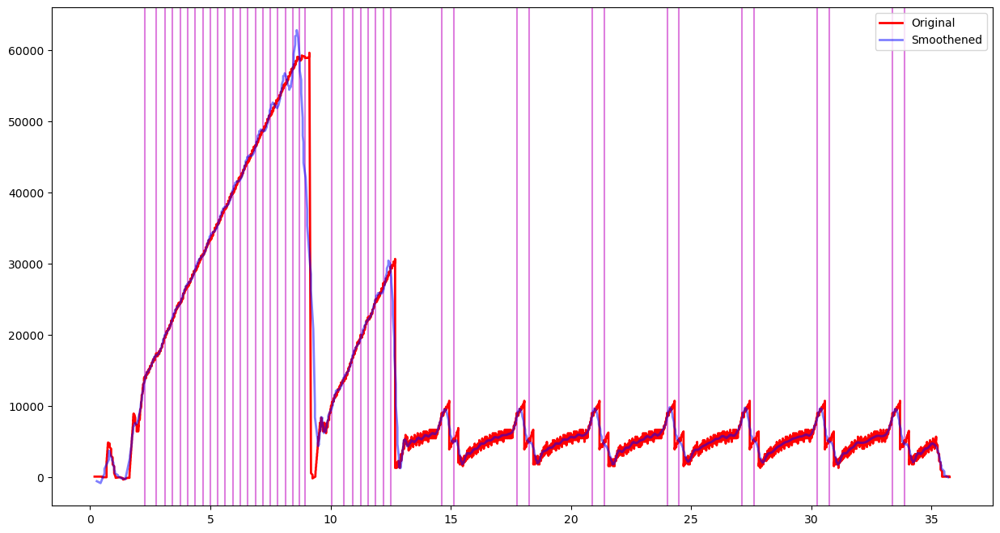

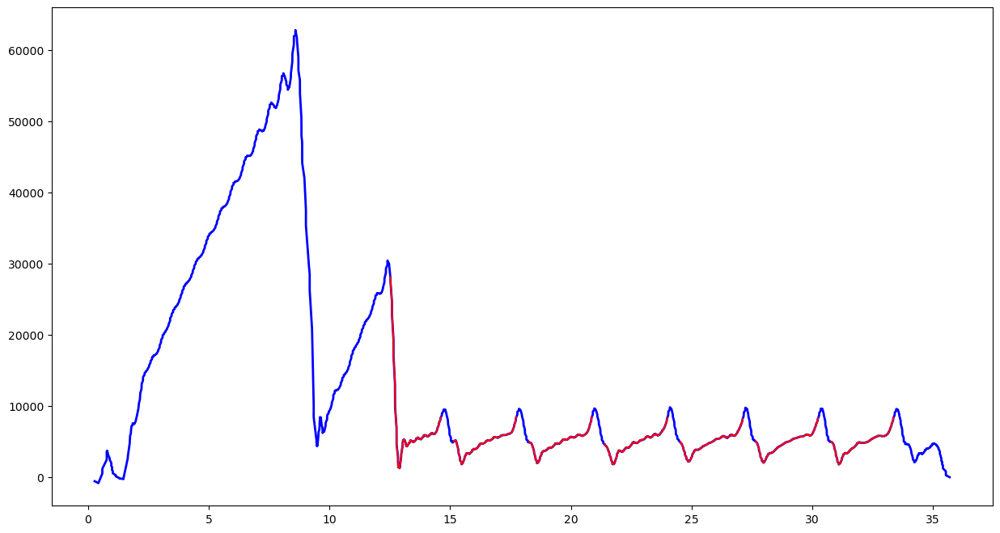

Feature Length  203


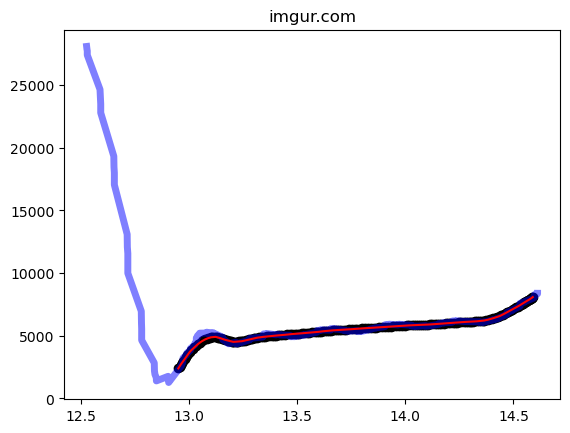

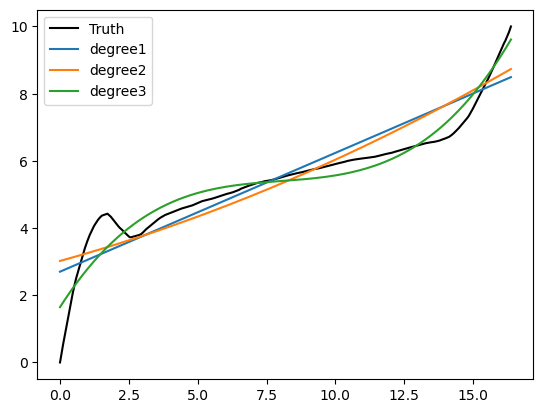

[ 0.00771716 -0.19959977  1.71550623  1.04666832]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [0.0173209 0.        0.        0.       ]
Relative Density Values: [1. 0. 0. 0.]
Prediction: htcp
../../singapore/top1k/freepik.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/freepik.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34924'])
Port 34924


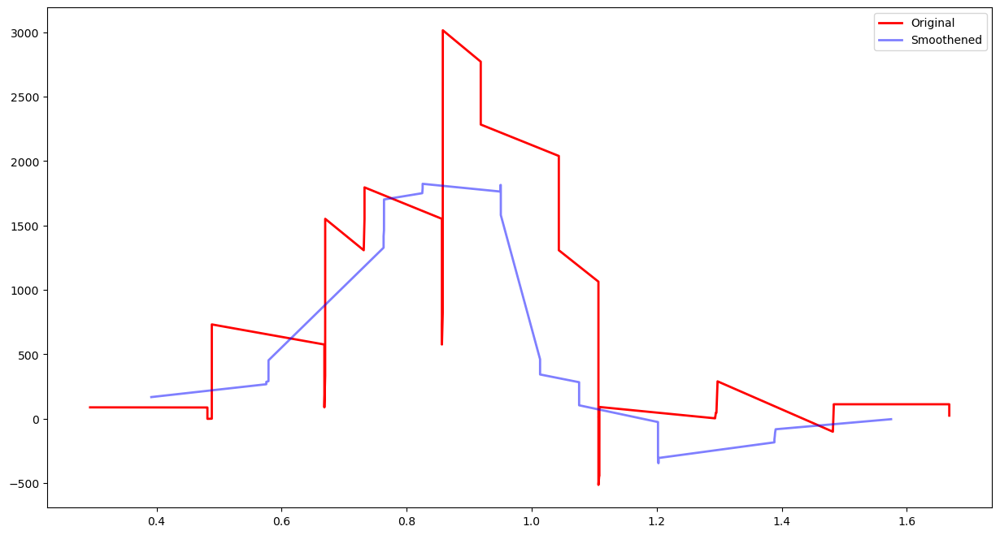

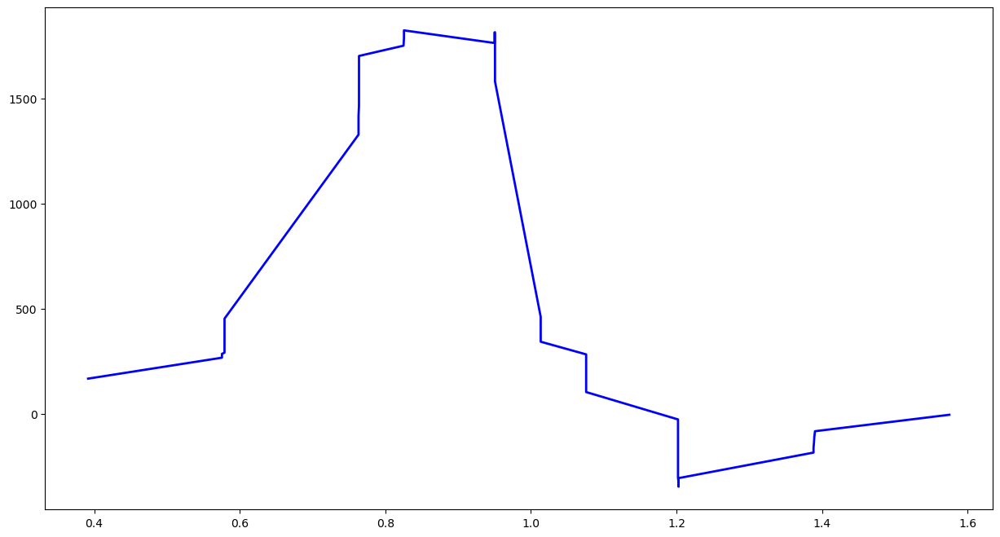

No Feature
../../singapore/top1k/yandex.ru-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yandex.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46726', '54420', '50548', '40390'])
Port 50548


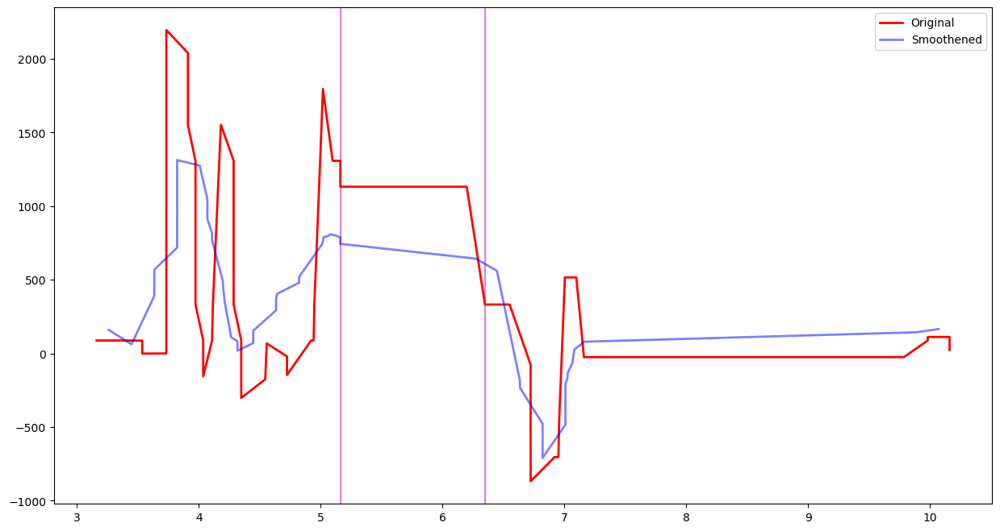

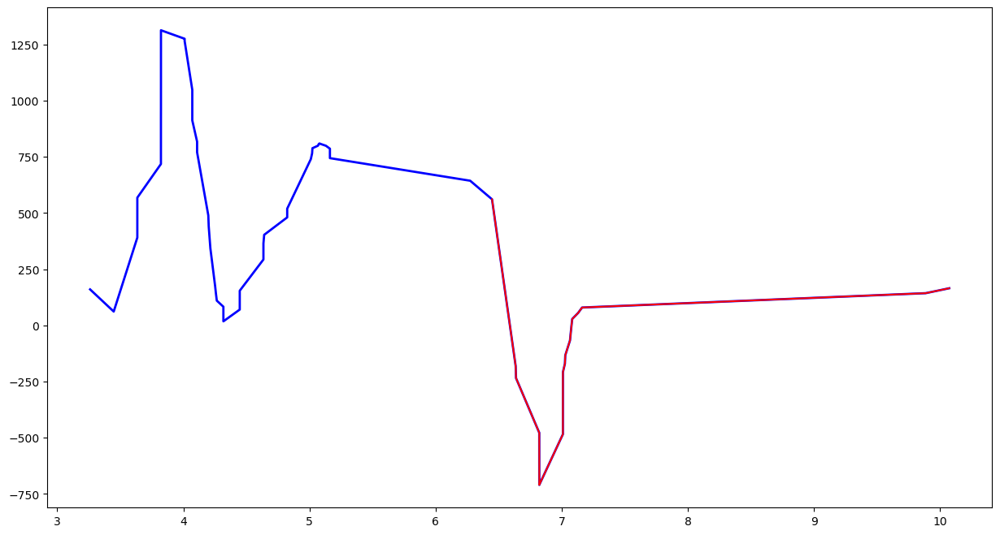

Feature Length  203


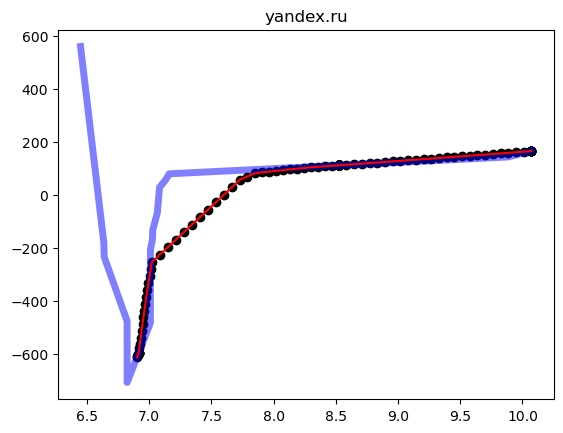

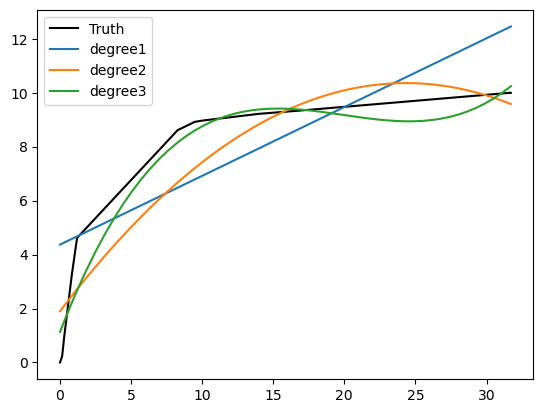

[ 8.56073301e-04 -5.64502314e-02  1.22820767e+00  6.20735989e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [4.77936447e-024 1.49958634e-163 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1.00000000e+000 3.13762709e-140 0.00000000e+000 0.00000000e+000]
Prediction: new
../../singapore/top1k/naver.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/naver.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44438'])
Port 44438


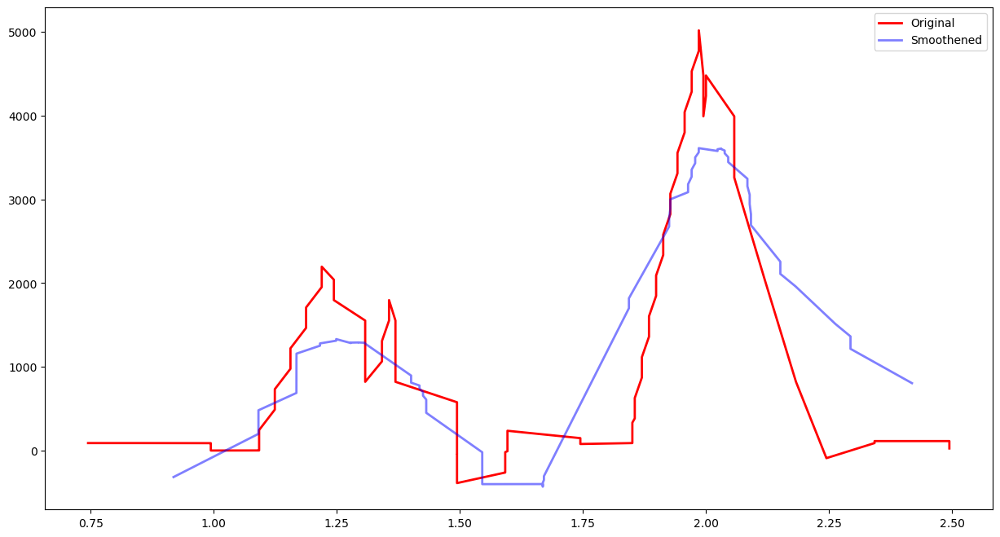

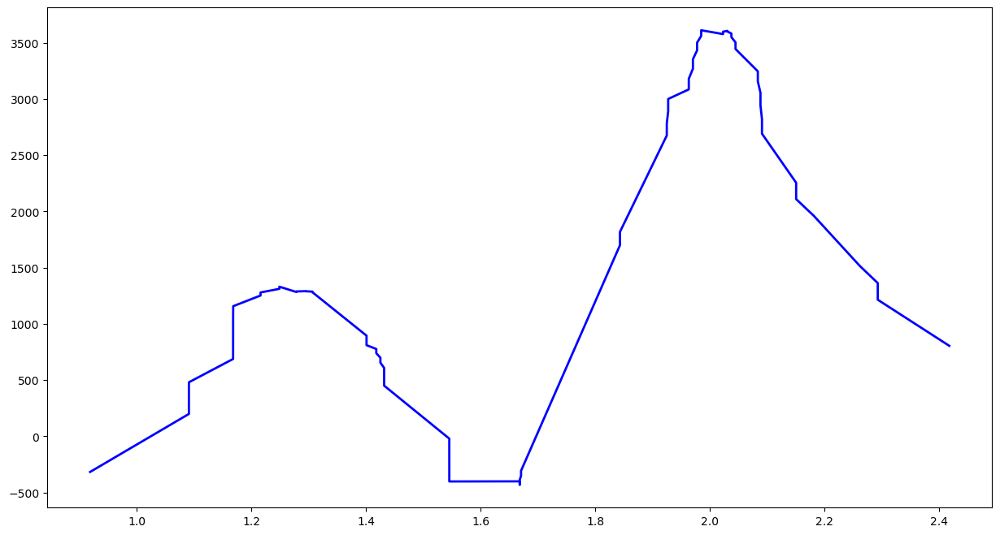

No Feature
../../singapore/top1k/tumblr.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/tumblr.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59786', '46476', '38938', '49300', '51014', '45616', '36088', '46238', '44896', '41768', '42056', '42212', '34162', '48592', '43660', '52912', '43996', '43638', '36434', '60530'])
Port 59786


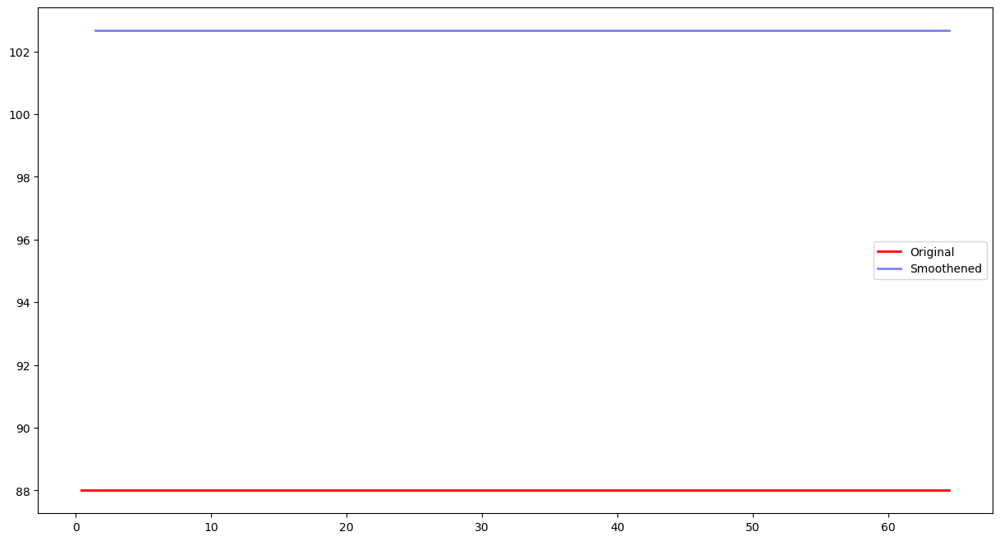

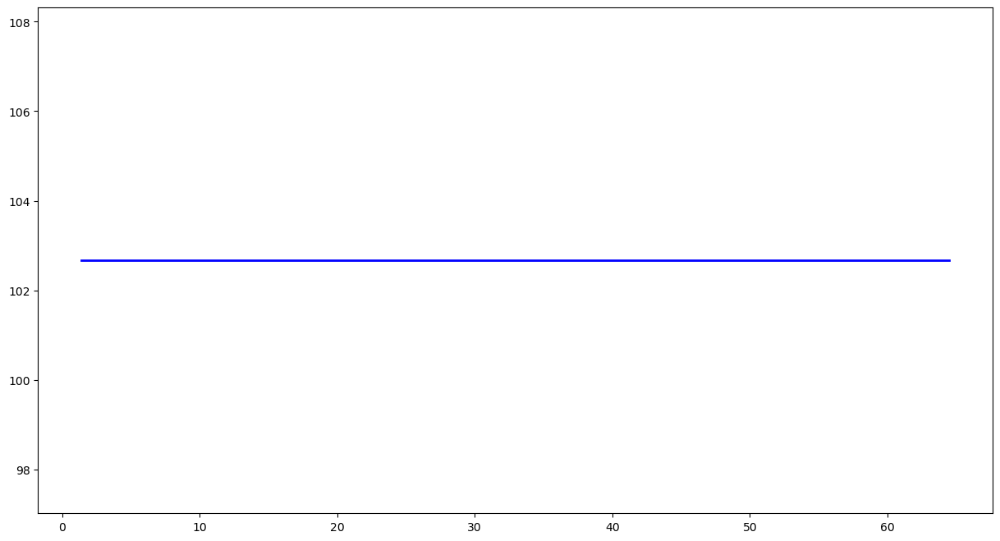

No Feature
../../singapore/top1k/researchgate.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/researchgate.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49034'])
Port 49034


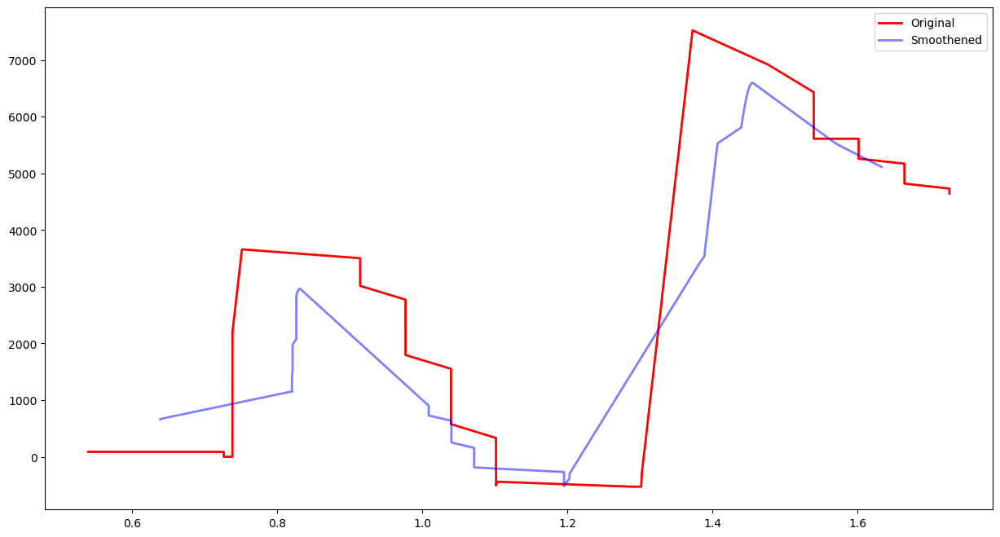

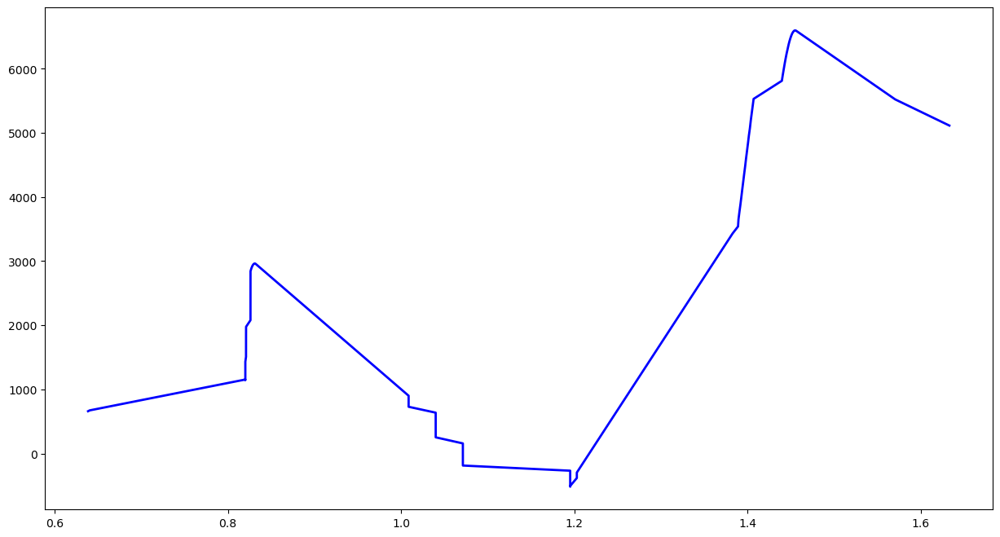

No Feature
../../singapore/top1k/newsprofin.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/newsprofin.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46600', '49474'])
Port 49474


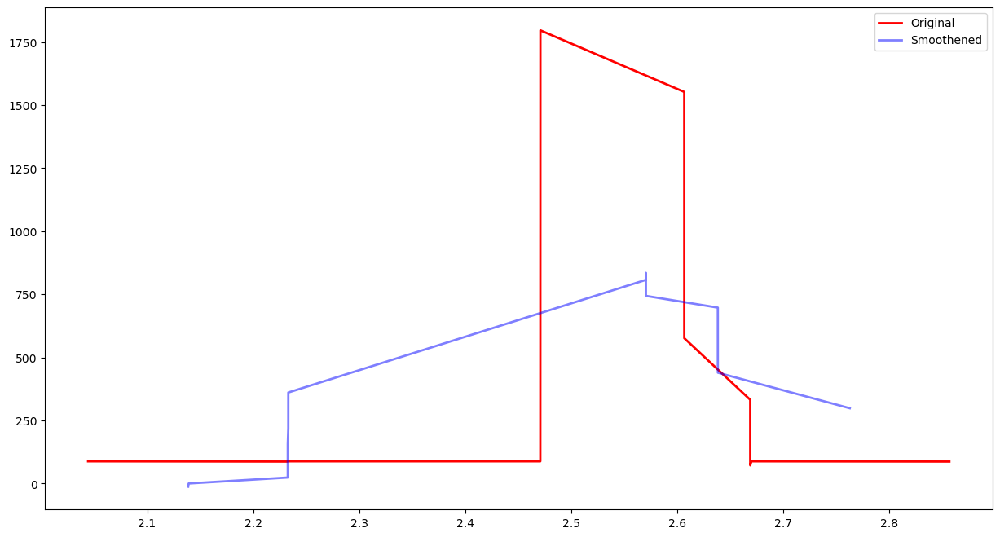

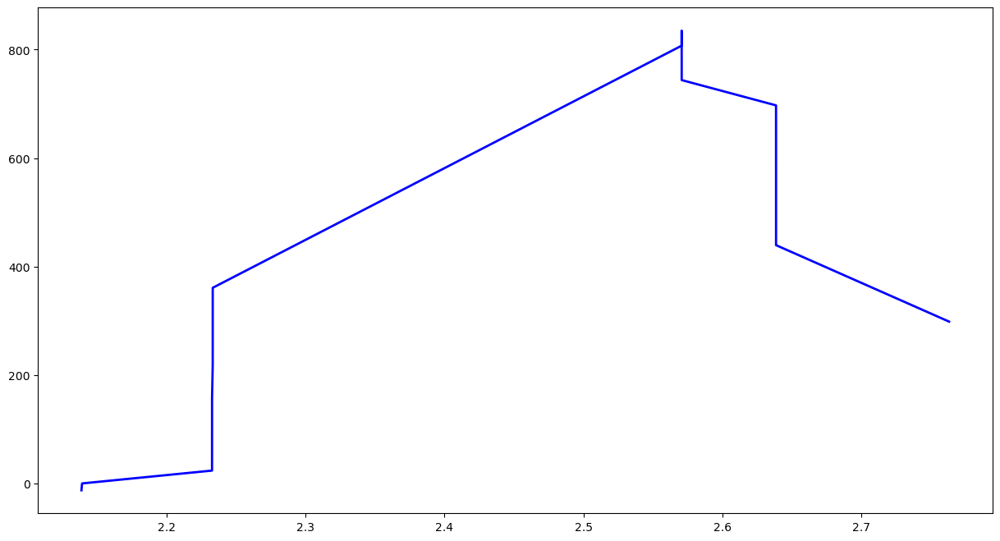

No Feature
../../singapore/top1k/qq.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/qq.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42890'])
Port 42890


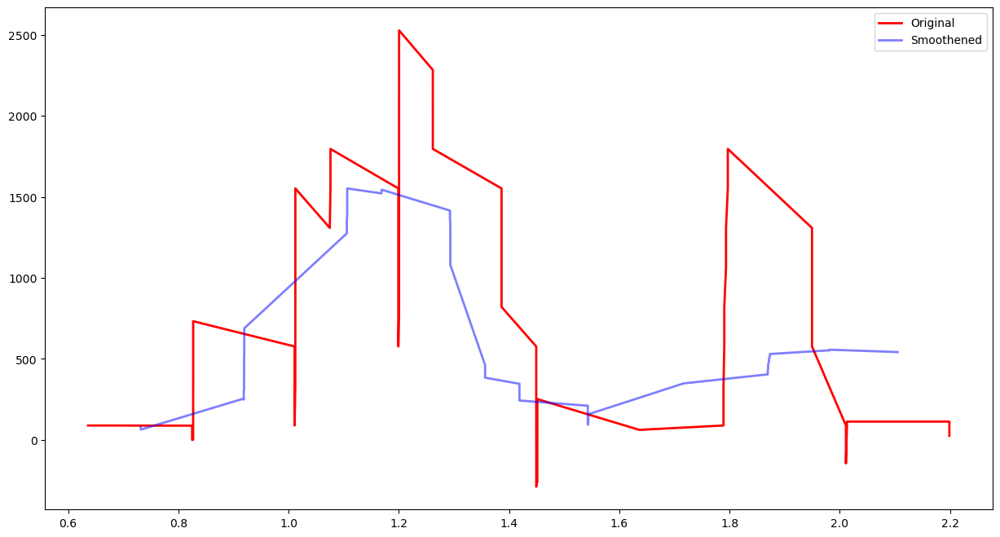

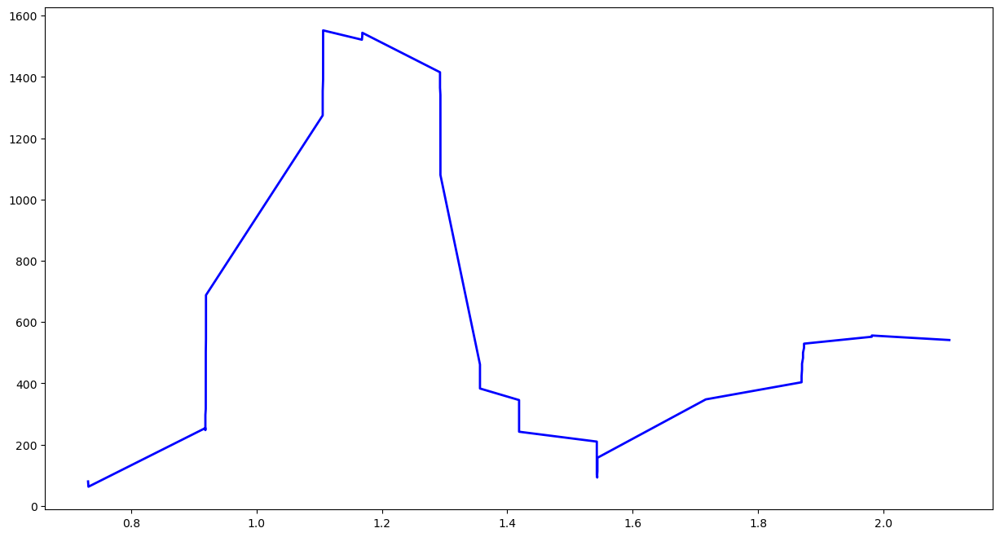

No Feature
../../singapore/top1k/blogspot.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/blogspot.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57682'])
Port 57682


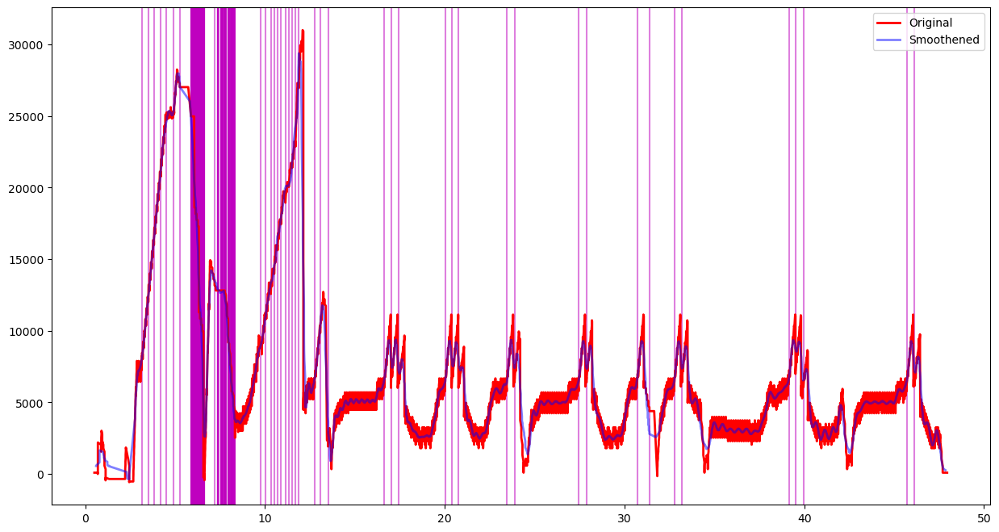

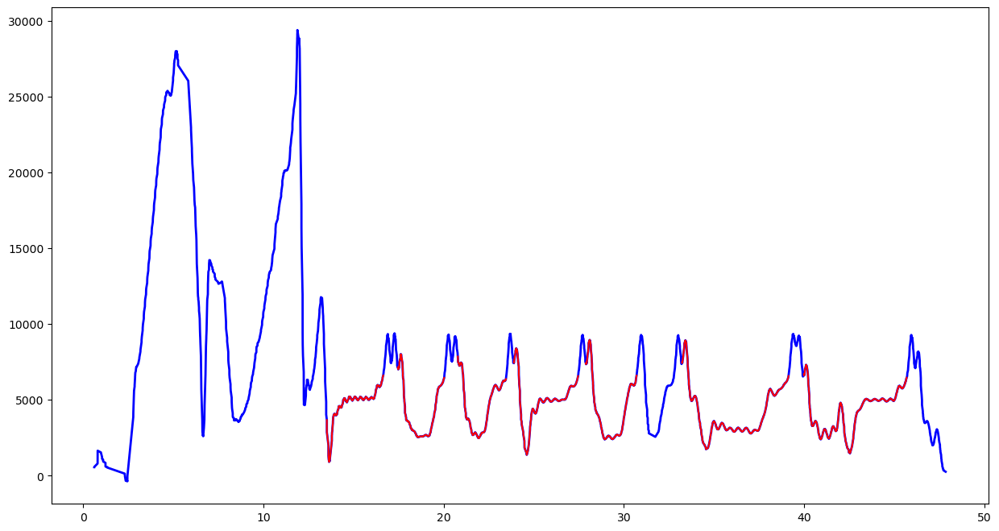

Feature Length  203


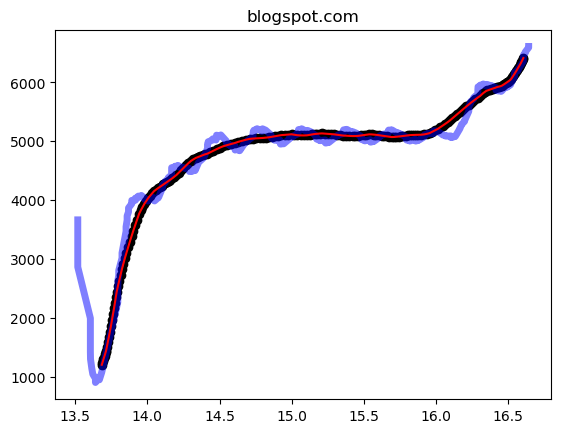

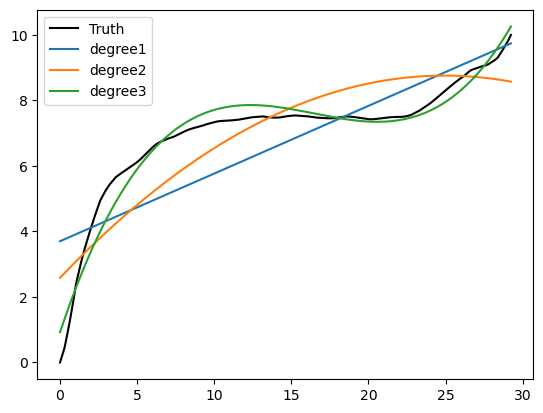

[ 0.00185168 -0.09037442  1.38335114  0.86975243]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.58218875e-139 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.com.ng-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.ng-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48732'])
Port 48732


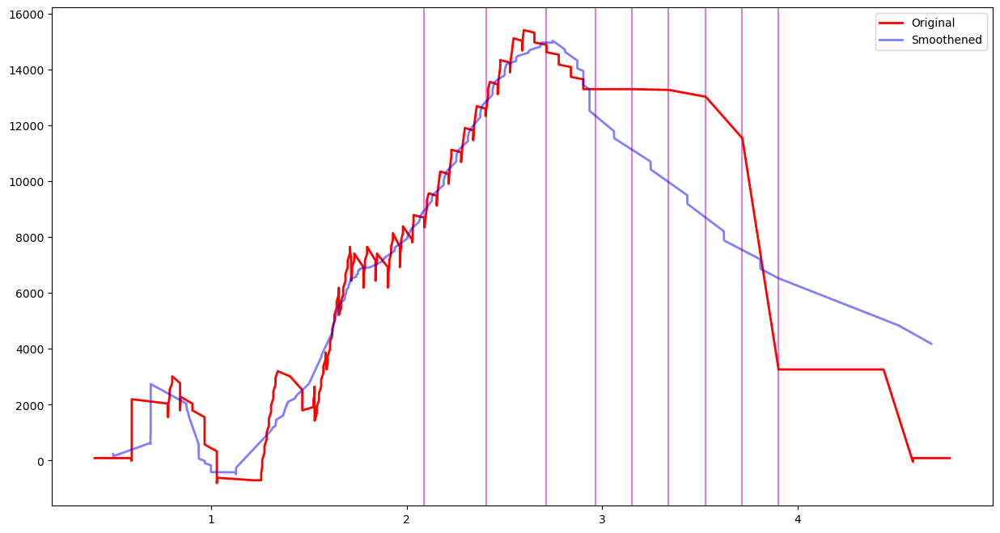

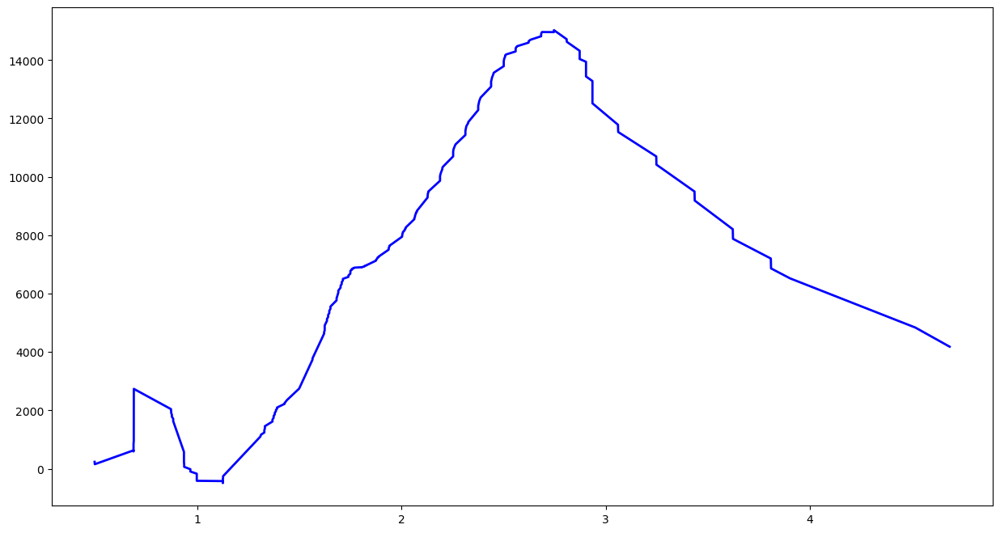

No Feature
../../singapore/top1k/theguardian.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/theguardian.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40564'])
Port 40564


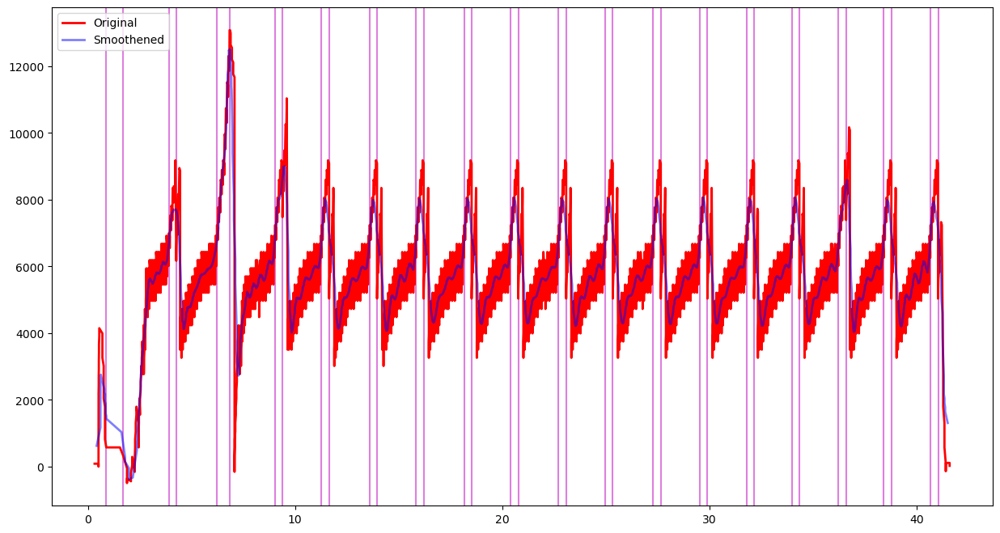

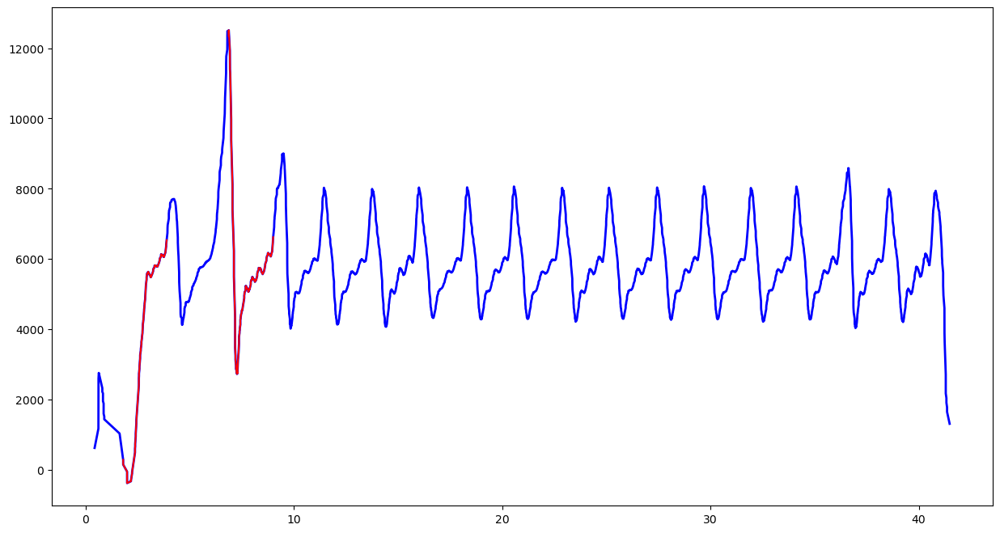

Feature Length  203


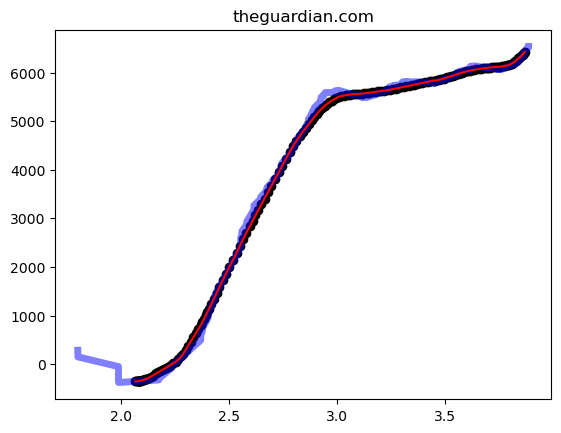

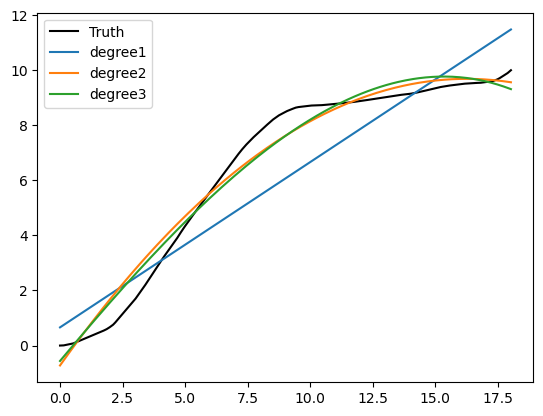

[-0.03756069  1.25750584 -0.82443916]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/godaddy.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/godaddy.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52006', '53936'])
Port 53936


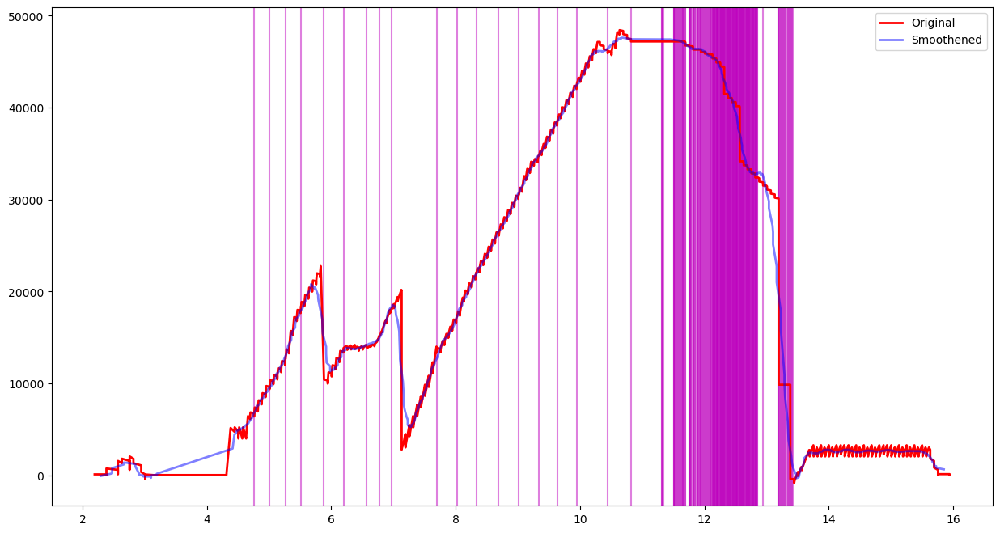

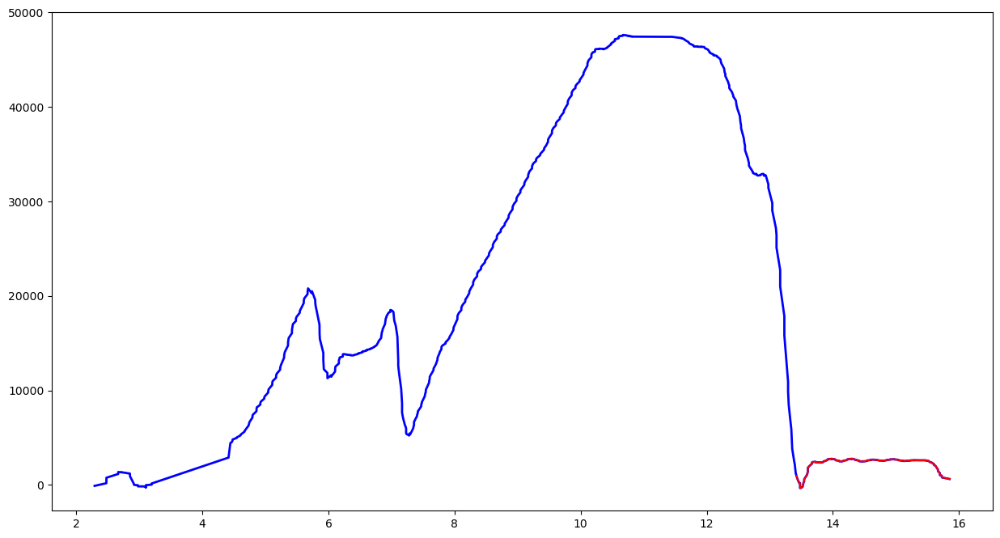

Feature Length  203


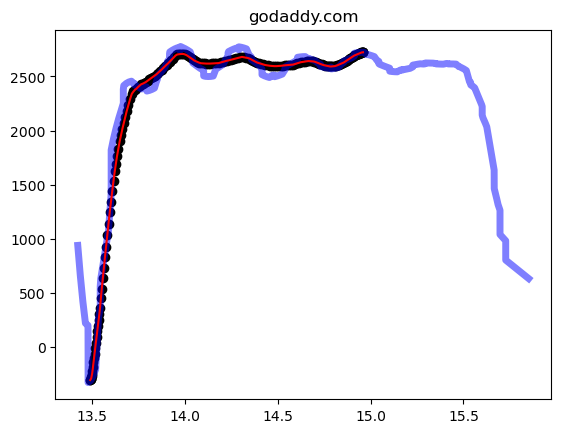

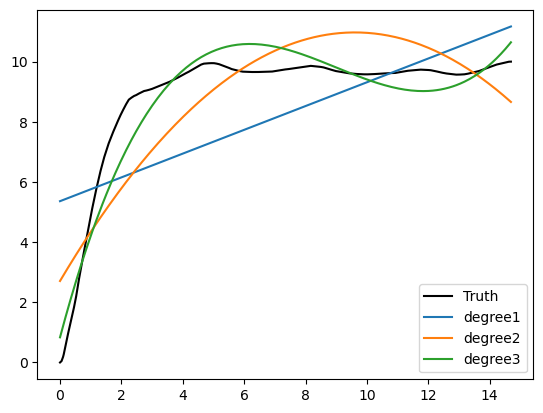

[ 0.01855777 -0.49370062  3.93662019  0.83605143]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [2.75933722e-70 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/reddit.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/reddit.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['58588', '58590'])
Port 58590


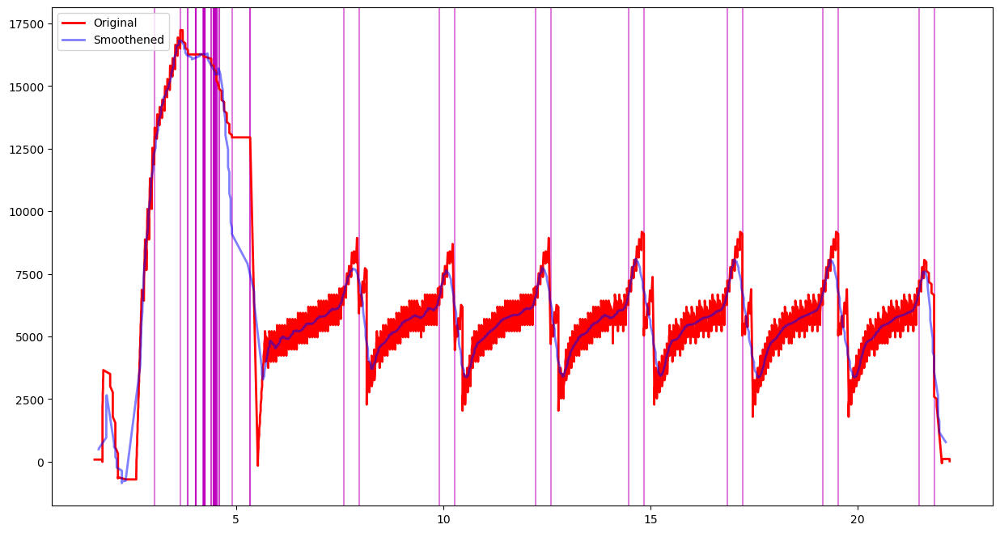

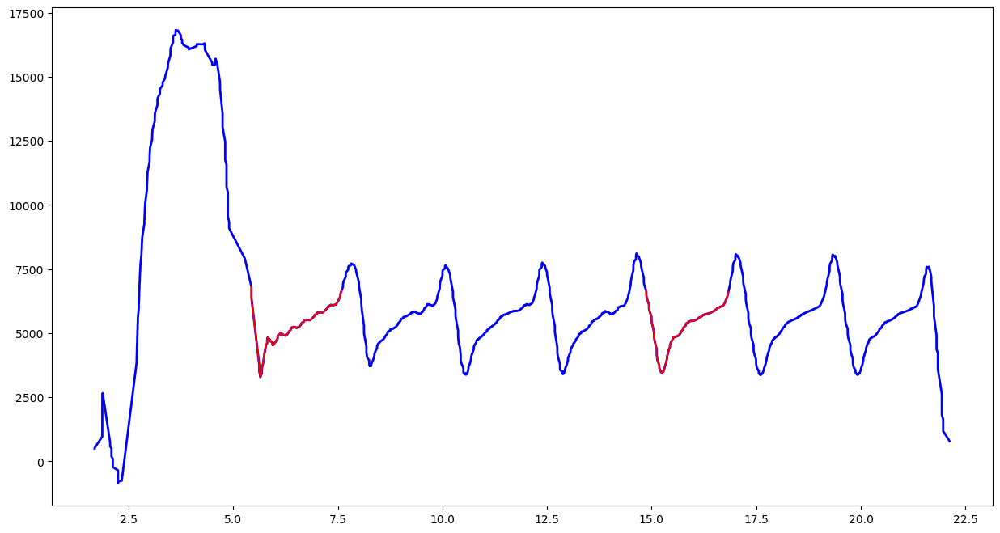

Feature Length  203


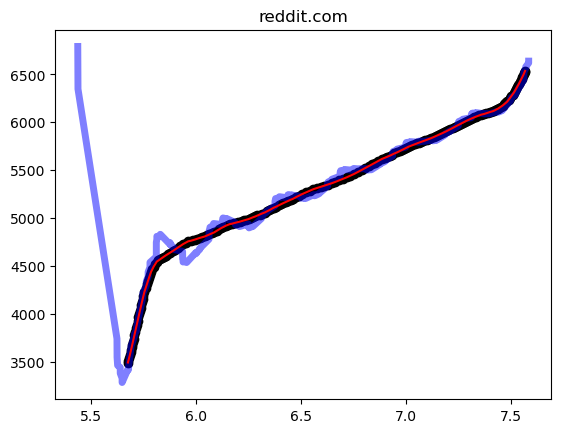

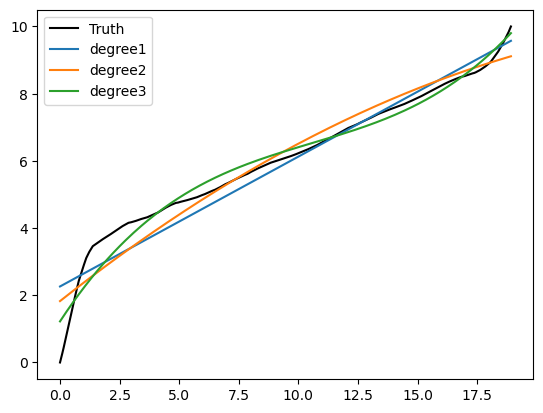

[0.38884033 2.28300573]
Top 5 CCS : ['yeah', 'nv', 'scalable', 'bic']
Density Values: [1.57049255e+01 1.69575171e+00 1.40678865e+00 2.55231085e-66]
Relative Density Values: [1.         0.10797579 0.08957627 0.        ]
Prediction: confused
../../singapore/top1k/activetect.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/activetect.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51408'])
Port 51408


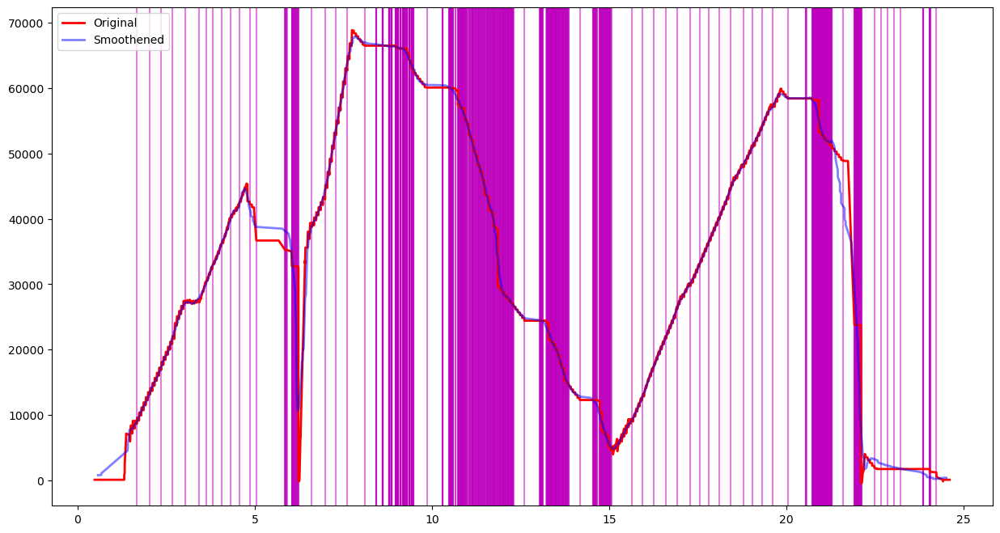

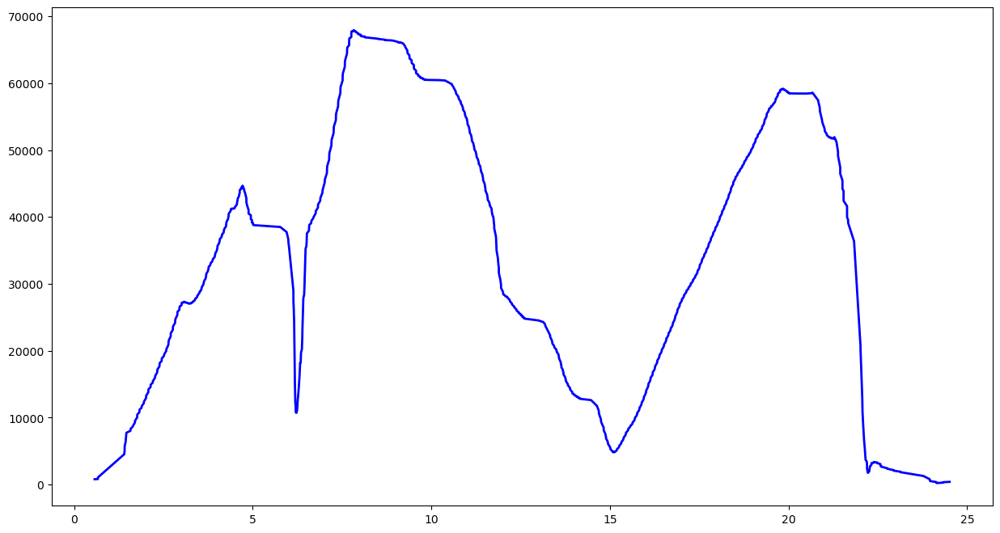

No Feature
../../singapore/top1k/indiatimes.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/indiatimes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50424'])
Port 50424


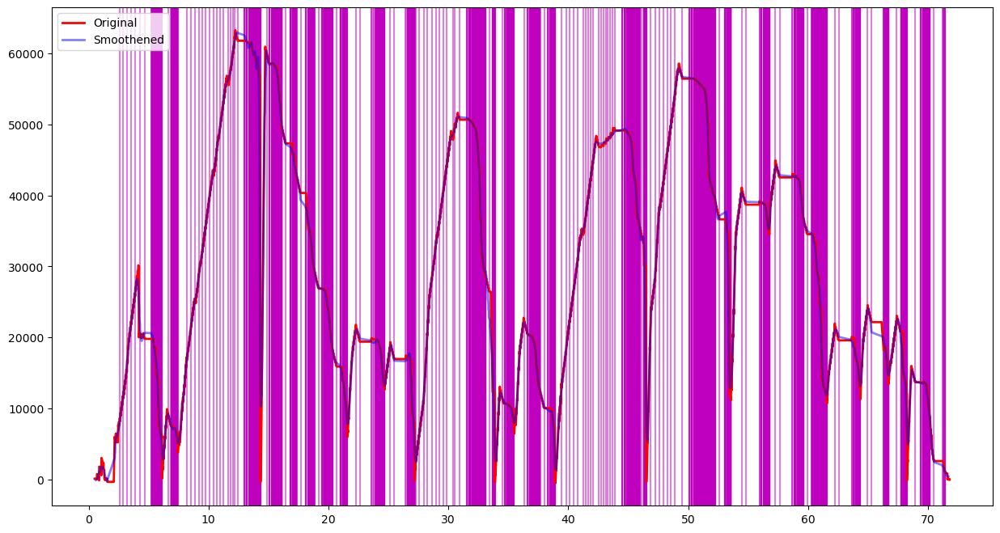

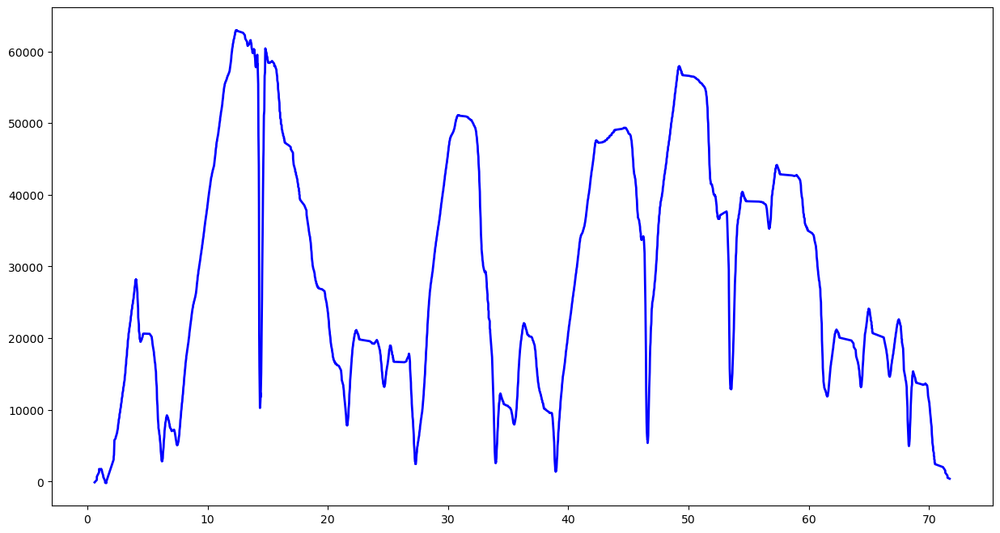

No Feature
../../singapore/top1k/mama.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/mama.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34114', '55932'])
Port 55932


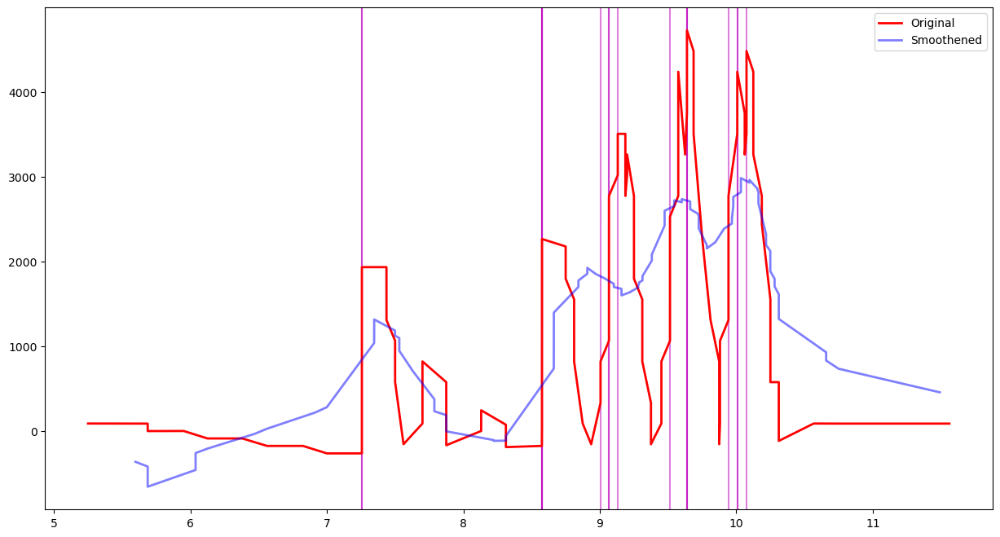

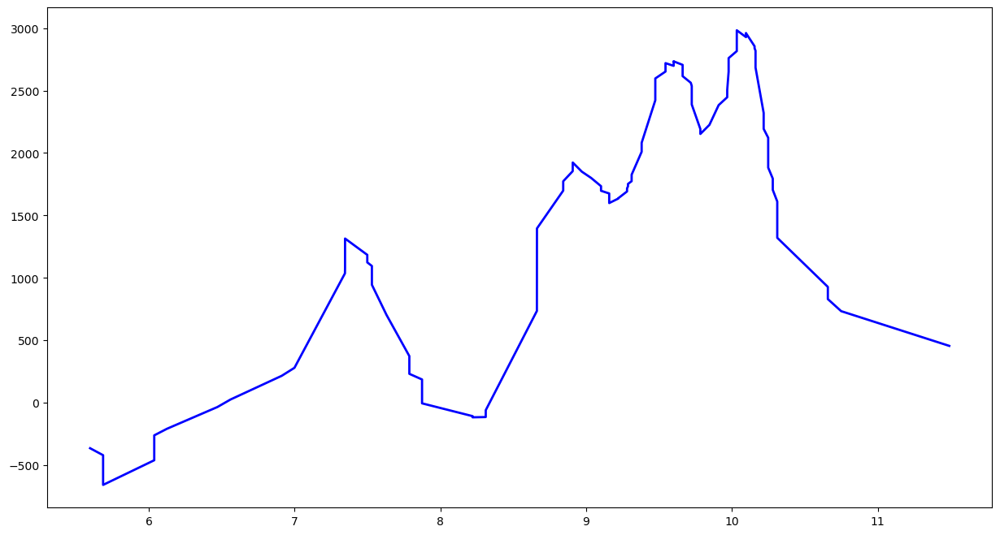

No Feature
../../singapore/top1k/instructure.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/instructure.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44204'])
Port 44204


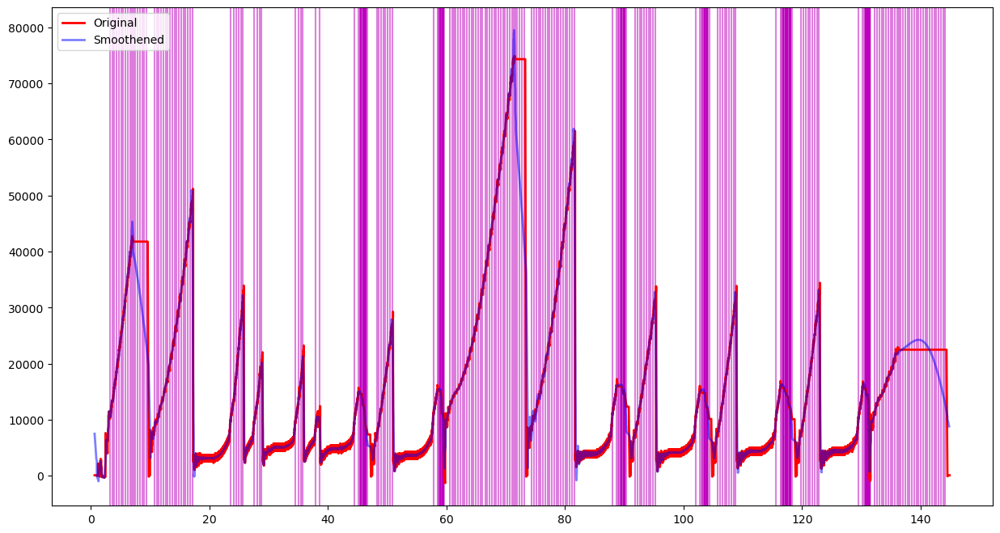

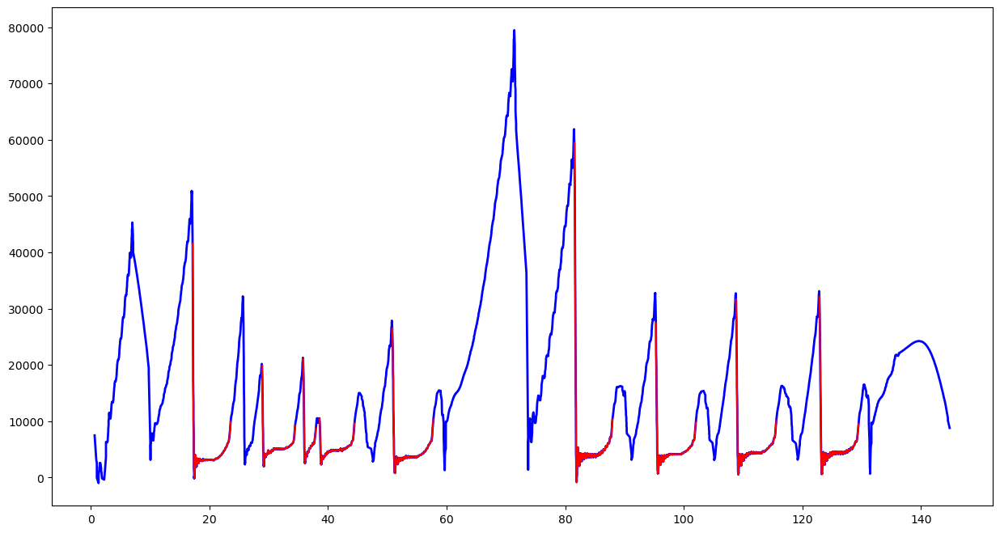

Feature Length  203


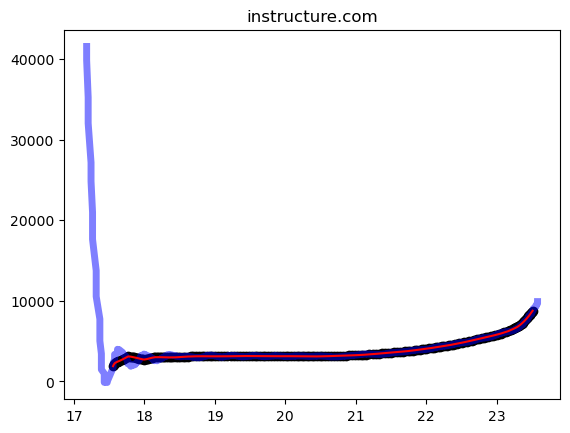

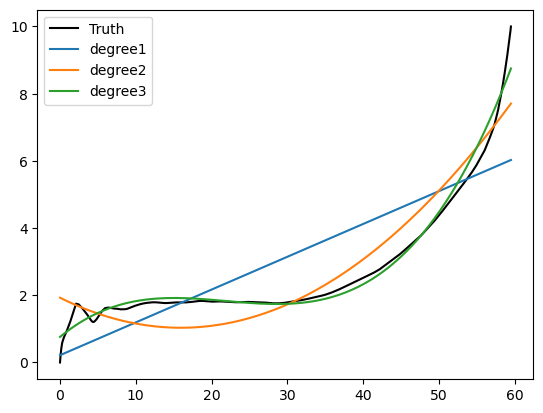

[ 1.34539057e-04 -8.23355378e-03  1.40809825e-01  9.91629314e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [7.81416398e-07 4.83594856e-77 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 6.18869603e-71 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/yelp.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yelp.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59674'])
Port 59674


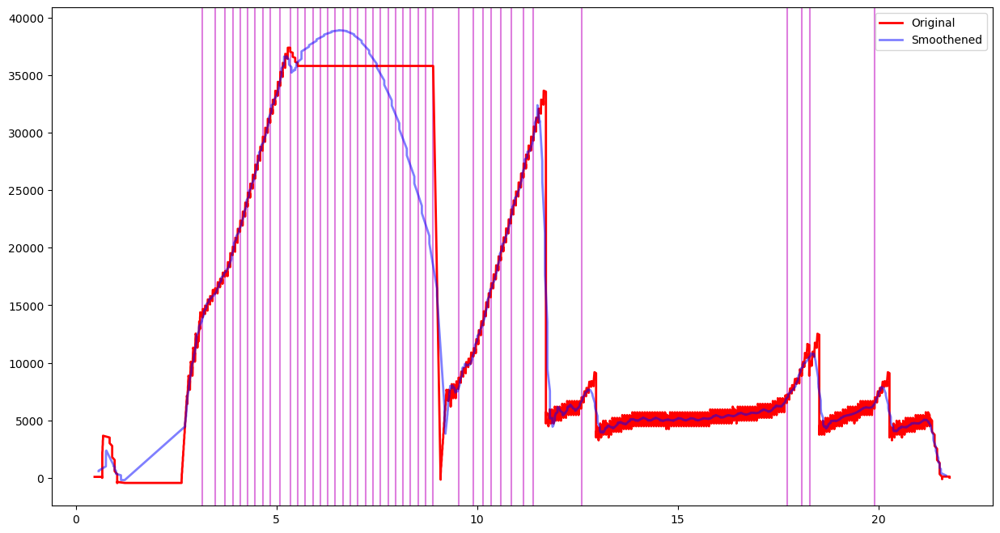

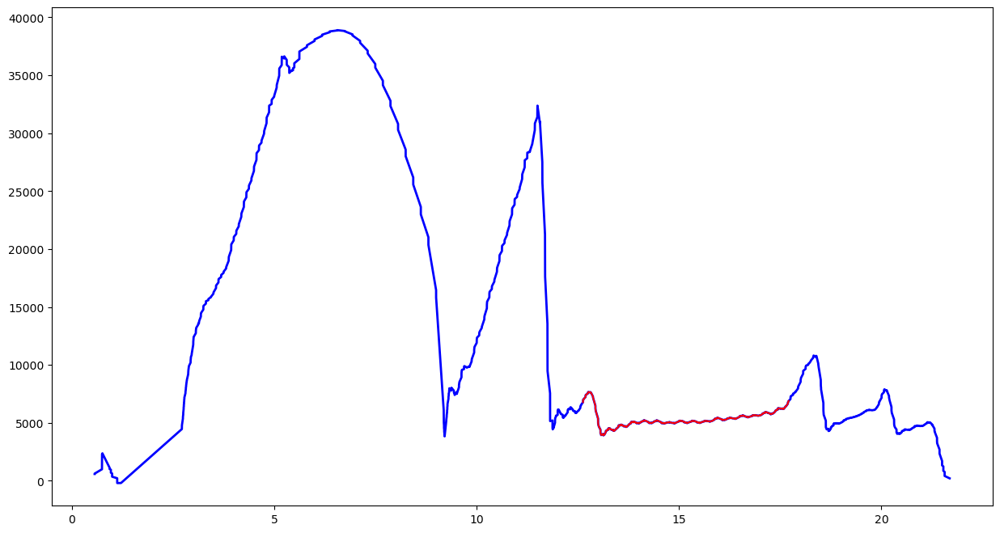

Feature Length  203


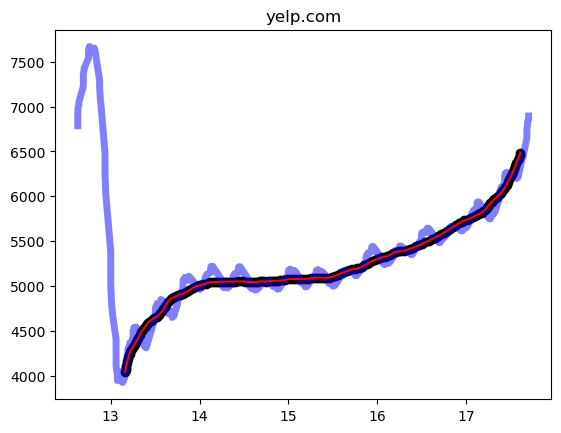

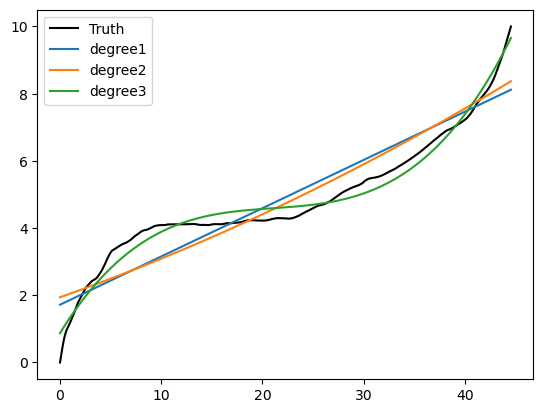

[ 3.46542116e-04 -2.19433425e-02  5.01169701e-01  3.62051229e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.27726203e+07 5.17689378e-39 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 4.05311804e-46 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/google.ch-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.ch-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50480'])
Port 50480


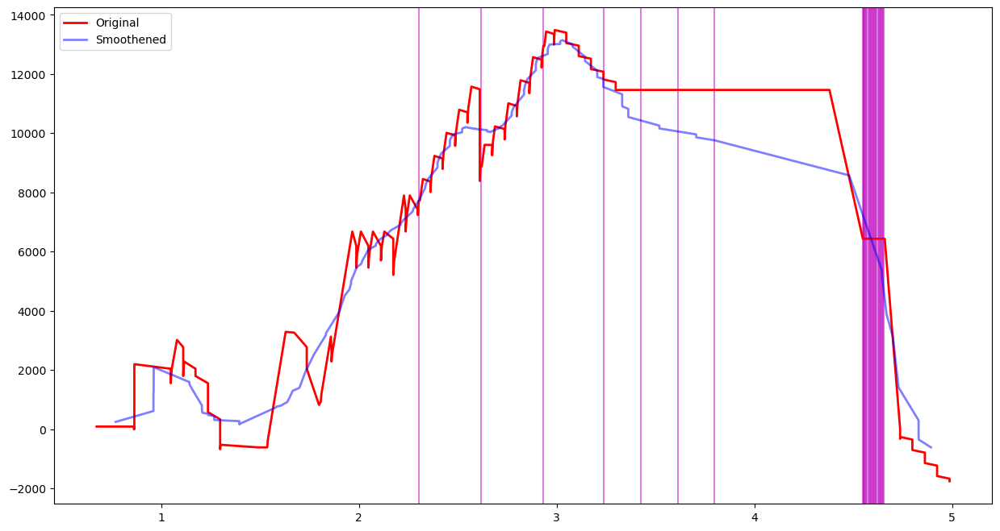

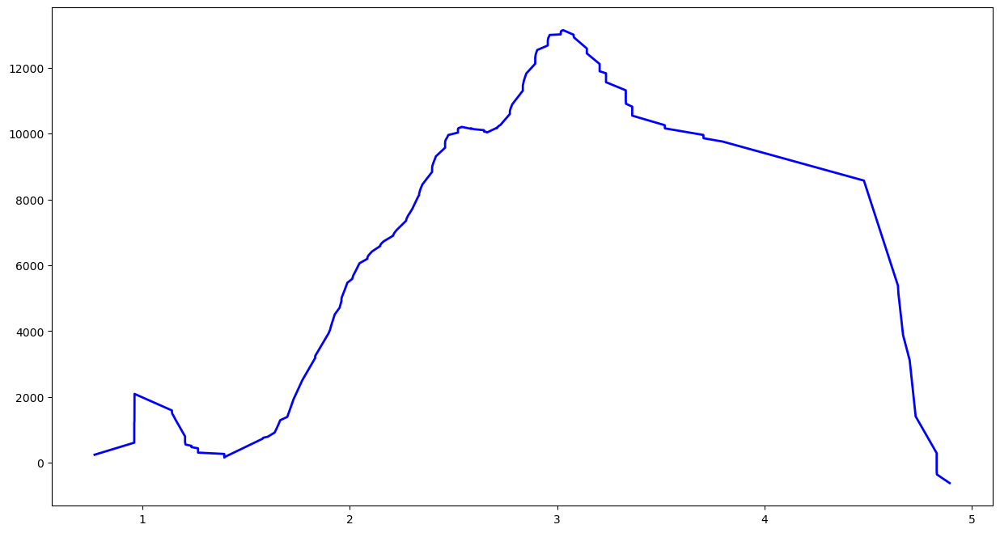

No Feature
../../singapore/top1k/google.com.tw-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.tw-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57864'])
Port 57864


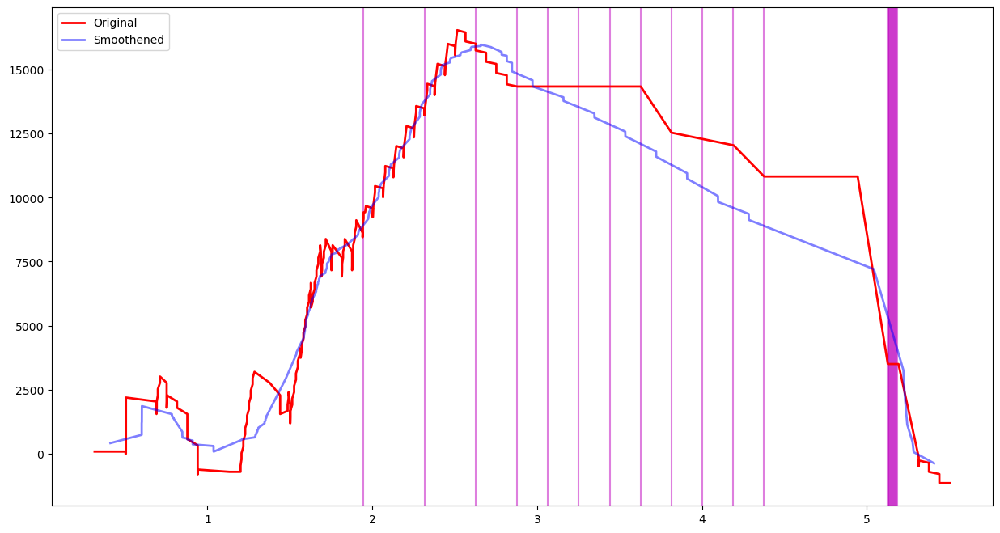

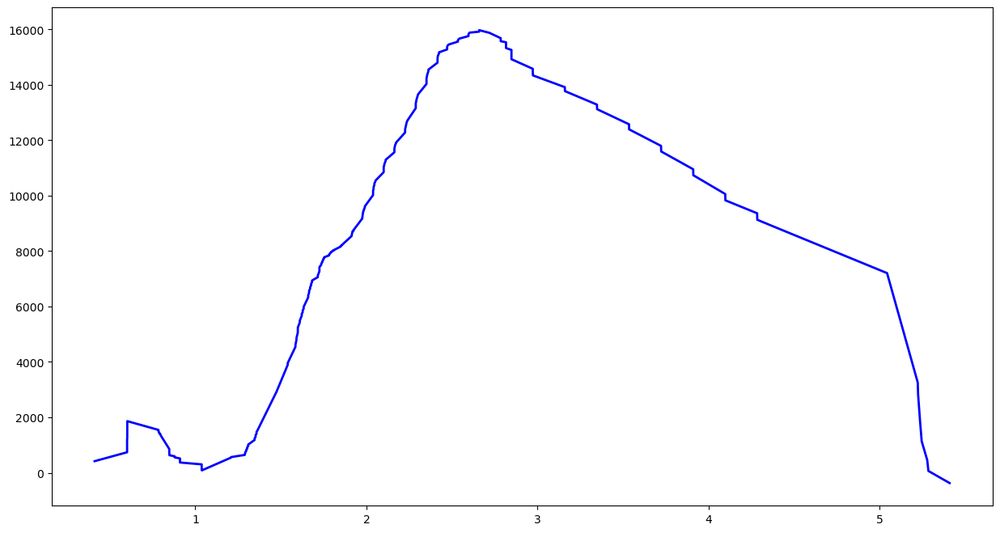

No Feature
../../singapore/top1k/onlinevideoconverter.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/onlinevideoconverter.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56308', '60532'])
Port 60532


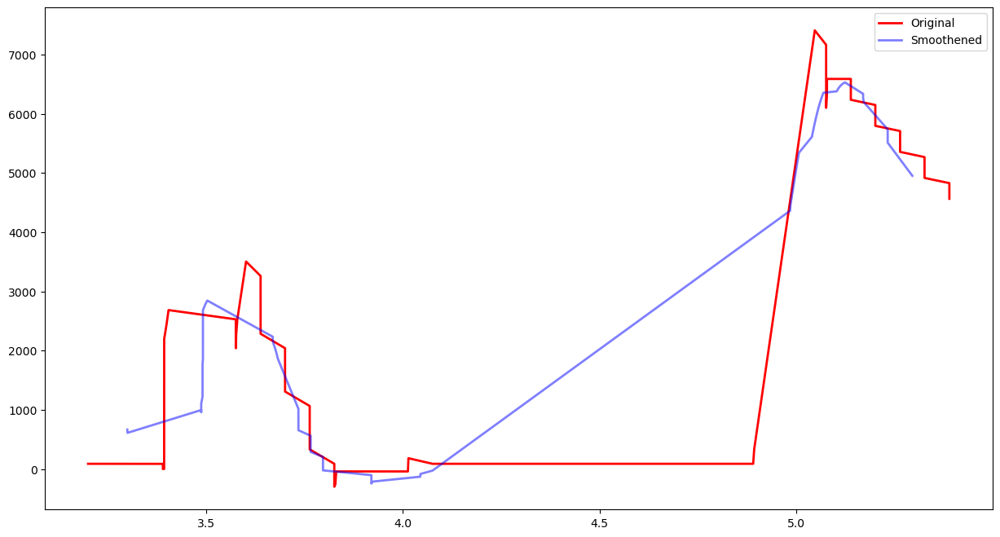

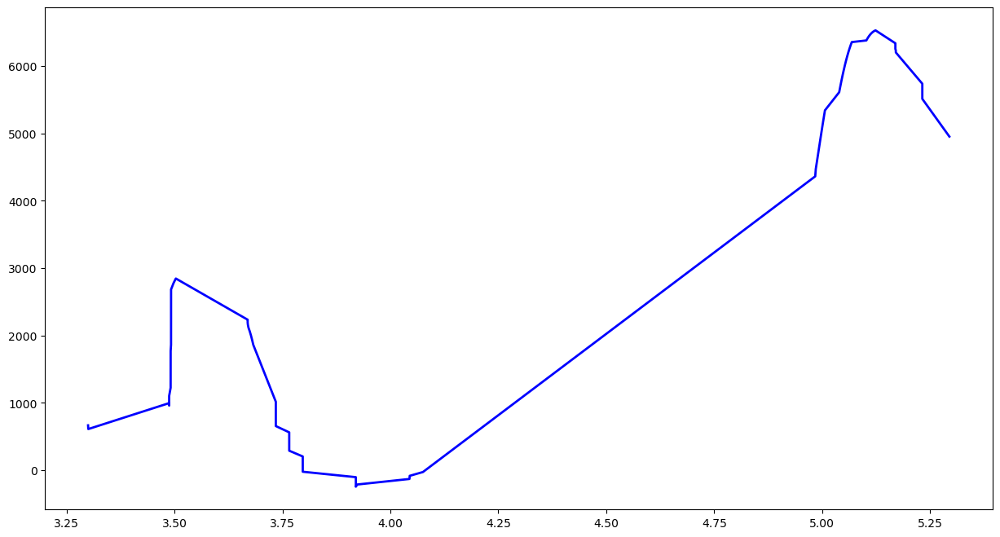

No Feature
../../singapore/top1k/whatsapp.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/whatsapp.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43748'])
Port 43748


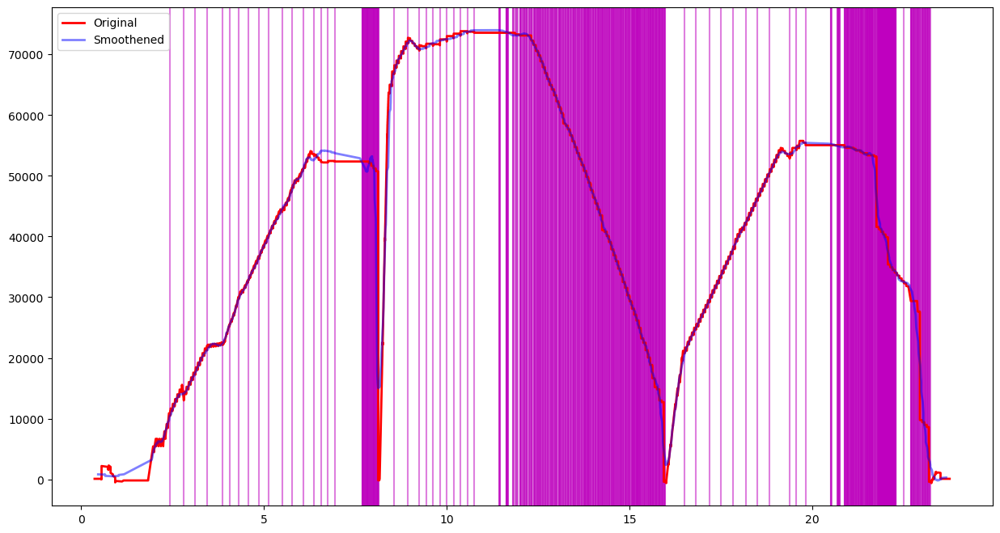

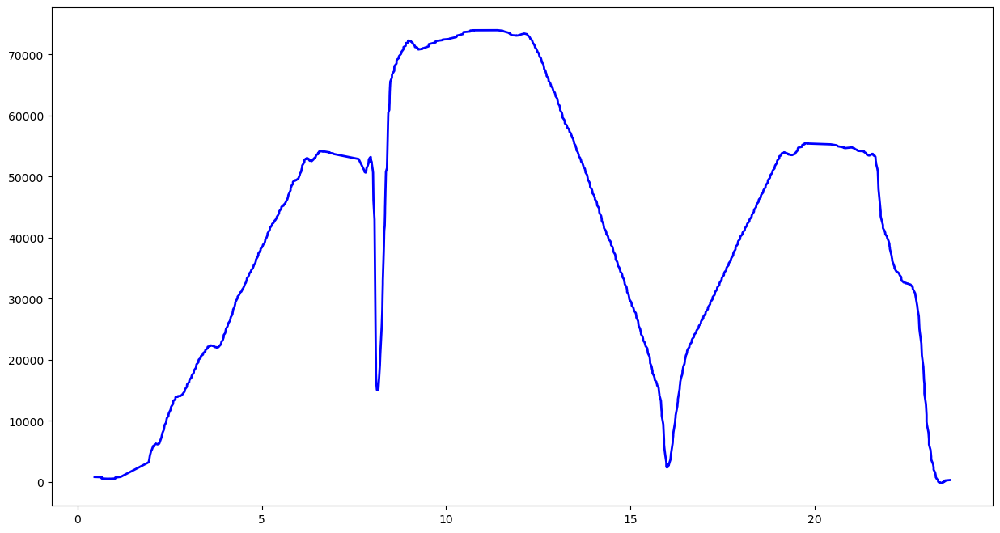

No Feature
../../singapore/top1k/bbc.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bbc.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57372'])
Port 57372


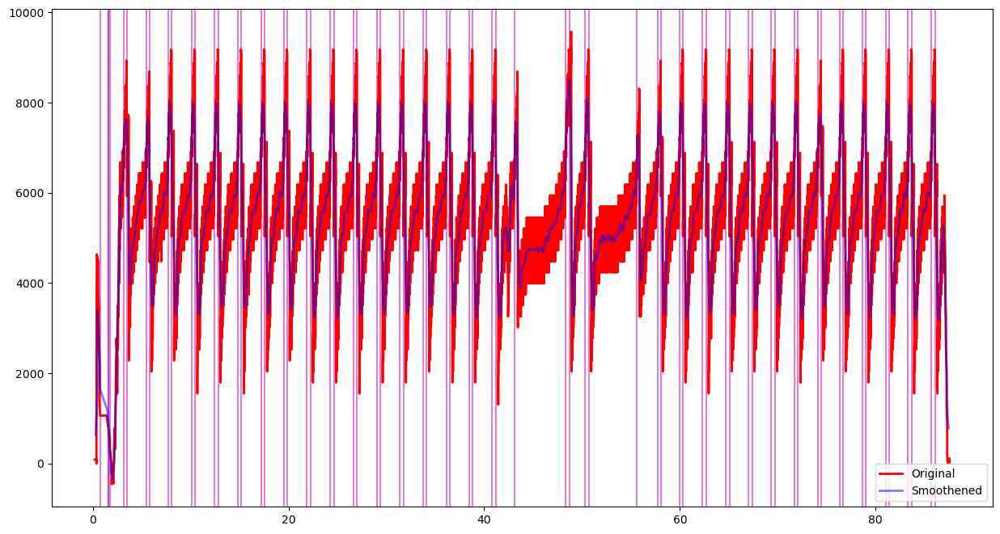

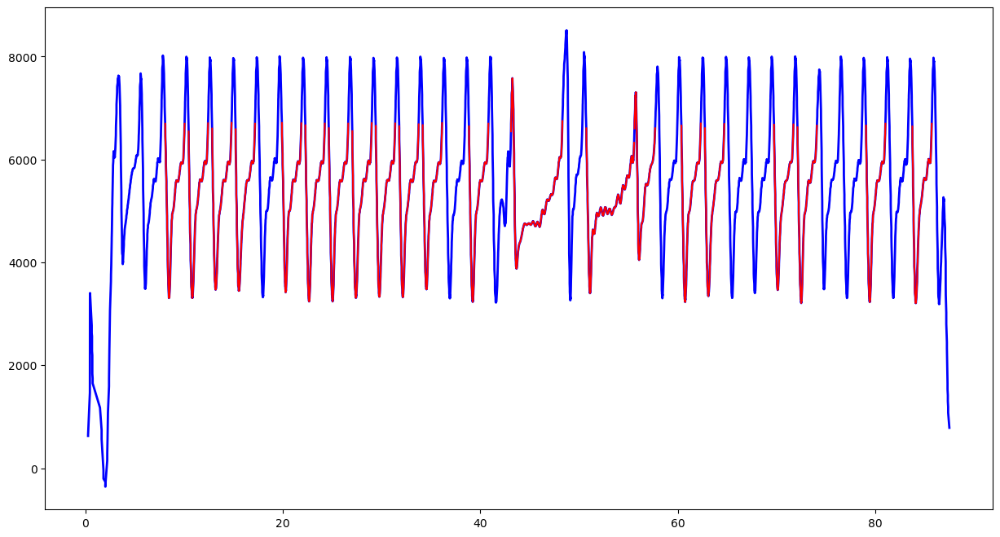

Feature Length  203


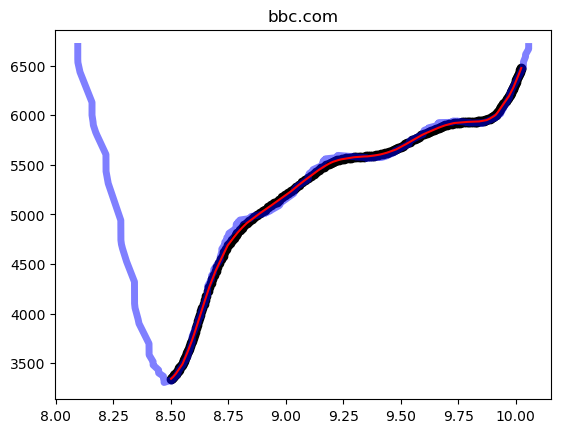

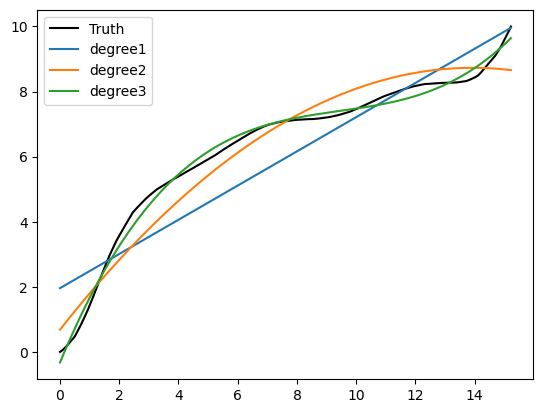

[ 0.00734417 -0.20777139  2.10648647 -0.31391413]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.62029481e-59 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.cl-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.cl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55648'])
Port 55648


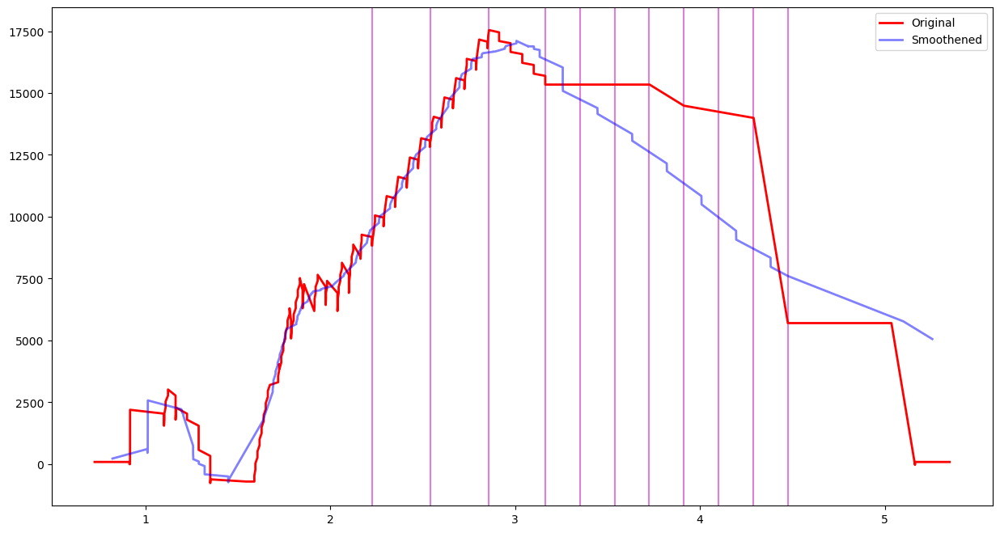

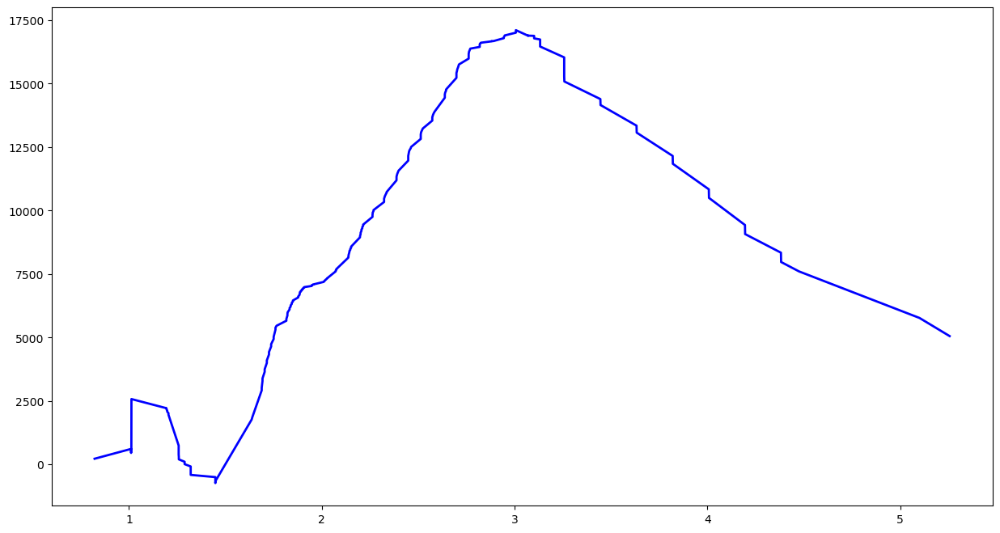

No Feature
../../singapore/top1k/caijing.com.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/caijing.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34936'])
Port 34936


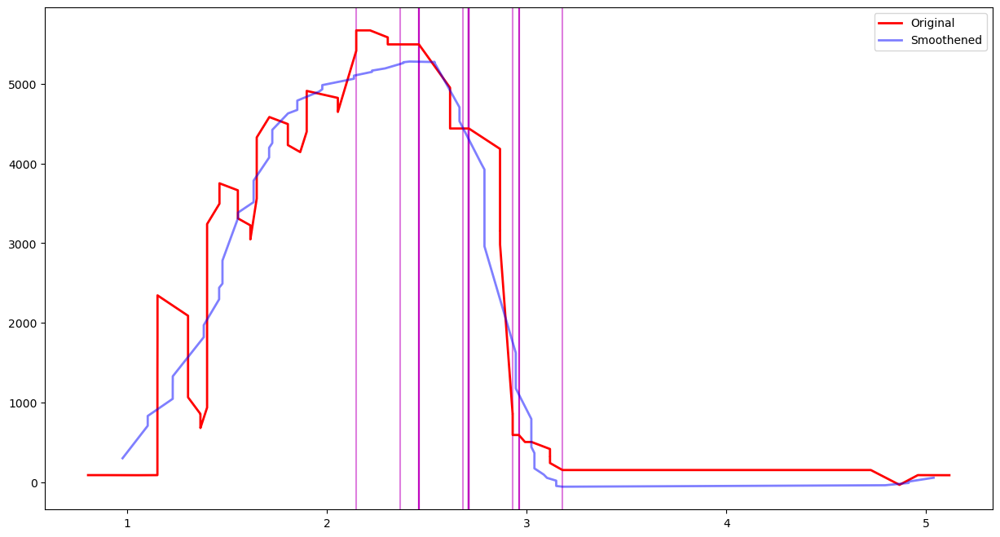

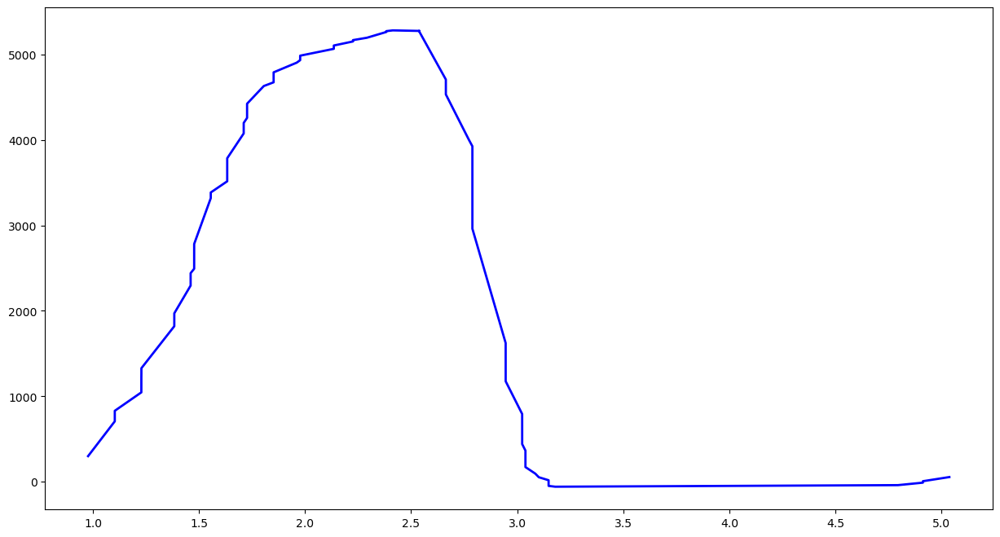

No Feature
../../singapore/top1k/setn.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/setn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34312'])
Port 34312


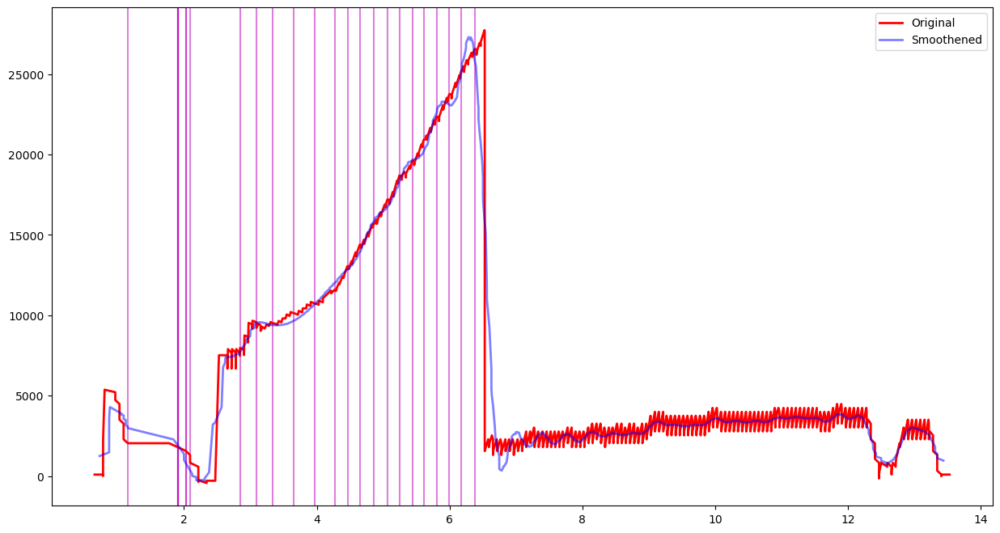

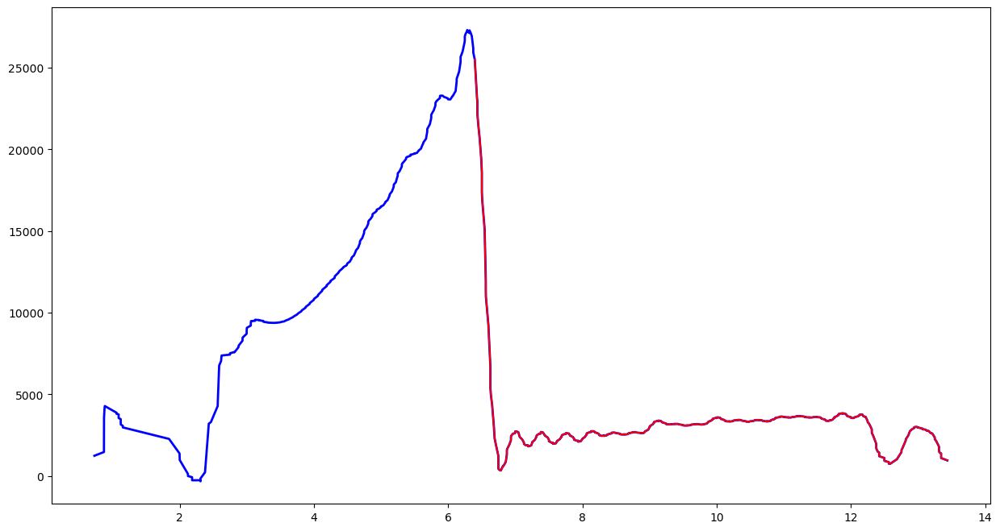

Feature Length  203


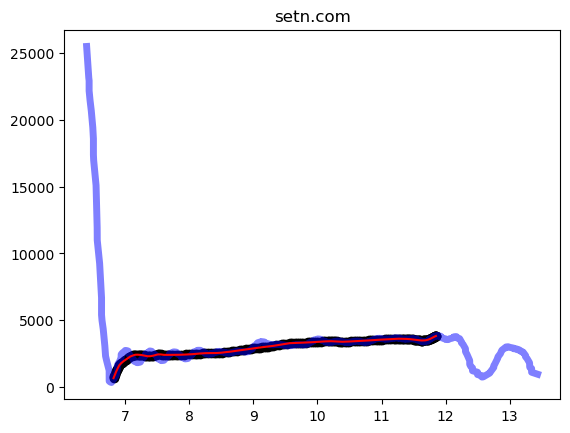

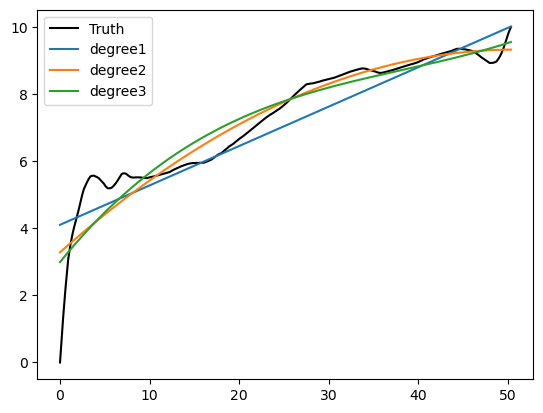

[-2.57854963e-03  2.64095567e-01  2.82693132e+00]
Top 5 CCS : ['westwood', 'dctcp', 'lp', 'highspeed', 'reno']
Density Values: [5.56142209e+01 8.74686444e-23 1.97919299e-25 2.29094860e-27
 7.45151138e-37]
Relative Density Values: [1.00000000e+00 1.57277479e-24 3.55878939e-27 4.11935753e-29
 0.00000000e+00]
Prediction: westwood
../../singapore/top1k/babytree.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/babytree.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39864'])
Port 39864


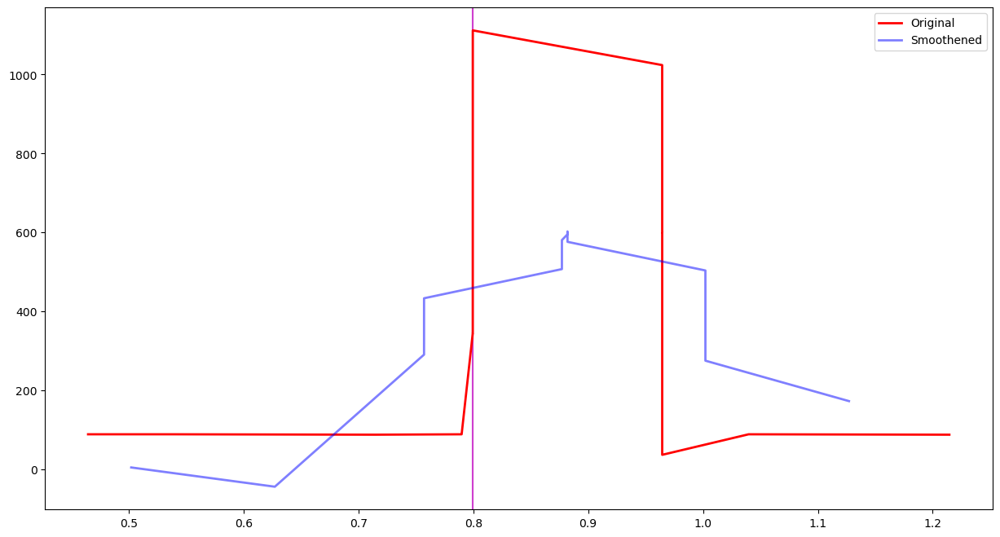

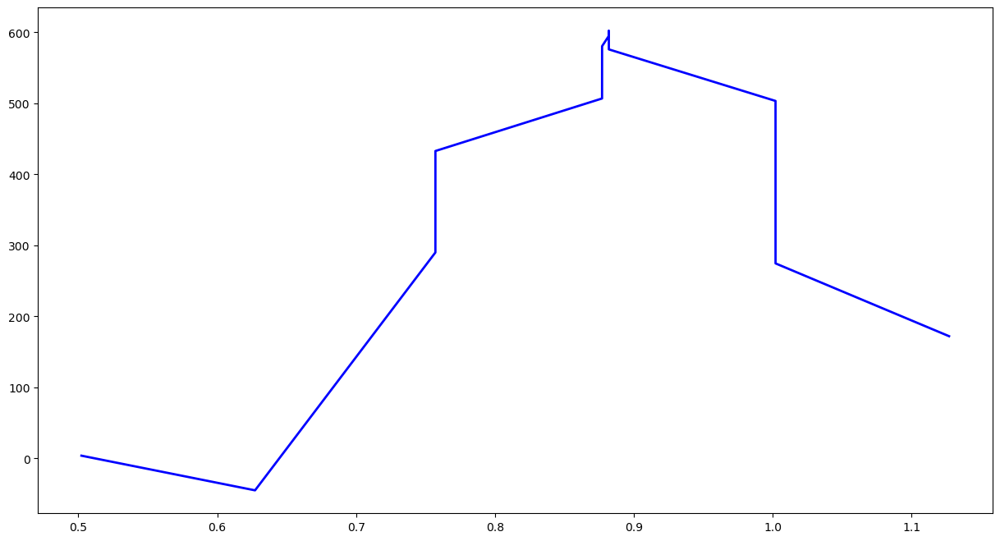

No Feature
../../singapore/top1k/stackoverflow.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/stackoverflow.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50658'])
Port 50658


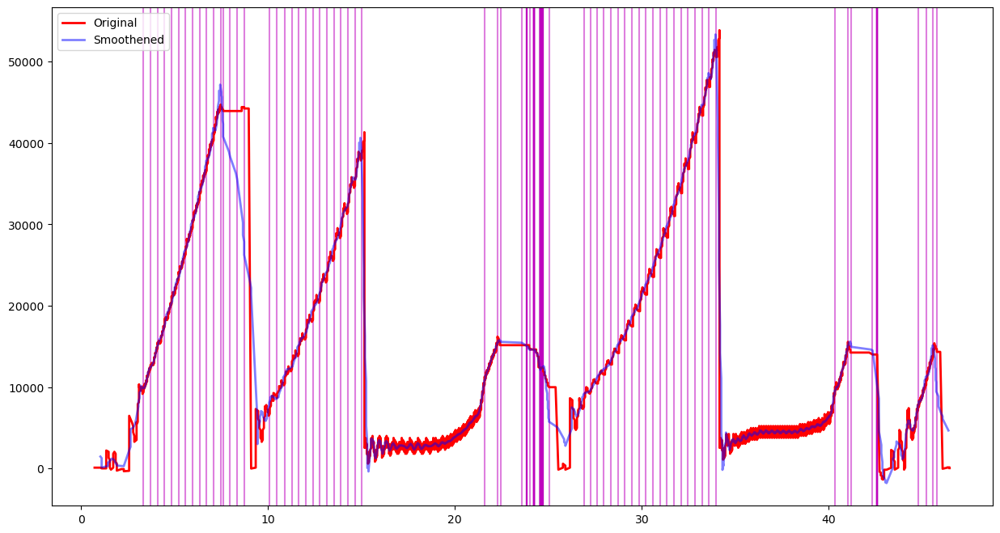

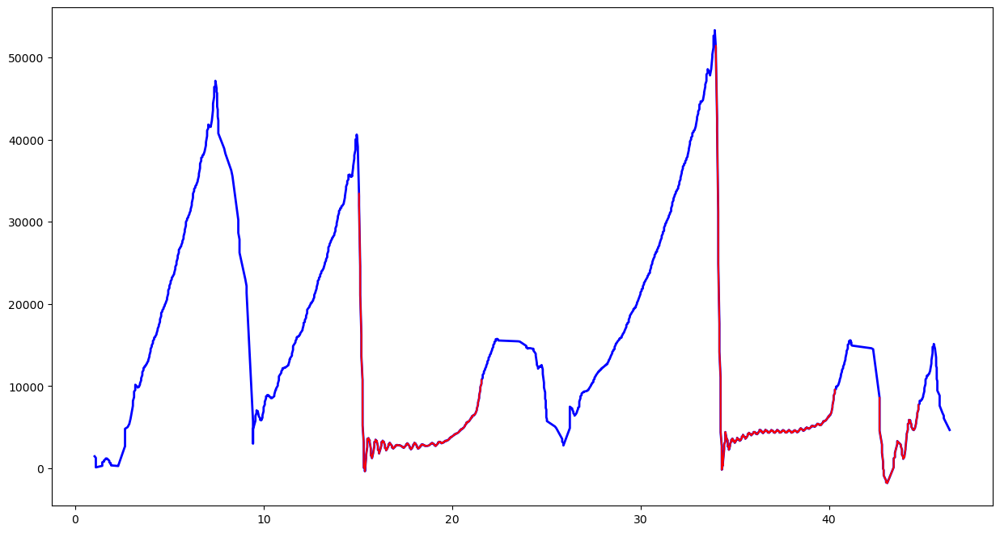

Feature Length  203


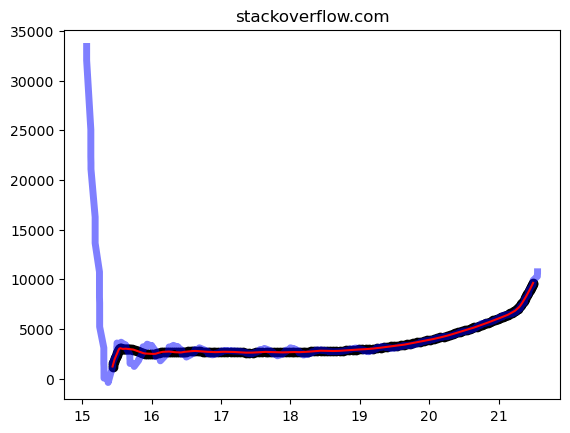

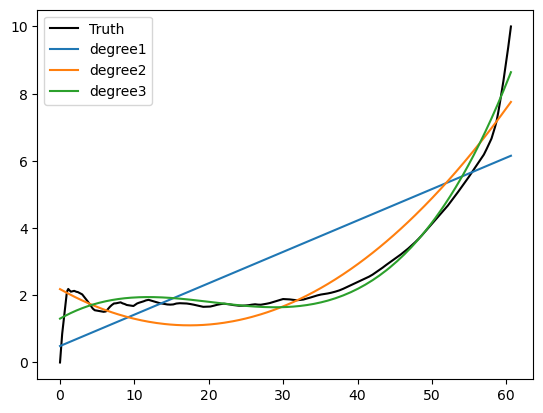

[ 1.36790767e-04 -8.94200773e-03  1.65947109e-01  1.01026152e+00]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [1.46839037e-05 1.41066588e-71 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 9.60688588e-67 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/google.pt-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.pt-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49088'])
Port 49088


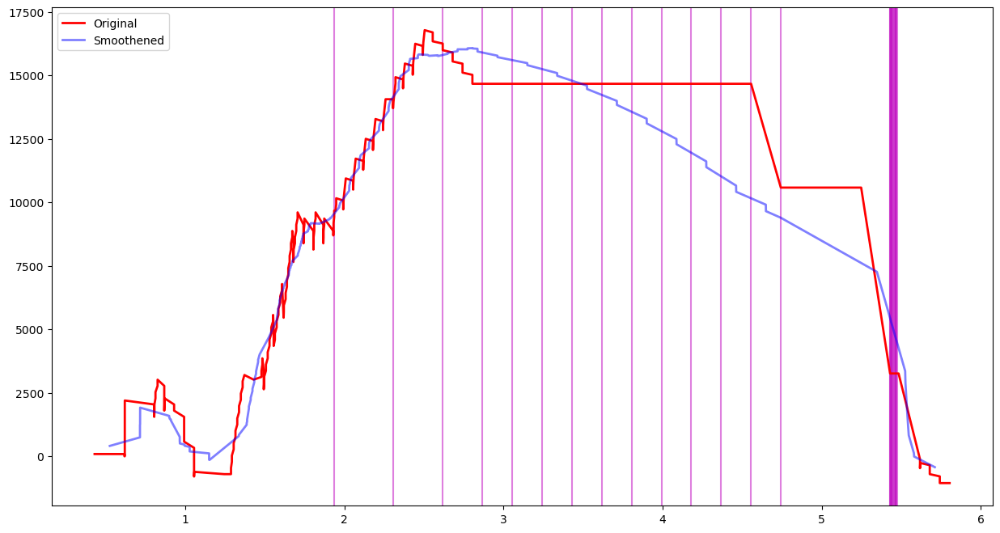

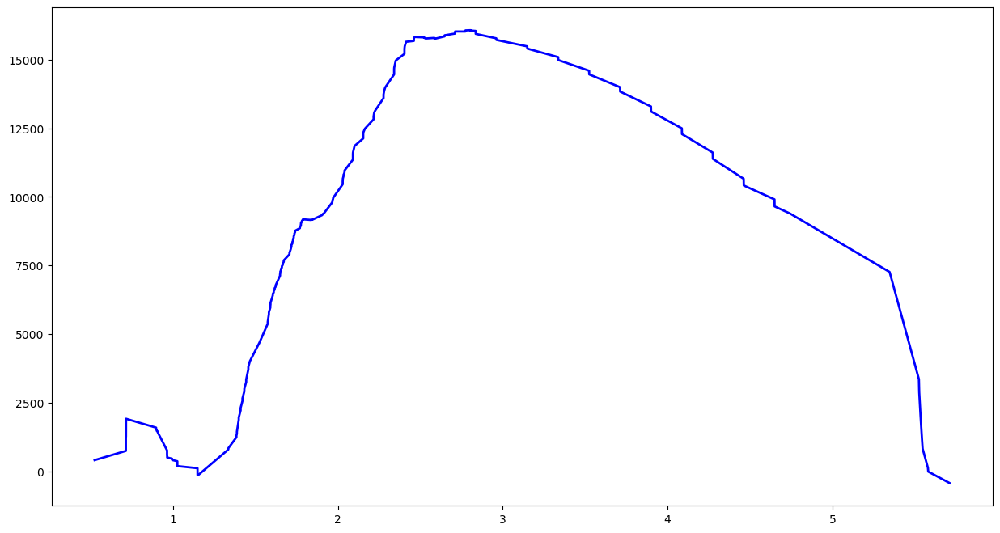

No Feature
../../singapore/top1k/stackexchange.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/stackexchange.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33994'])
Port 33994


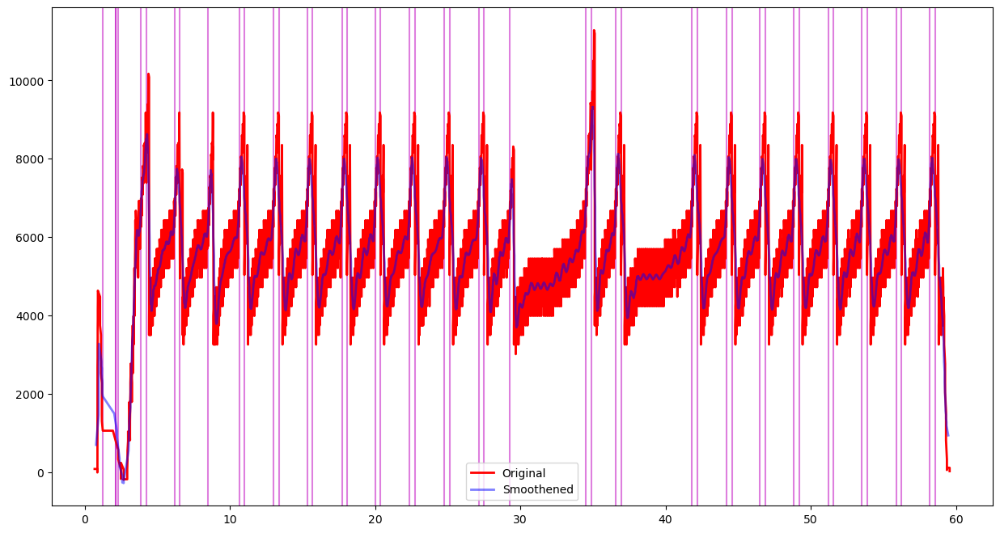

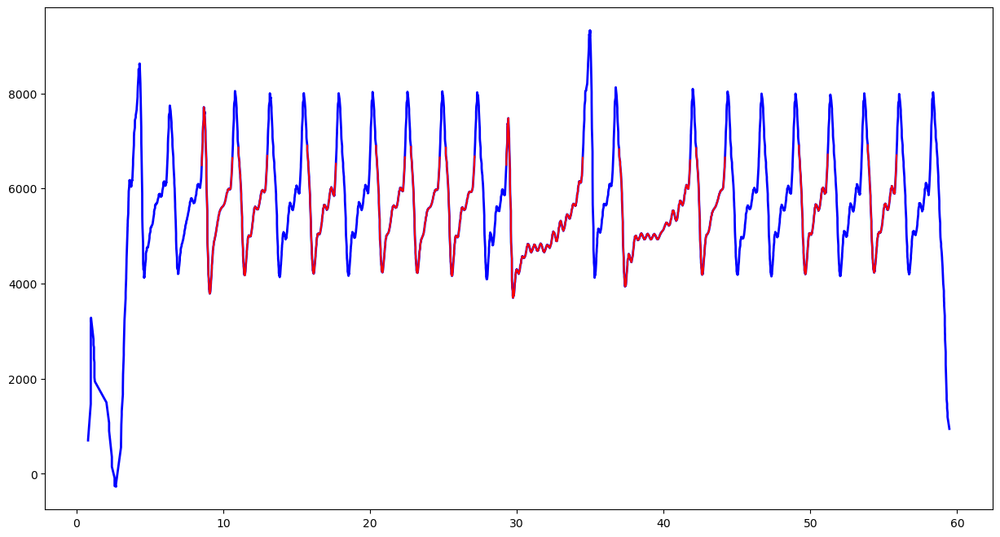

Feature Length  203


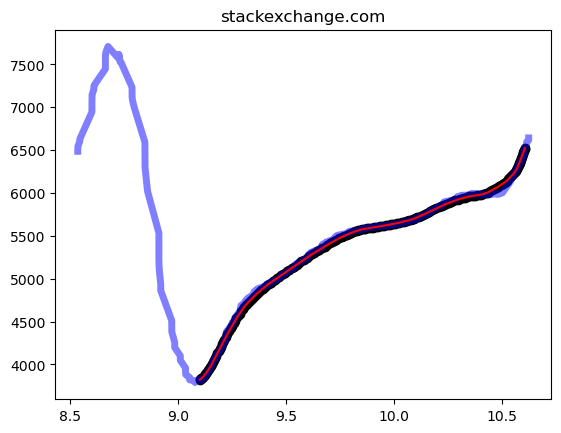

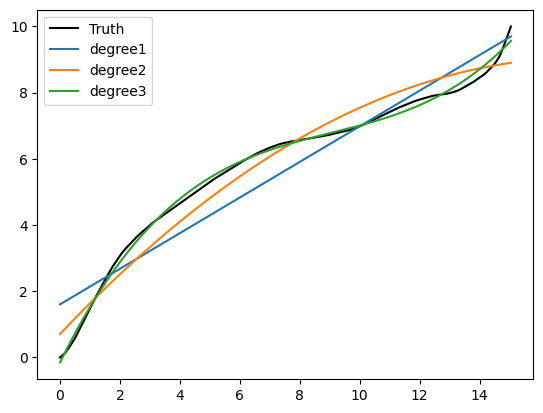

[ 0.00624677 -0.17457143  1.86021552 -0.21875211]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [3.8767993e-61 0.0000000e+00 0.0000000e+00 0.0000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/globo.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/globo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53324'])
Port 53324


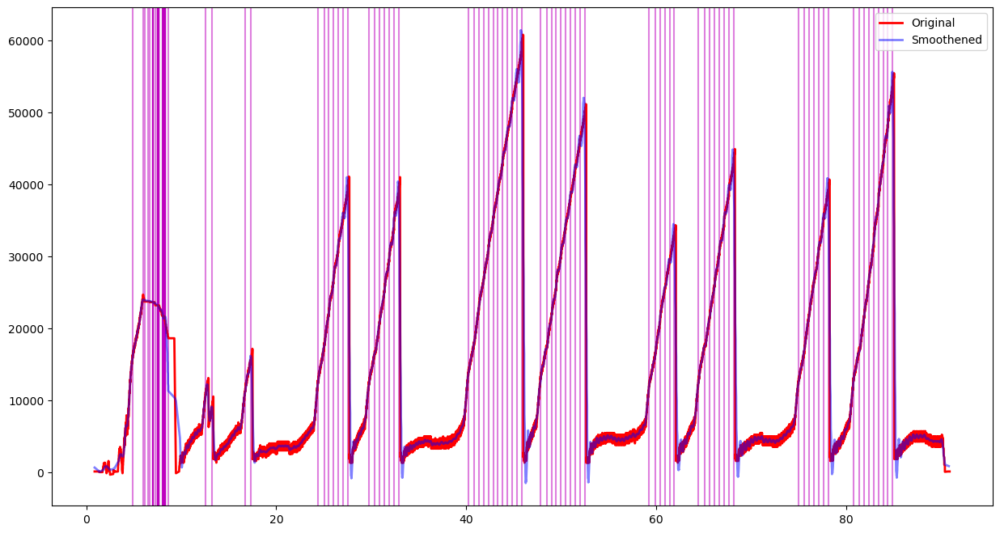

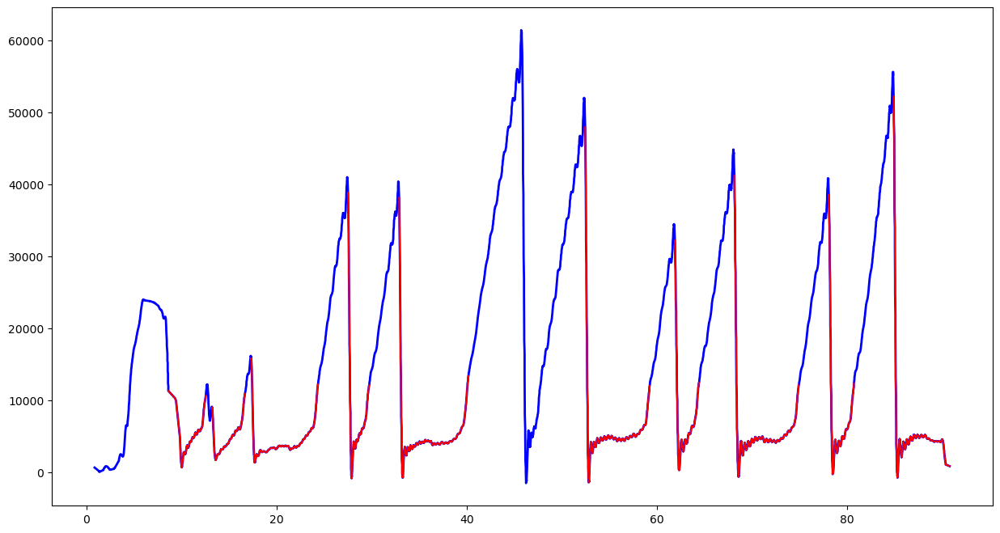

Feature Length  203


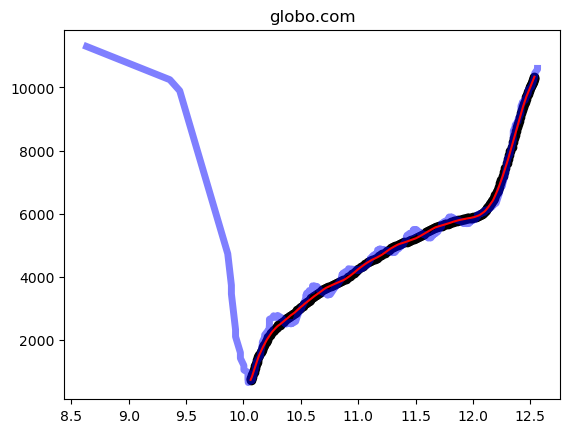

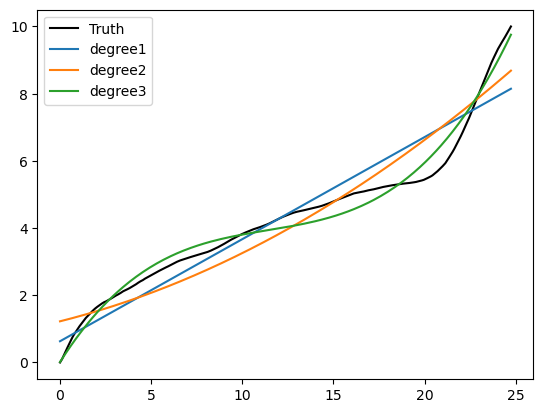

[ 0.00180748 -0.06113427  0.79962014  0.1395817 ]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [1.24039071e-35 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/linkedin.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/linkedin.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50590'])
Port 50590


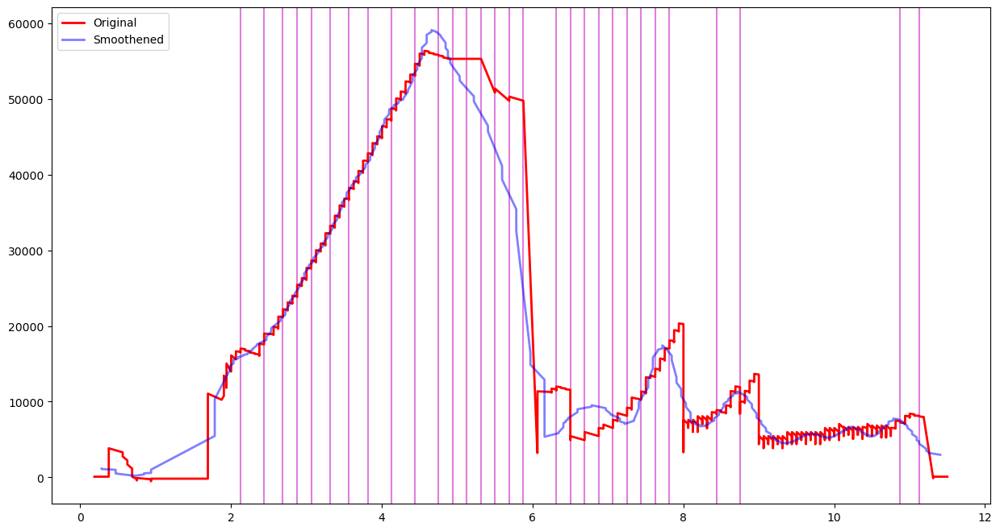

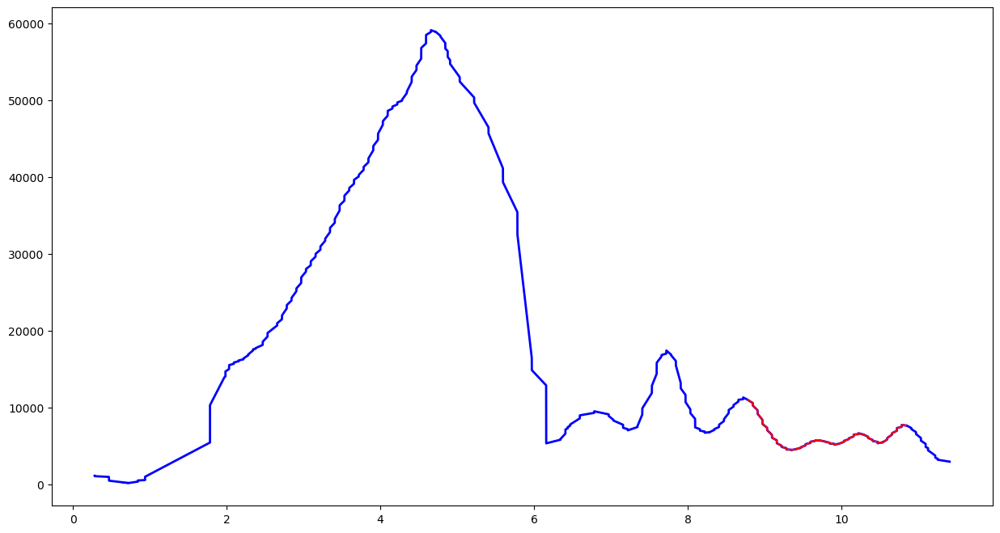

Feature Length  203


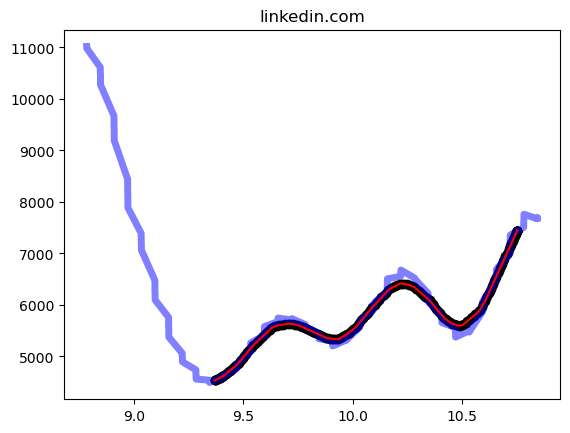

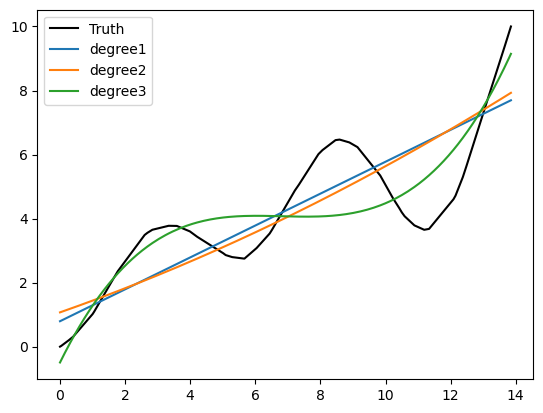

[ 0.0138853  -0.28427715  1.93967711 -0.30425292]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [9.71323441e-229 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/yy.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yy.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48334', '58034'])
Port 58034


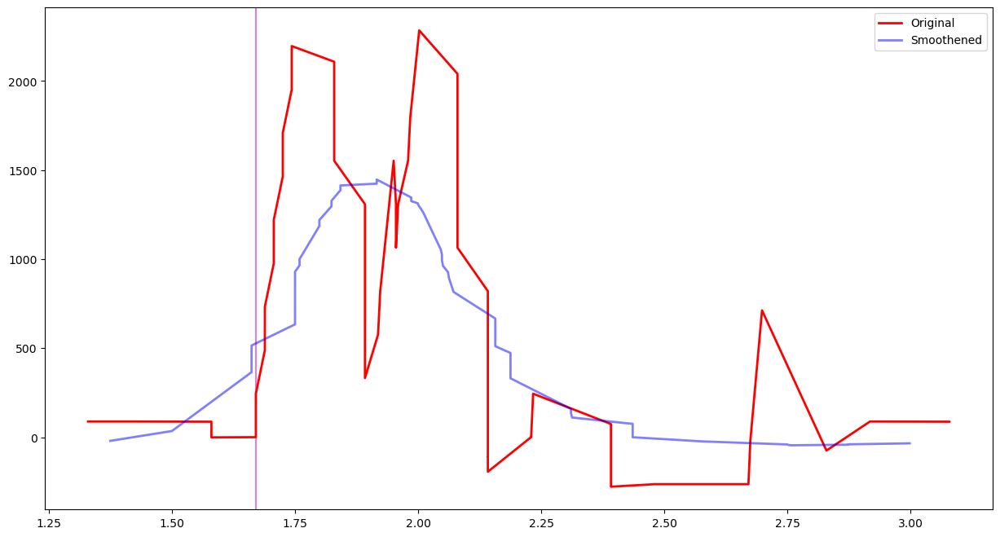

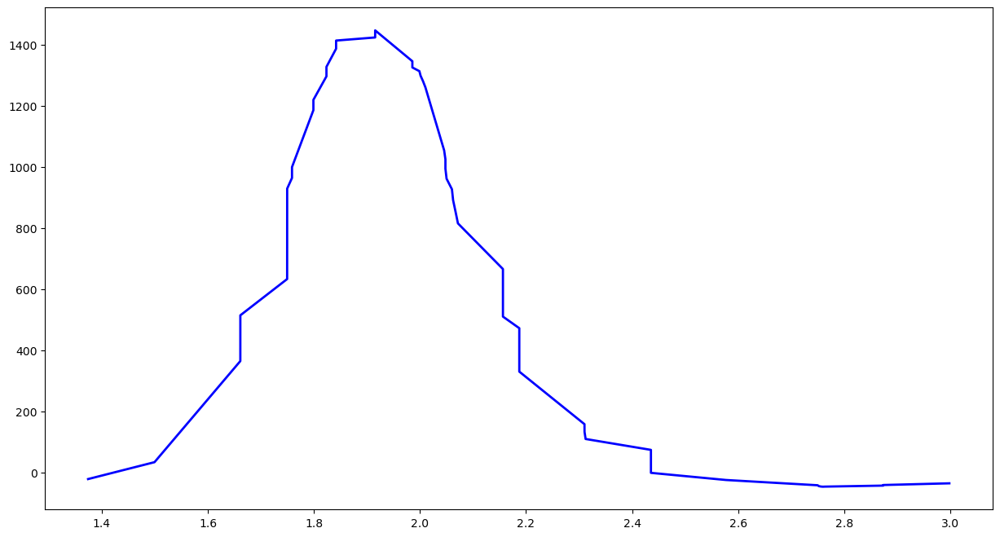

No Feature
../../singapore/top1k/amazon.fr-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/amazon.fr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45672'])
Port 45672


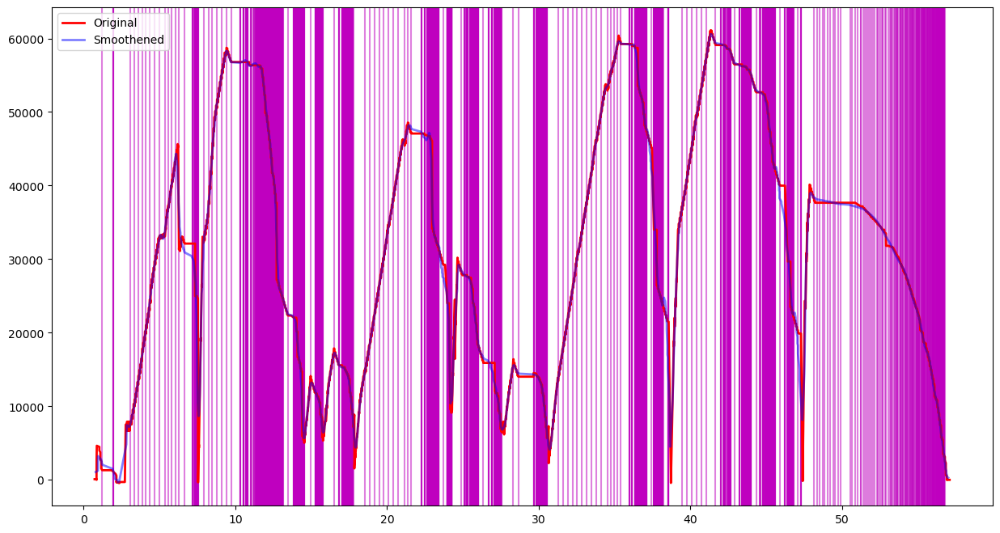

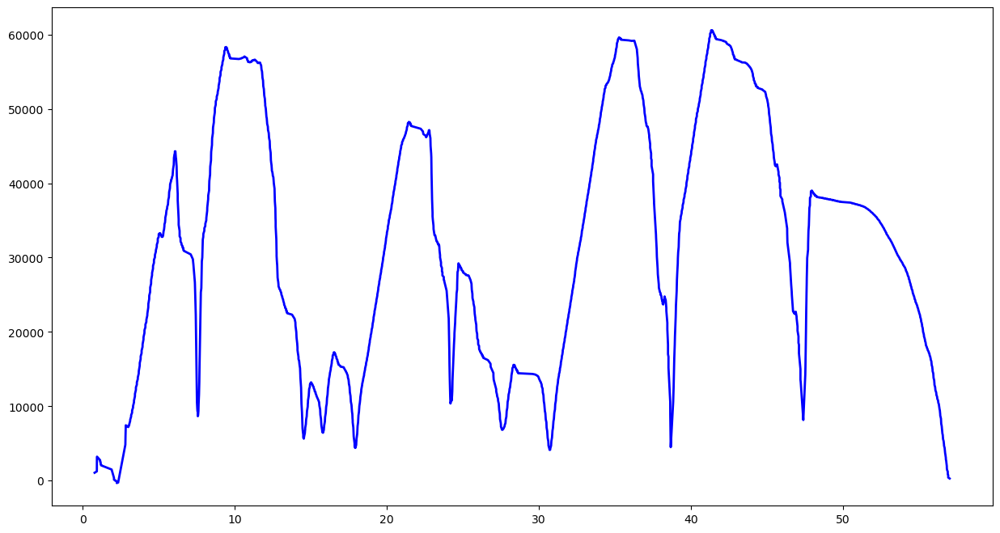

No Feature
../../singapore/top1k/360.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/360.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38250', '53084'])
Port 53084


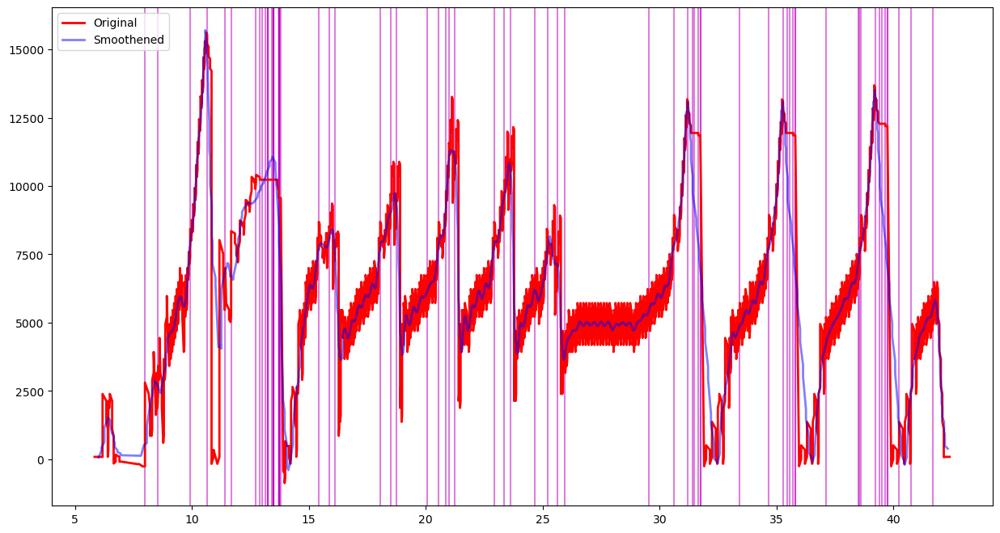

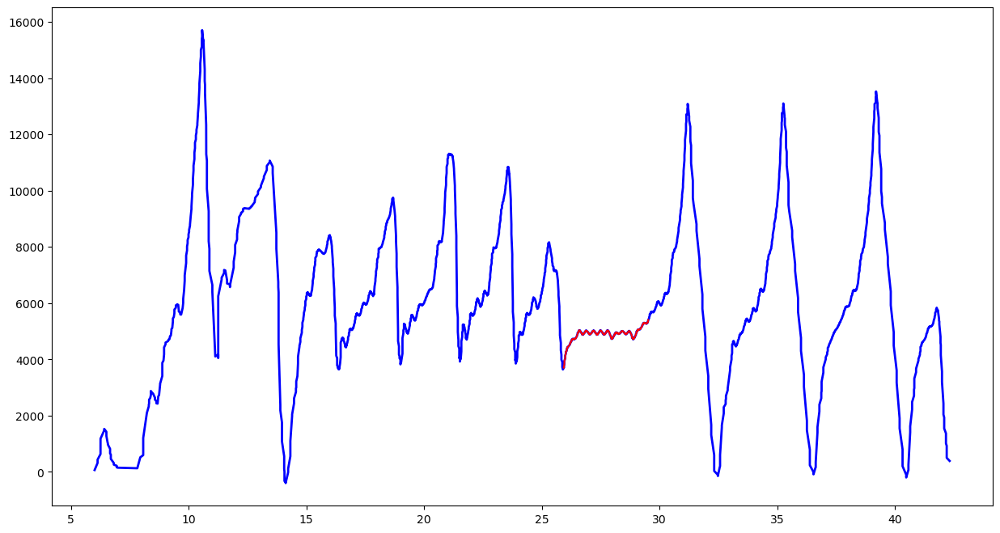

Feature Length  203


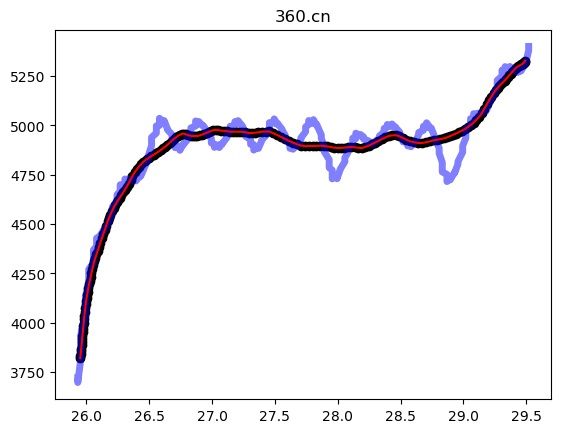

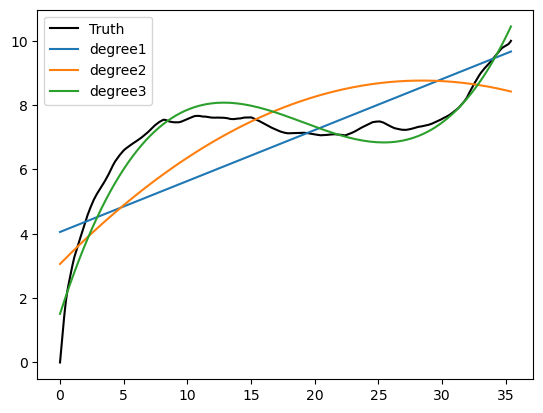

[ 1.31098483e-03 -7.32488155e-02  1.21356482e+00  1.53863506e+00]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [4.73393526e-125 7.59105057e-200 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1.00000000e+00 1.60353916e-75 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/porn555.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/porn555.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52372'])
Port 52372


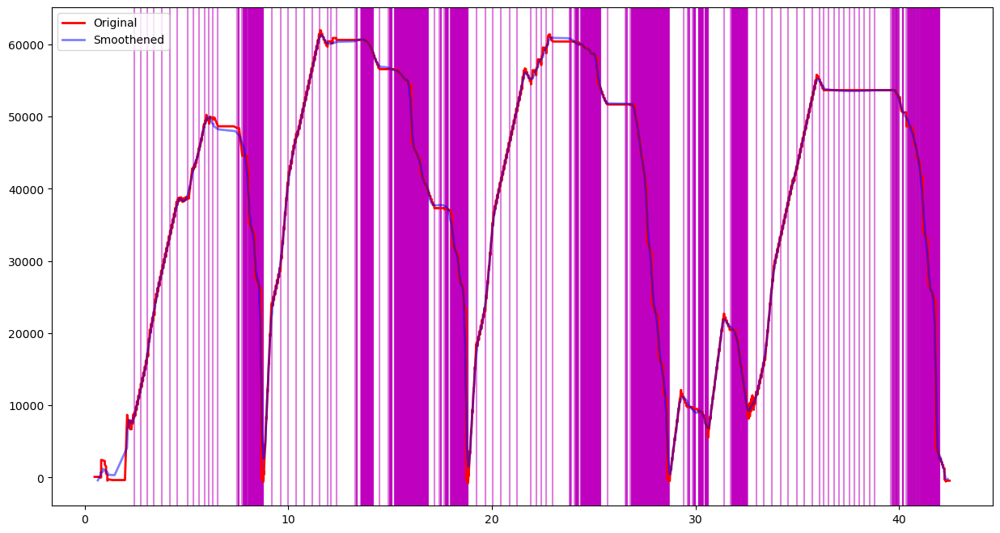

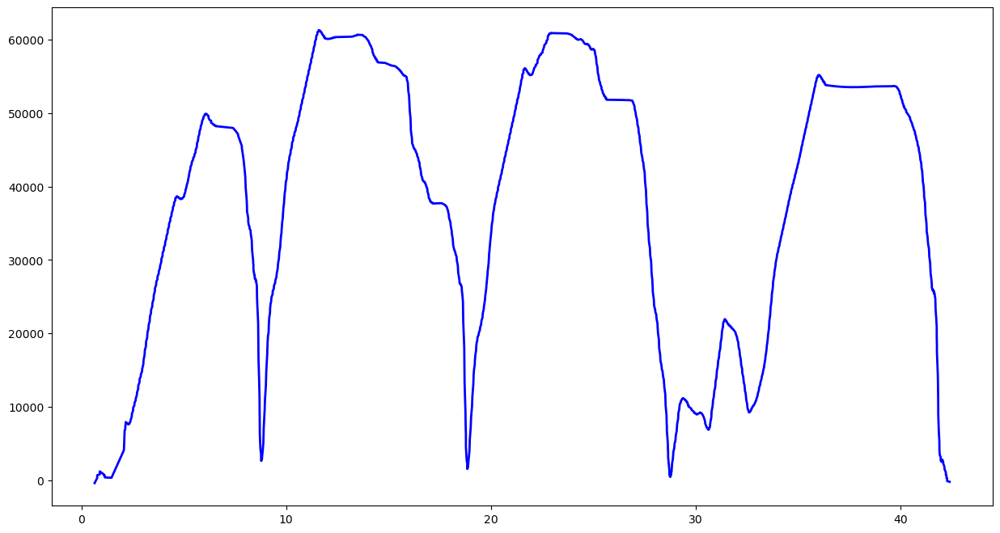

No Feature
../../singapore/top1k/rambler.ru-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/rambler.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45588'])
Port 45588


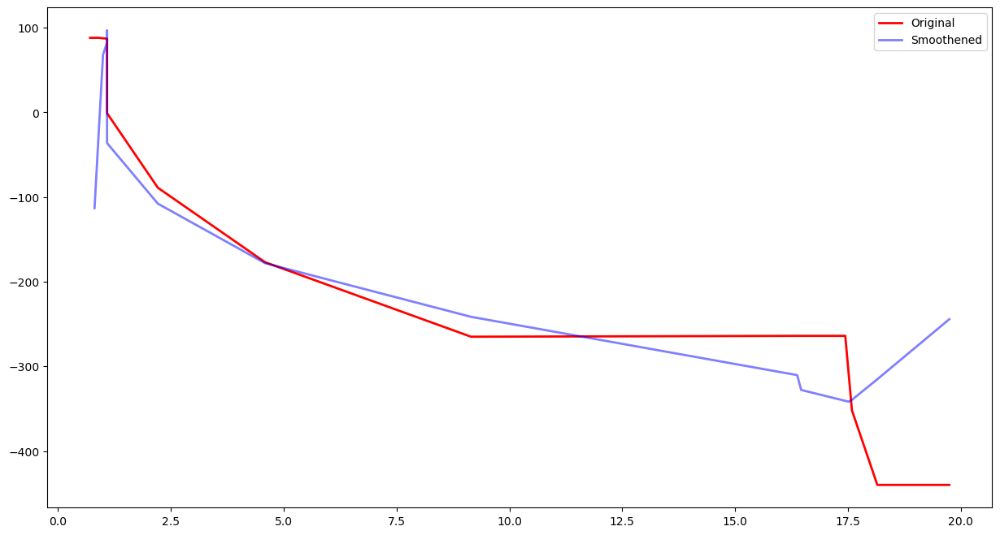

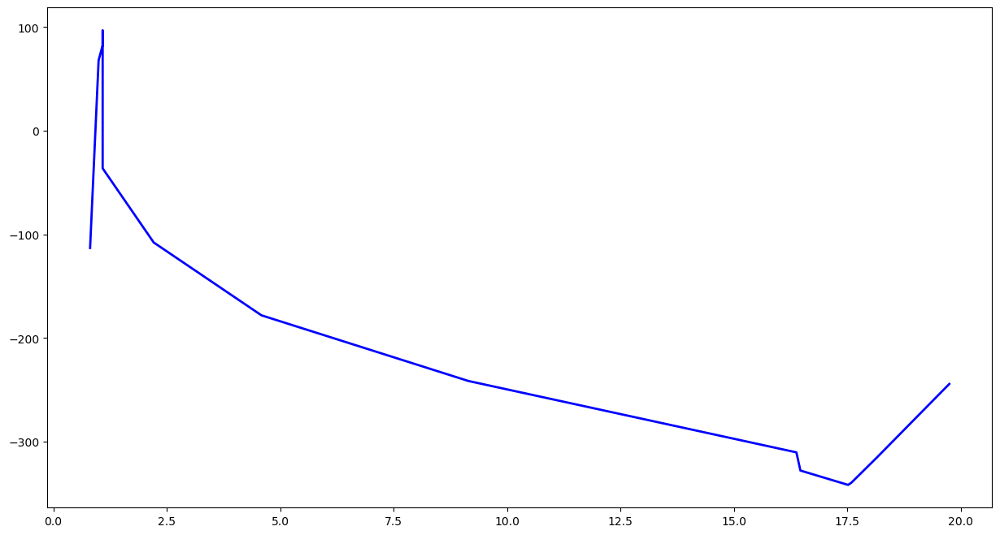

No Feature
../../singapore/top1k/douban.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/douban.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39746'])
Port 39746


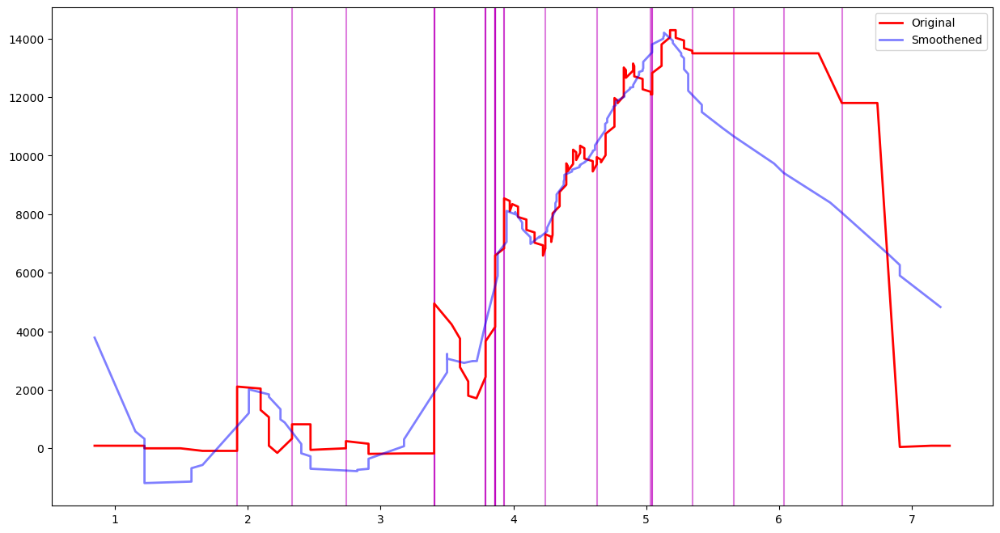

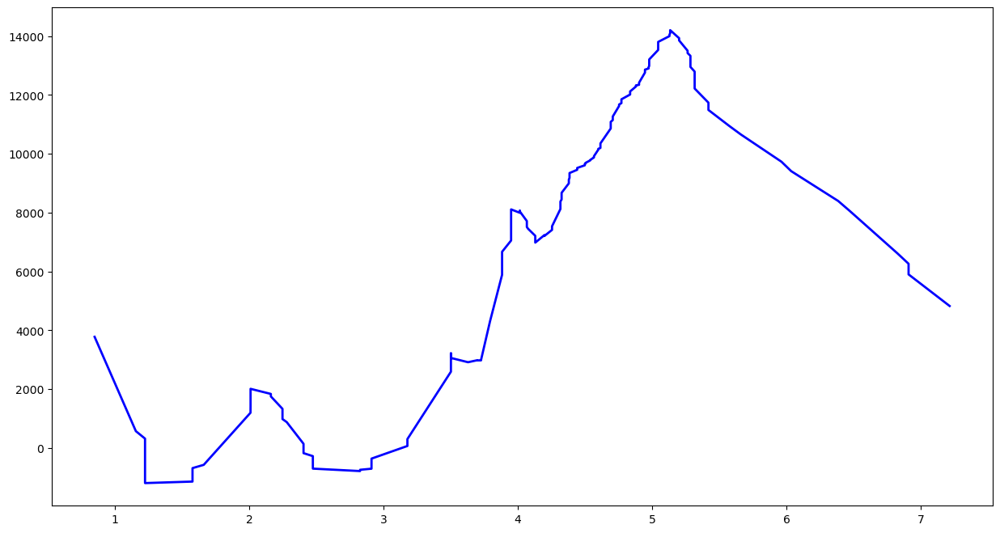

No Feature
../../singapore/top1k/zhihu.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/zhihu.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36612'])
Port 36612


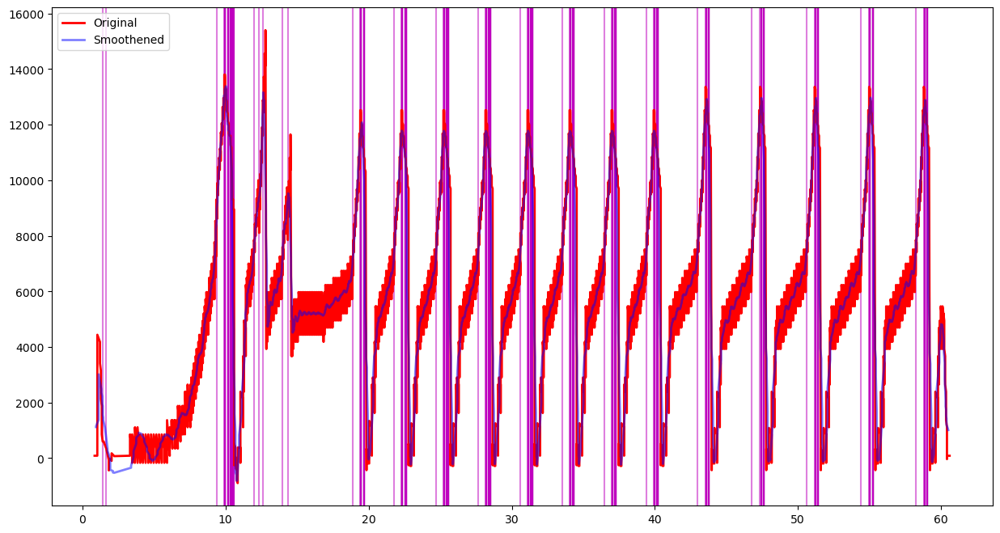

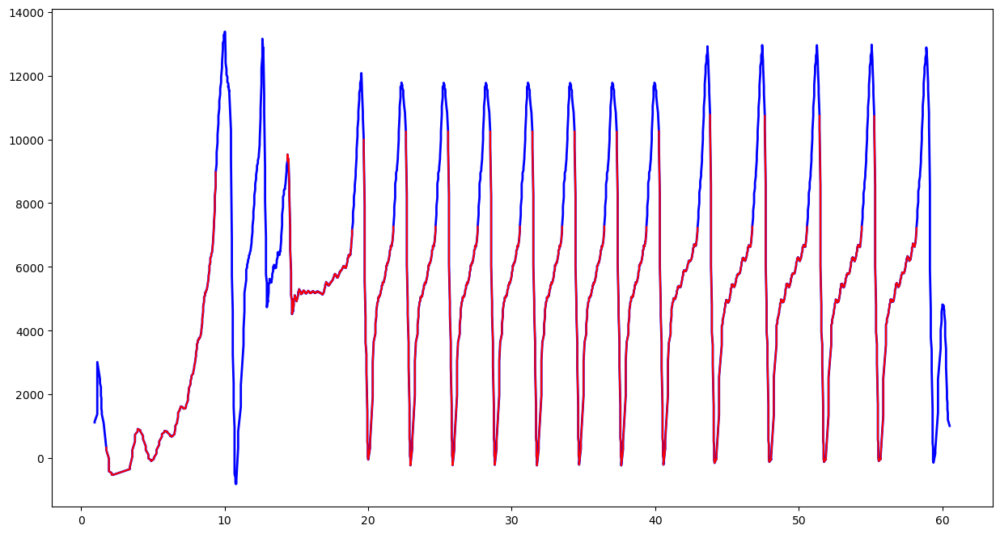

Feature Length  203


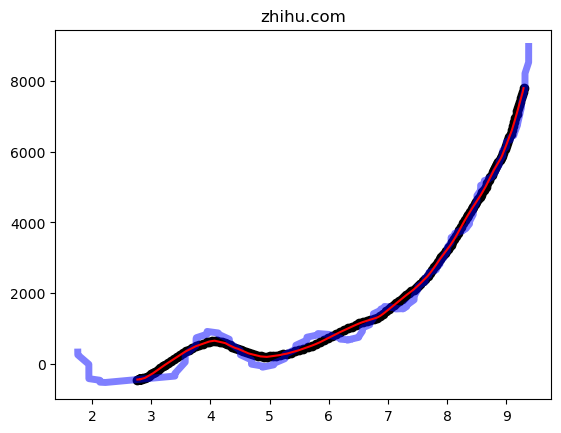

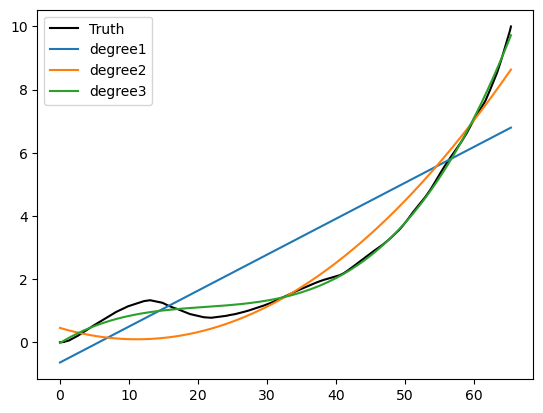

[ 9.55727083e-05 -6.17809613e-03  1.47473201e-01 -1.24268186e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [2.84915559e+01 1.23372993e-62 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 4.33015991e-64 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/google.pl-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.pl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40116'])
Port 40116


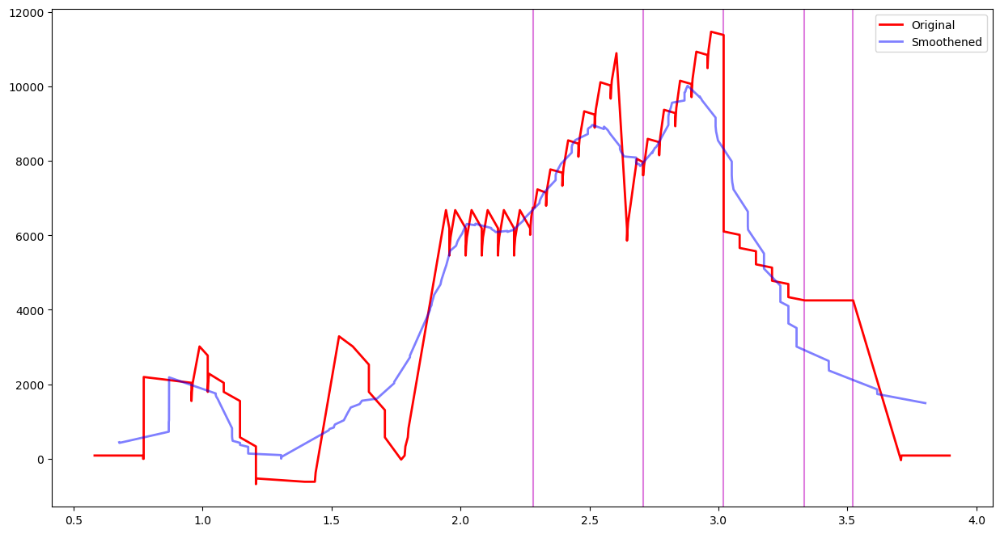

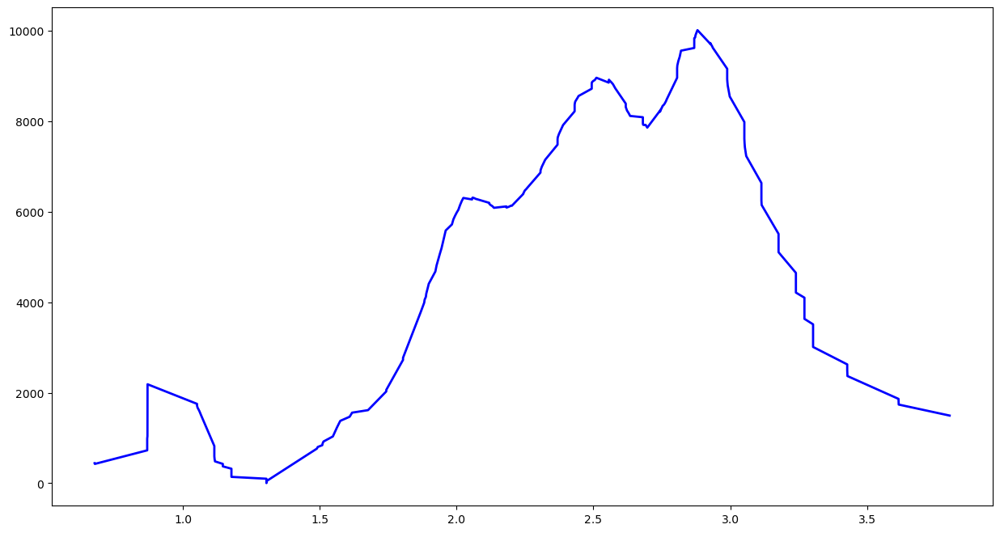

No Feature
../../singapore/top1k/google.co.kr-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.kr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34494'])
Port 34494


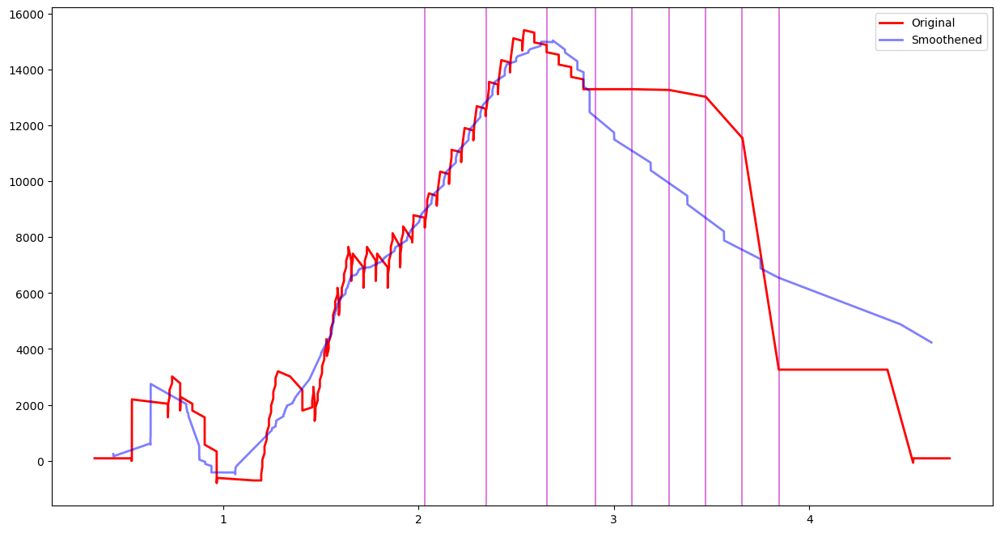

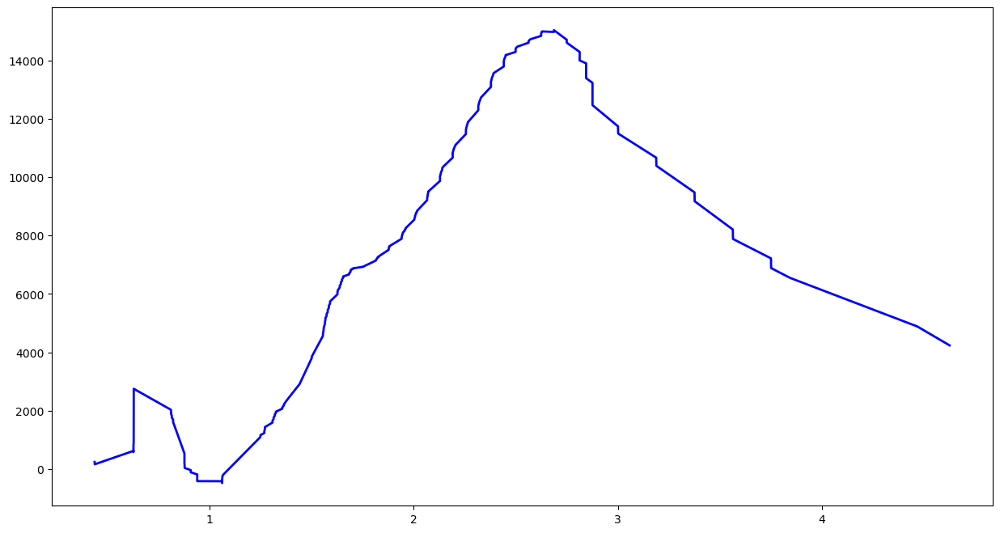

No Feature
../../singapore/top1k/bilibili.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bilibili.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36790'])
Port 36790


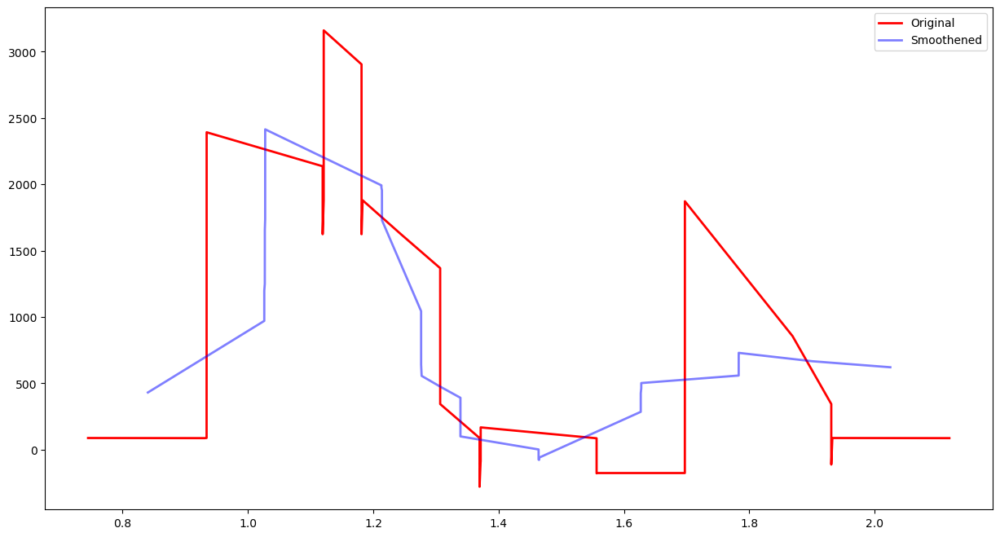

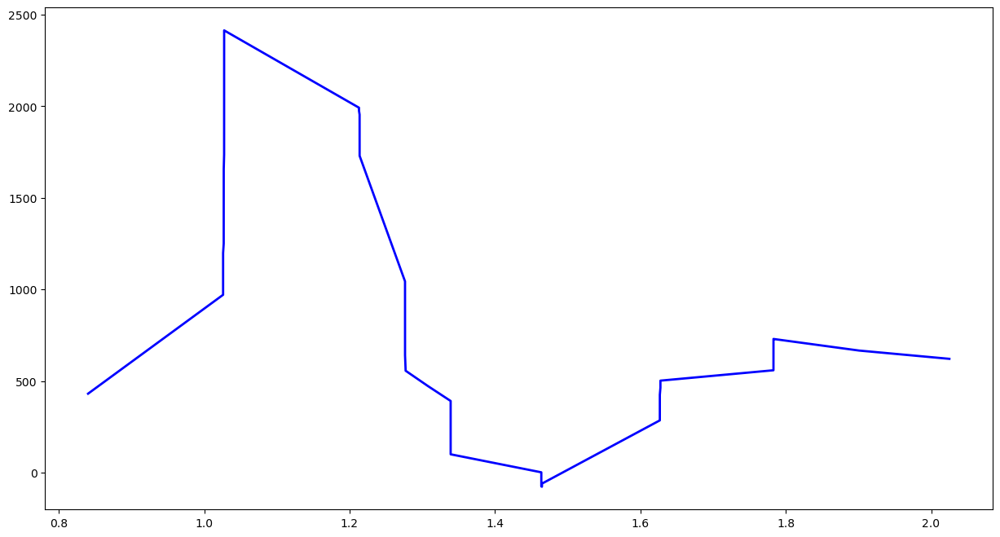

No Feature
../../singapore/top1k/avito.ru-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/avito.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39646', '39046', '57468', '42800', '49196', '36894', '36450', '48146', '54094', '49448', '33184', '39502', '53526', '60352', '43944', '41374', '34866', '46742', '43192', '52778'])
Port 46742


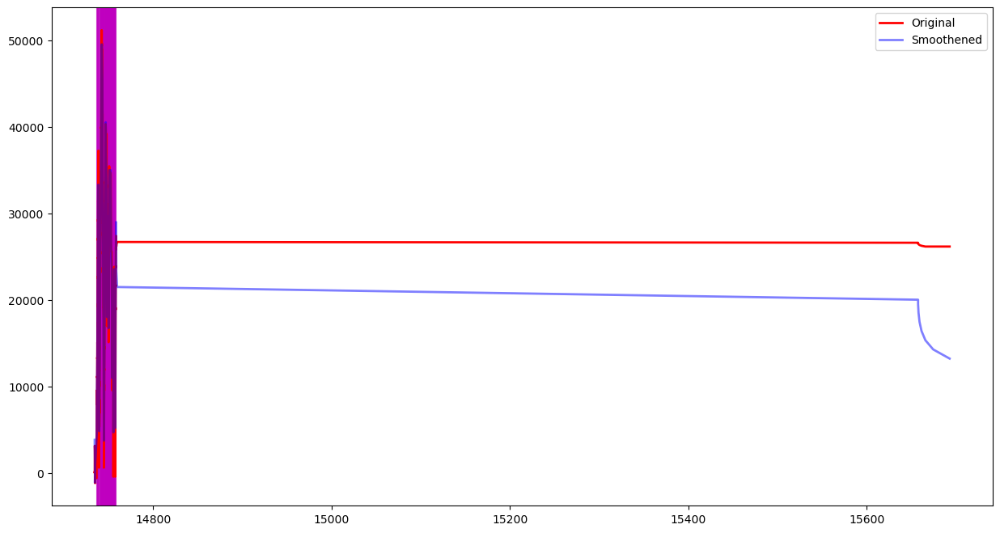

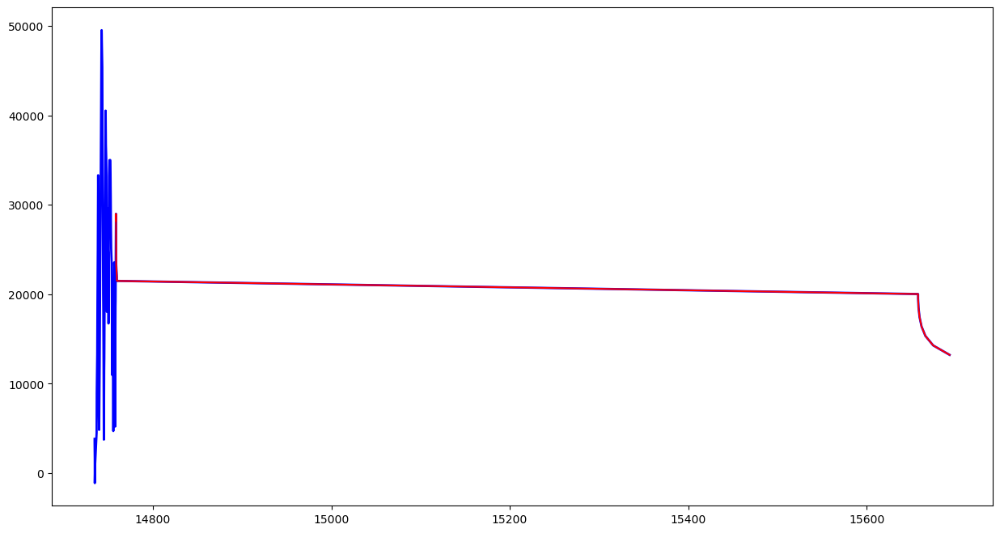

Feature Length  203


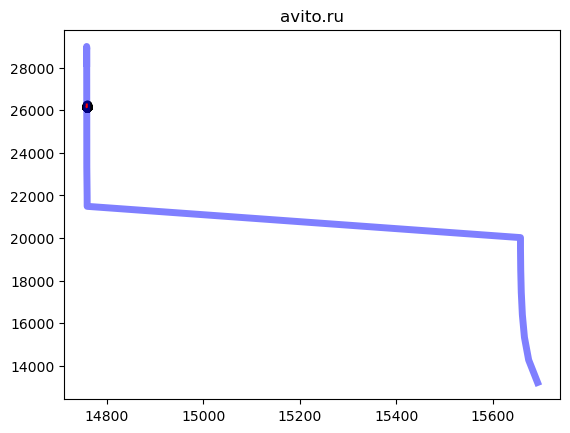

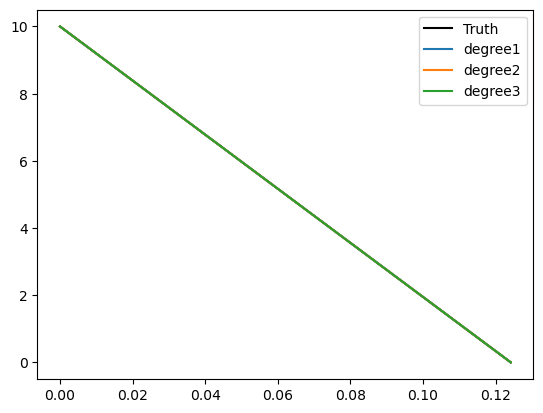

[ 1.21165498e-05 -2.18563335e-06 -8.05049268e+01  1.00000000e+01]
Top 5 CCS : ['cubic', 'veno', 'vegas', 'htcp']
Density Values: [0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan]
Prediction: new
../../singapore/top1k/google.co.ve-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.ve-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52860'])
Port 52860


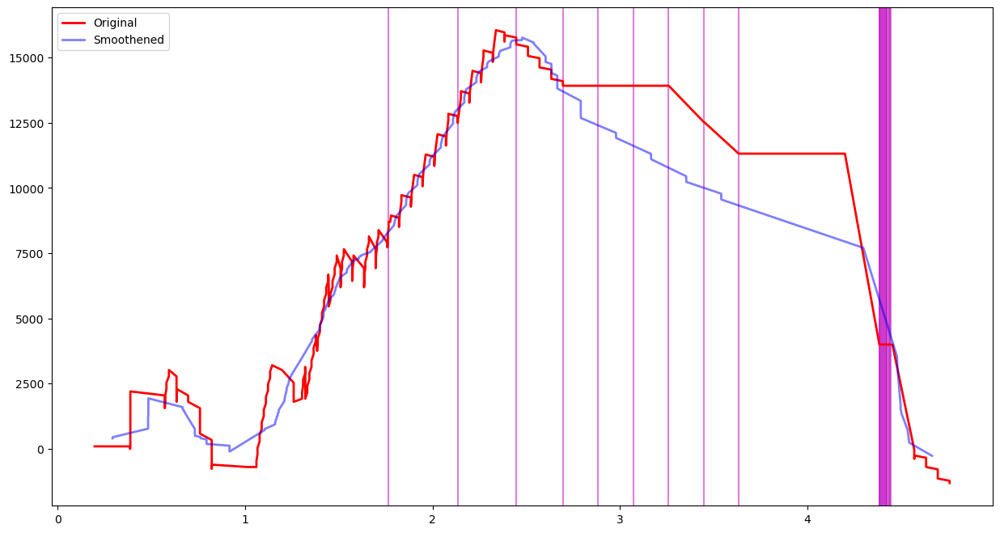

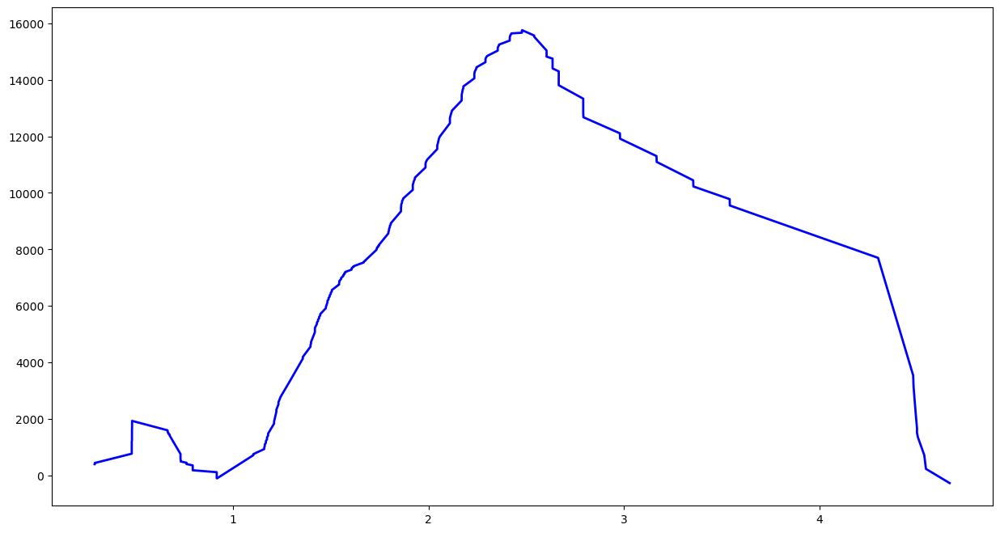

No Feature
../../singapore/top1k/google.ae-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.ae-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35788'])
Port 35788


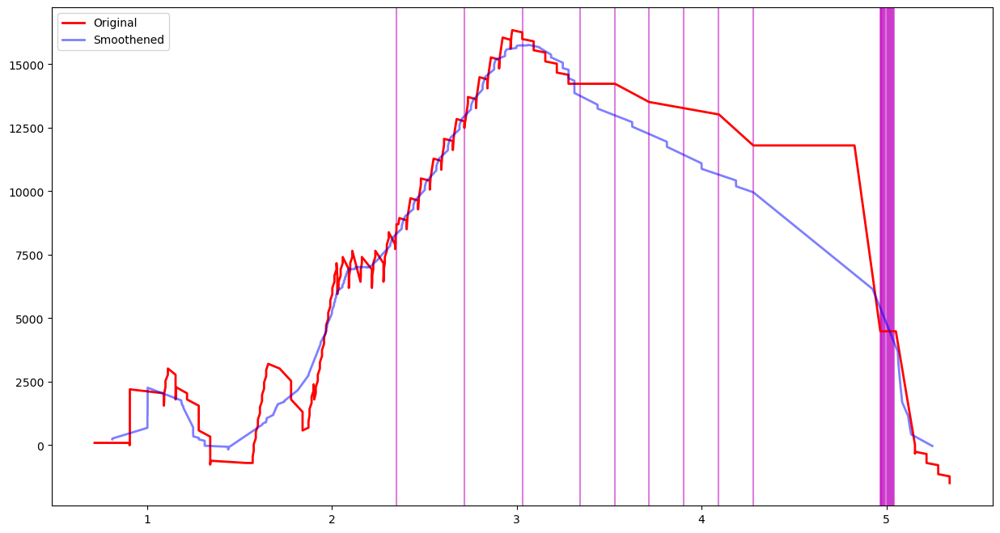

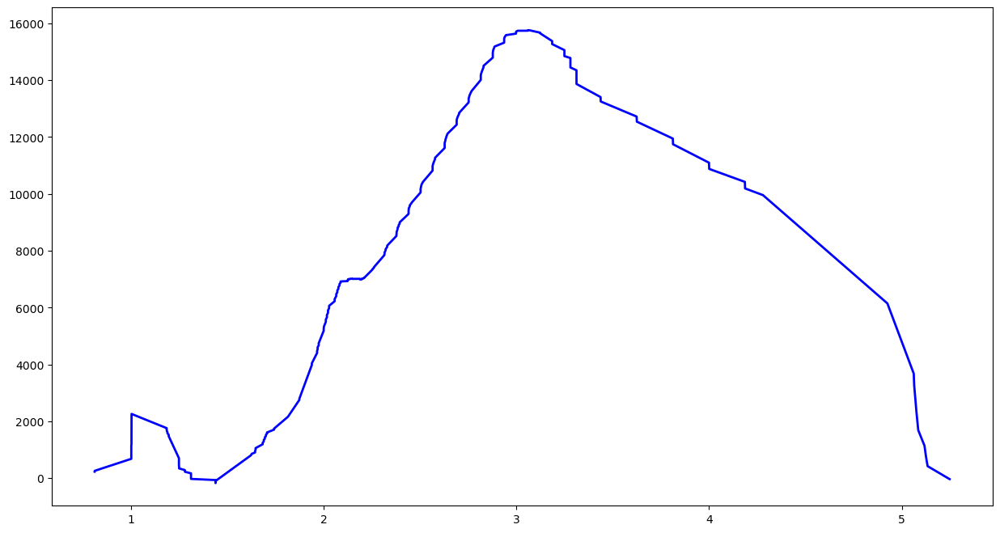

No Feature
../../singapore/top1k/savefrom.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/savefrom.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44228'])
Port 44228


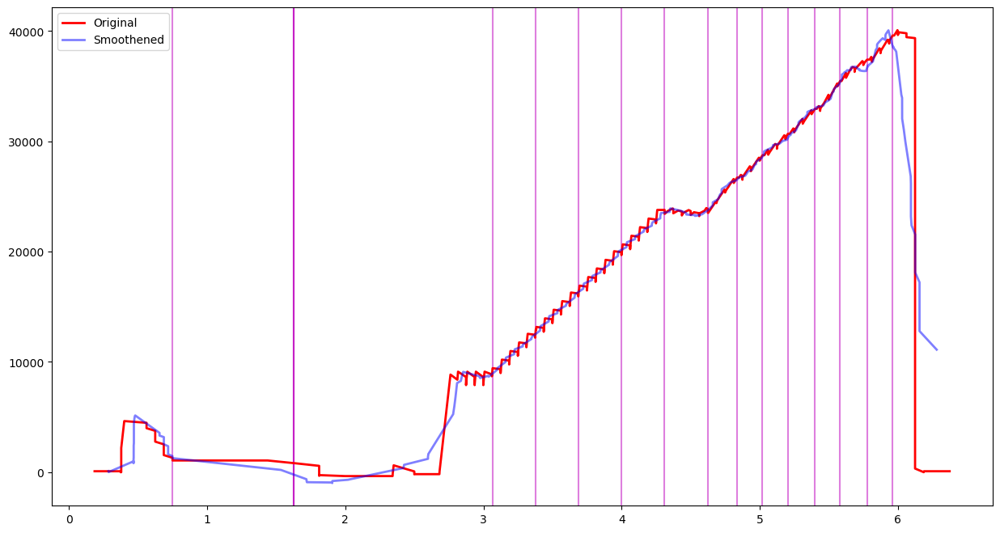

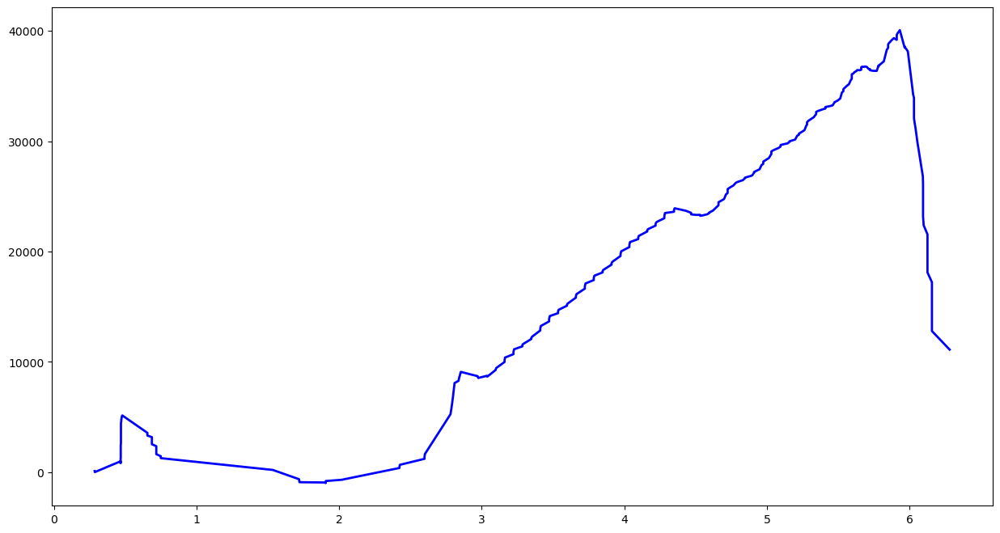

No Feature
../../singapore/top1k/google.com.sg-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.sg-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['41790'])
Port 41790


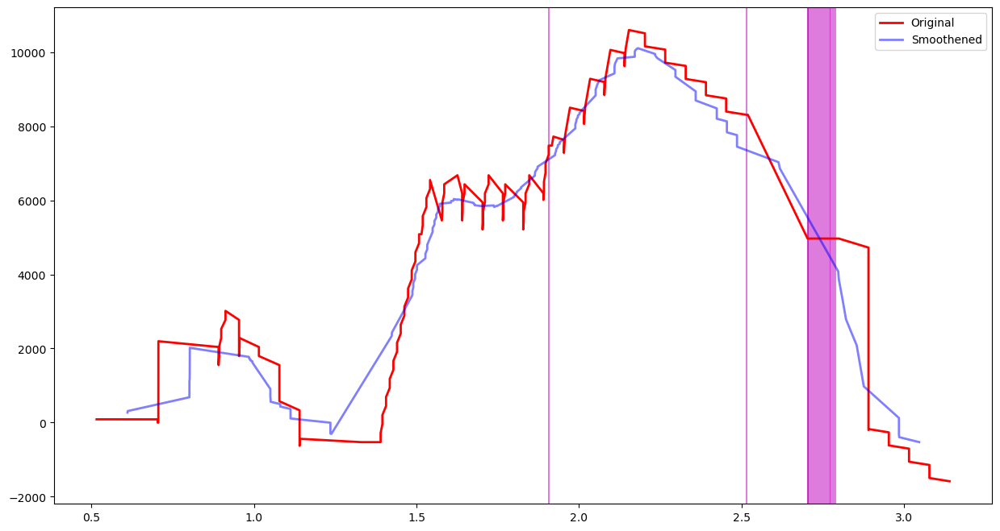

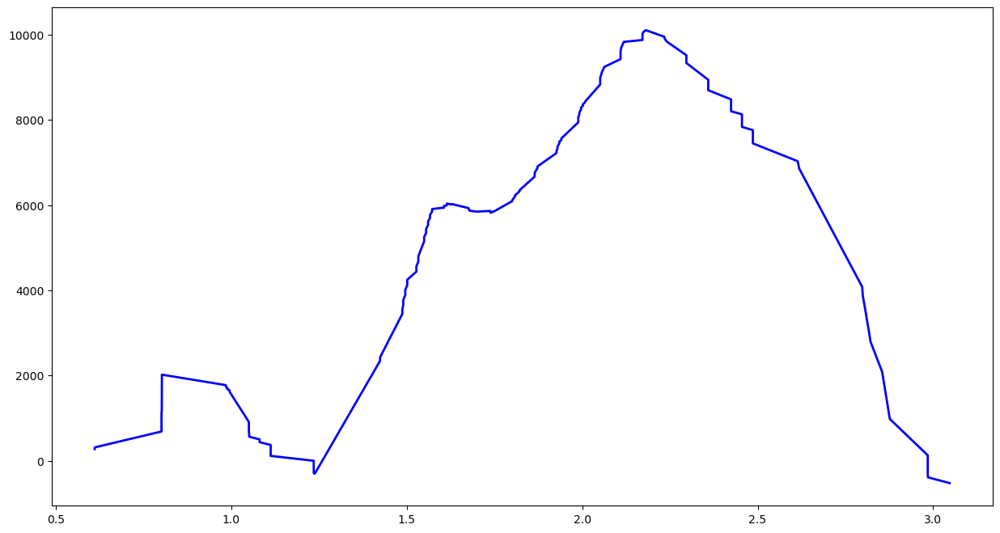

No Feature
../../singapore/top1k/messenger.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/messenger.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37202'])
Port 37202


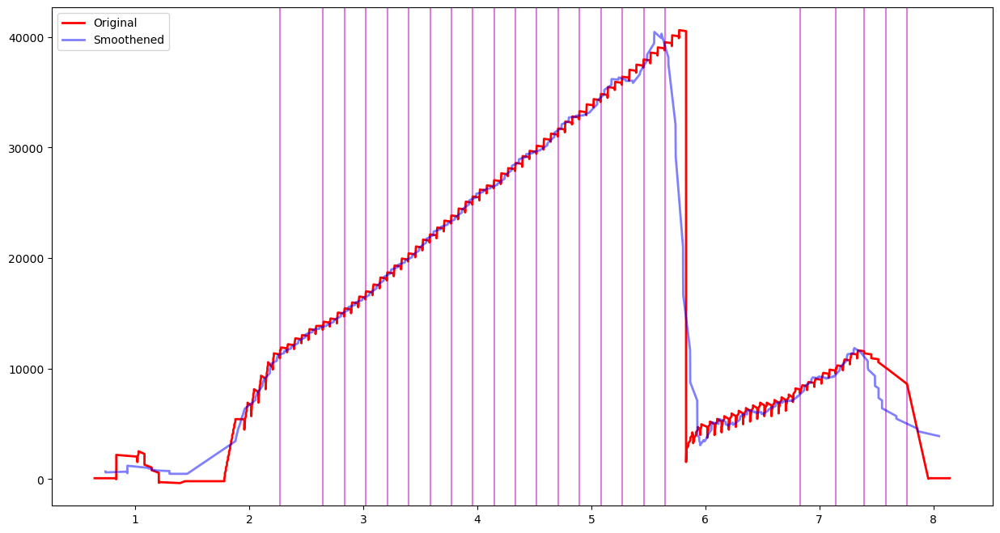

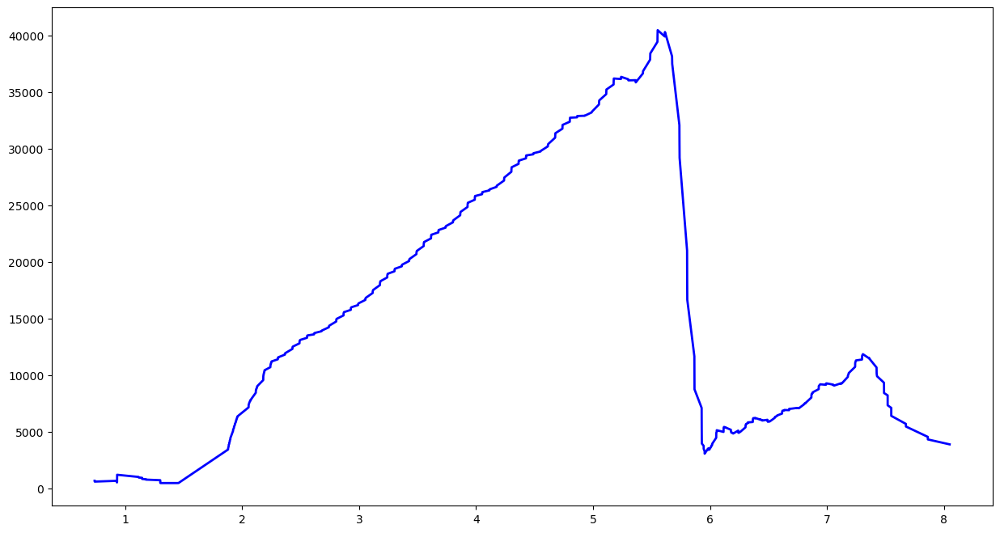

No Feature
../../singapore/top1k/google.com.pk-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.pk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55798'])
Port 55798


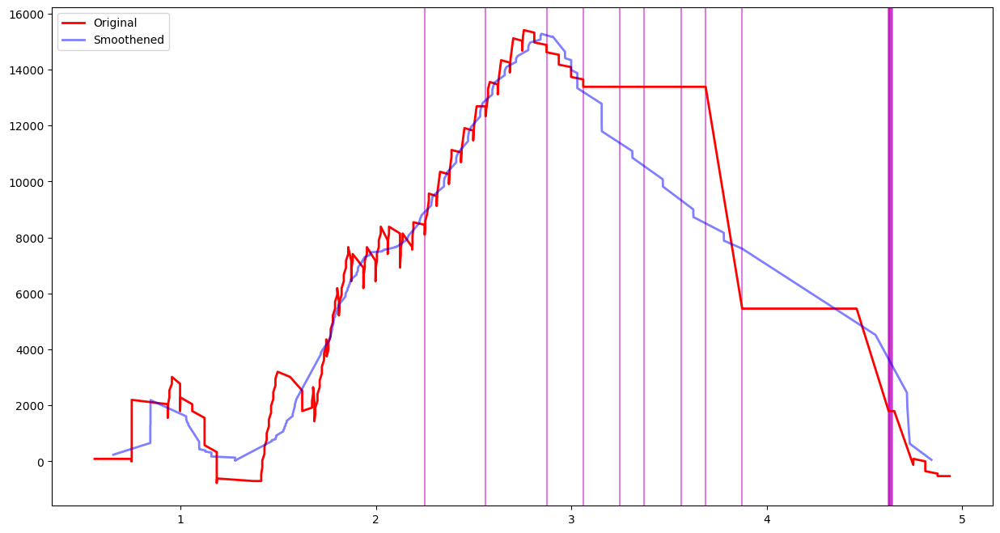

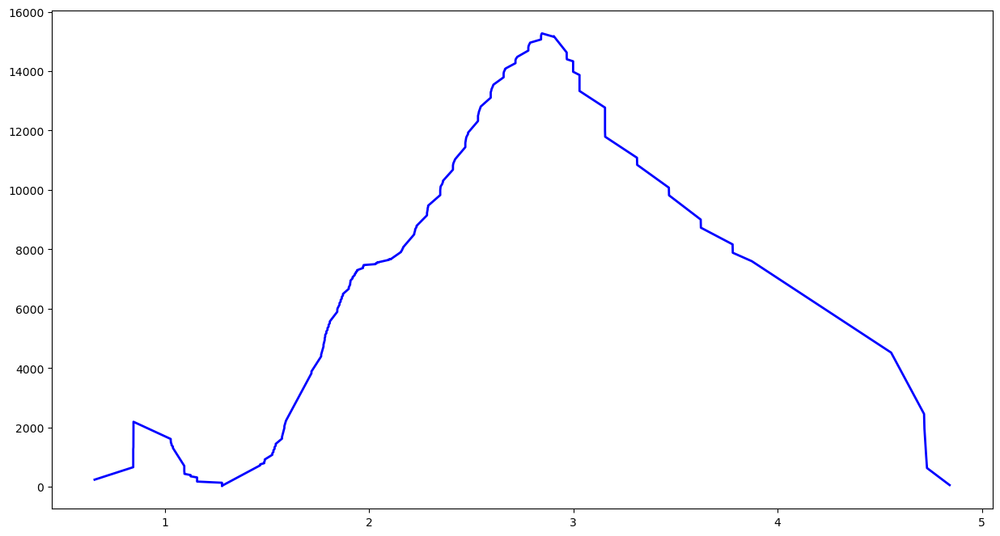

No Feature
../../singapore/top1k/outbrain.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/outbrain.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33170', '53704', '48804'])
Port 48804


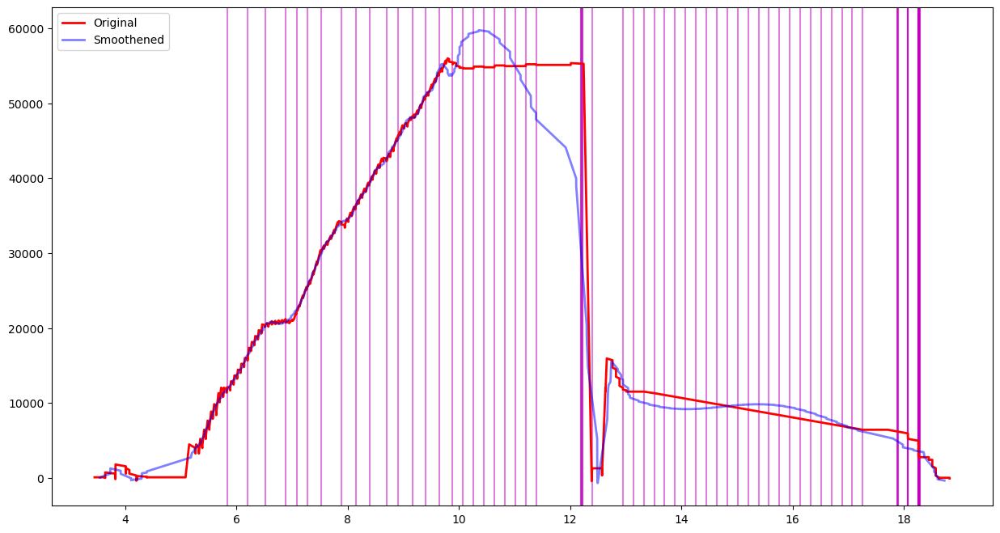

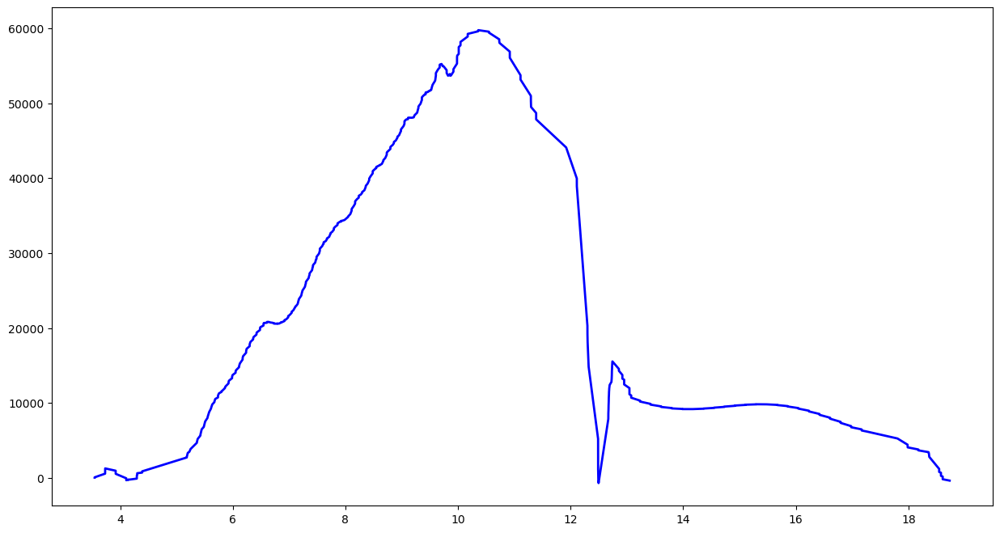

No Feature
../../singapore/top1k/txxx.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/txxx.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35764'])
Port 35764


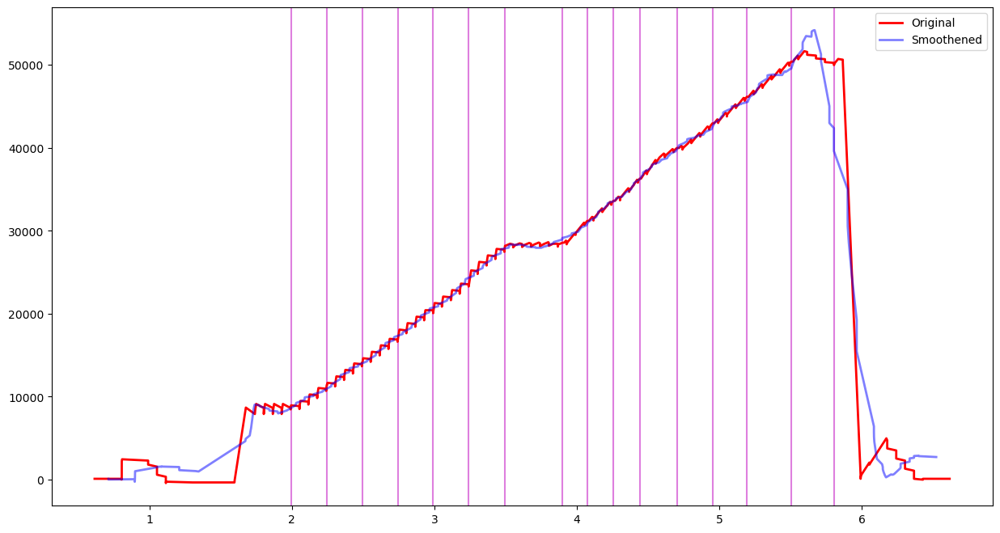

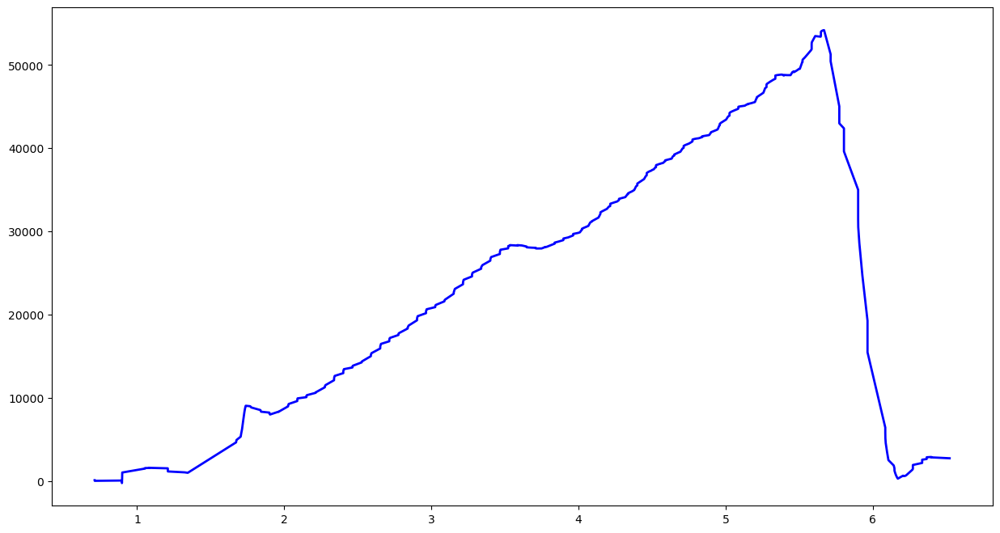

No Feature
../../singapore/top1k/live.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/live.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52924'])
Port 52924


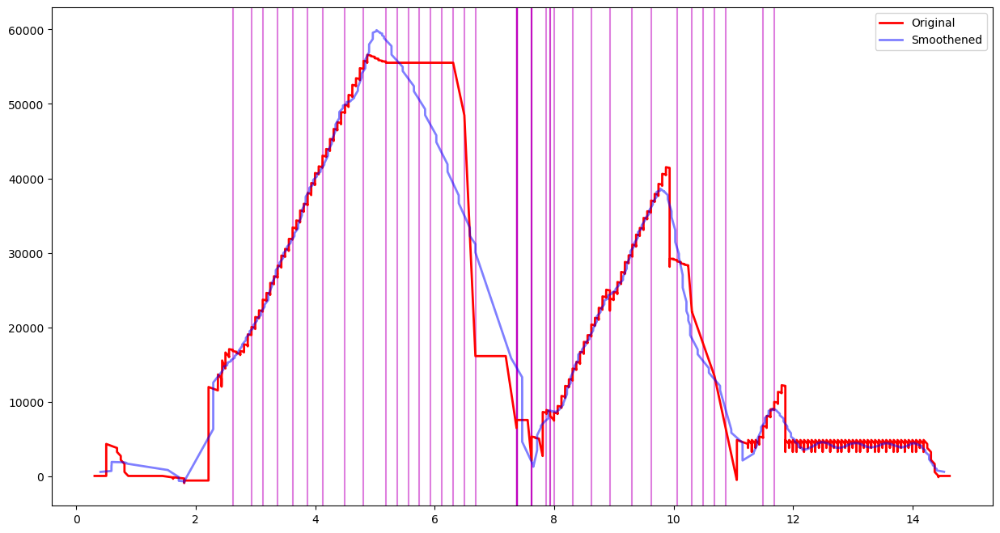

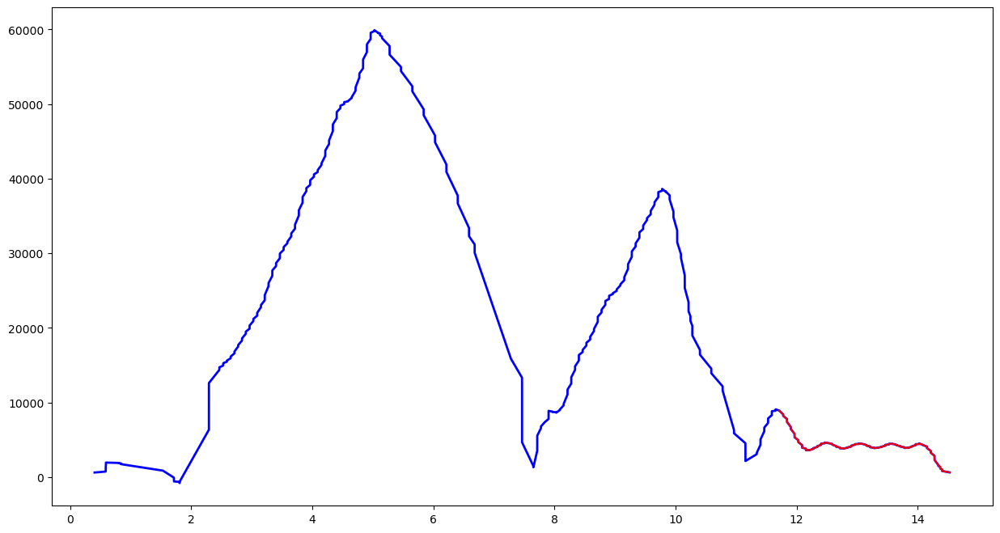

Feature Length  203


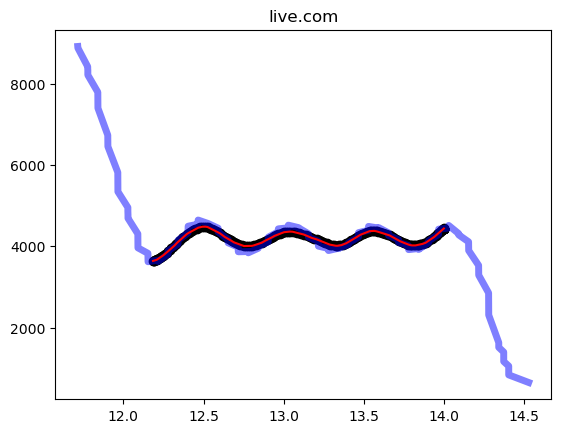

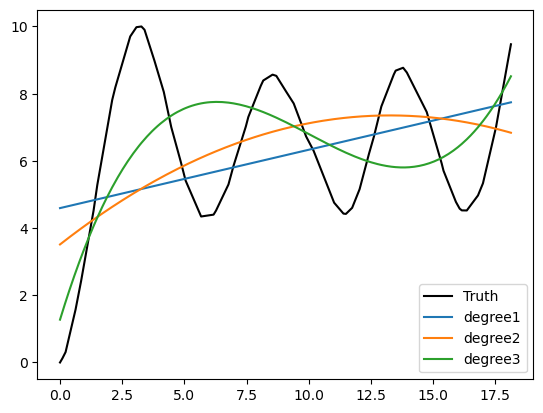

[ 0.01175996 -0.34034054  2.71249395  1.56136437]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [6.38599119e-190 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/17ok.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/17ok.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37526', '49116', '42564', '39490', '33488', '54618', '49670', '47054', '52108', '34074', '39598', '35254', '47590', '47434', '47188', '45750', '47822', '49404', '43100', '38228'])
Port 37526


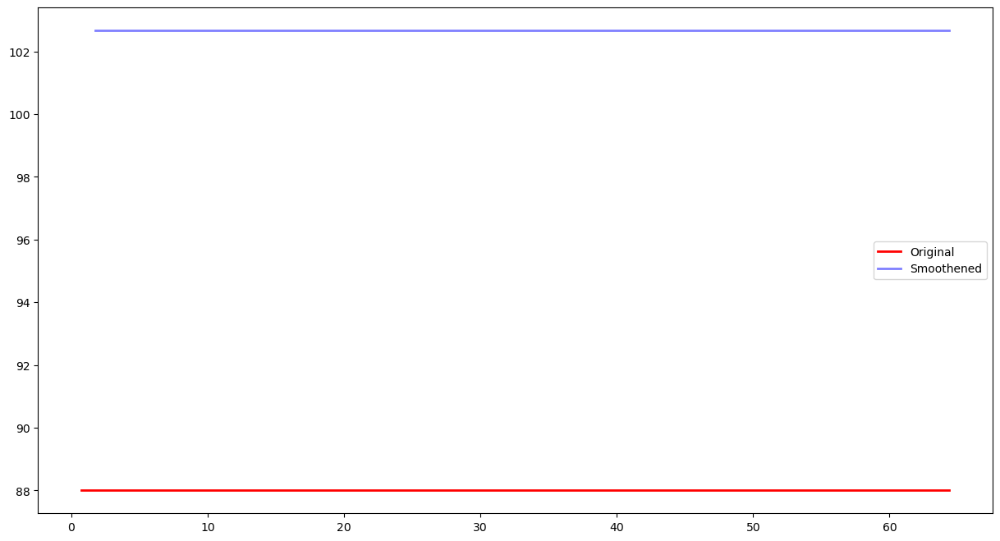

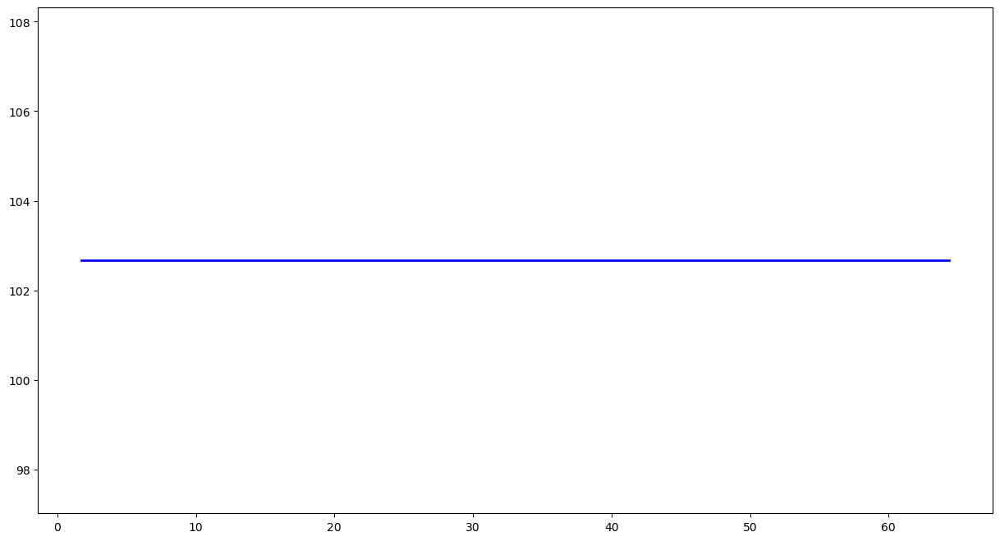

No Feature
../../singapore/top1k/jd.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/jd.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['47676'])
Port 47676


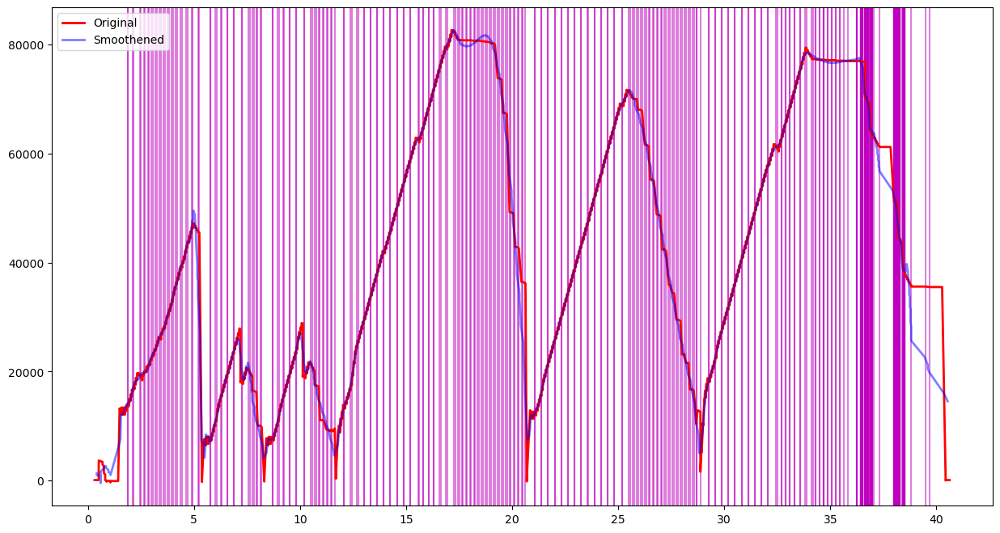

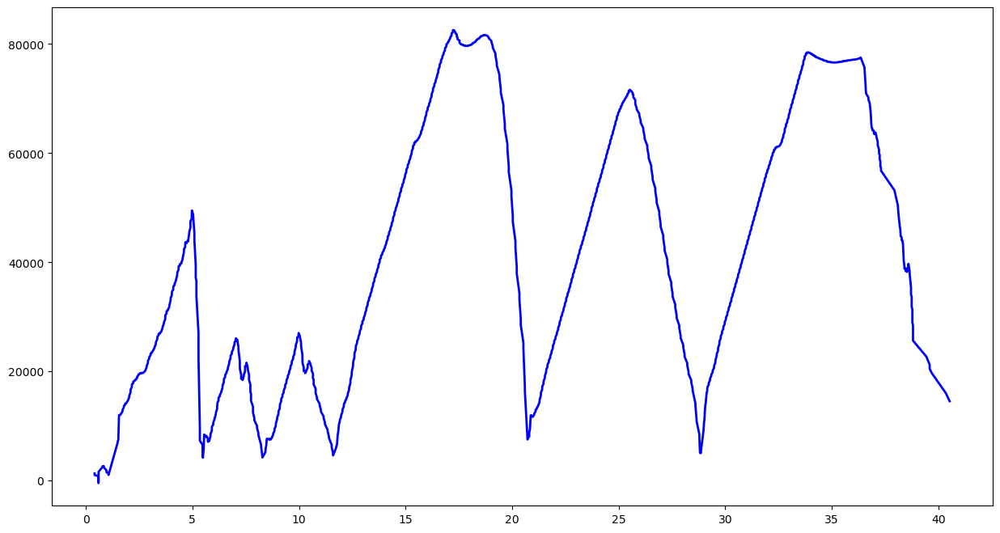

No Feature
../../singapore/top1k/google.nl-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.nl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45224', '39554'])
Port 39554


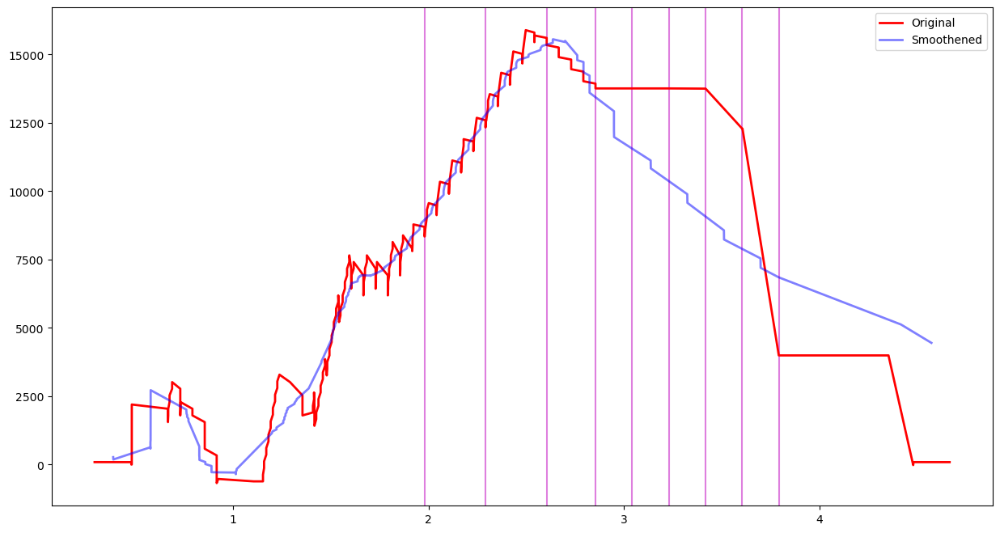

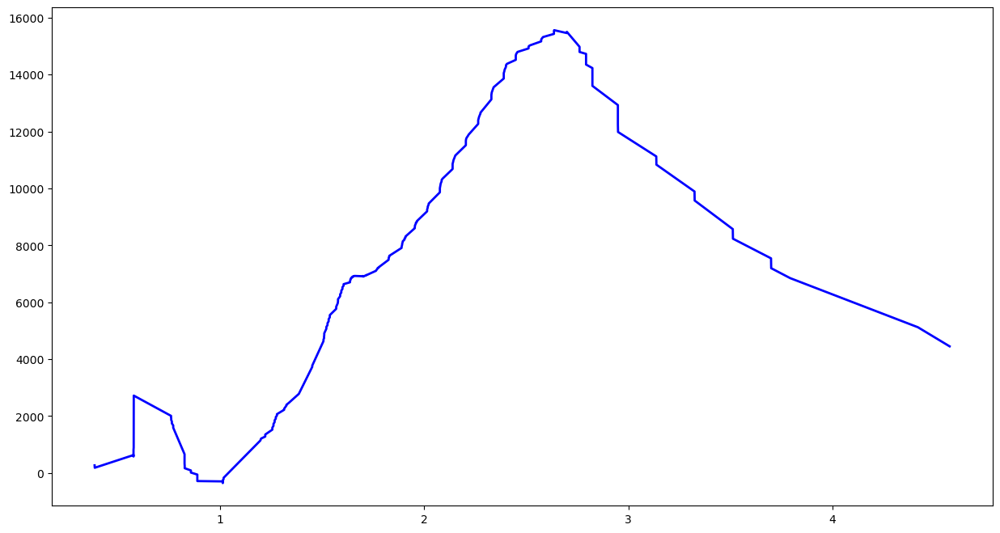

No Feature
../../singapore/top1k/google.com.br-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.br-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46450'])
Port 46450


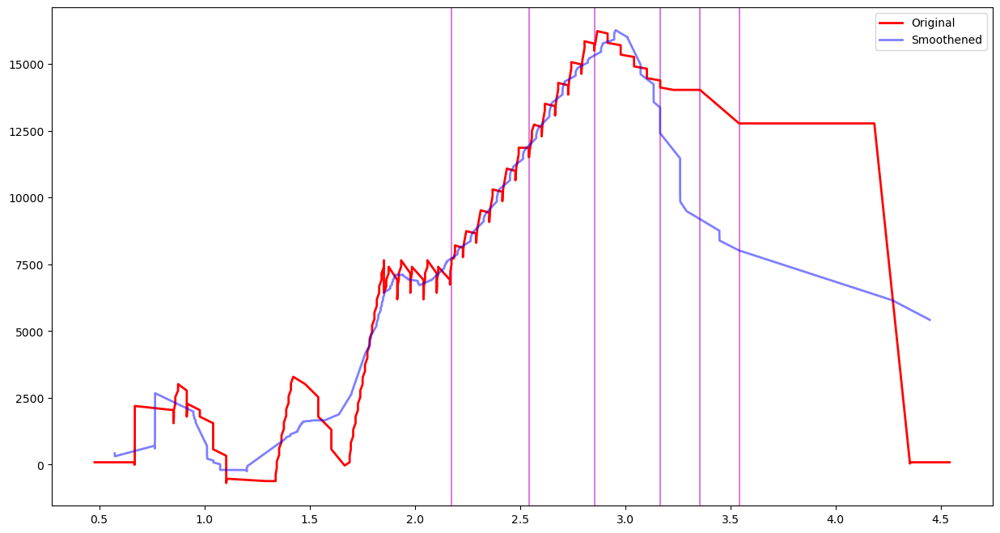

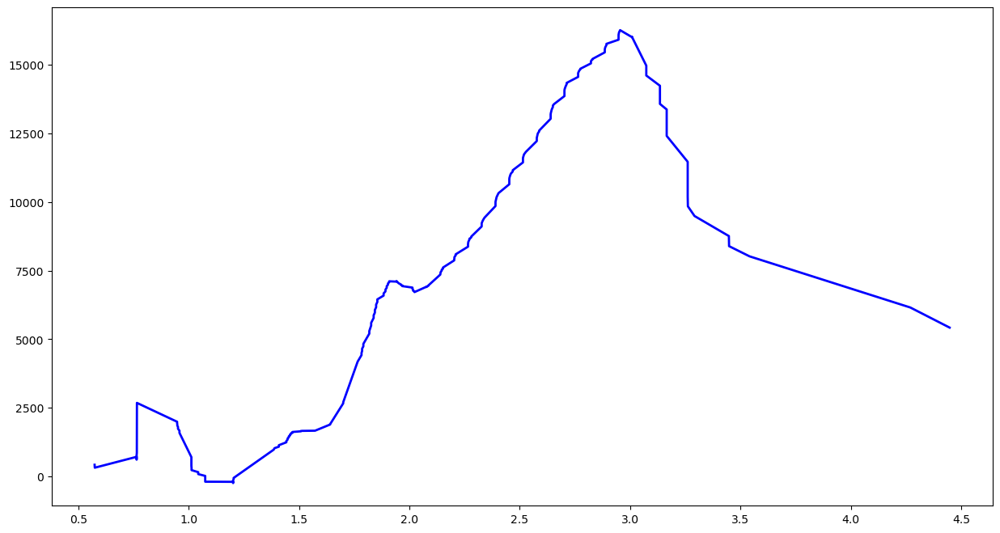

No Feature
../../singapore/top1k/openload.co-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/openload.co-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56654'])
Port 56654


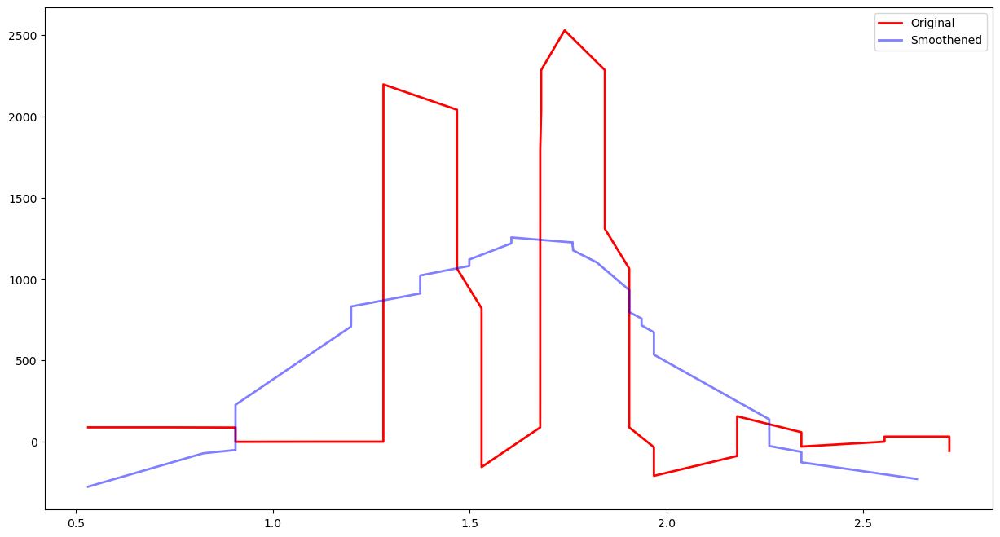

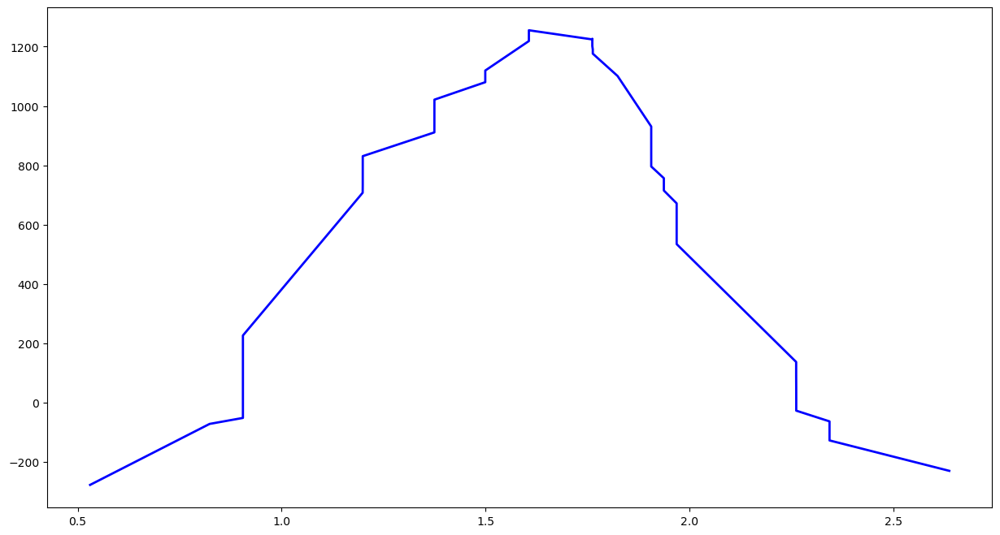

No Feature
../../singapore/top1k/nicovideo.jp-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/nicovideo.jp-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59978'])
Port 59978


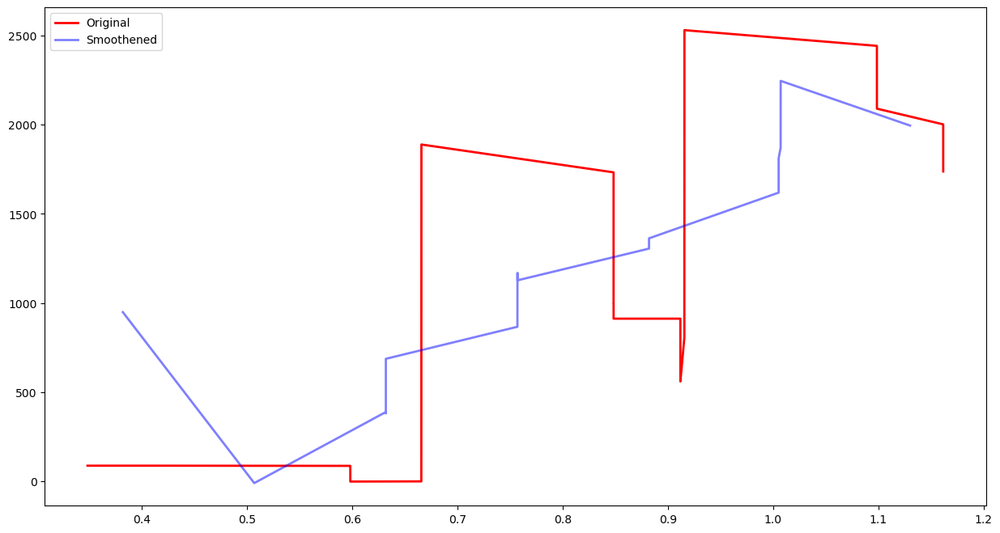

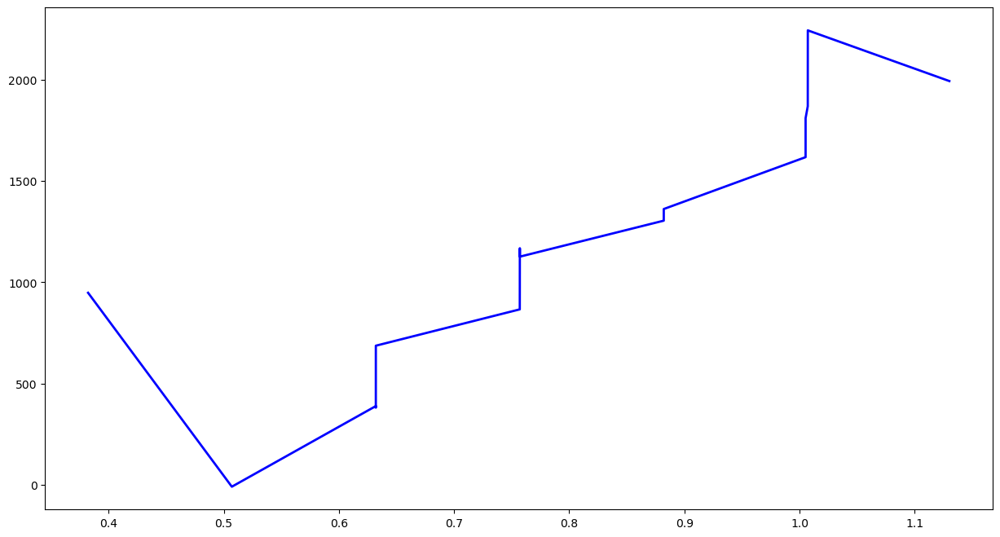

No Feature
../../singapore/top1k/youtube.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/youtube.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49018'])
Port 49018


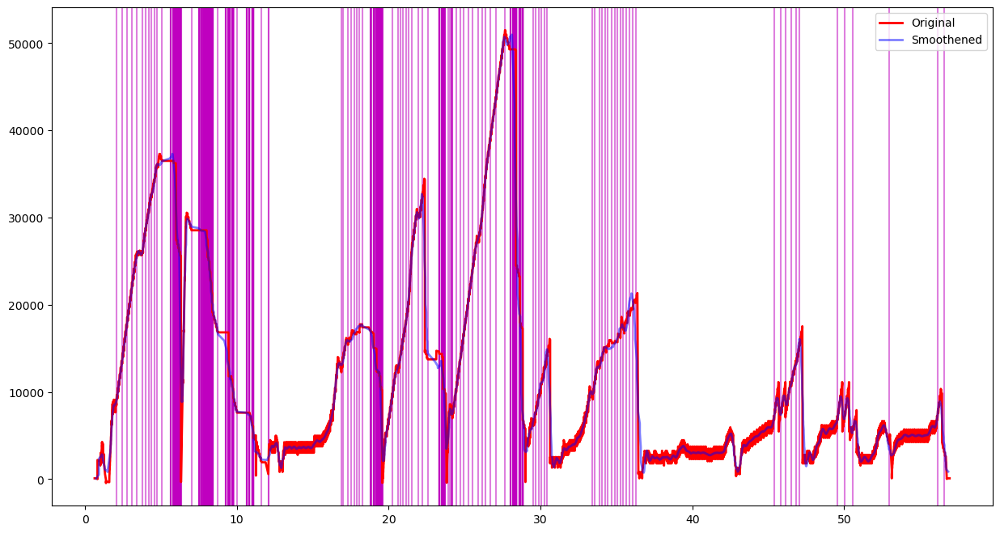

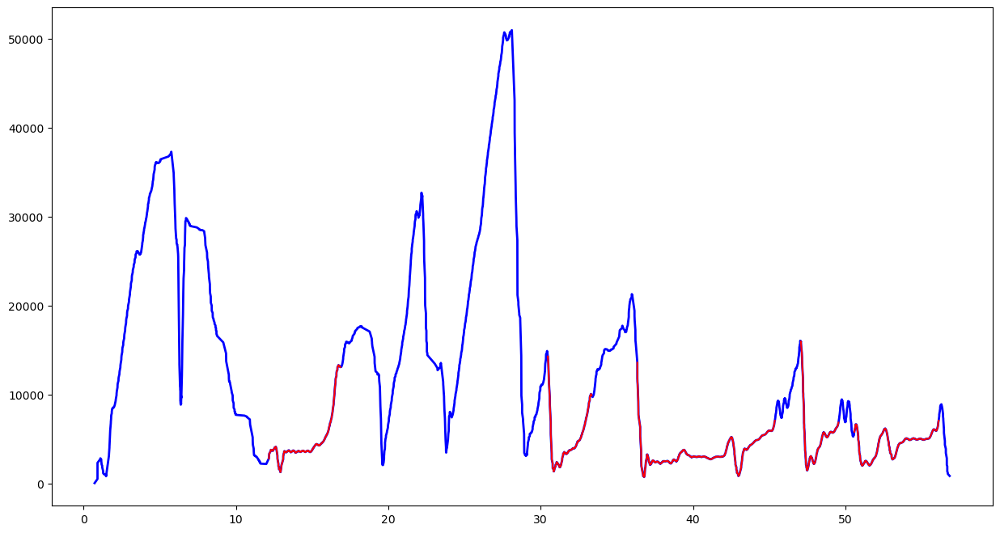

Feature Length  203


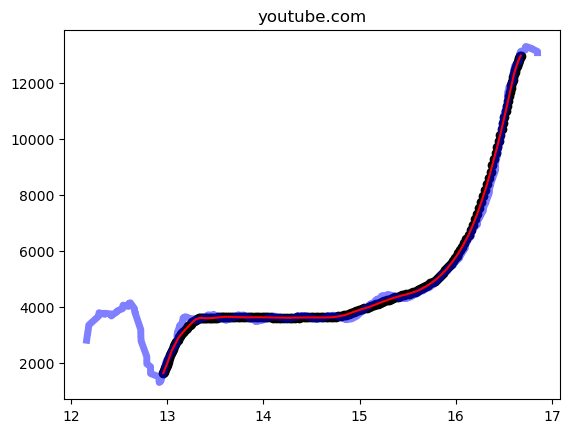

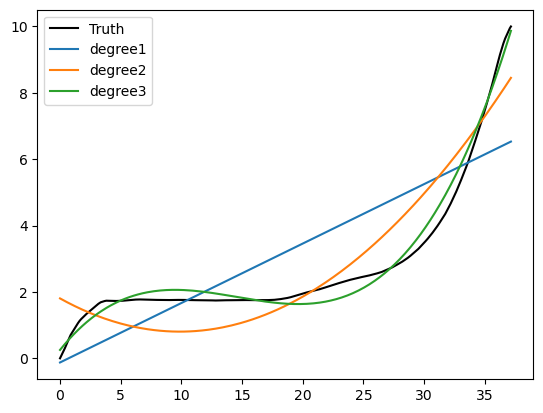

[ 0.00075146 -0.03229539  0.40823093  0.43194421]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [4.20883433e-078 1.43194970e-128 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1.00000000e+00 3.40224771e-51 0.00000000e+00 0.00000000e+00]
Prediction: new
../../singapore/top1k/google.co.za-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.co.za-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49356'])
Port 49356


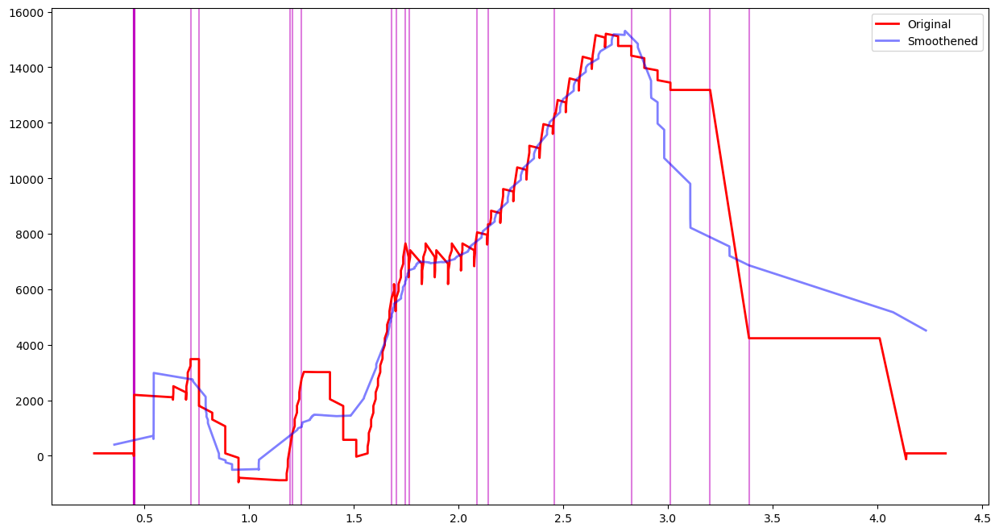

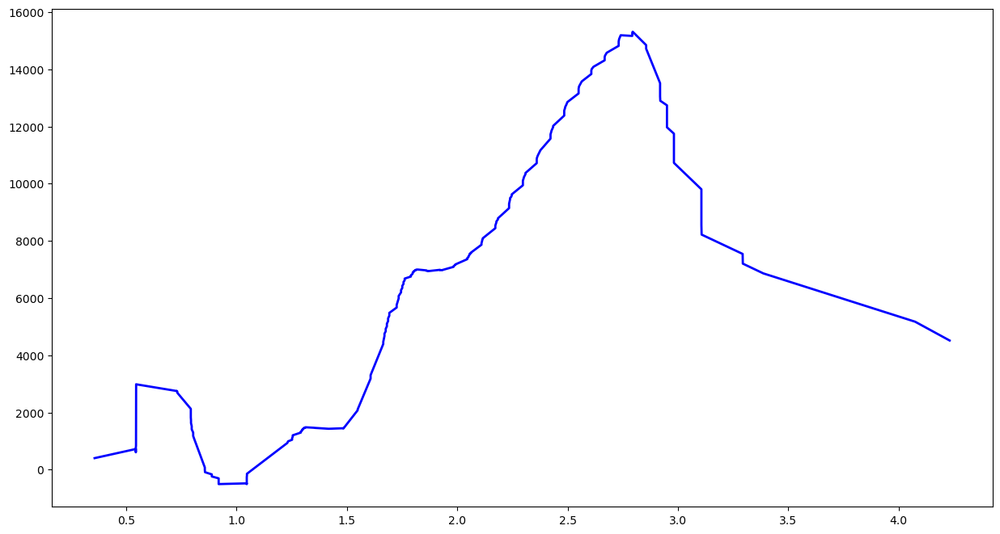

No Feature
../../singapore/top1k/ladbible.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/ladbible.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39692'])
Port 39692


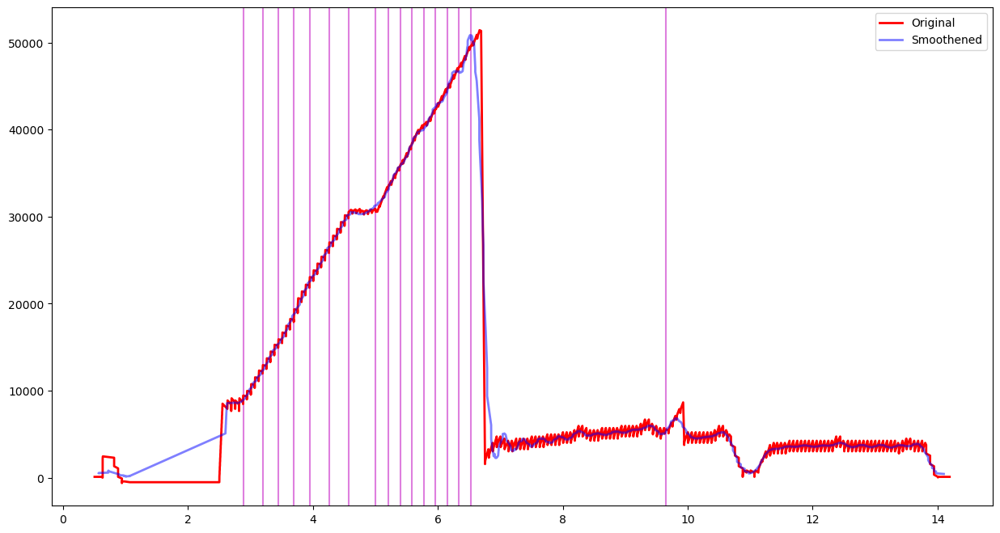

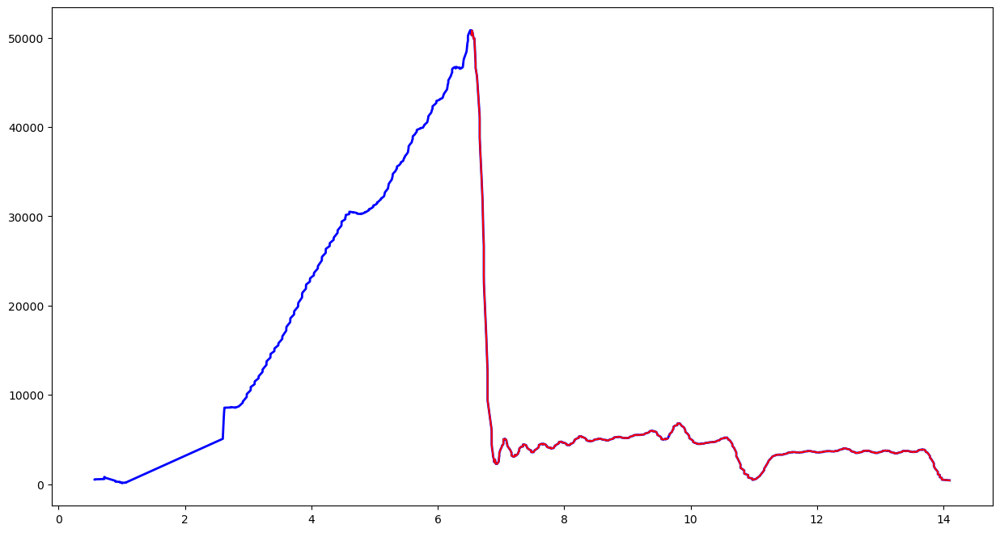

Feature Length  203


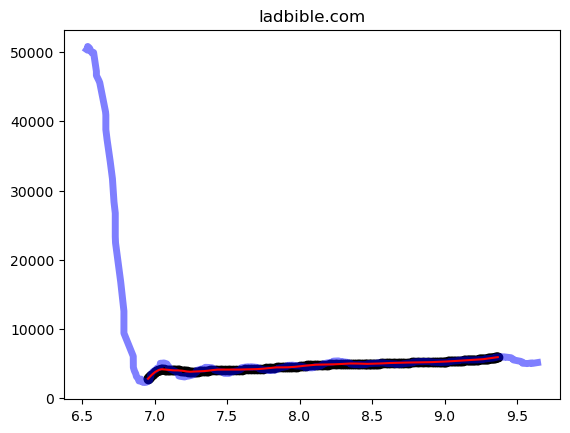

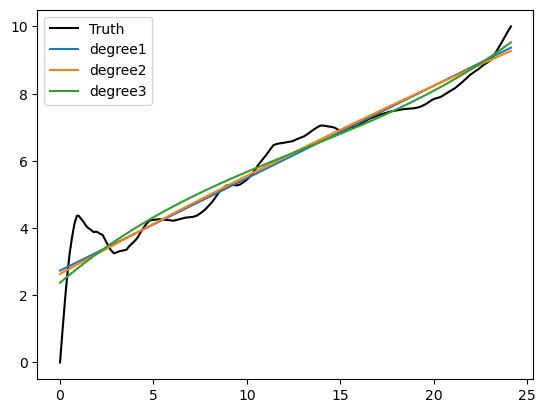

[0.2588311  3.24042844]
Top 5 CCS : ['nv', 'scalable', 'yeah', 'bic']
Density Values: [1.59189643e+00 1.27882599e+00 1.31704693e-05 6.62948460e-10]
Relative Density Values: [1.00000000e+00 8.03334918e-01 8.27302962e-06 0.00000000e+00]
Prediction: confused
../../singapore/top1k/daum.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/daum.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50996', '38918'])
Port 38918


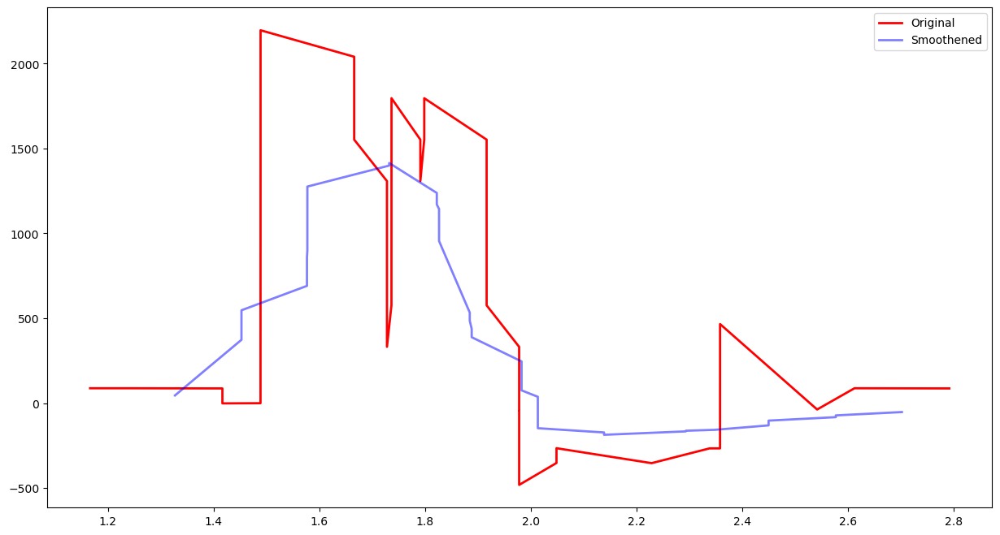

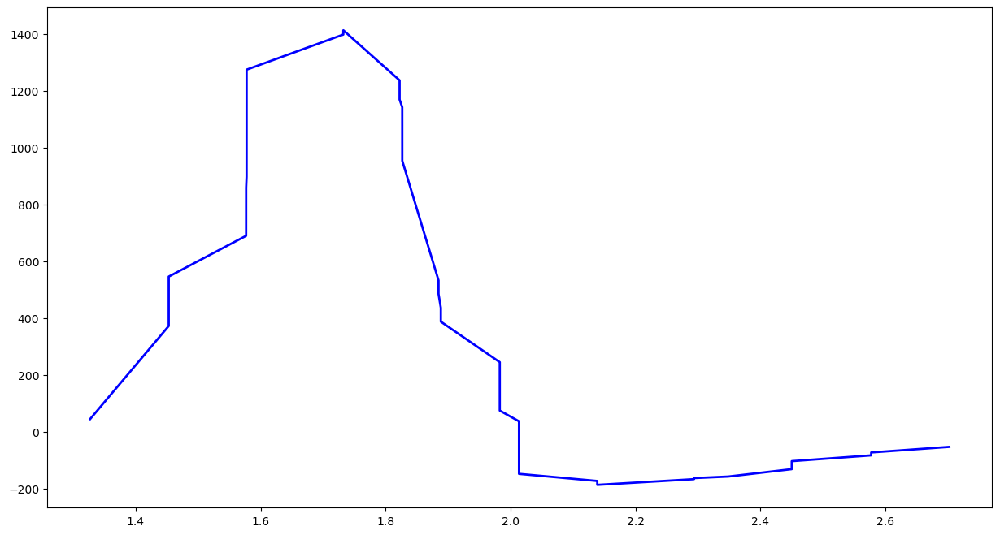

No Feature
../../singapore/top1k/bbc.co.uk-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/bbc.co.uk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46234'])
Port 46234


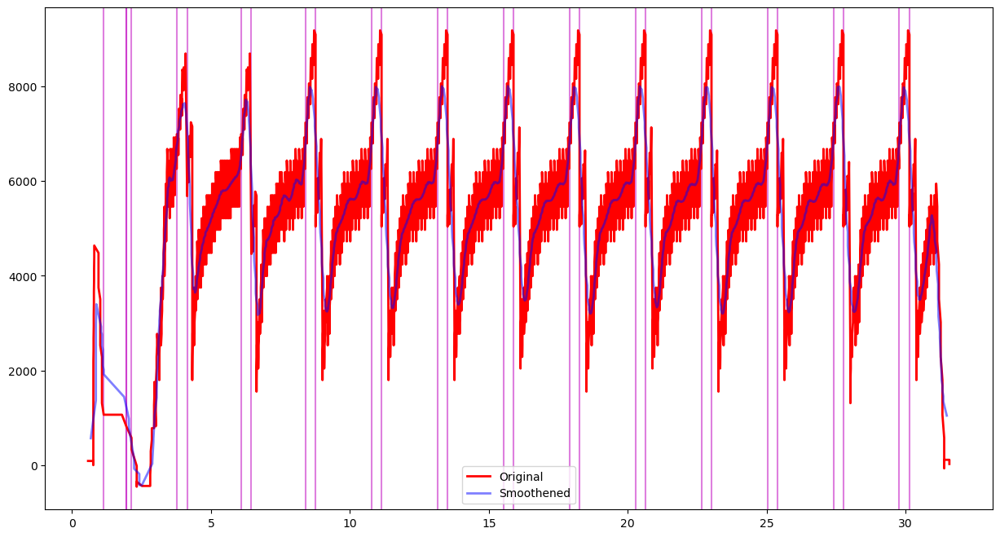

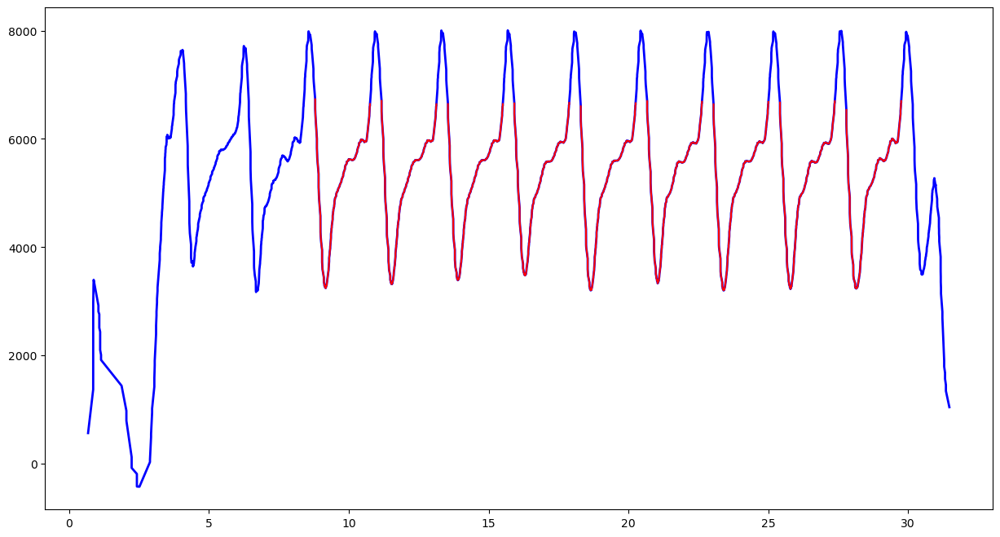

Feature Length  203


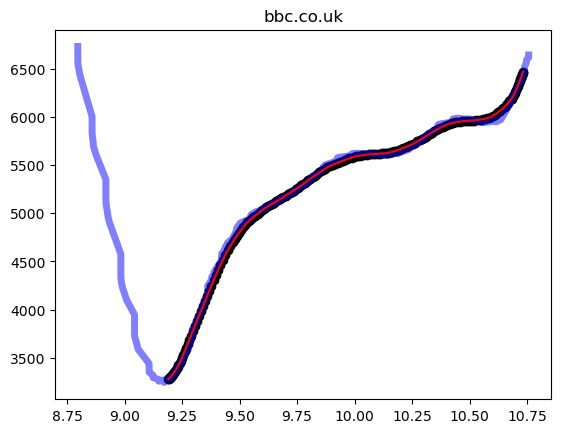

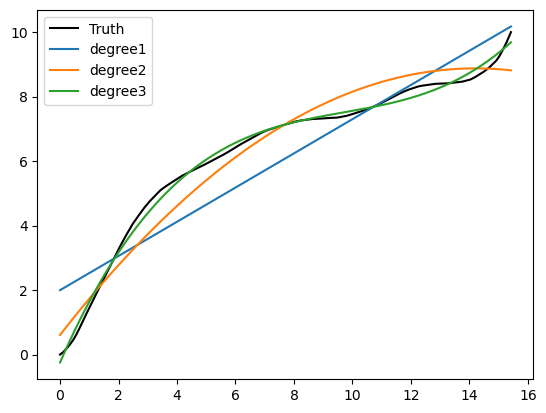

[ 0.00694531 -0.20287475  2.11673711 -0.26327263]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [3.90793823e-74 0.00000000e+00 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.com.eg-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.com.eg-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43794'])
Port 43794


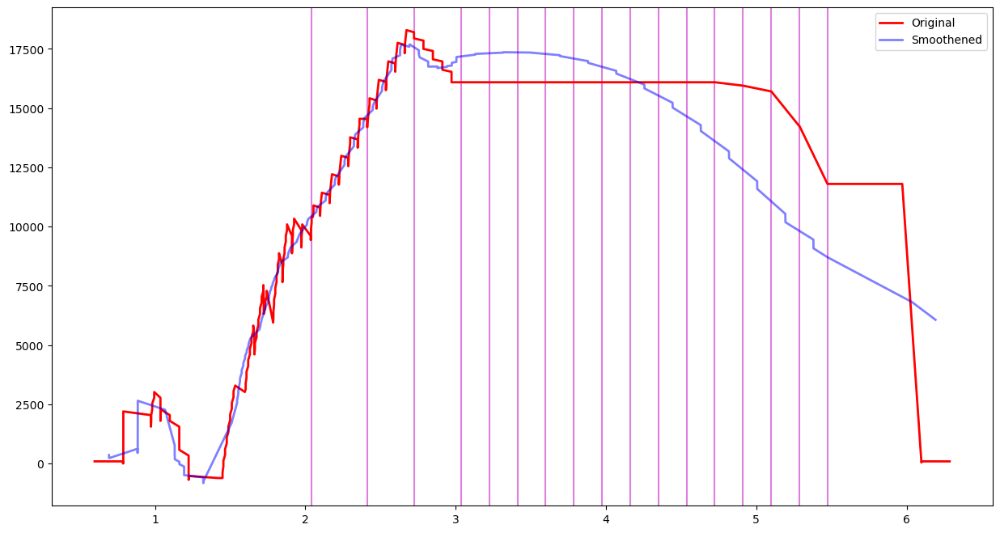

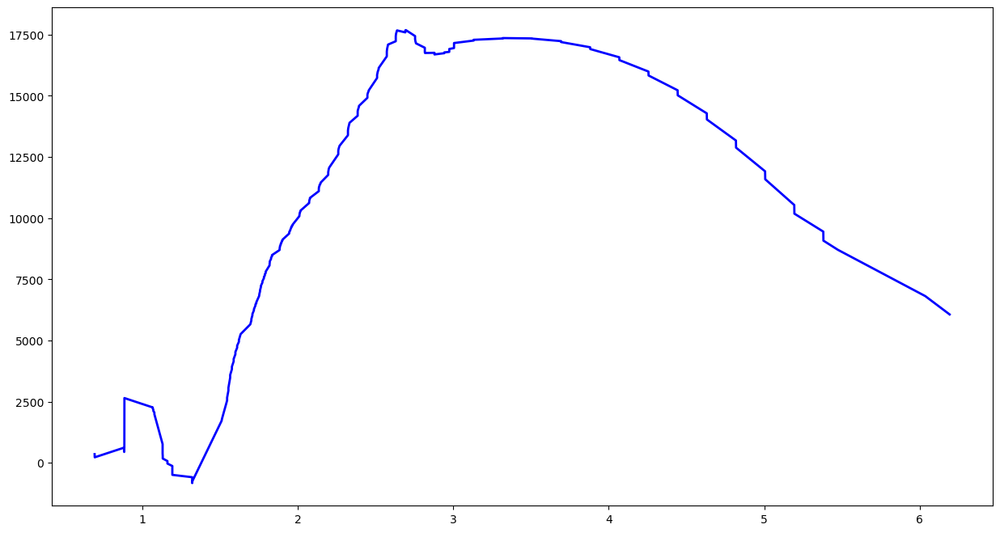

No Feature
../../singapore/top1k/tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48550'])
Port 48550


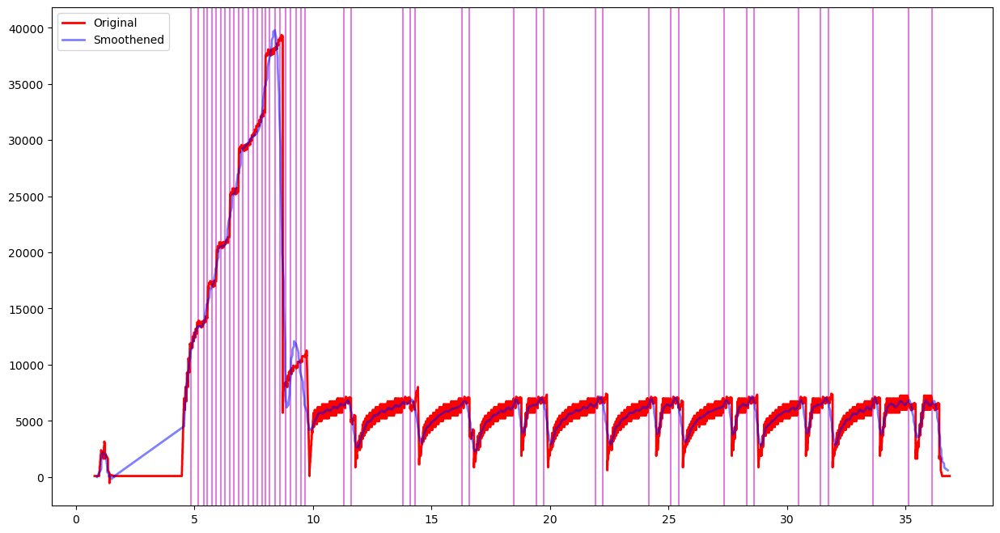

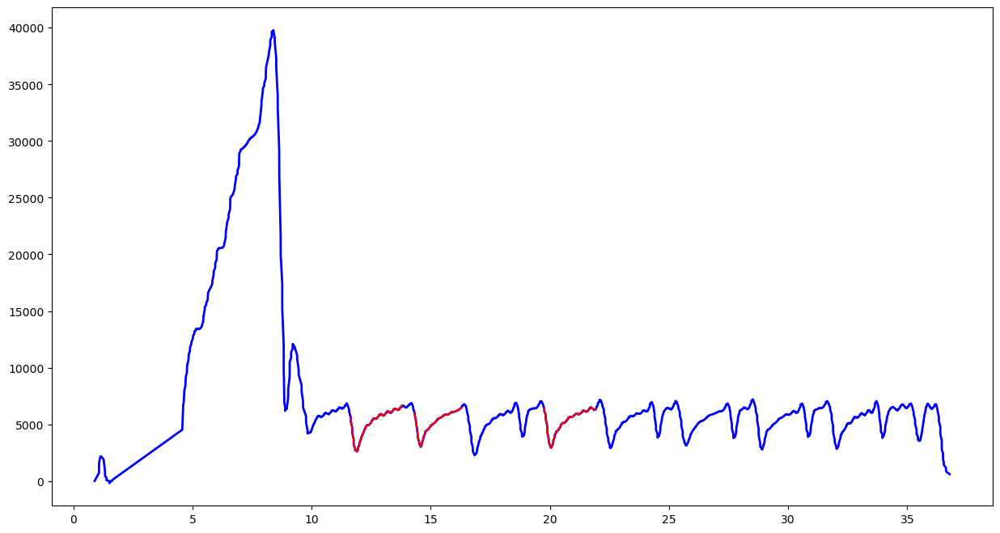

Feature Length  203


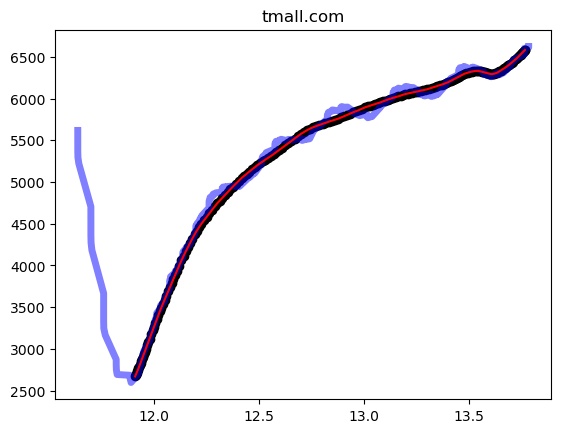

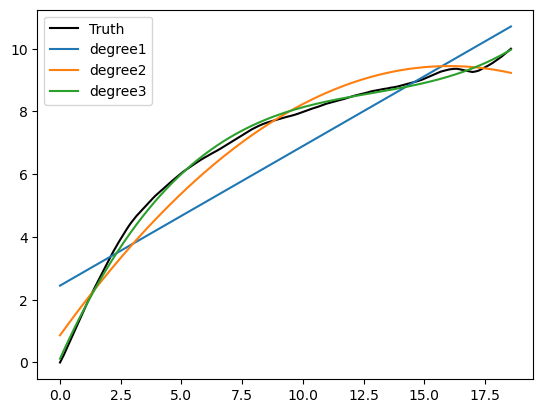

[ 0.0034368  -0.12951327  1.75262837  0.17169336]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [3.91251403e-153 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/indeed.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/indeed.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50092'])
Port 50092


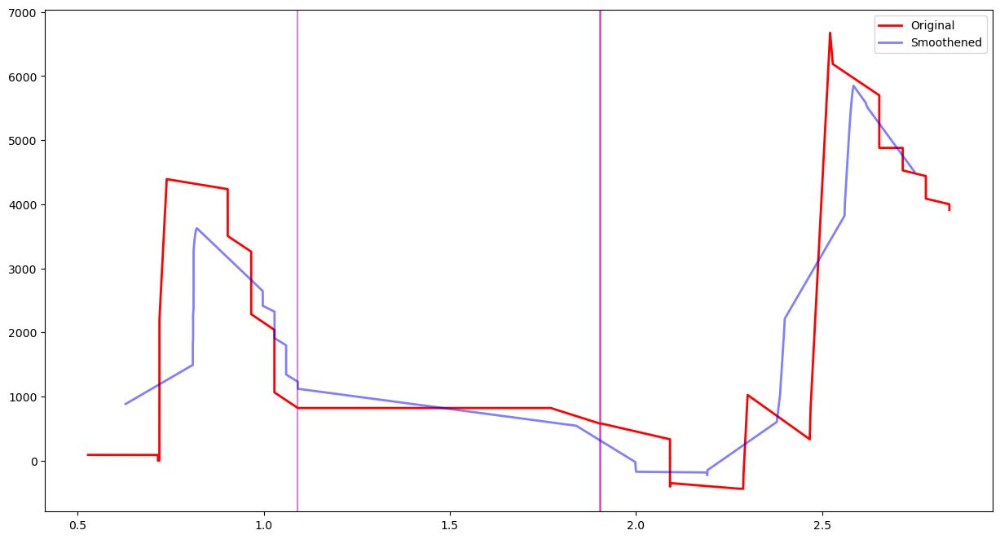

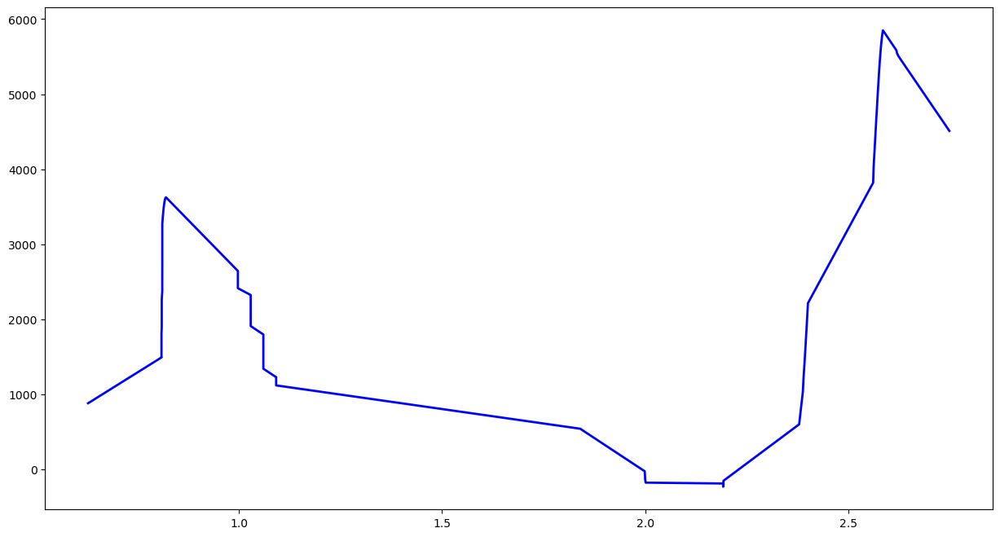

No Feature
../../singapore/top1k/xinhuanet.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/xinhuanet.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52786'])
Port 52786


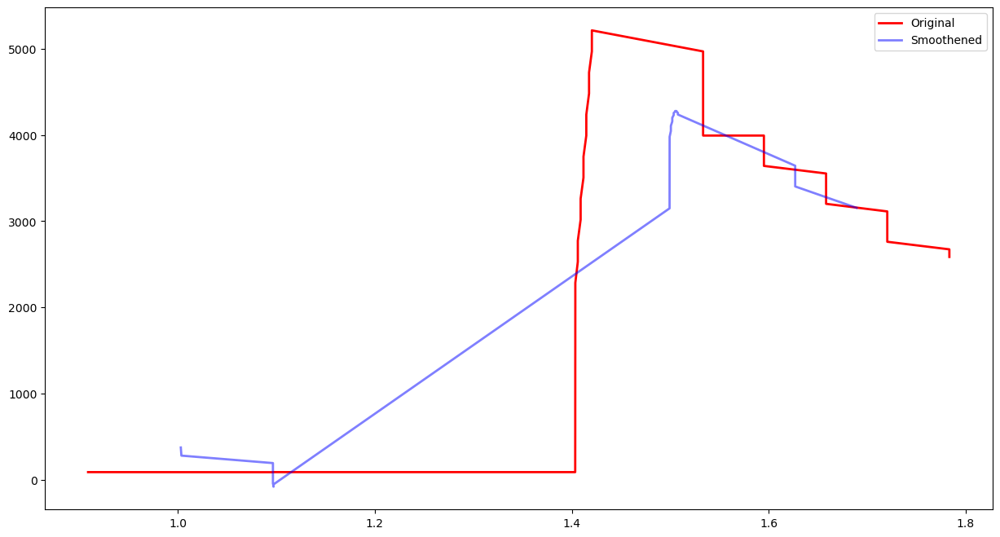

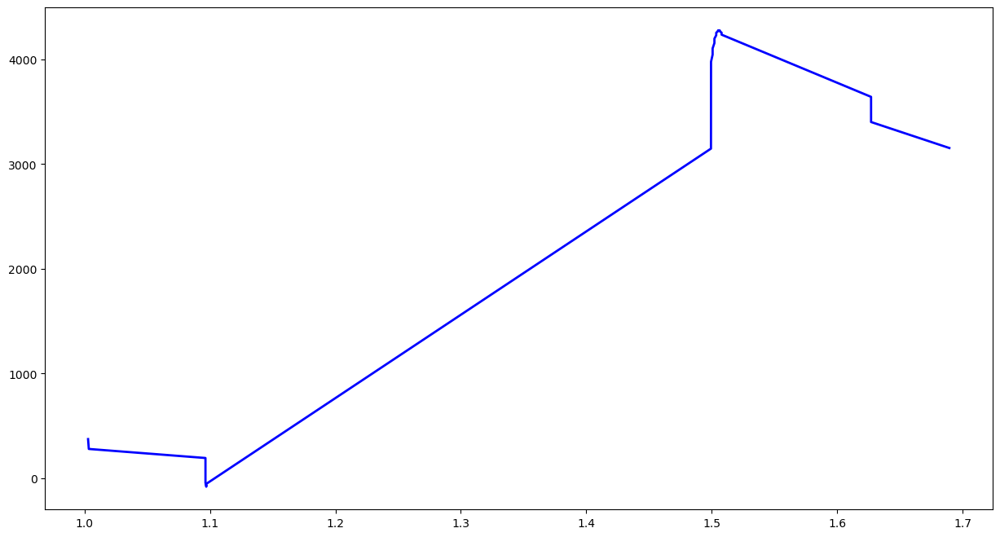

No Feature
../../singapore/top1k/detail.tmall.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/detail.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56310'])
Port 56310


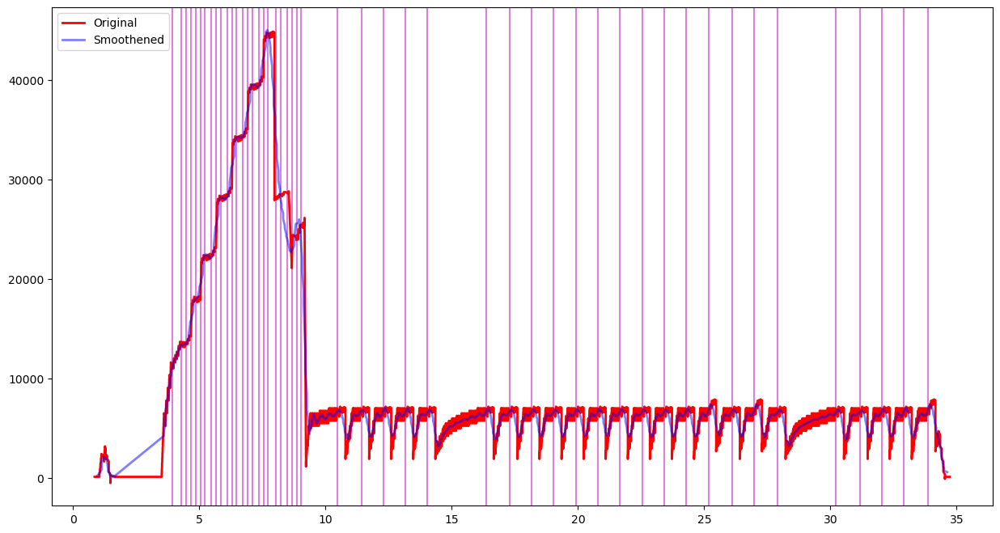

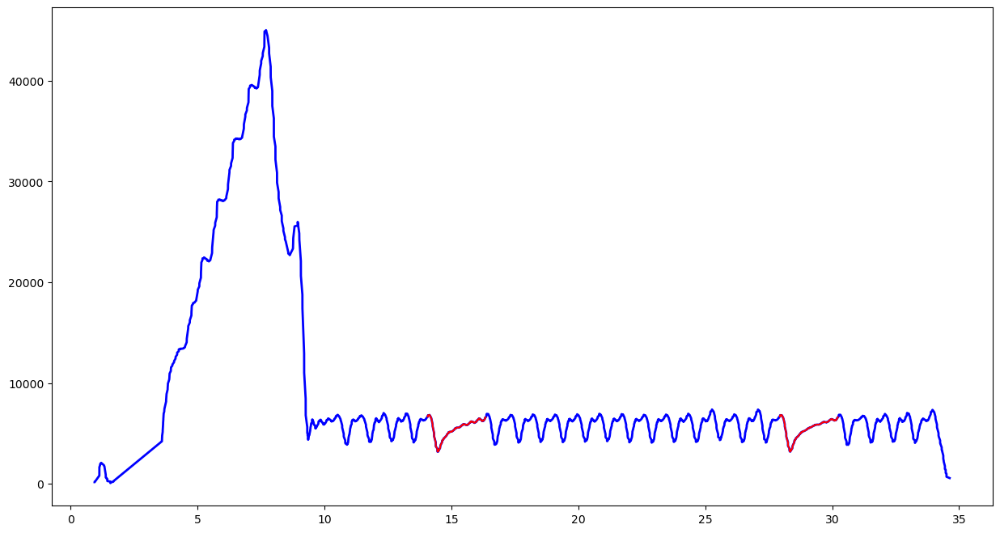

Feature Length  203


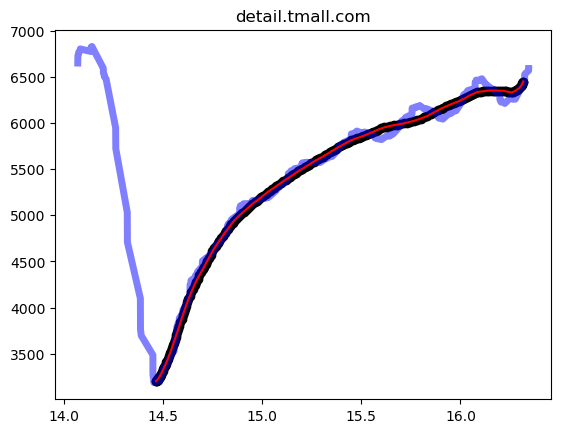

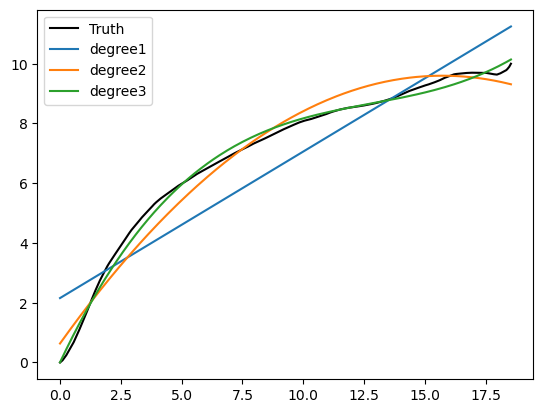

[ 0.00283813 -0.11337781  1.66494419  0.15846953]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [3.79552774e-167 0.00000000e+000 0.00000000e+000 0.00000000e+000]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/digikala.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/digikala.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46238'])
Port 46238


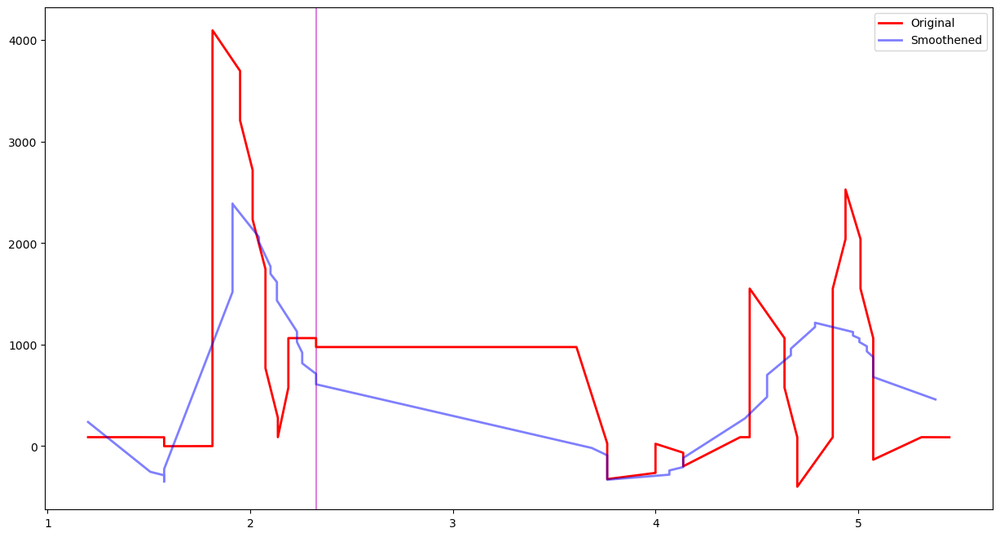

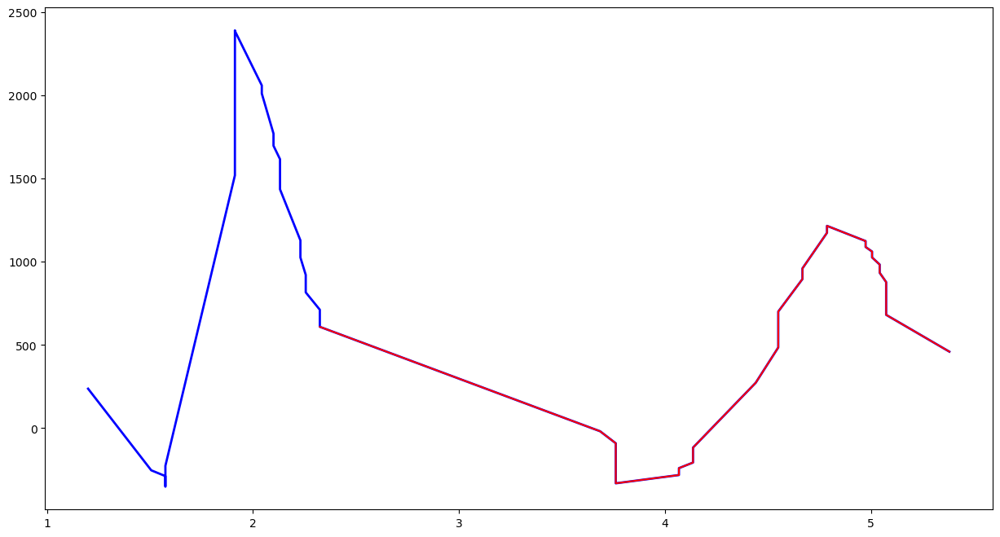

Feature Length  203


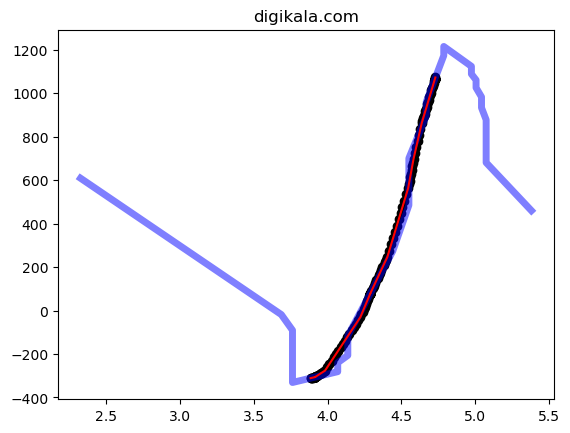

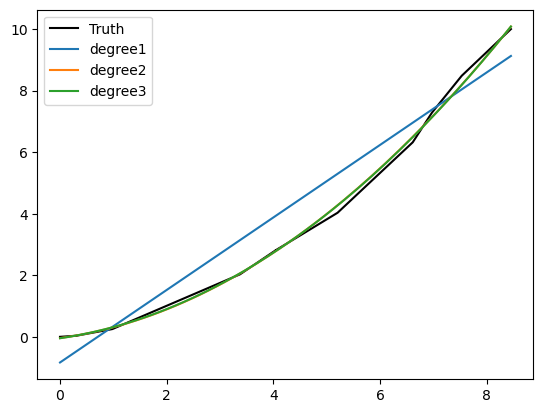

[ 0.11253266  0.26043445 -0.04029441]
Top 5 CCS : ['reno', 'westwood', 'lp', 'highspeed', 'dctcp']
Density Values: [0. 0. 0. 0. 0.]
Relative Density Values: [nan nan nan nan nan]
Prediction: new
../../singapore/top1k/mozilla.org-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/mozilla.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37318'])
Port 37318


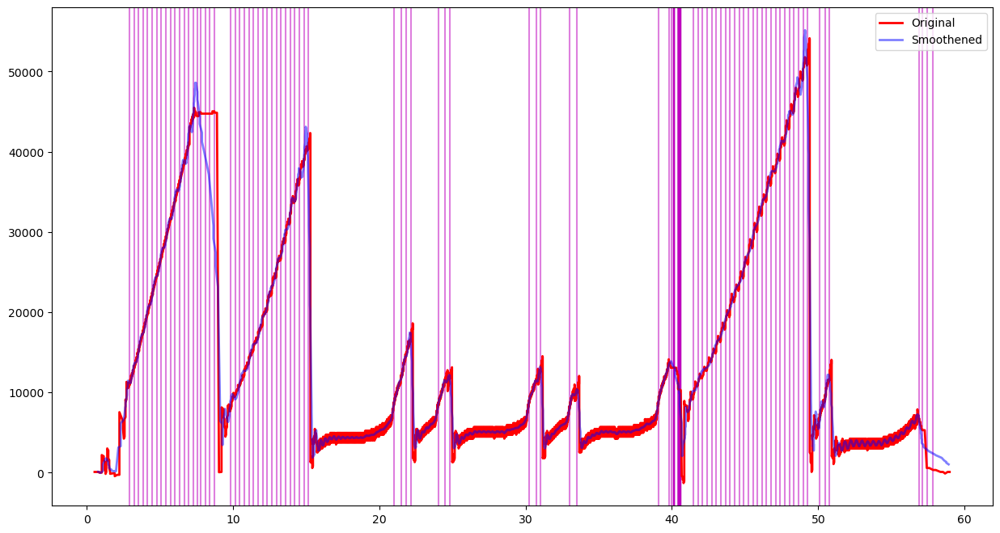

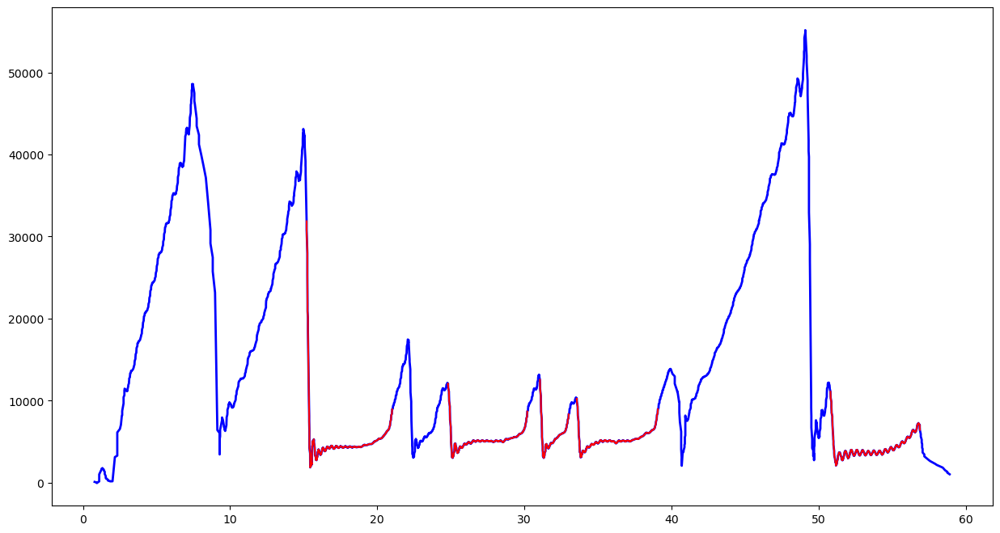

Feature Length  203


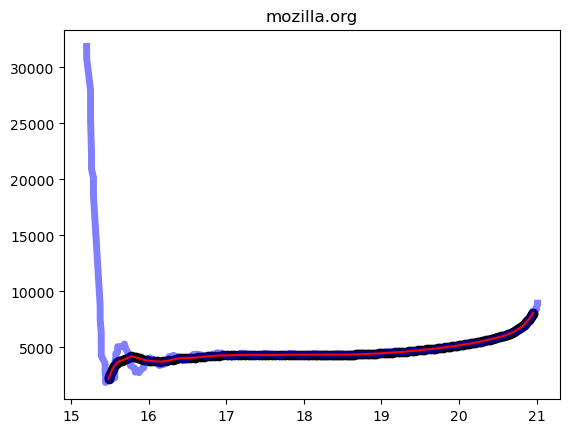

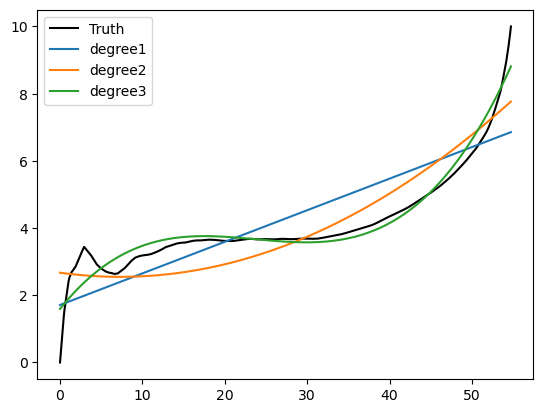

[ 2.30415290e-04 -1.62568904e-02  3.61488329e-01  2.04136527e-02]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [2.03089886e+02 3.60447463e-46 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 1.77481739e-48 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/ettoday.net-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/ettoday.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34598', '34608', '53812', '42312', '51436', '51440', '54498', '59904', '45838', '58830', '39382', '46858', '56580', '51818', '40722', '35970', '35282', '39938', '50914', '47384'])
Port 50914


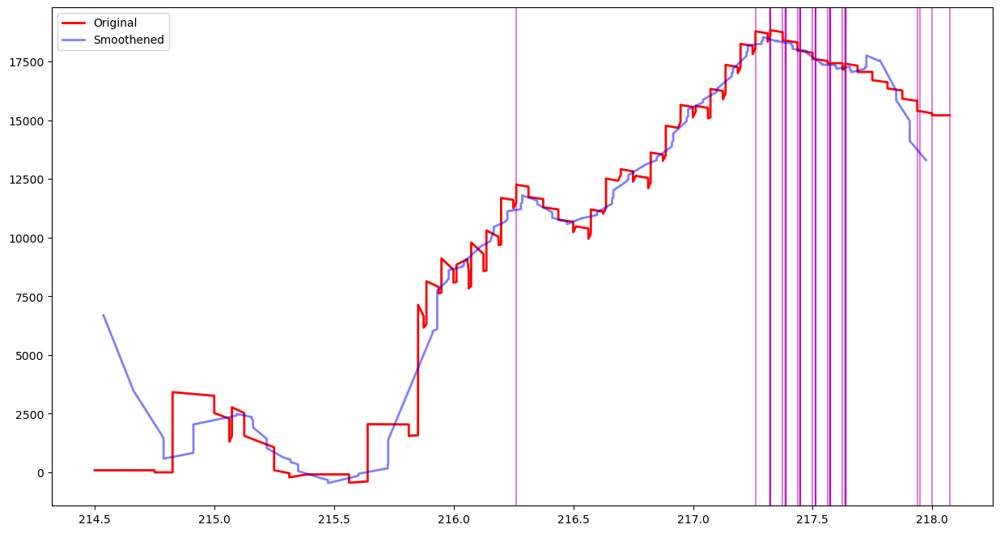

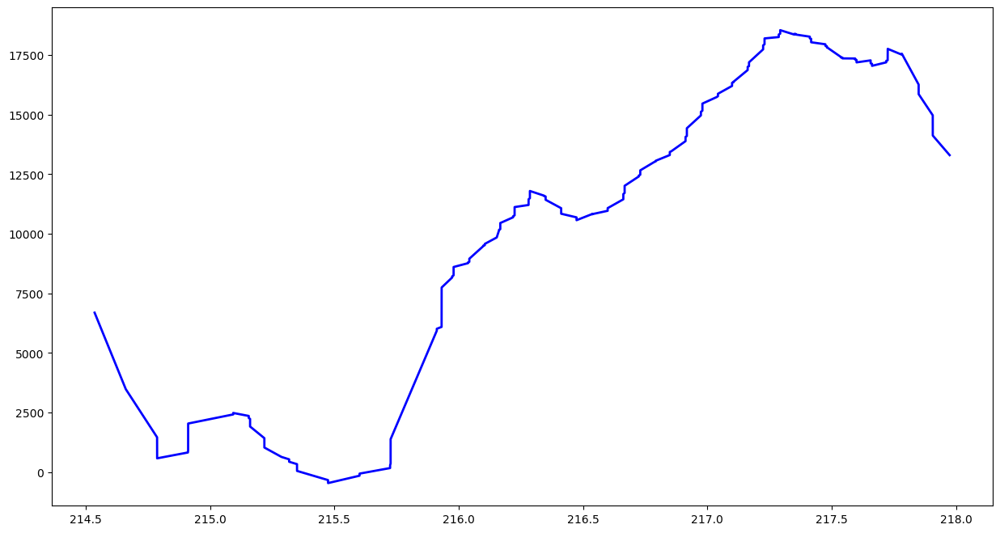

No Feature
../../singapore/top1k/vk.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/vk.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51308', '47882'])
Port 47882


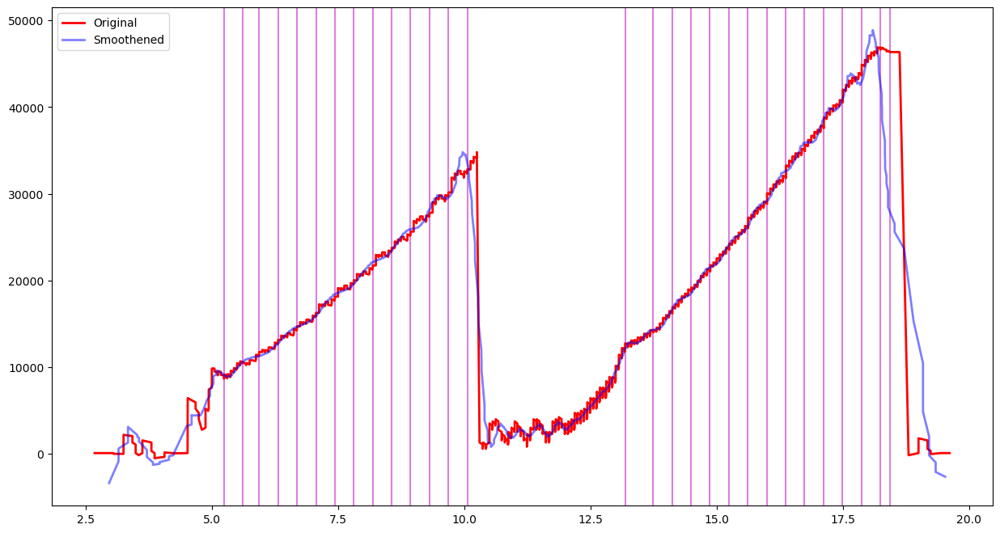

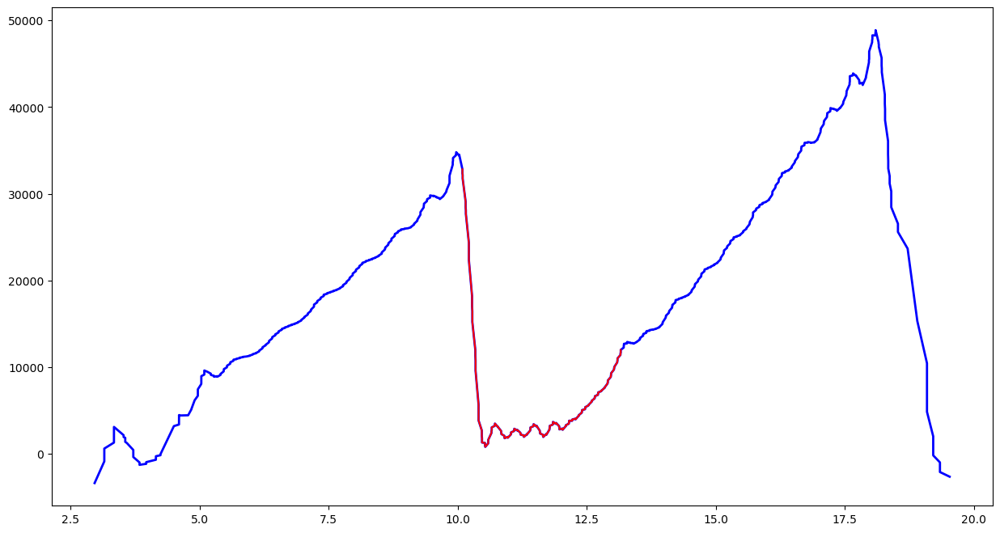

Feature Length  203


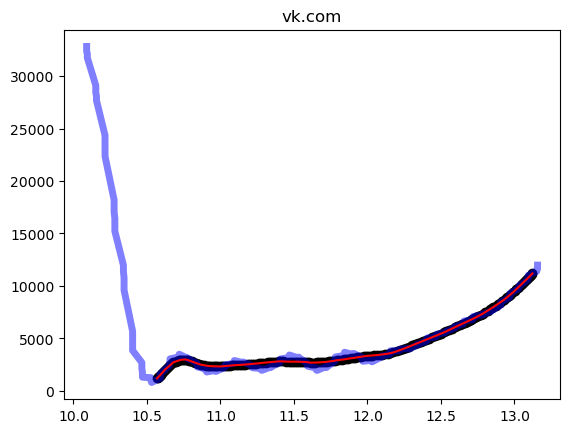

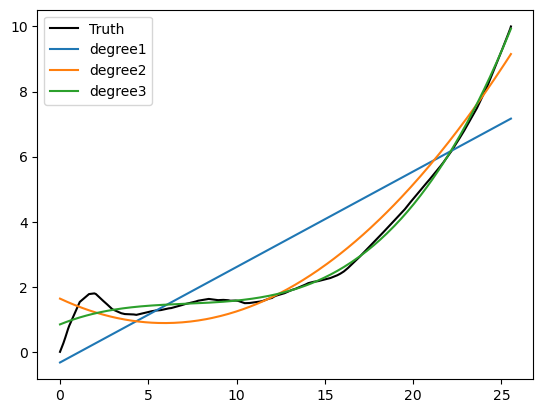

[ 0.00121728 -0.0253525   0.21152423  0.69468604]
Top 5 CCS : ['htcp', 'cubic', 'veno', 'vegas']
Density Values: [7.8856001e-45 0.0000000e+00 0.0000000e+00 0.0000000e+00]
Relative Density Values: [1. 0. 0. 0.]
Prediction: new
../../singapore/top1k/google.cn-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/google.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46254'])
Port 46254


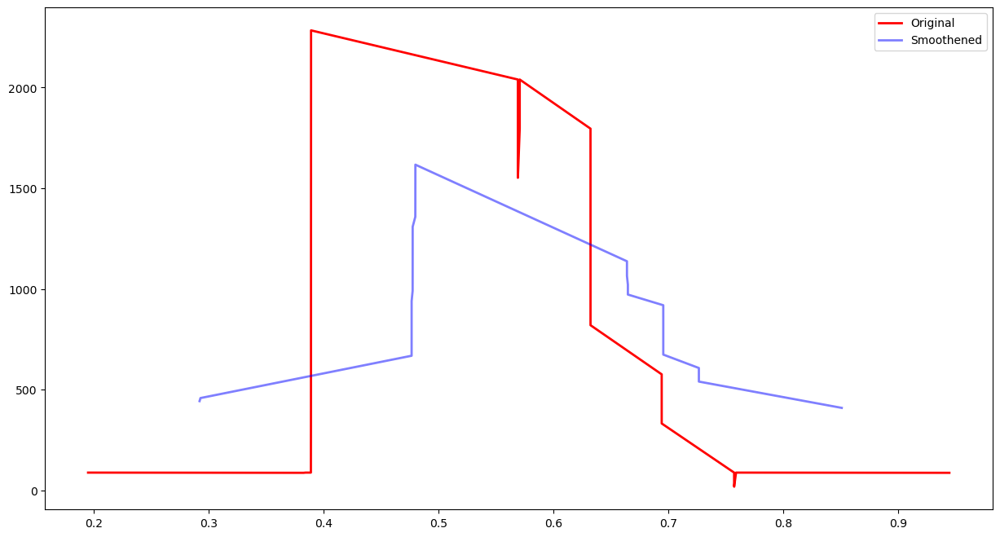

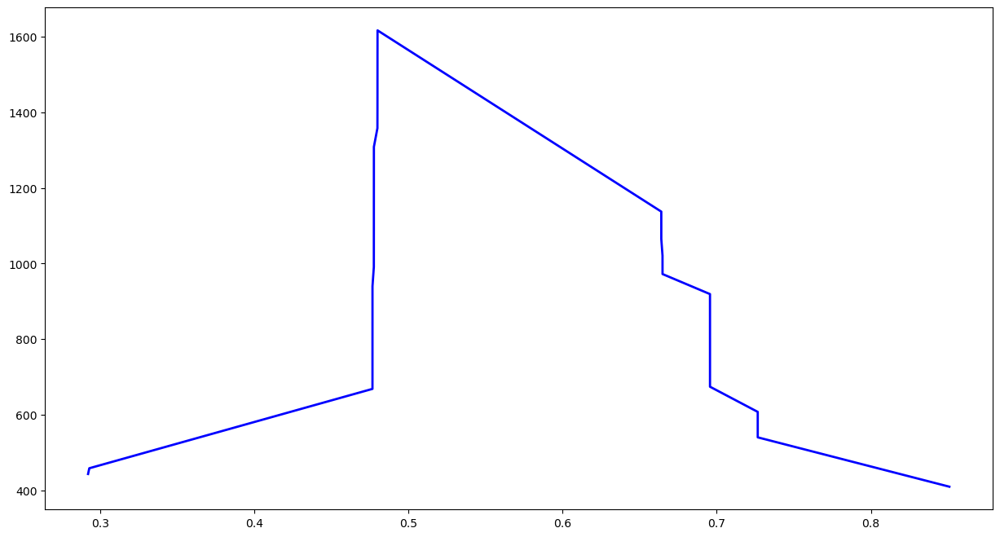

No Feature
../../singapore/top1k/wellsfargo.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/wellsfargo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53914'])
Port 53914


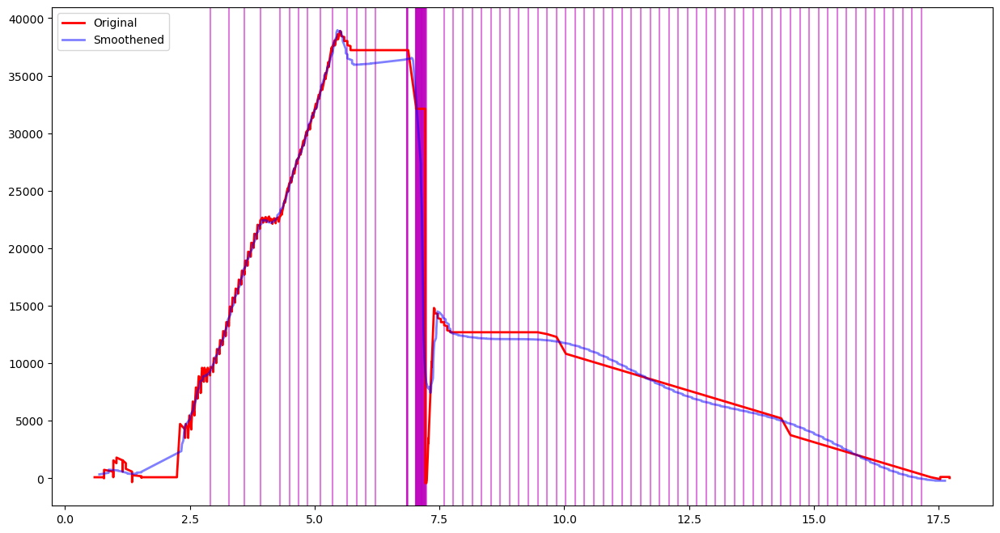

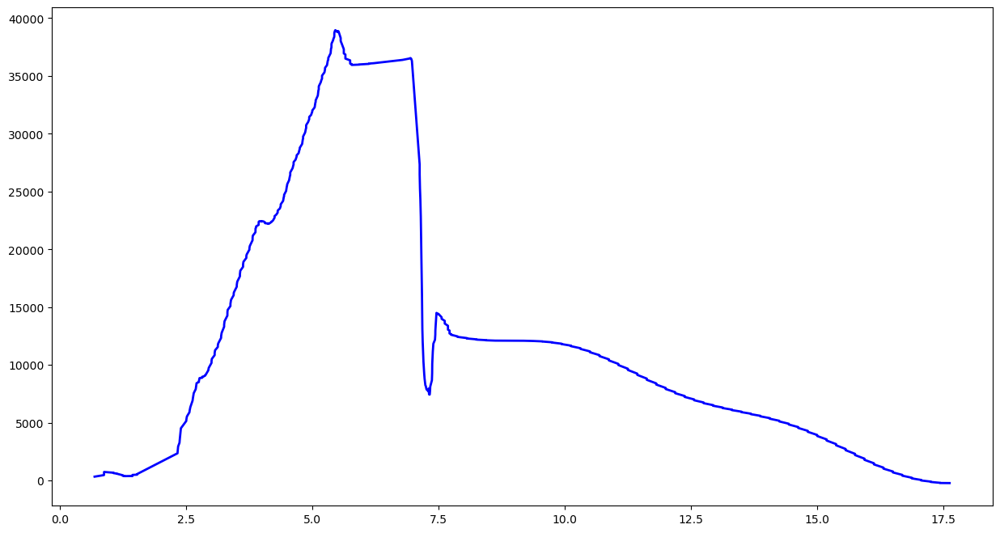

No Feature
../../singapore/top1k/yahoo.co.jp-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/yahoo.co.jp-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39672'])
Port 39672


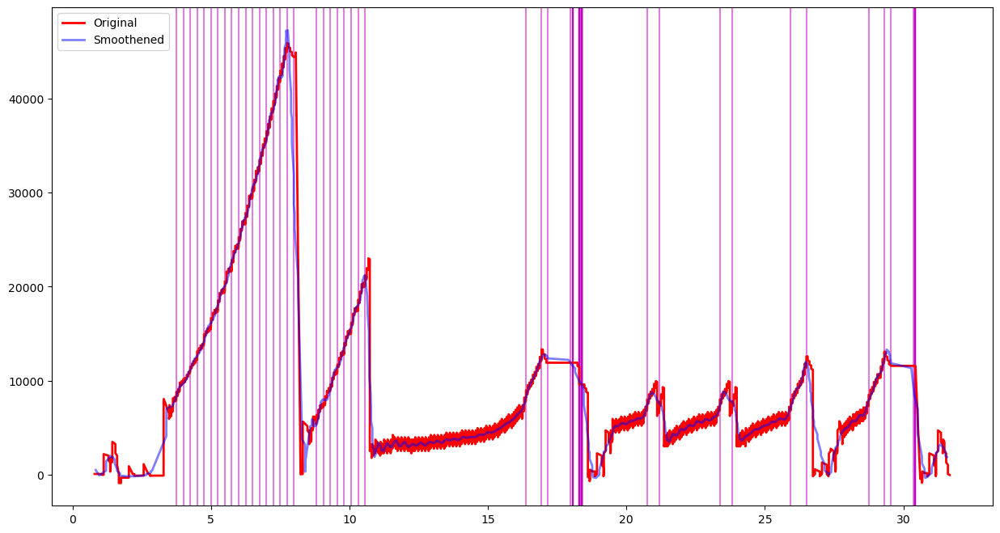

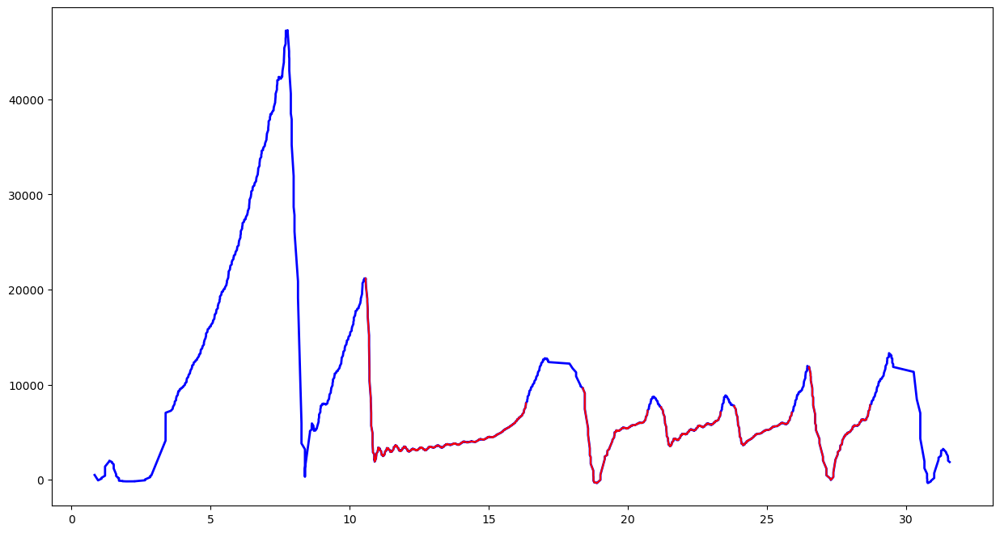

Feature Length  203


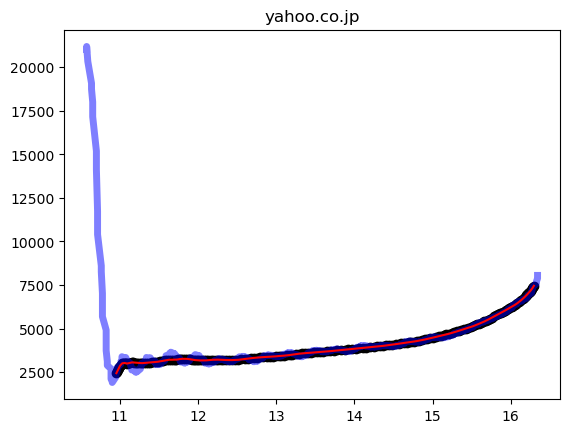

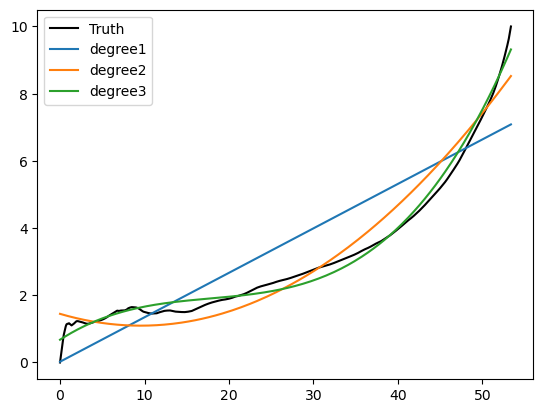

[ 1.60556556e-04 -8.94511714e-03  1.92561783e-01  1.90744149e-01]
Top 5 CCS : ['cubic', 'htcp', 'veno', 'vegas']
Density Values: [3.70458699e+03 8.09378189e-58 0.00000000e+00 0.00000000e+00]
Relative Density Values: [1.00000000e+00 2.18480006e-61 0.00000000e+00 0.00000000e+00]
Prediction: cubic
../../singapore/top1k/weibo.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/weibo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36826'])
Port 36826


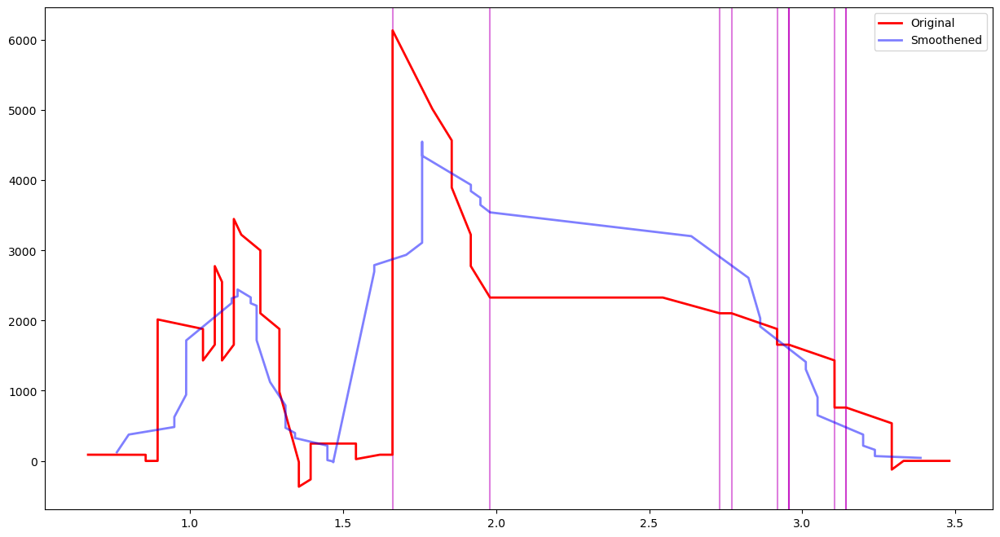

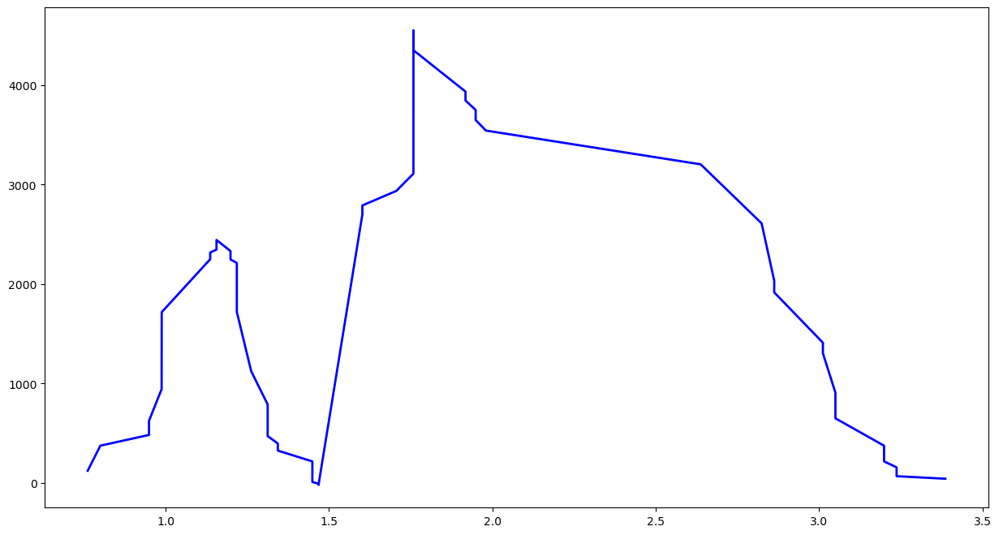

No Feature
../../singapore/top1k/alibaba.com-0-50-200-2-tcp.csv
Reading ../../singapore/top1k/alibaba.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59358', '44424'])
Port 44424


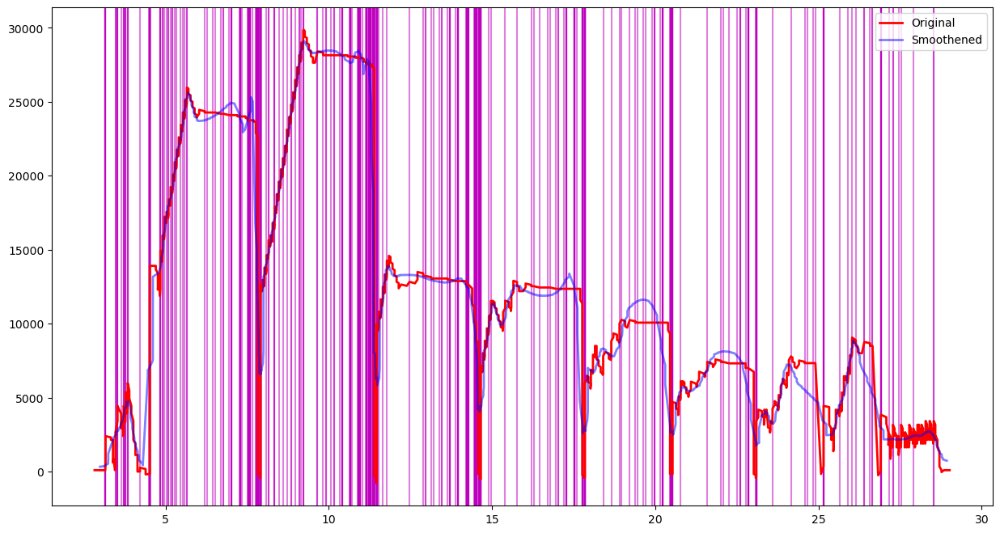

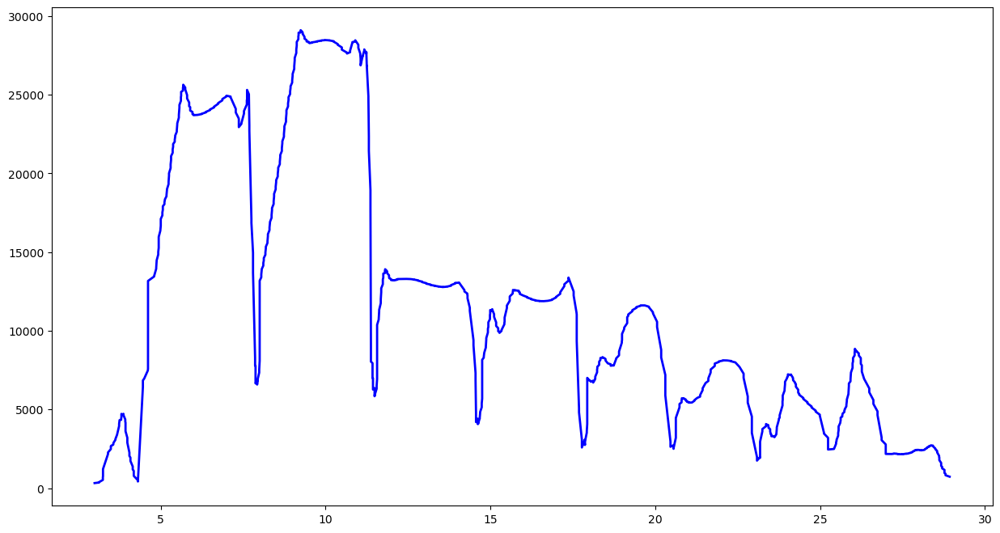

No Feature


In [189]:
predictions = getPredictions(cc_mp,cc_gp,no)